# Preliminaries

In [4]:
#import libraries
import pandas as pd
print('pandas: %s' % pd.__version__)

pd.options.display.max_columns = None
pd.set_option('display.max_rows', 150)

import numpy as np
print('geopandas: %s' % np.__version__)

# Tensorflow / Keras
import tensorflow as tf # used to access argmax function
from tensorflow import keras # for building Neural Networks
print('Tensorflow/Keras: %s' % keras.__version__) # print version
from keras import Sequential # for creating a linear stack of layers for our Neural Network
from keras import Input # for instantiating a keras tensor
from keras.layers import Dense # for creating regular densely-connected NN layer.
from keras.layers import Dense, Conv2D, MaxPool2D, Flatten, Dropout # for adding Concolutional and densely-connected NN layers.
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense, Input, Flatten,\
                                    Reshape, LeakyReLU as LR,\
                                    Activation, Dropout
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
from tensorflow.keras.callbacks import EarlyStopping

# Data manipulation
import pandas as pd # for data manipulation
print('pandas: %s' % pd.__version__) # print version
import numpy as np # for data manipulation
print('numpy: %s' % np.__version__) # print version

import decimal
from decimal import Decimal

import keras 
import tensorflow as tf
from tensorflow.keras.layers import Dropout,BatchNormalization,Conv2D,MaxPooling2D,Dense,Flatten
from tensorflow.keras.datasets import cifar10
from tensorflow.keras import regularizers
from keras import callbacks
from sklearn.preprocessing import StandardScaler
from keras.models import Sequential
import matplotlib.pyplot as plt
from keras.layers import Dense # for creating regular densely-connected NN layer.
from keras.layers import Dense, Conv2D, MaxPool2D, Flatten, Dropout,MaxPooling2D # for adding Concolutional and densely-connected NN layers.
from tensorflow.keras import layers
from tensorflow.keras.models import Model, Sequential

from pathlib import Path  

from sklearn.model_selection import train_test_split # for splitting the data into train and test samples
from sklearn.metrics import classification_report # for model evaluation metrics
from sklearn.preprocessing import OrdinalEncoder # for encoding labels
from keras.models import load_model
from sklearn.preprocessing import StandardScaler

from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import confusion_matrix

from tensorflow.keras.utils import plot_model

from sklearn.utils.class_weight import compute_sample_weight

pandas: 1.5.0
geopandas: 1.23.2
Tensorflow/Keras: 2.10.0
pandas: 1.5.0
numpy: 1.23.2


In [5]:
%matplotlib inline
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import confusion_matrix
from sklearn import metrics

def plot_roc(pred,y):
    fpr, tpr, _ = roc_curve(y, pred)
    roc_auc = auc(fpr, tpr)

    plt.figure()
    plt.plot(fpr, tpr, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC)')
    plt.legend(loc="lower right")
    plt.show()

In [6]:
def extract_images(df, variables, verbose=False):
    number_of_img, rows, cols = len(df.time.unique()), len(df.latitude.unique()), len(df.longitude.unique())
    images = np.zeros( (number_of_img, rows, cols, len(variables)) )
    
    df = df.sort_values(by=['time','latitude','longitude'])
    k=0
    
    for day in range(0,number_of_img):
        
        a=df.iloc[377*day:377*(day+1)]
        i=0
        for var in variables:
            images[day,:,:,i] = a.pivot(index='latitude', columns='longitude').sort_index(ascending=False)[var]
            i+=1
        k+=1
        if (k%100==0) & (verbose==True): print(k)
    return images

# Data

In [7]:
train = pd.read_csv('/Users/paolo/Documents/TC_old/data/NewData_csv/training_sets_withrealtom.csv')
val = pd.read_csv('/Users/paolo/Documents/TC_old/data/NewData_csv/validation_sets_withrealtom.csv')
test = pd.read_csv('/Users/paolo/Documents/TC_old/data/NewData_csv/test_sets_withrealtom.csv')
test = test.loc[test.time>='2016-04-01']

train['shear'] = train.apply(lambda x: np.sqrt((x.u_200-x.u_850)**2 + (x.v_200-x.v_850)**2),axis=1)
val['shear'] = val.apply(lambda x: np.sqrt((x.u_200-x.u_850)**2 + (x.v_200-x.v_850)**2),axis=1)
test['shear'] = test.apply(lambda x: np.sqrt((x.u_200-x.u_850)**2 + (x.v_200-x.v_850)**2),axis=1)


In [8]:
test.longitude.unique()

array([20. , 22.5, 25. , 27.5, 30. , 32.5, 35. , 37.5, 40. , 42.5, 45. ,
       47.5, 50. , 52.5, 55. , 57.5, 60. , 62.5, 65. , 67.5, 70. , 72.5,
       75. , 77.5, 80. , 82.5, 85. , 87.5, 90. ])

In [5]:
### 
# 0_lag: "newlsm" 01-01 --> 01-01/02-01
# 1_lag: "Real_tom_target" 01-01 --> 02-01/03-01
# 2_lag: "Real_tom_target" 01-01 --> 03-01/04-01
#...
# 13_lag: "Real_tom_target" 01-01 --> 14-01/15-01

In [9]:
pd.set_option('display.max_rows', 300)
train.loc[(train.new_target>0) & (train.latitude==-17.5) & (train.longitude==52.5)]

,Unnamed: 0,time,latitude,longitude,vo,r,u_200,u_850,v_200,v_850,ttr,sst,lsm,newlsm,new_target,Real_tom_target,shear
5871,5871,1980-01-16,-17.5,52.5,-1.356086e-05,60.351845,1.234871,-0.773159,-3.530334,7.336716,-250.013700,301.43362,0.0,0.0,7.5,66.5,11.051016
6248,6248,1980-01-17,-17.5,52.5,-5.138546e-05,72.263336,-5.070305,-0.659393,2.133896,7.037754,-203.061860,301.40717,0.0,100.0,66.5,97.0,6.595754
6625,6625,1980-01-18,-17.5,52.5,-9.055705e-05,78.416700,-2.683708,-0.667770,0.934036,4.526085,-183.071490,301.38710,0.0,100.0,97.0,97.0,4.119080
7002,7002,1980-01-19,-17.5,52.5,-5.380878e-05,77.551414,-5.331970,-2.726635,-0.806274,2.360531,-190.444630,301.38678,1.0,100.0,97.0,91.0,4.100784
7379,7379,1980-01-20,-17.5,52.5,-9.266964e-05,82.781840,-4.148789,-2.147587,0.376091,-4.775379,-168.715930,301.40445,1.0,100.0,91.0,84.0,5.526523
7756,7756,1980-01-21,-17.5,52.5,-7.247100e-05,80.568900,-1.434532,5.614853,-2.146568,-10.635845,-137.472960,301.43143,1.0,100.0,84.0,60.0,11.034566
8133,8133,1980-01-22,-17.5,52.5,-4.587846e-05,84.924446,-1.711296,10.252827,-3.162826,-8.860153,-174.509810,301.45917,1.0,100.0,60.0,6.0,13.251406
8510,8510,1980-01-23,-17.5,52.5,-2.930684e-05,76.797200,-0.902954,14.227932,3.887024,-3.390404,-172.572780,301.47916,0.0,0.0,6.0,29.5,16.790017
8887,8887,1980-01-24,-17.5,52.5,-2.359327e-05,81.574730,2.677124,16.464993,10.246498,3.258892,-118.159256,301.49298,0.0,0.0,29.5,29.5,15.457424
9264,9264,1980-01-25,-17.5,52.5,-3.047816e-05,81.444350,3.549500,19.273430,8.714348,3.147240,-115.092040,301.50555,0.0,0.0,29.5,29.0,16.680368


In [10]:
train

,Unnamed: 0,time,latitude,longitude,vo,r,u_200,u_850,v_200,v_850,ttr,sst,lsm,newlsm,new_target,Real_tom_target,shear
0,0,1980-01-01,0.0,20.0,0.000007,80.761185,1.909660,-3.323872,1.687164,-1.823624,-247.54074,0.00000,0.0,0.0,0.0,0.0,6.302023
1,1,1980-01-01,0.0,22.5,0.000004,80.703650,1.165733,-2.844494,1.060593,-1.991425,-240.00592,0.00000,0.0,0.0,0.0,0.0,5.039517
2,2,1980-01-01,0.0,25.0,0.000007,78.231514,-1.311676,-2.125244,3.280617,-1.931789,-223.76889,0.00000,0.0,0.0,0.0,0.0,5.275516
3,3,1980-01-01,0.0,27.5,0.000010,79.631010,-3.777573,-1.122395,5.743889,-1.243538,-235.55556,0.00000,0.0,0.0,0.0,0.0,7.474898
4,4,1980-01-01,0.0,30.0,0.000010,71.573875,-5.734505,-1.362953,6.514030,-0.954163,-254.03260,0.00000,0.0,0.0,0.0,0.0,8.653576
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4268766,137600,2010-12-31,-30.0,80.0,0.000015,26.797535,25.075424,-3.653679,-1.221291,1.515594,-273.34204,296.89227,0.0,0.0,0.0,0.0,28.859174
4268767,137601,2010-12-31,-30.0,82.5,-0.000006,27.766910,24.175919,-2.866638,-6.724304,0.861771,-280.37018,296.03314,0.0,0.0,0.0,0.0,28.086446
4268768,137602,2010-12-31,-30.0,85.0,0.000010,29.111805,24.655510,-2.809170,-10.138817,0.051220,-281.05167,295.36078,0.0,0.0,0.0,0.0,29.294120
4268769,137603,2010-12-31,-30.0,87.5,0.000006,27.833050,25.088104,-2.730087,-11.036507,0.666927,-280.05610,295.10638,0.0,0.0,0.0,0.0,30.179830


## Features

In [11]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

cols_to_std = [ 'vo', 'r', 'u_200', 'u_850', 'v_200','v_850', 'ttr','sst','shear']
train_std,val_std,test_std = train,val,test

# apply standardization on numerical features
train_std[cols_to_std] = scaler.fit_transform(train[[ 'vo', 'r', 'u_200', 'u_850', 'v_200','v_850', 'ttr','sst','shear']])
val_std[cols_to_std] = scaler.transform(val[[ 'vo', 'r', 'u_200', 'u_850', 'v_200','v_850', 'ttr','sst','shear']])
test_std[cols_to_std] = scaler.transform(test[[ 'vo', 'r', 'u_200', 'u_850', 'v_200','v_850', 'ttr','sst','shear']])


In [12]:
#training set has 11323 days
variables = [ 'vo', 'r', 'u_200', 'u_850', 'v_200','v_850', 'ttr','sst','shear']
train_img_std = extract_images(train_std, variables, verbose=True)
print(train_img_std.shape)

100
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600
1700
1800
1900
2000
2100
2200
2300
2400
2500
2600
2700
2800
2900
3000
3100
3200
3300
3400
3500
3600
3700
3800
3900
4000
4100
4200
4300
4400
4500
4600
4700
4800
4900
5000
5100
5200
5300
5400
5500
5600
5700
5800
5900
6000
6100
6200
6300
6400
6500
6600
6700
6800
6900
7000
7100
7200
7300
7400
7500
7600
7700
7800
7900
8000
8100
8200
8300
8400
8500
8600
8700
8800
8900
9000
9100
9200
9300
9400
9500
9600
9700
9800
9900
10000
10100
10200
10300
10400
10500
10600
10700
10800
10900
11000
11100
11200
11300
(11323, 13, 29, 9)


In [13]:
val_img_std = extract_images(val_std, variables, verbose=False)
print(val_img_std.shape)

(1826, 13, 29, 9)


In [14]:
test_img_std = extract_images(test_std, variables, verbose=False)
print(test_img_std.shape)

(2466, 13, 29, 9)


## Target of the current day: TC in the next 48 hours, with and without land

In [15]:
train['target'] = train.apply(lambda x: 1 if x.new_target>=50 else 0,axis=1)
test['target'] = test.apply(lambda x: 1 if x.new_target>=50 else 0,axis=1)
val['target'] = val.apply(lambda x: 1 if x.new_target>=50 else 0,axis=1)

y_train = train.loc[:,['target','latitude','longitude','time']]
y_val = val.loc[:,['target','latitude','longitude','time']]
y_test = test.loc[:,['target','latitude','longitude','time']]

In [16]:
variables = ['target']
y_train_img = extract_images(y_train, variables, verbose=True)
print(y_train_img.shape)

100
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600
1700
1800
1900
2000
2100
2200
2300
2400
2500
2600
2700
2800
2900
3000
3100
3200
3300
3400
3500
3600
3700
3800
3900
4000
4100
4200
4300
4400
4500
4600
4700
4800
4900
5000
5100
5200
5300
5400
5500
5600
5700
5800
5900
6000
6100
6200
6300
6400
6500
6600
6700
6800
6900
7000
7100
7200
7300
7400
7500
7600
7700
7800
7900
8000
8100
8200
8300
8400
8500
8600
8700
8800
8900
9000
9100
9200
9300
9400
9500
9600
9700
9800
9900
10000
10100
10200
10300
10400
10500
10600
10700
10800
10900
11000
11100
11200
11300
(11323, 13, 29, 1)


In [17]:
variables = [ 'target']
y_val_img = extract_images(y_val, variables, verbose=False)
print(y_val_img.shape)


(1826, 13, 29, 1)


In [18]:
variables = [ 'target']
y_test_img = extract_images(y_test, variables, verbose=False)
print(y_test_img.shape)


(2466, 13, 29, 1)


In [10]:
import pickle
with open('/Users/paolo/Desktop/TC_world/train_target_img.pkl', 'wb') as f:  
        pickle.dump(y_train_img, f)

In [11]:
with open('/Users/paolo/Desktop/TC_world/val_target_img.pkl', 'wb') as f:  
        pickle.dump(y_val_img, f)

In [12]:
with open('/Users/paolo/Desktop/TC_world/test_target_img.pkl', 'wb') as f:  
        pickle.dump(y_test_img, f)

# Models

## Same of old target

### Model training

In [26]:
model = Sequential()
model.add(layers.Input(shape=(13, 29, 10)))

model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
model.add(layers.MaxPooling2D((2, 2), padding='same'))

#model.add(layers.Flatten())

#model.add(layers.Reshape((2,4,16)))

model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
model.add(layers.UpSampling2D((2,2)))

model.add(layers.Conv2D(1, (3, 3), activation='sigmoid', padding='same')) # sigmoidal activation to have probabilities

model.add(layers.Cropping2D(cropping=((0,1),(0,1))))

model.summary()


model.compile(loss='binary_crossentropy', optimizer='adam')

monitor = EarlyStopping(monitor='val_loss', min_delta=1e-5, patience=20, 
        verbose=1, mode='auto', restore_best_weights=True)


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_187 (Conv2D)         (None, 13, 29, 8)         728       
                                                                 
 max_pooling2d_34 (MaxPoolin  (None, 7, 15, 8)         0         
 g2D)                                                            
                                                                 
 conv2d_188 (Conv2D)         (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d (UpSampling2D  (None, 14, 30, 8)        0         
 )                                                               
                                                                 
 conv2d_189 (Conv2D)         (None, 14, 30, 1)         73        
                                                                 
 cropping2d_17 (Cropping2D)  (None, 13, 29, 1)         0

In [38]:
train_img_std[:,:,:,9] = y_train_img

IndexError: index 9 is out of bounds for axis 3 with size 9

In [42]:
train_img_std[:,:,:,8].shape

(11323, 13, 29)

In [17]:
model.fit(train_img_std, y_train_img, validation_data=(val_img_std,y_val_img),
        callbacks=[monitor],epochs=100)

Epoch 1/100


2023-05-28 15:09:18.598238: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-05-28 15:09:19.104843: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0281

2023-05-28 15:09:23.083543: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 5s 9ms/step - loss: 0.0281 - val_loss: 0.0115
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0129 - val_loss: 0.0103
Epoch 3/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0117 - val_loss: 0.0093
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0111 - val_loss: 0.0088
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0107 - val_loss: 0.0087
Epoch 6/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0103 - val_loss: 0.0092
Epoch 7/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0101 - val_loss: 0.0081
Epoch 8/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0099 - val_loss: 0.0084
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0098 - val_loss: 0.0079
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0096 - val_loss: 0.0081
E

### Full test evaluation

41/78 [==============>...............] - ETA: 0s

2023-05-28 15:13:53.486302: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


78/78 [==============================] - 0s 3ms/step


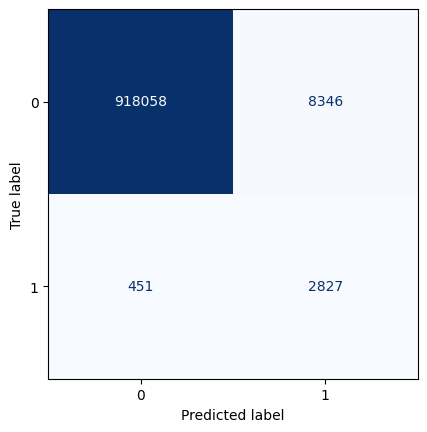

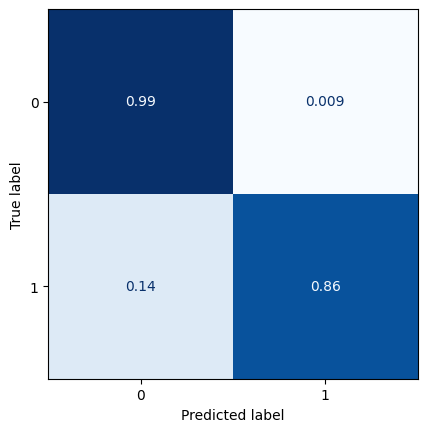

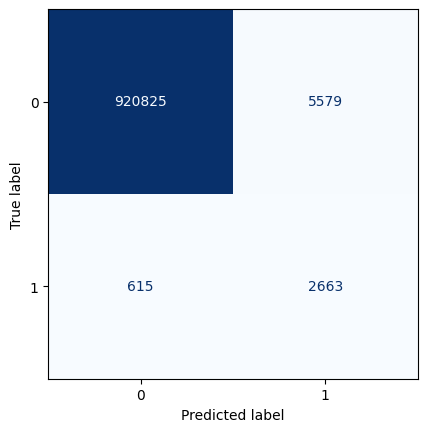

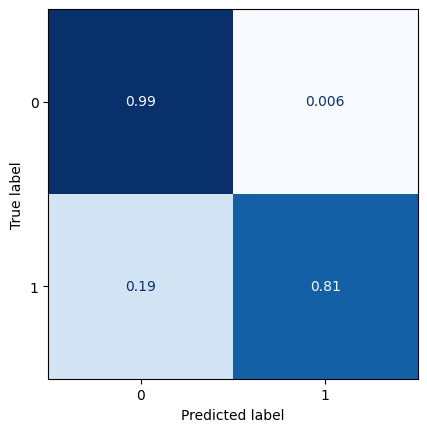

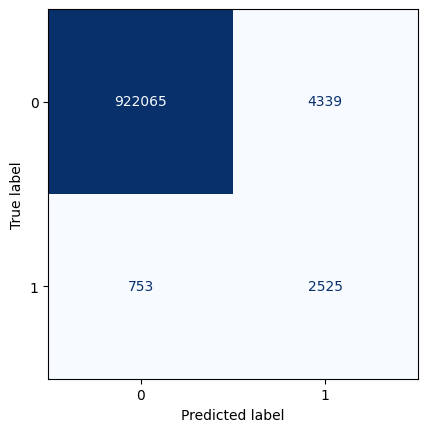

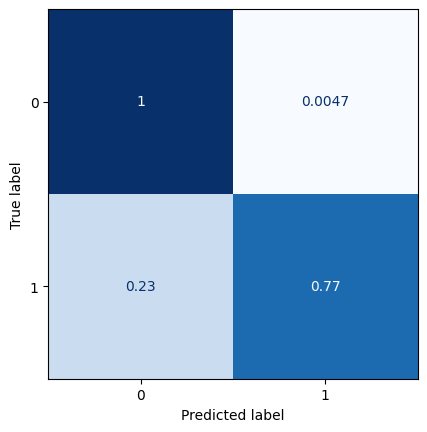

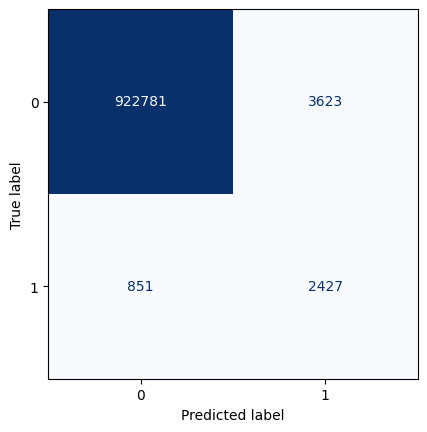

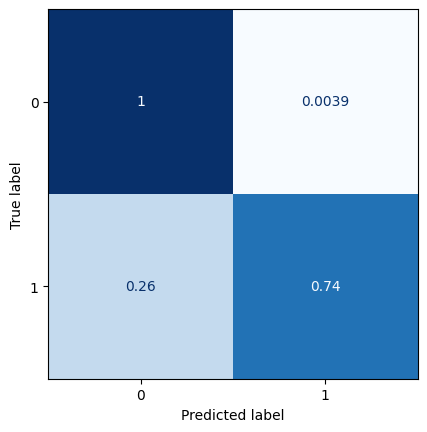

In [18]:
t = model.predict(test_img_std)

ranges = [0.025,0.05,0.075,0.1]

for j in ranges:
    classes = []
    for i in t.reshape(-1,1):
        if i<=j: classes.append(0)
        else: classes.append(1)

# confusion matrix with threshold on 0.1, otherwise always 0 
    ConfusionMatrixDisplay(confusion_matrix(y_test_img.reshape(-1,1), classes)).plot(colorbar=False,cmap=plt.cm.Blues, values_format='d')
    ConfusionMatrixDisplay(confusion_matrix(y_test_img.reshape(-1,1), classes, normalize='true')).plot(colorbar=False,cmap=plt.cm.Blues)
    

In [7]:
922821+3583+919+2359

929682

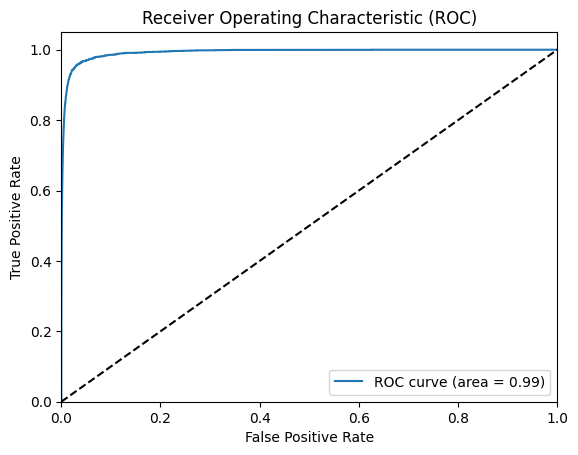

In [19]:
plot_roc(t.reshape(-1,1),y_test_img.reshape(-1,1))

9


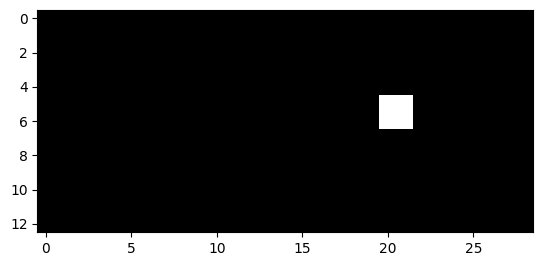

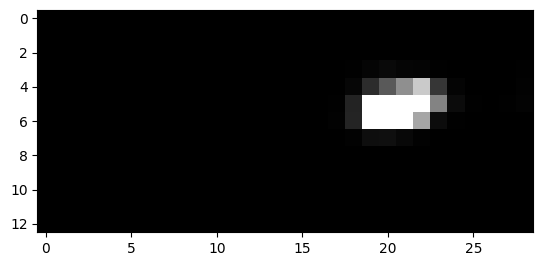

10


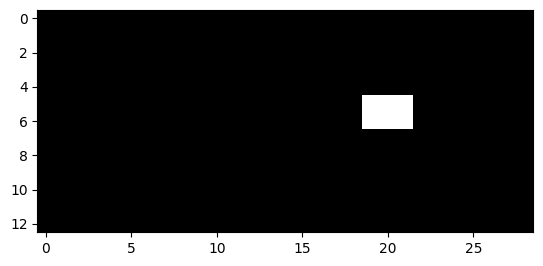

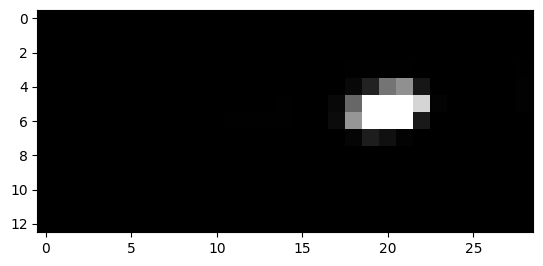

11


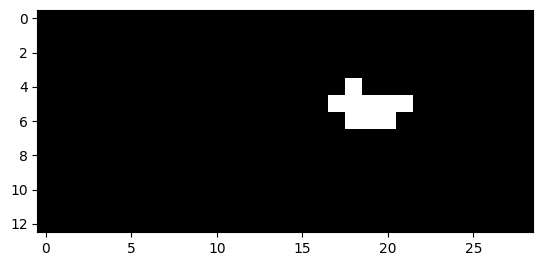

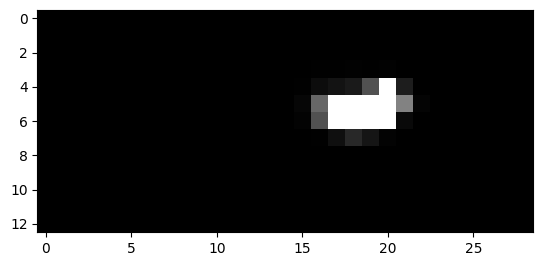

12


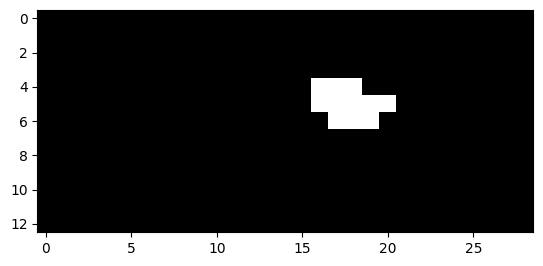

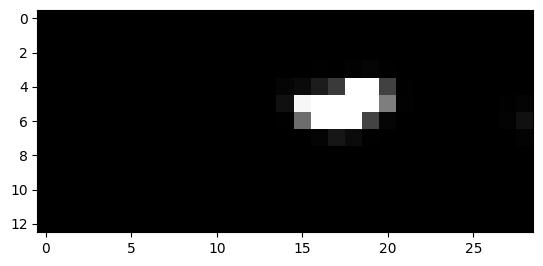

13


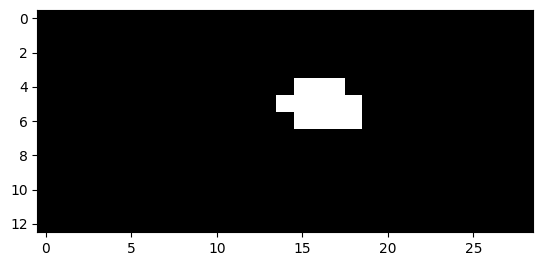

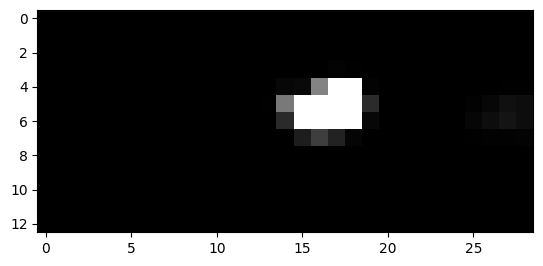

14


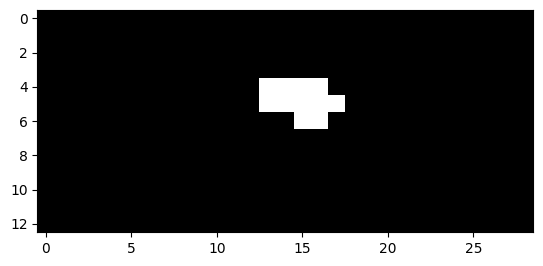

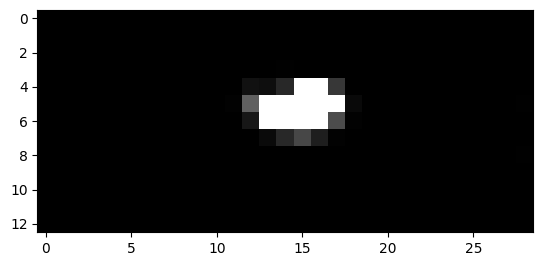

15


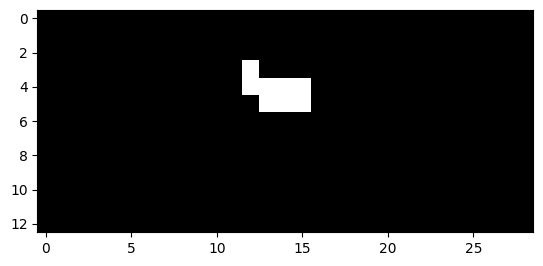

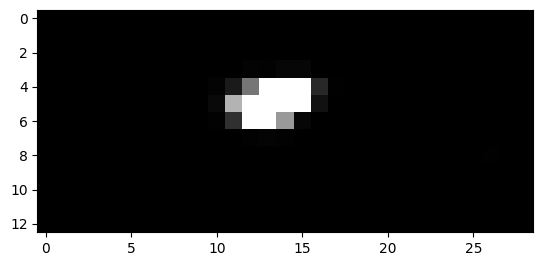

16


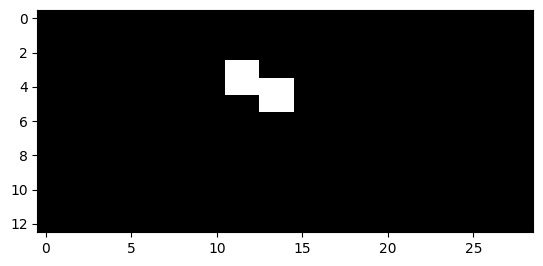

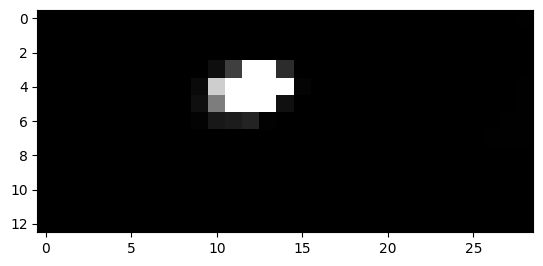

17


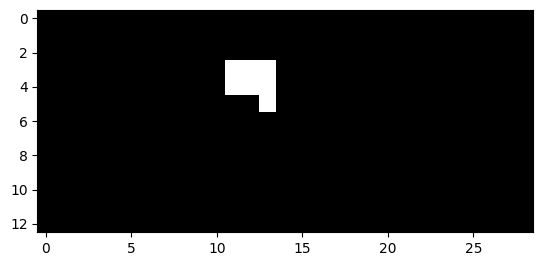

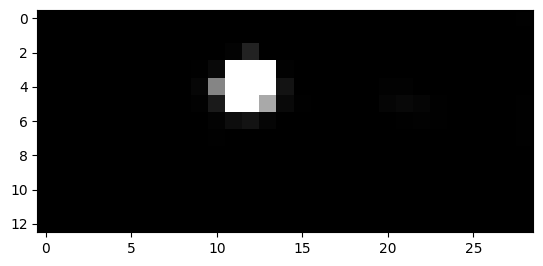

18


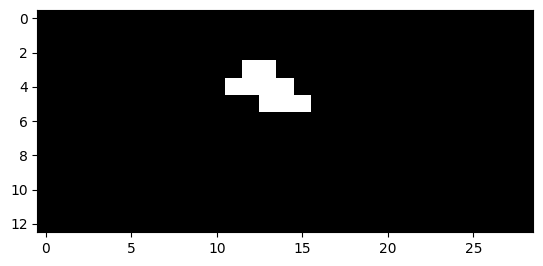

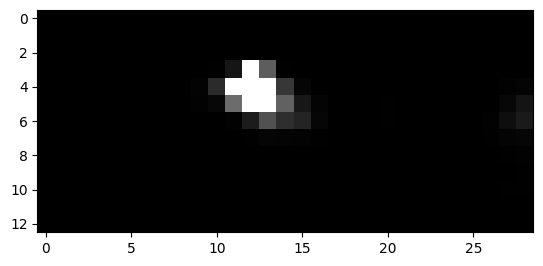

19


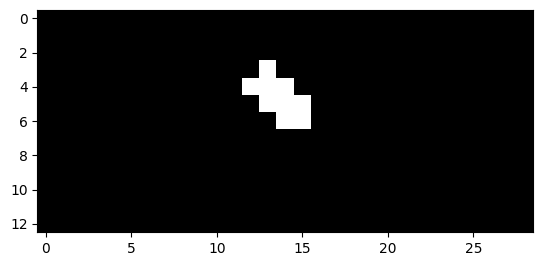

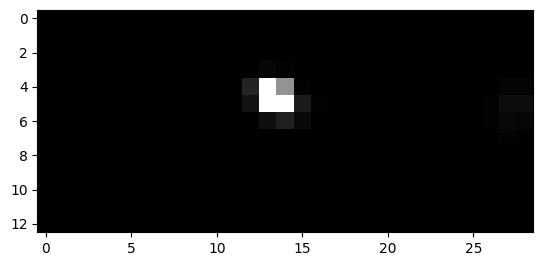

20


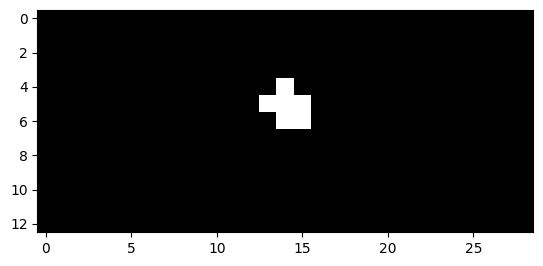

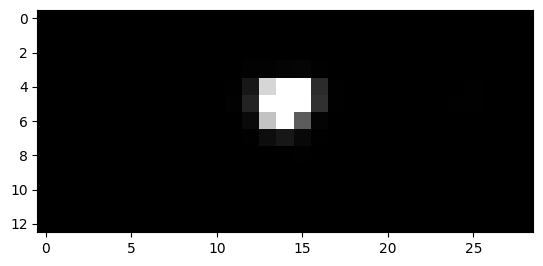

21


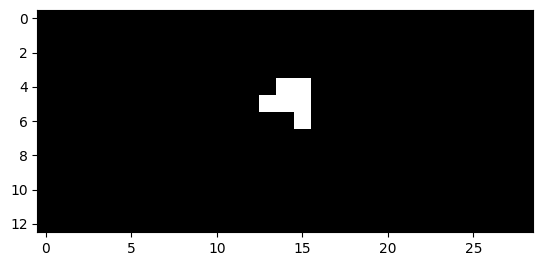

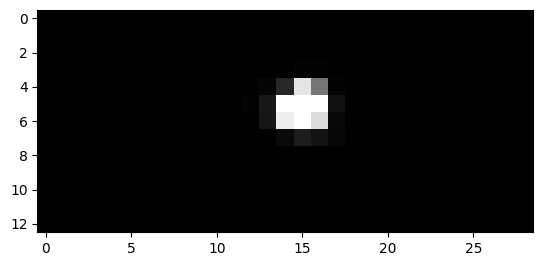

22


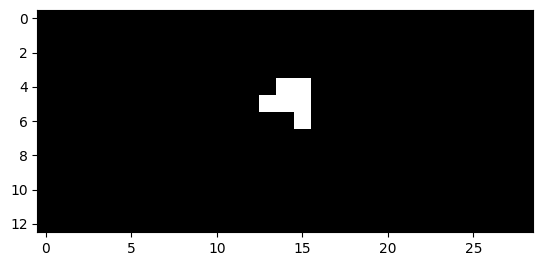

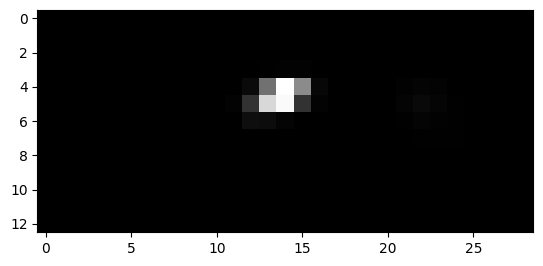

105


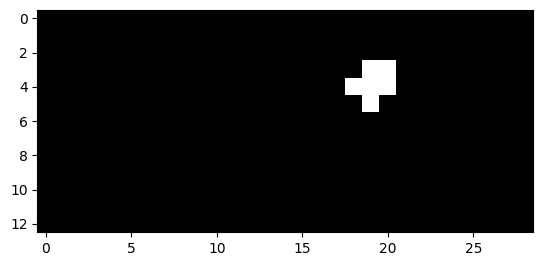

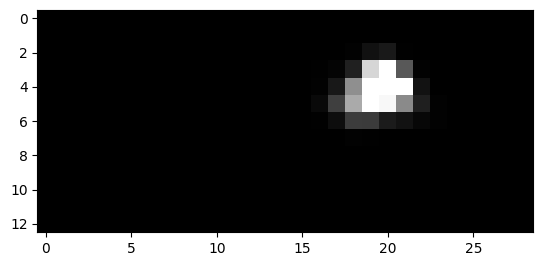

106


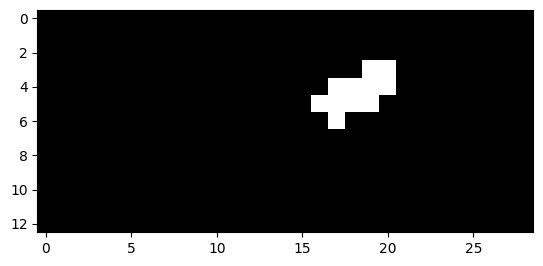

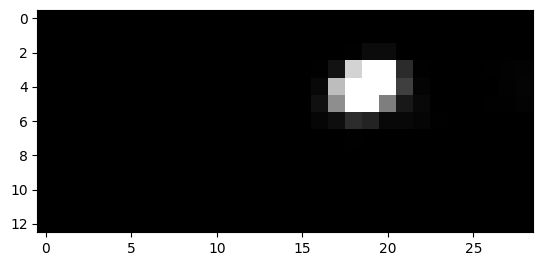

107


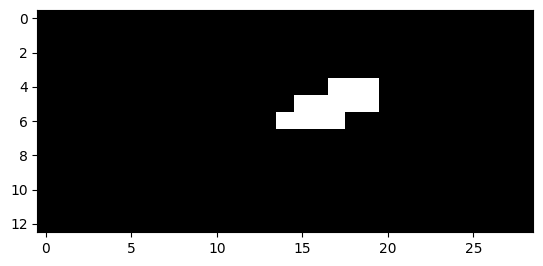

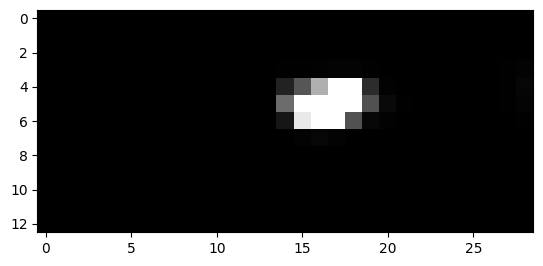

108


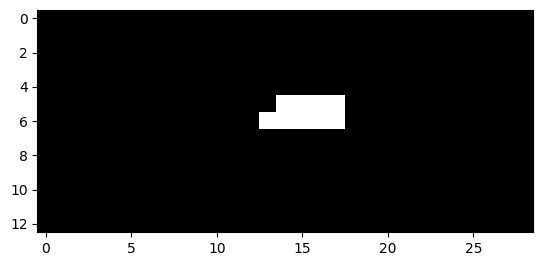

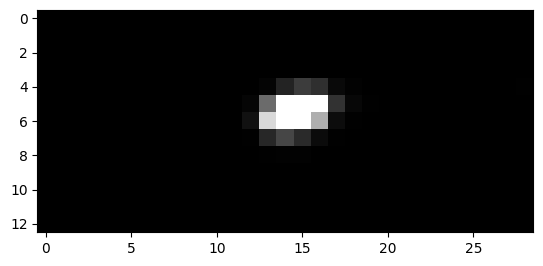

109


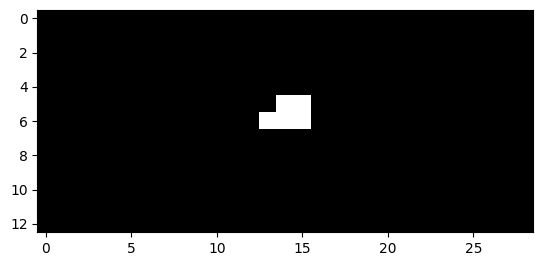

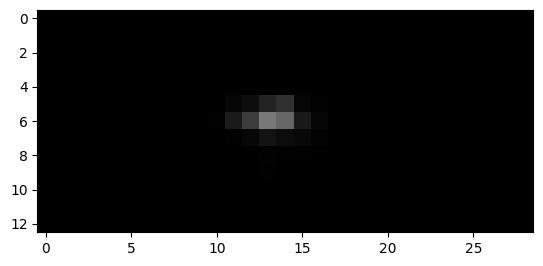

184


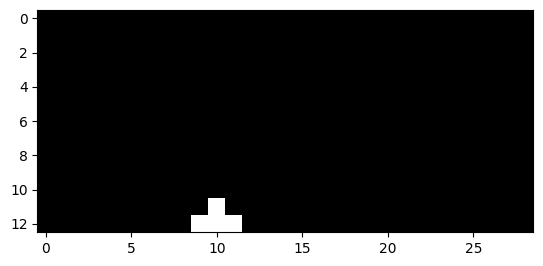

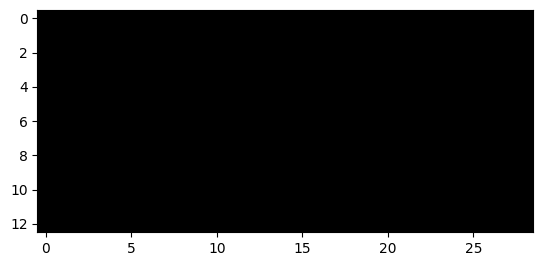

185


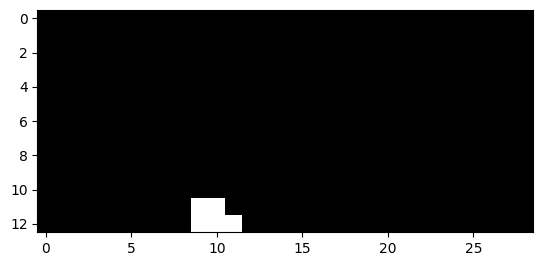

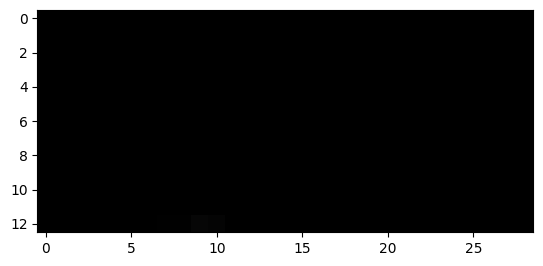

186


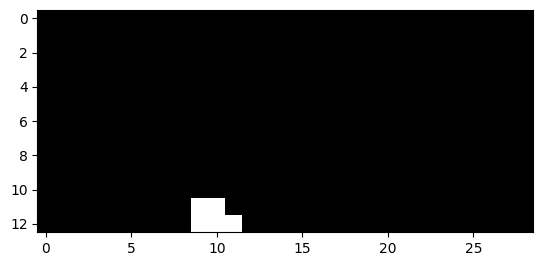

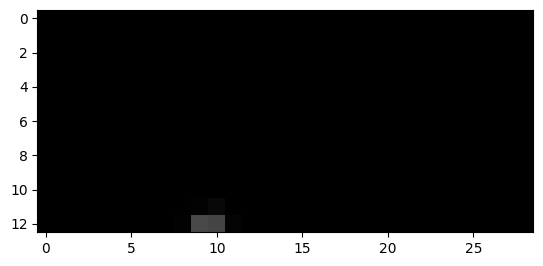

187


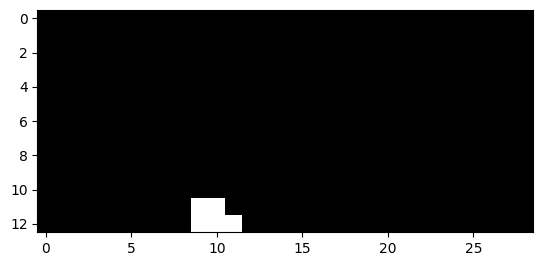

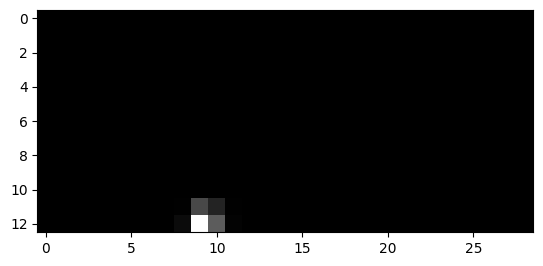

188


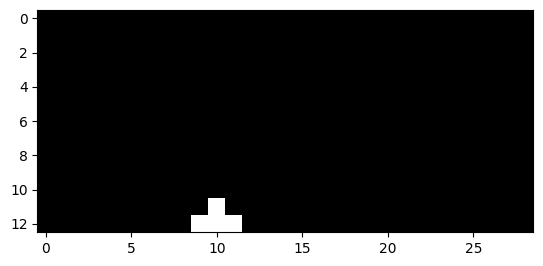

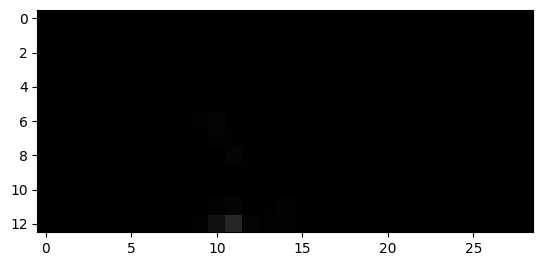

308


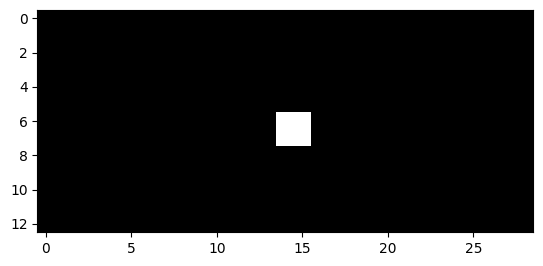

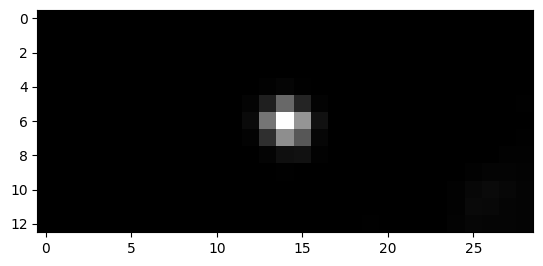

309


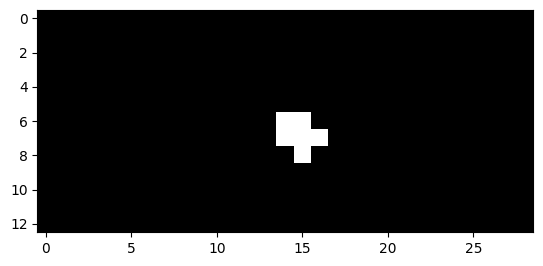

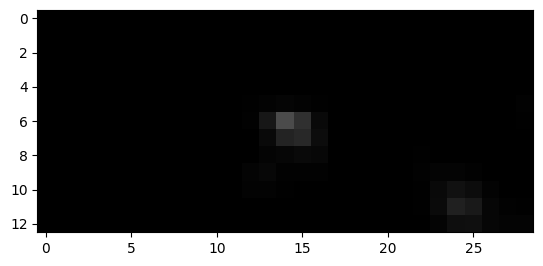

310


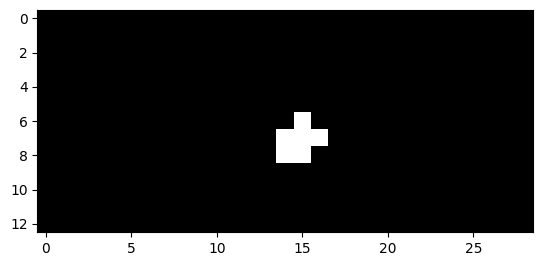

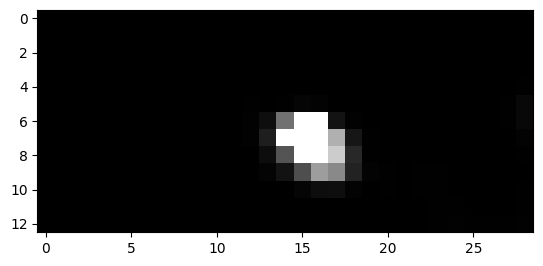

311


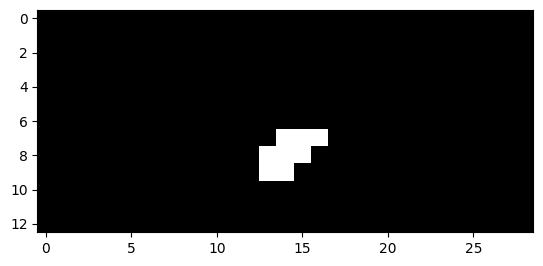

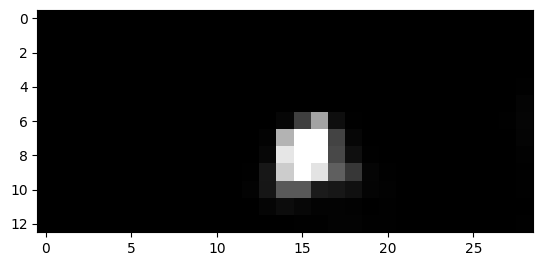

312


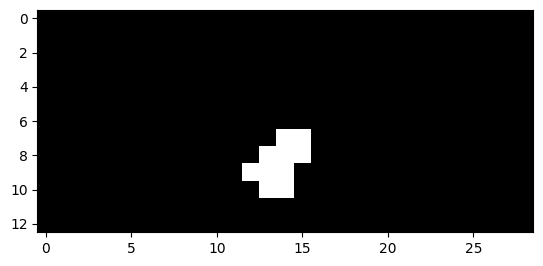

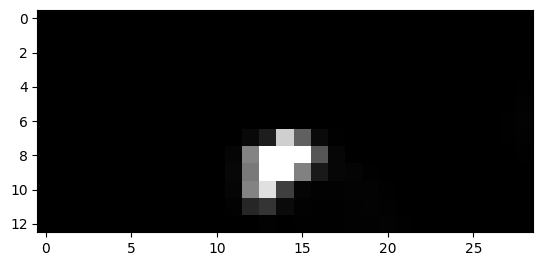

313


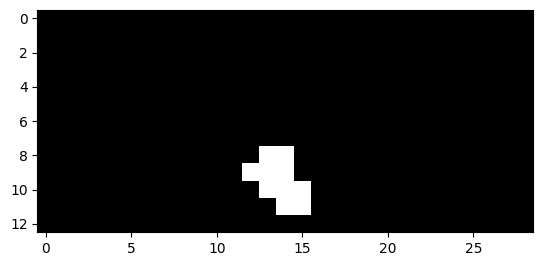

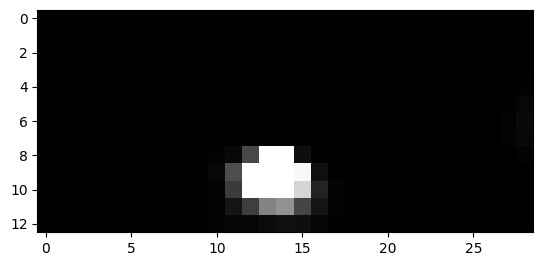

314


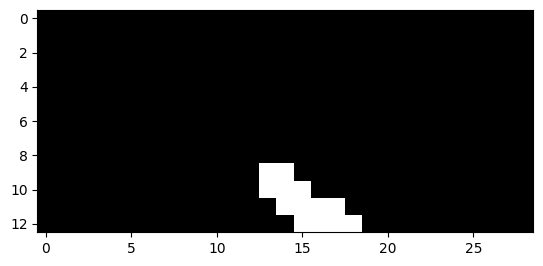

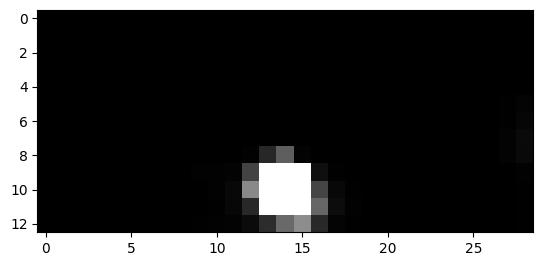

315


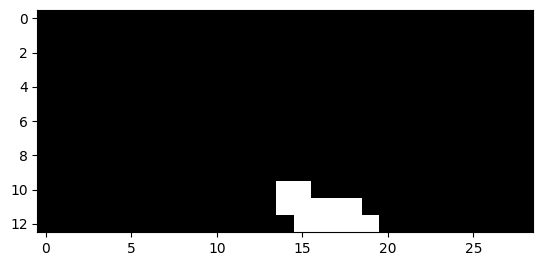

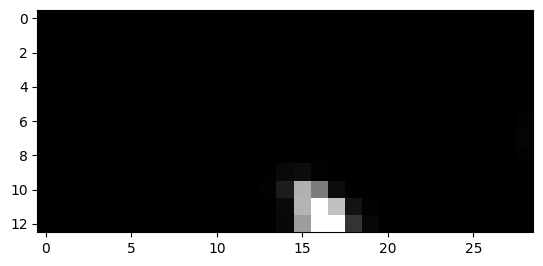

316


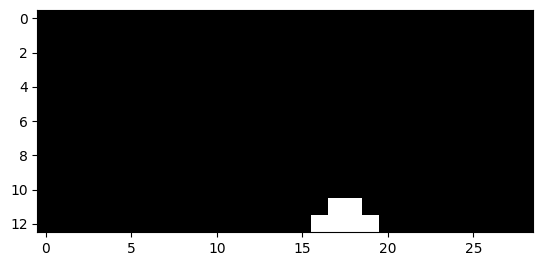

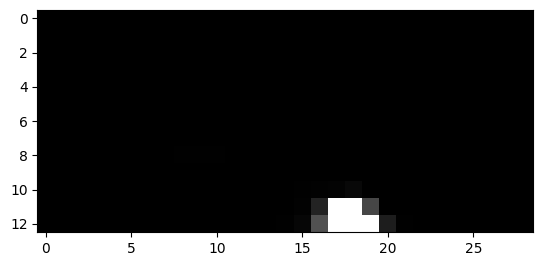

317


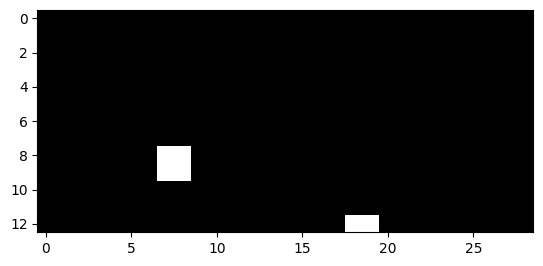

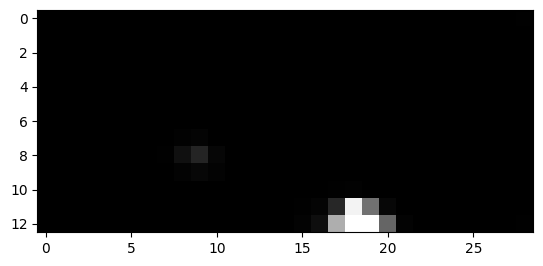

318


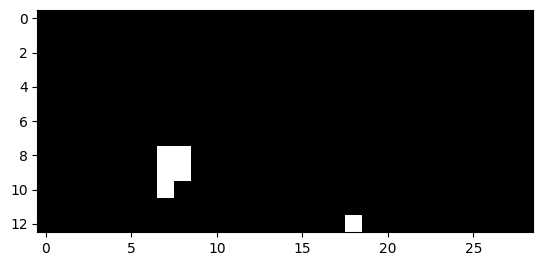

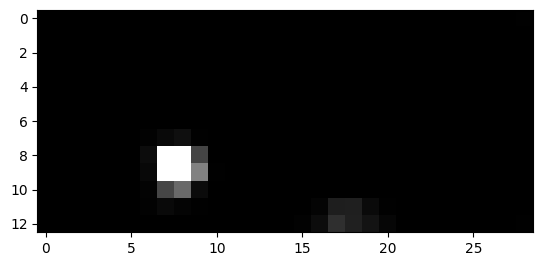

319


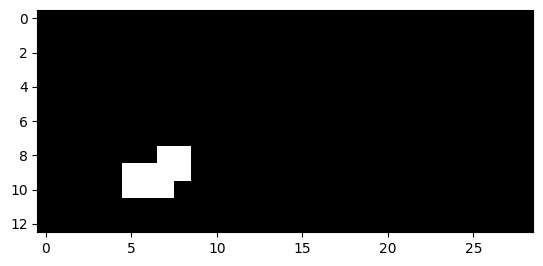

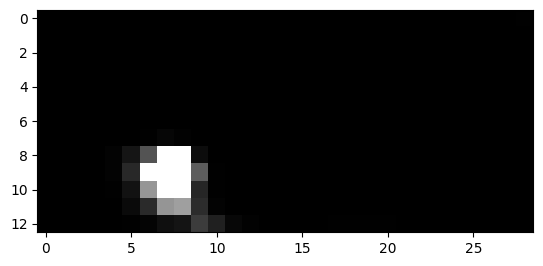

320


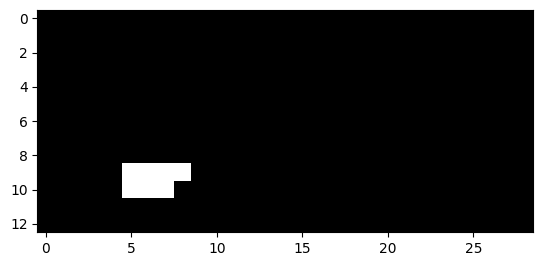

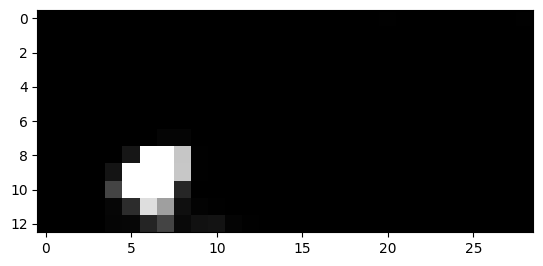

321


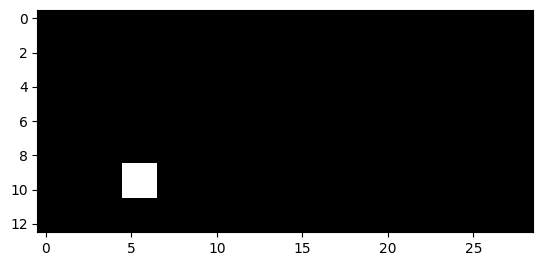

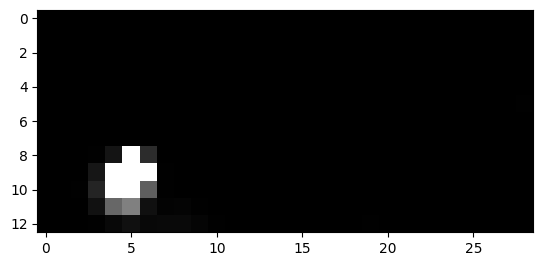

335


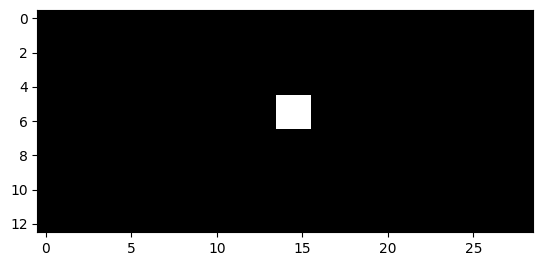

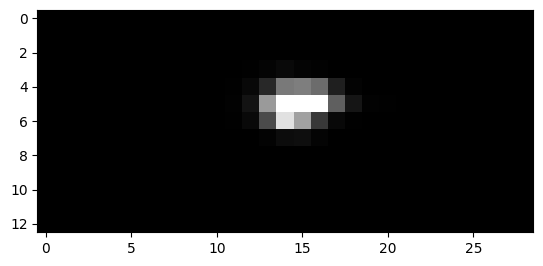

336


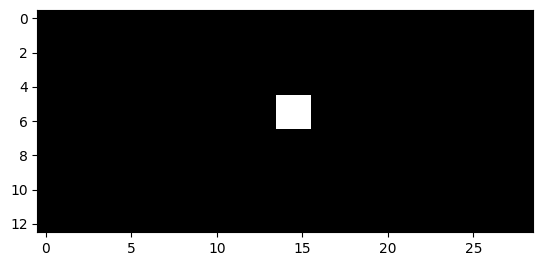

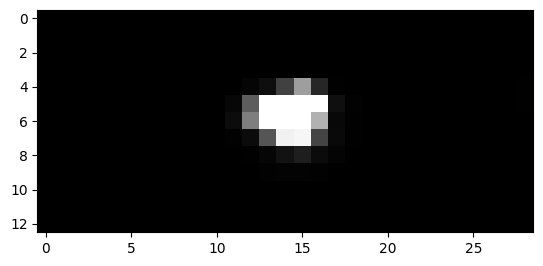

337


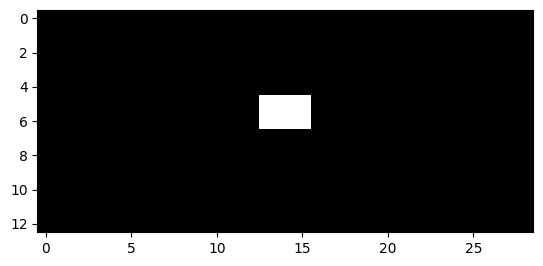

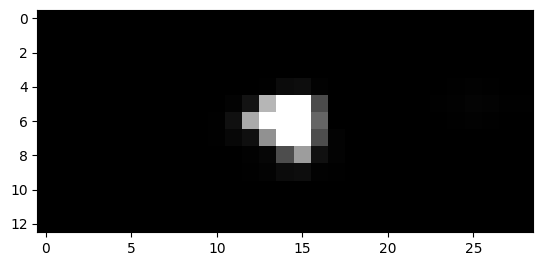

338


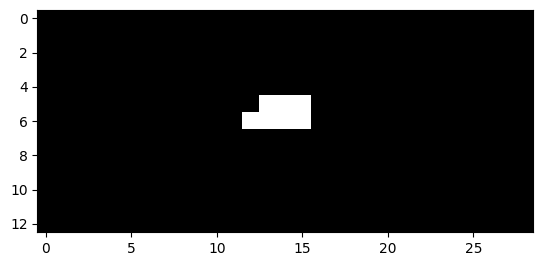

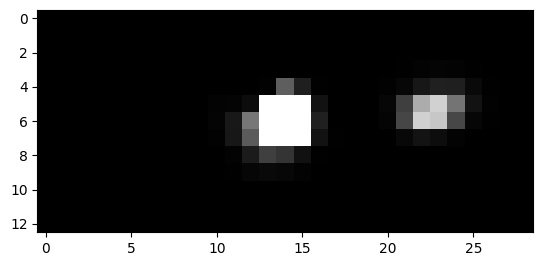

339


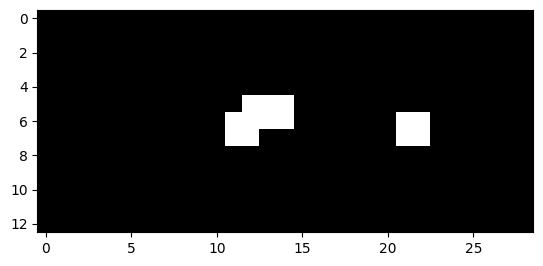

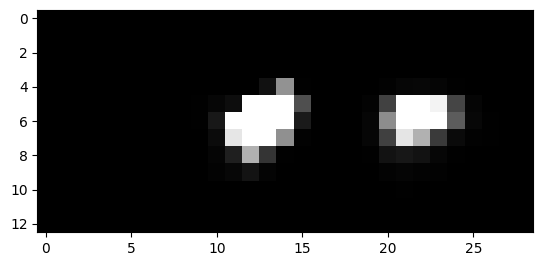

340


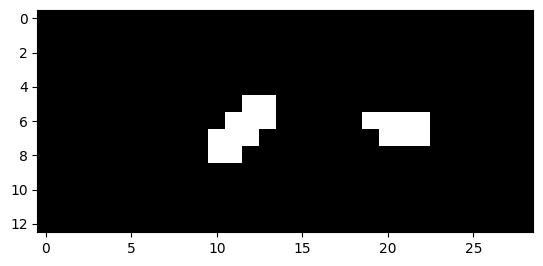

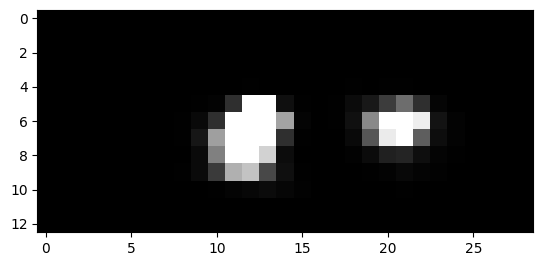

341


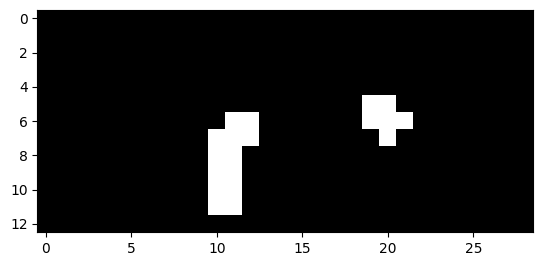

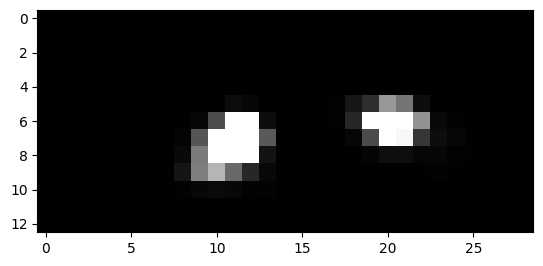

342


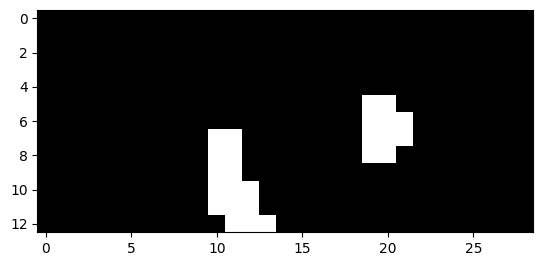

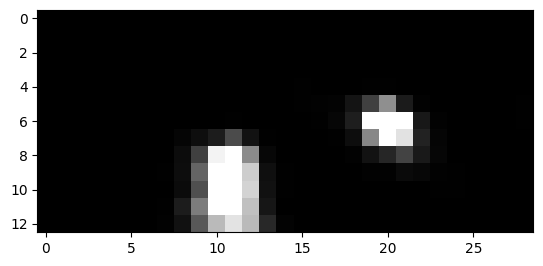

343


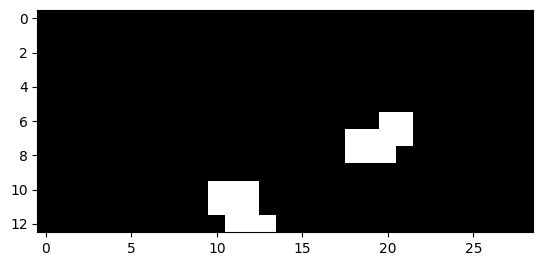

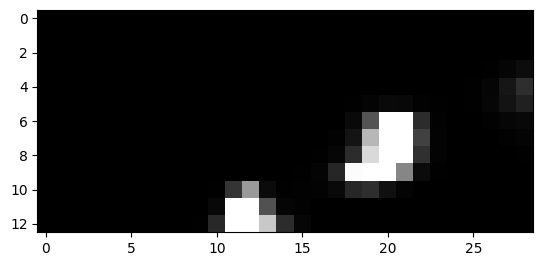

344


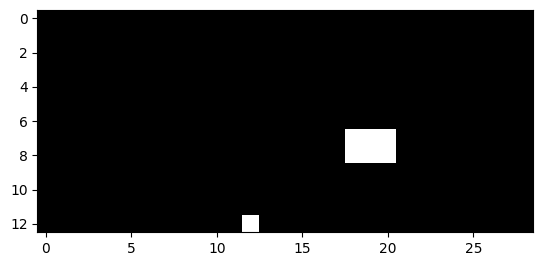

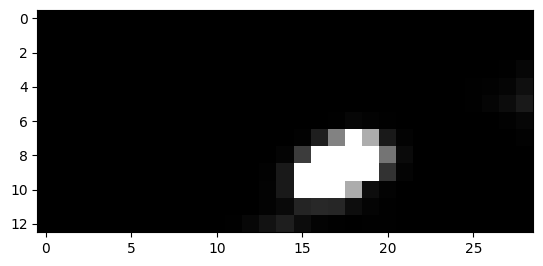

346


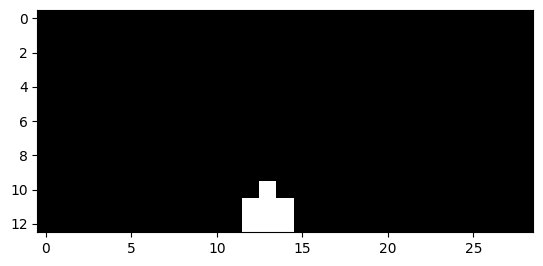

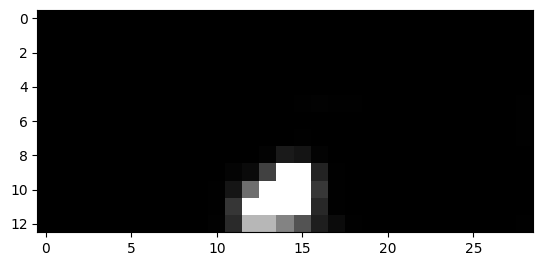

347


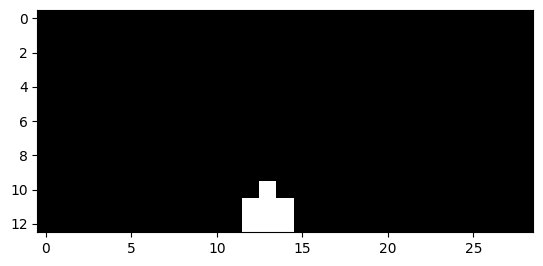

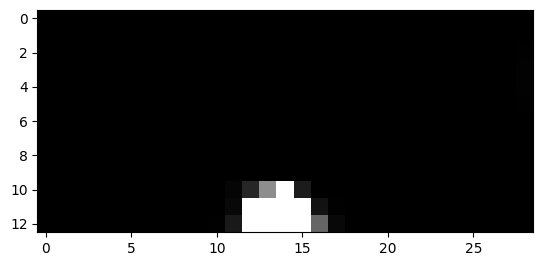

348


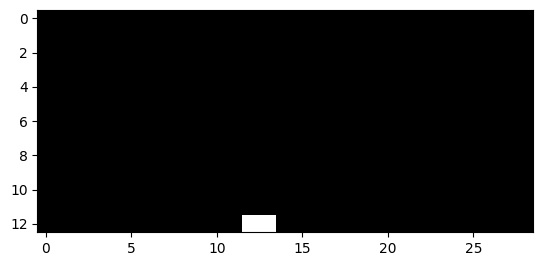

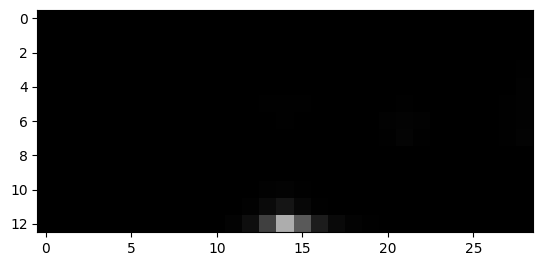

640


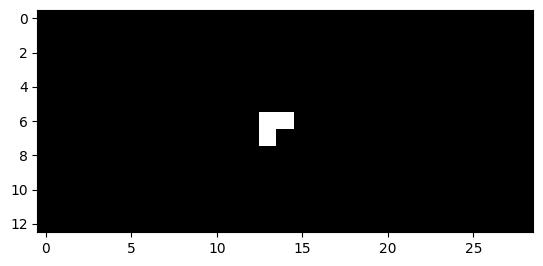

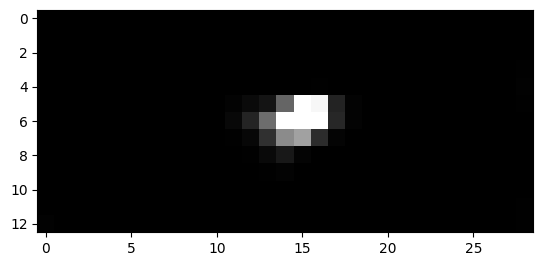

641


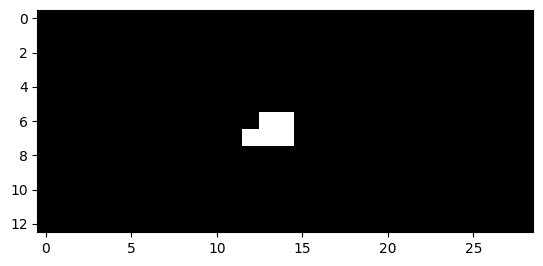

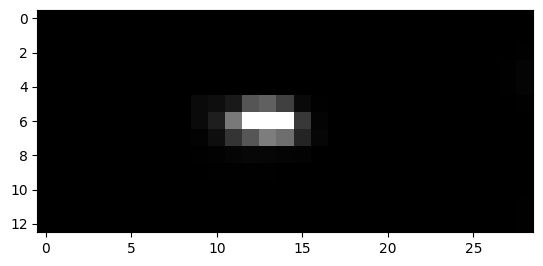

642


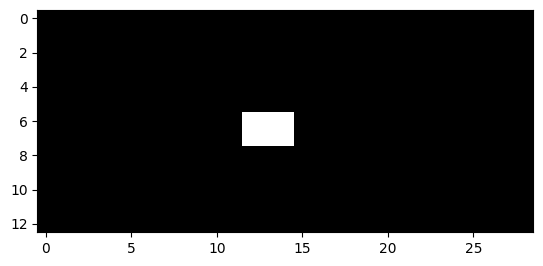

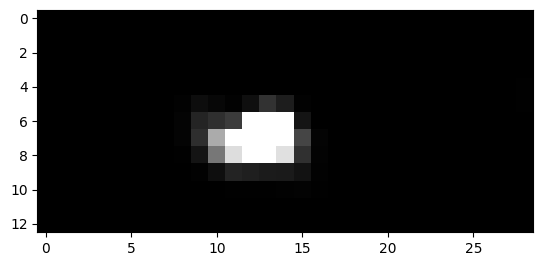

643


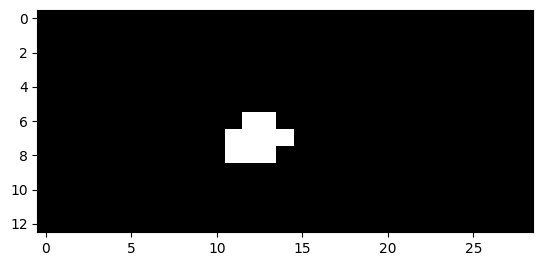

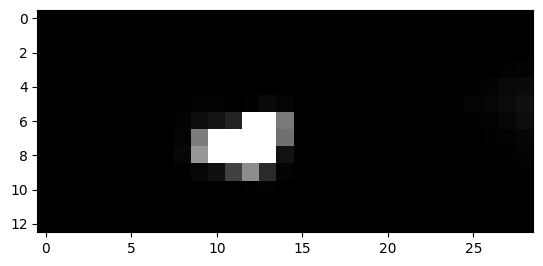

644


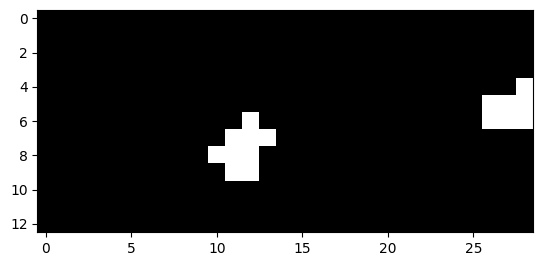

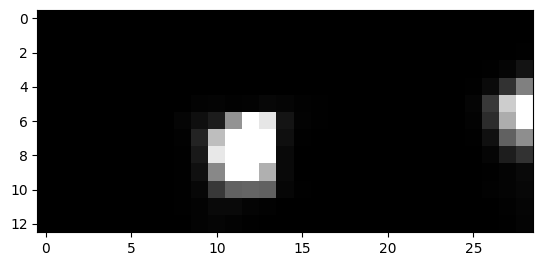

645


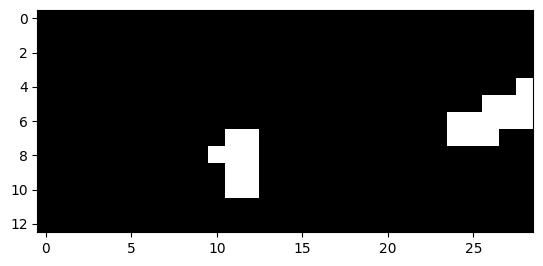

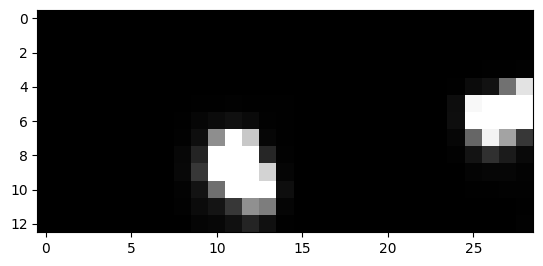

646


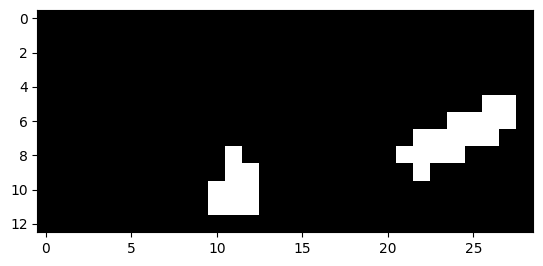

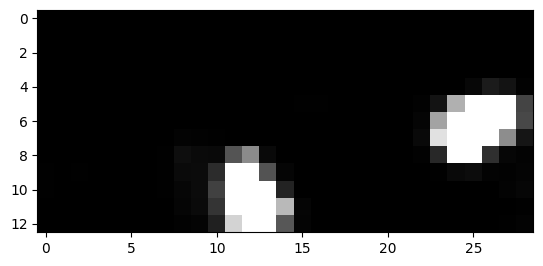

647


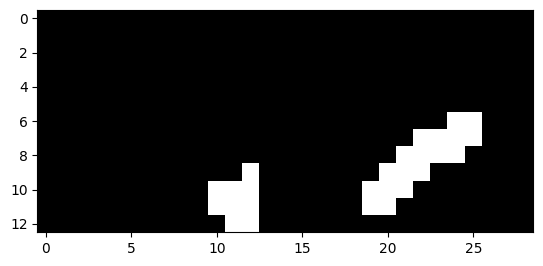

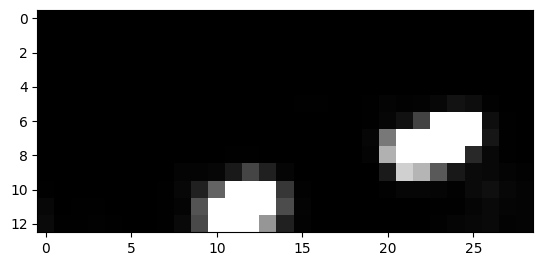

648


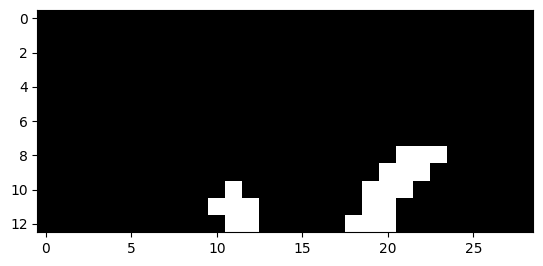

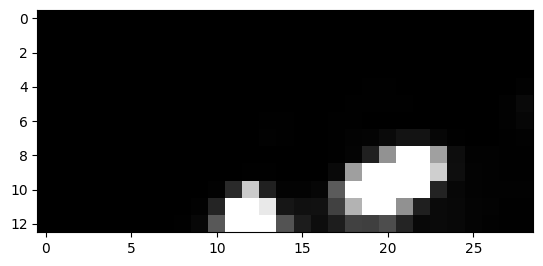

649


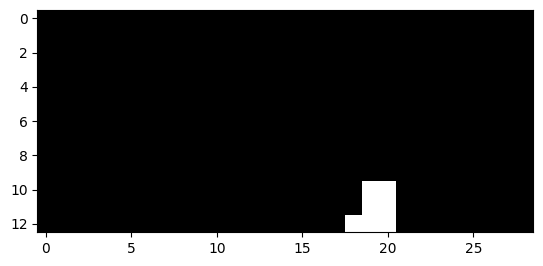

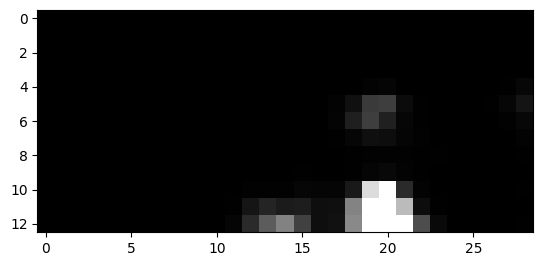

651


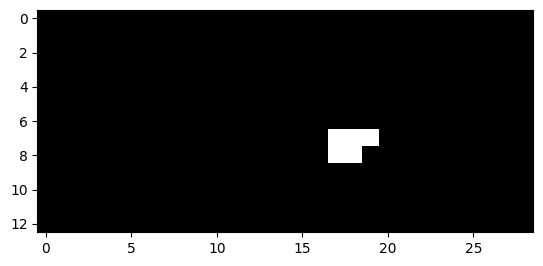

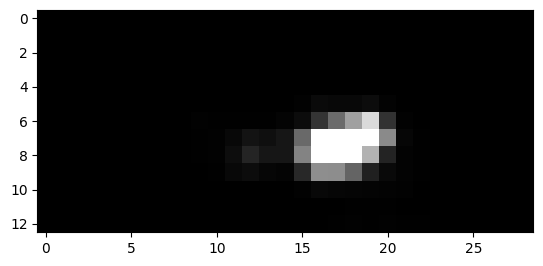

652


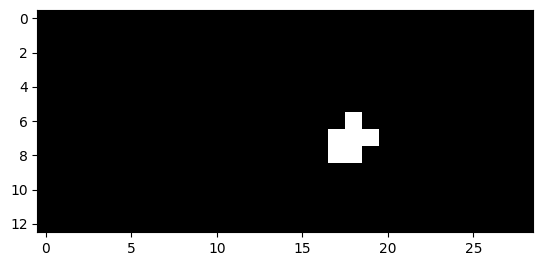

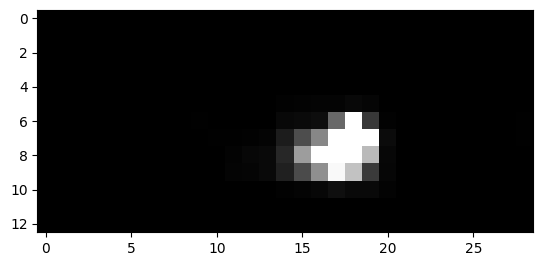

653


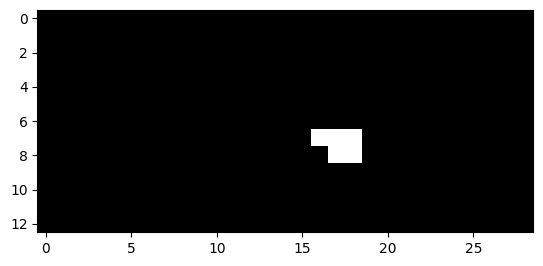

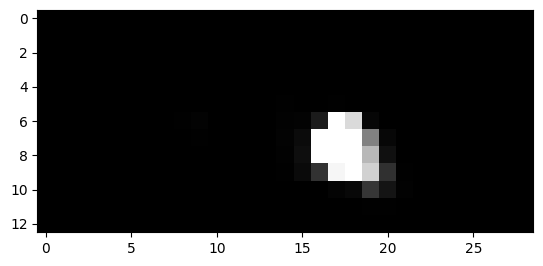

654


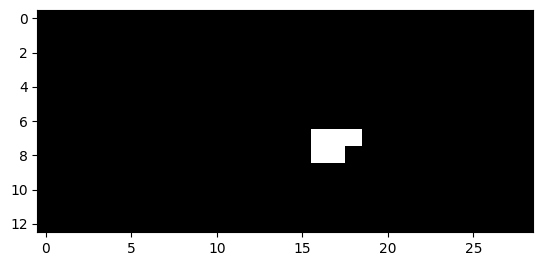

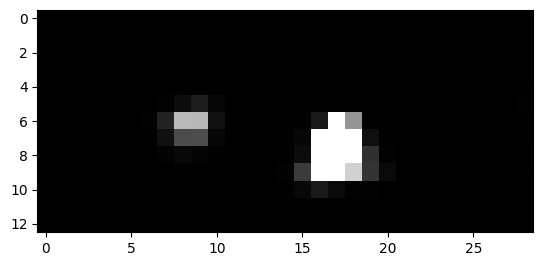

655


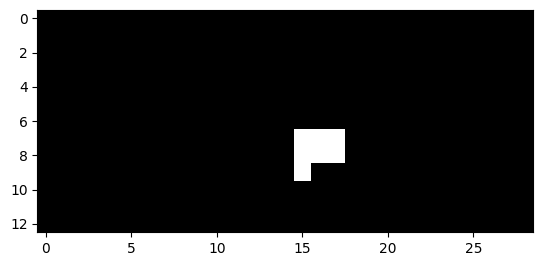

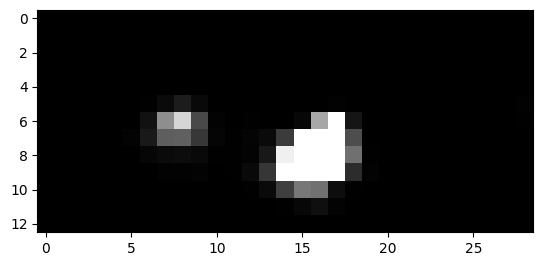

656


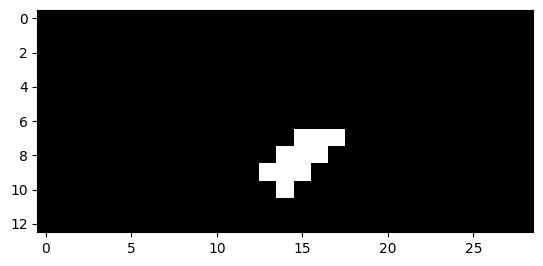

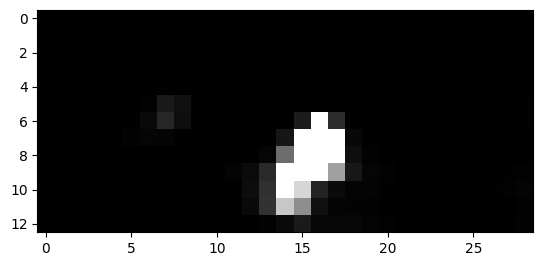

657


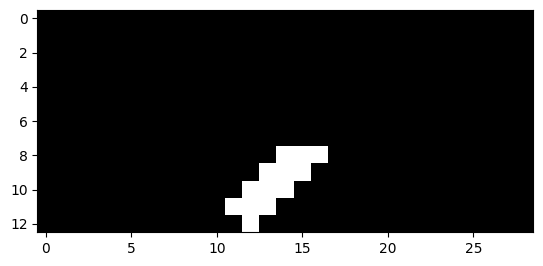

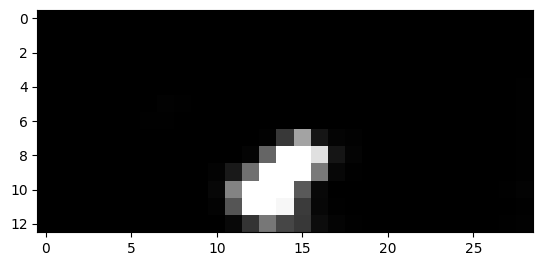

658


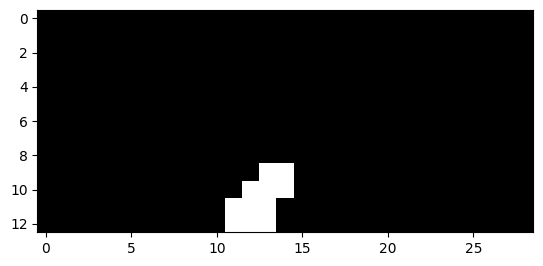

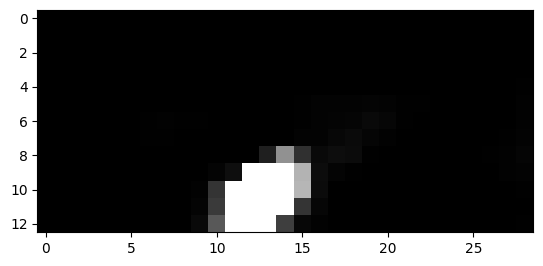

659


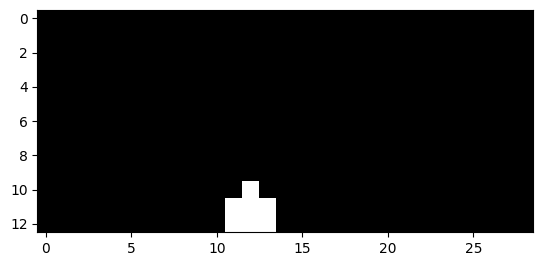

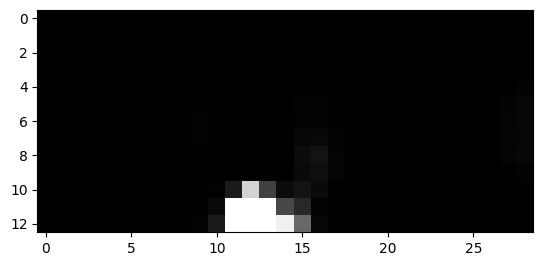

665


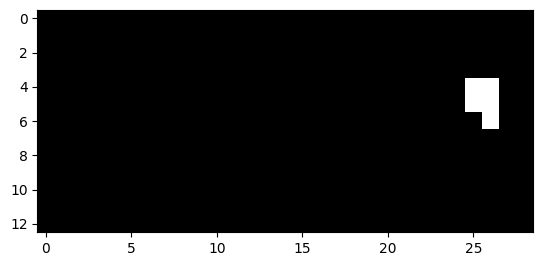

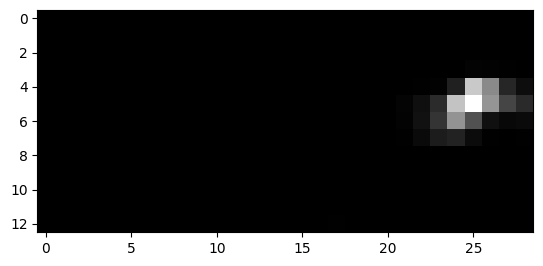

666


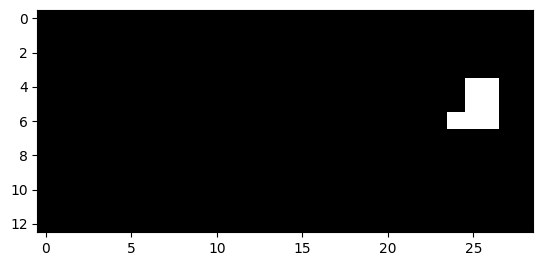

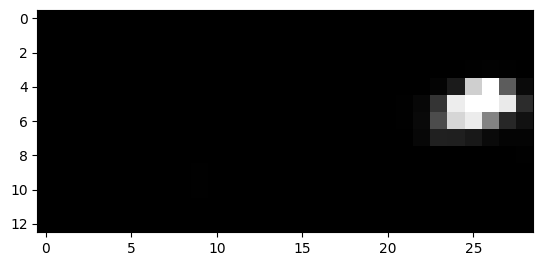

667


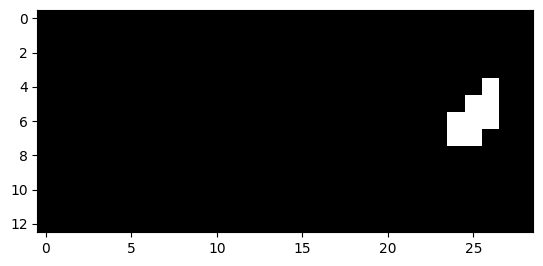

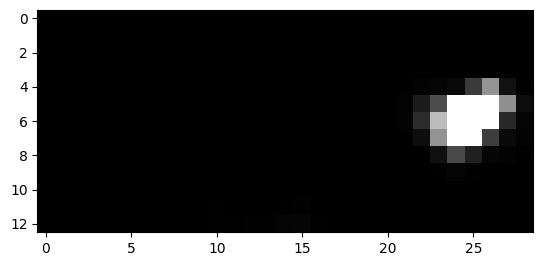

668


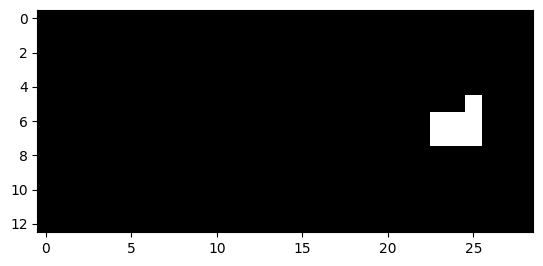

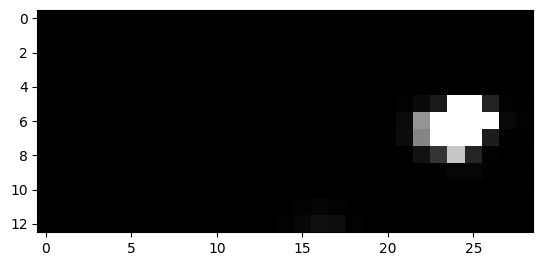

669


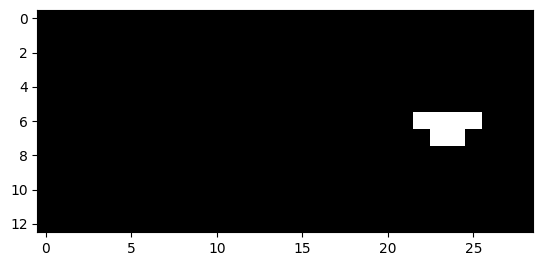

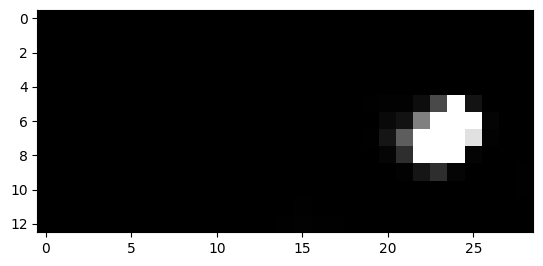

670


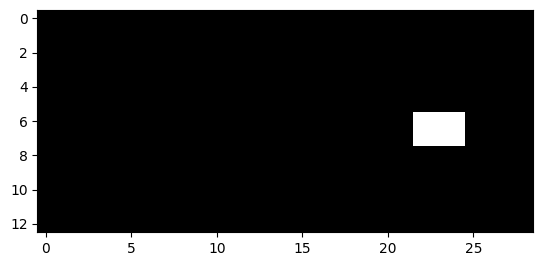

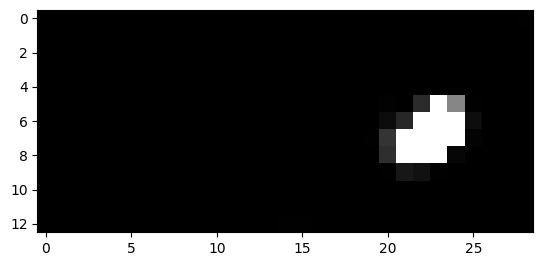

671


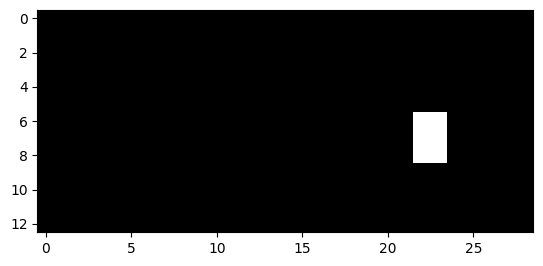

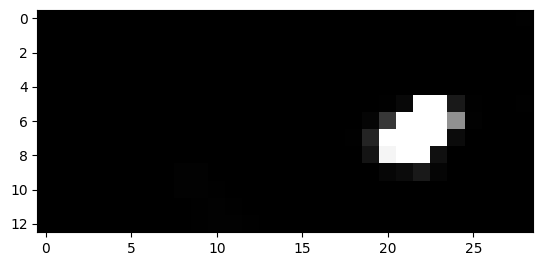

672


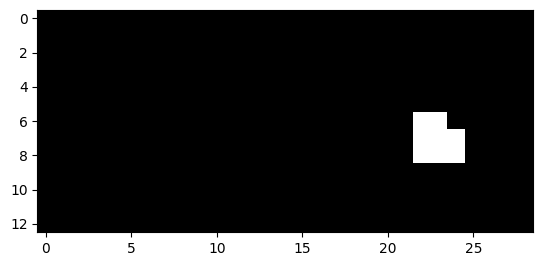

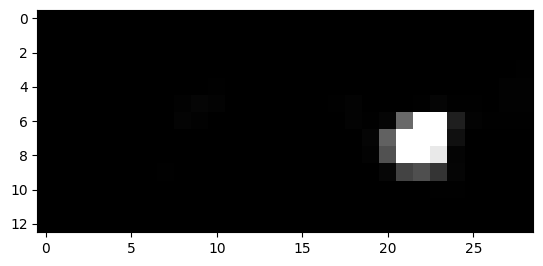

673


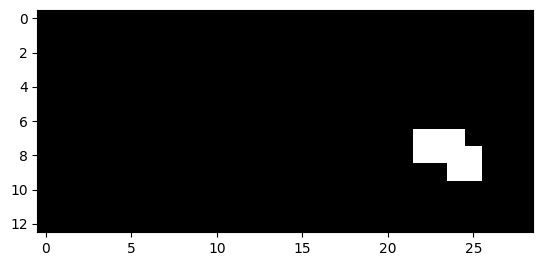

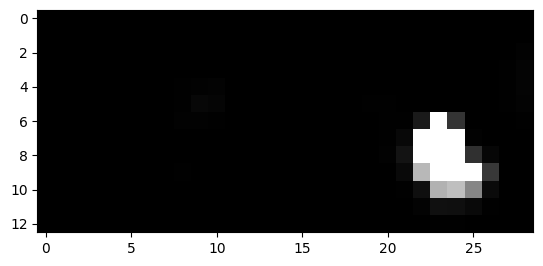

674


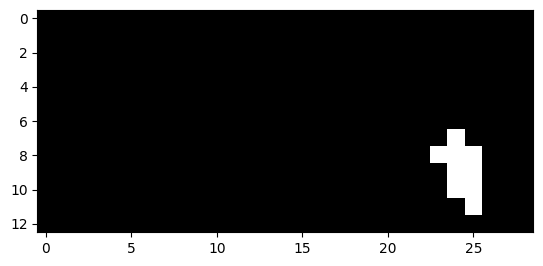

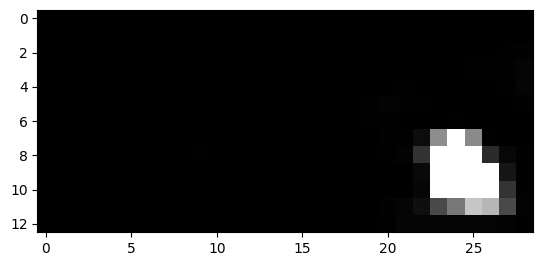

675


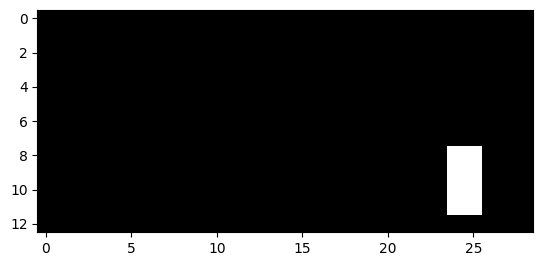

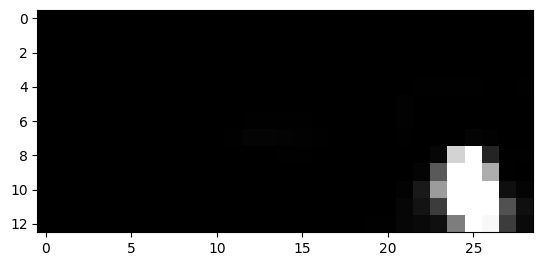

676


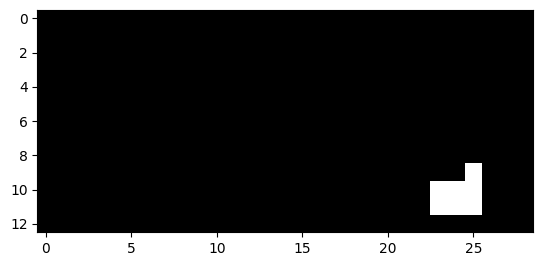

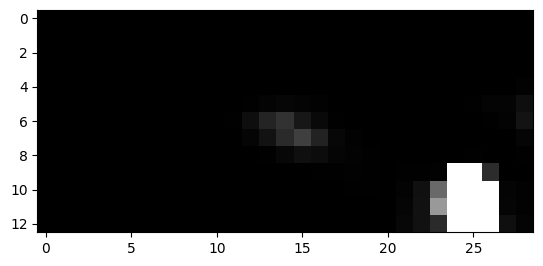

677


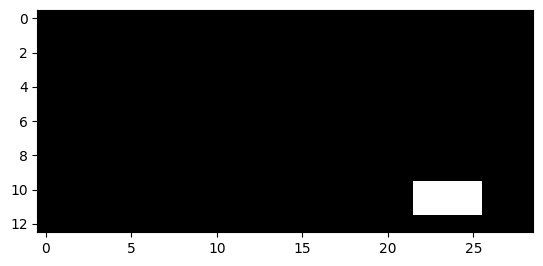

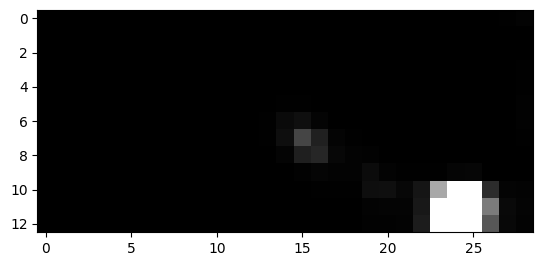

678


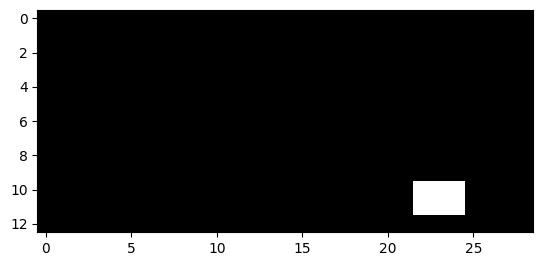

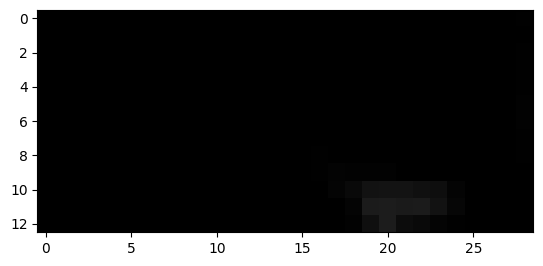

699


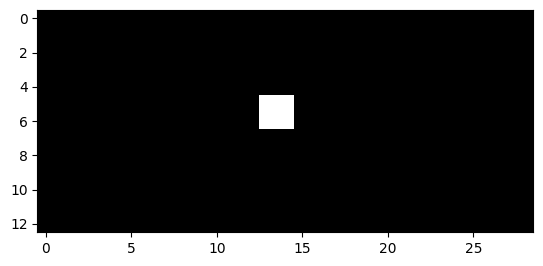

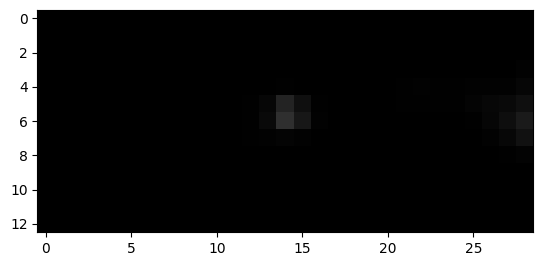

700


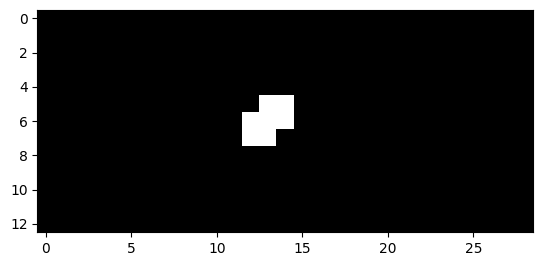

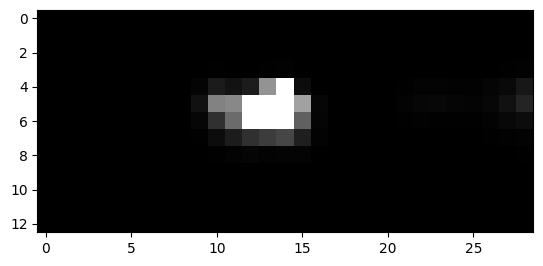

701


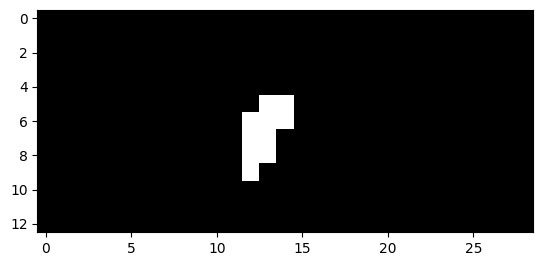

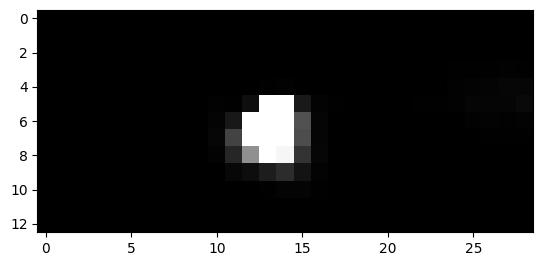

702


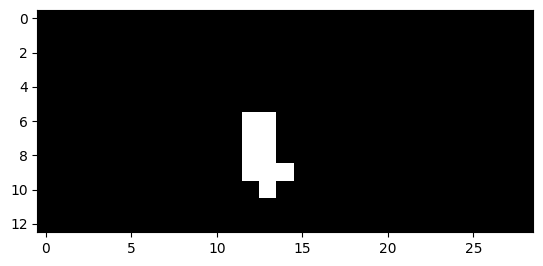

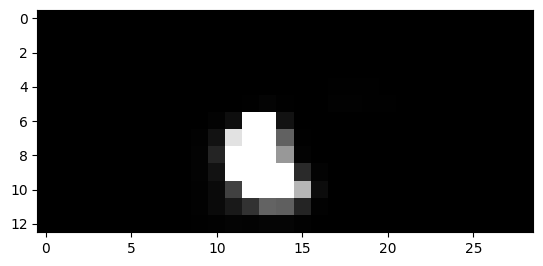

703


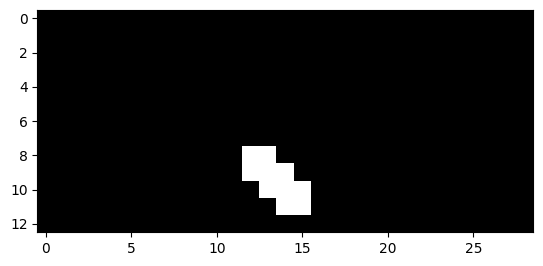

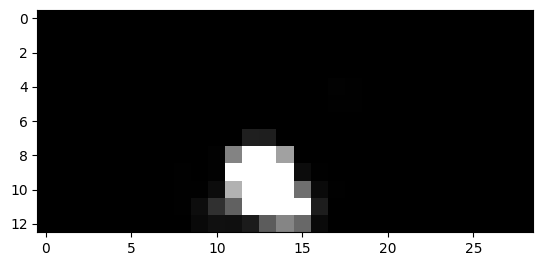

704


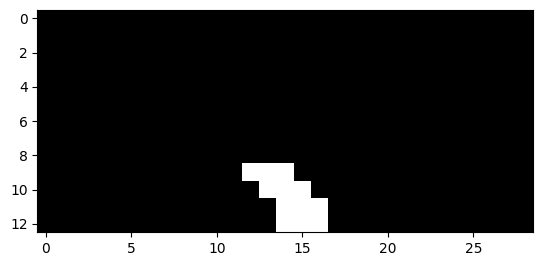

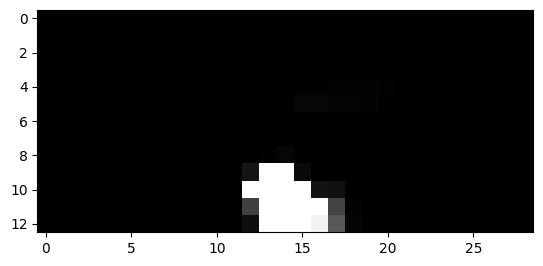

705


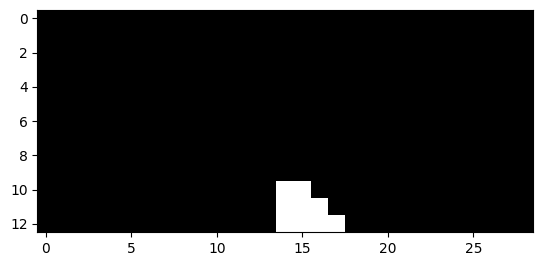

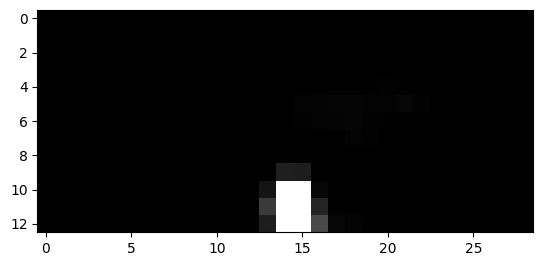

706


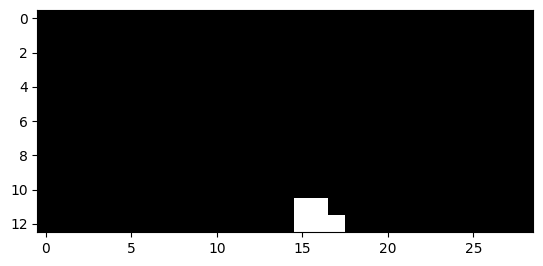

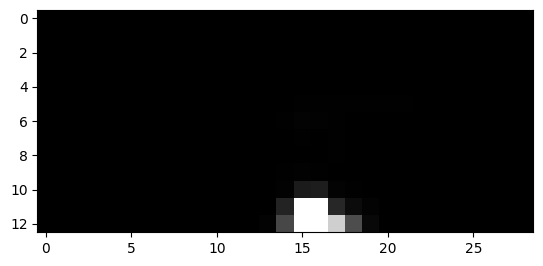

711


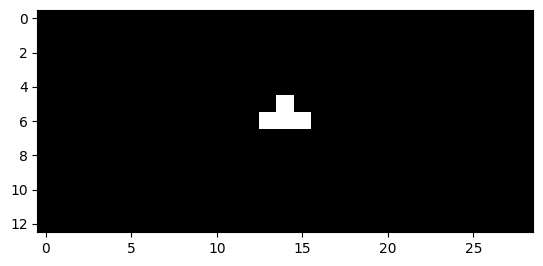

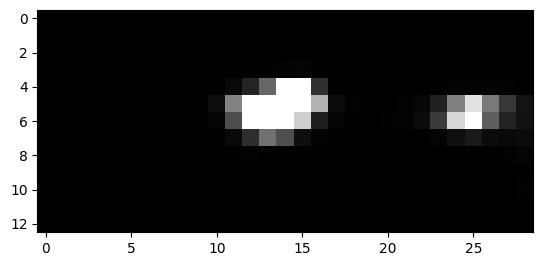

712


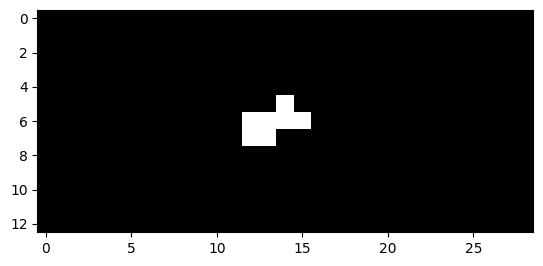

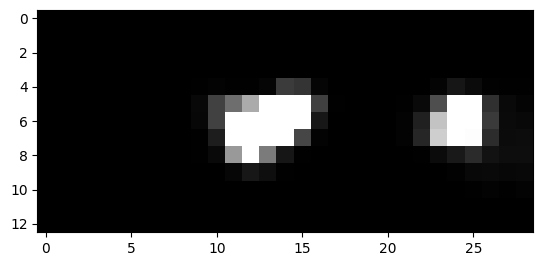

713


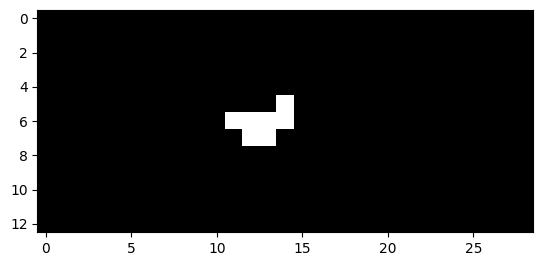

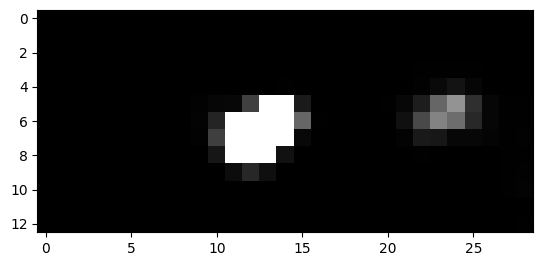

714


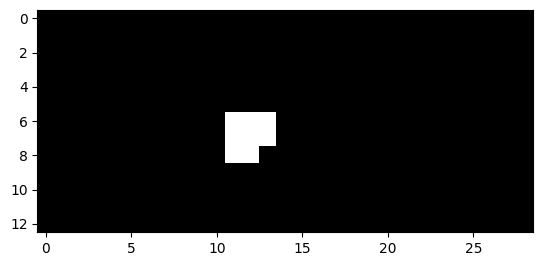

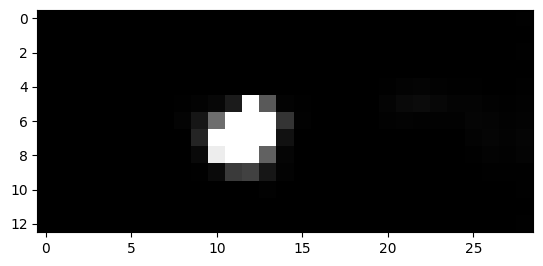

715


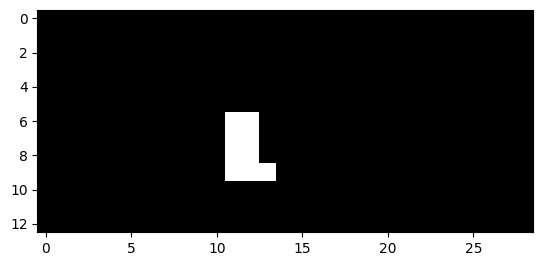

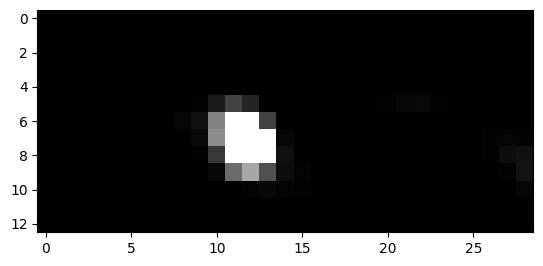

716


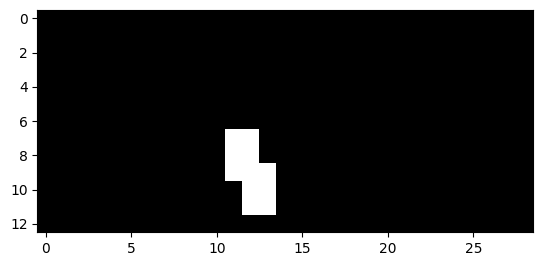

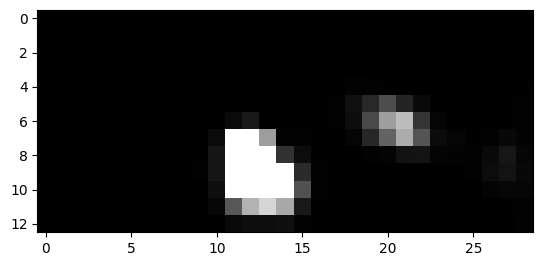

717


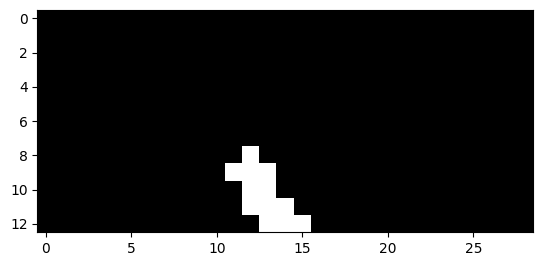

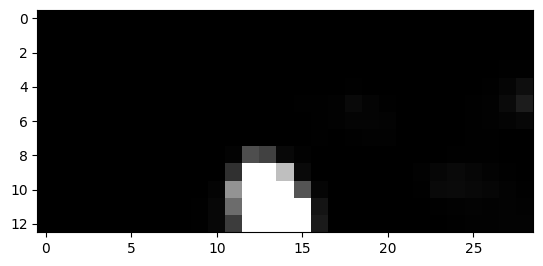

718


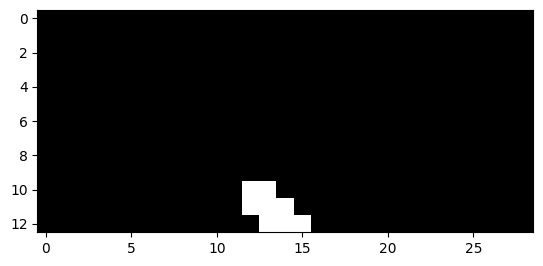

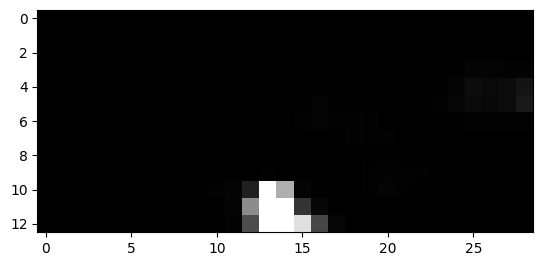

719


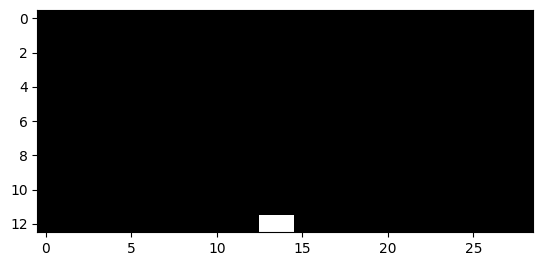

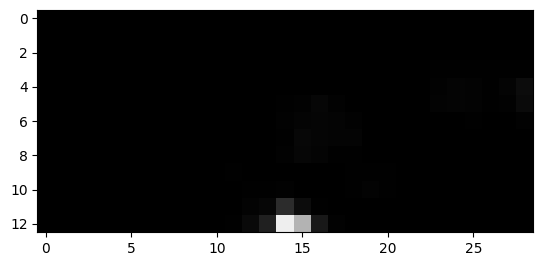

751


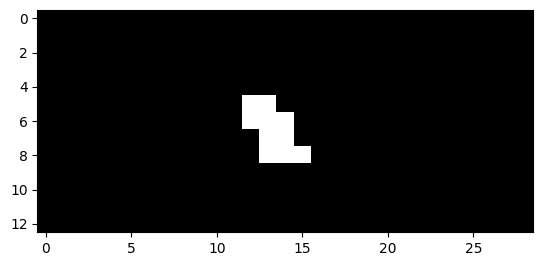

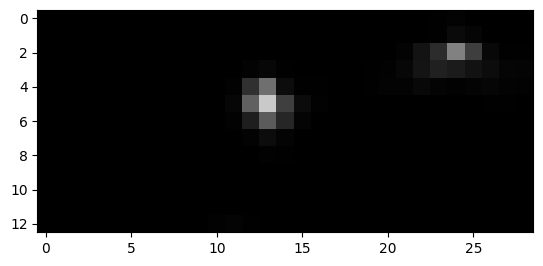

752


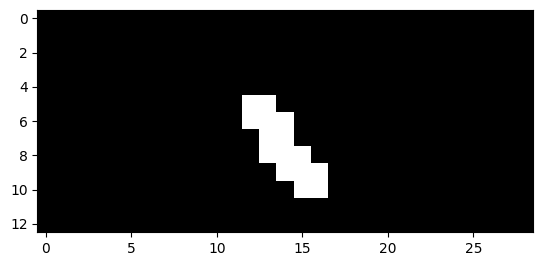

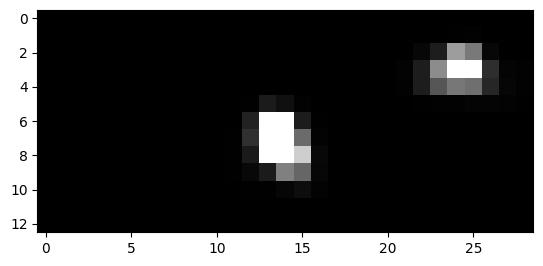

753


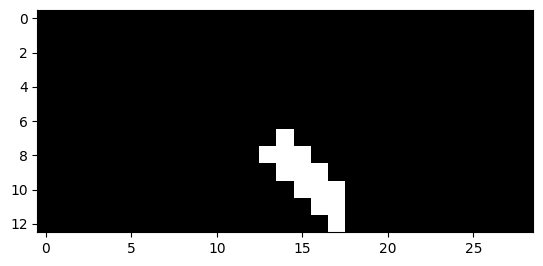

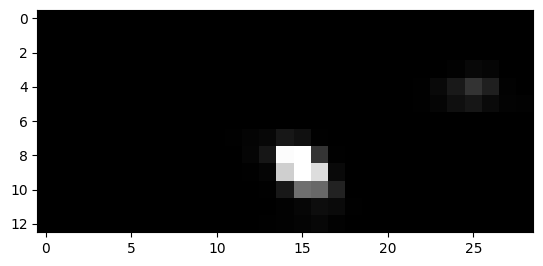

754


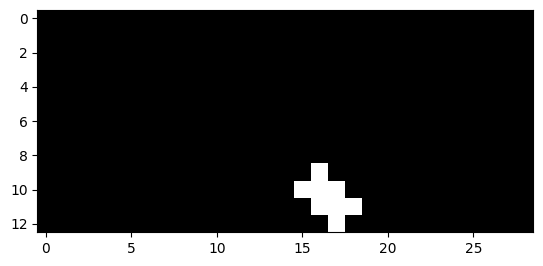

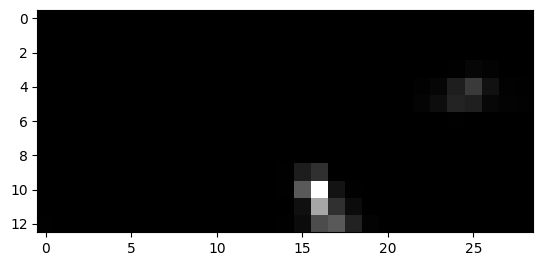

755


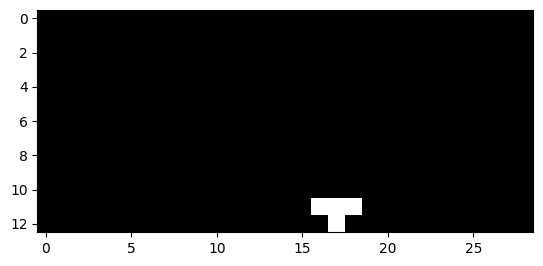

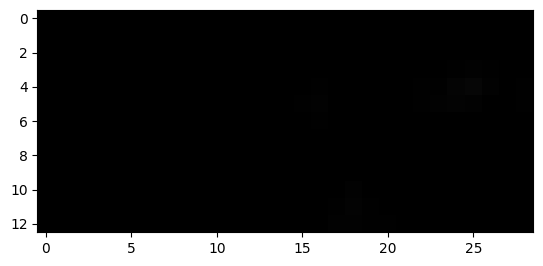

756


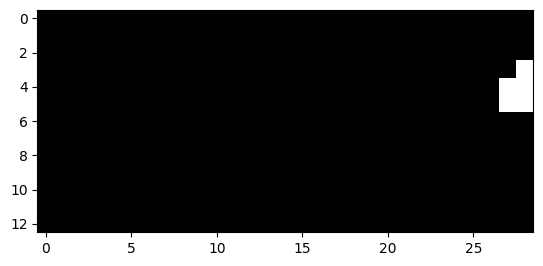

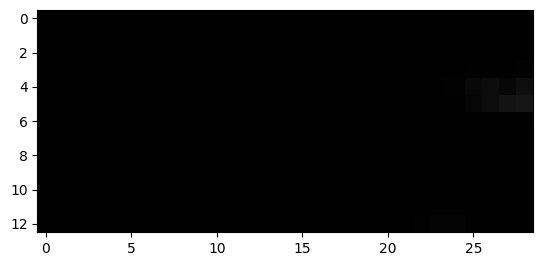

757


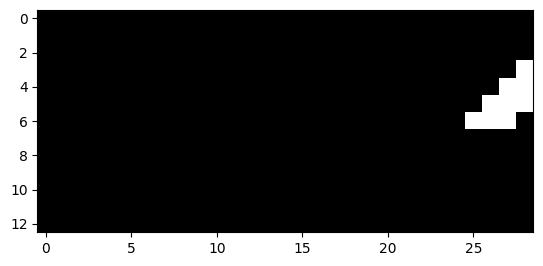

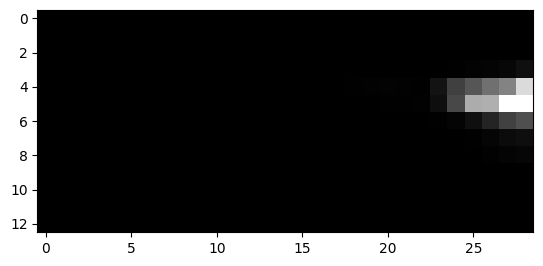

758


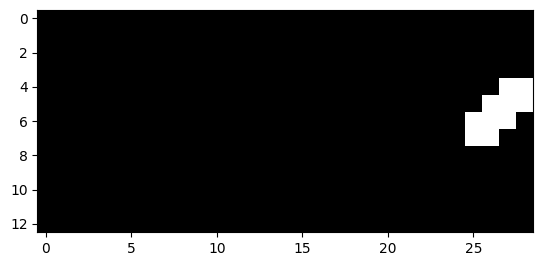

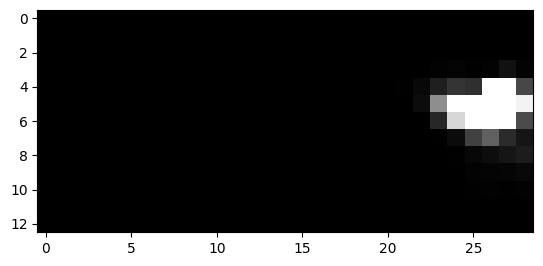

759


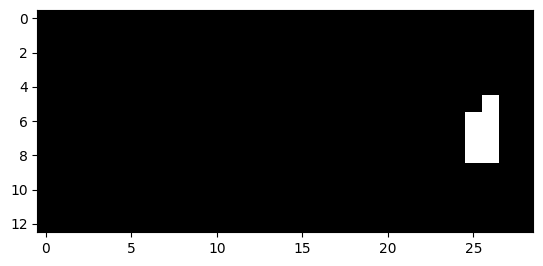

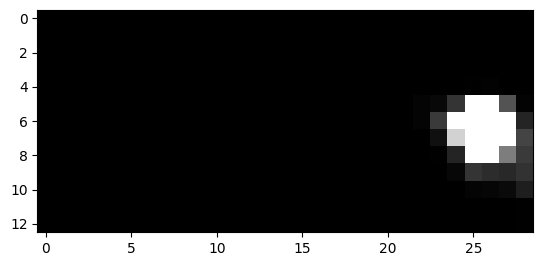

760


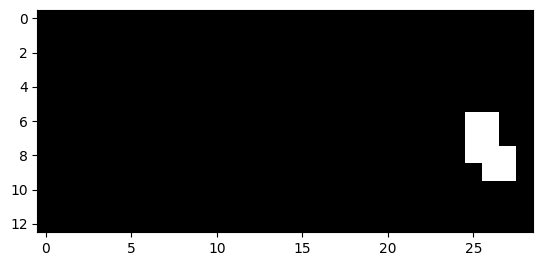

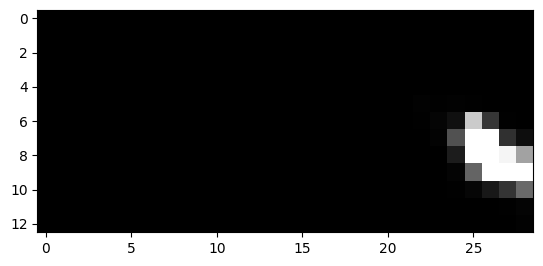

761


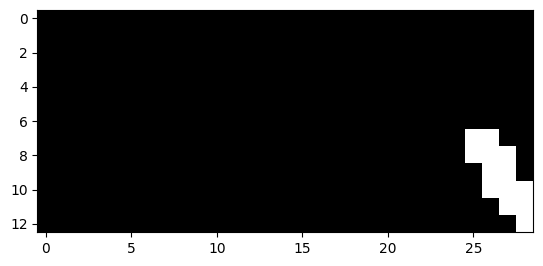

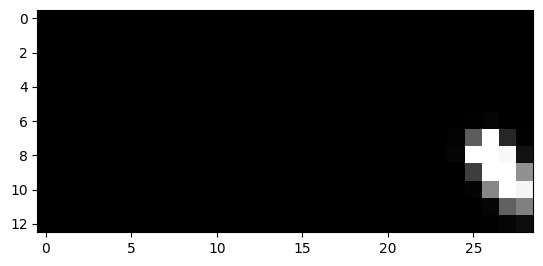

762


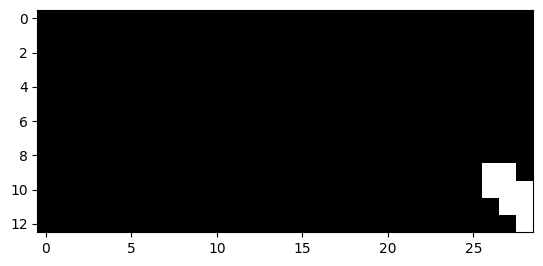

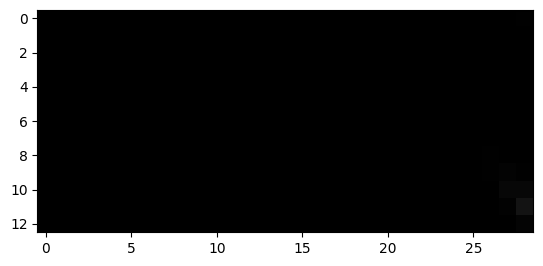

763


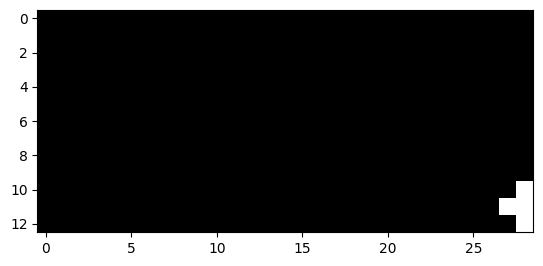

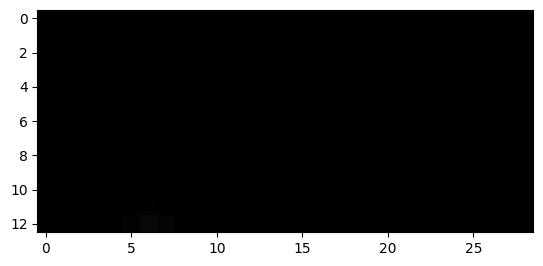

896


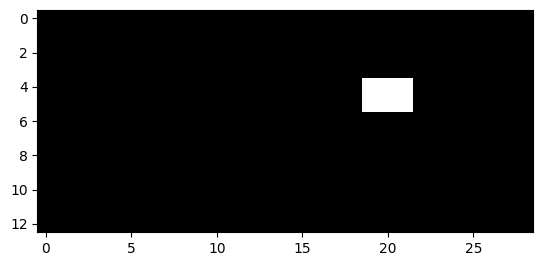

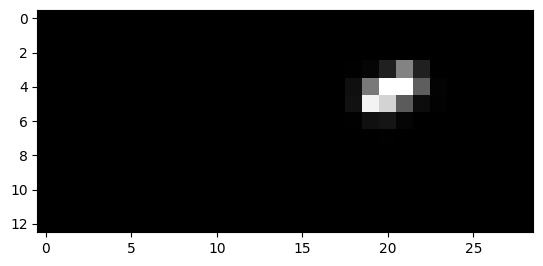

897


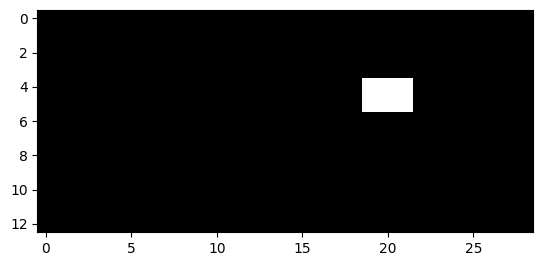

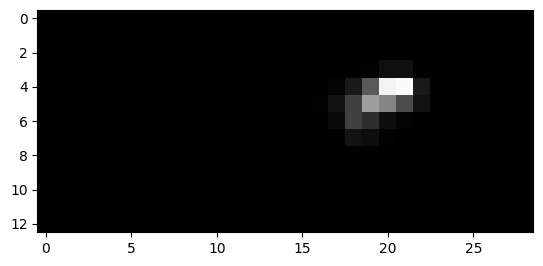

948


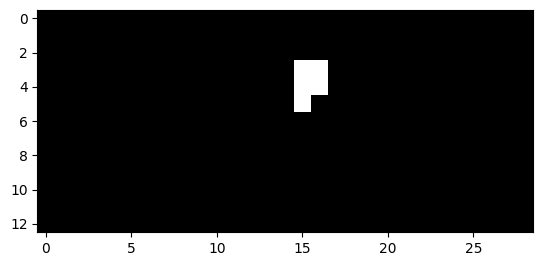

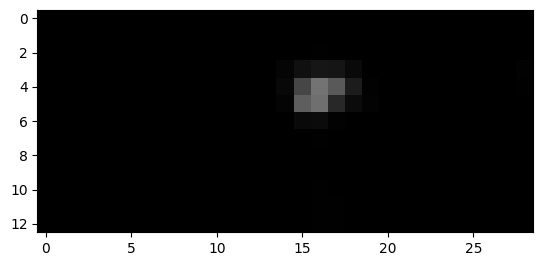

949


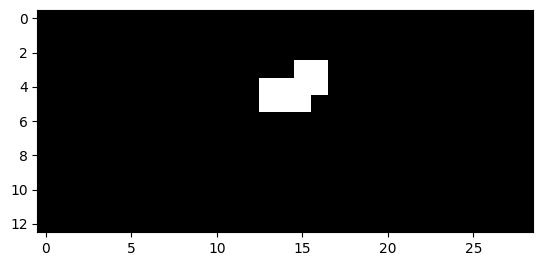

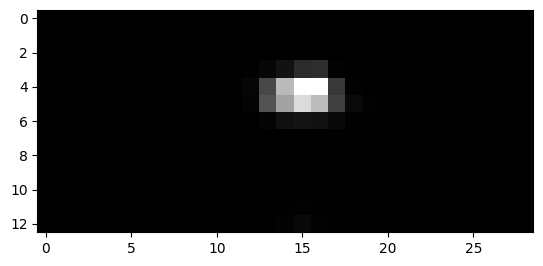

950


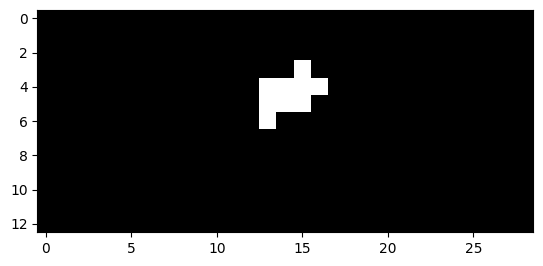

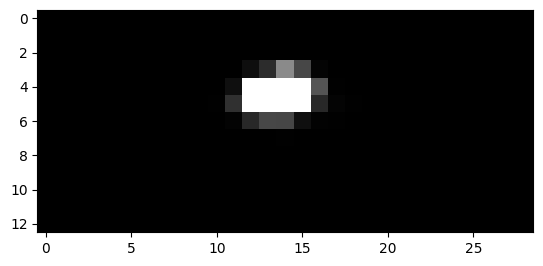

951


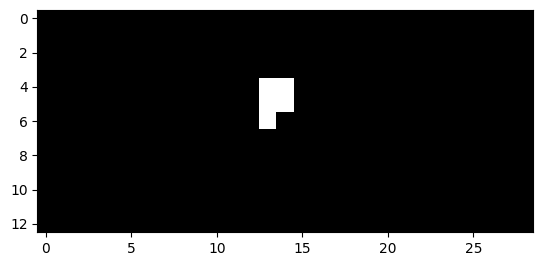

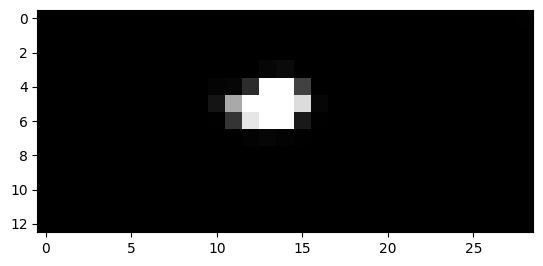

952


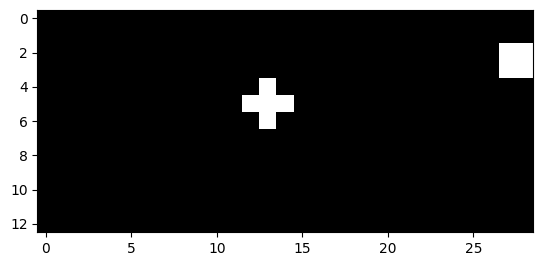

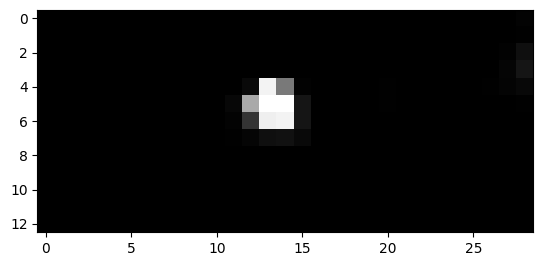

953


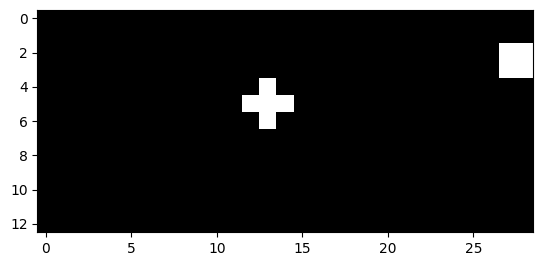

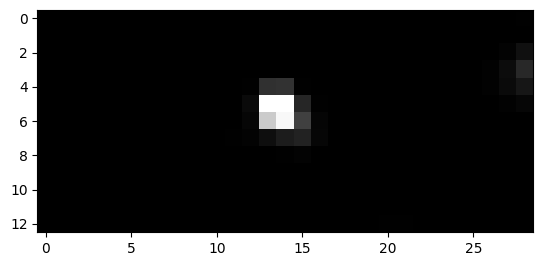

954


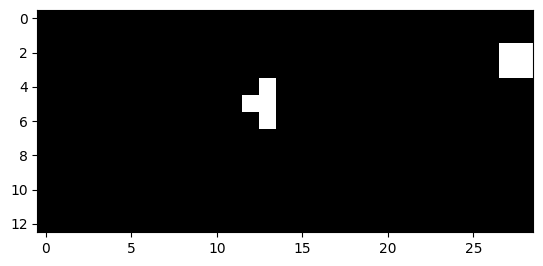

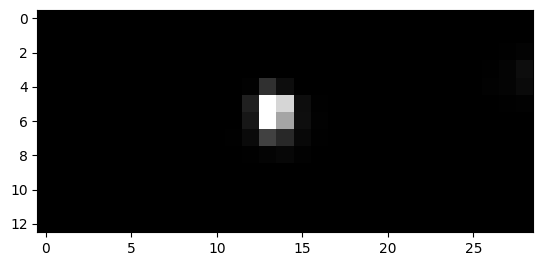

955


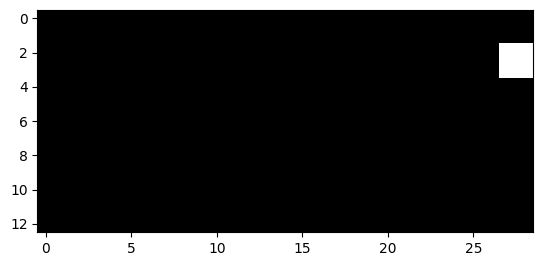

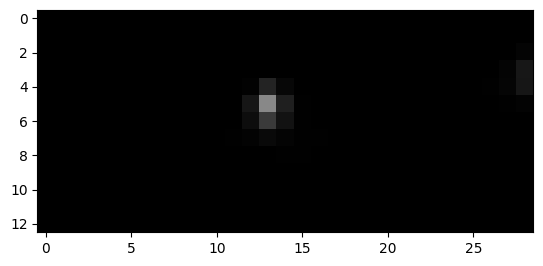

959


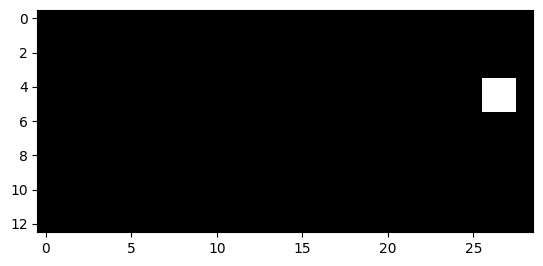

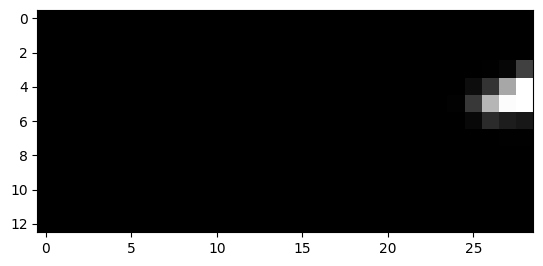

960


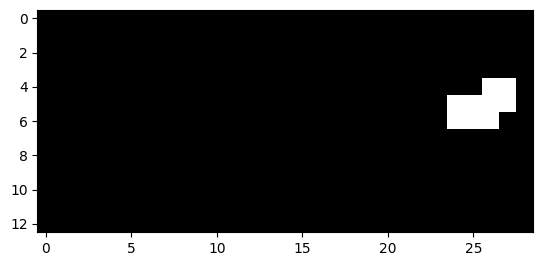

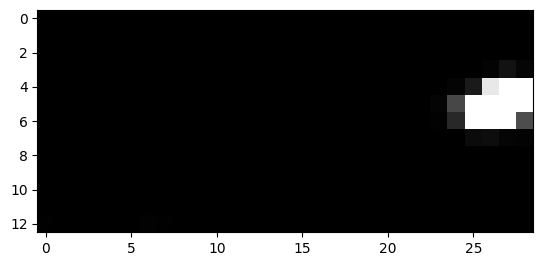

961


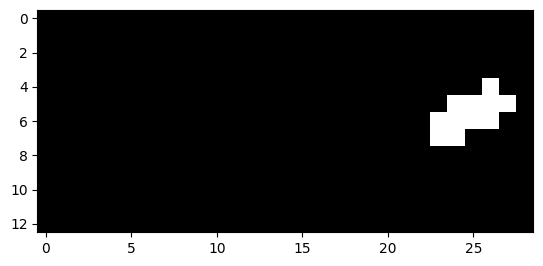

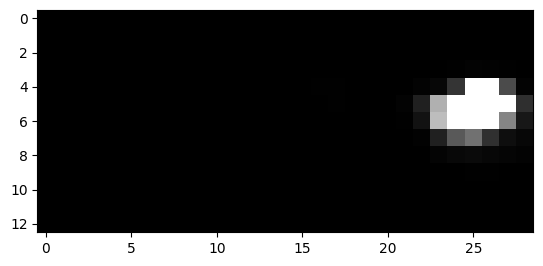

962


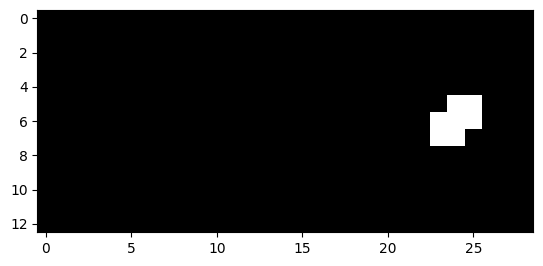

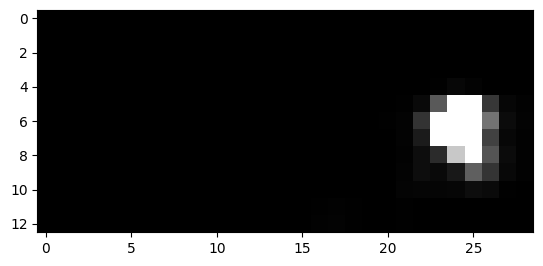

987


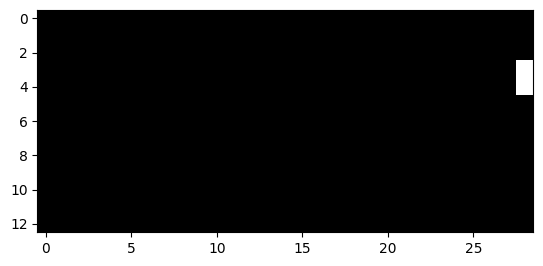

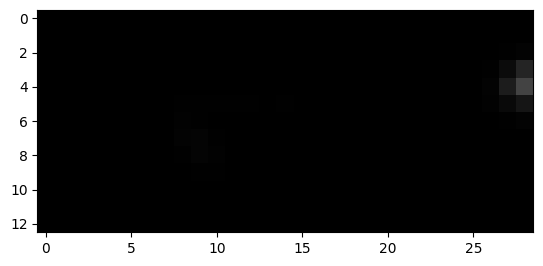

988


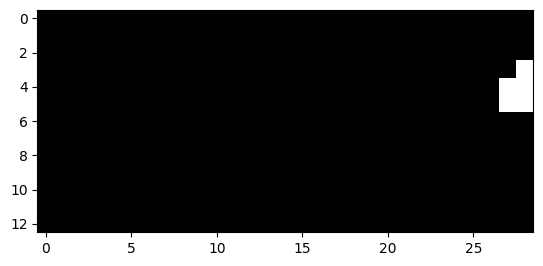

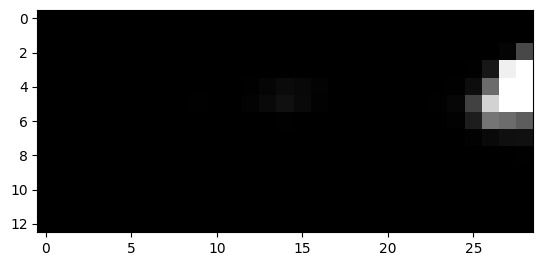

989


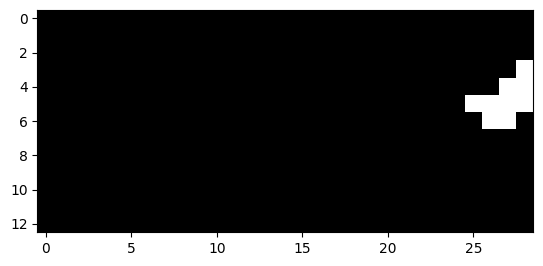

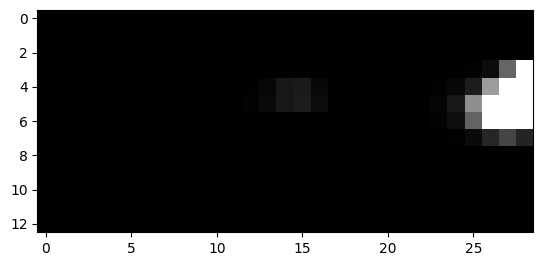

990


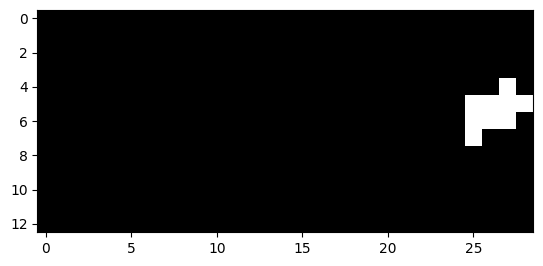

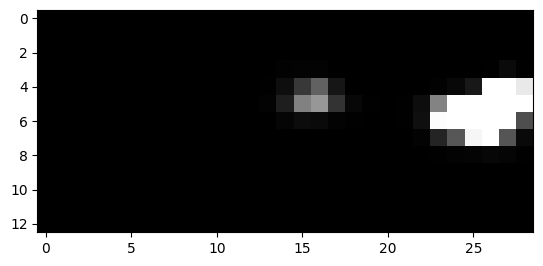

991


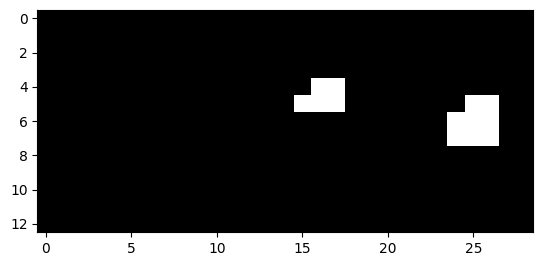

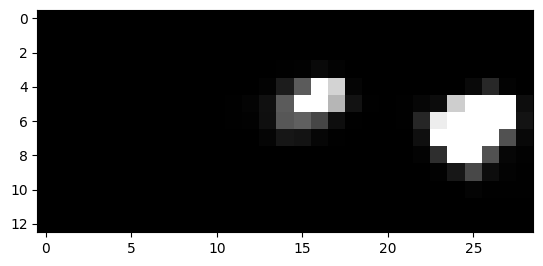

992


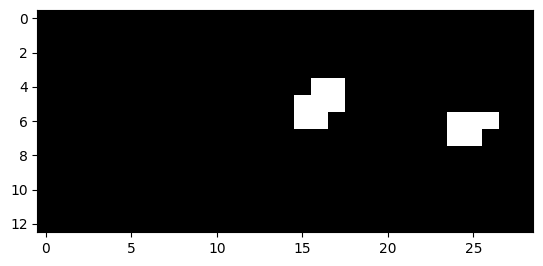

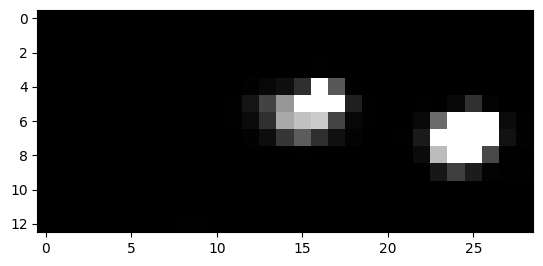

993


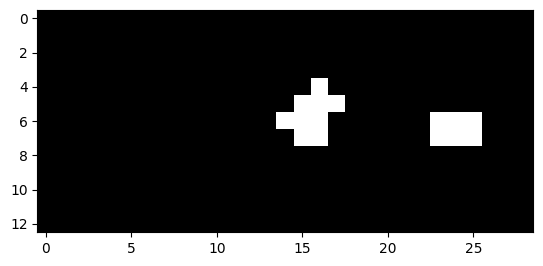

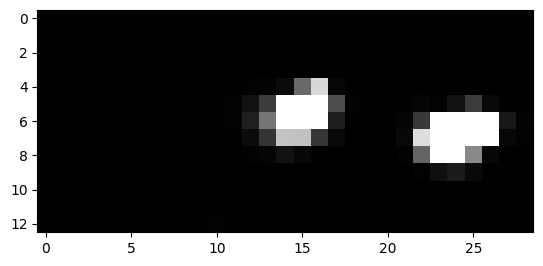

994


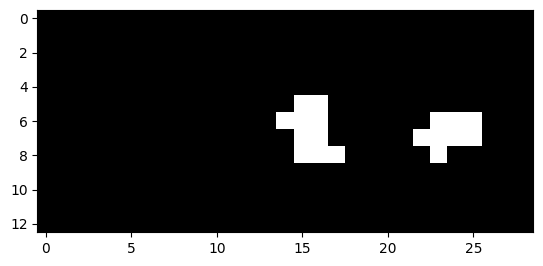

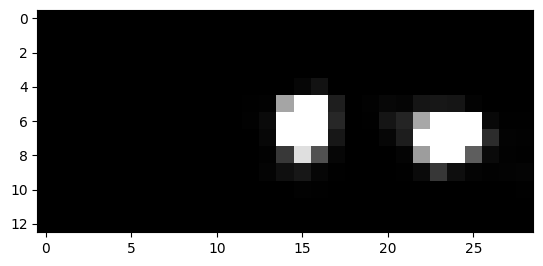

995


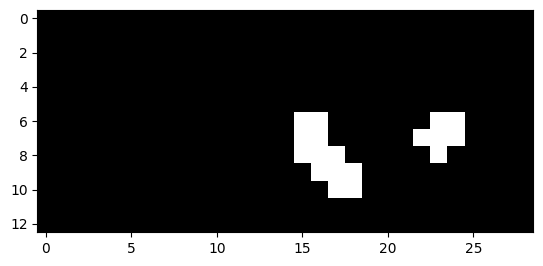

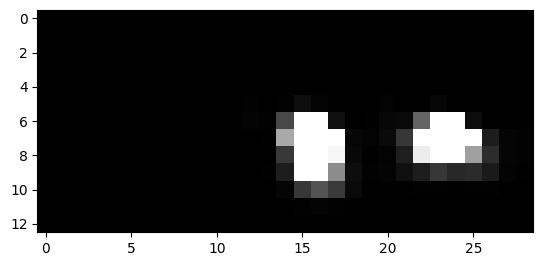

996


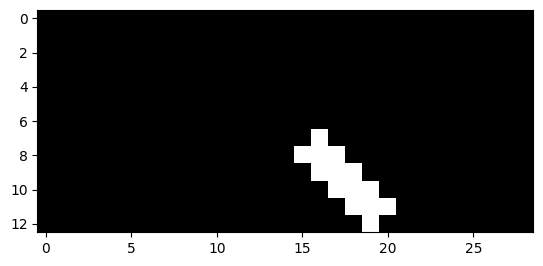

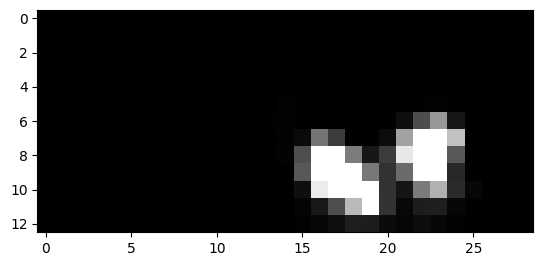

997


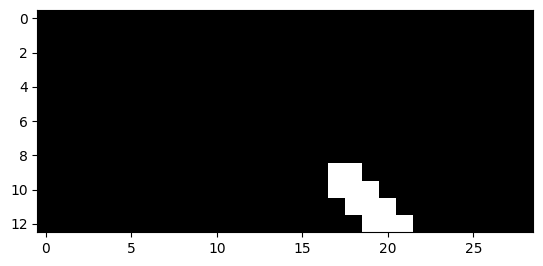

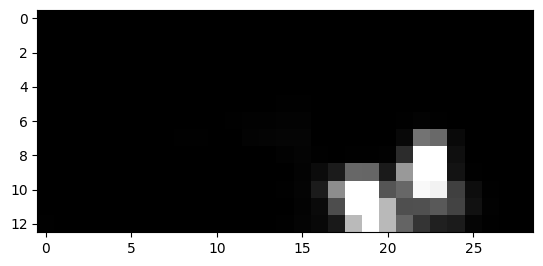

998


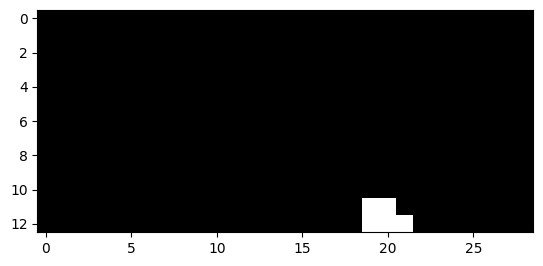

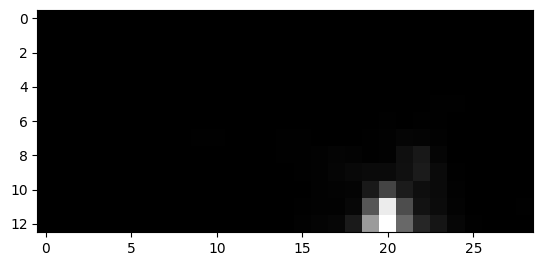

1023


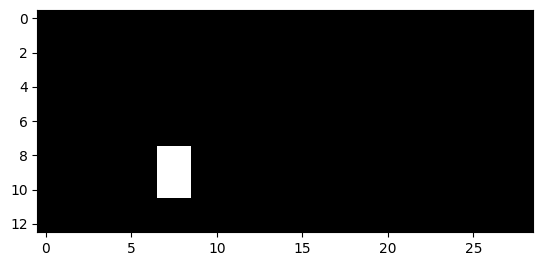

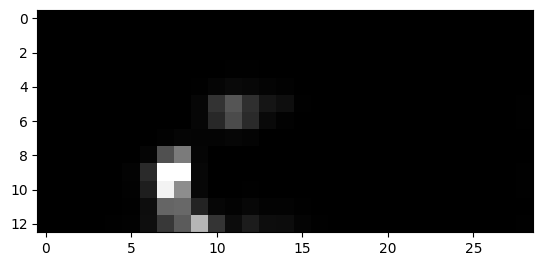

1024


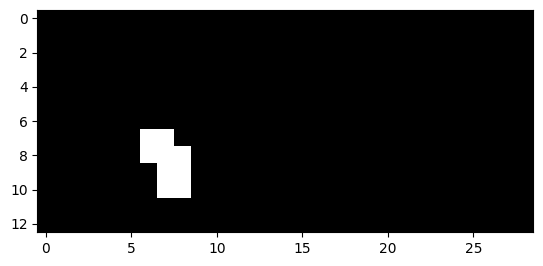

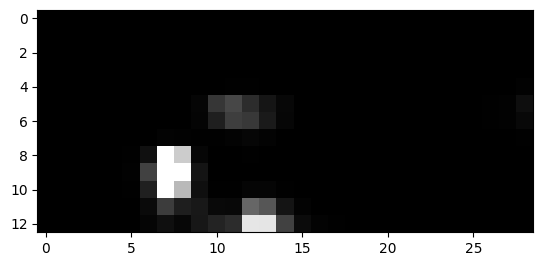

1025


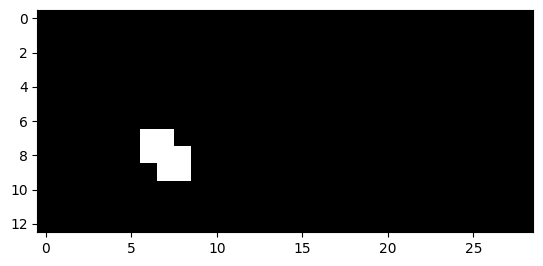

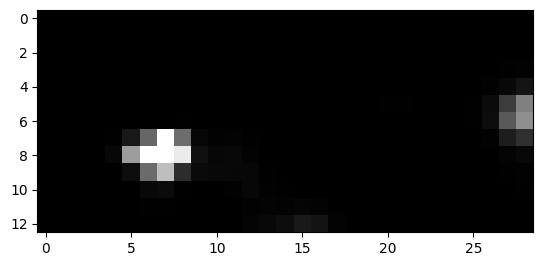

1027


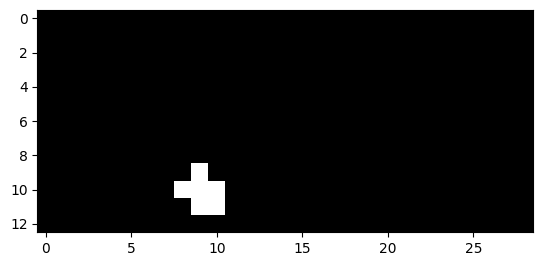

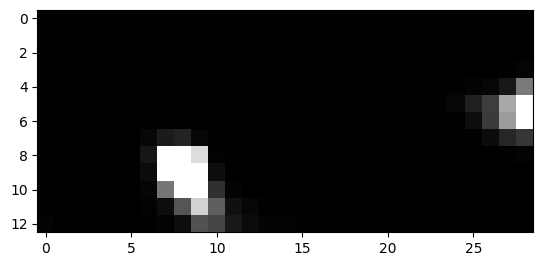

1028


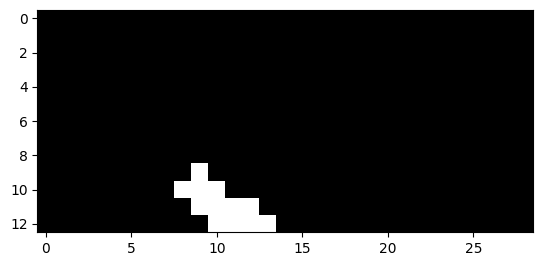

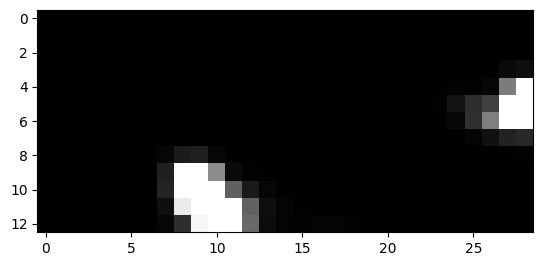

1029


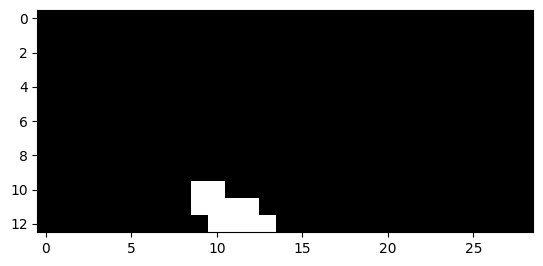

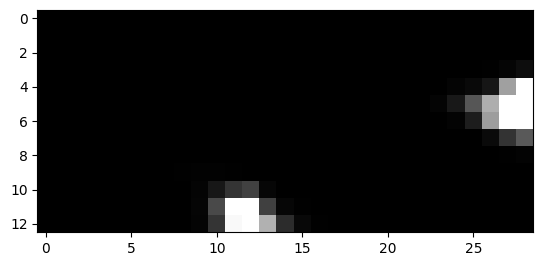

1039


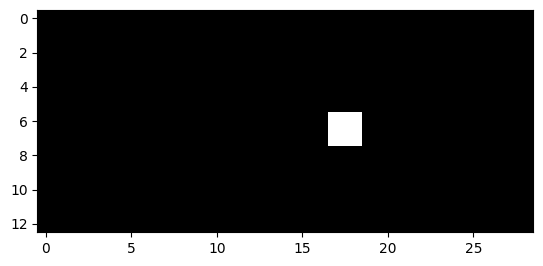

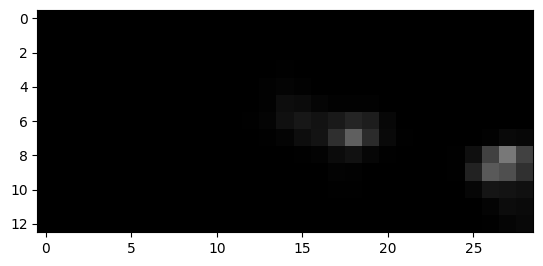

1040


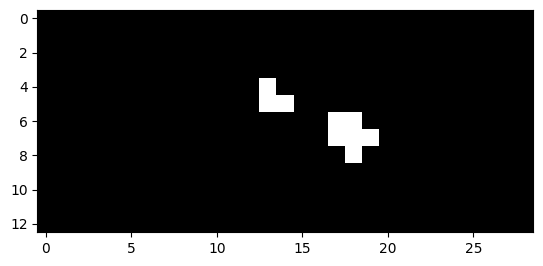

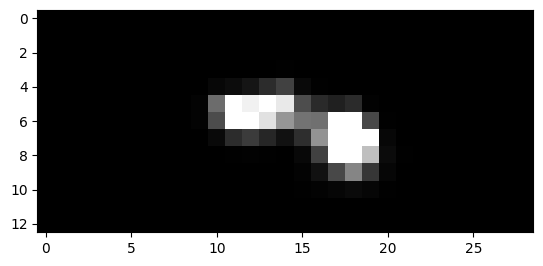

1041


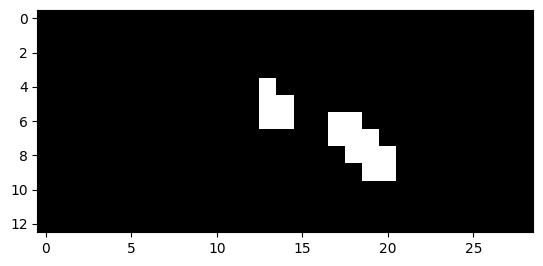

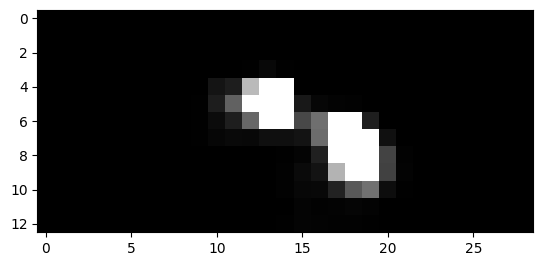

1042


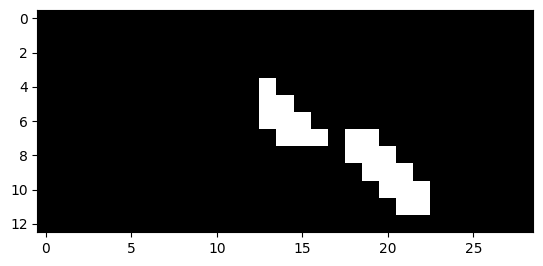

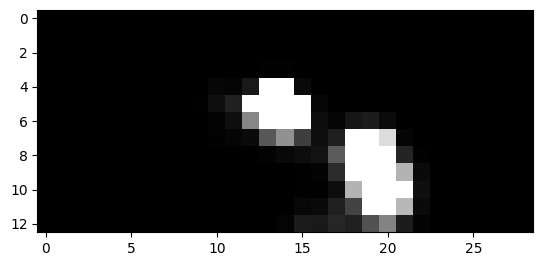

1043


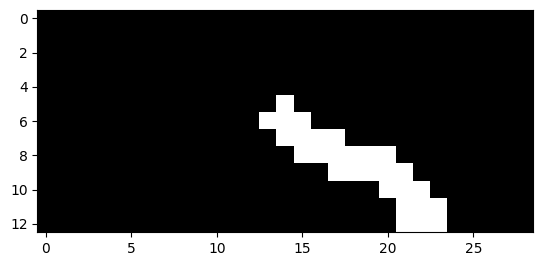

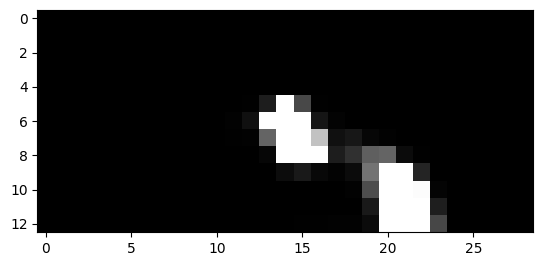

1044


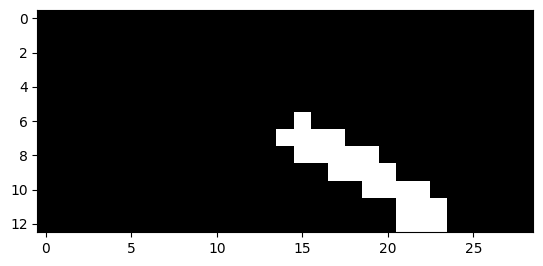

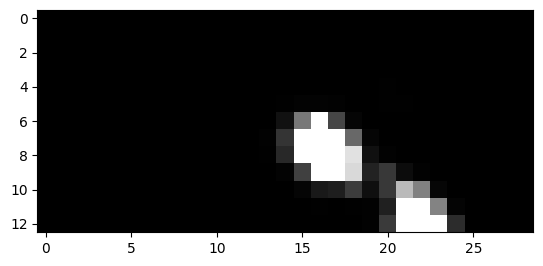

1045


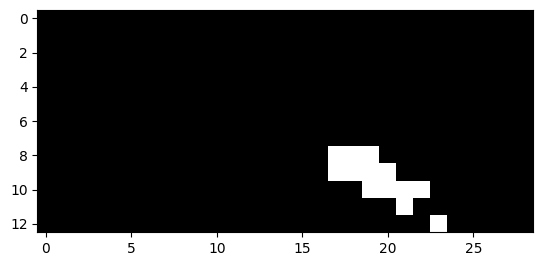

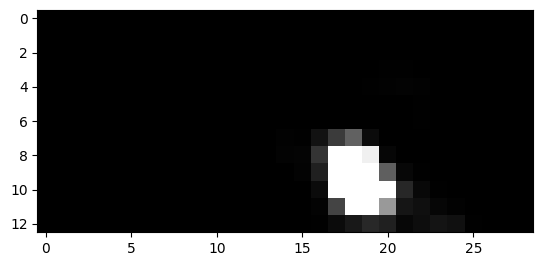

1046


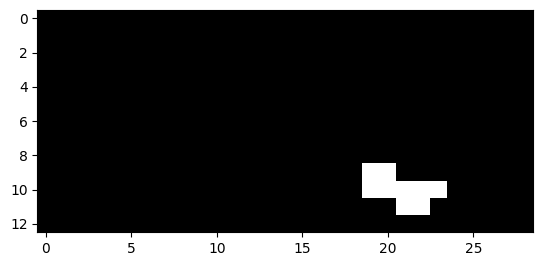

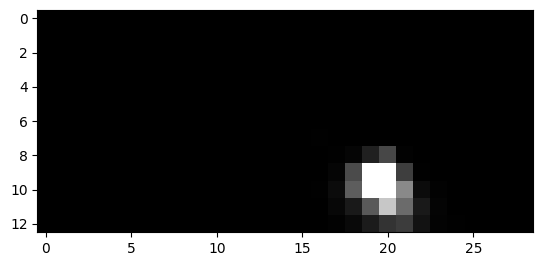

1047


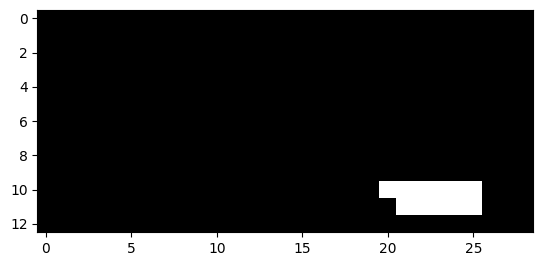

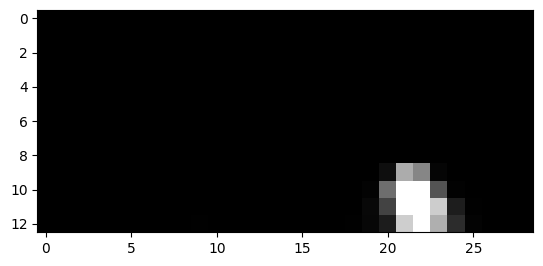

1048


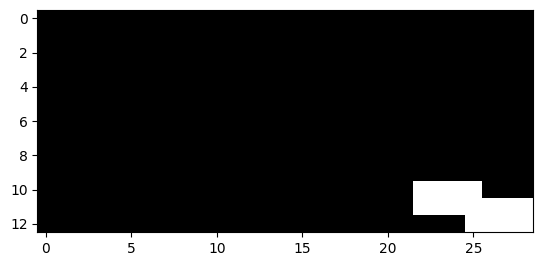

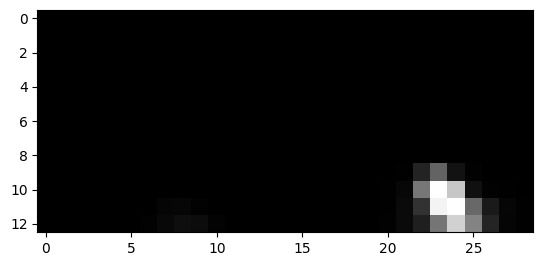

1049


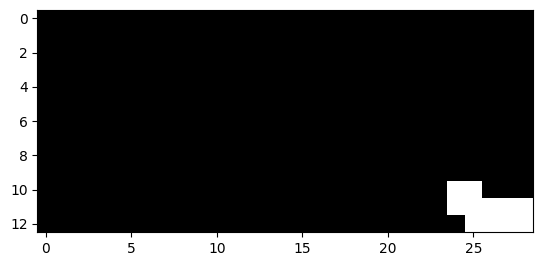

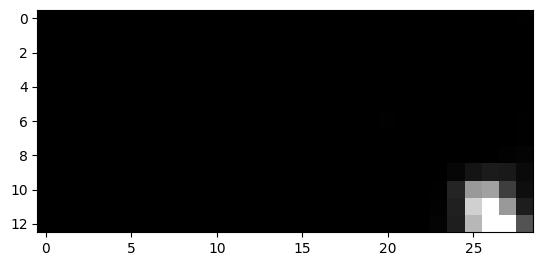

1050


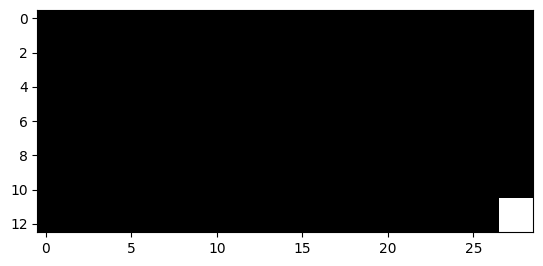

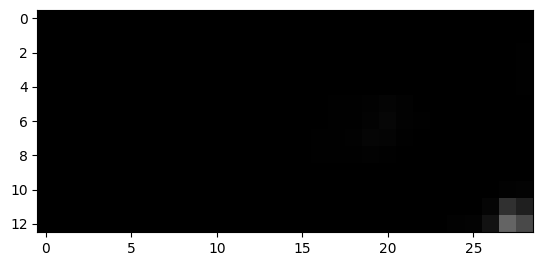

1064


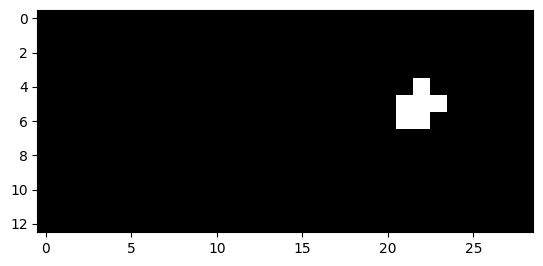

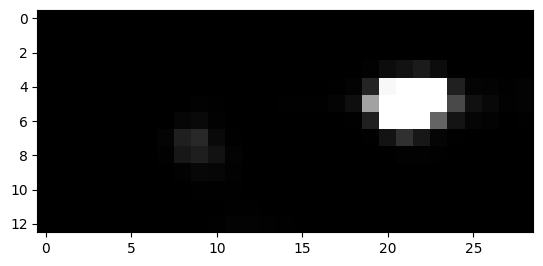

1065


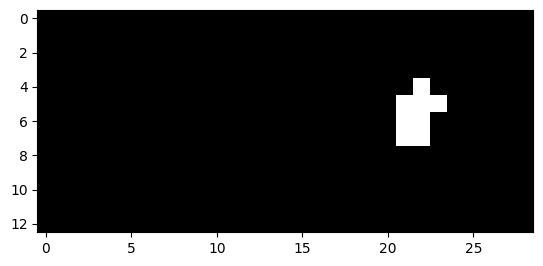

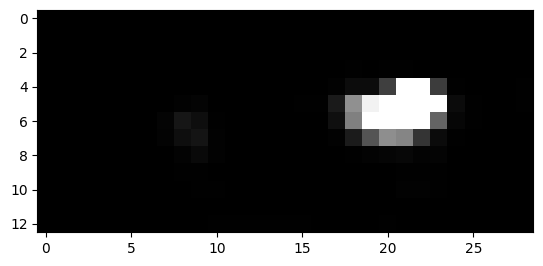

1066


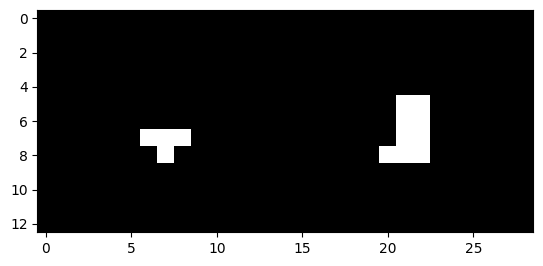

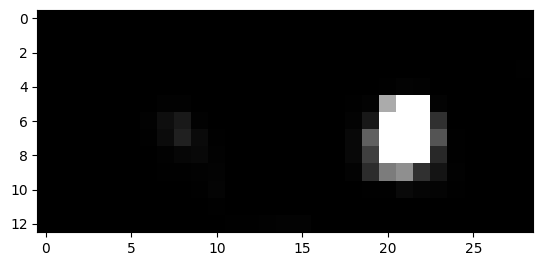

1067


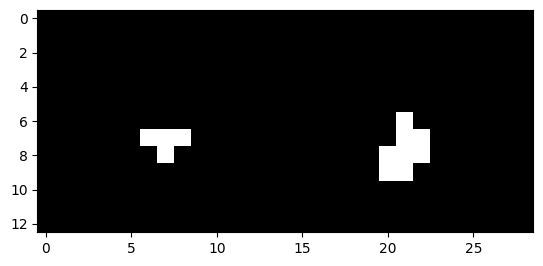

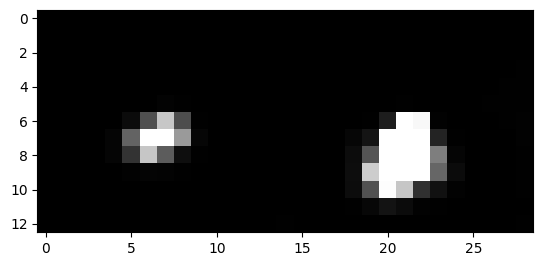

1068


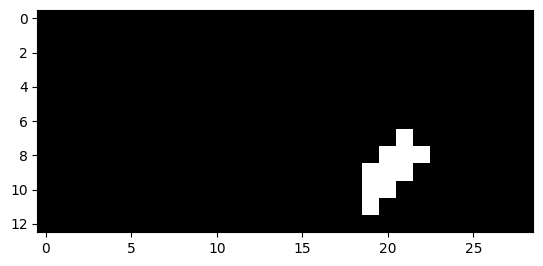

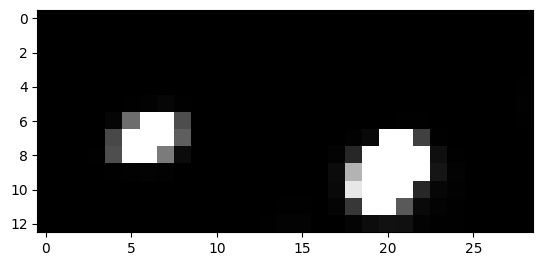

1069


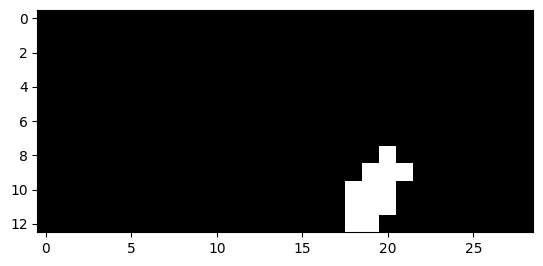

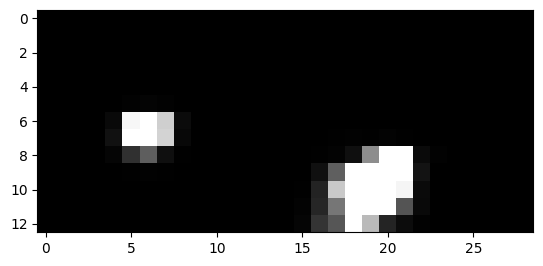

1070


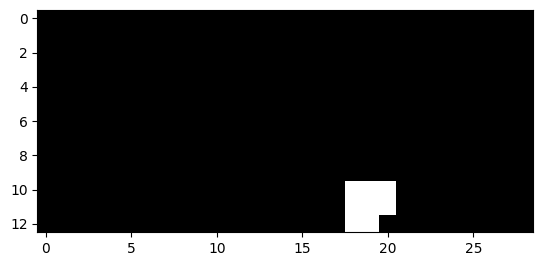

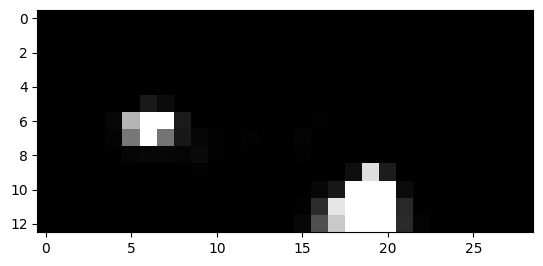

1071


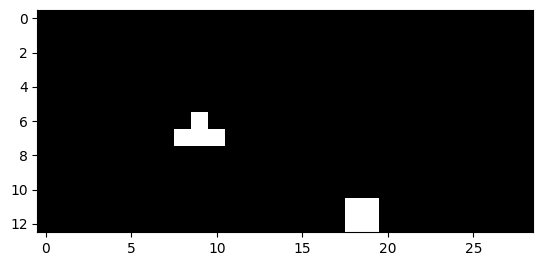

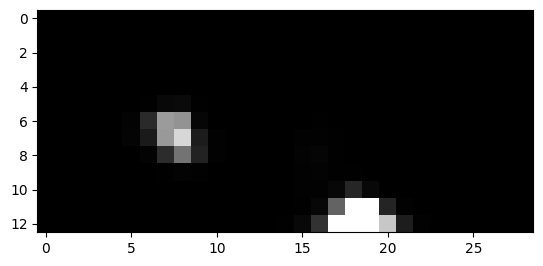

1072


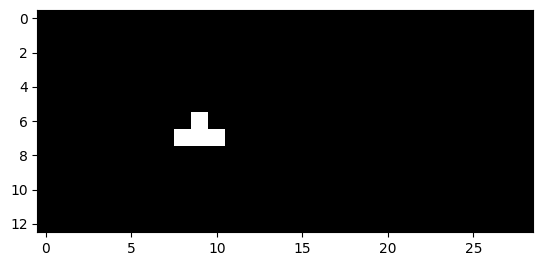

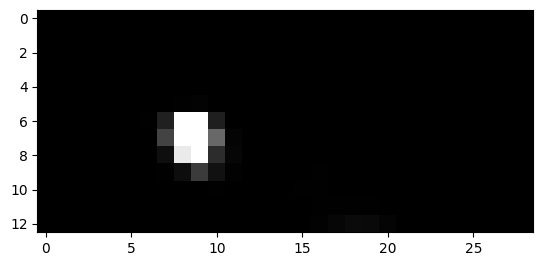

1073


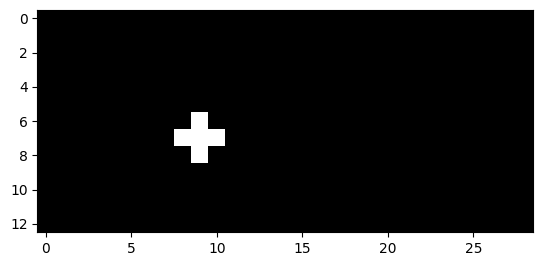

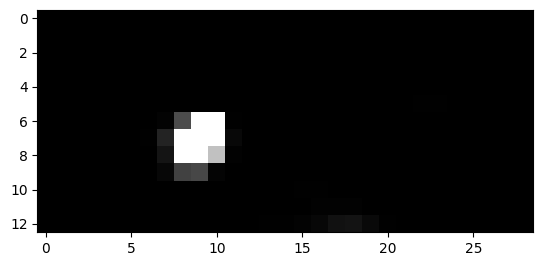

1074


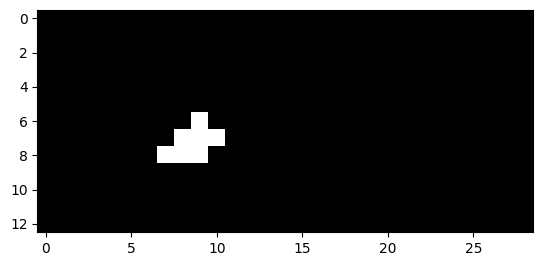

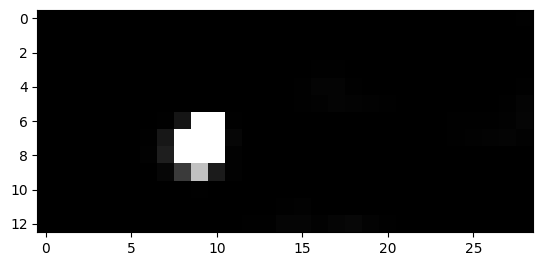

1075


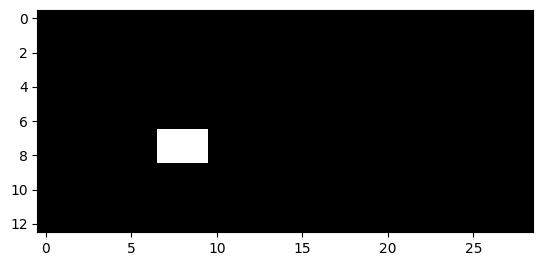

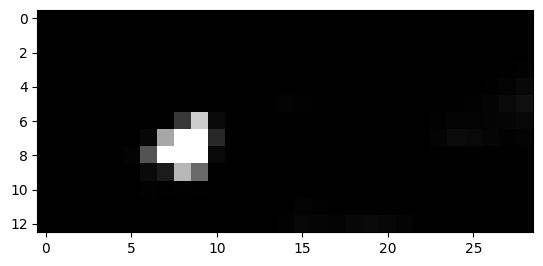

1076


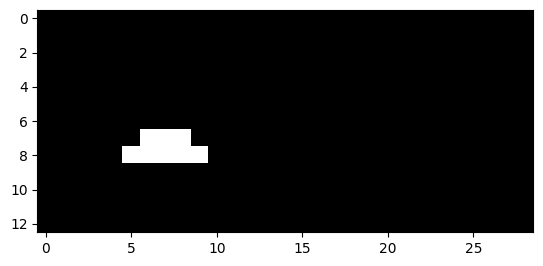

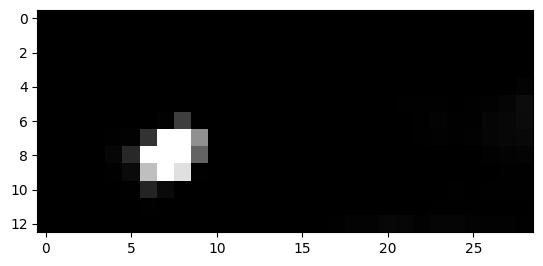

1077


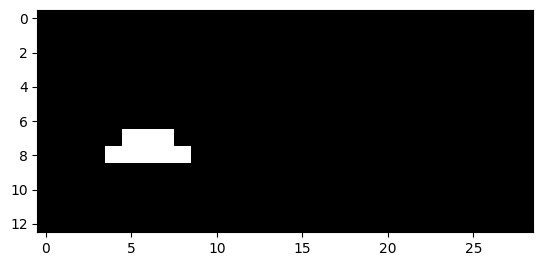

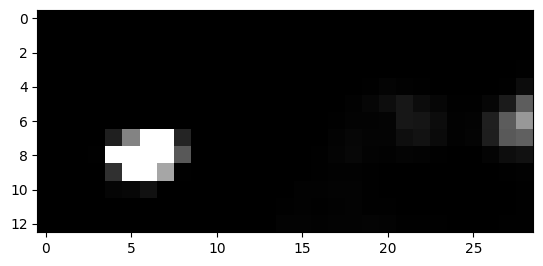

1078


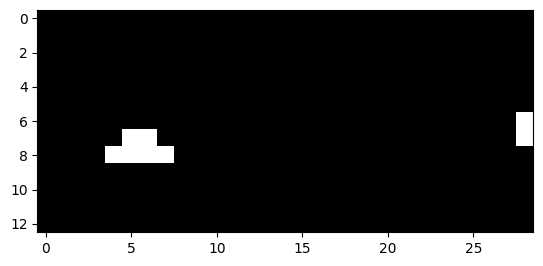

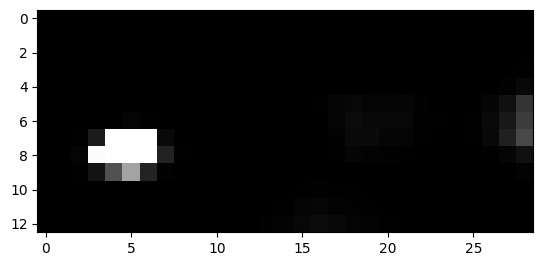

1079


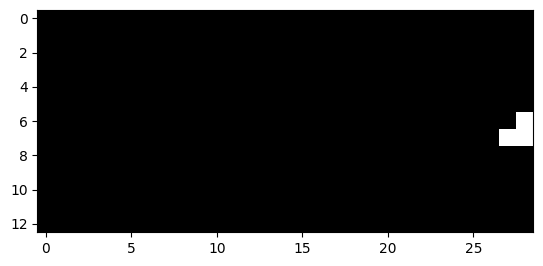

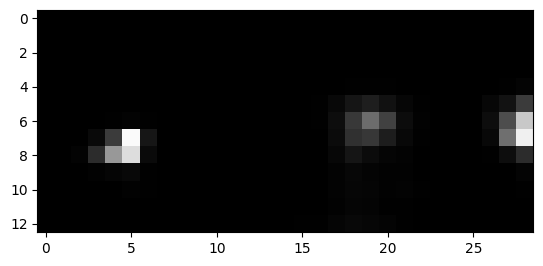

1080


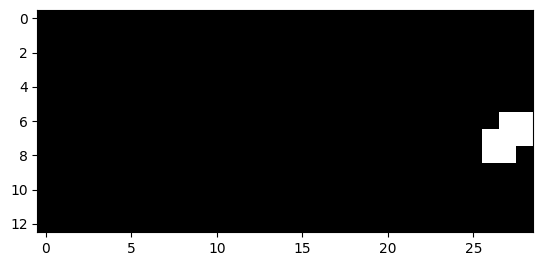

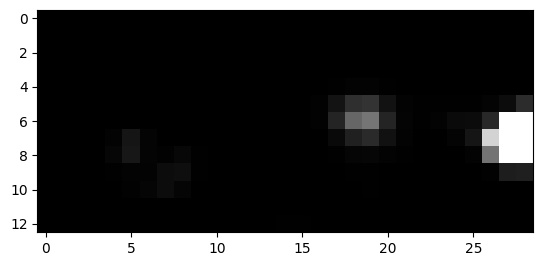

1081


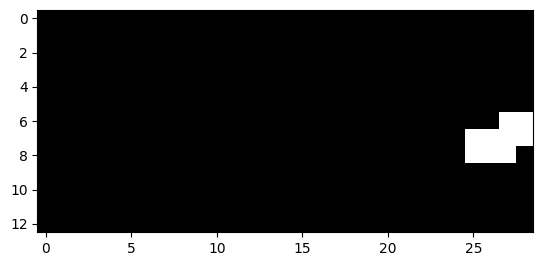

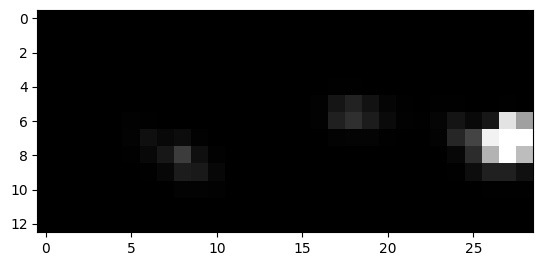

1082


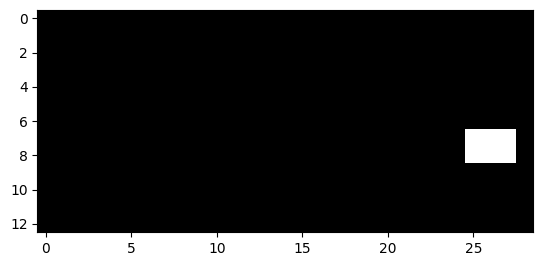

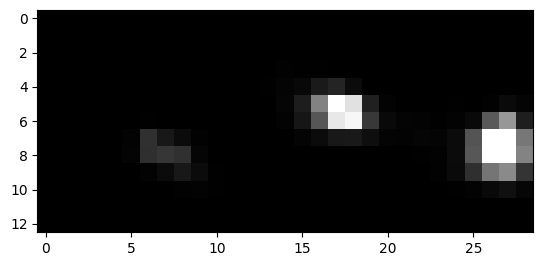

1083


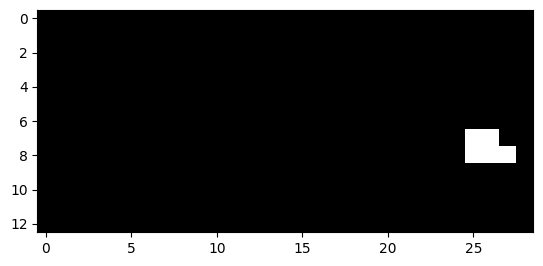

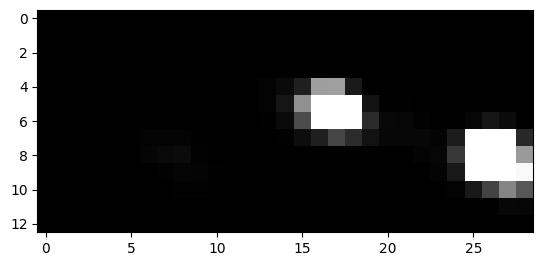

1084


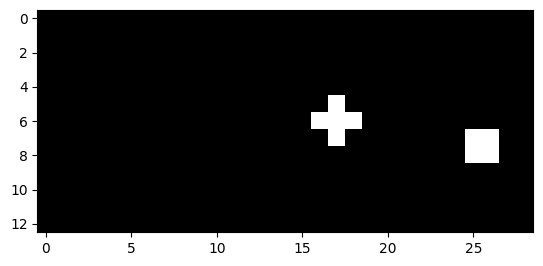

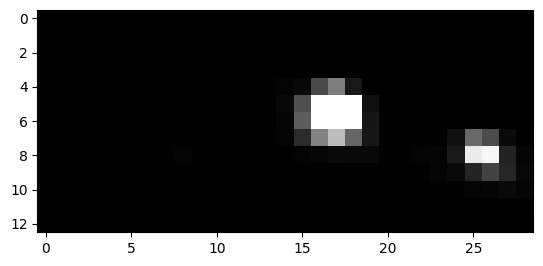

1085


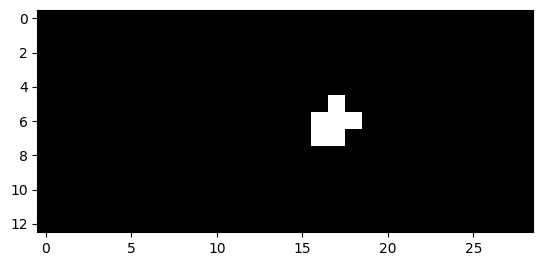

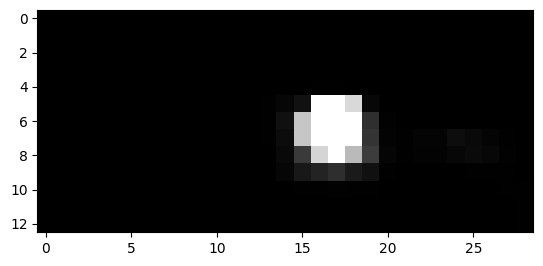

1086


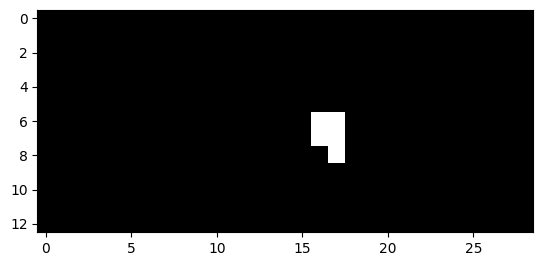

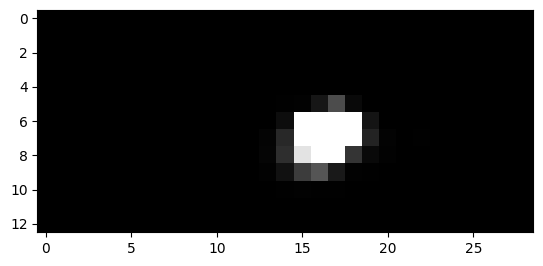

1087


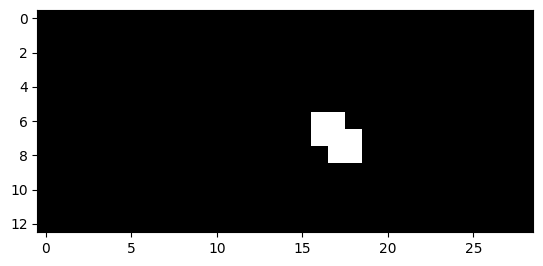

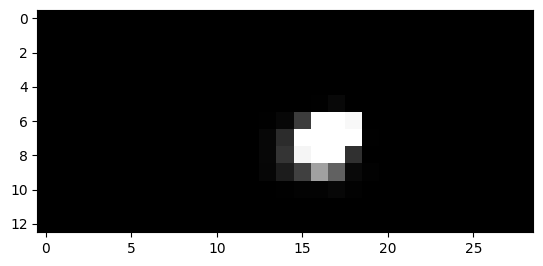

1088


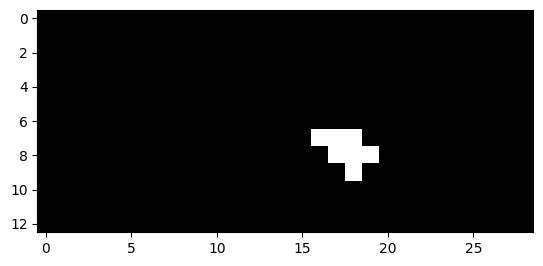

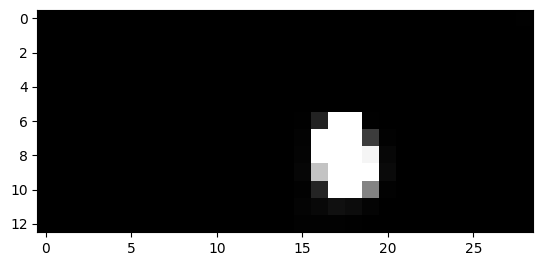

1089


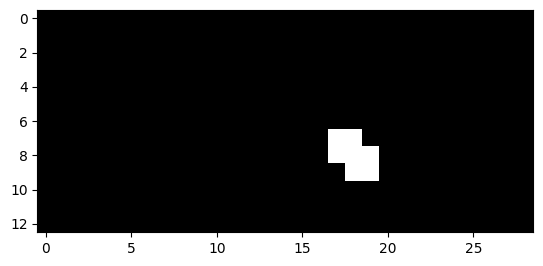

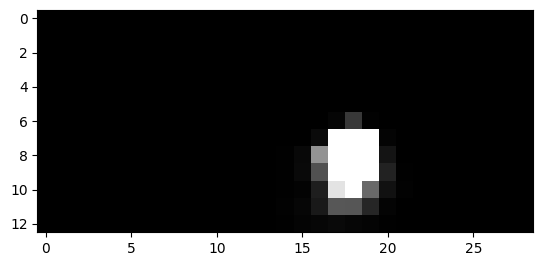

1090


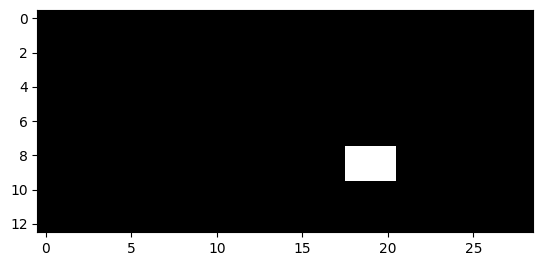

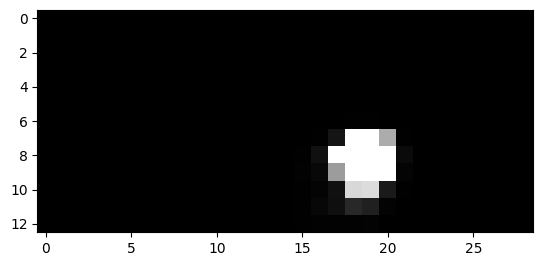

1091


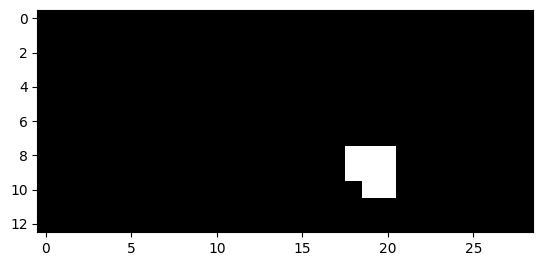

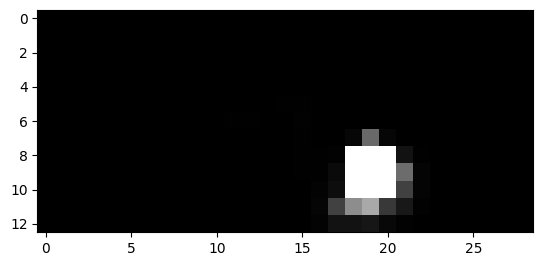

1092


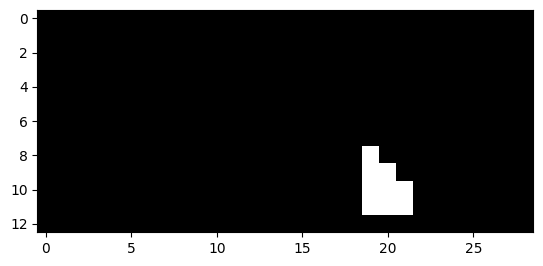

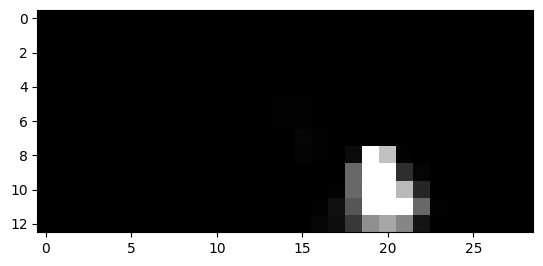

1093


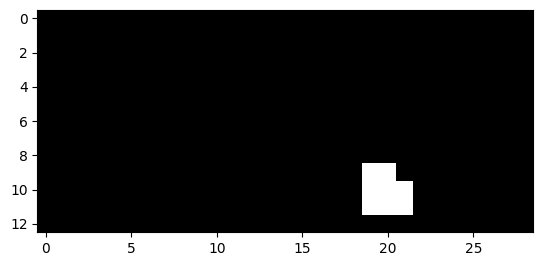

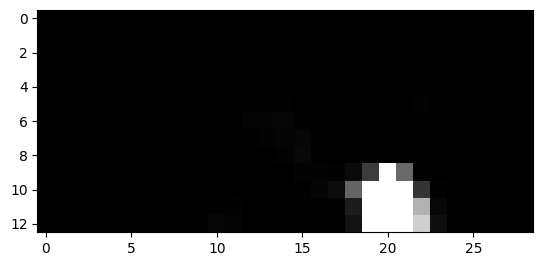

1094


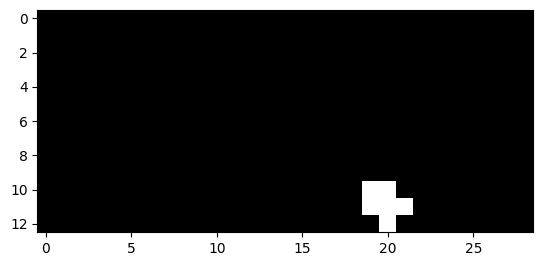

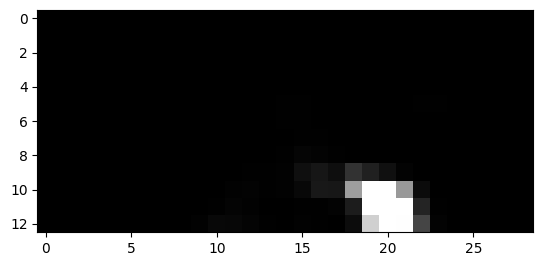

1095


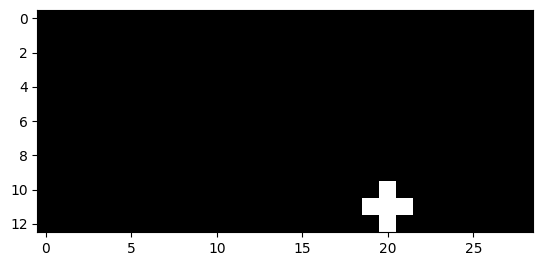

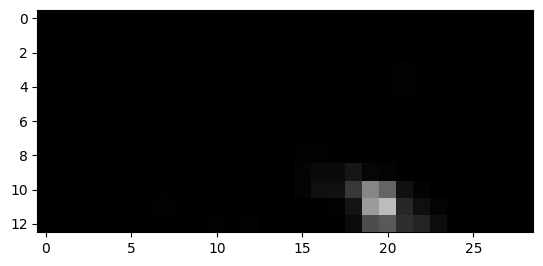

1116


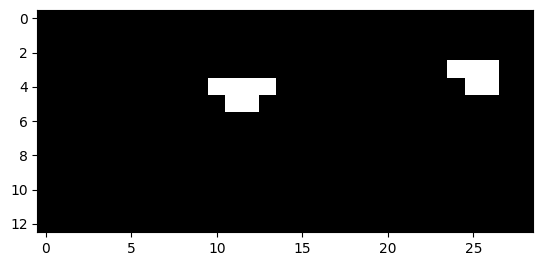

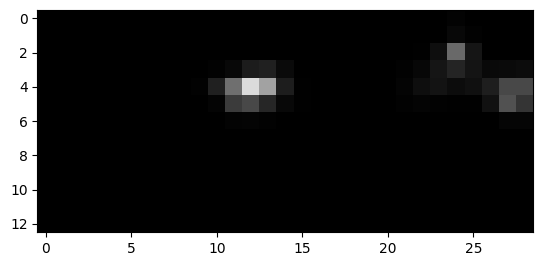

1117


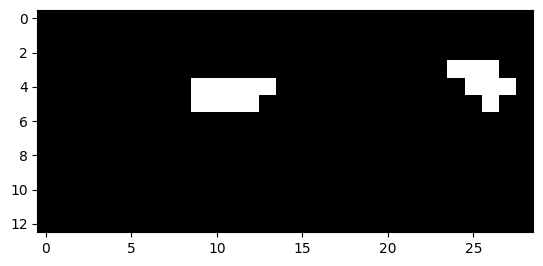

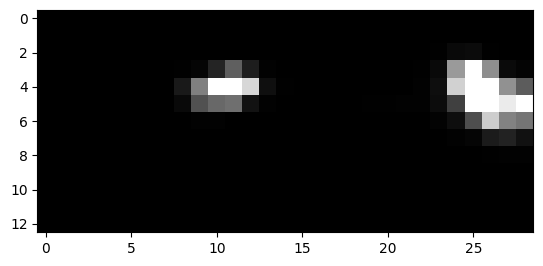

1118


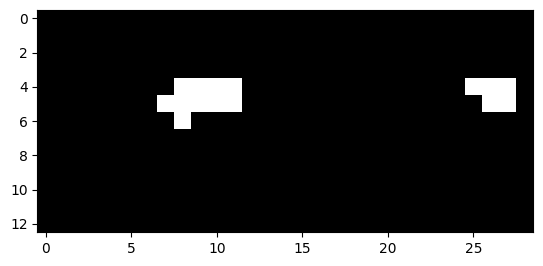

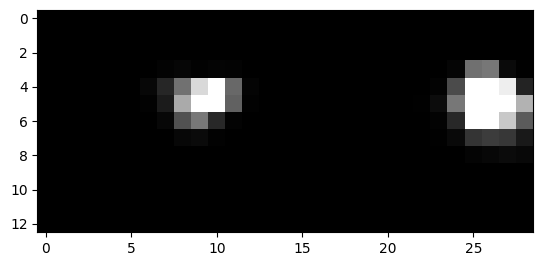

1119


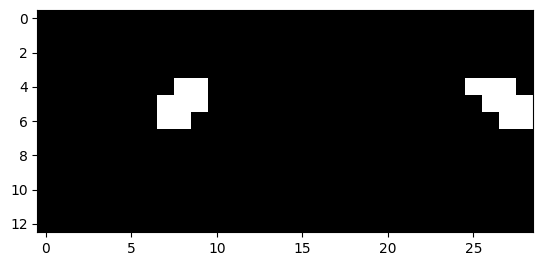

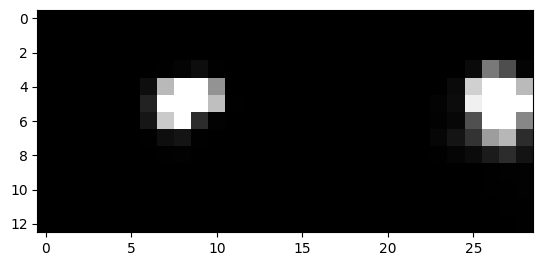

1120


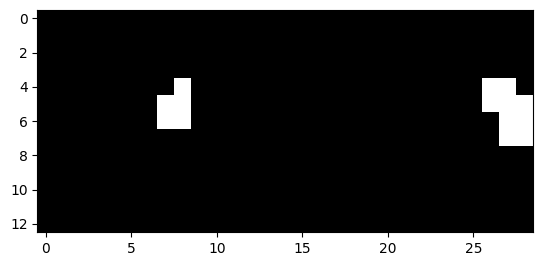

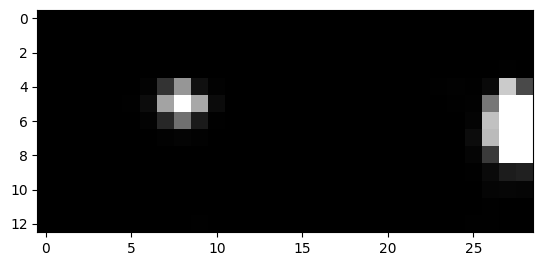

1121


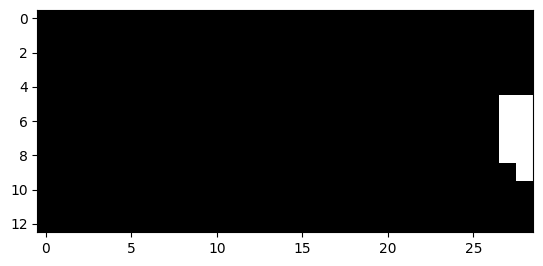

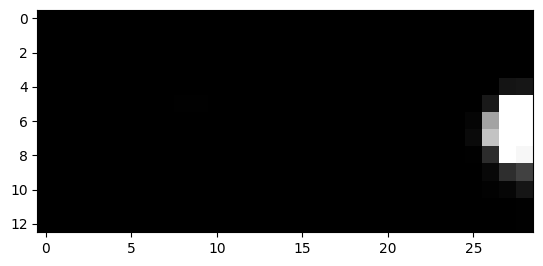

1122


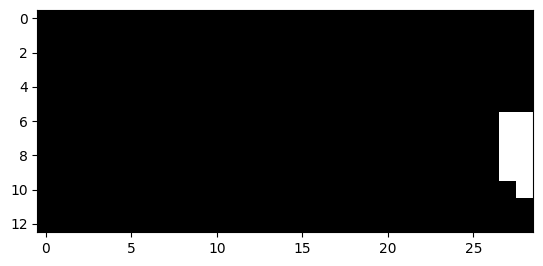

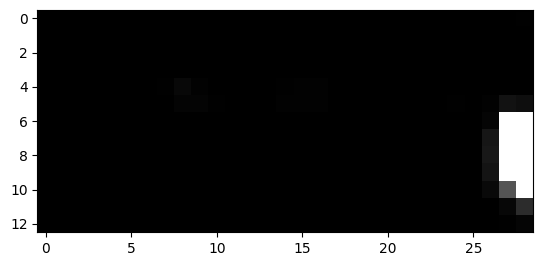

1123


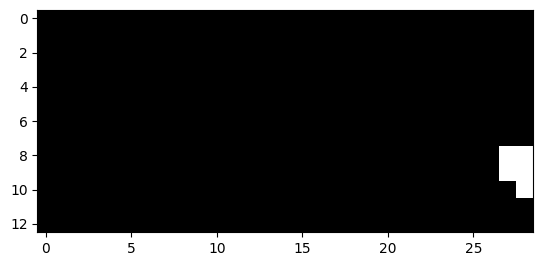

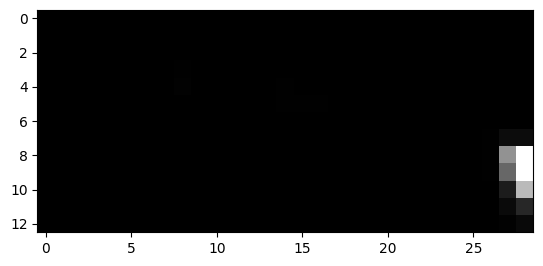

1341


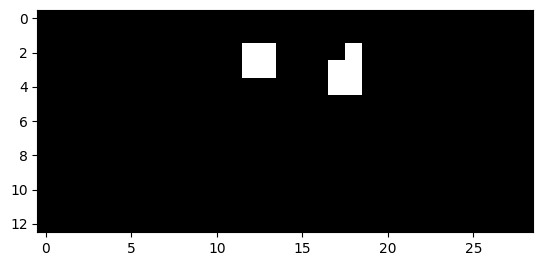

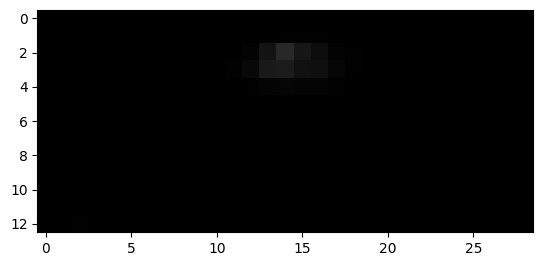

1342


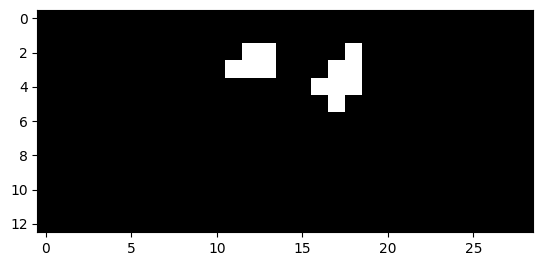

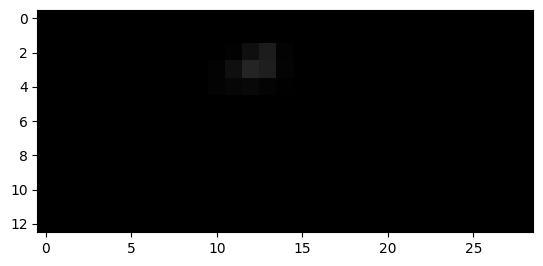

1343


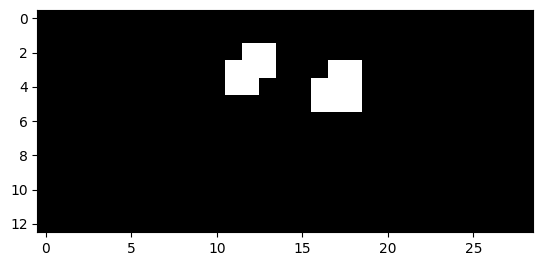

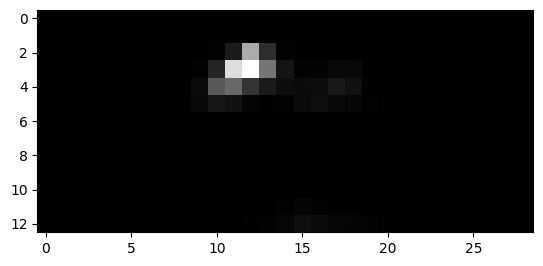

1344


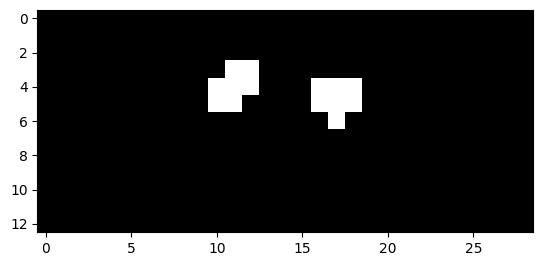

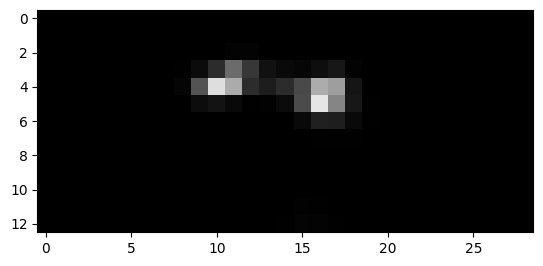

1345


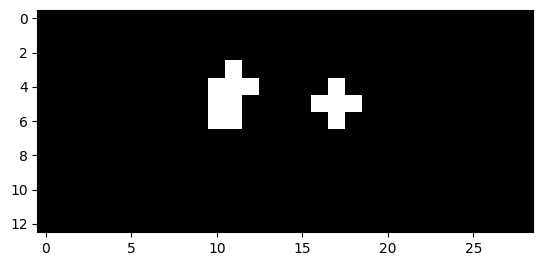

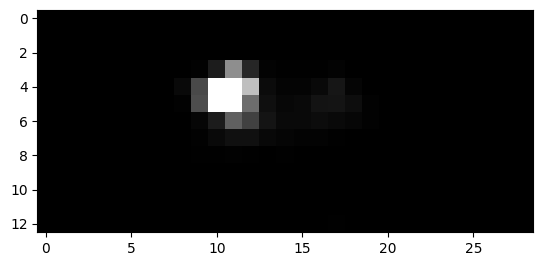

1346


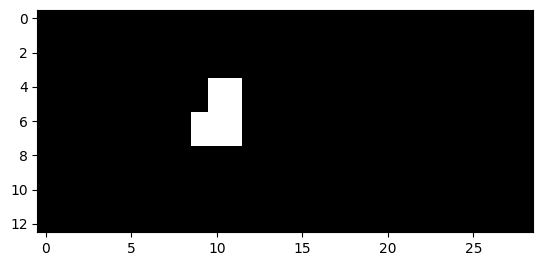

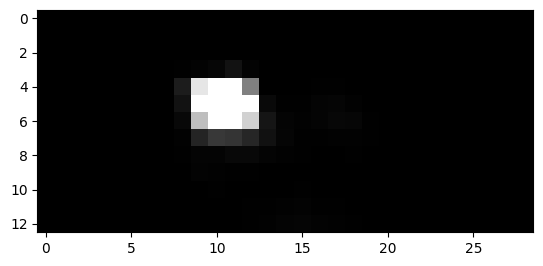

1347


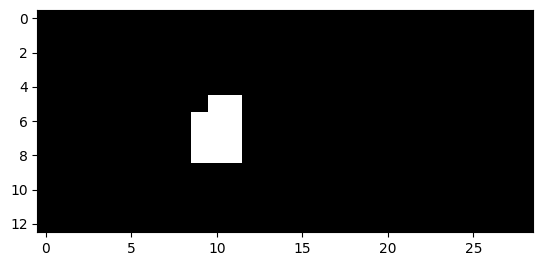

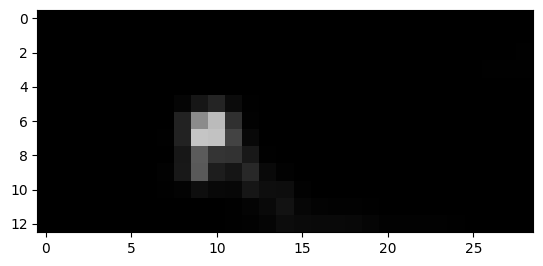

1348


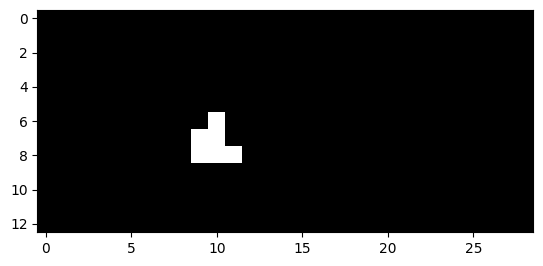

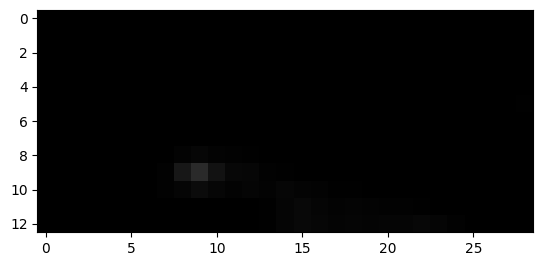

1366


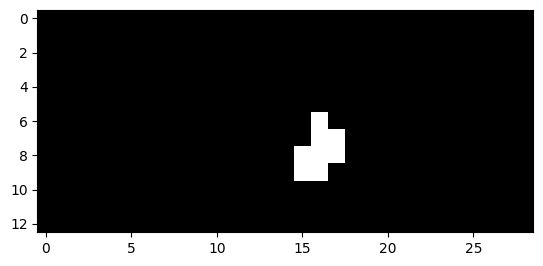

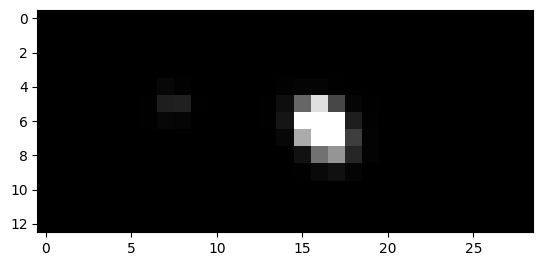

1367


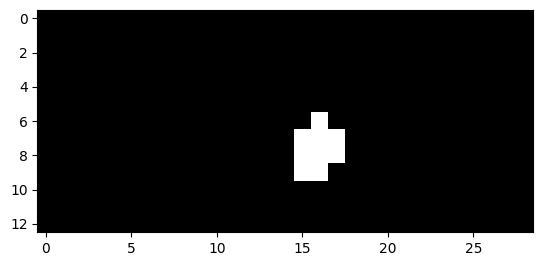

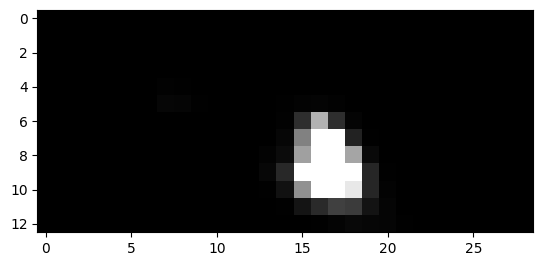

1368


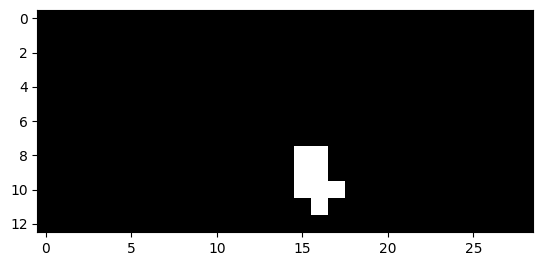

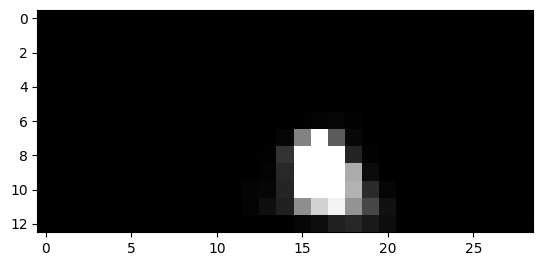

1369


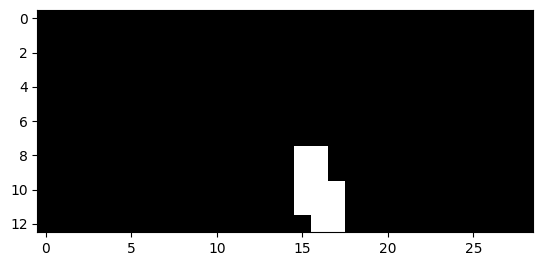

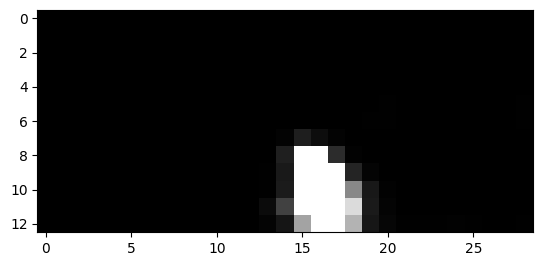

1370


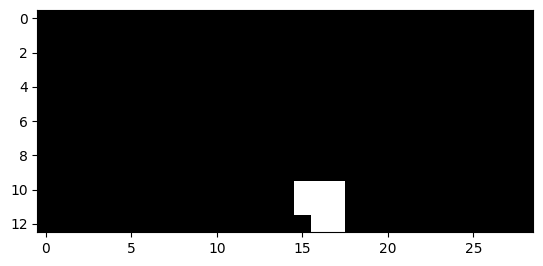

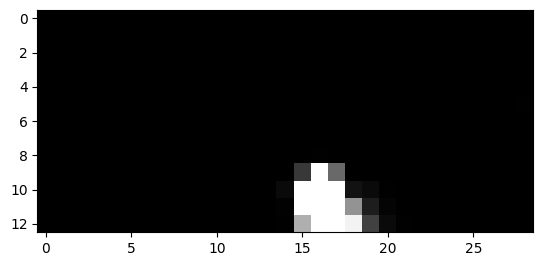

1371


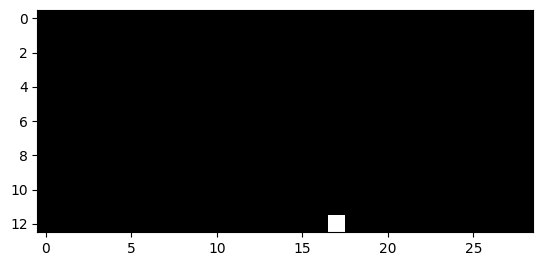

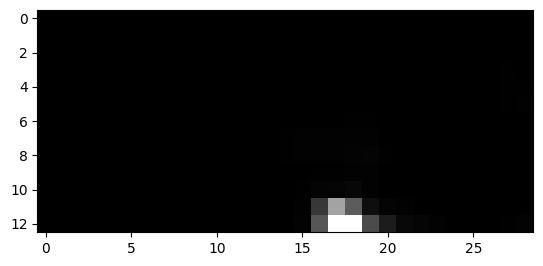

1389


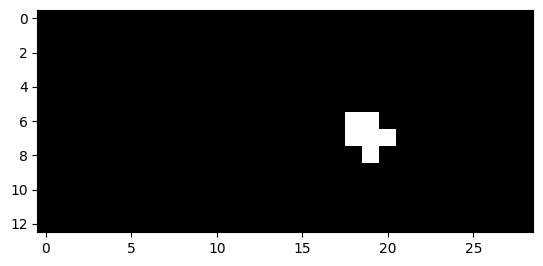

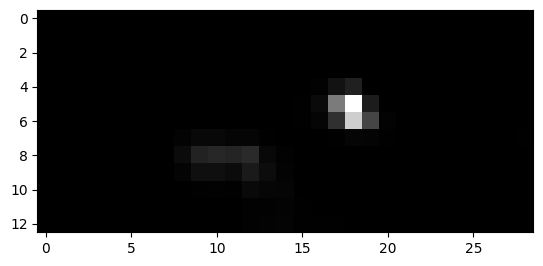

1390


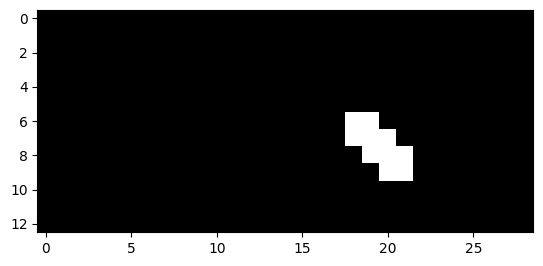

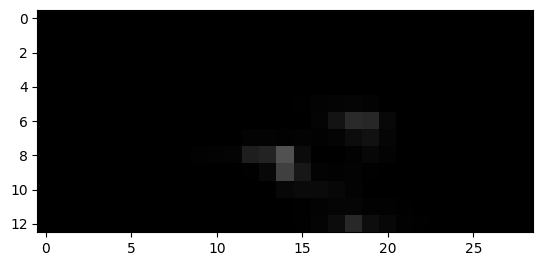

1391


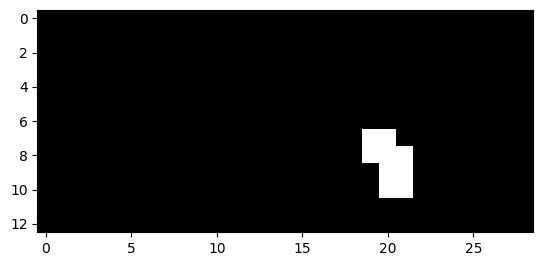

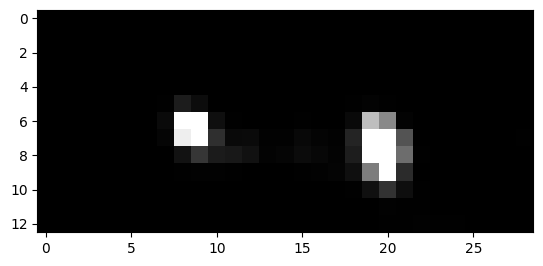

1392


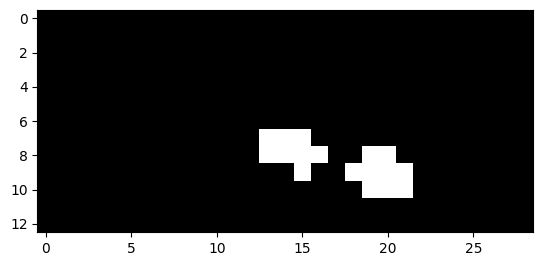

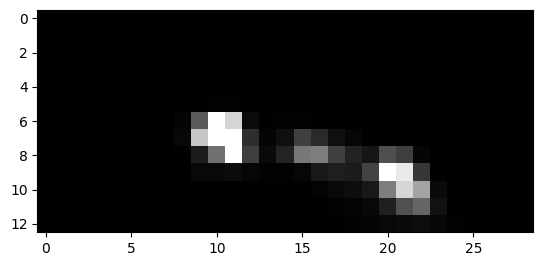

1393


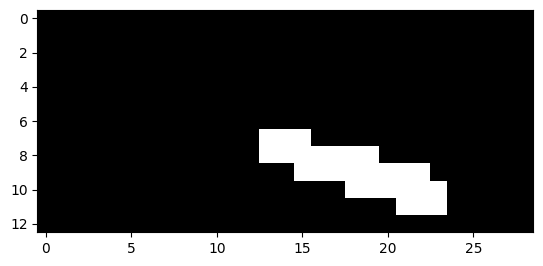

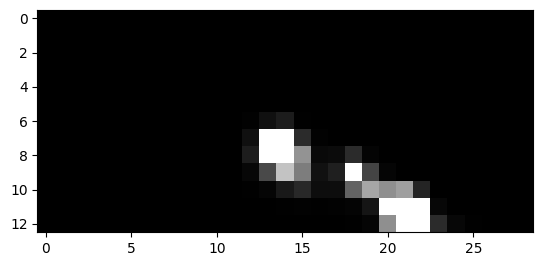

1394


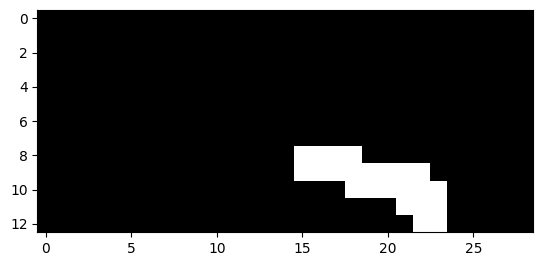

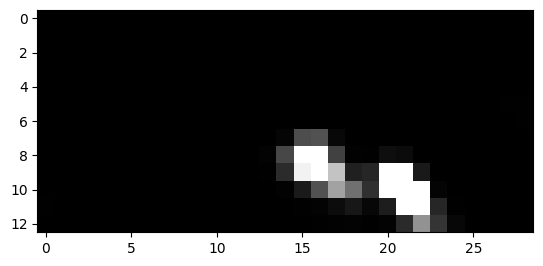

1395


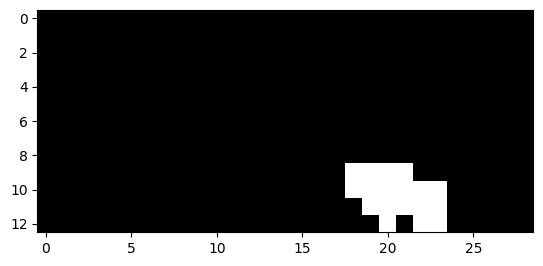

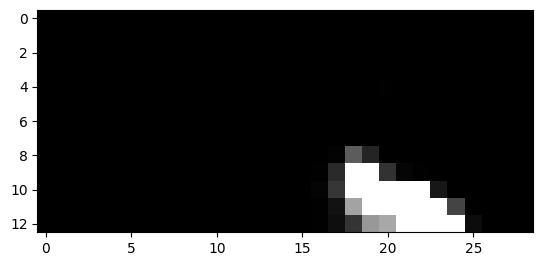

1396


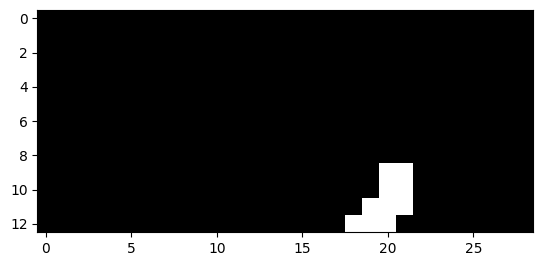

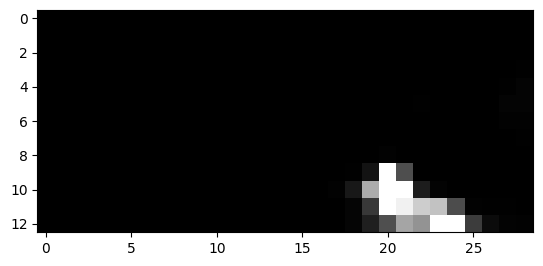

1397


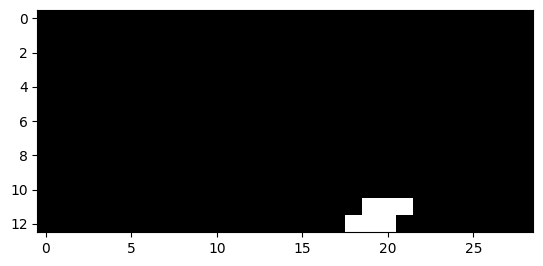

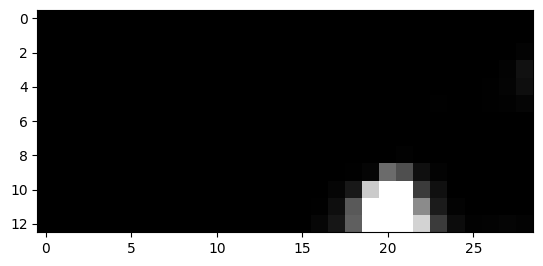

1398


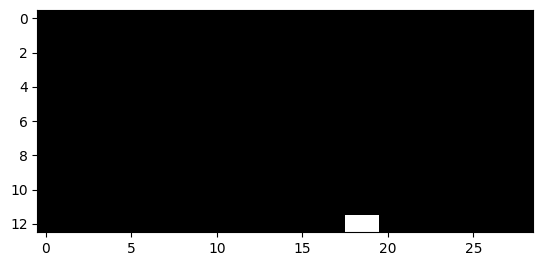

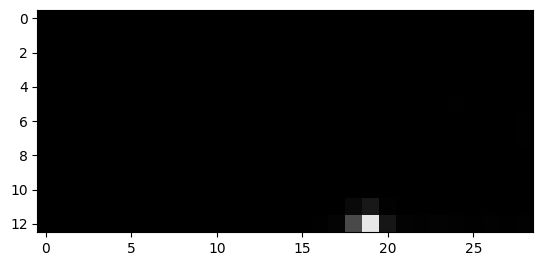

1403


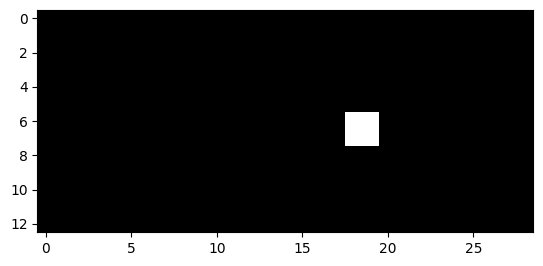

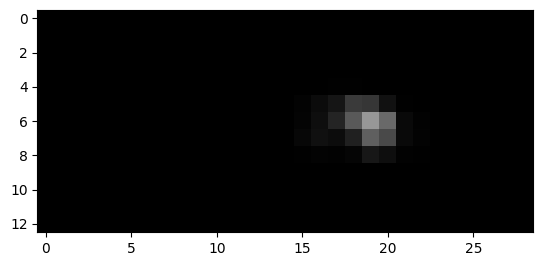

1404


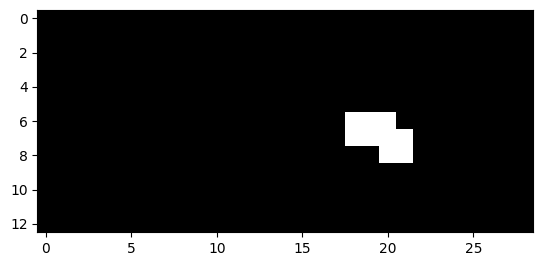

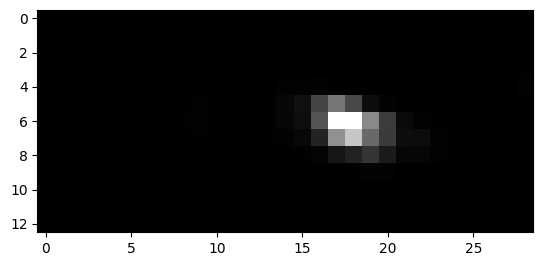

1405


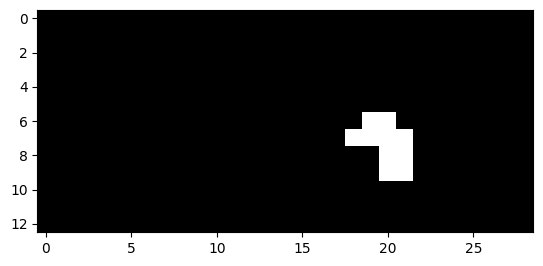

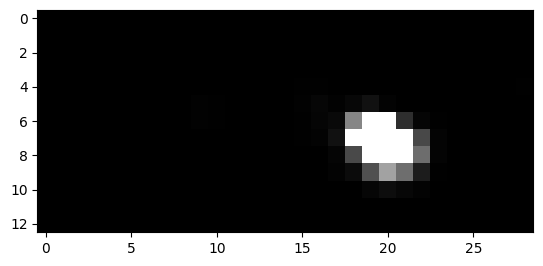

1406


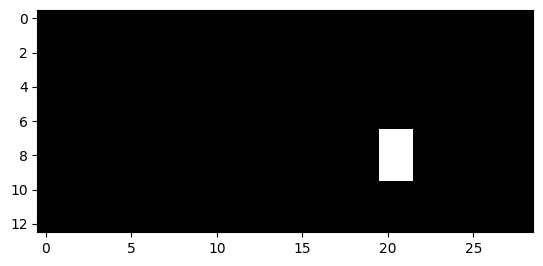

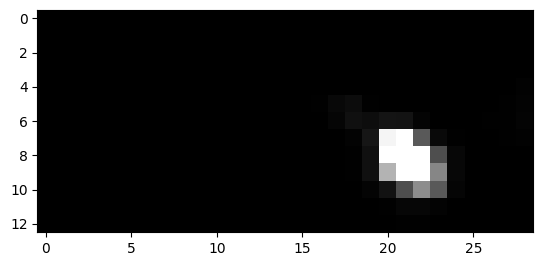

1407


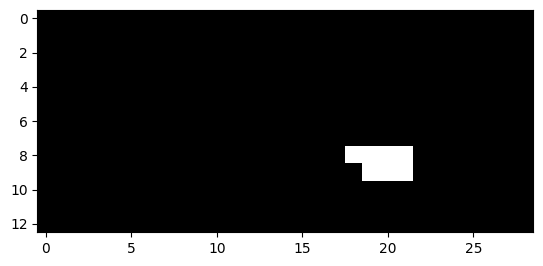

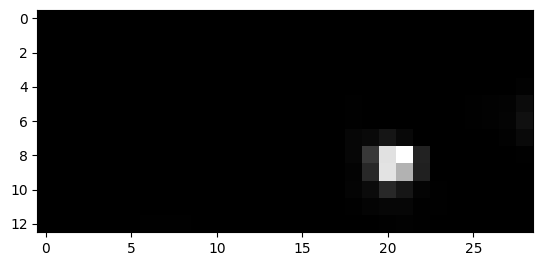

1408


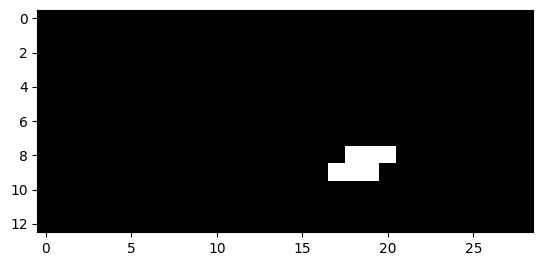

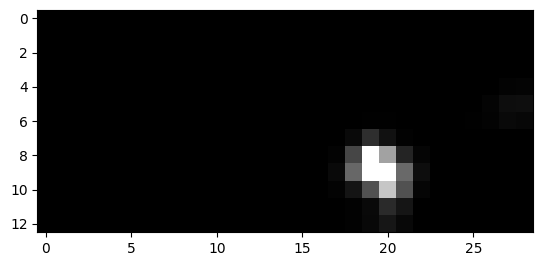

1409


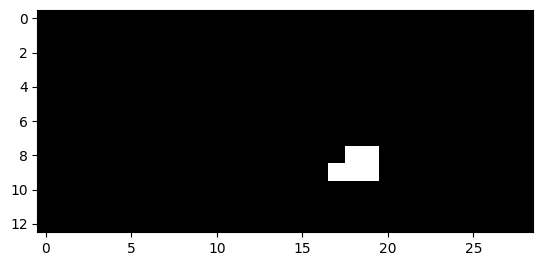

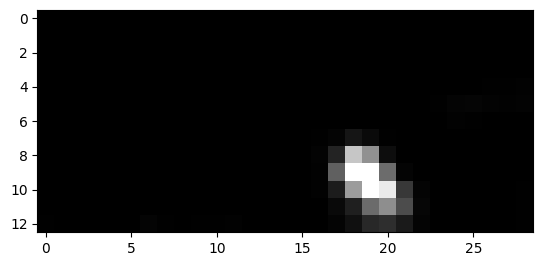

1412


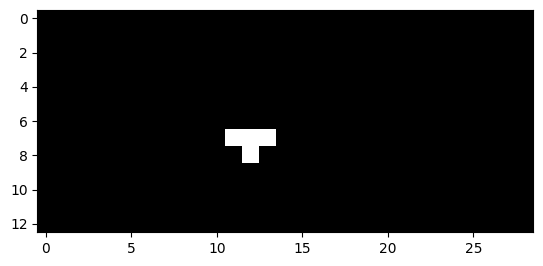

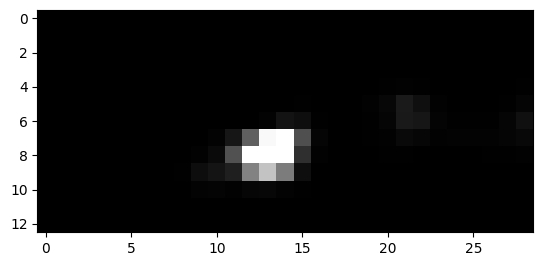

1413


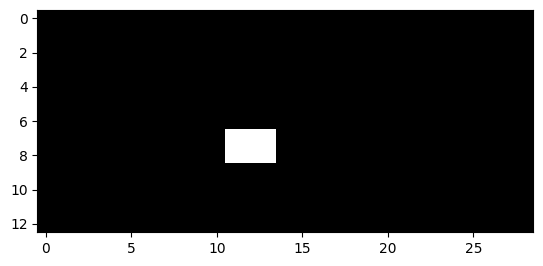

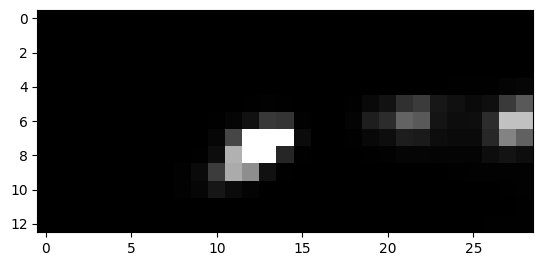

1414


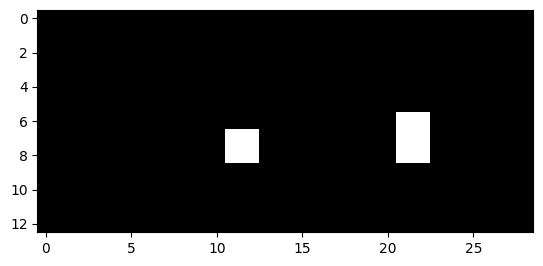

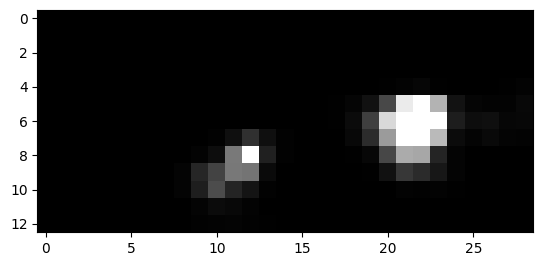

1415


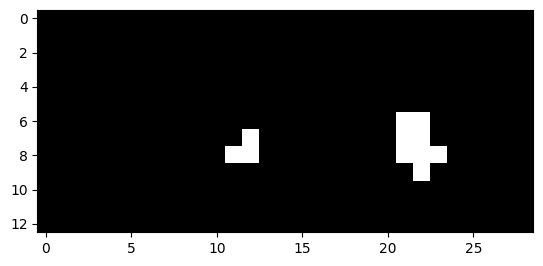

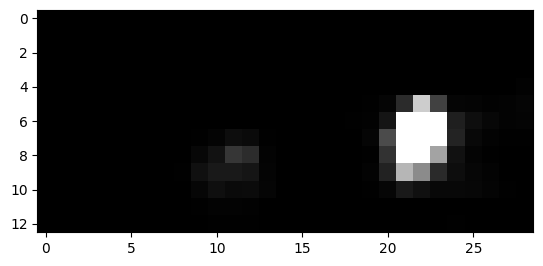

1416


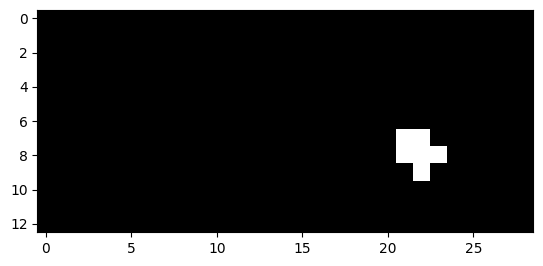

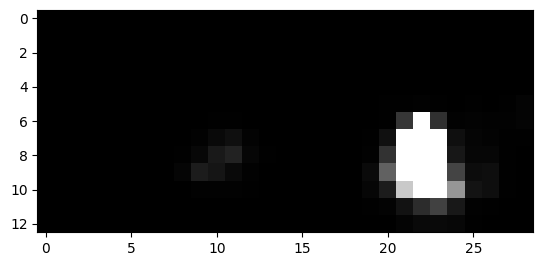

1417


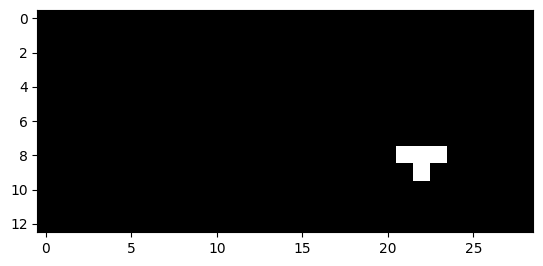

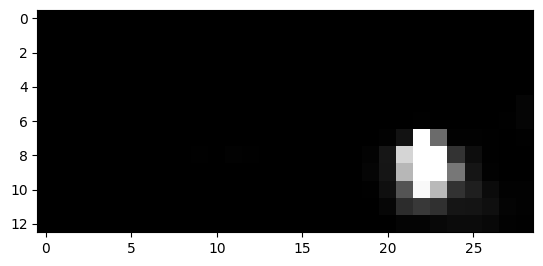

1419


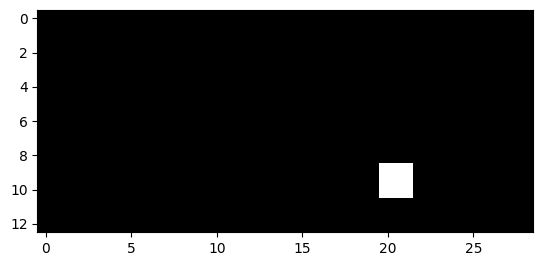

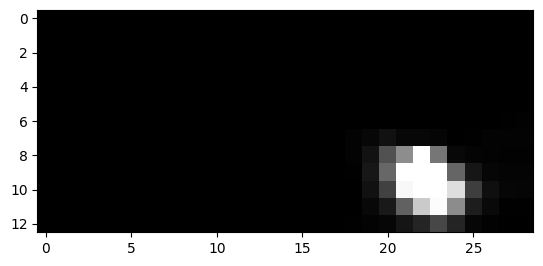

1420


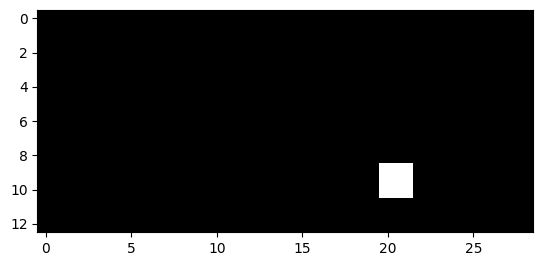

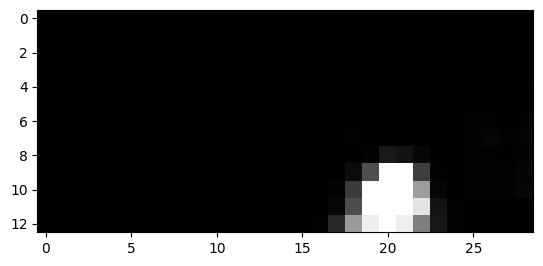

1441


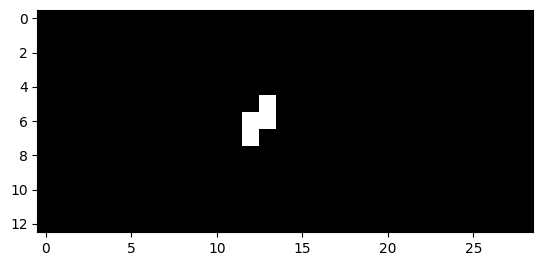

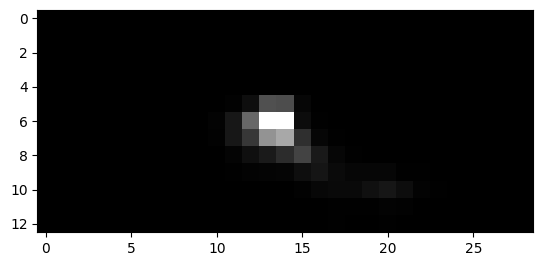

1442


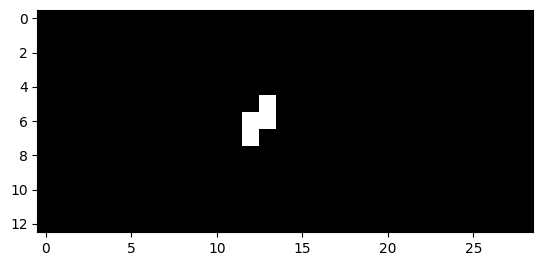

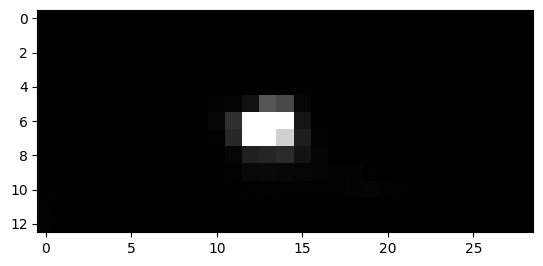

1443


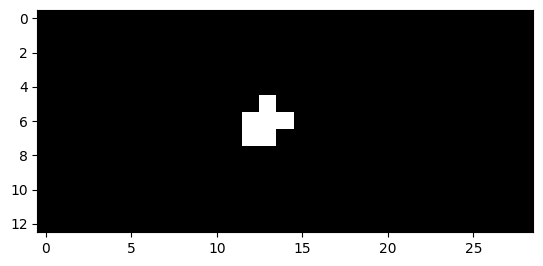

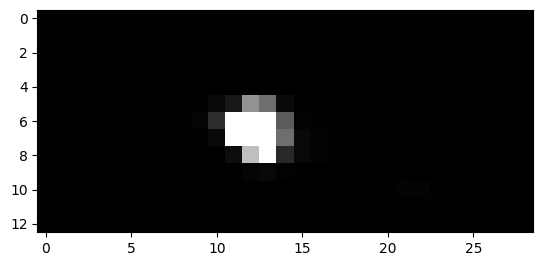

1444


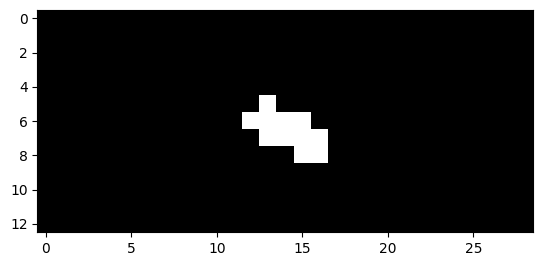

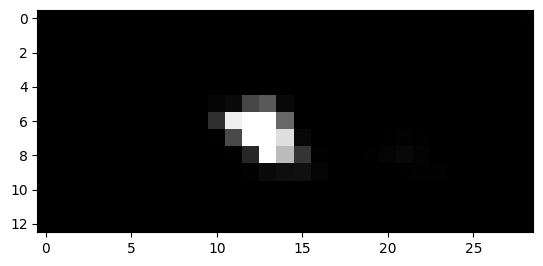

1445


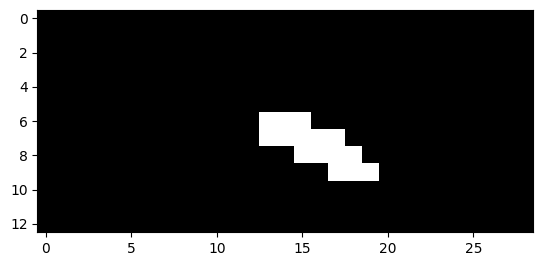

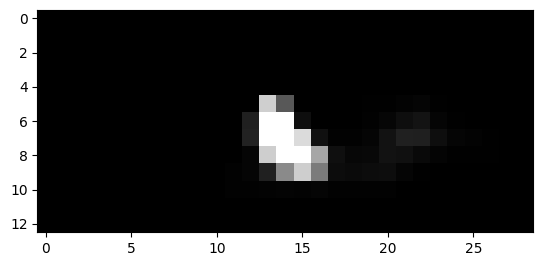

1446


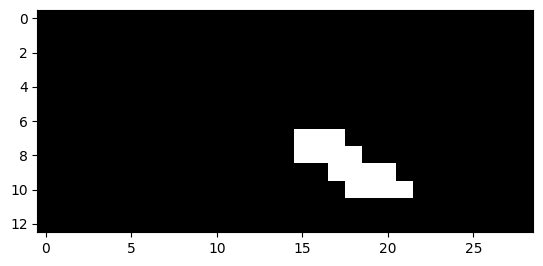

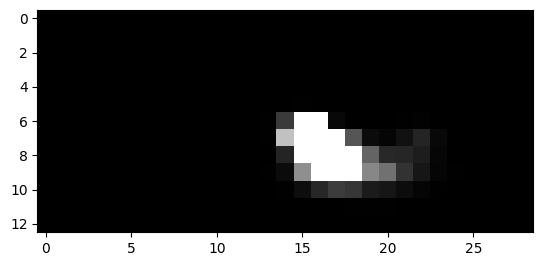

1447


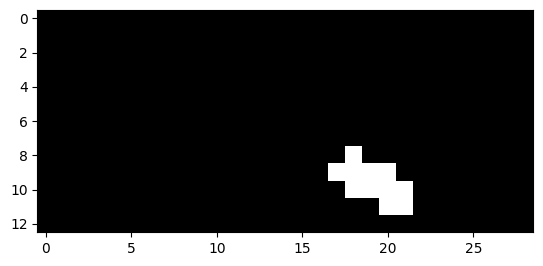

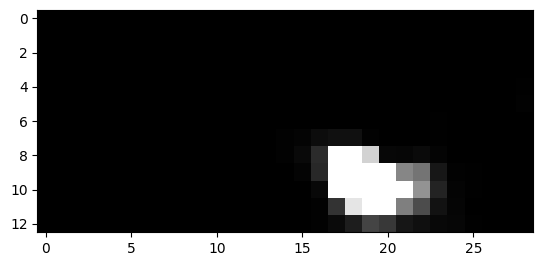

1448


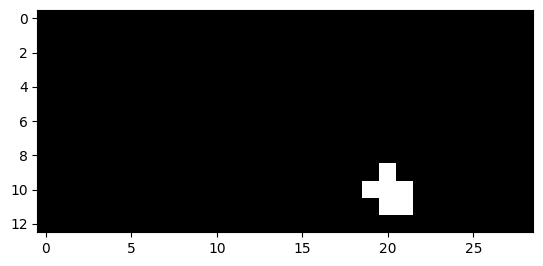

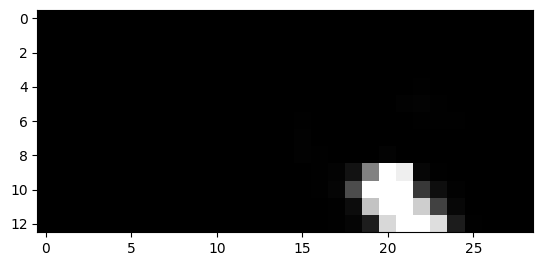

1460


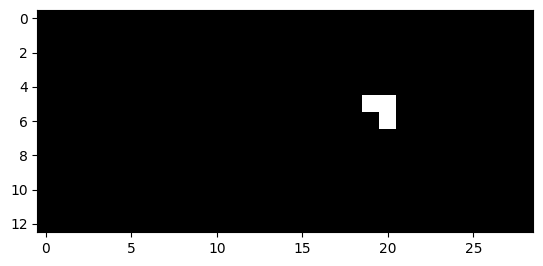

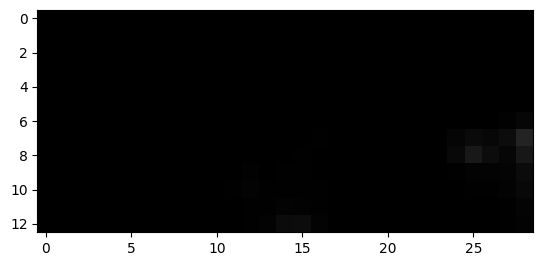

1461


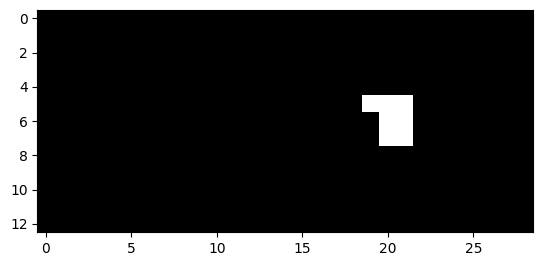

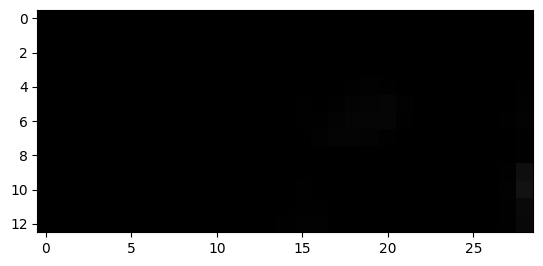

1462


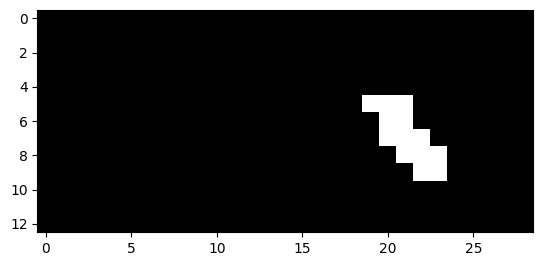

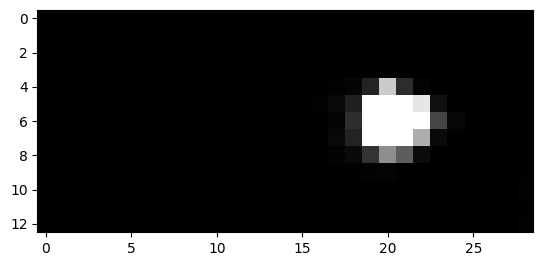

1463


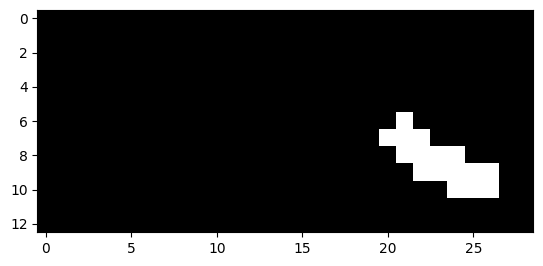

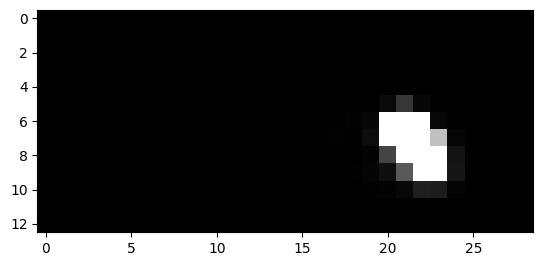

1464


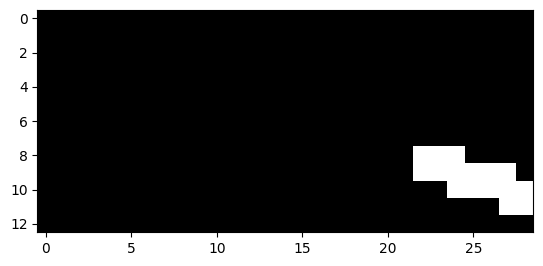

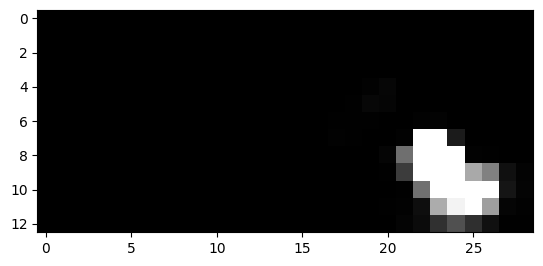

1465


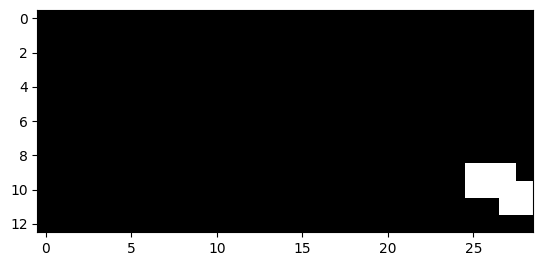

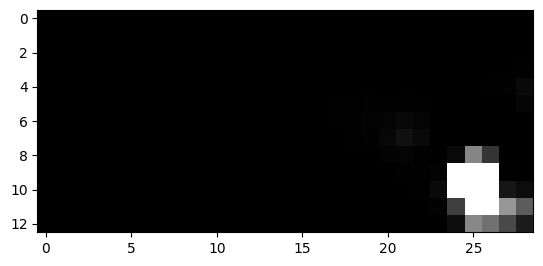

1466


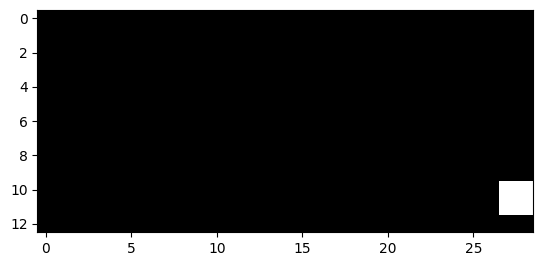

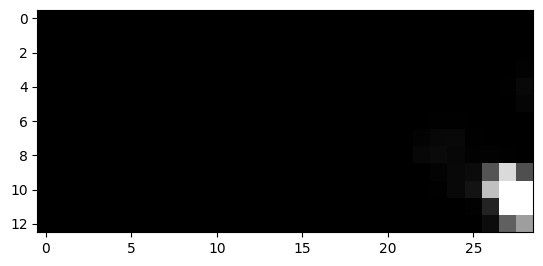

1473


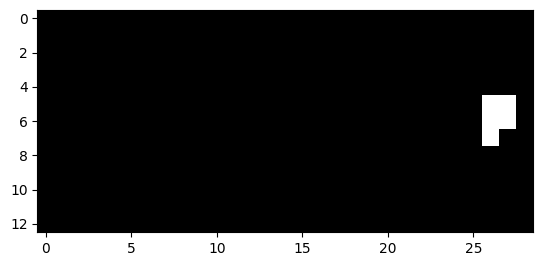

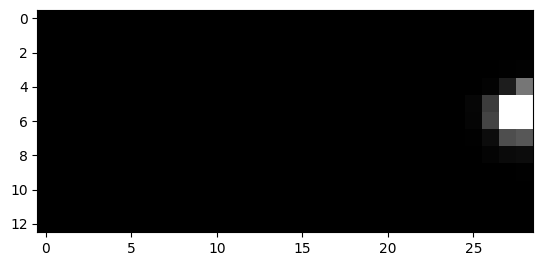

1474


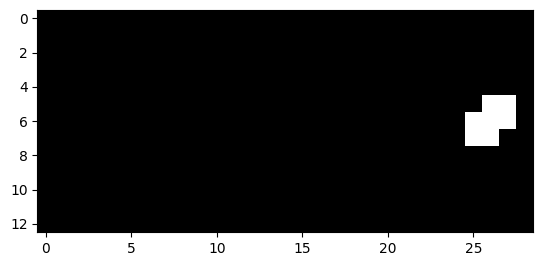

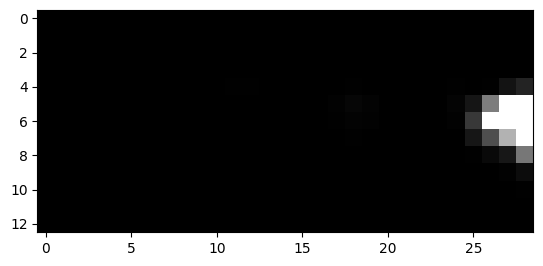

1475


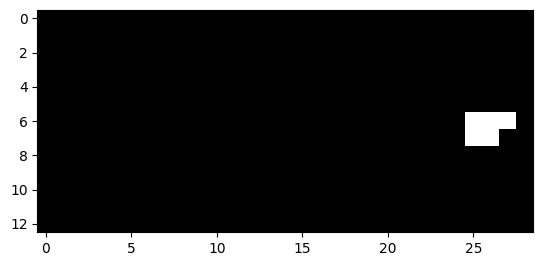

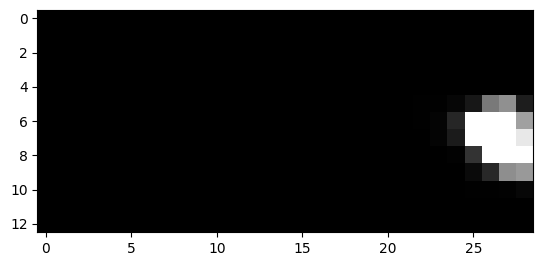

1509


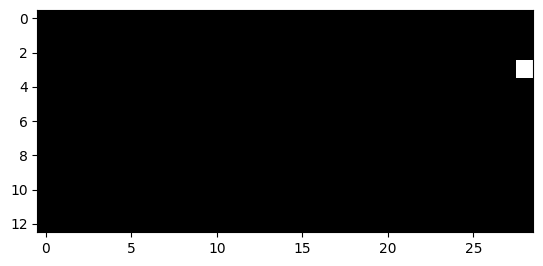

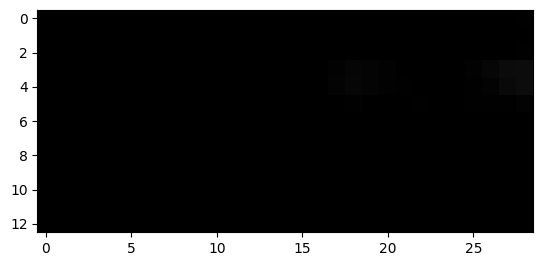

1510


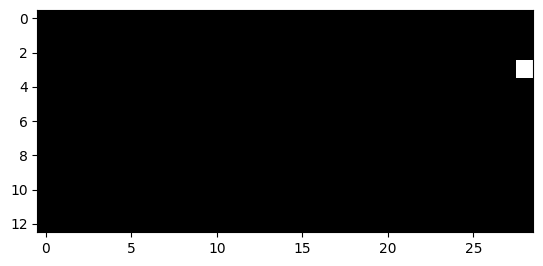

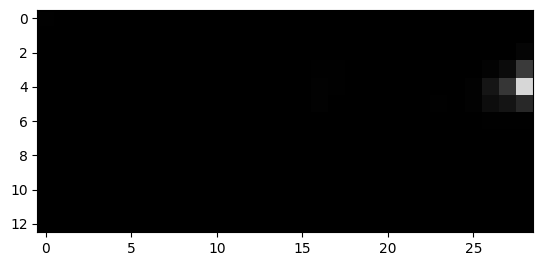

1511


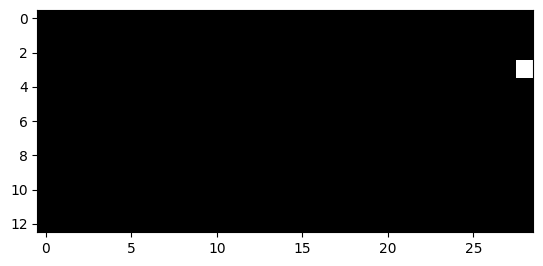

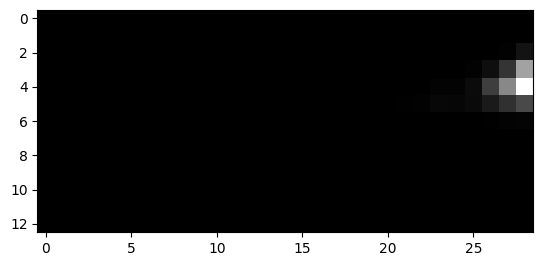

1687


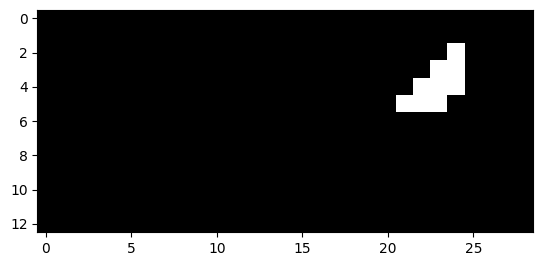

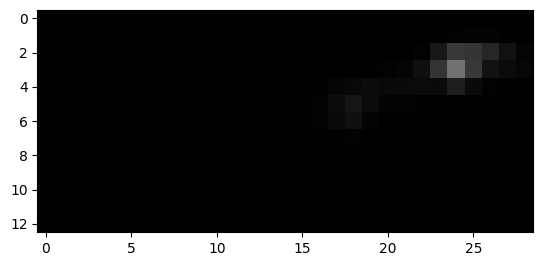

1688


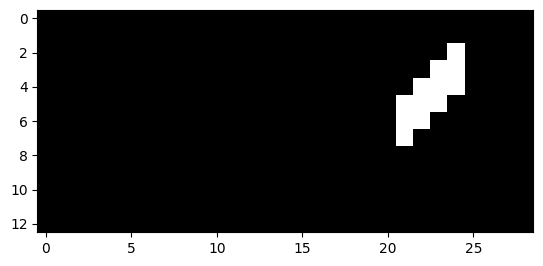

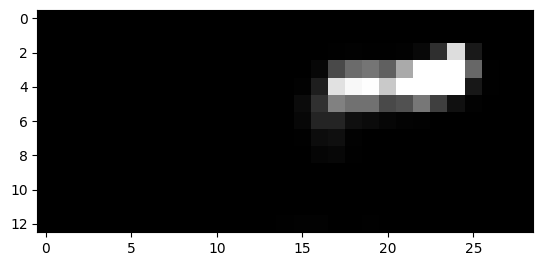

1689


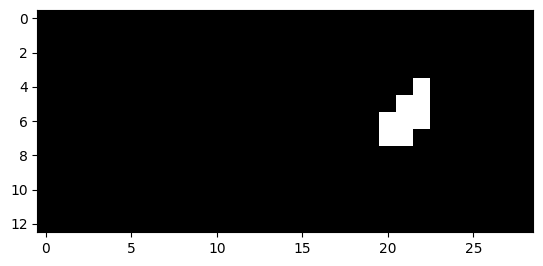

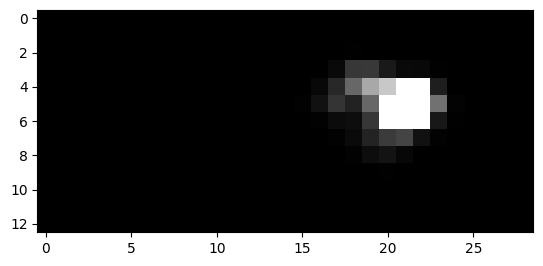

1690


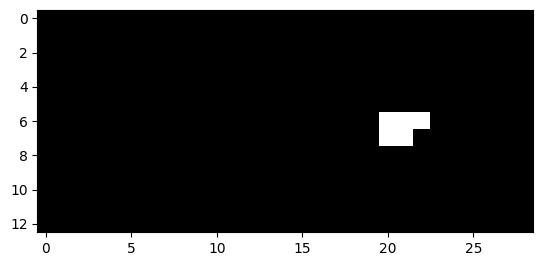

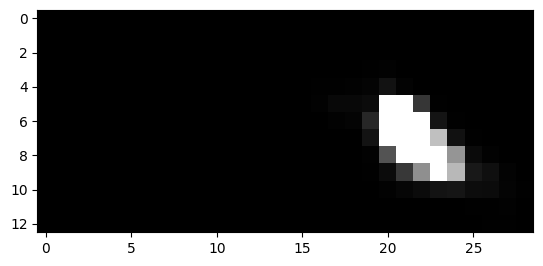

1691


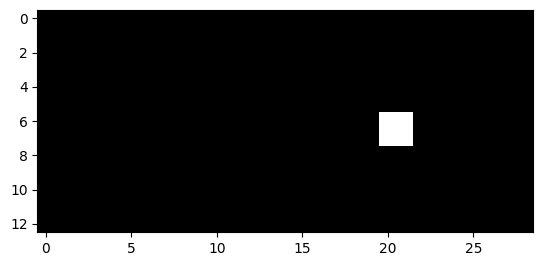

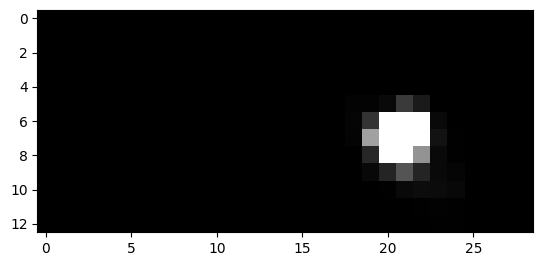

1710


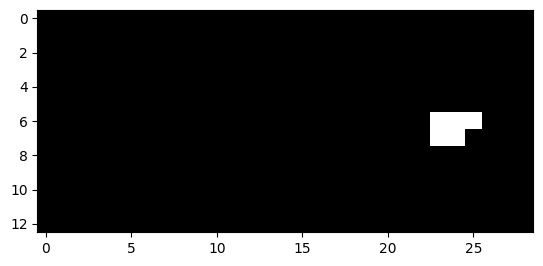

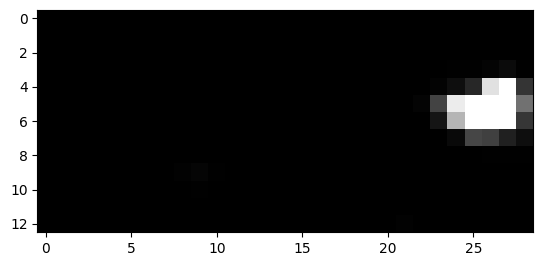

1711


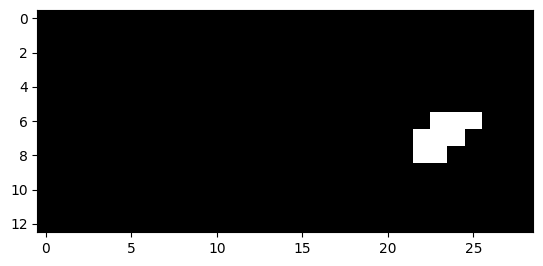

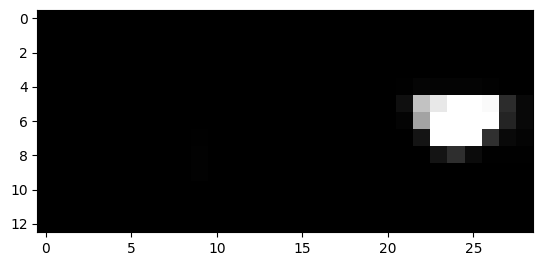

1712


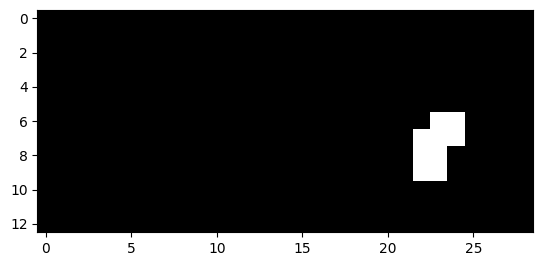

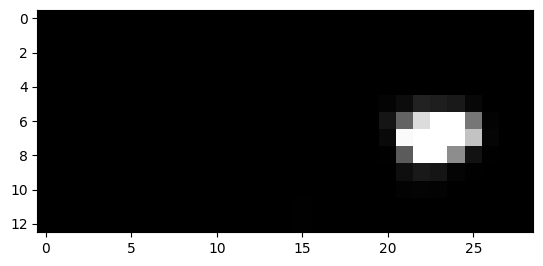

1713


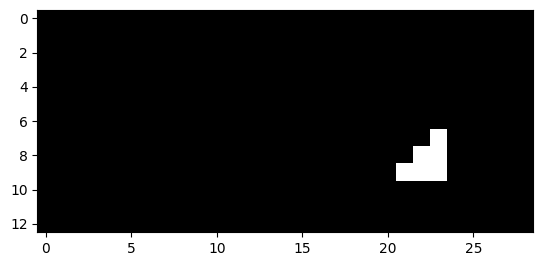

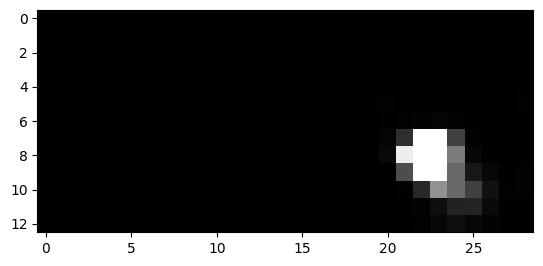

1714


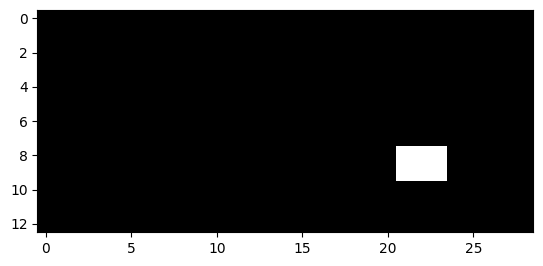

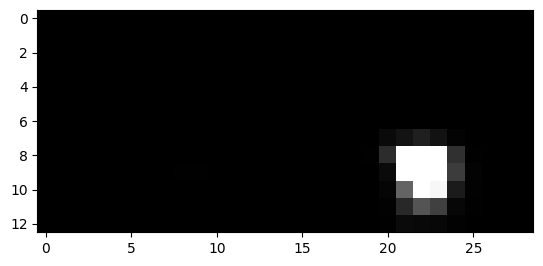

1715


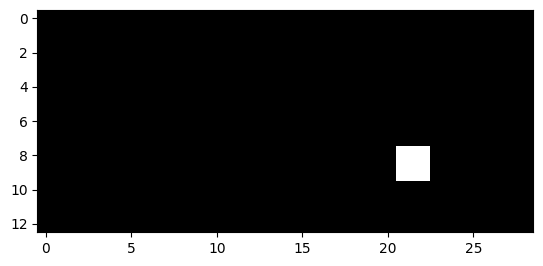

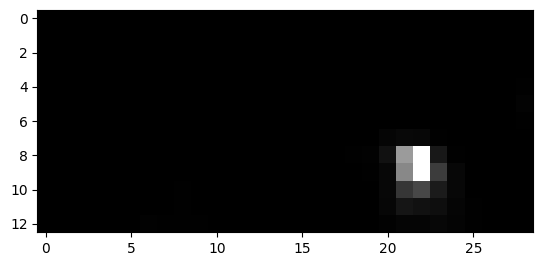

1728


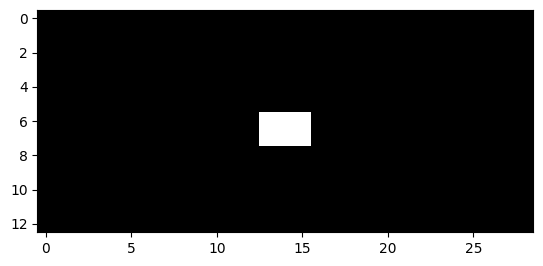

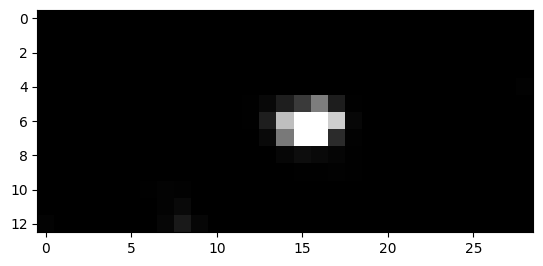

1729


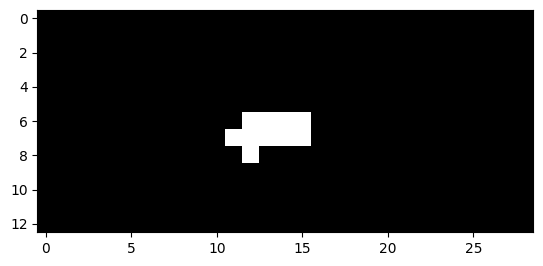

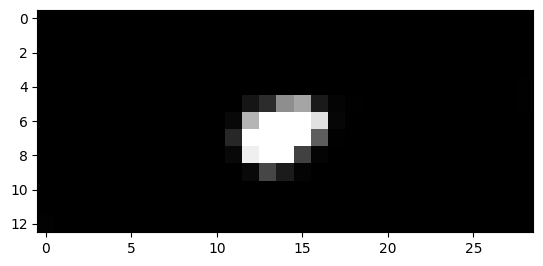

1730


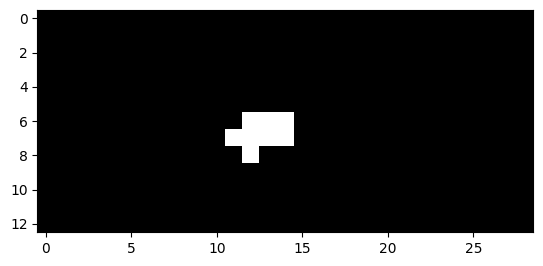

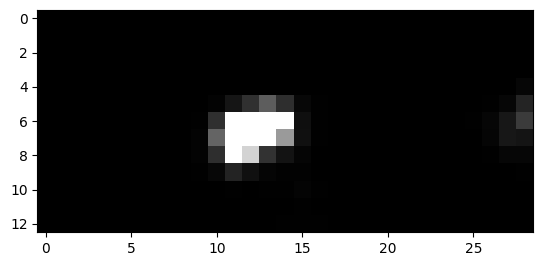

1731


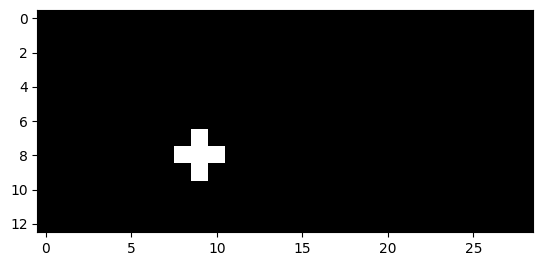

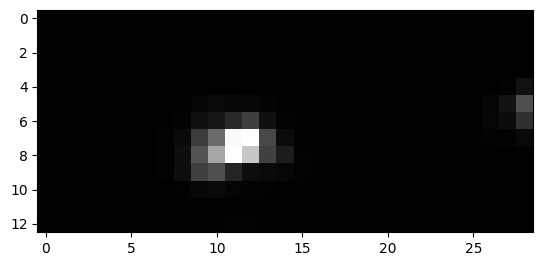

1732


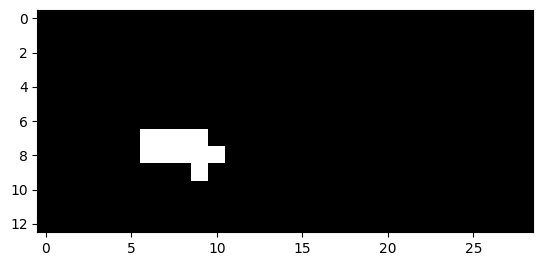

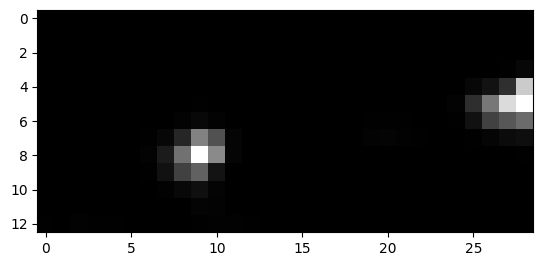

1733


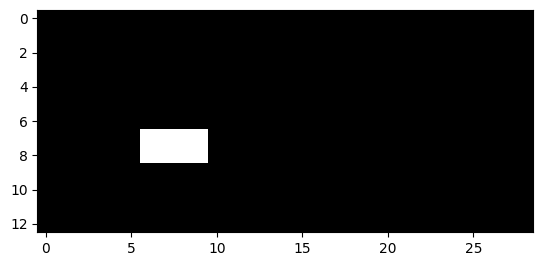

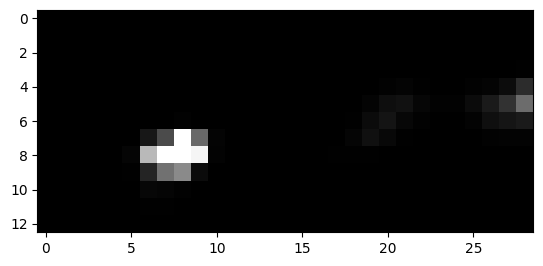

1735


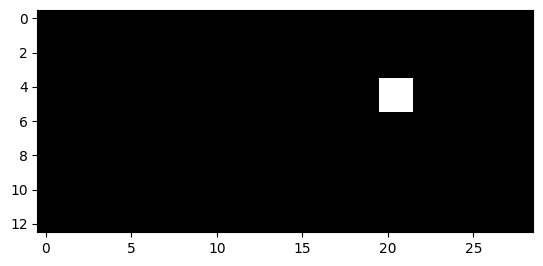

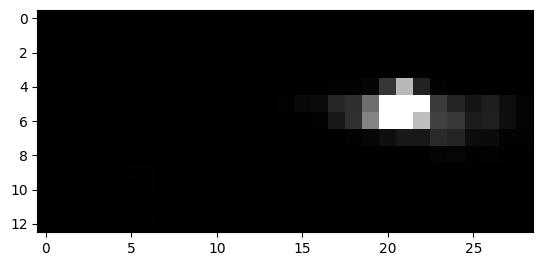

1736


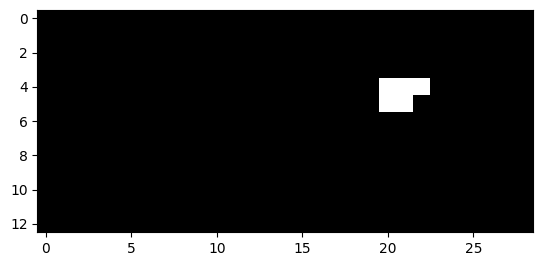

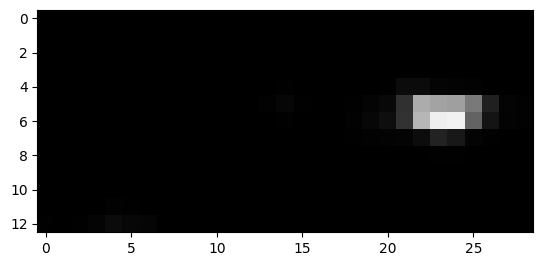

1737


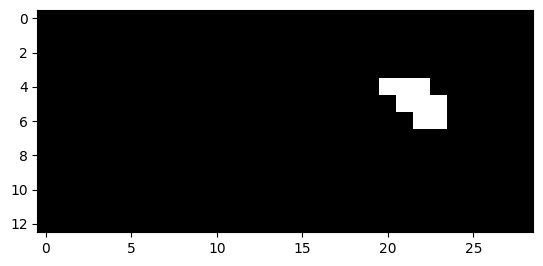

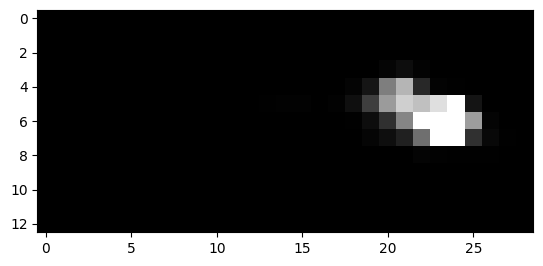

1738


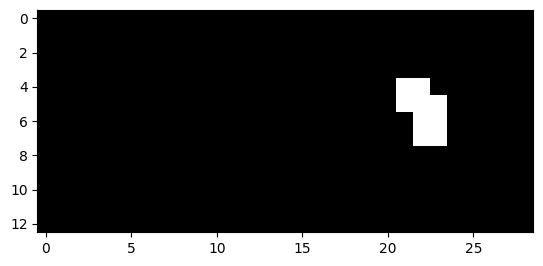

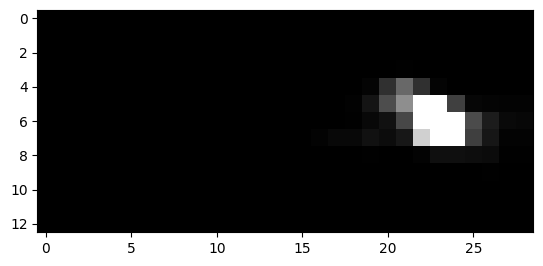

1739


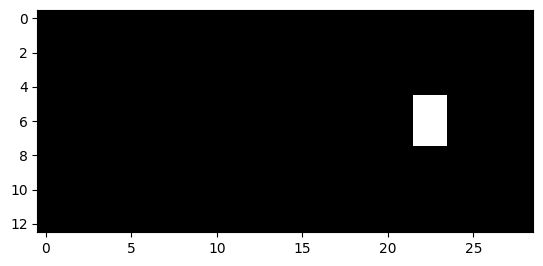

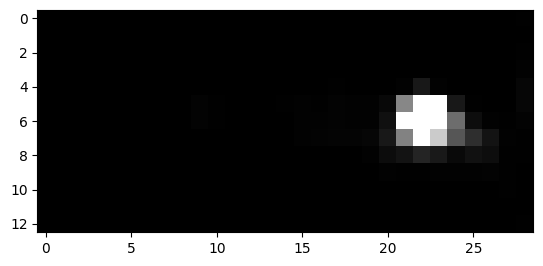

1740


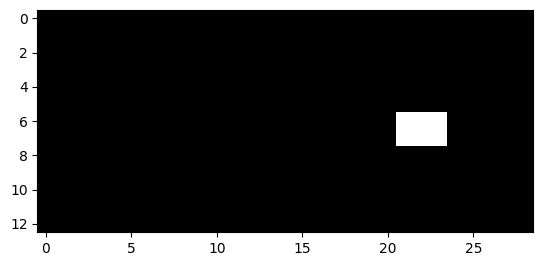

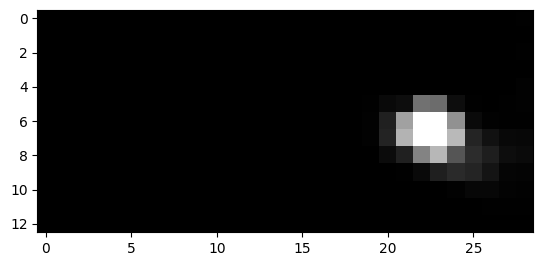

1741


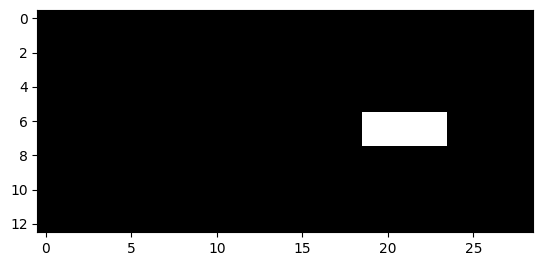

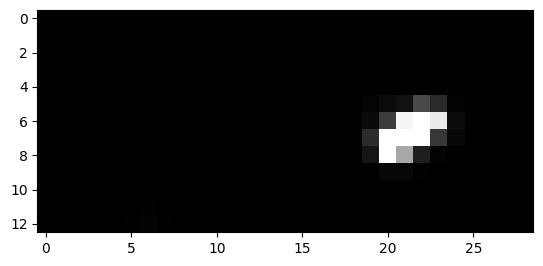

1742


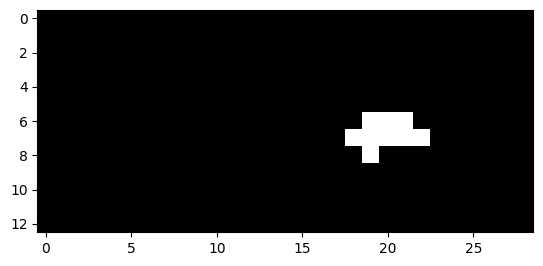

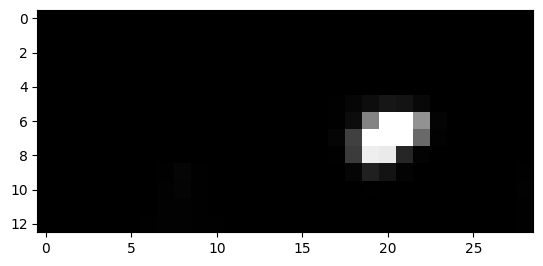

1743


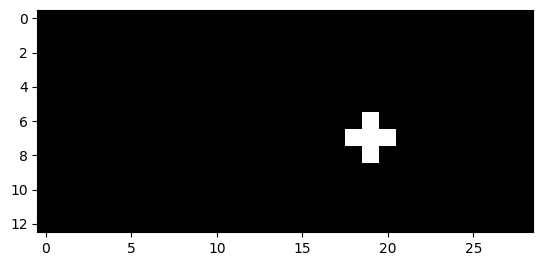

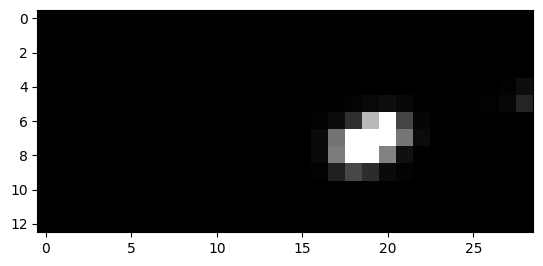

1750


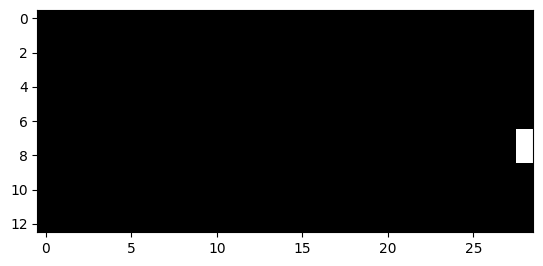

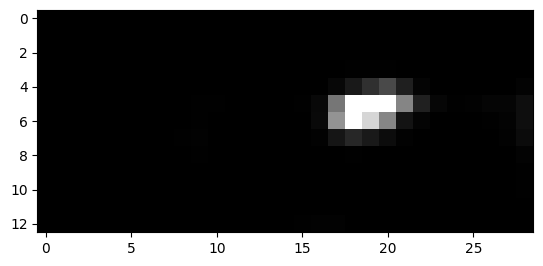

1751


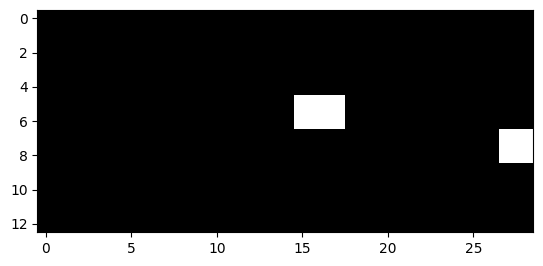

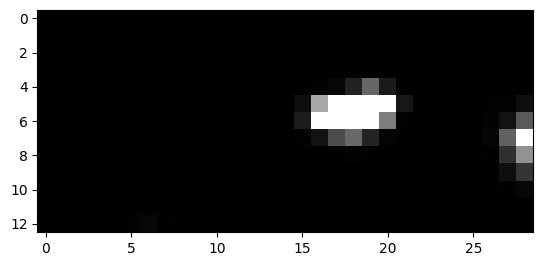

1752


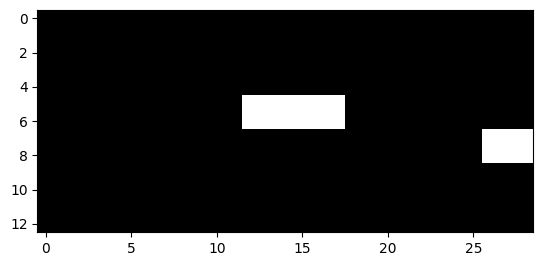

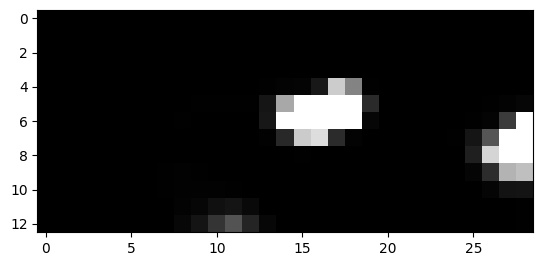

1753


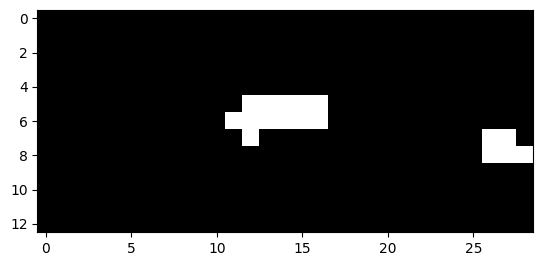

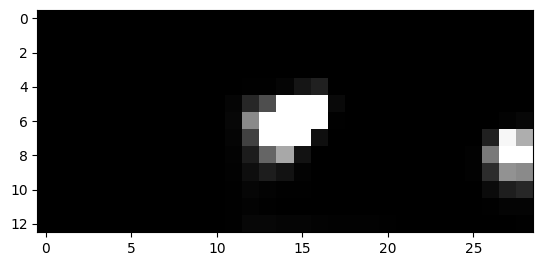

1754


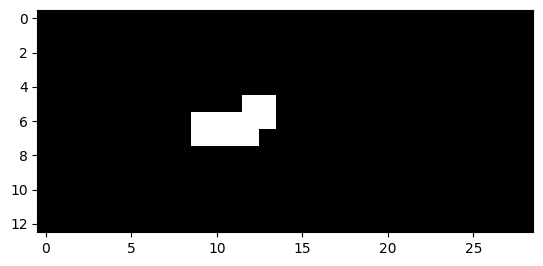

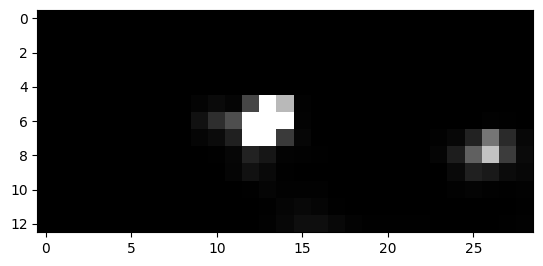

1755


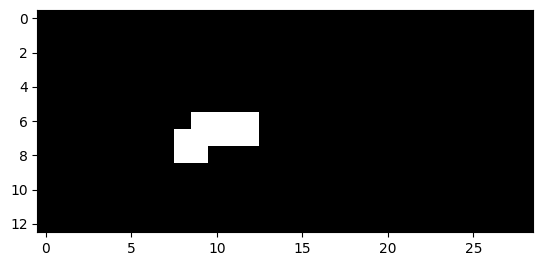

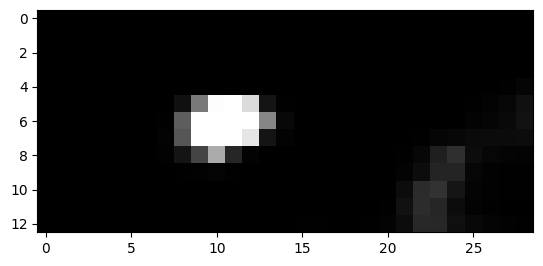

1756


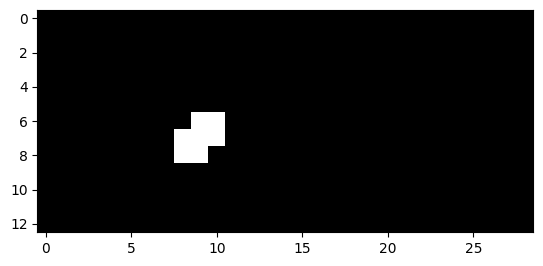

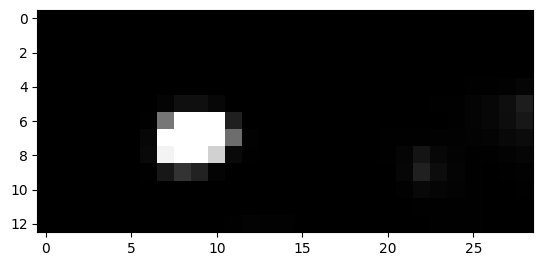

1760


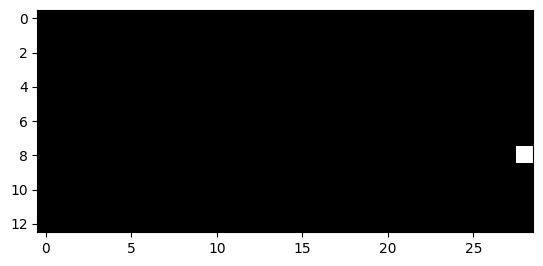

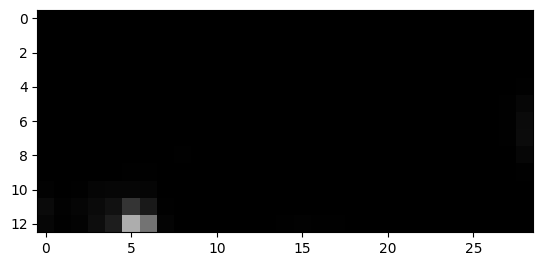

1761


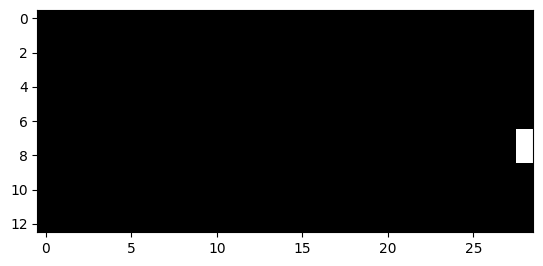

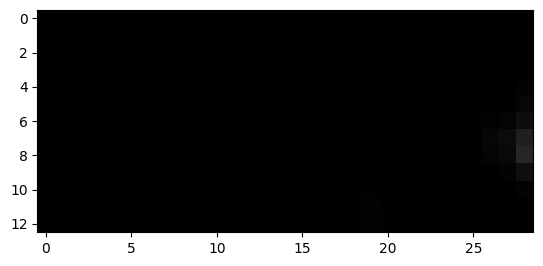

1762


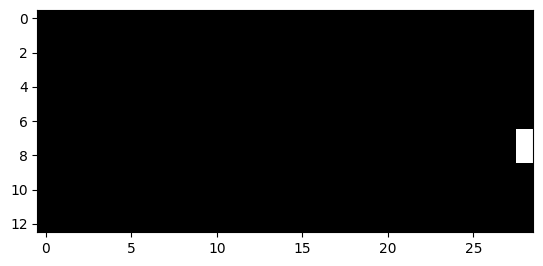

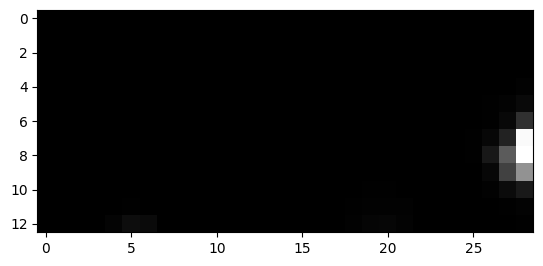

1770


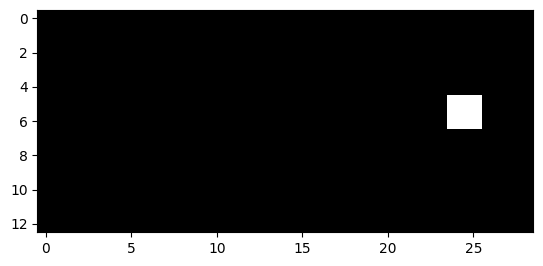

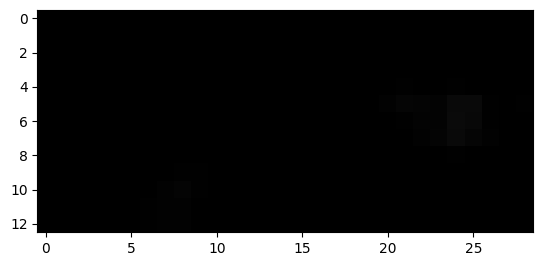

1771


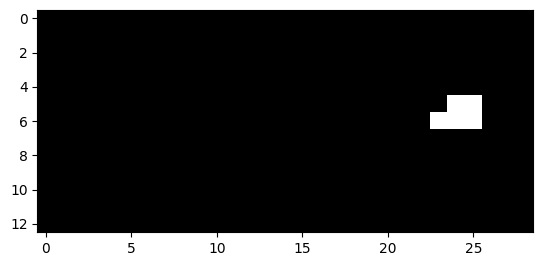

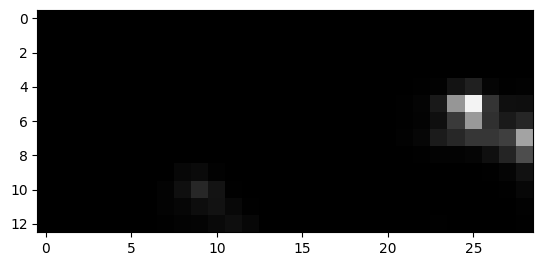

1772


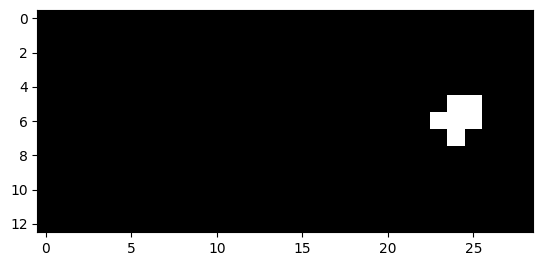

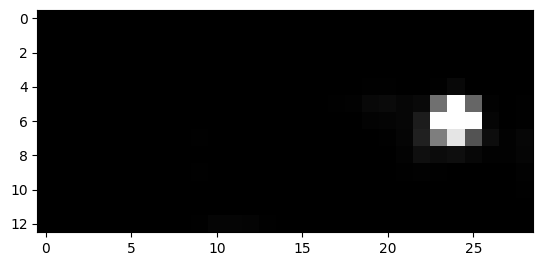

1773


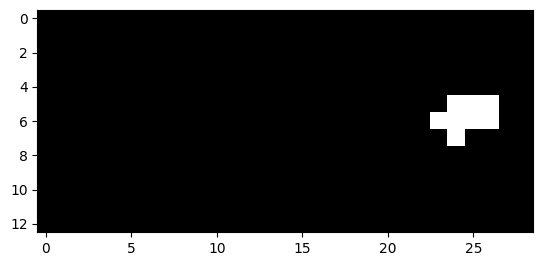

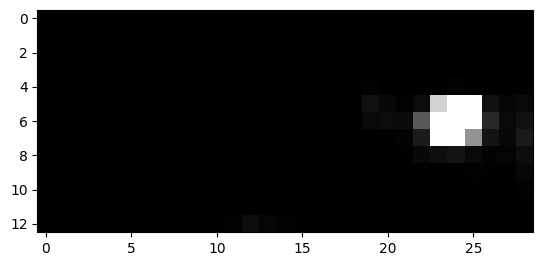

1774


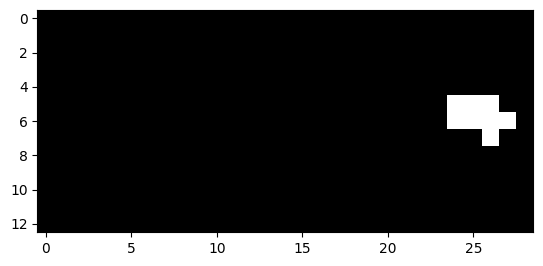

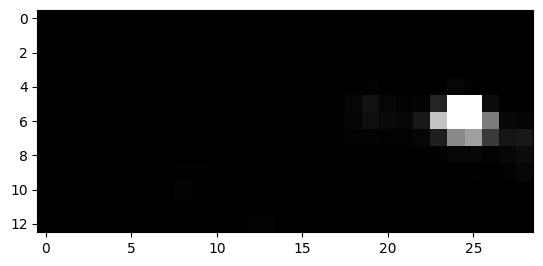

1775


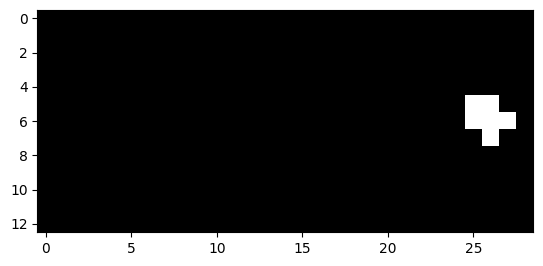

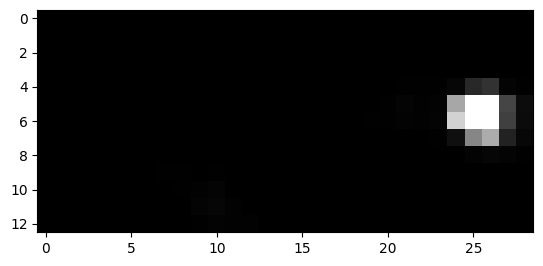

1776


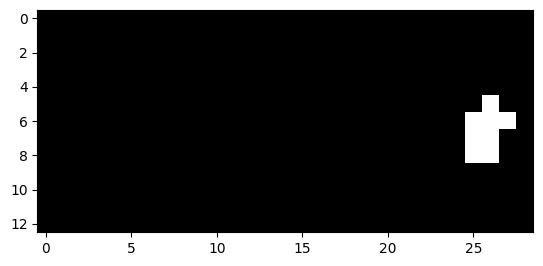

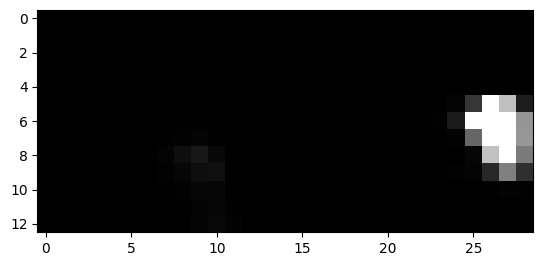

1777


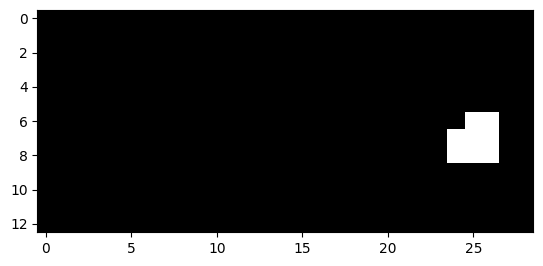

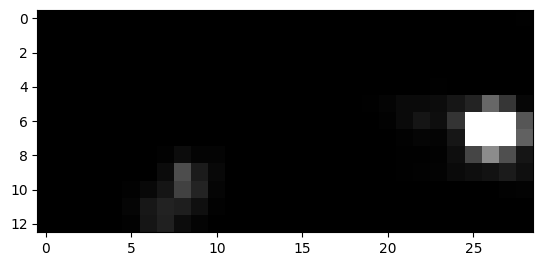

1778


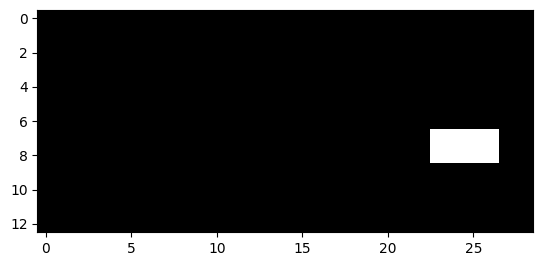

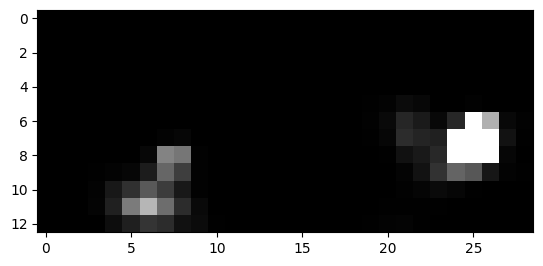

1779


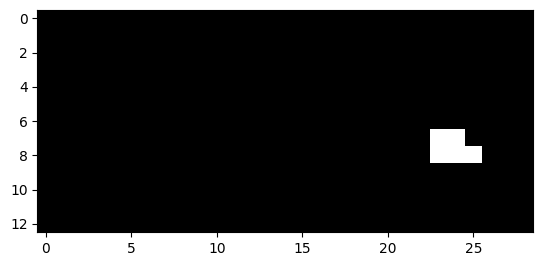

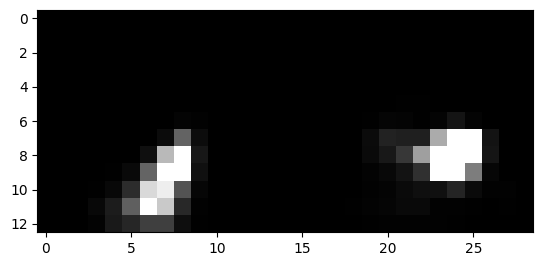

1786


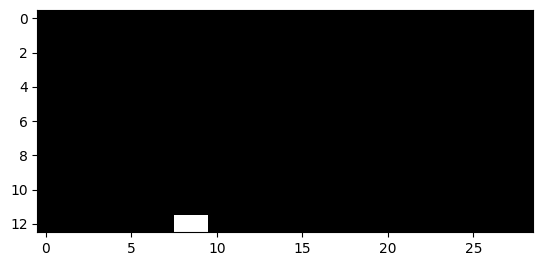

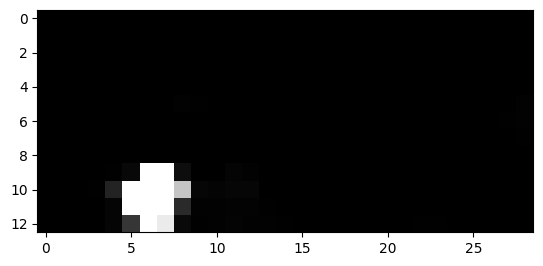

1787


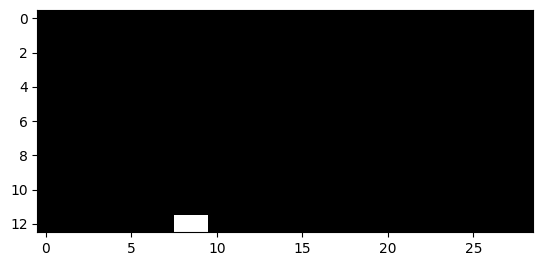

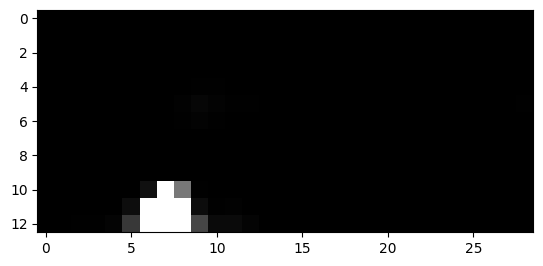

1792


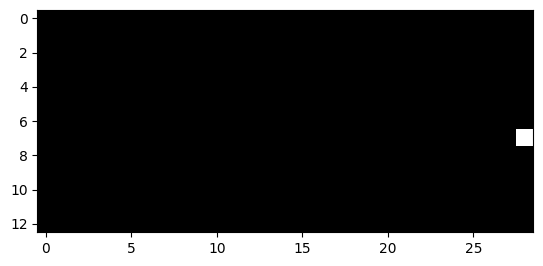

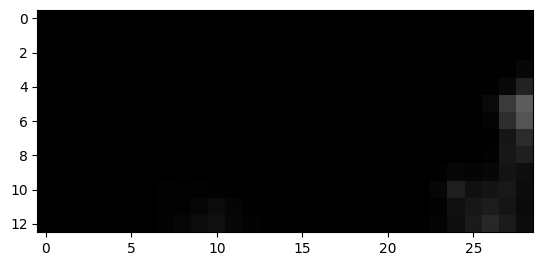

1793


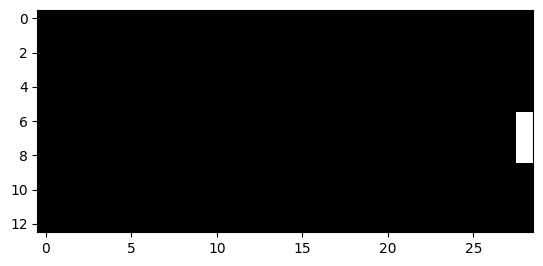

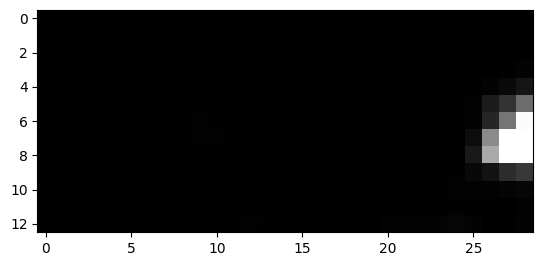

1794


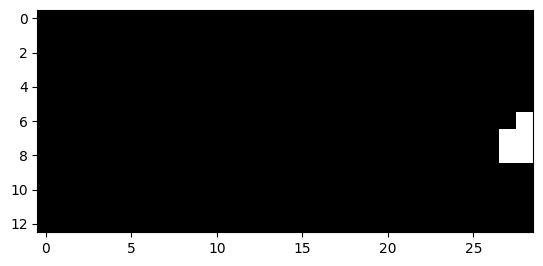

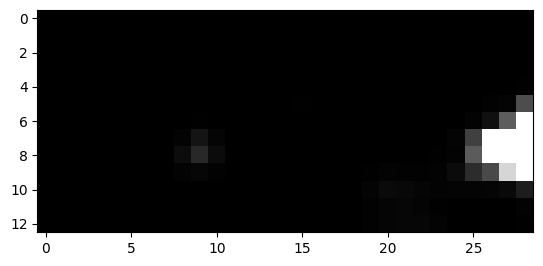

1795


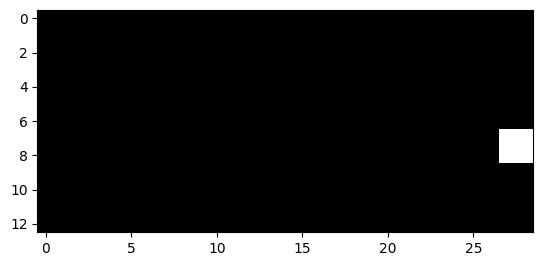

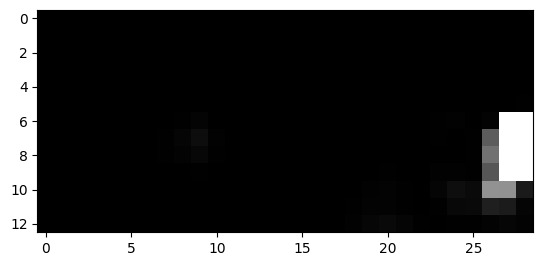

1796


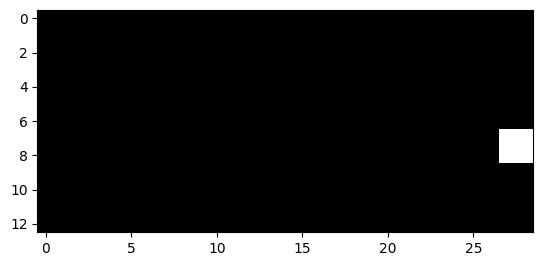

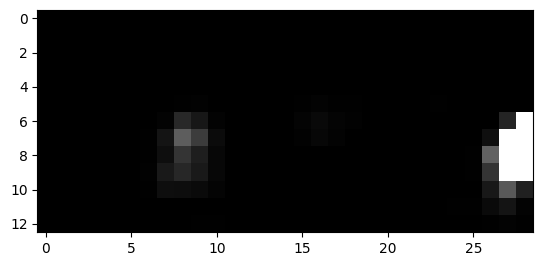

1797


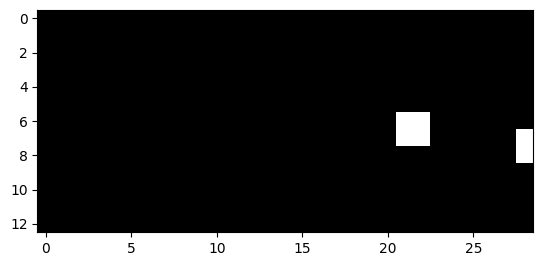

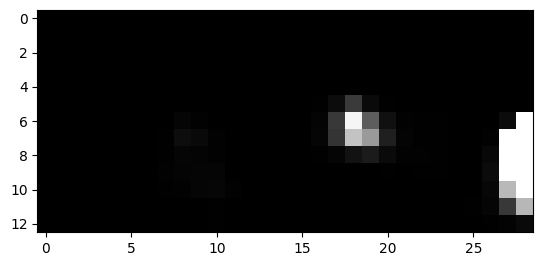

1798


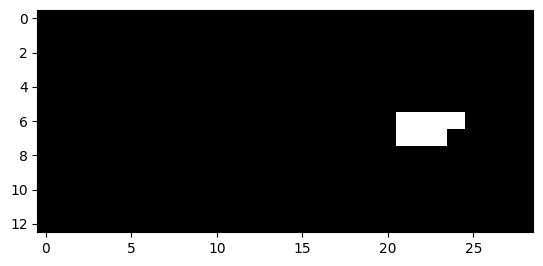

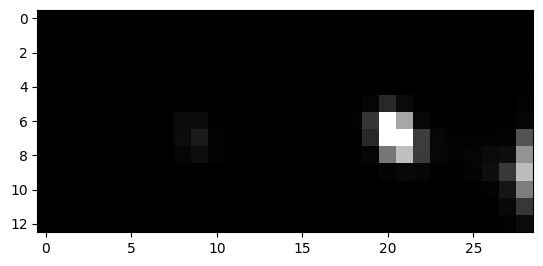

1799


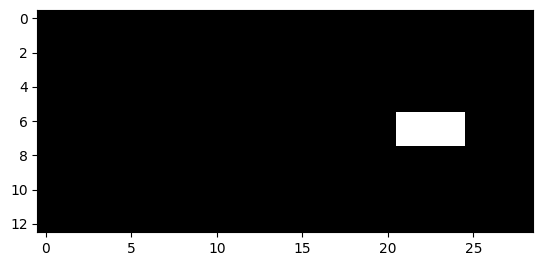

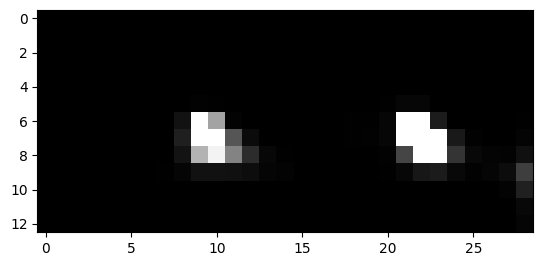

1800


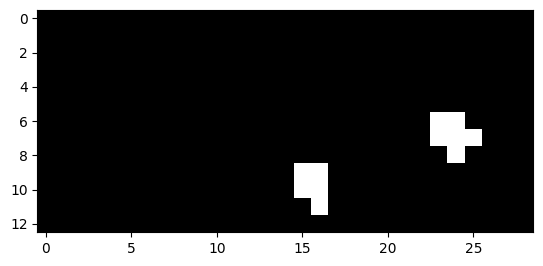

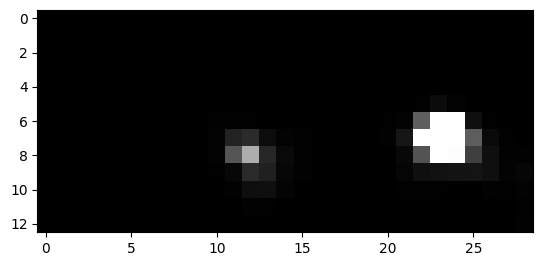

1801


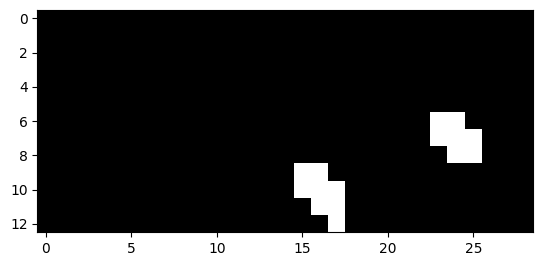

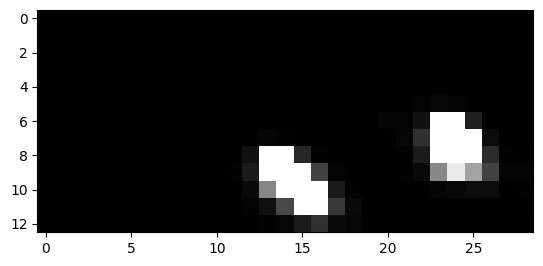

1802


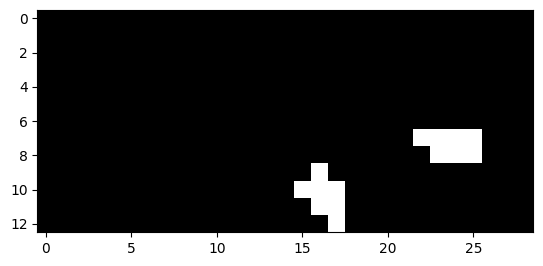

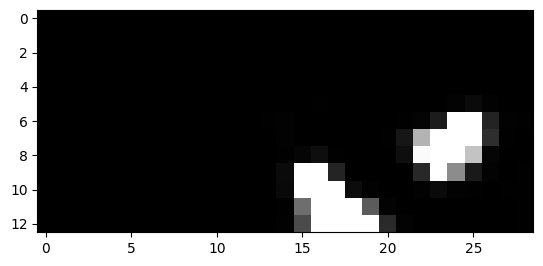

1803


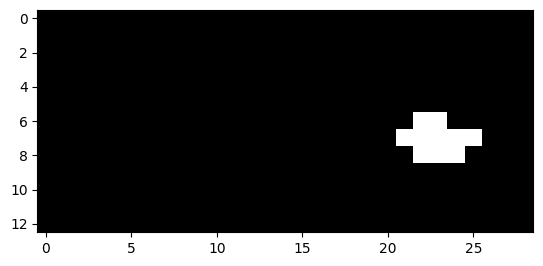

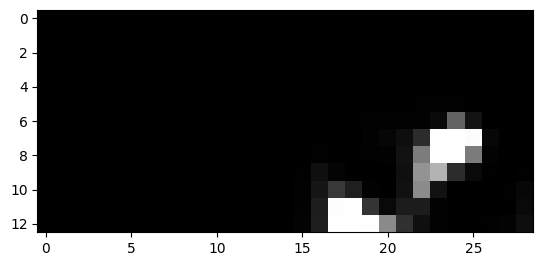

1804


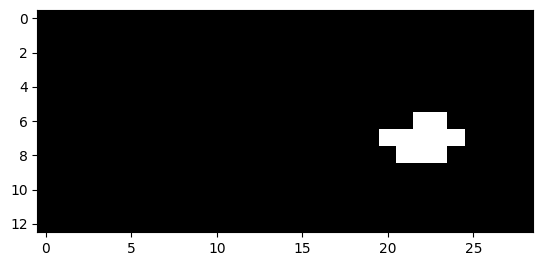

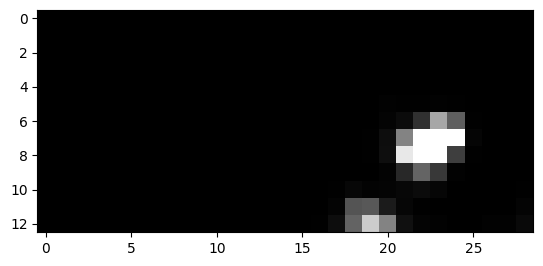

1805


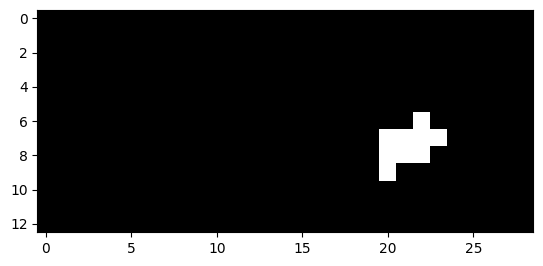

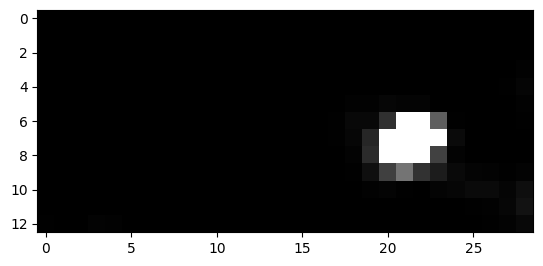

1806


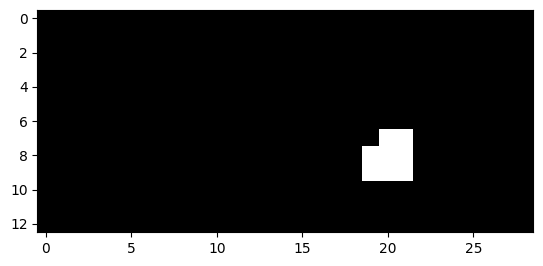

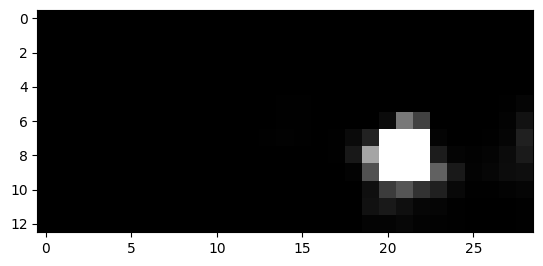

1807


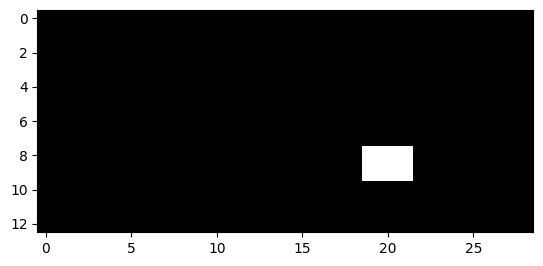

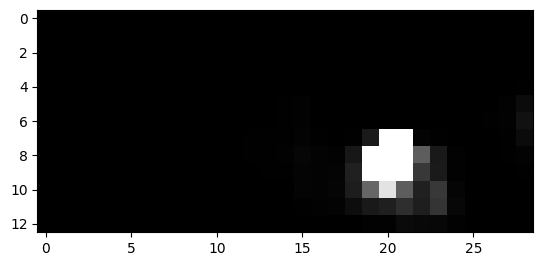

1808


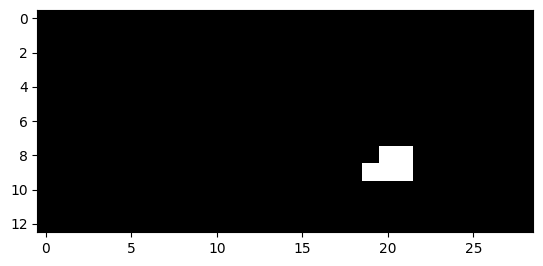

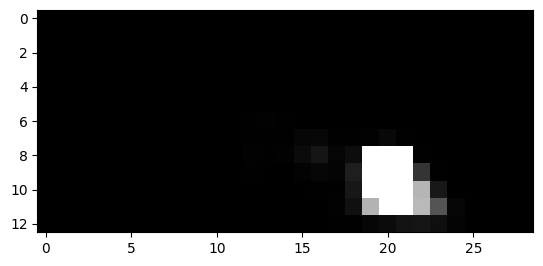

1809


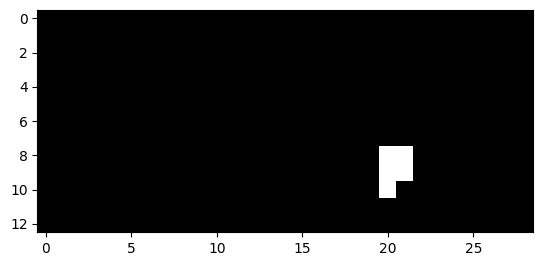

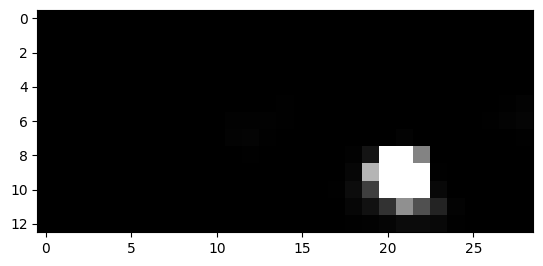

1810


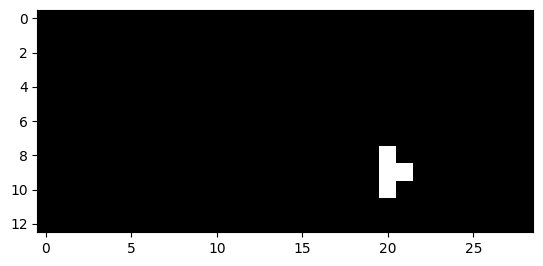

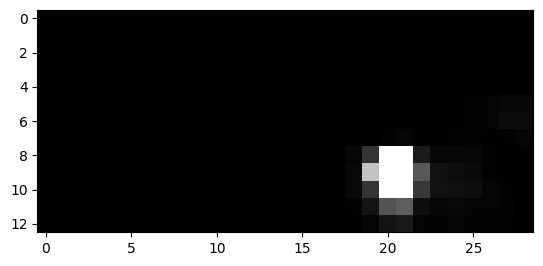

1845


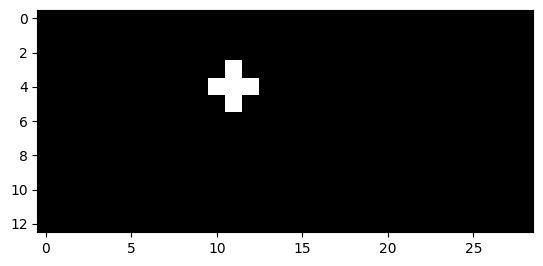

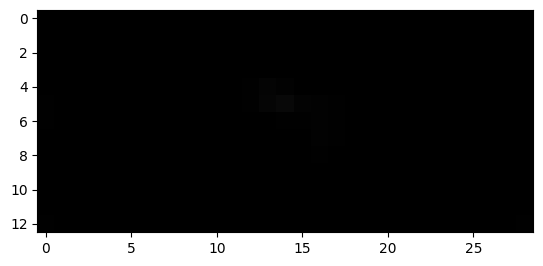

1846


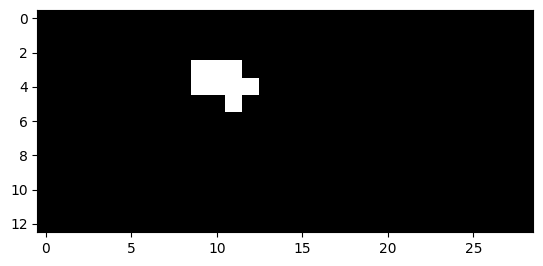

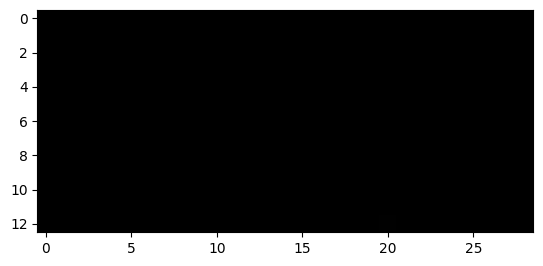

1847


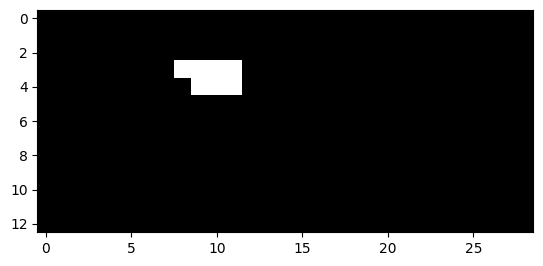

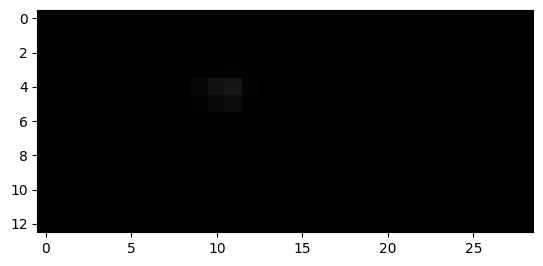

1848


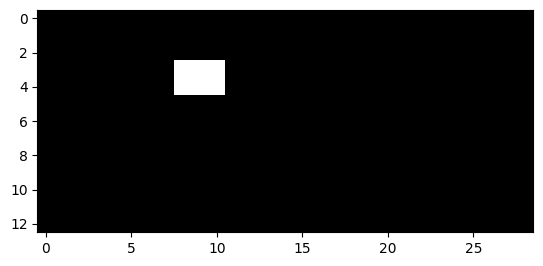

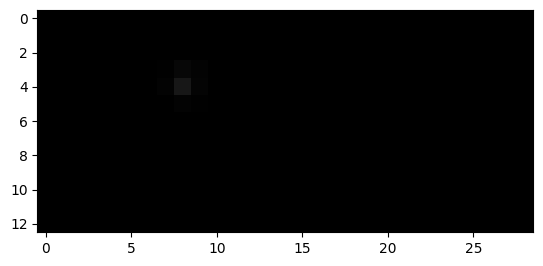

1849


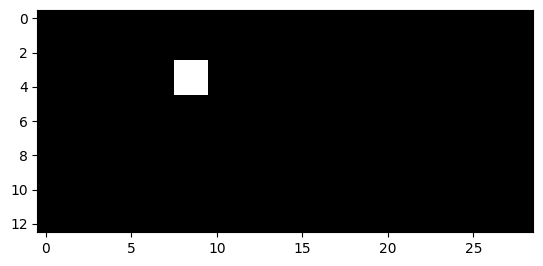

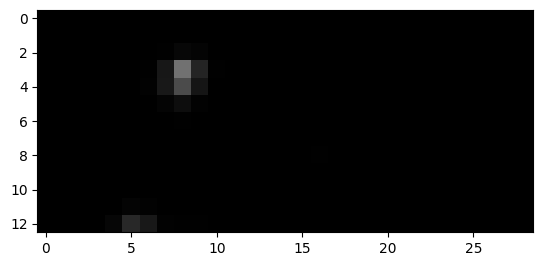

2122


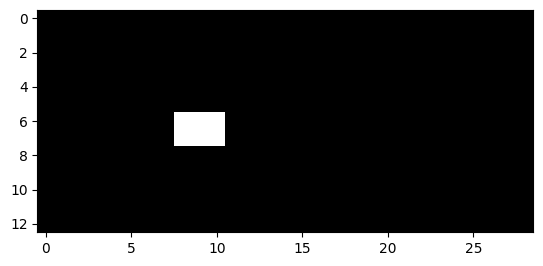

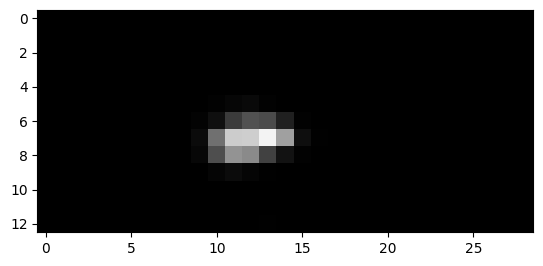

2123


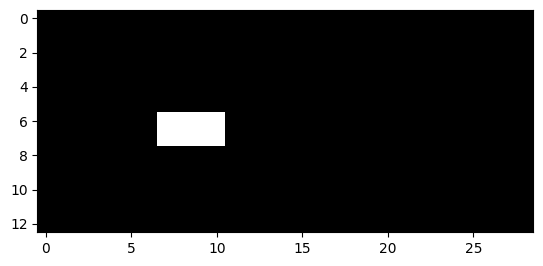

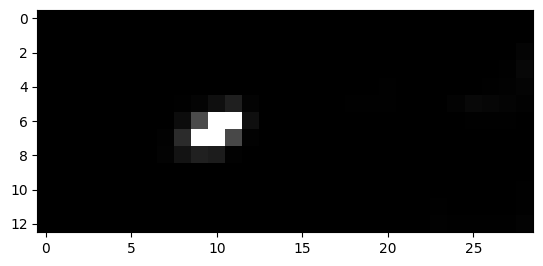

2124


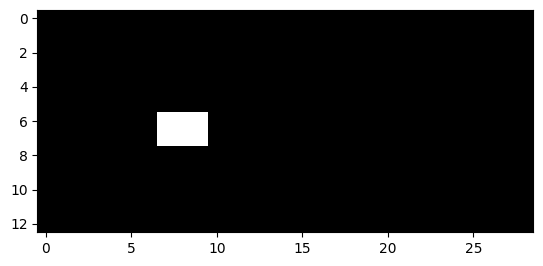

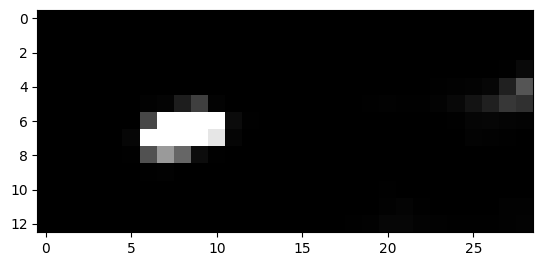

2126


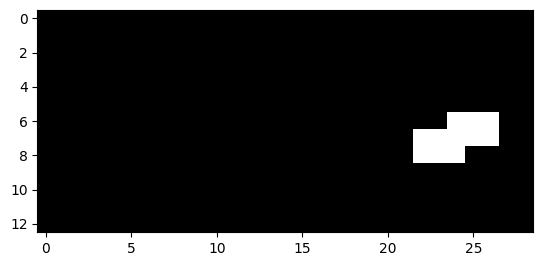

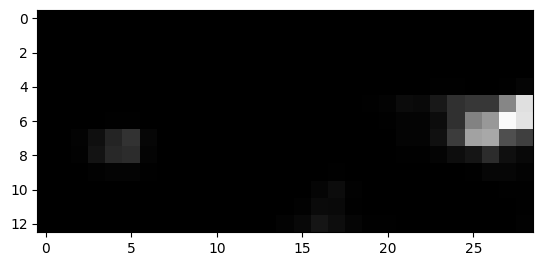

2127


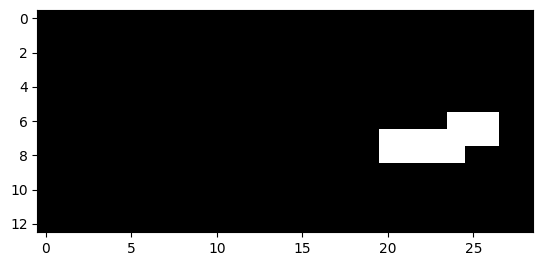

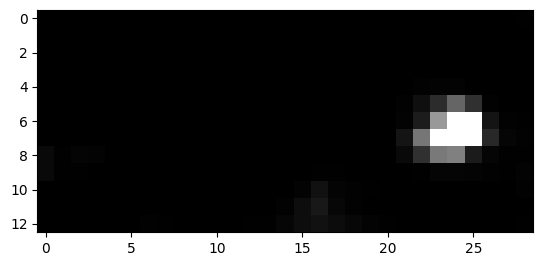

2128


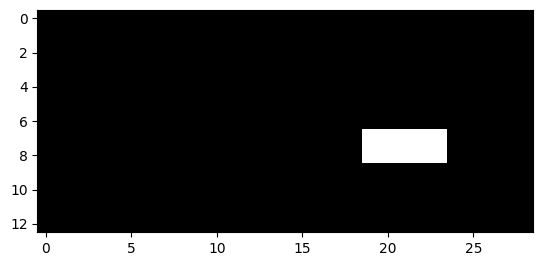

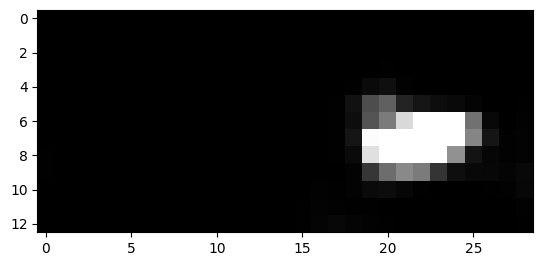

2129


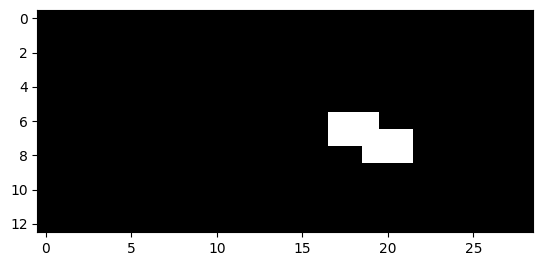

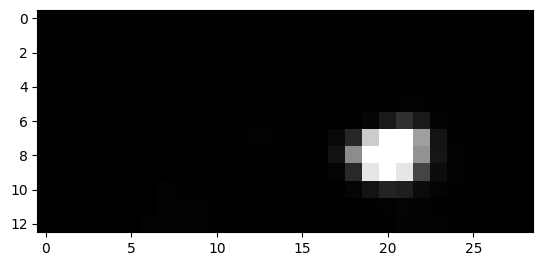

2130


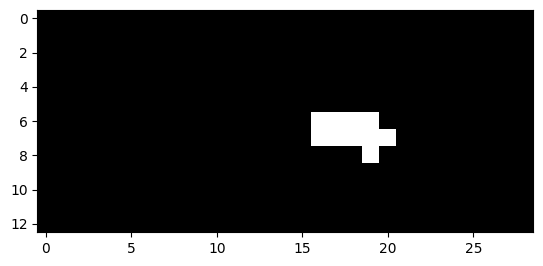

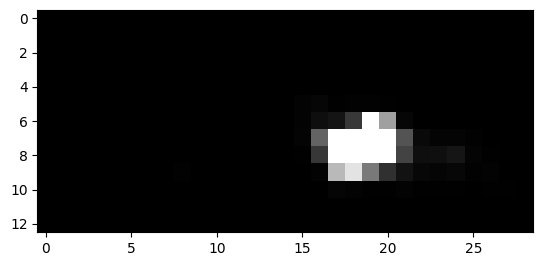

2131


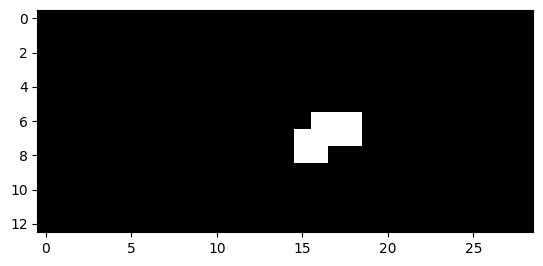

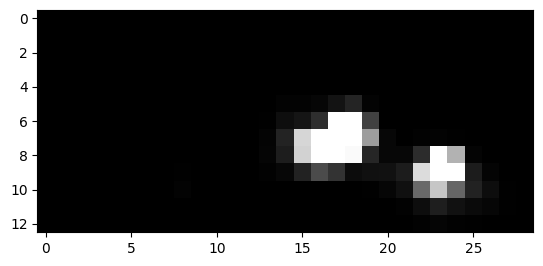

2132


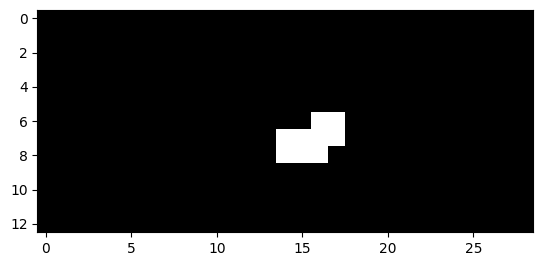

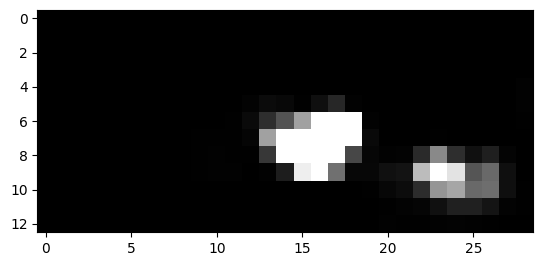

2133


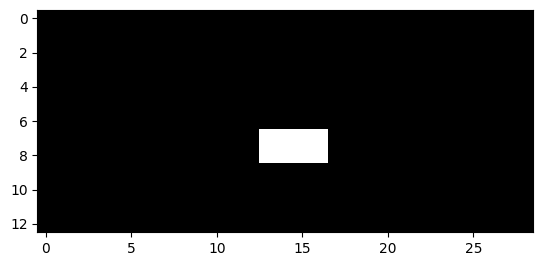

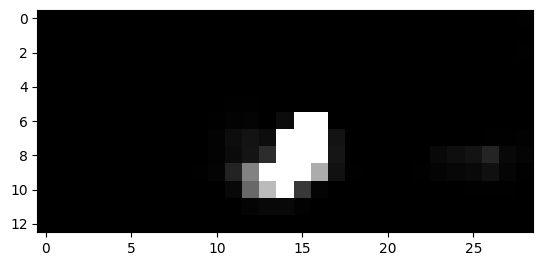

2134


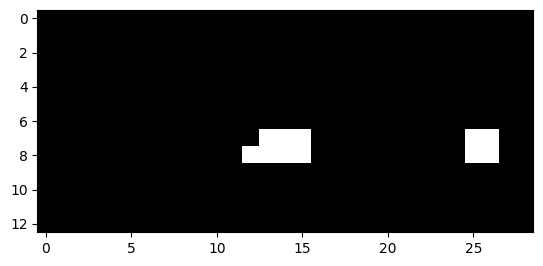

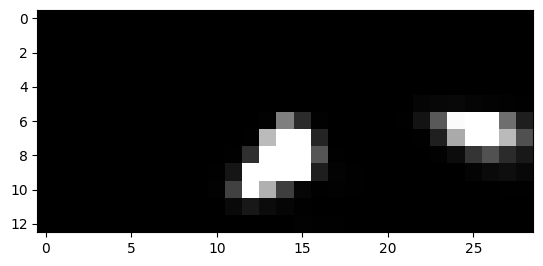

2135


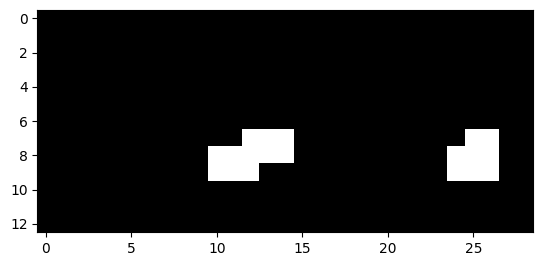

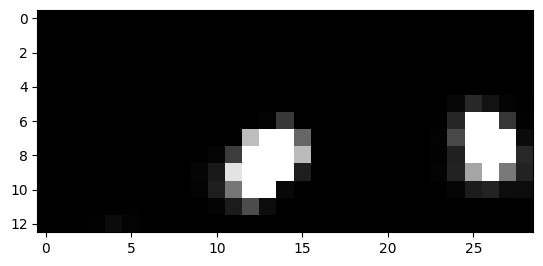

2136


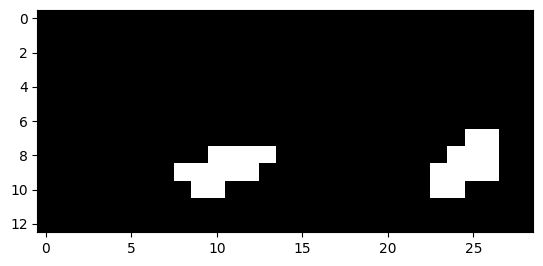

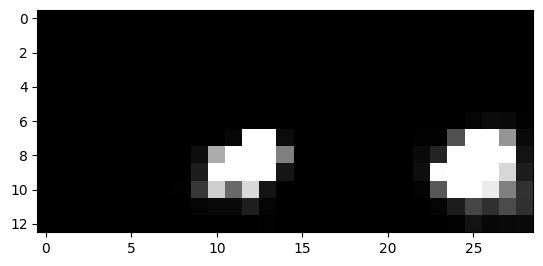

2137


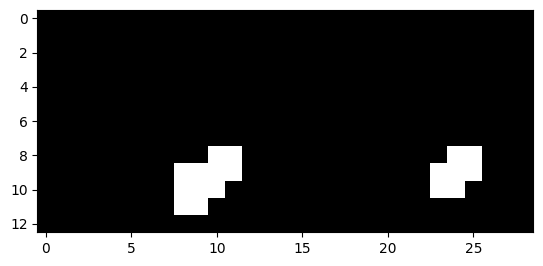

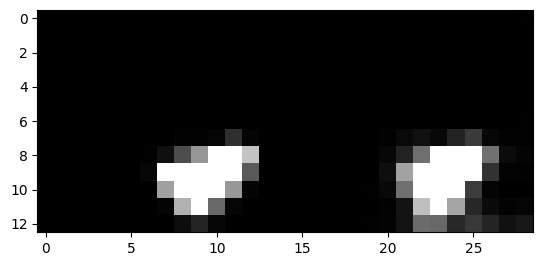

2138


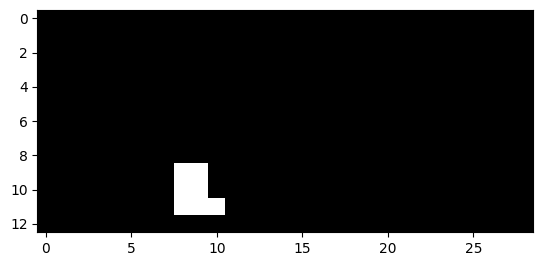

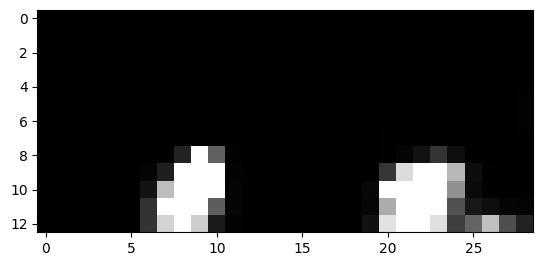

2139


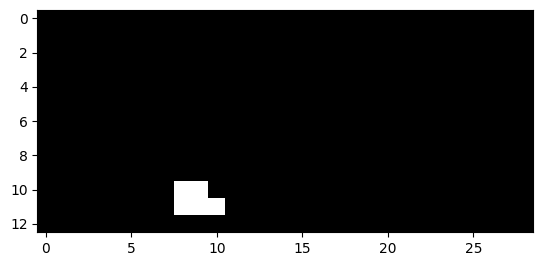

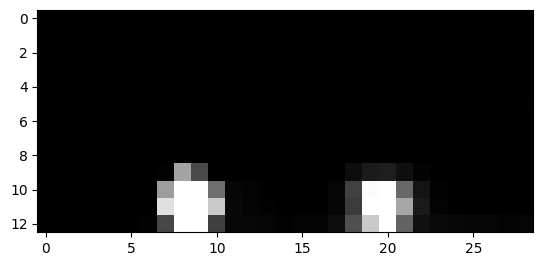

2143


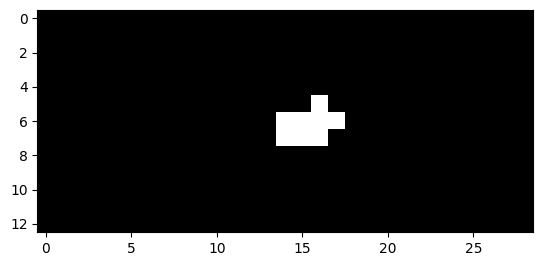

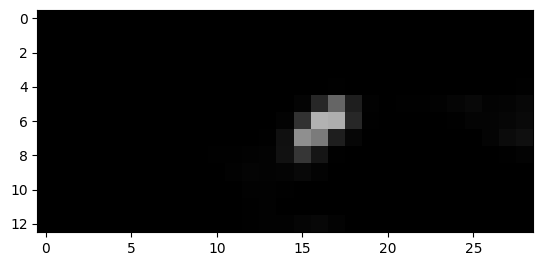

2144


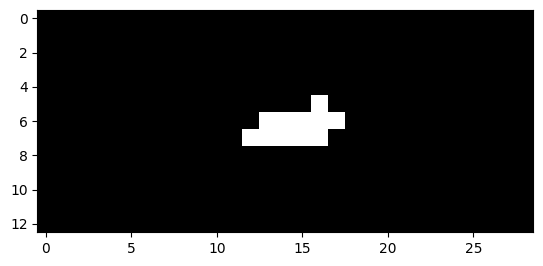

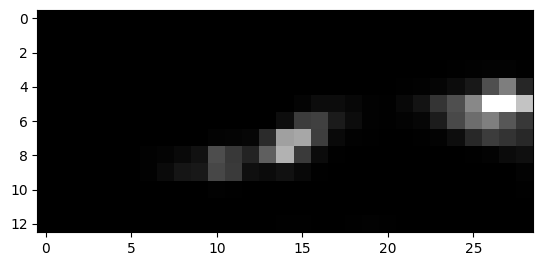

2145


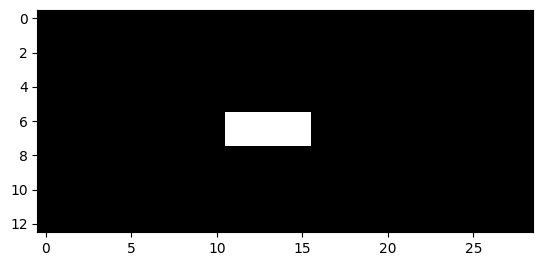

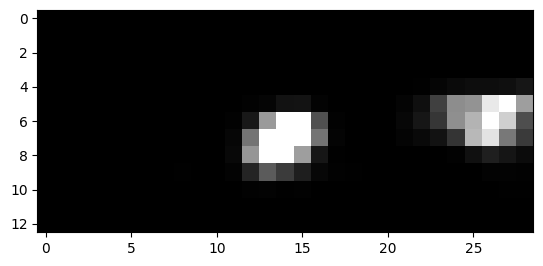

2146


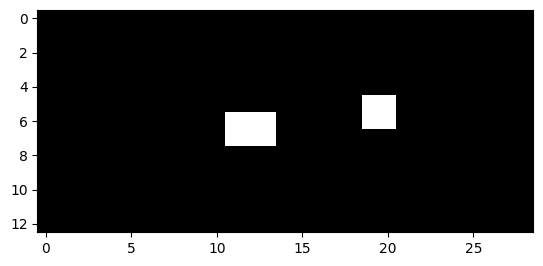

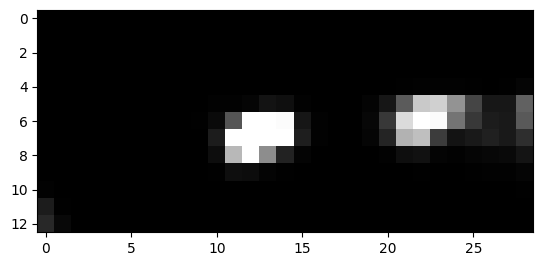

2147


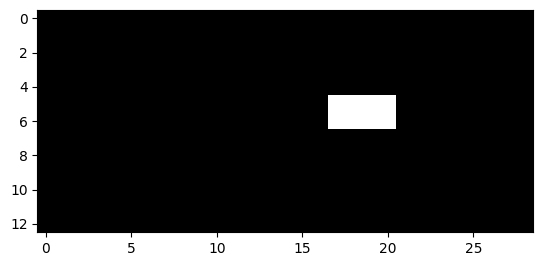

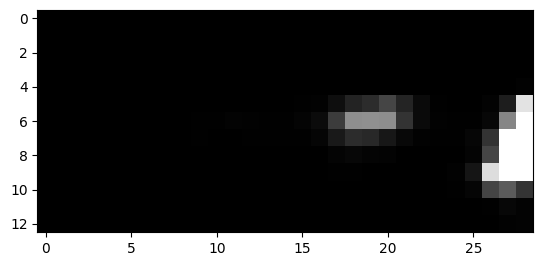

2148


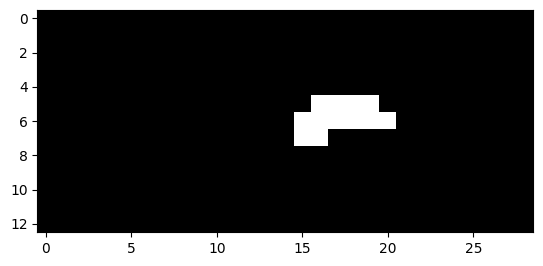

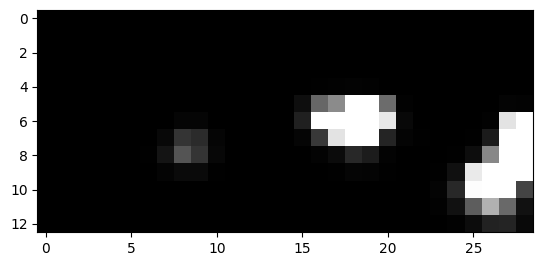

2149


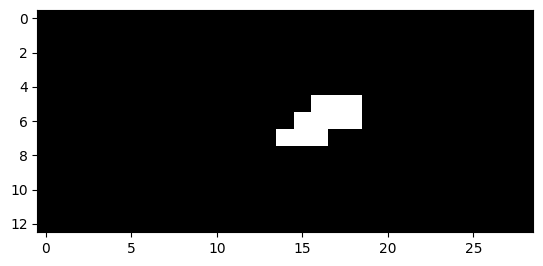

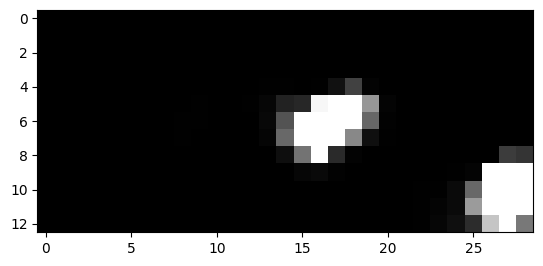

2150


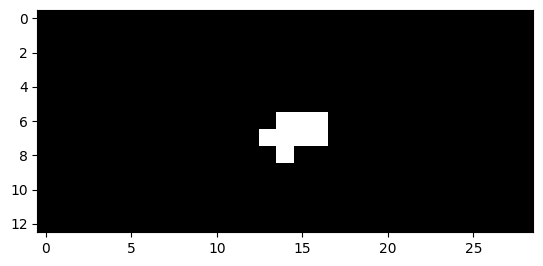

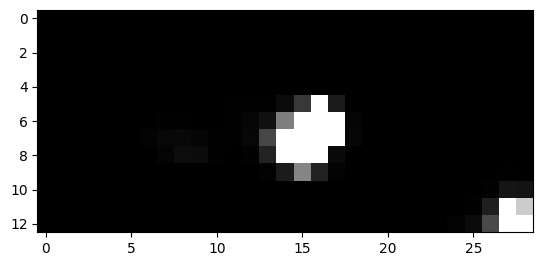

2151


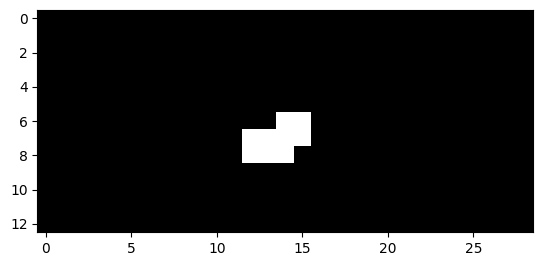

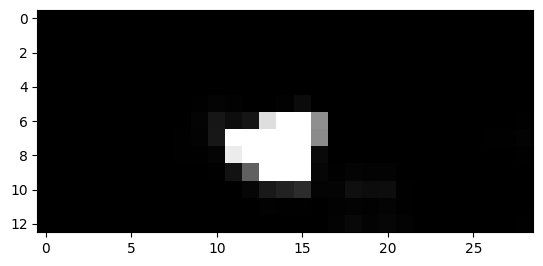

2152


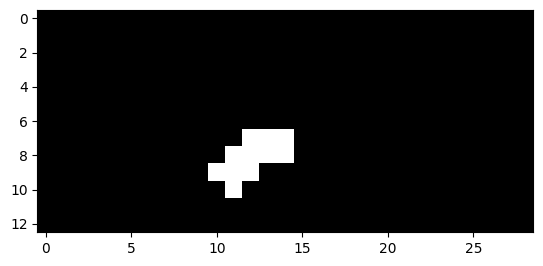

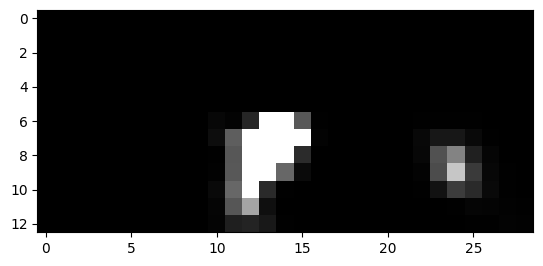

2153


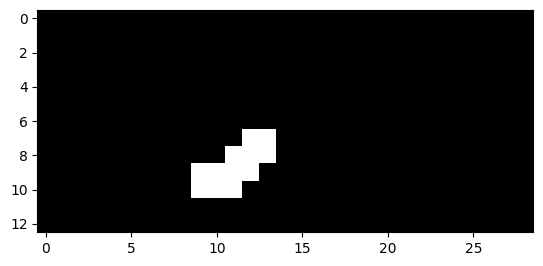

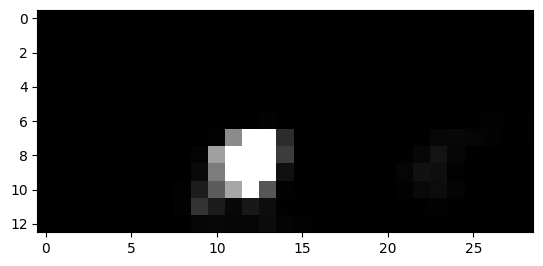

2154


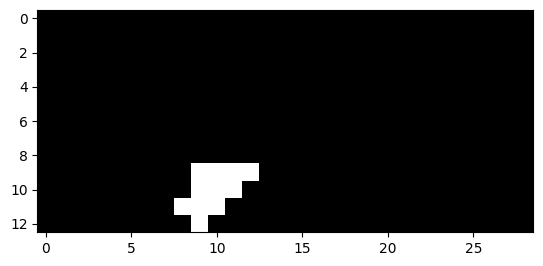

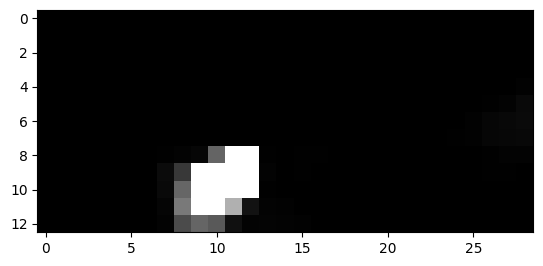

2155


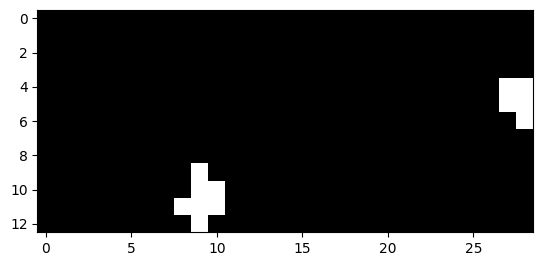

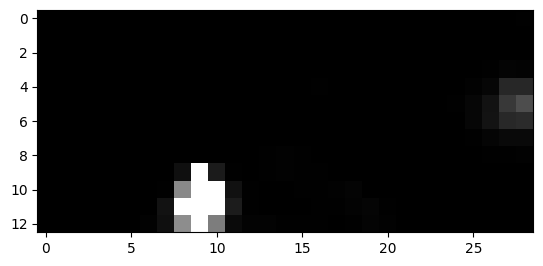

2156


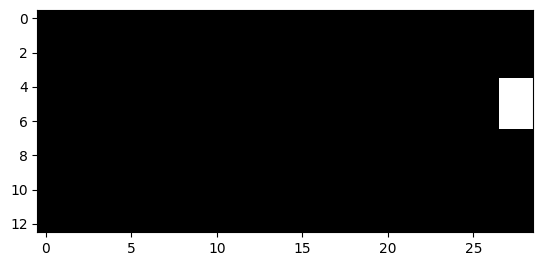

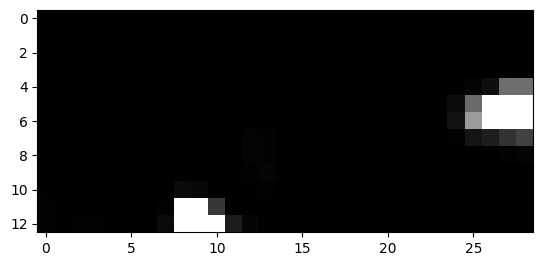

2157


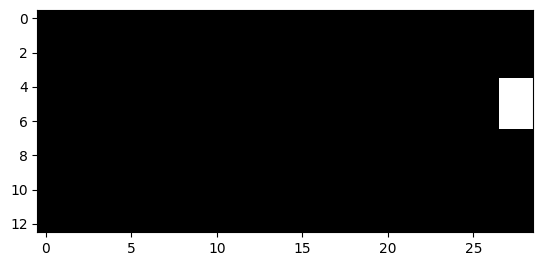

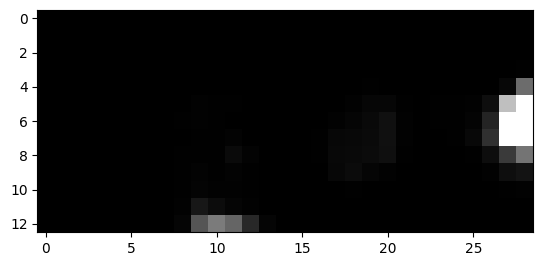

2166


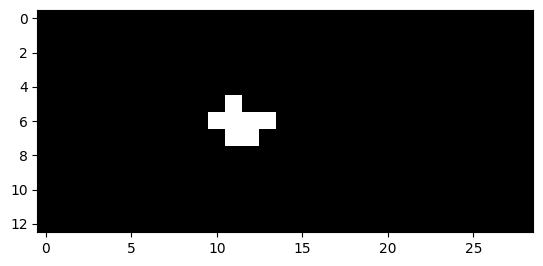

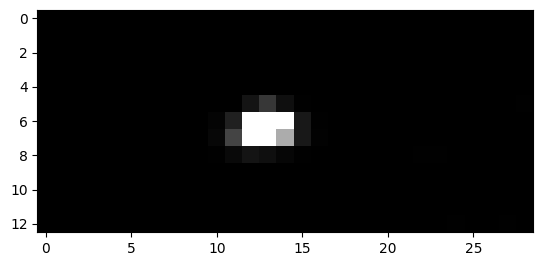

2167


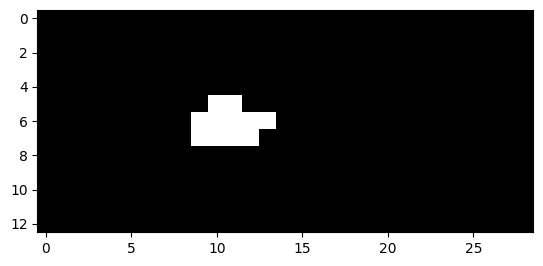

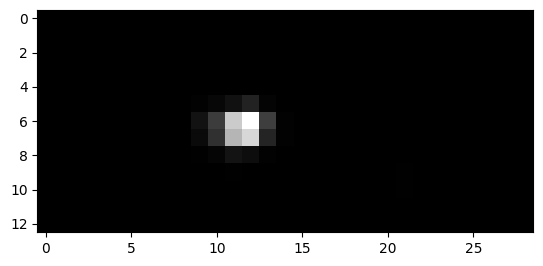

2168


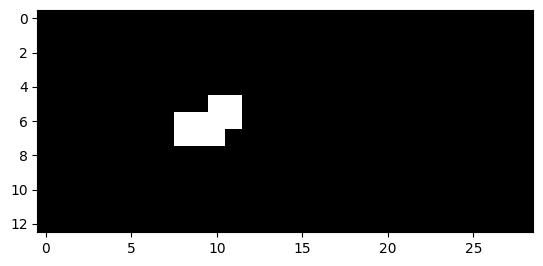

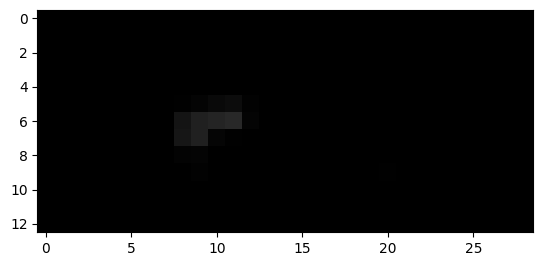

2169


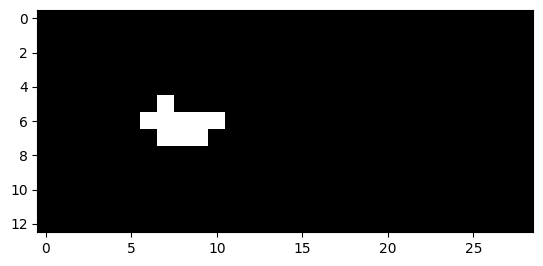

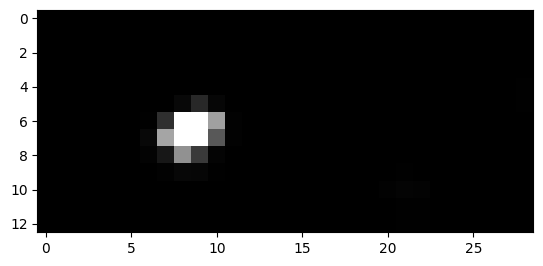

2170


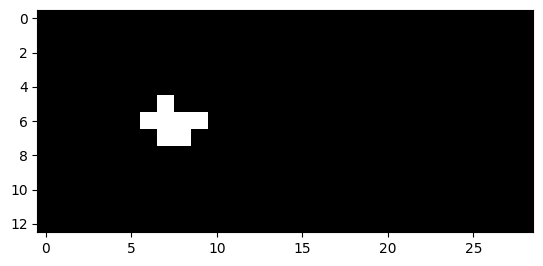

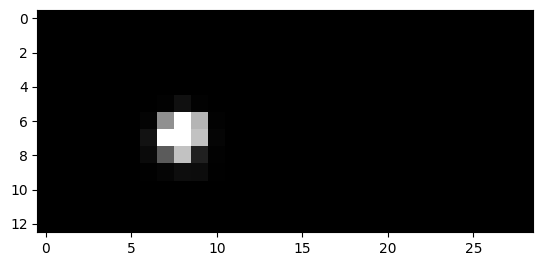

2171


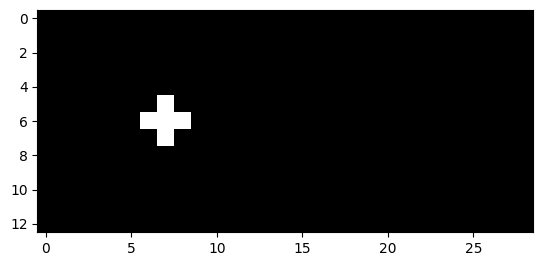

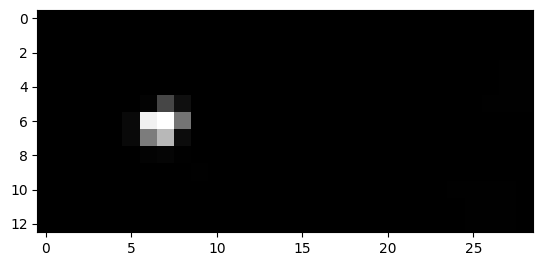

2174


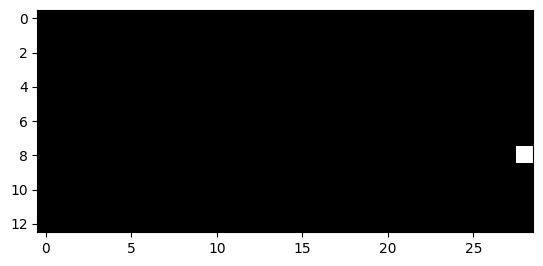

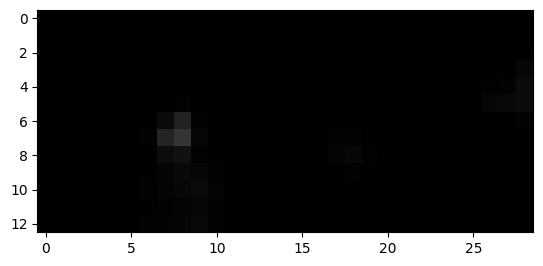

2175


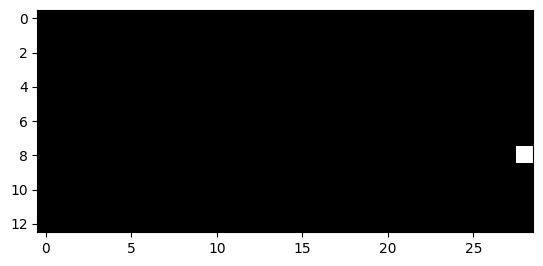

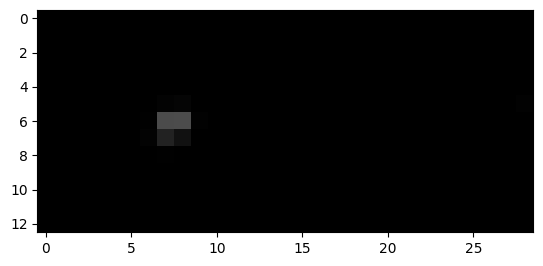

2181


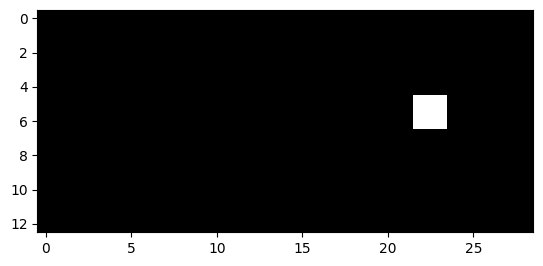

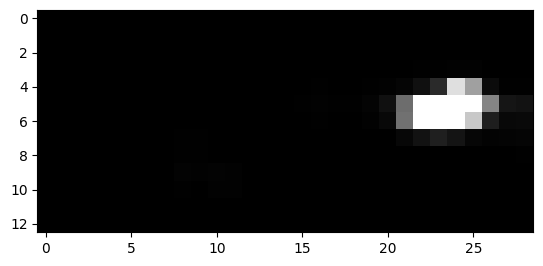

2182


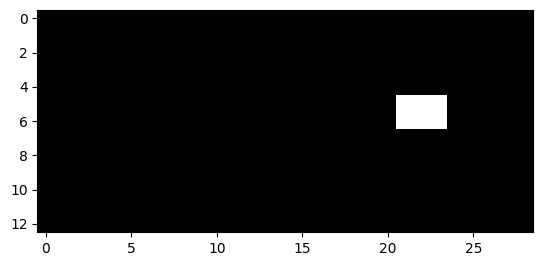

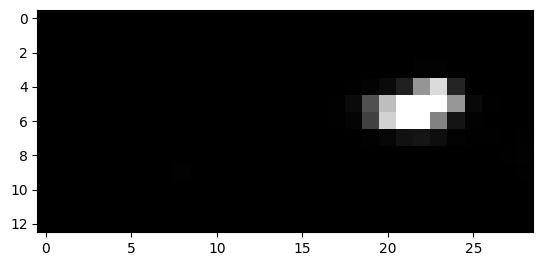

2183


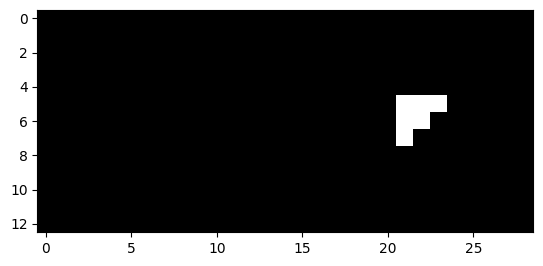

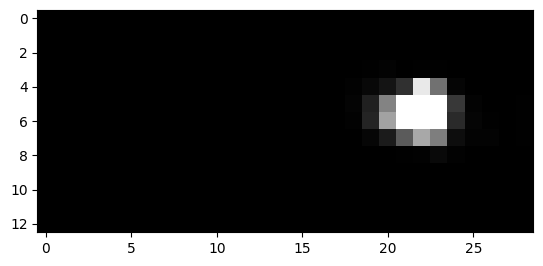

2184


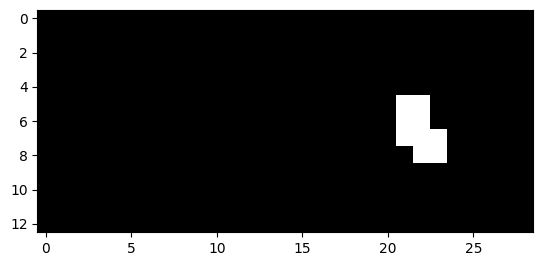

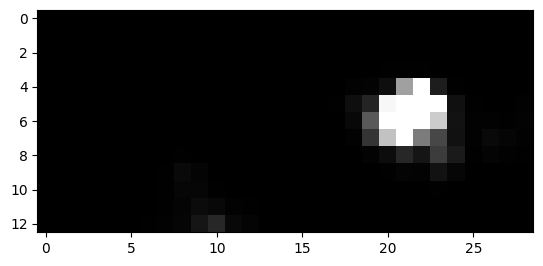

2185


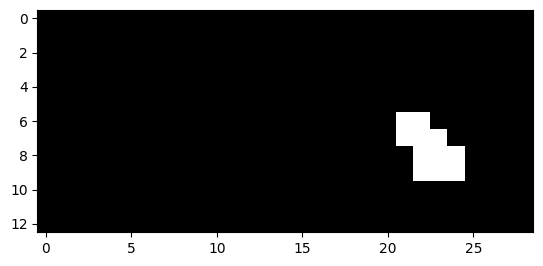

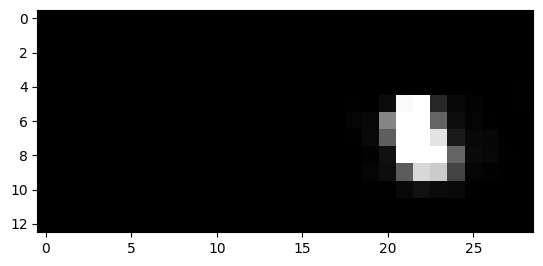

2186


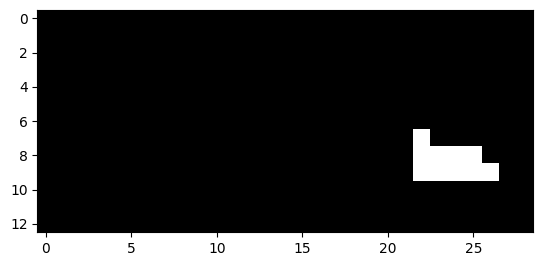

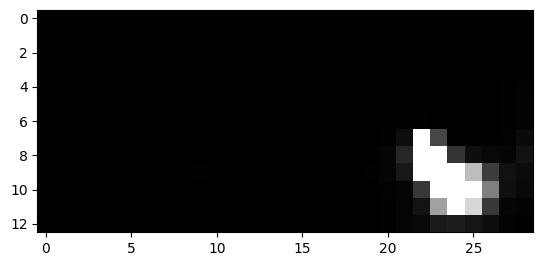

2187


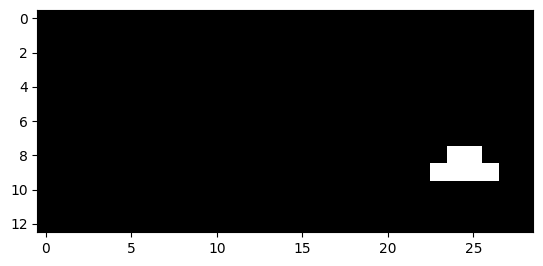

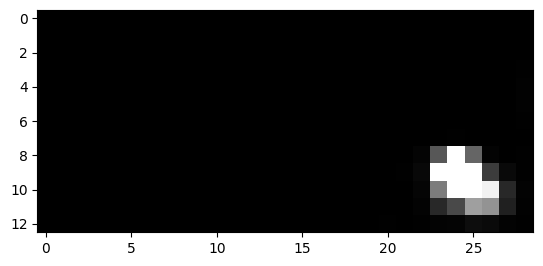

2188


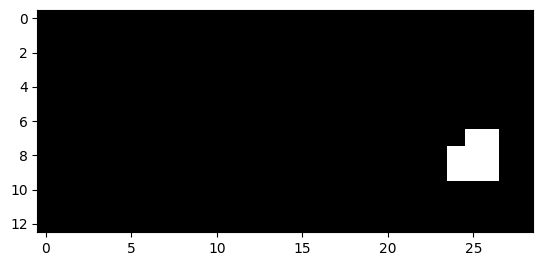

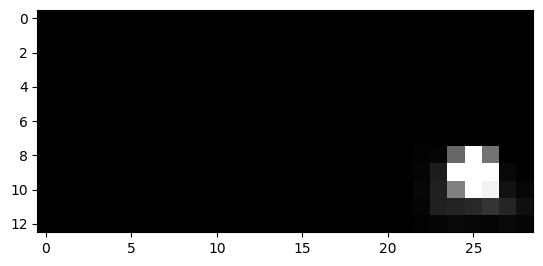

2189


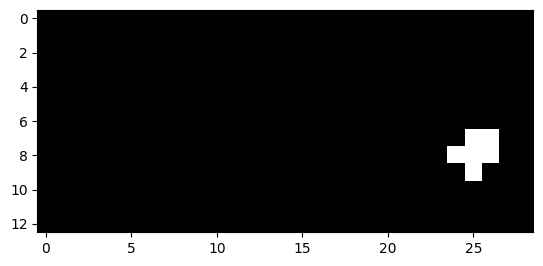

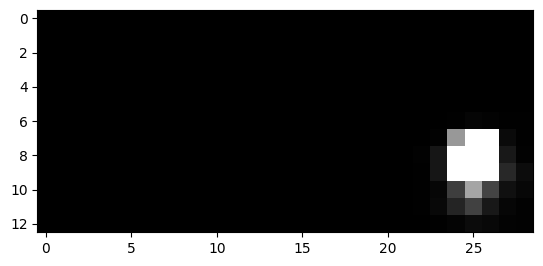

2190


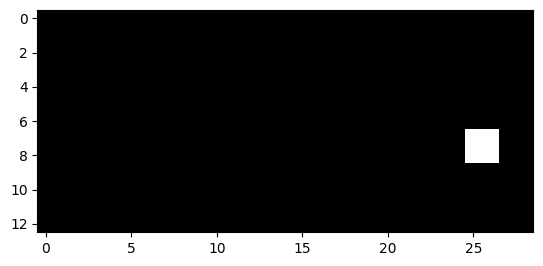

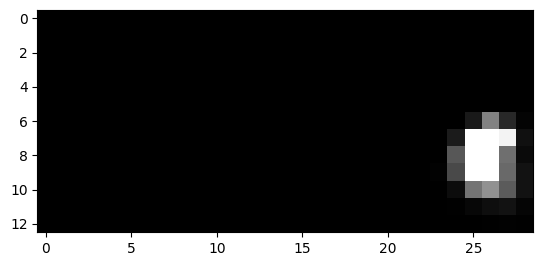

2191


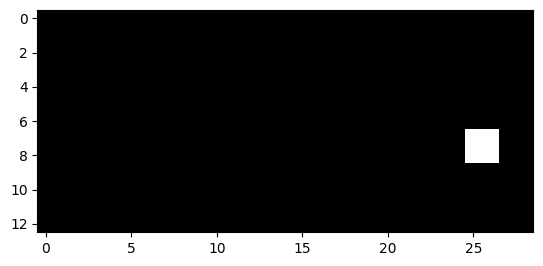

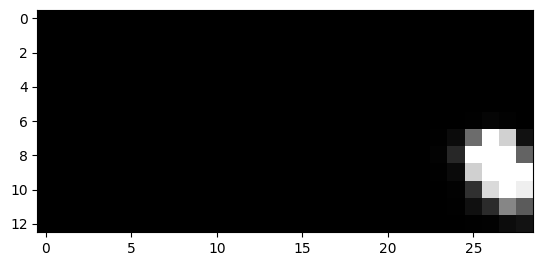

2214


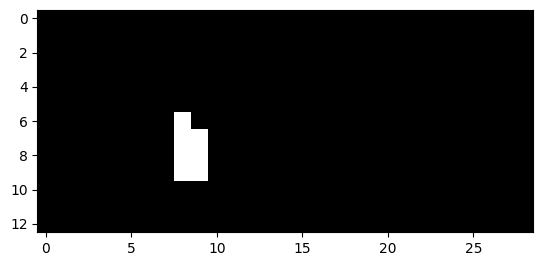

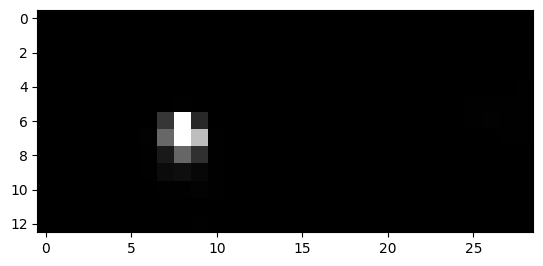

2215


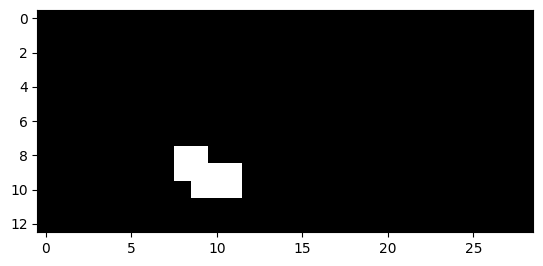

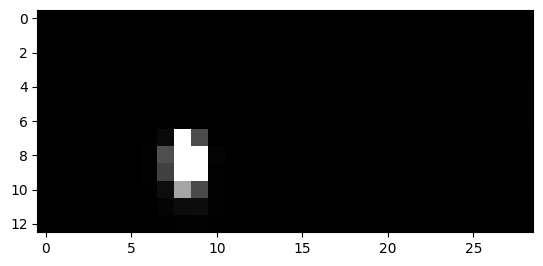

2216


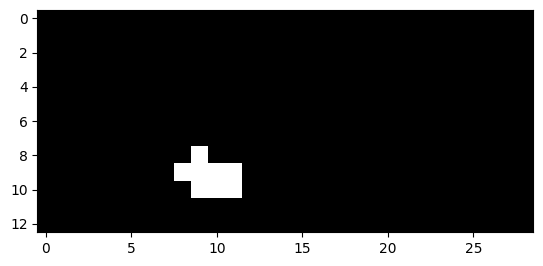

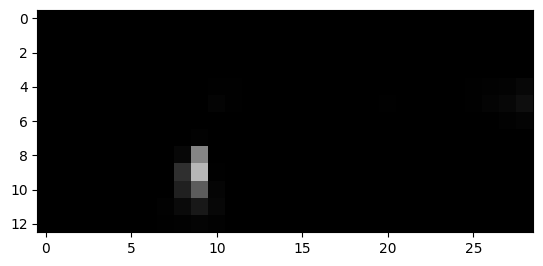

2226


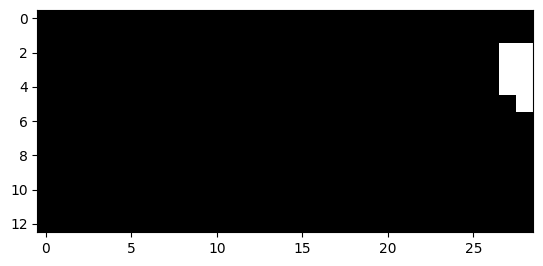

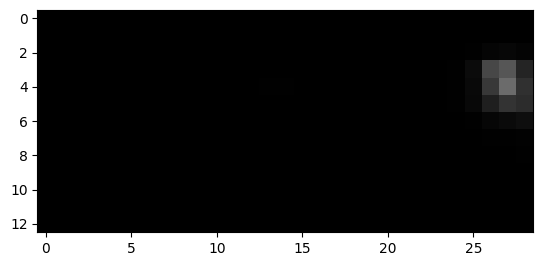

2227


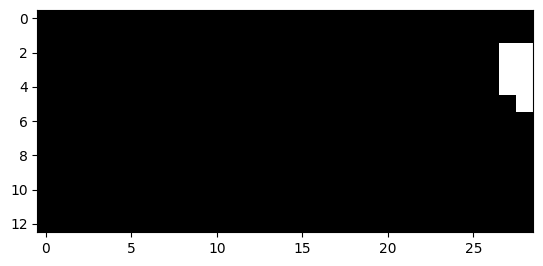

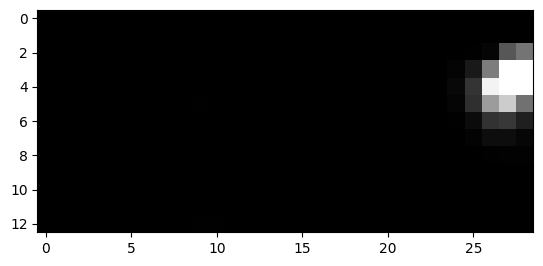

2228


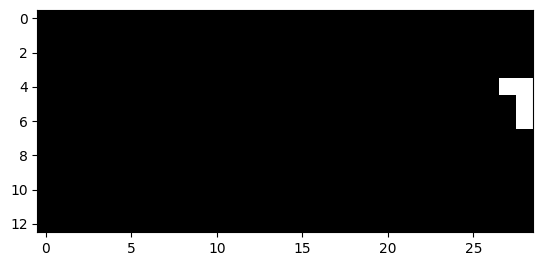

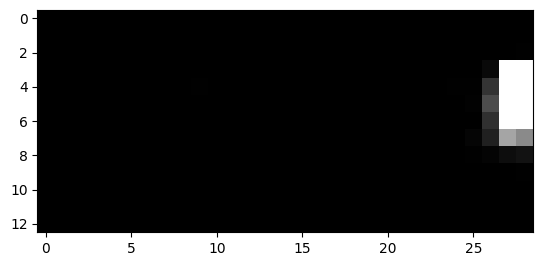

2229


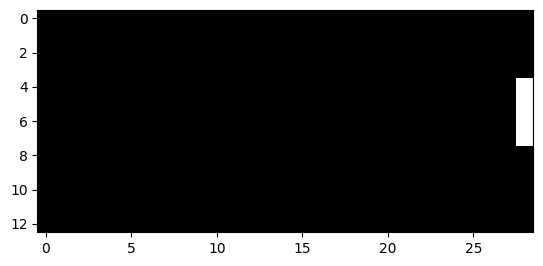

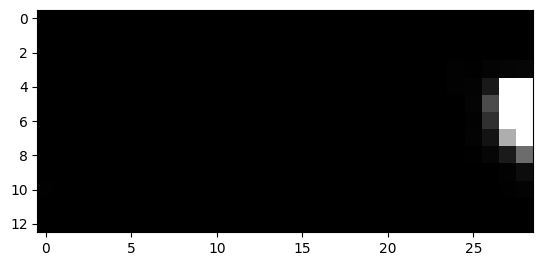

2230


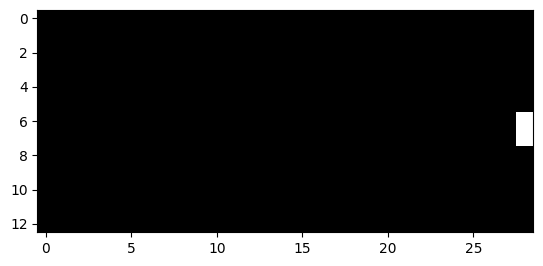

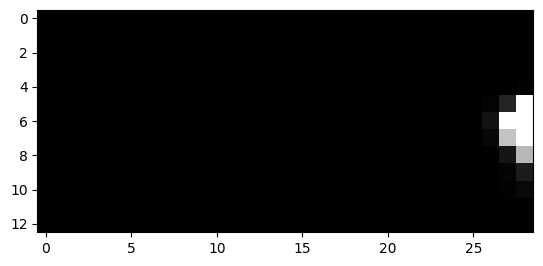

389


In [20]:
k=0
for i in range(len(y_test_img)): 
    if(np.max(y_test_img[i].reshape(-1))>0.1):
        print(i)
        plt.figure()
        plt.imshow(y_test_img[i], cmap = "gray", vmin=0, vmax=1)
        plt.show()
        plt.imshow(t[i], vmin=0, vmax=0.3, cmap = "gray")
        plt.show()
        k+=1
print(k)

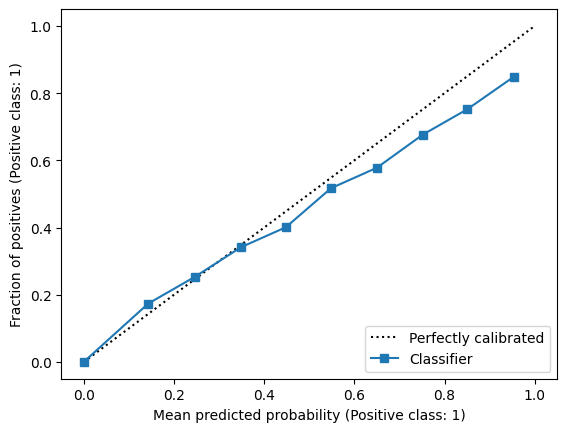

In [21]:
from sklearn.calibration import CalibrationDisplay

display = CalibrationDisplay.from_predictions(y_test_img.reshape(-1,1), t.reshape(-1,1), n_bins=10)


In [22]:
from sklearn.metrics import brier_score_loss
### brier score con probabilità predette

print(f'All zeros Brier score: {brier_score_loss(y_test_img.reshape(-1,1), np.zeros(len(y_test_img.reshape(-1,1))))}')
print(f'Model Brier score: {brier_score_loss(y_test_img.reshape(-1,1), t.reshape(-1,1))}')

All zeros Brier score: 0.0035259368257102965
Model Brier score: 0.0021137996094960487


In [21]:
test['predictions_lag0'] = t.reshape(-1,1)

In [22]:
test.to_csv("test_with_newTarget_predictions.csv")

## Lags

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_4 (Conv2D)           (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_1 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 14, 30, 1)         73        
                                                                 
 cropping2d_1 (Cropping2D)   (None, 13, 29, 1)        

2023-03-28 10:59:39.432091: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0454

2023-03-28 10:59:42.256314: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0454 - val_loss: 0.0165
Epoch 2/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0173 - val_loss: 0.0143
Epoch 3/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0154 - val_loss: 0.0126
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0144 - val_loss: 0.0128
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0137 - val_loss: 0.0118
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0134 - val_loss: 0.0118
Epoch 7/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0131 - val_loss: 0.0111
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0129 - val_loss: 0.0116
Epoch 9/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0127 - val_loss: 0.0111
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0126 - val_loss: 0.0111
E

2023-03-28 11:01:46.261696: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


78/78 [==============================] - 0s 2ms/step


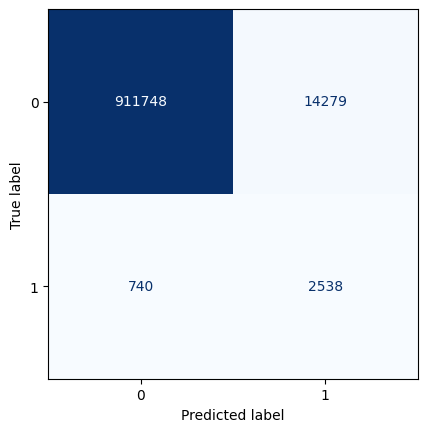

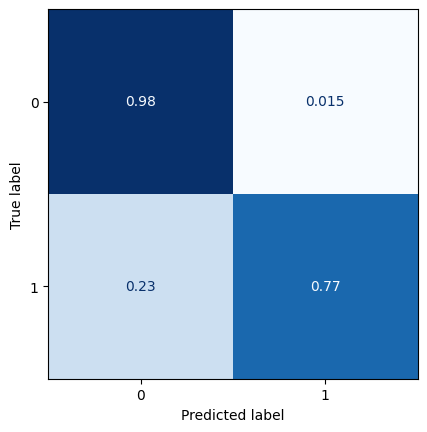

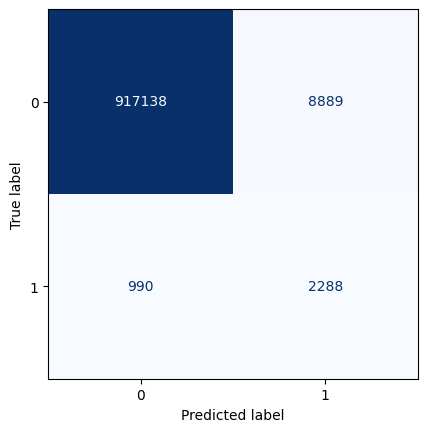

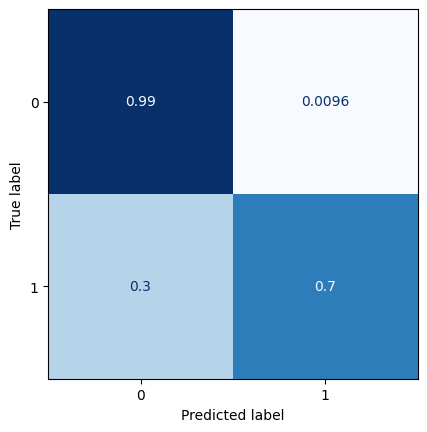

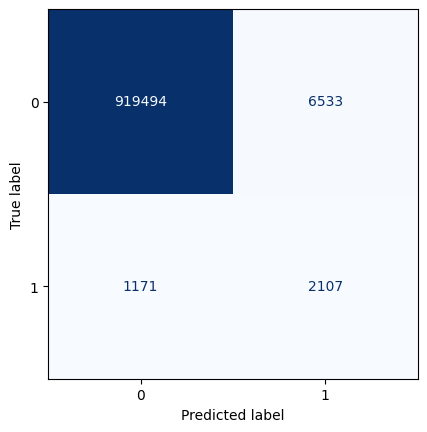

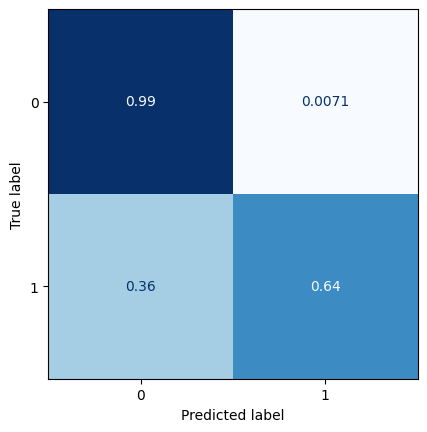

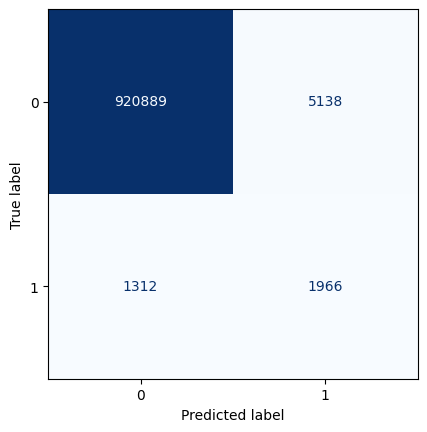

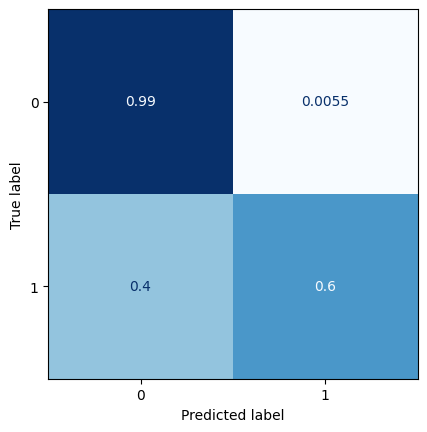

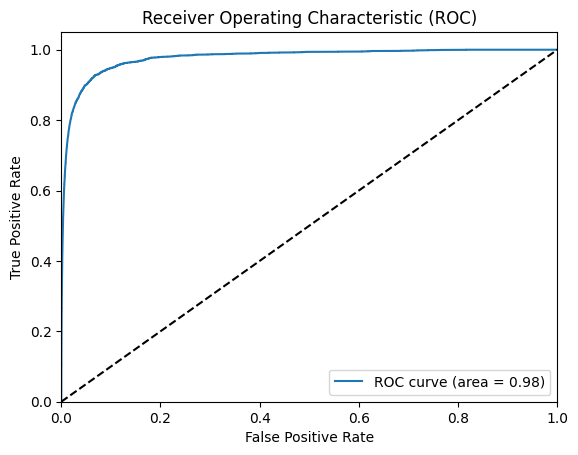

All zeros Brier score: 0.00352736722604527
Model Brier score: 0.002736149079277809
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_7 (Conv2D)           (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_2 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_8 (Conv2D)           (None, 14, 30, 1)         73        
                                     

2023-03-28 11:02:02.298032: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.1122 - val_loss: 0.0237


2023-03-28 11:02:05.025261: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


Epoch 2/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0234 - val_loss: 0.0191
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0206 - val_loss: 0.0176
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0195 - val_loss: 0.0175
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0189 - val_loss: 0.0169
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0185 - val_loss: 0.0165
Epoch 7/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0181 - val_loss: 0.0165
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0177 - val_loss: 0.0157
Epoch 9/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0173 - val_loss: 0.0158
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0170 - val_loss: 0.0154
Epoch 11/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0167 - val_l

2023-03-28 11:05:55.954056: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


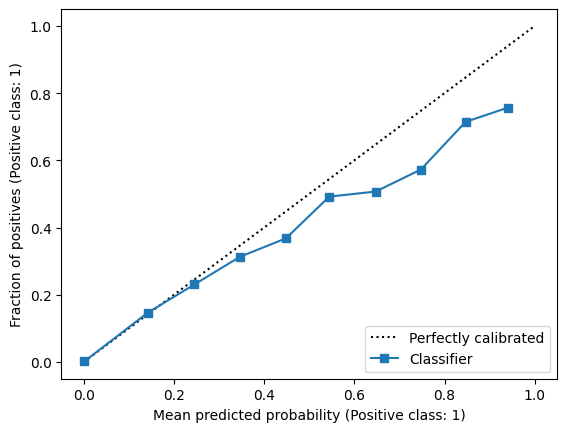

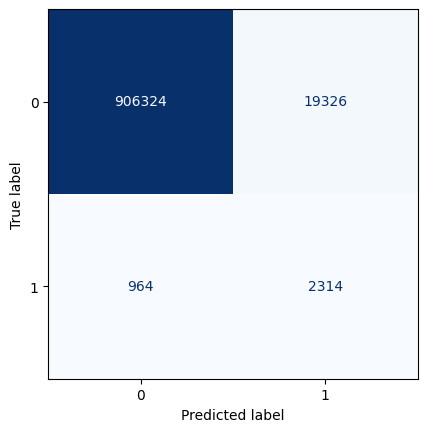

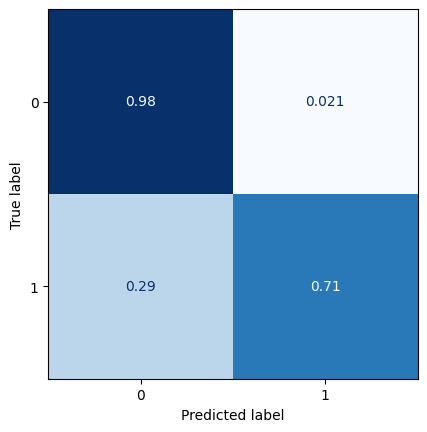

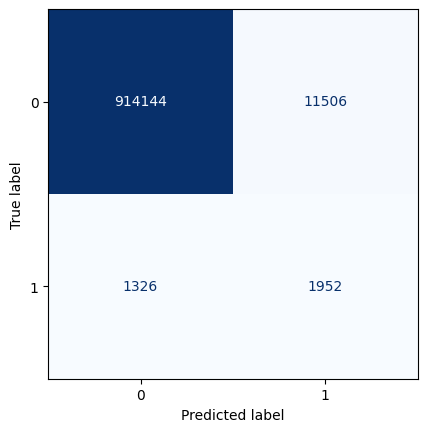

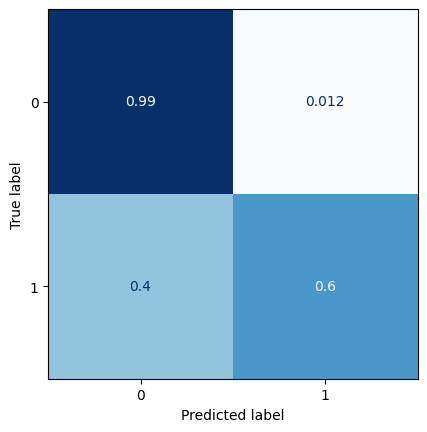

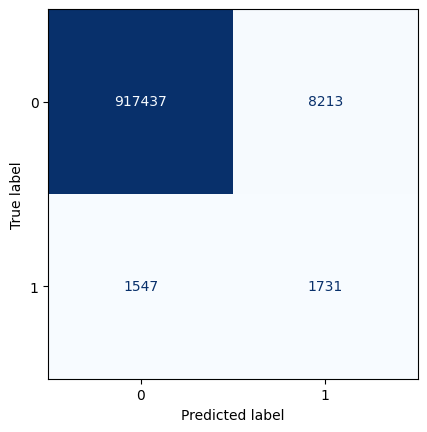

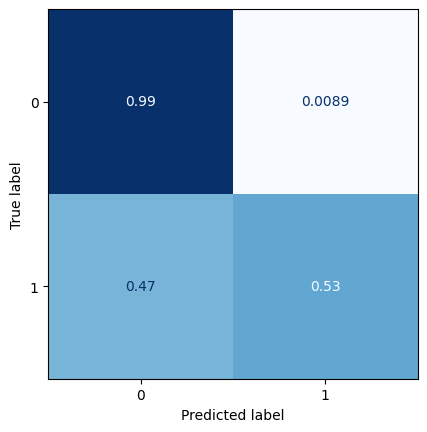

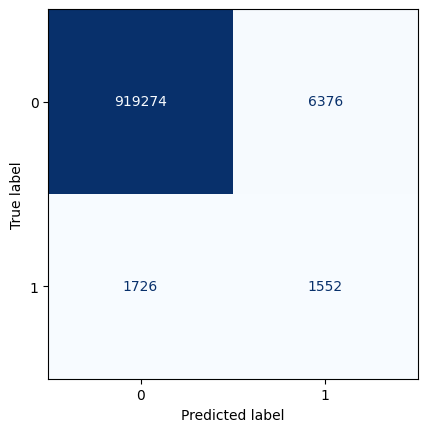

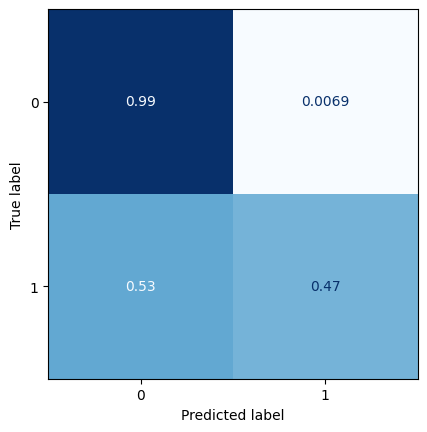

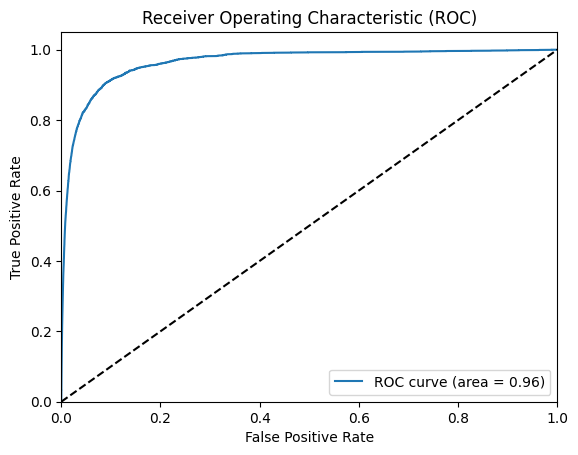

All zeros Brier score: 0.003528798787419477
Model Brier score: 0.0031380999744746304
Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_9 (Conv2D)           (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_10 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_3 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_11 (Conv2D)          (None, 14, 30, 1)         73        
                                   

2023-03-28 11:06:13.081715: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0924

2023-03-28 11:06:15.862402: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0924 - val_loss: 0.0228
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0242 - val_loss: 0.0203
Epoch 3/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0216 - val_loss: 0.0187
Epoch 4/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0203 - val_loss: 0.0183
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0196 - val_loss: 0.0176
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0192 - val_loss: 0.0176
Epoch 7/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0188 - val_loss: 0.0172
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0185 - val_loss: 0.0172
Epoch 9/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0184 - val_loss: 0.0174
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0182 - val_loss: 0.0168
E

2023-03-28 11:07:55.162788: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


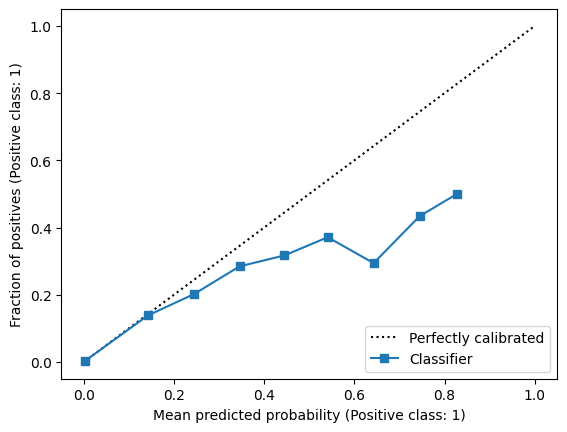

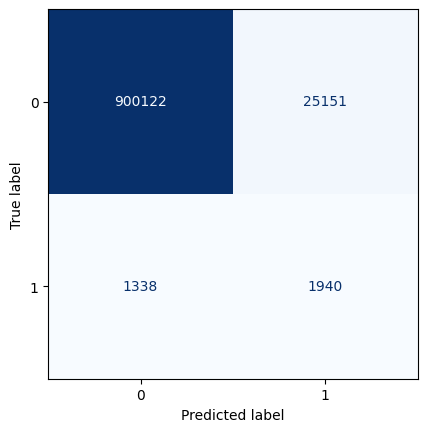

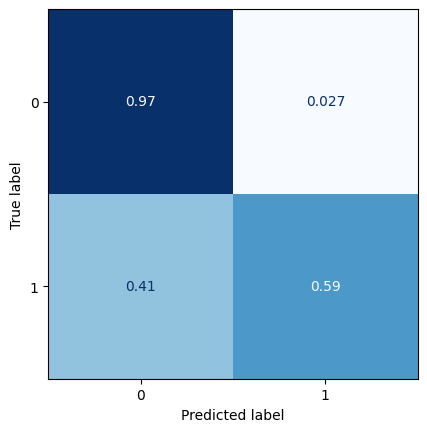

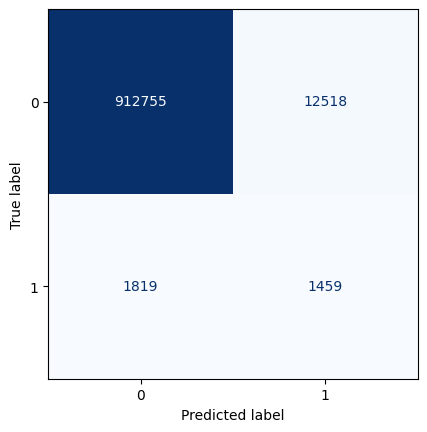

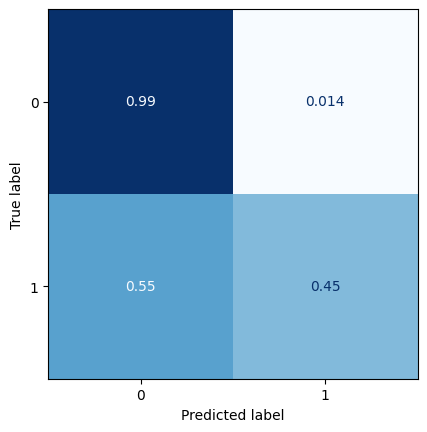

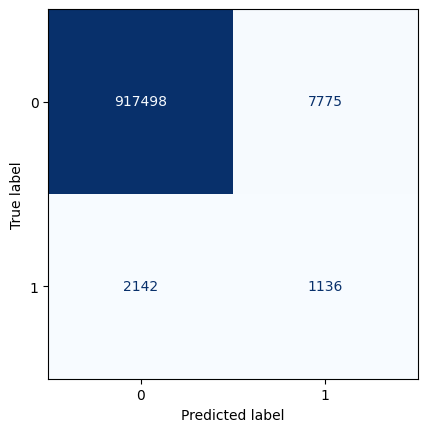

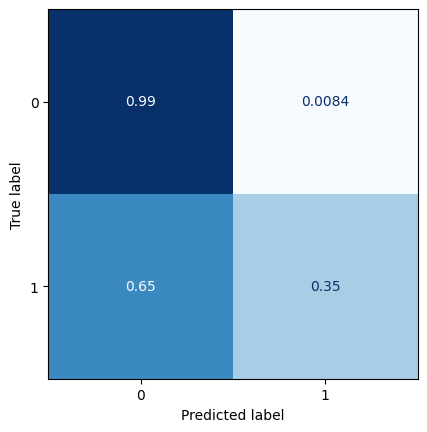

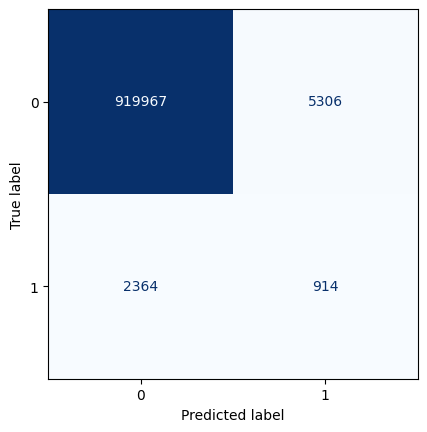

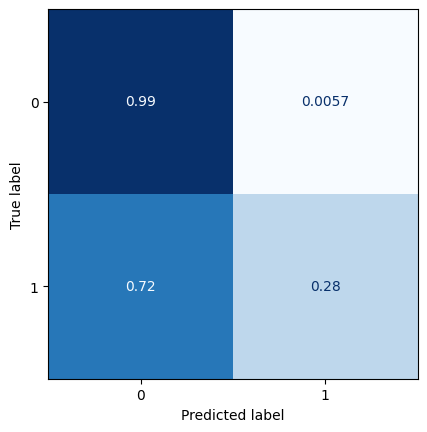

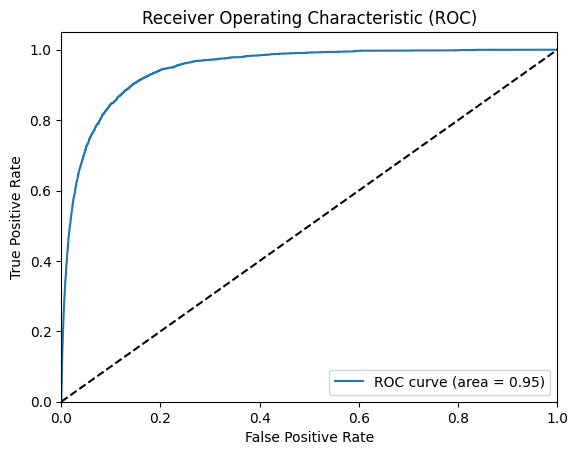

All zeros Brier score: 0.0035302315112470937
Model Brier score: 0.003340098371057907
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_12 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_13 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_4 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_14 (Conv2D)          (None, 14, 30, 1)         73        
                                   

2023-03-28 11:08:12.666334: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0430

2023-03-28 11:08:15.458858: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0430 - val_loss: 0.0211
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0223 - val_loss: 0.0198
Epoch 3/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0211 - val_loss: 0.0190
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0206 - val_loss: 0.0189
Epoch 5/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0202 - val_loss: 0.0185
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0200 - val_loss: 0.0186
Epoch 7/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0198 - val_loss: 0.0183
Epoch 8/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0196 - val_loss: 0.0179
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0194 - val_loss: 0.0183
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0193 - val_loss: 0.0180
E

2023-03-28 11:10:23.722777: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


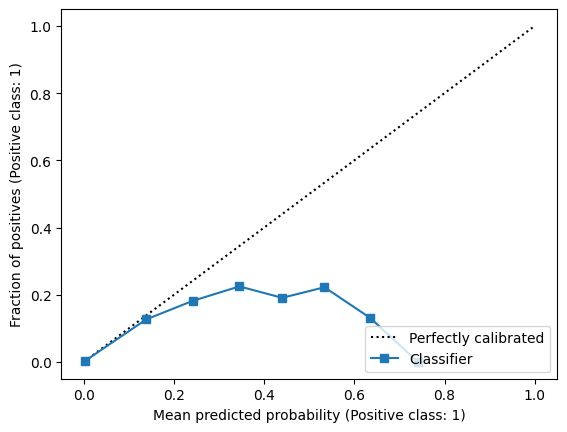

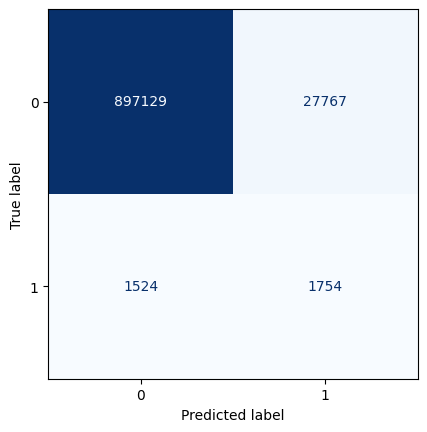

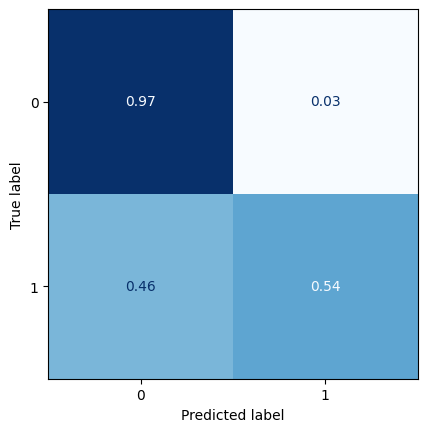

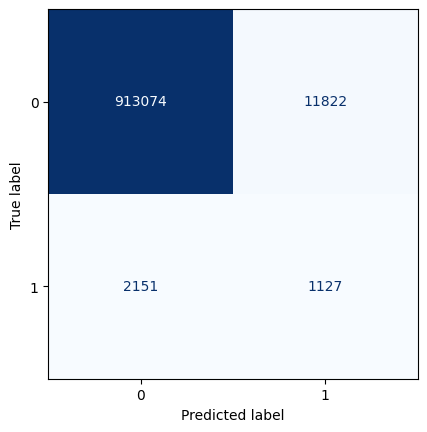

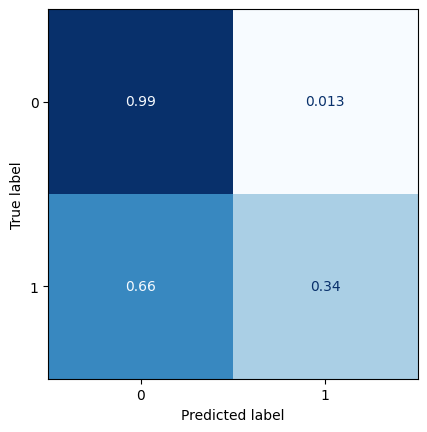

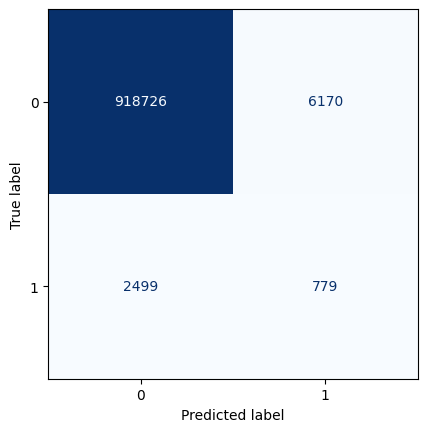

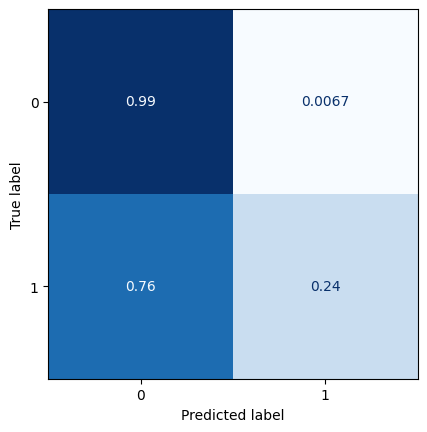

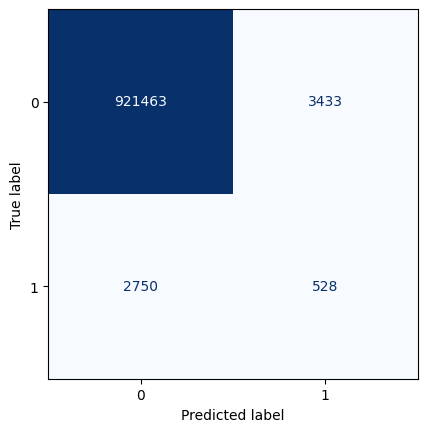

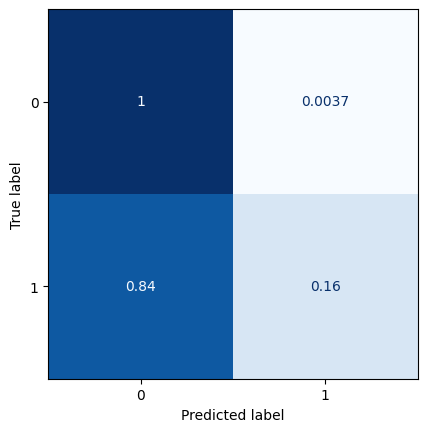

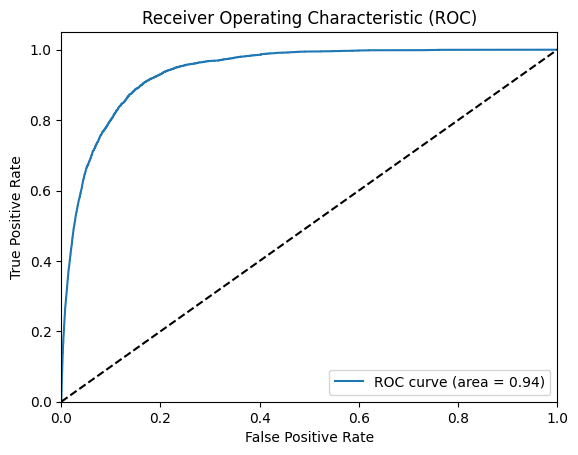

All zeros Brier score: 0.0035316653989445946
Model Brier score: 0.003369550319754776
Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_15 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_16 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_5 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_17 (Conv2D)          (None, 14, 30, 1)         73        
                                   

2023-03-28 11:10:41.885585: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0708

2023-03-28 11:10:44.657780: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0708 - val_loss: 0.0229
Epoch 2/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0242 - val_loss: 0.0207
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0225 - val_loss: 0.0200
Epoch 4/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0218 - val_loss: 0.0195
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0214 - val_loss: 0.0190
Epoch 6/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0211 - val_loss: 0.0192
Epoch 7/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0208 - val_loss: 0.0188
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0207 - val_loss: 0.0186
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0205 - val_loss: 0.0190
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0204 - val_loss: 0.0191
E

2023-03-28 11:13:03.427060: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


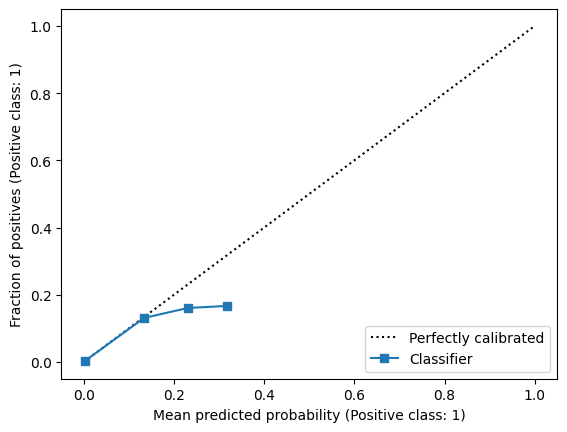

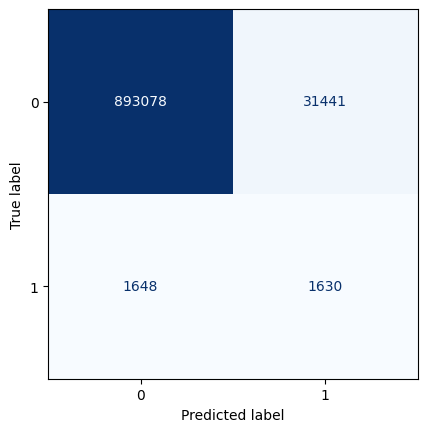

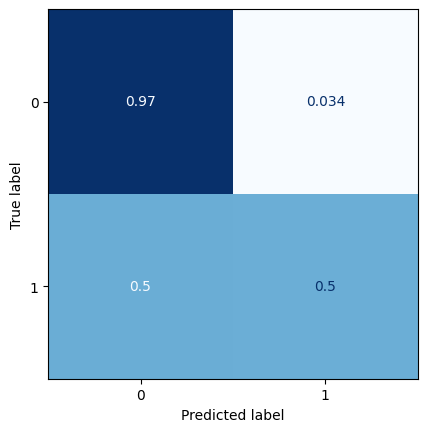

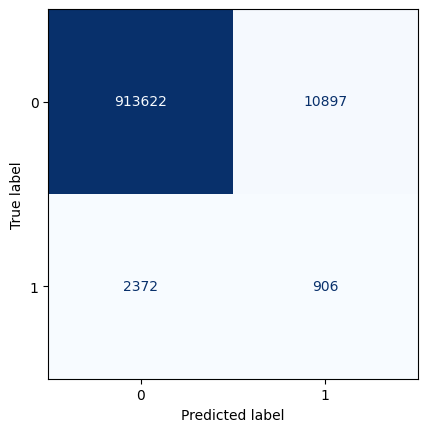

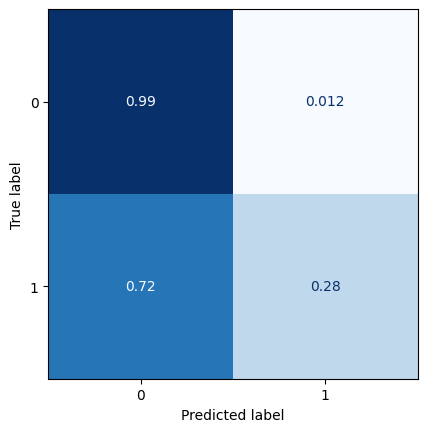

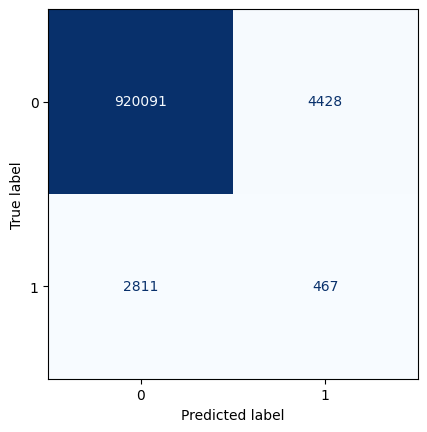

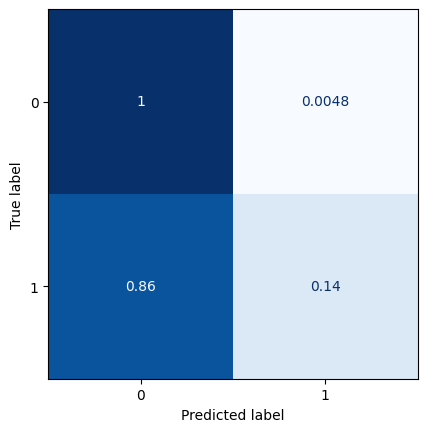

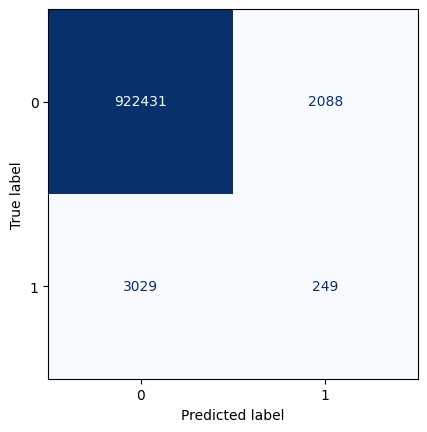

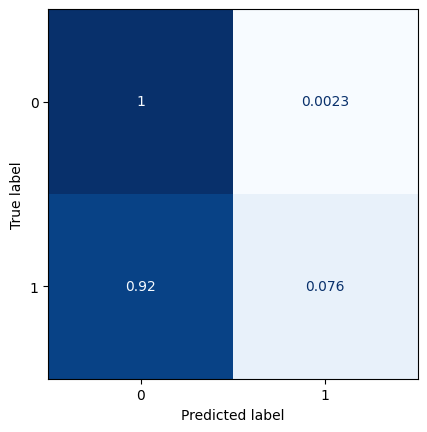

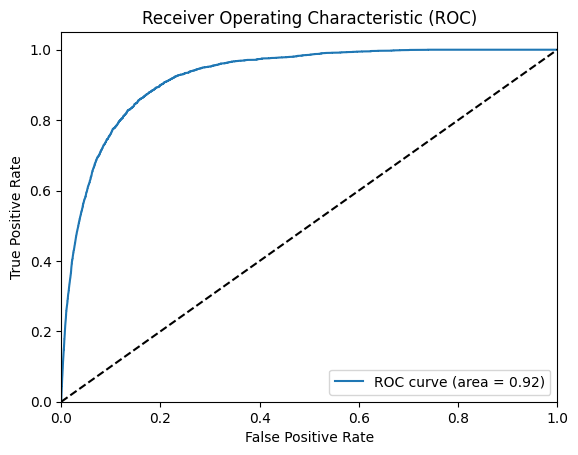

All zeros Brier score: 0.0035331004519307562
Model Brier score: 0.003414690807235763
Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_18 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_19 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_6 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_20 (Conv2D)          (None, 14, 30, 1)         73        
                                   

2023-03-28 11:13:22.381228: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0669

2023-03-28 11:13:25.135576: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0669 - val_loss: 0.0231
Epoch 2/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0246 - val_loss: 0.0209
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0230 - val_loss: 0.0203
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0222 - val_loss: 0.0197
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0218 - val_loss: 0.0196
Epoch 6/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0215 - val_loss: 0.0192
Epoch 7/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0212 - val_loss: 0.0191
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0211 - val_loss: 0.0196
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0209 - val_loss: 0.0196
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0208 - val_loss: 0.0193
E

2023-03-28 11:15:41.788530: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


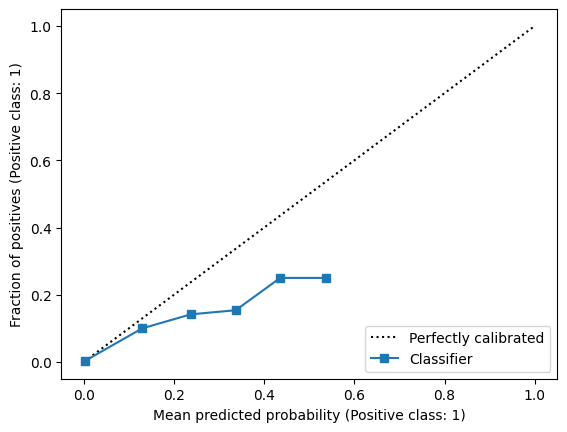

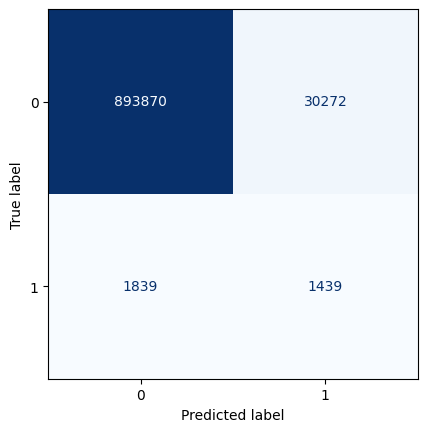

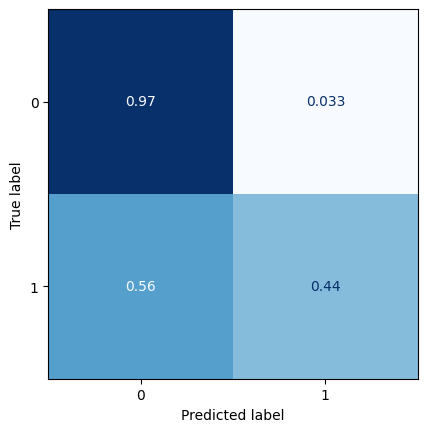

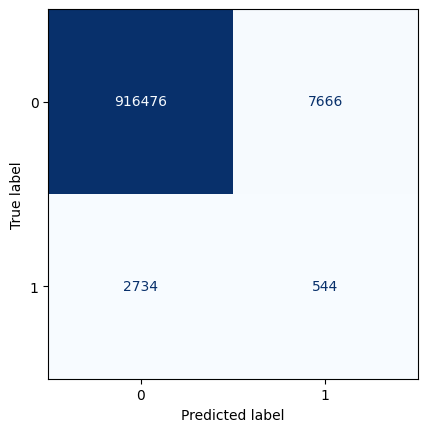

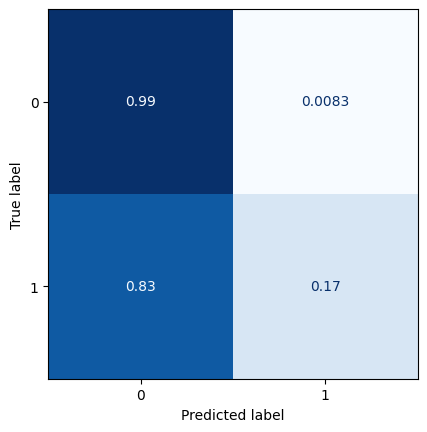

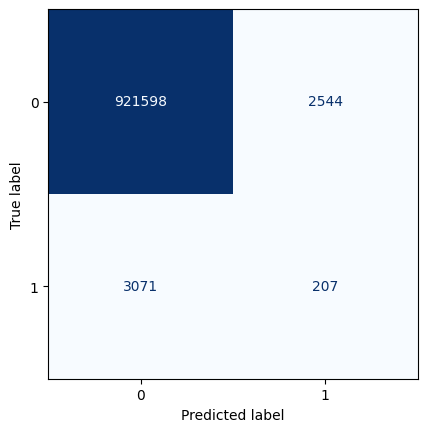

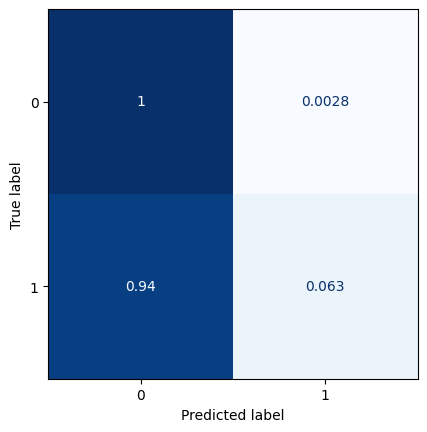

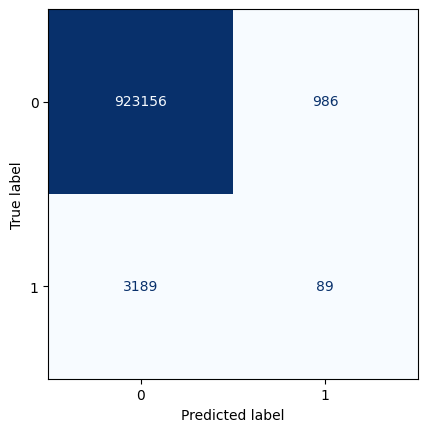

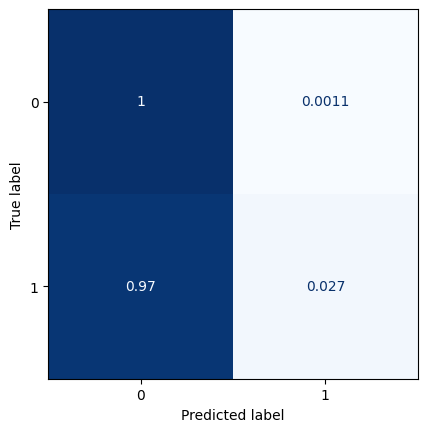

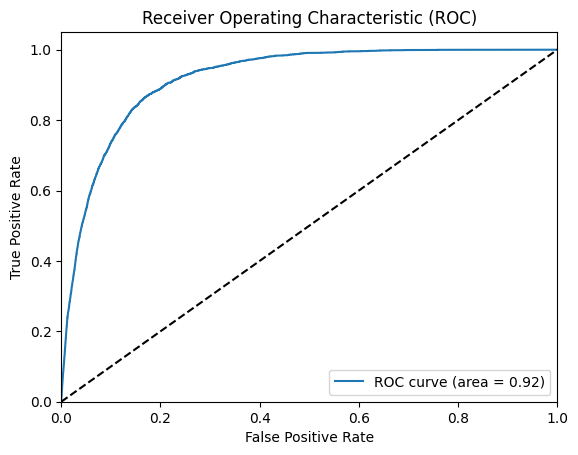

All zeros Brier score: 0.003534536671626663
Model Brier score: 0.003440155557271136
Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_21 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_22 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_7 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_23 (Conv2D)          (None, 14, 30, 1)         73        
                                    

2023-03-28 11:16:01.284930: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.1477

2023-03-28 11:16:04.007383: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.1477 - val_loss: 0.0267
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0278 - val_loss: 0.0232
Epoch 3/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0253 - val_loss: 0.0220
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0241 - val_loss: 0.0213
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0232 - val_loss: 0.0205
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0225 - val_loss: 0.0202
Epoch 7/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0220 - val_loss: 0.0200
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0217 - val_loss: 0.0199
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0215 - val_loss: 0.0195
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0214 - val_loss: 0.0194
E

2023-03-28 11:17:52.256299: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 2ms/step


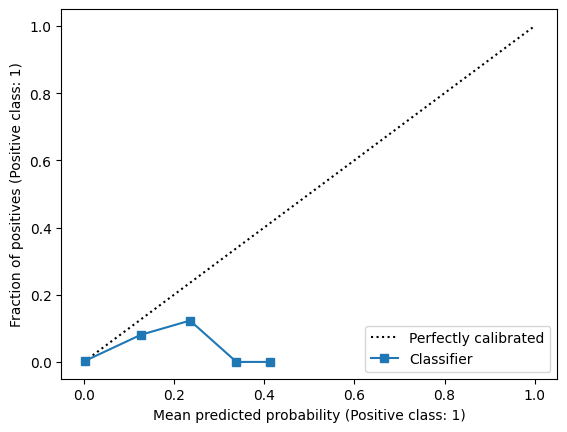

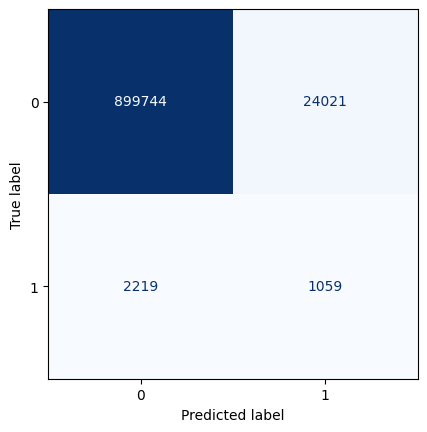

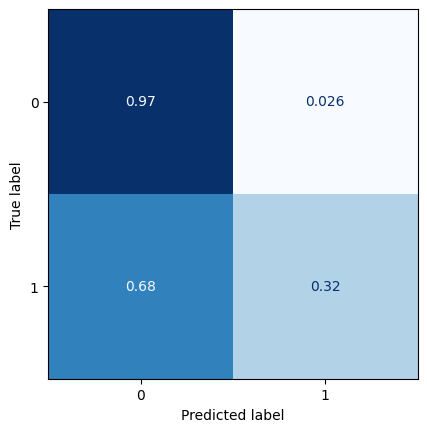

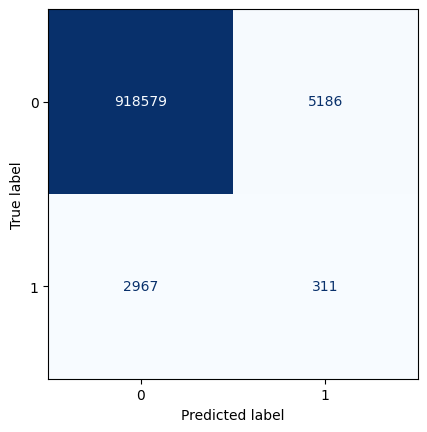

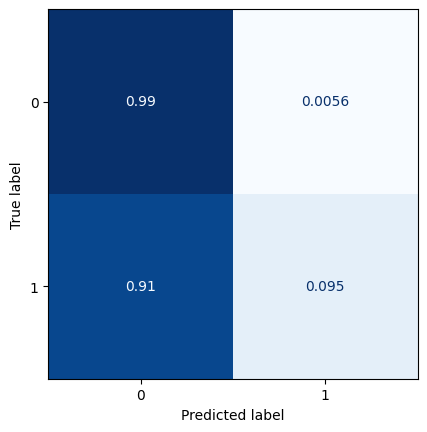

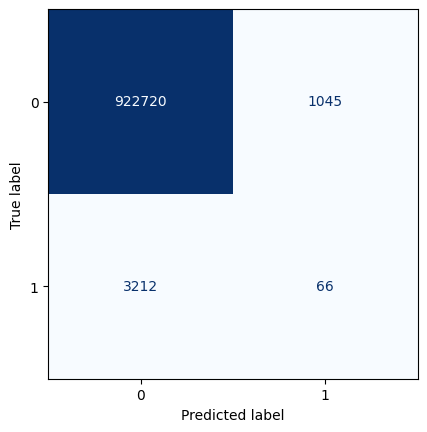

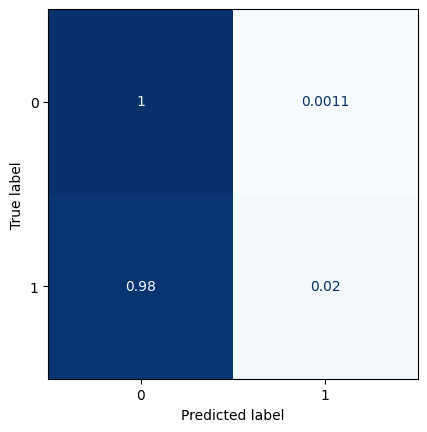

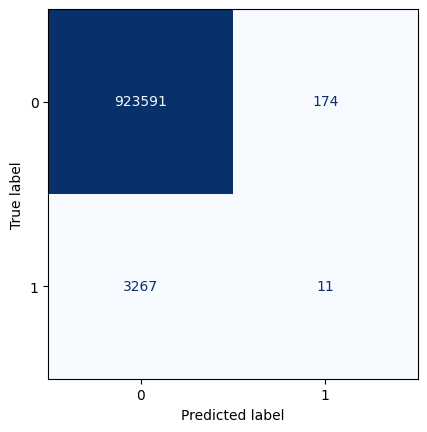

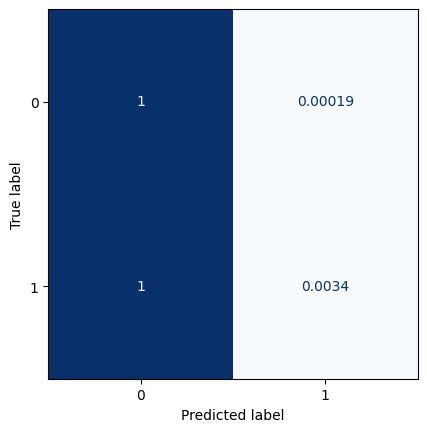

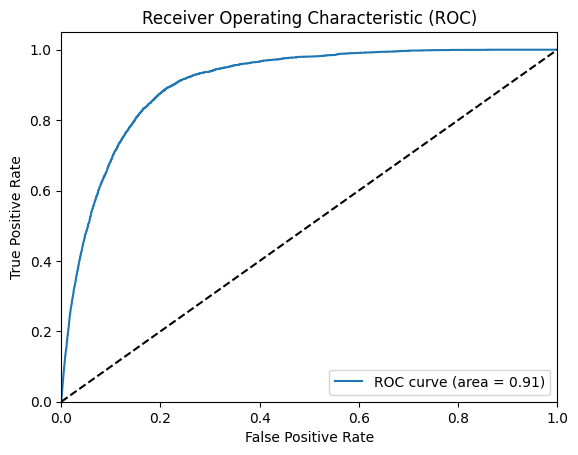

All zeros Brier score: 0.00353597405945571
Model Brier score: 0.0034597454648158136
Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_24 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_25 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_8 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_26 (Conv2D)          (None, 14, 30, 1)         73        
                                    

2023-03-28 11:18:12.313033: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0451

2023-03-28 11:18:15.130543: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0451 - val_loss: 0.0231
Epoch 2/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0242 - val_loss: 0.0213
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0228 - val_loss: 0.0205
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0222 - val_loss: 0.0199
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0218 - val_loss: 0.0199
Epoch 6/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0216 - val_loss: 0.0194
Epoch 7/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0214 - val_loss: 0.0194
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0212 - val_loss: 0.0193
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0211 - val_loss: 0.0194
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0210 - val_loss: 0.0191
E

2023-03-28 11:19:39.004748: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


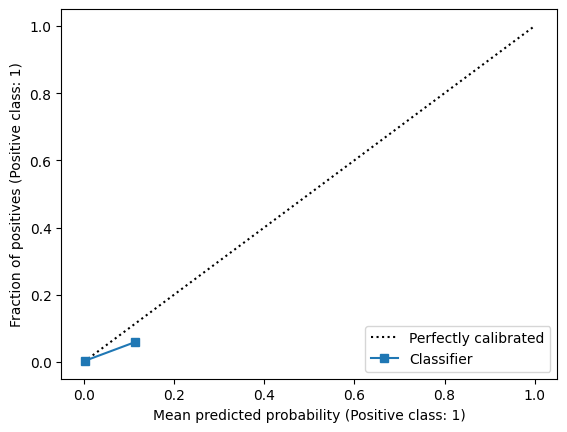

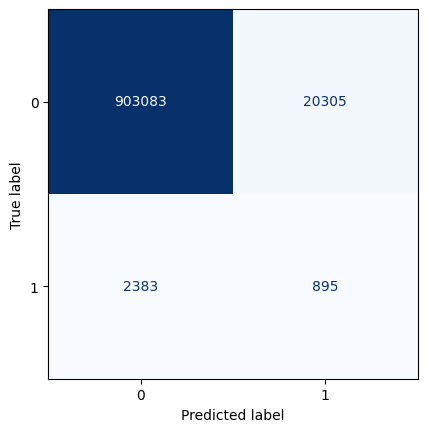

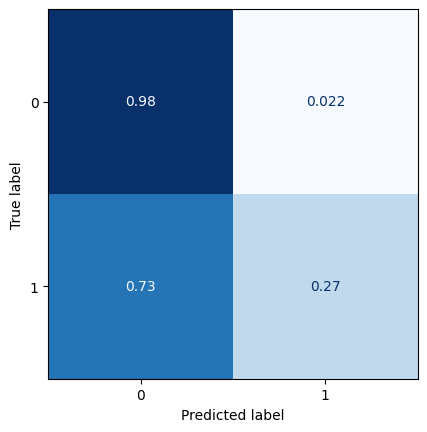

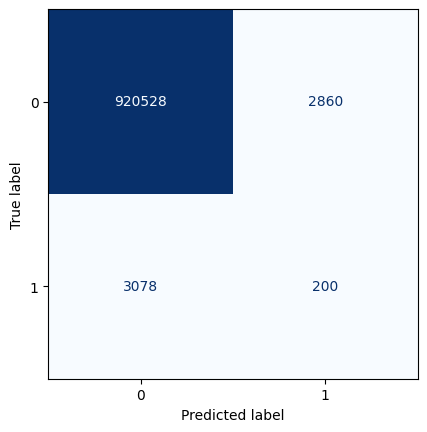

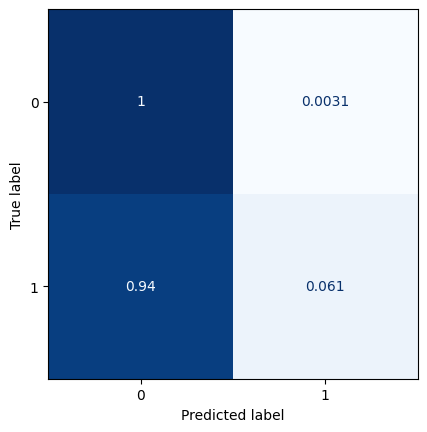

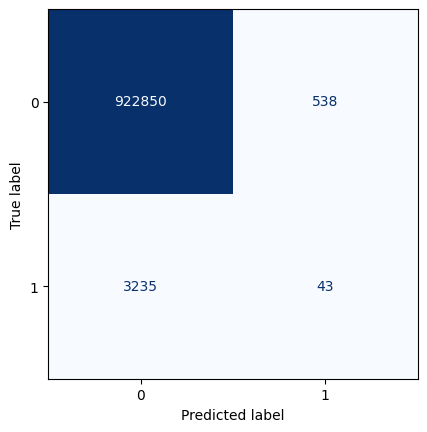

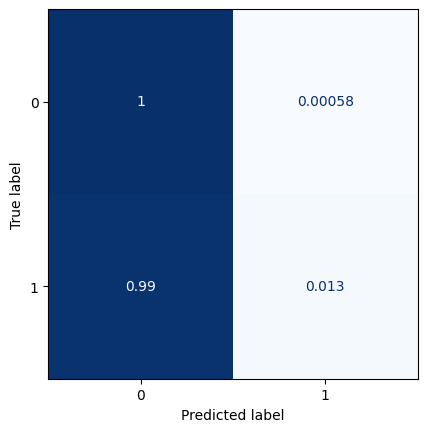

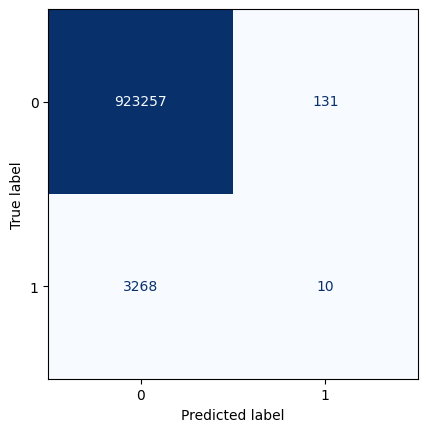

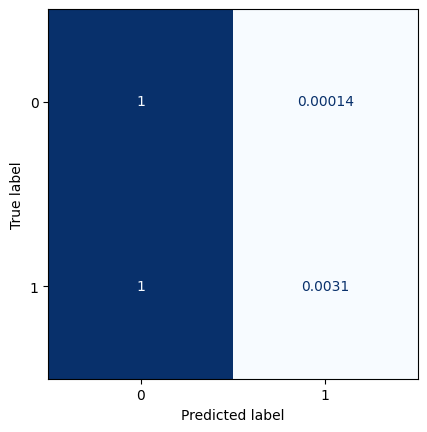

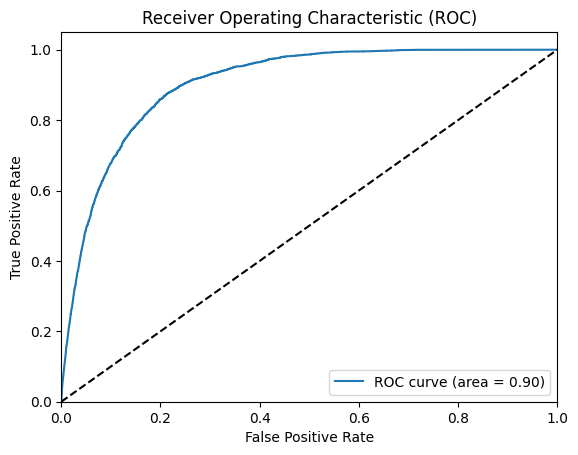

All zeros Brier score: 0.0035374126168436094
Model Brier score: 0.0034618074381382396
Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_27 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_9 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_28 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_9 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_29 (Conv2D)          (None, 14, 30, 1)         73        
                                  

2023-03-28 11:20:00.797013: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0448

2023-03-28 11:20:03.640464: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0448 - val_loss: 0.0227
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0238 - val_loss: 0.0211
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0226 - val_loss: 0.0205
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0221 - val_loss: 0.0203
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0218 - val_loss: 0.0202
Epoch 6/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0215 - val_loss: 0.0200
Epoch 7/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0214 - val_loss: 0.0201
Epoch 8/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0213 - val_loss: 0.0197
Epoch 9/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0212 - val_loss: 0.0198
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0211 - val_loss: 0.0201
E

2023-03-28 11:21:36.046377: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


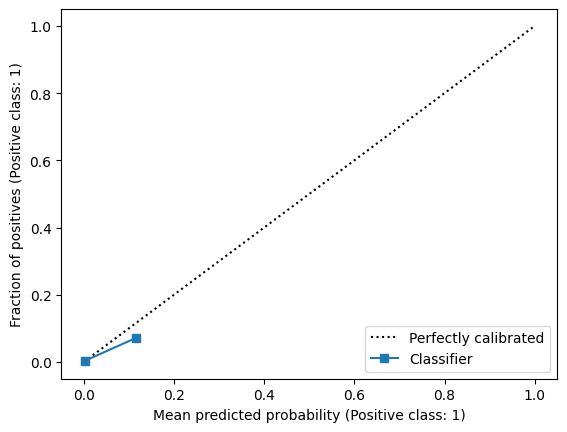

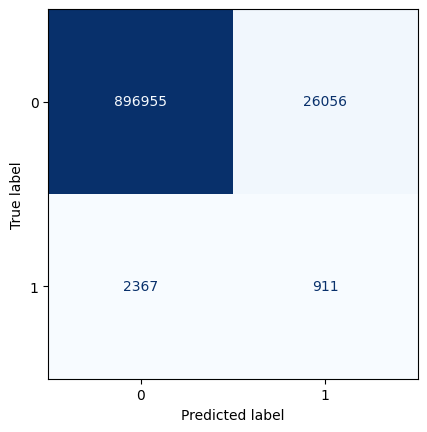

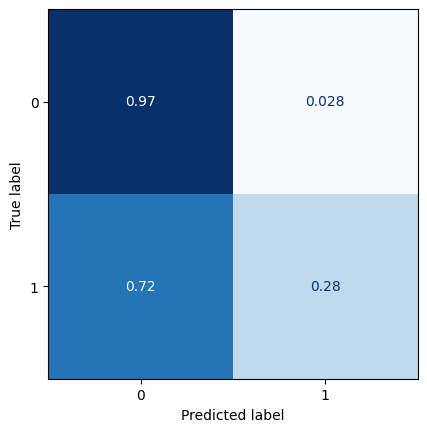

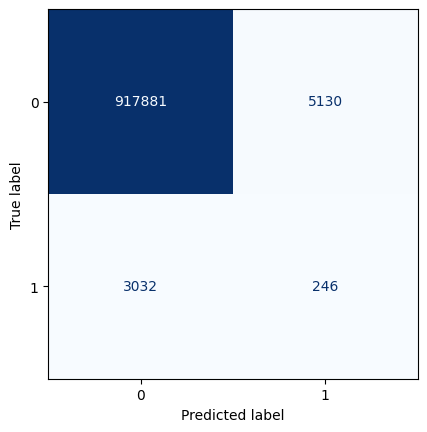

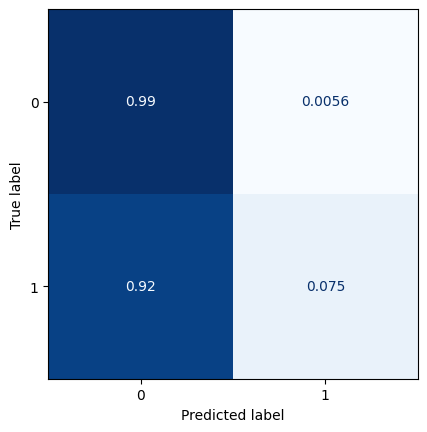

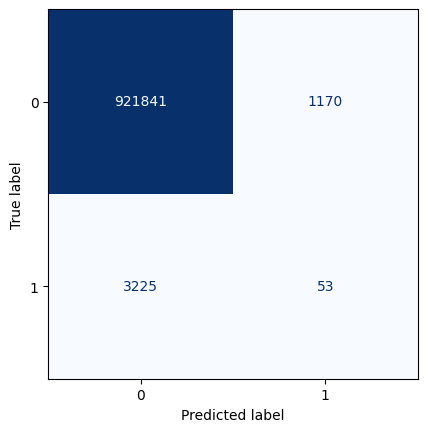

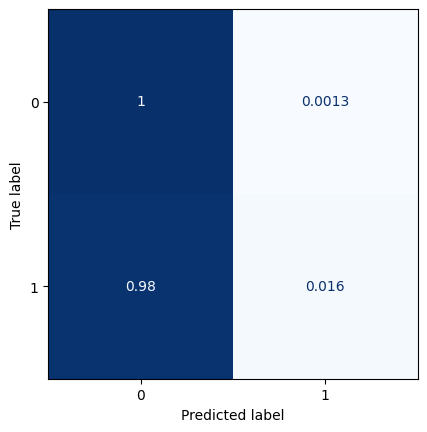

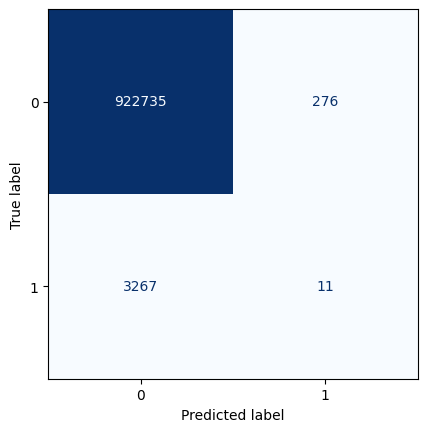

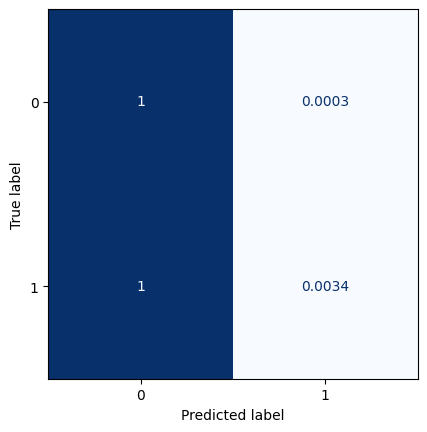

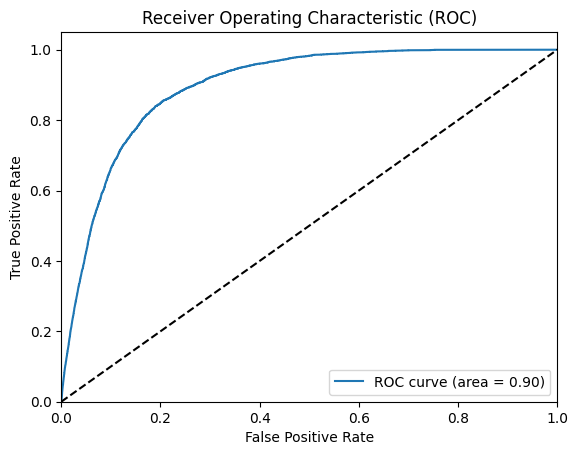

All zeros Brier score: 0.003538852345218393
Model Brier score: 0.0034784944757933795
Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_30 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_10 (MaxPoolin  (None, 7, 15, 8)         0         
 g2D)                                                            
                                                                 
 conv2d_31 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_10 (UpSamplin  (None, 14, 30, 8)        0         
 g2D)                                                            
                                                                 
 conv2d_32 (Conv2D)          (None, 14, 30, 1)         73        
                                  

2023-03-28 11:21:57.965497: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0600

2023-03-28 11:22:00.895264: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 9ms/step - loss: 0.0600 - val_loss: 0.0233
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0243 - val_loss: 0.0216
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0232 - val_loss: 0.0208
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0226 - val_loss: 0.0205
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0223 - val_loss: 0.0206
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0220 - val_loss: 0.0200
Epoch 7/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0218 - val_loss: 0.0198
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0216 - val_loss: 0.0202
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0216 - val_loss: 0.0198
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0214 - val_loss: 0.0196
E

2023-03-28 11:23:27.050857: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


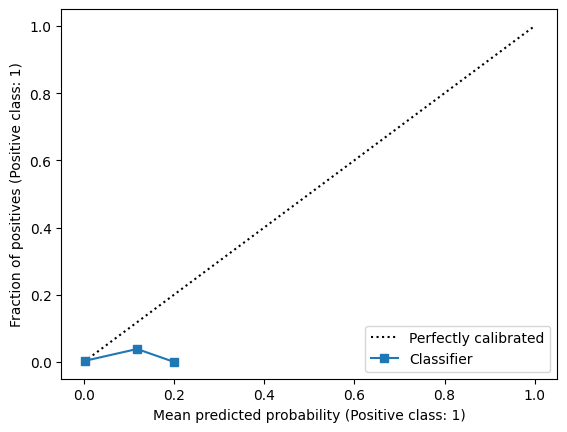

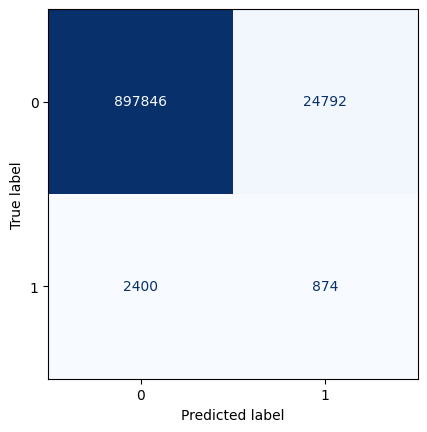

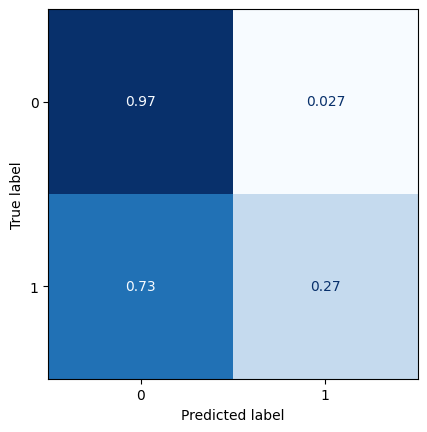

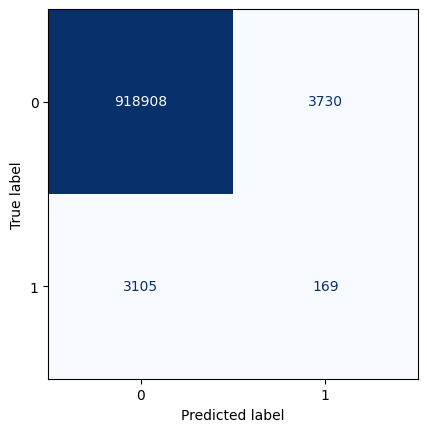

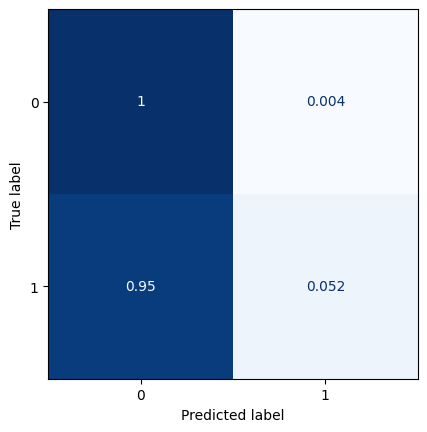

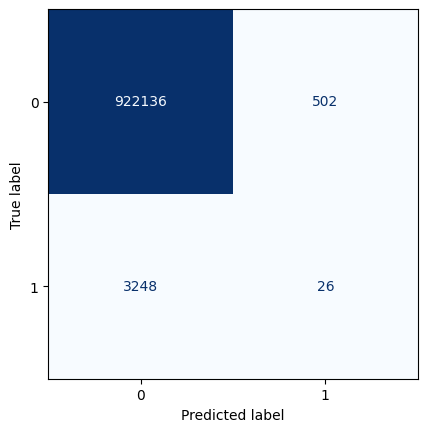

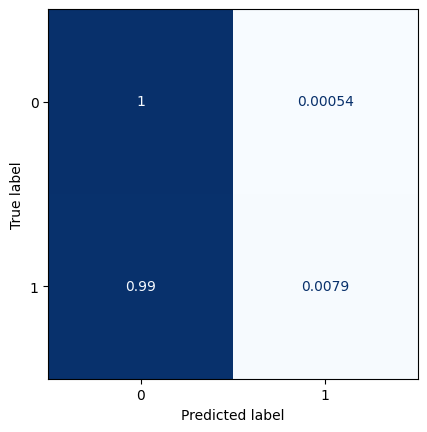

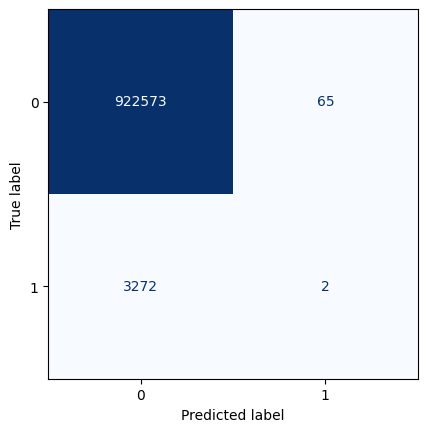

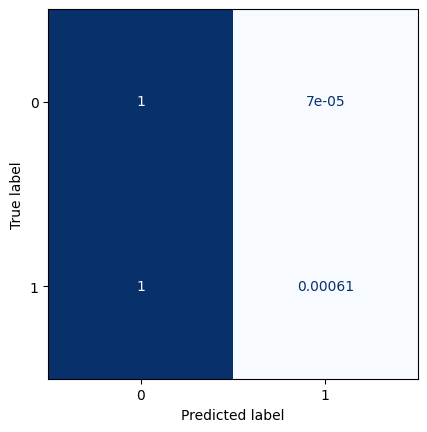

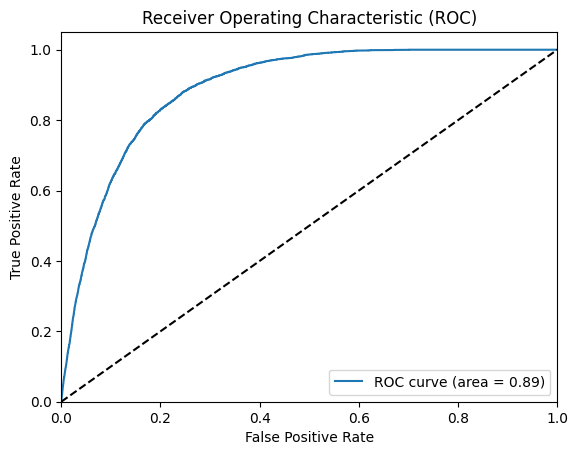

All zeros Brier score: 0.0035359731810366427
Model Brier score: 0.003477522258814916
Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_33 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_11 (MaxPoolin  (None, 7, 15, 8)         0         
 g2D)                                                            
                                                                 
 conv2d_34 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_11 (UpSamplin  (None, 14, 30, 8)        0         
 g2D)                                                            
                                                                 
 conv2d_35 (Conv2D)          (None, 14, 30, 1)         73        
                                  

2023-03-28 11:23:49.444177: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0537

2023-03-28 11:23:52.832610: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 4s 10ms/step - loss: 0.0537 - val_loss: 0.0241
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0240 - val_loss: 0.0222
Epoch 3/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0230 - val_loss: 0.0215
Epoch 4/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0223 - val_loss: 0.0205
Epoch 5/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0220 - val_loss: 0.0203
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0217 - val_loss: 0.0203
Epoch 7/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0216 - val_loss: 0.0205
Epoch 8/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0215 - val_loss: 0.0200
Epoch 9/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0214 - val_loss: 0.0199
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0213 - val_loss: 0.0199


2023-03-28 11:25:54.759172: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


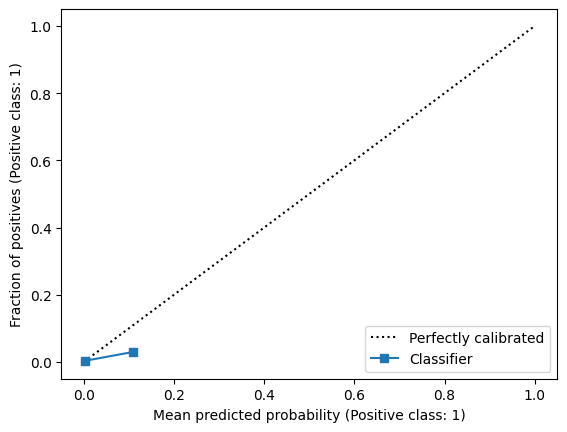

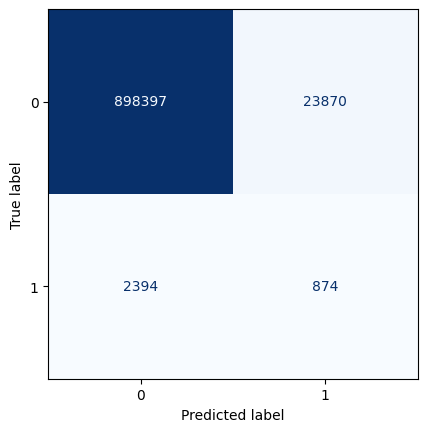

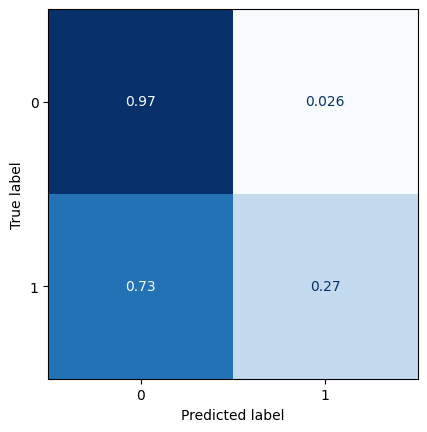

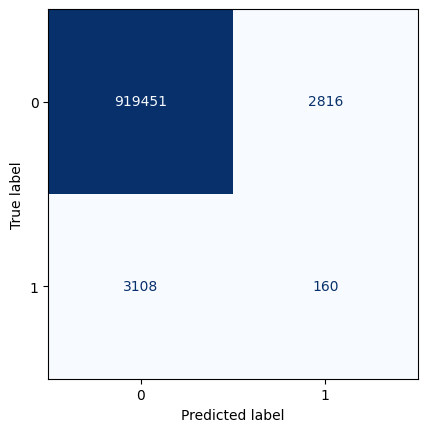

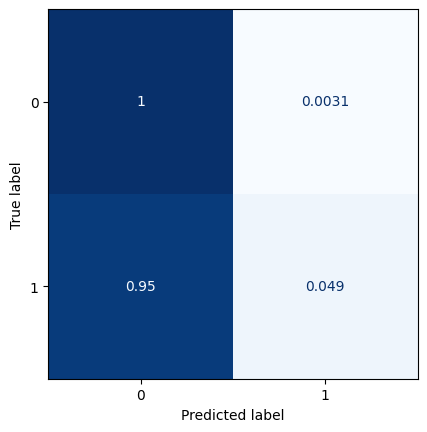

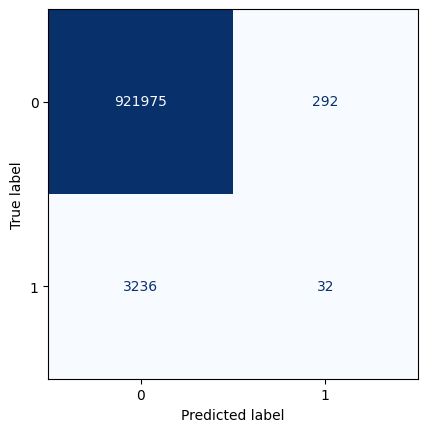

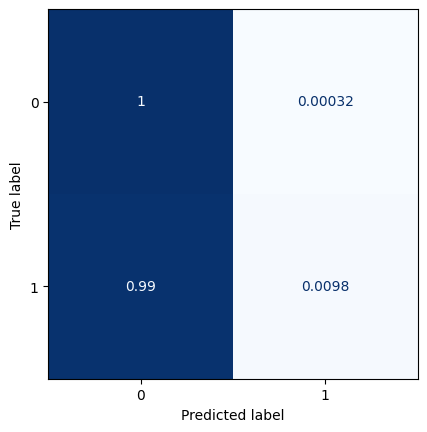

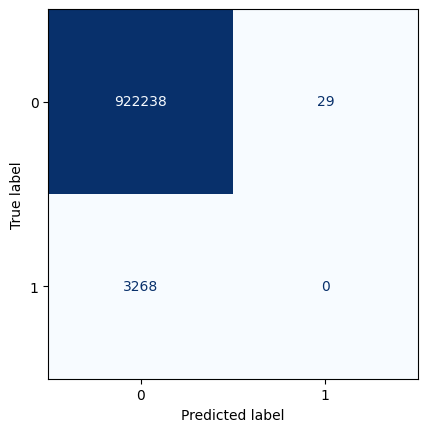

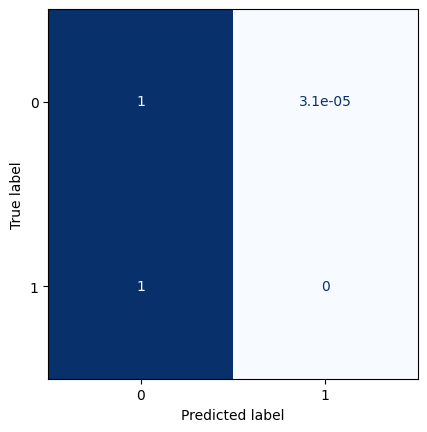

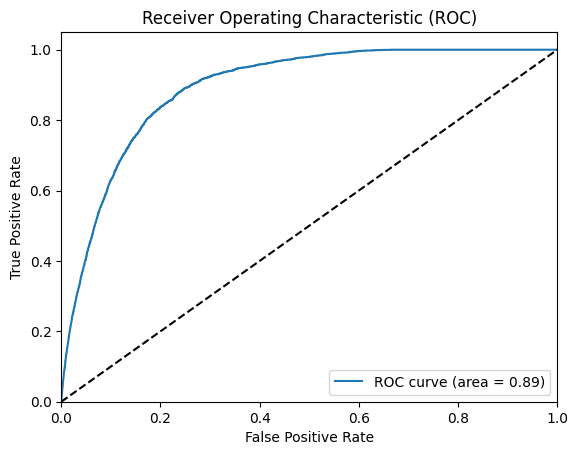

All zeros Brier score: 0.0035309307589664355
Model Brier score: 0.0034669633336080717
Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_36 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_12 (MaxPoolin  (None, 7, 15, 8)         0         
 g2D)                                                            
                                                                 
 conv2d_37 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_12 (UpSamplin  (None, 14, 30, 8)        0         
 g2D)                                                            
                                                                 
 conv2d_38 (Conv2D)          (None, 14, 30, 1)         73        
                                 

2023-03-28 11:26:18.965733: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0580

2023-03-28 11:26:21.812693: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0580 - val_loss: 0.0234
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0245 - val_loss: 0.0219
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0233 - val_loss: 0.0215
Epoch 4/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0226 - val_loss: 0.0209
Epoch 5/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0222 - val_loss: 0.0207
Epoch 6/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0219 - val_loss: 0.0209
Epoch 7/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0217 - val_loss: 0.0201
Epoch 8/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0216 - val_loss: 0.0203
Epoch 9/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0215 - val_loss: 0.0203
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0214 - val_loss: 0.0201
E

2023-03-28 11:27:48.416958: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


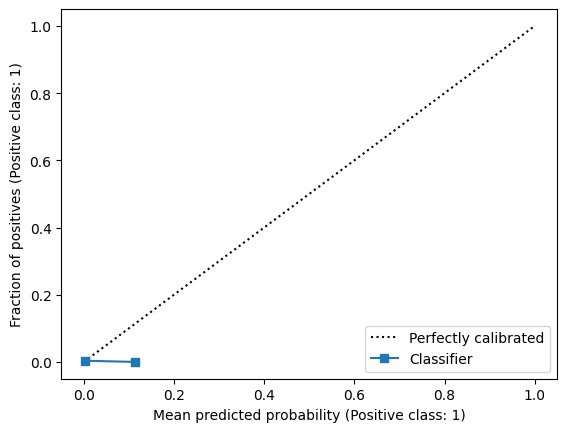

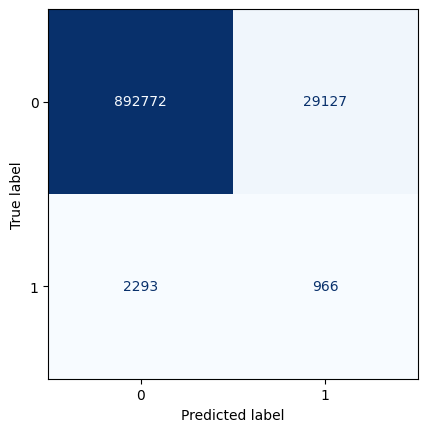

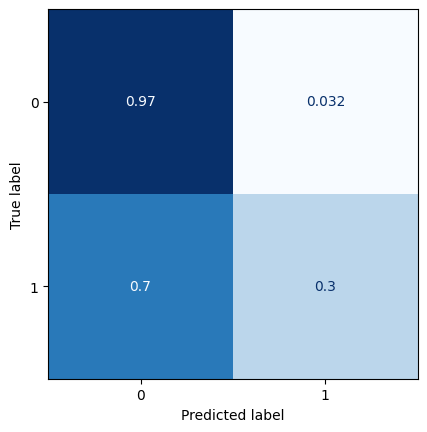

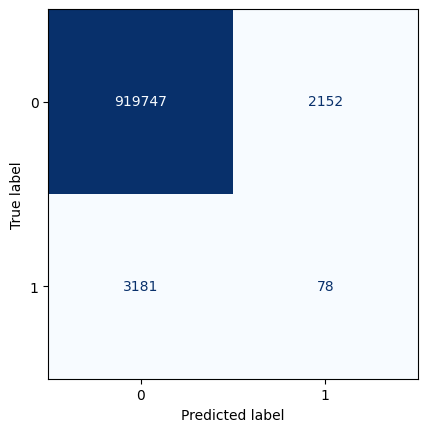

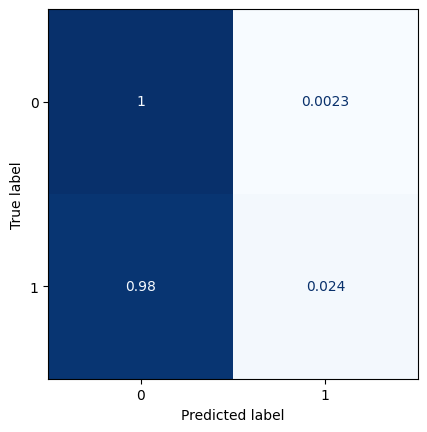

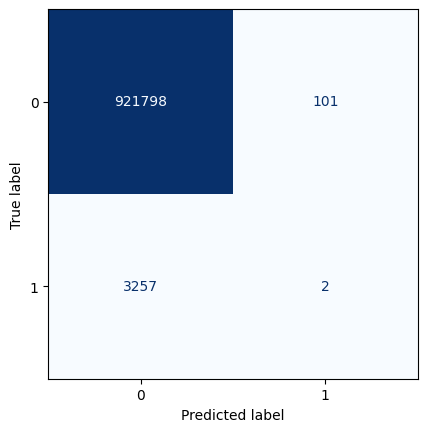

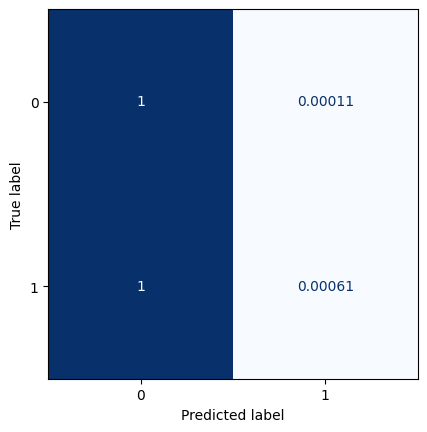

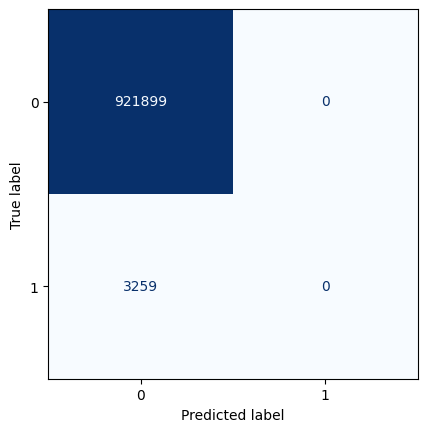

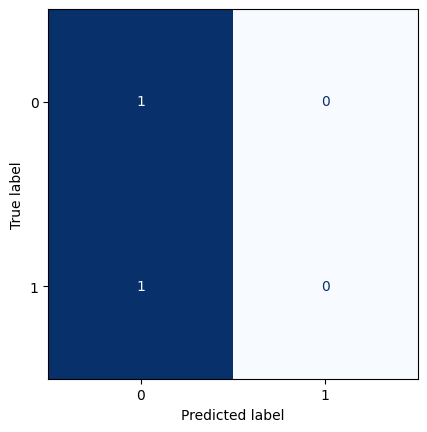

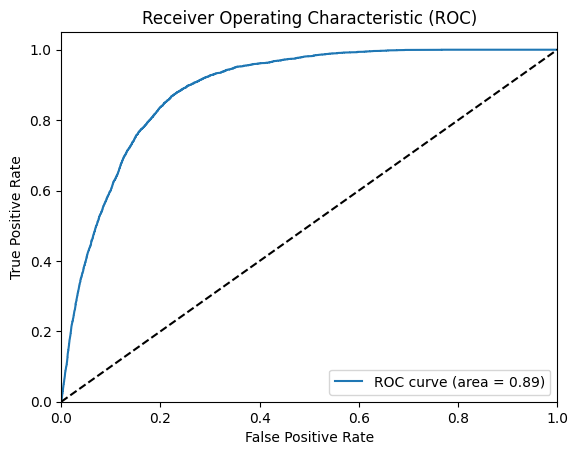

All zeros Brier score: 0.003522641537985944
Model Brier score: 0.0034647624830147837
Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_39 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_13 (MaxPoolin  (None, 7, 15, 8)         0         
 g2D)                                                            
                                                                 
 conv2d_40 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_13 (UpSamplin  (None, 14, 30, 8)        0         
 g2D)                                                            
                                                                 
 conv2d_41 (Conv2D)          (None, 14, 30, 1)         73        
                                  

2023-03-28 11:28:12.650330: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0812

2023-03-28 11:28:15.620495: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 9ms/step - loss: 0.0812 - val_loss: 0.0253
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0260 - val_loss: 0.0235
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0242 - val_loss: 0.0222
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0233 - val_loss: 0.0217
Epoch 5/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0228 - val_loss: 0.0211
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0224 - val_loss: 0.0208
Epoch 7/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0223 - val_loss: 0.0208
Epoch 8/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0221 - val_loss: 0.0208
Epoch 9/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0219 - val_loss: 0.0207
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0218 - val_loss: 0.0206
E

2023-03-28 11:30:26.220758: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


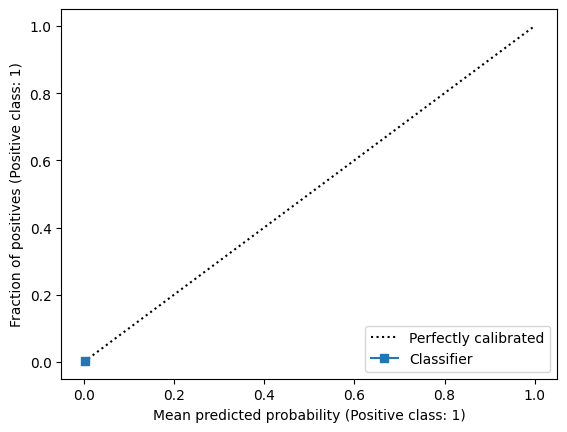

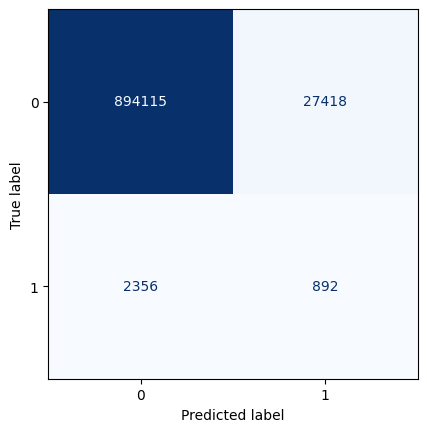

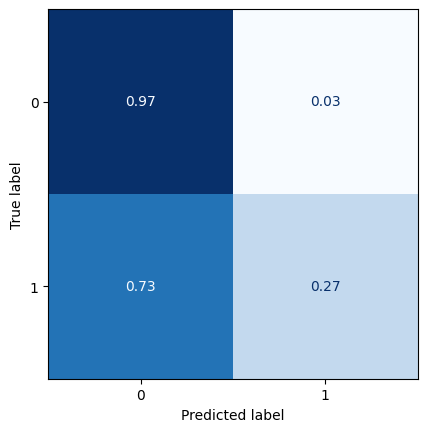

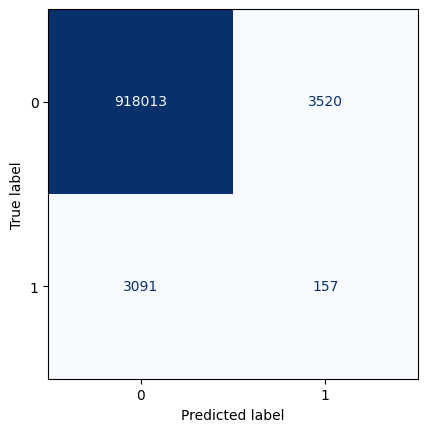

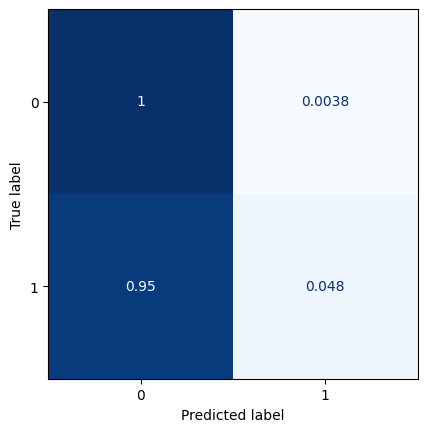

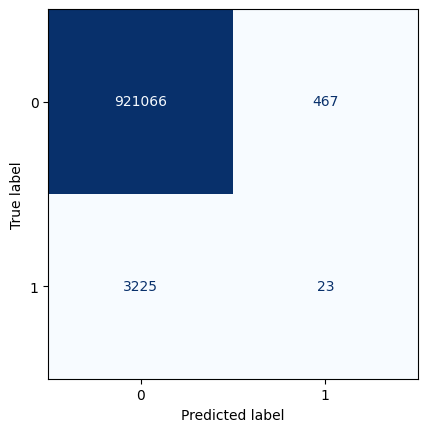

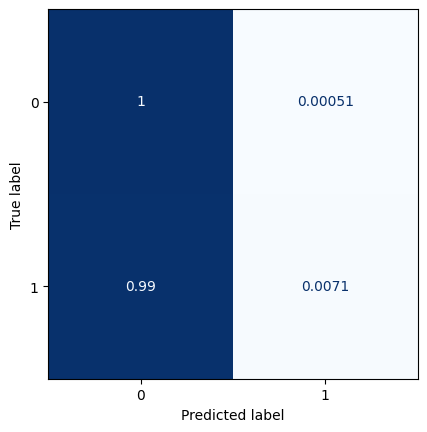

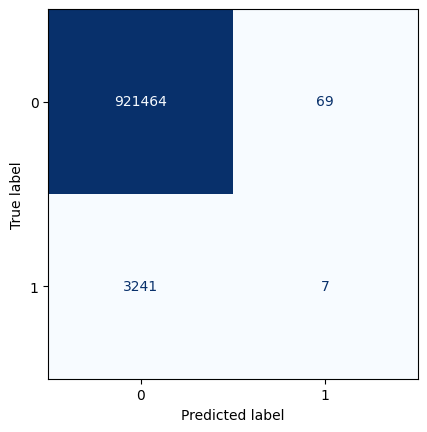

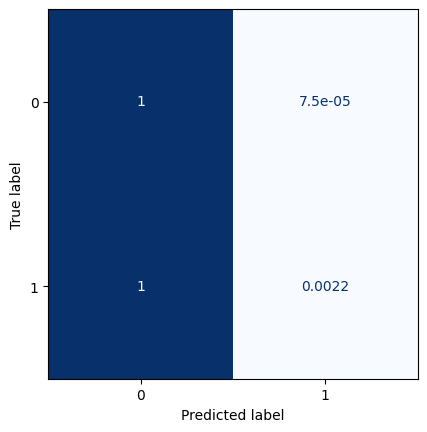

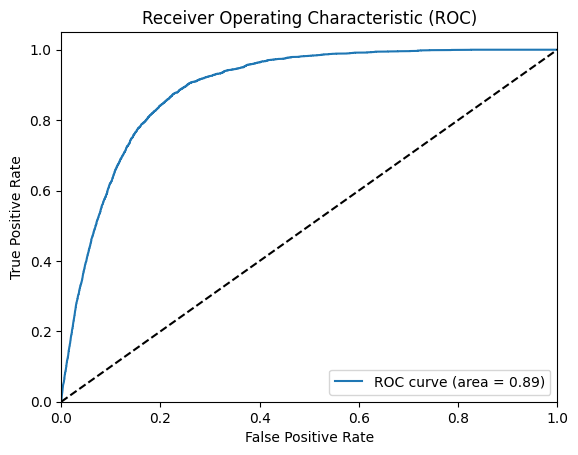

All zeros Brier score: 0.0035121828843801936
Model Brier score: 0.003456000968310353


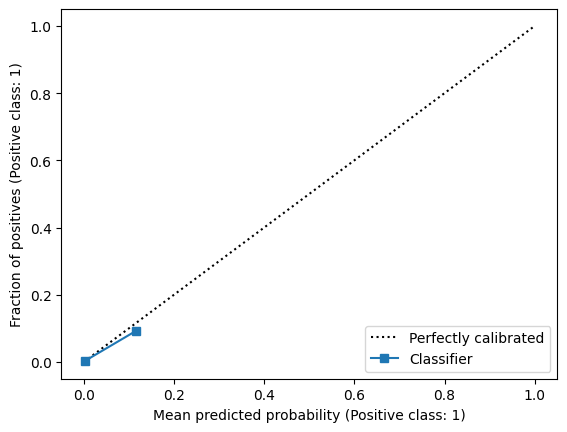

In [23]:
for lag in [1,2,3,4,5,6,7,8,9,10,11,12,13]:
    ### Model summary
    model = Sequential()
    model.add(layers.Input(shape=(13, 29, 9)))
    
    model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
    model.add(layers.MaxPooling2D((2, 2), padding='same'))

    model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
    model.add(layers.UpSampling2D((2,2)))
    
    model.add(layers.Conv2D(1, (3, 3), activation='sigmoid', padding='same')) # sigmoidal activation to have probabilities
    
    model.add(layers.Cropping2D(cropping=((0,1),(0,1))))
    
    model.summary()
    
    
    model.compile(loss='binary_crossentropy', optimizer='adam')
    
    monitor = EarlyStopping(monitor='val_loss', min_delta=1e-5, patience=20, 
            verbose=1, mode='auto', restore_best_weights=True)
    
    ### Model training
    model.fit(train_img_std[:-lag], y_train_img[lag:], validation_data=(val_img_std[:-lag],y_val_img[lag:]),
        callbacks=[monitor],epochs=100)
    
    ### Confusion matrices
    t = model.predict(test_img_std[:-lag])

    ranges = [0.025,0.05,0.075,0.1]
    
    for j in ranges:
        classes = []
        for i in t.reshape(-1,1):
            if i<=j: classes.append(0)
            else: classes.append(1)
    
        ConfusionMatrixDisplay(confusion_matrix(y_test_img[lag:].reshape(-1,1), classes)).plot(colorbar=False,cmap=plt.cm.Blues, values_format='d')
        ConfusionMatrixDisplay(confusion_matrix(y_test_img[lag:].reshape(-1,1), classes, normalize='true')).plot(colorbar=False,cmap=plt.cm.Blues)
    
    ### ROC
    plot_roc(t.reshape(-1,1),y_test_img[lag:].reshape(-1,1))
    
    z = np.zeros((lag,13,29,1))
    tt = np.concatenate((t,z))
    test['predictions_lag'+str(lag)] = tt.reshape(-1,1)
    test.to_csv("test_with_newTarget_predictions.csv")
    
    ### calibration
    display = CalibrationDisplay.from_predictions(y_test_img[lag:].reshape(-1,1), t.reshape(-1,1), n_bins=10)
    print(f'All zeros Brier score: {brier_score_loss(y_test_img[lag:].reshape(-1,1), np.zeros(len(y_test_img[lag:].reshape(-1,1))))}')
    print(f'Model Brier score: {brier_score_loss(y_test_img[lag:].reshape(-1,1), t.reshape(-1,1))}')
    

In [29]:
test

,Unnamed: 0,time,latitude,longitude,vo,r,u_200,u_850,v_200,v_850,ttr,sst,new_target,Real_tom_target,shear,target,predictions_lag0,predictions_lag1,predictions_lag2,predictions_lag3,predictions_lag4,predictions_lag5,predictions_lag6,predictions_lag7,predictions_lag8,predictions_lag9,predictions_lag10,predictions_lag11,predictions_lag12,predictions_lag13
34307,34307,2016-04-01,0.0,20.0,0.238973,1.386669,-0.945404,1.574206,0.511504,0.367981,2.652010,-1.588255,0.0,0.0,-0.516292,0,5.599760e-06,1.116584e-05,0.000032,0.000440,1.698381e-04,4.817998e-06,3.752636e-05,0.000202,2.247904e-05,0.000111,0.000871,3.269772e-06,0.000328,0.000142
34308,34308,2016-04-01,0.0,22.5,-0.172396,1.196522,-0.819827,1.371793,0.717349,0.332262,3.396515,-1.588255,0.0,0.0,-0.755886,0,8.091185e-07,3.770019e-07,0.000002,0.000008,1.457031e-06,6.148791e-08,6.037646e-07,0.000003,5.734404e-07,0.000007,0.000024,5.036778e-08,0.000031,0.000008
34309,34309,2016-04-01,0.0,25.0,1.188889,1.166772,-0.571398,1.173488,0.662464,0.144802,4.092788,-1.588255,0.0,0.0,-1.161314,0,5.273907e-07,1.280818e-07,0.000003,0.000005,5.989831e-07,3.379468e-08,3.775615e-07,0.000001,2.429358e-07,0.000003,0.000012,3.192573e-08,0.000018,0.000004
34310,34310,2016-04-01,0.0,27.5,-0.649707,1.063899,-0.385753,0.812011,0.713230,0.584284,4.044557,-1.588255,0.0,0.0,-1.507685,0,4.937469e-07,6.390888e-08,0.000009,0.000003,9.002248e-07,3.109205e-08,8.725253e-08,0.000001,1.392415e-08,0.000001,0.000008,2.136173e-08,0.000014,0.000001
34311,34311,2016-04-01,0.0,30.0,-0.629183,1.432846,-0.362931,0.809212,0.888739,-0.207576,3.438931,-1.588255,0.0,0.0,-1.154385,0,9.038527e-07,1.089020e-07,0.000020,0.000004,1.546370e-06,4.021748e-08,5.431863e-08,0.000002,2.086840e-08,0.000002,0.000012,2.222927e-08,0.000014,0.000002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
963984,137600,2022-12-31,-30.0,80.0,0.677806,-1.271307,0.290892,-0.727302,0.813190,-0.684904,-0.431475,0.601392,0.0,0.0,0.050674,0,5.519601e-03,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,0.000000
963985,137601,2022-12-31,-30.0,82.5,0.898493,-1.325164,0.224460,-0.764678,1.178495,-0.105389,-0.107881,0.599524,0.0,0.0,0.004080,0,3.107689e-03,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,0.000000
963986,137602,2022-12-31,-30.0,85.0,1.629797,-1.468220,0.376651,-0.566606,1.728863,0.450626,-0.082227,0.597113,0.0,0.0,0.220205,0,1.299448e-03,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,0.000000
963987,137603,2022-12-31,-30.0,87.5,0.280770,-1.453315,0.621629,-0.446284,2.368318,0.792994,-0.000815,0.594579,0.0,0.0,0.648118,0,6.500229e-04,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,0.000000


# pretrained U-net

In [28]:
h_grid = 3
input_layer = Input(shape=(32,32,3))
from keras.layers import Conv2DTranspose as DeConv

resnet = tf.keras.applications.ResNet50(
    input_shape=(32, 32, 3),
    weights='imagenet',
    include_top=False,  
    input_tensor=None,
    pooling=None
    )
resnet.trainable = False

res_features = resnet(input_layer)

conv = DeConv(1, padding="valid", activation="sigmoid", kernel_size=32)(res_features)

model = Model(inputs=input_layer, outputs=conv)
    
model.summary()

model.compile(loss='binary_crossentropy', optimizer='adam')

monitor = EarlyStopping(monitor='val_loss', min_delta=1e-5, patience=20, 
        verbose=1, mode='auto', restore_best_weights=True)


94765736/94765736 [==============================] - 13s 0us/step
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_7 (InputLayer)        [(None, 32, 32, 3)]       0         
                                                                 
 resnet50 (Functional)       (None, 1, 1, 2048)        23587712  
                                                                 
 conv2d_transpose (Conv2DTra  (None, 32, 32, 1)        2097153   
 nspose)                                                         
                                                                 
Total params: 25,684,865
Trainable params: 2,097,153
Non-trainable params: 23,587,712
_________________________________________________________________


# U-net

In [16]:
# u-net model 

from keras.models import Model
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate, Conv2DTranspose, BatchNormalization, Dropout, Lambda, Cropping2D

################################################################
def simple_unet_model(IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS):
#Build the model
    inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
    #s = Lambda(lambda x: x / 255)(inputs)   #No need for this if we normalize our inputs beforehand
    s = inputs

    #Contraction path
    c1 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(s)
    c1 = Dropout(0.1)(c1)
    c1 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c1)
    p1 = MaxPooling2D((2, 2))(c1)
    
    c2 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p1)
    c2 = Dropout(0.1)(c2)
    c2 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c2)
    p2 = MaxPooling2D((2, 2))(c2)
     
    c3 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p2)
    c3 = Dropout(0.2)(c3)
    c3 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c3)
    p3 = MaxPooling2D((2, 2))(c3)
     
    c4 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p3)
    c4 = Dropout(0.2)(c4)
    c4 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c4)
    p4 = MaxPooling2D(pool_size=(2, 2))(c4)
     
    c5 = Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p4)
    c5 = Dropout(0.3)(c5)
    c5 = Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c5)
    
    #Expansive path 
    u6 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(c5)
    u6 = concatenate([u6, c4])
    c6 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u6)
    c6 = Dropout(0.2)(c6)
    c6 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c6)
     
    u7 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c6)
    u7 = concatenate([u7, c3])
    c7 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u7)
    c7 = Dropout(0.2)(c7)
    c7 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c7)
     
    u8 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(c7)
    u8 = concatenate([u8, c2])
    c8 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u8)
    c8 = Dropout(0.1)(c8)
    c8 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c8)
     
    u9 = Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same')(c8)
    u9 = concatenate([u9, c1], axis=3)
    c9 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u9)
    c9 = Dropout(0.1)(c9)
    c9 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c9)
    
    c10 = Cropping2D(cropping=((1,2),(1,2)))(c9)
     
    outputs = Conv2D(1, (1, 1), activation='sigmoid')(c10)
     
    model = Model(inputs=[inputs], outputs=[outputs])
    
    #model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    model.summary()
    
    return model
 

In [17]:
model = simple_unet_model(16,32,9)

model.compile(loss='binary_crossentropy', optimizer='adam')

monitor = EarlyStopping(monitor='val_loss', min_delta=1e-5, patience=20, 
        verbose=1, mode='auto', restore_best_weights=True)

Metal device set to: Apple M1


2023-05-30 09:22:35.475881: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-05-30 09:22:35.477131: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d (Conv2D)                (None, 16, 32, 16)   1312        ['input_1[0][0]']                
                                                                                                  
 dropout (Dropout)              (None, 16, 32, 16)   0           ['conv2d[0][0]']                 
                                                                                                  
 conv2d_1 (Conv2D)              (None, 16, 32, 16)   2320        ['dropout[0][0]']                
                                                                                              

                                                                  'conv2d_1[0][0]']               
                                                                                                  
 conv2d_16 (Conv2D)             (None, 16, 32, 16)   4624        ['concatenate_3[0][0]']          
                                                                                                  
 dropout_8 (Dropout)            (None, 16, 32, 16)   0           ['conv2d_16[0][0]']              
                                                                                                  
 conv2d_17 (Conv2D)             (None, 16, 32, 16)   2320        ['dropout_8[0][0]']              
                                                                                                  
 cropping2d (Cropping2D)        (None, 13, 29, 16)   0           ['conv2d_17[0][0]']              
                                                                                                  
 conv2d_18

In [18]:
pad_tns = tf.constant([ [0,0], [1,2], [1,2], [0,0] ])

In [19]:
train_img_std_padded = np.array(tf.pad(train_img_std,pad_tns,mode='CONSTANT',constant_values=0))
val_img_std_padded = np.array(tf.pad(val_img_std,pad_tns,mode='CONSTANT',constant_values=0))
test_img_std_padded = np.array(tf.pad(test_img_std,pad_tns,mode='CONSTANT',constant_values=0))

In [20]:
model.fit(train_img_std_padded, y_train_img, validation_data=(val_img_std_padded,y_val_img),
        callbacks=[monitor],epochs=100)

Epoch 1/100


2023-05-30 09:22:37.451044: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-05-30 09:22:38.313147: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0207

2023-05-30 09:22:48.830957: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 12s 24ms/step - loss: 0.0207 - val_loss: 0.0112
Epoch 2/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0110 - val_loss: 0.0098
Epoch 3/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0101 - val_loss: 0.0081
Epoch 4/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0096 - val_loss: 0.0074
Epoch 5/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0092 - val_loss: 0.0076
Epoch 6/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0091 - val_loss: 0.0074
Epoch 7/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0087 - val_loss: 0.0082
Epoch 8/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0085 - val_loss: 0.0080
Epoch 9/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0083 - val_loss: 0.0075
Epoch 10/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0081 - val_los

 9/78 [==>...........................] - ETA: 0s 

2023-05-30 09:26:21.863277: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


78/78 [==============================] - 1s 6ms/step


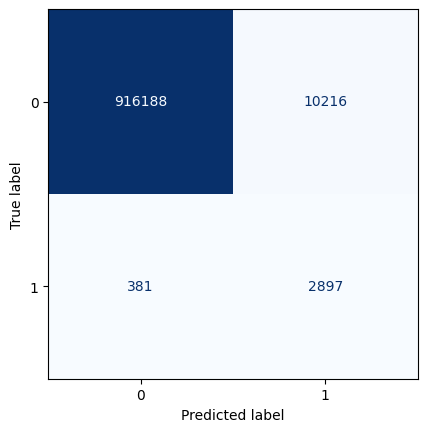

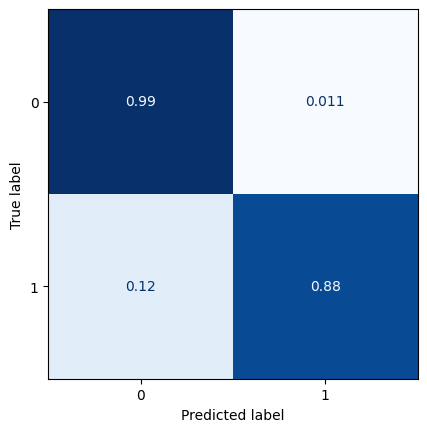

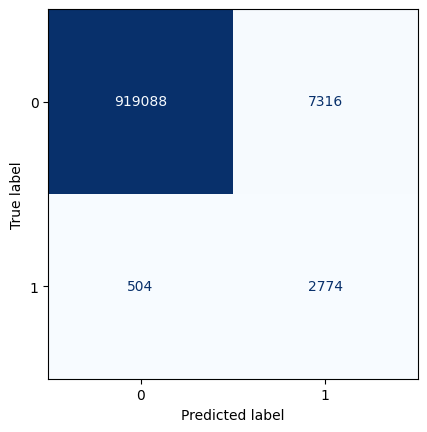

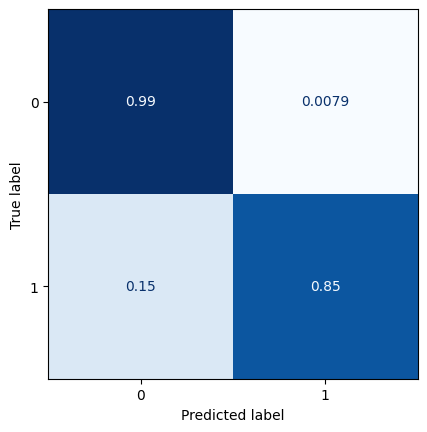

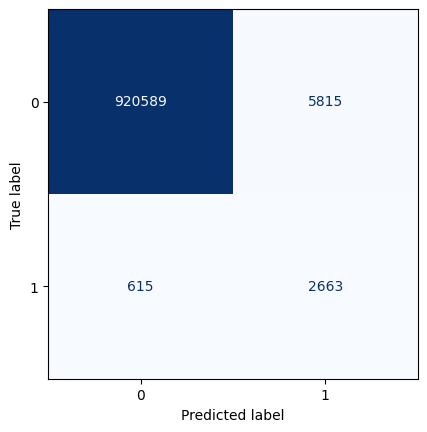

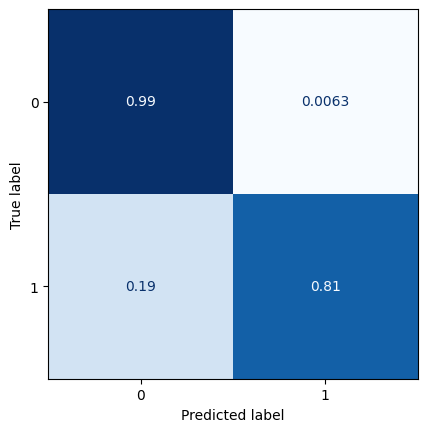

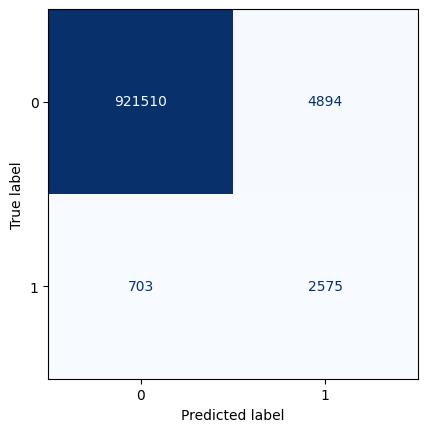

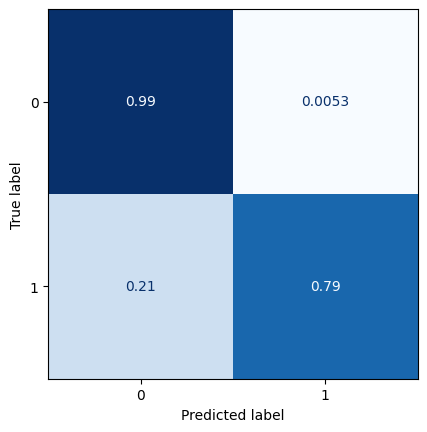

In [21]:
t = model.predict(test_img_std_padded)

ranges = [0.025,0.05,0.075,0.1]

for j in ranges:
    classes = []
    for i in t.reshape(-1,1):
        if i<=j: classes.append(0)
        else: classes.append(1)

# confusion matrix with threshold on 0.1, otherwise always 0 
    ConfusionMatrixDisplay(confusion_matrix(y_test_img.reshape(-1,1), classes)).plot(colorbar=False,cmap=plt.cm.Blues, values_format='d')
    ConfusionMatrixDisplay(confusion_matrix(y_test_img.reshape(-1,1), classes, normalize='true')).plot(colorbar=False,cmap=plt.cm.Blues)
    

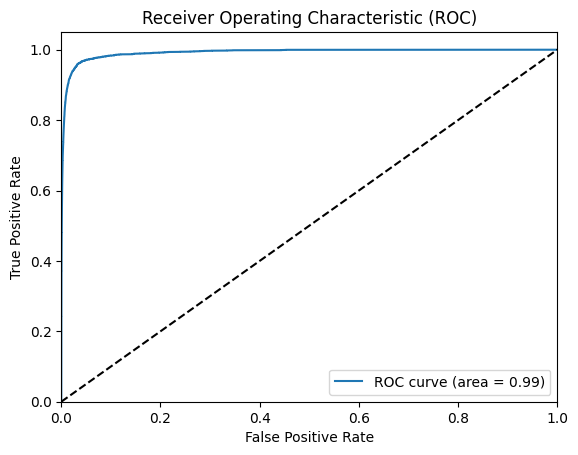

In [22]:
plot_roc(t.reshape(-1,1),y_test_img.reshape(-1,1))

9


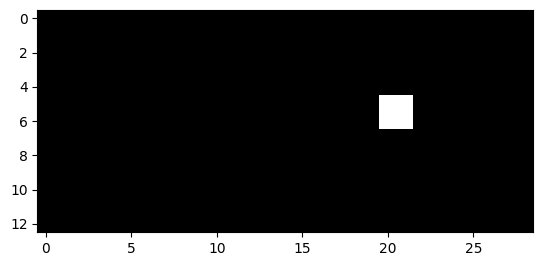

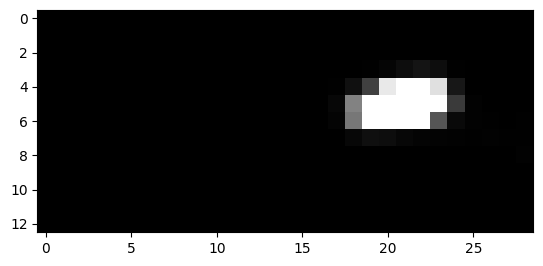

10


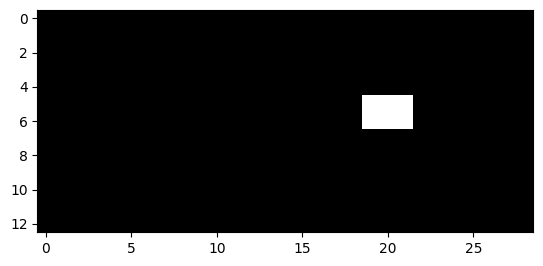

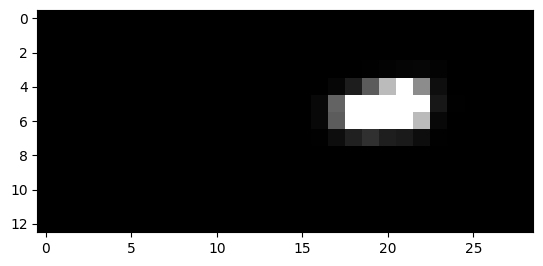

11


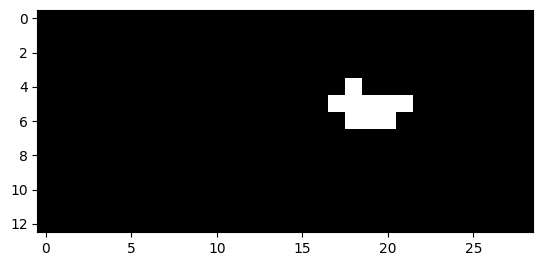

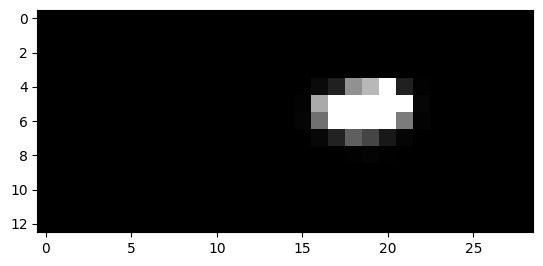

12


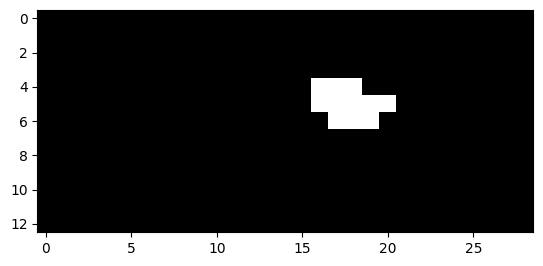

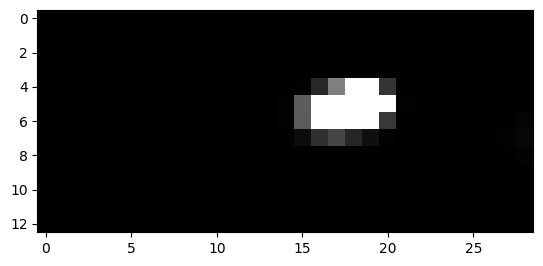

13


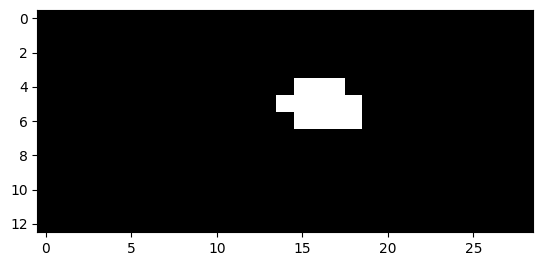

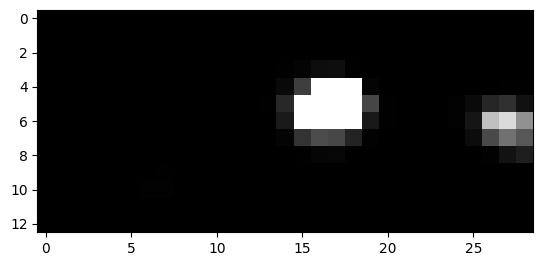

14


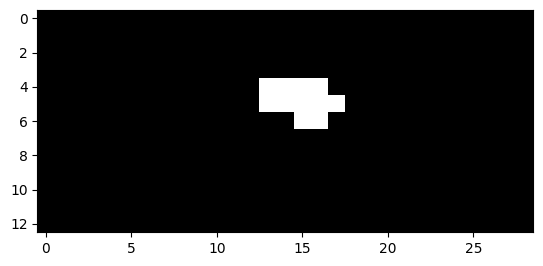

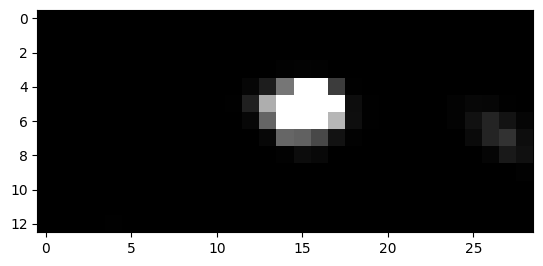

15


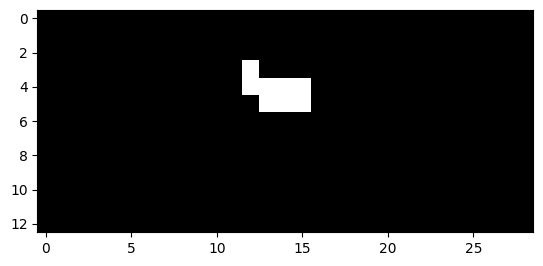

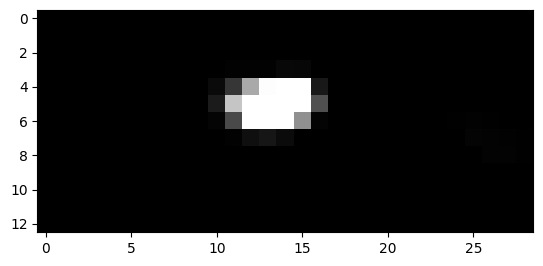

16


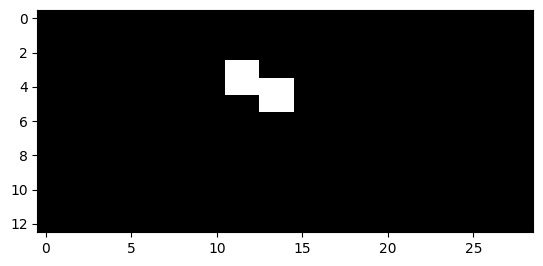

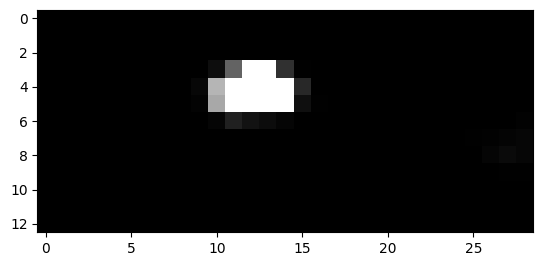

17


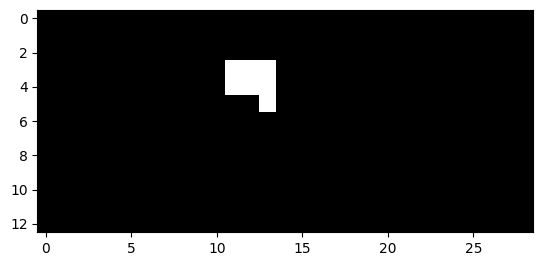

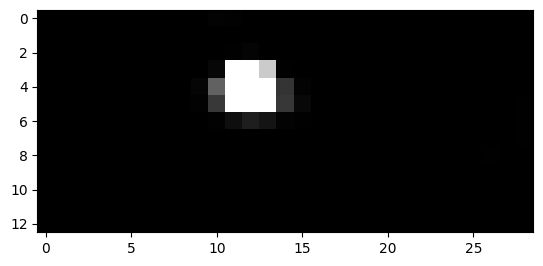

18


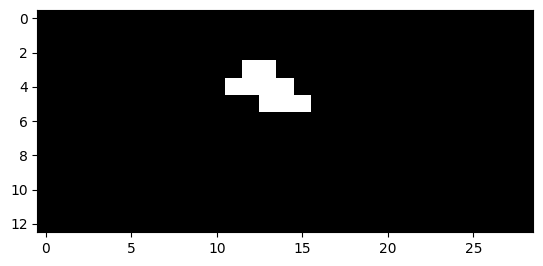

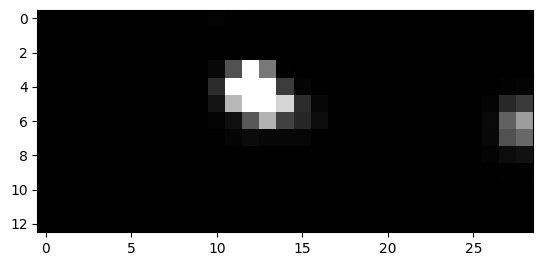

19


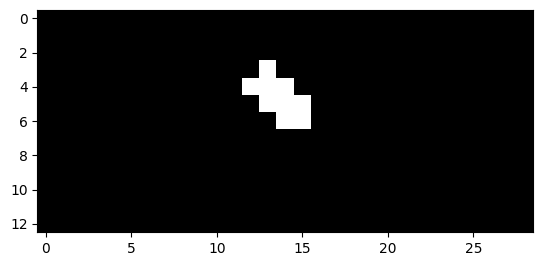

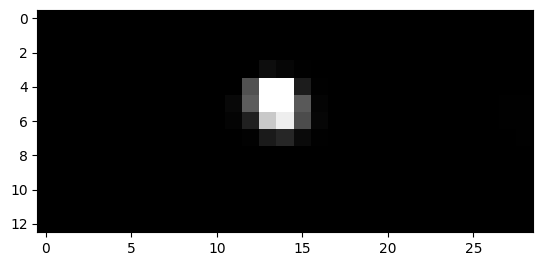

20


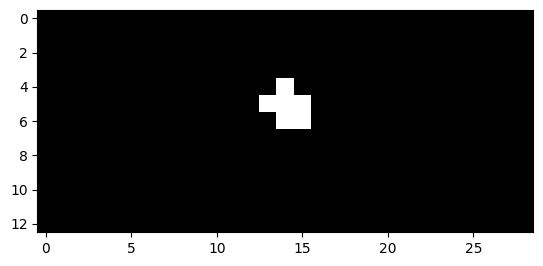

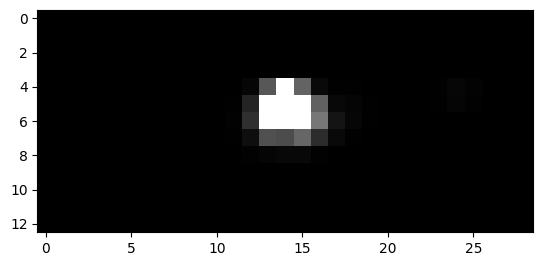

21


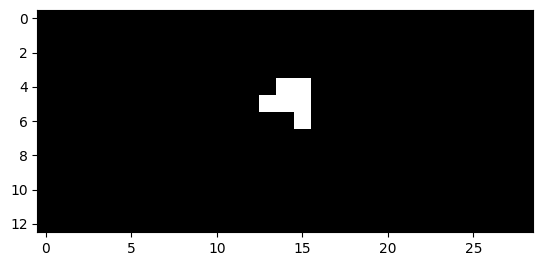

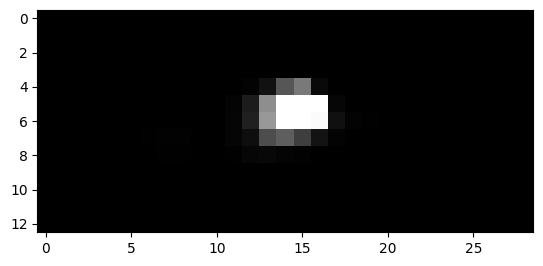

22


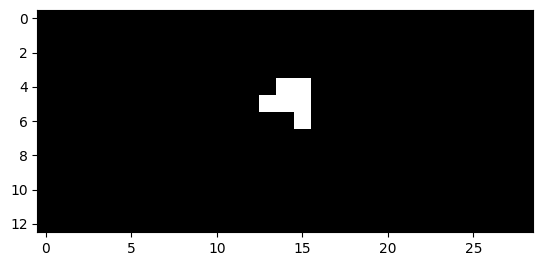

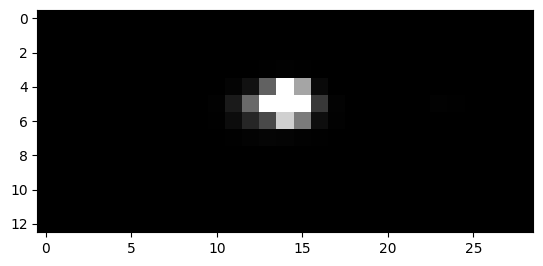

105


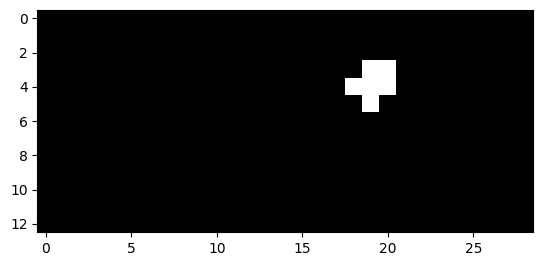

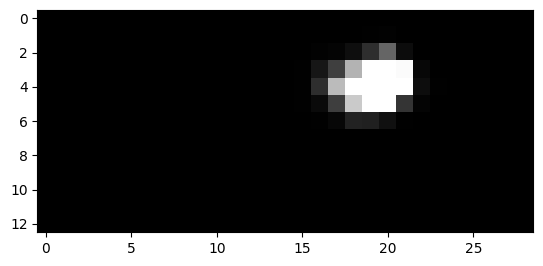

106


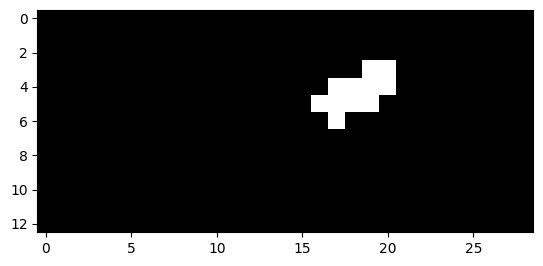

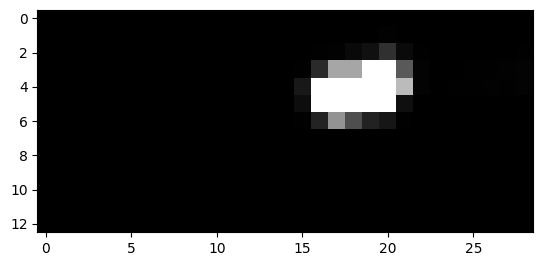

107


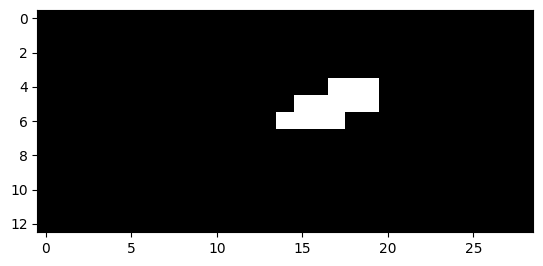

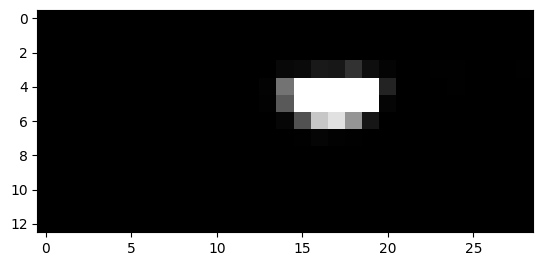

108


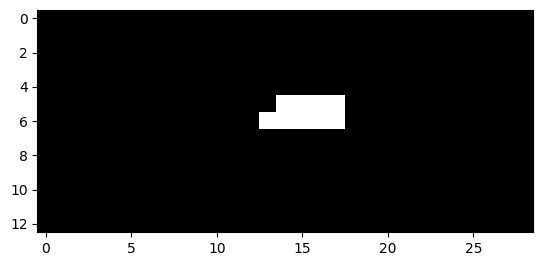

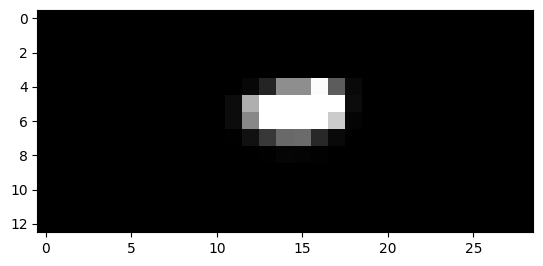

109


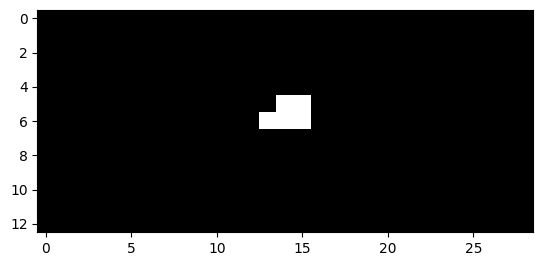

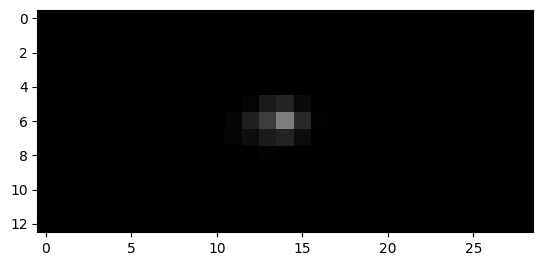

184


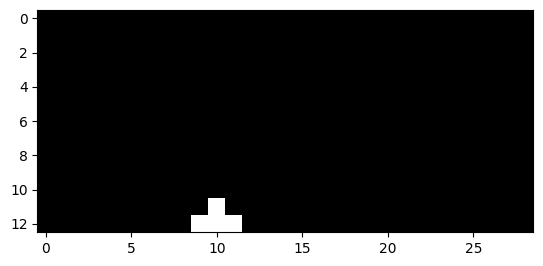

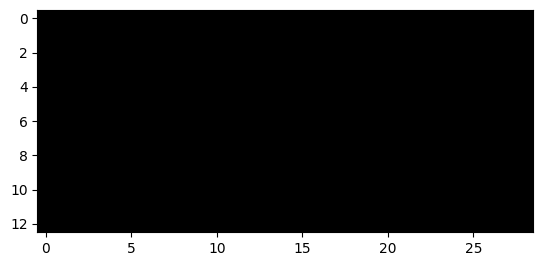

185


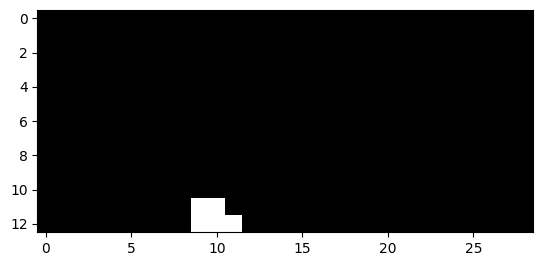

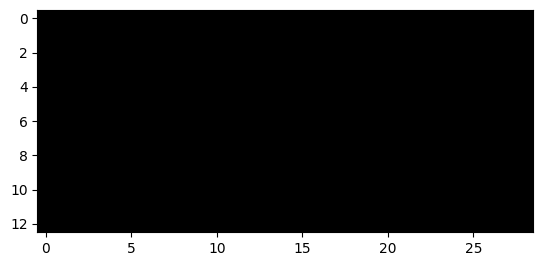

186


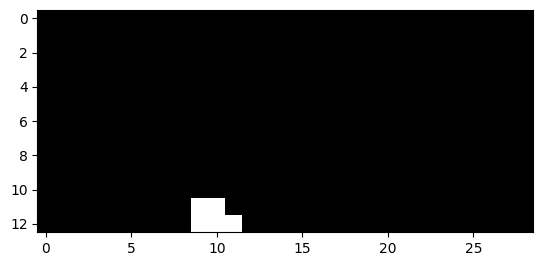

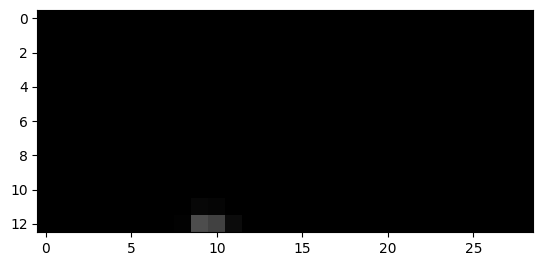

187


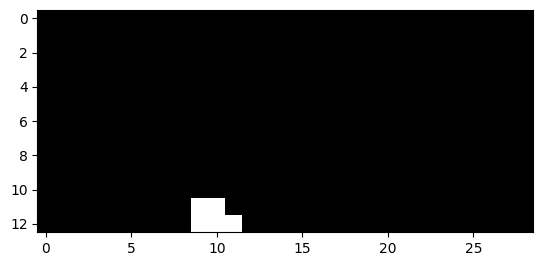

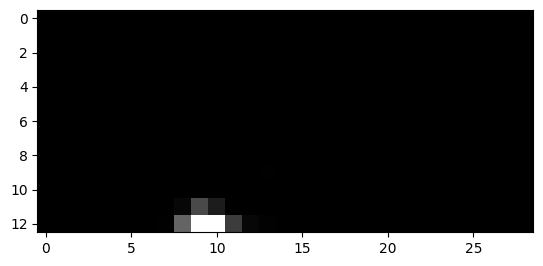

188


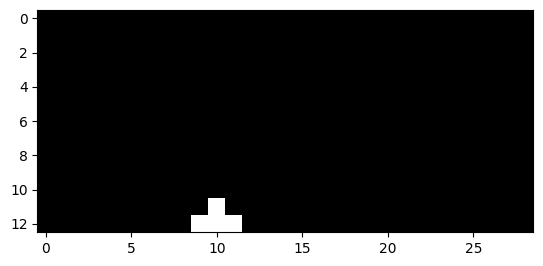

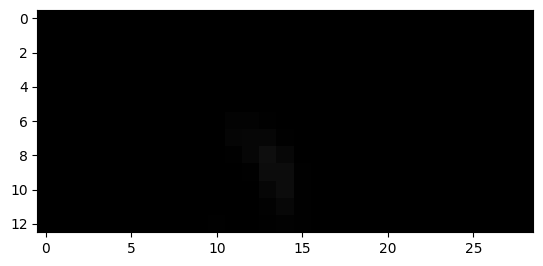

308


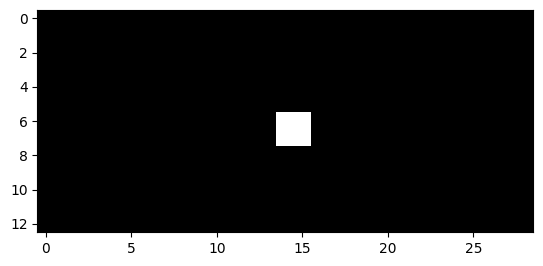

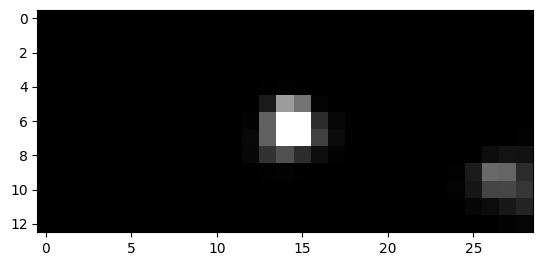

309


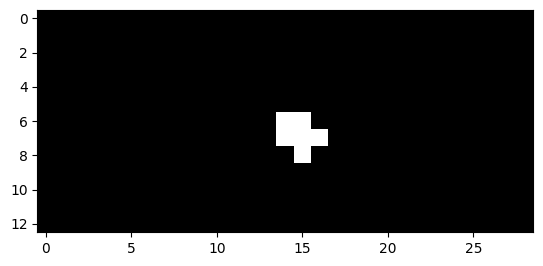

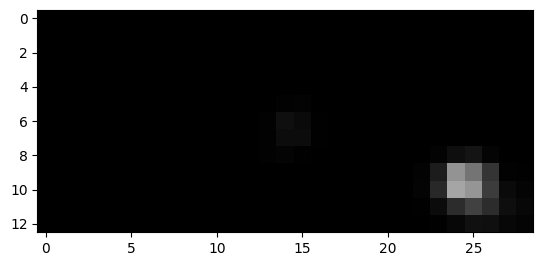

310


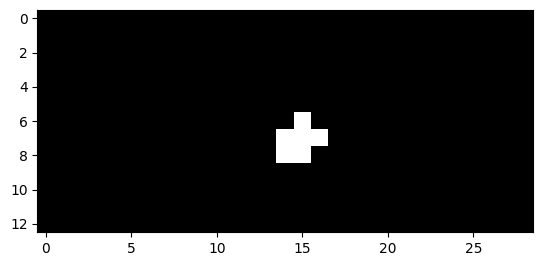

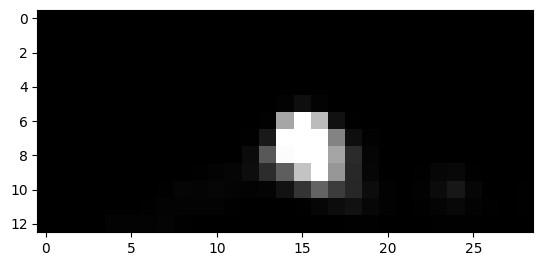

311


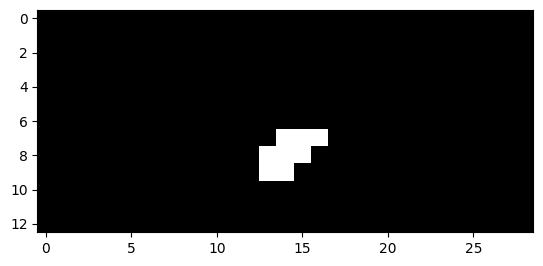

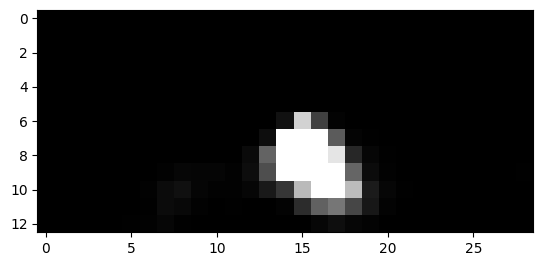

312


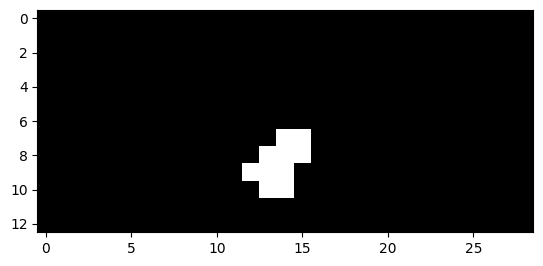

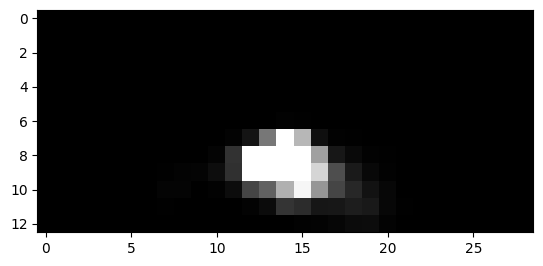

313


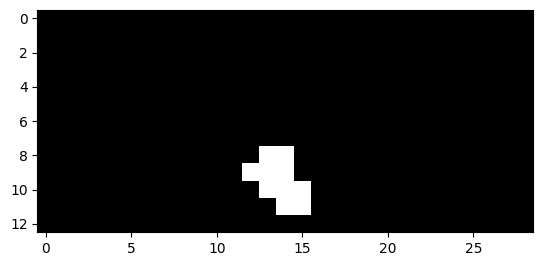

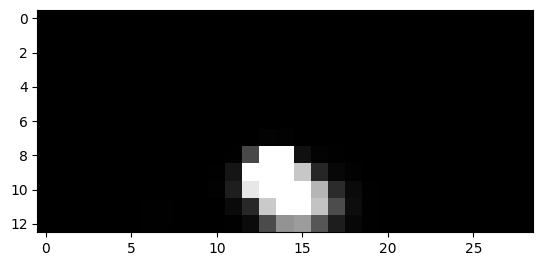

314


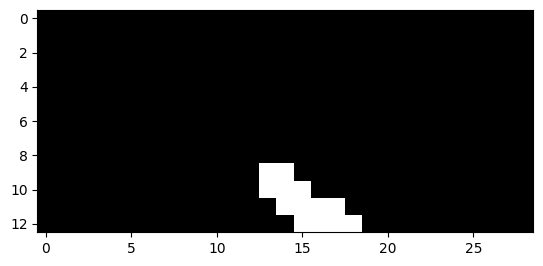

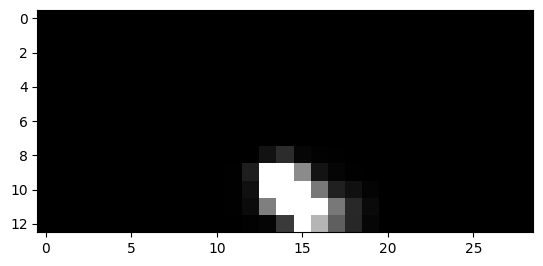

315


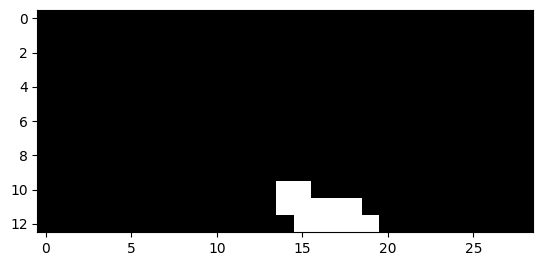

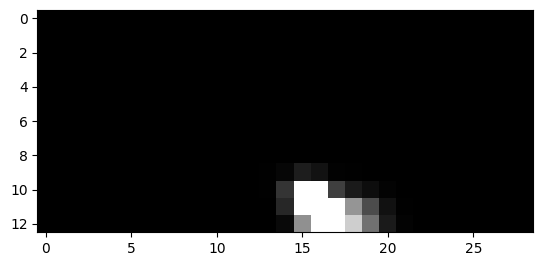

316


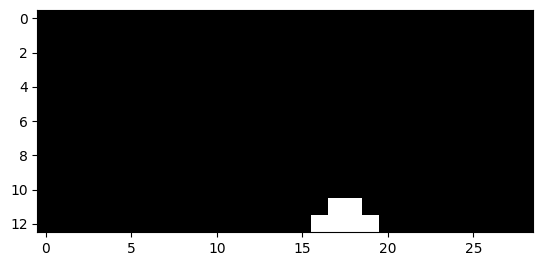

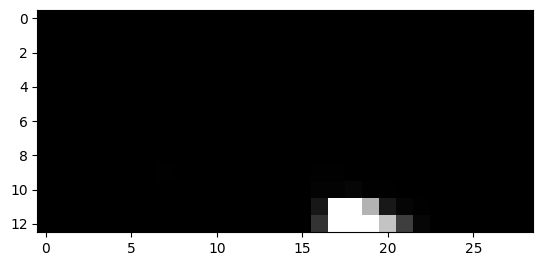

317


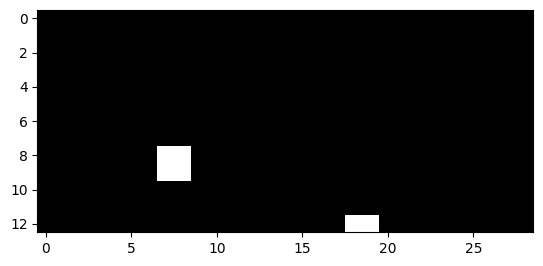

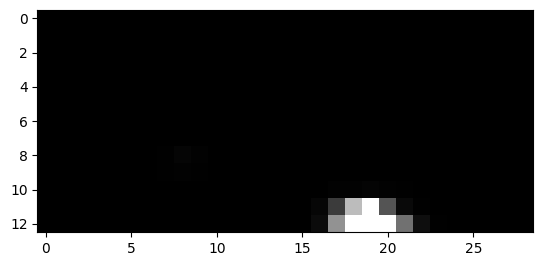

318


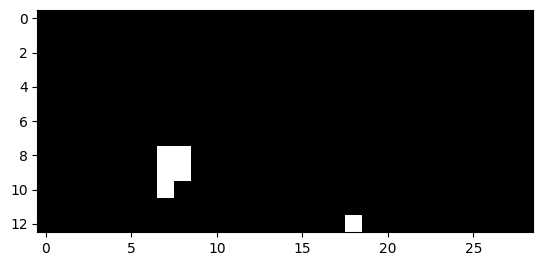

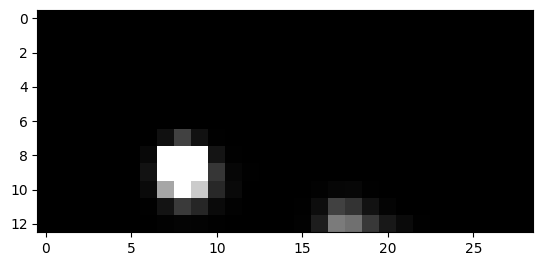

319


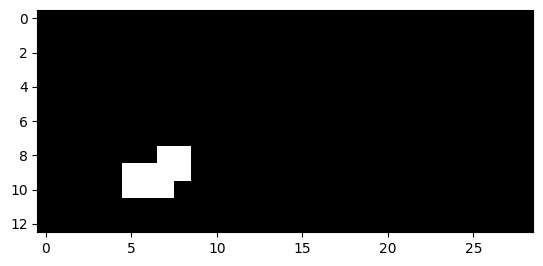

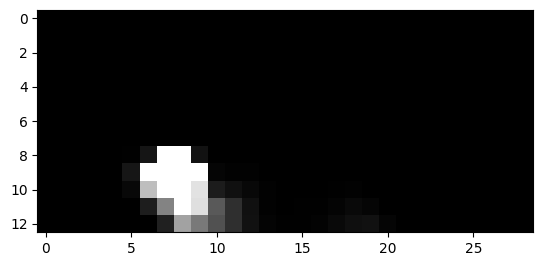

320


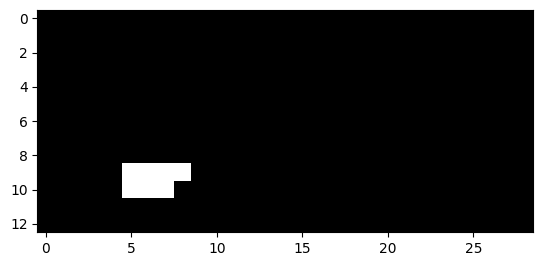

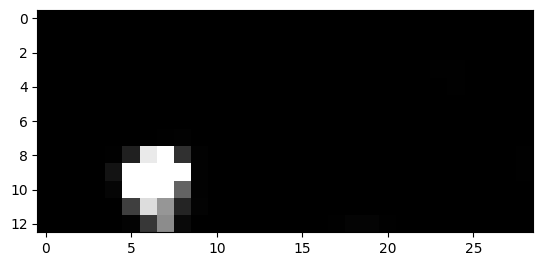

321


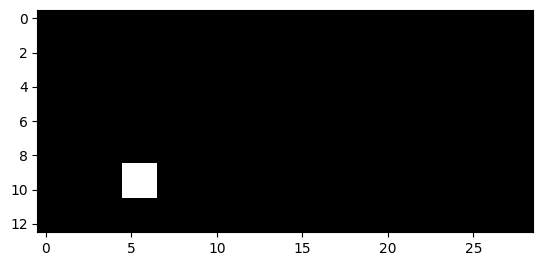

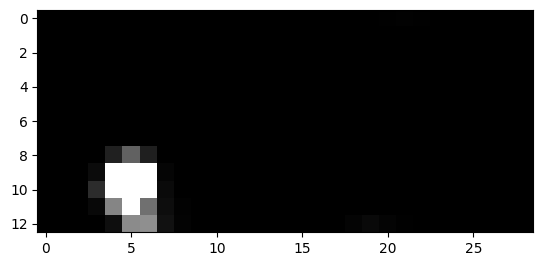

335


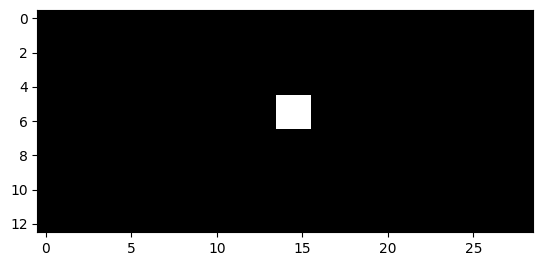

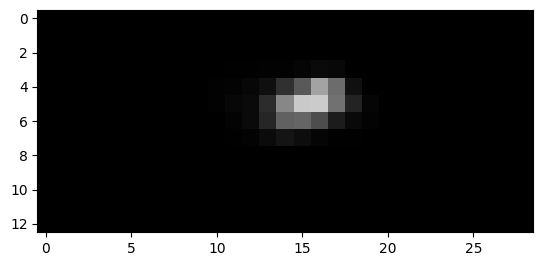

336


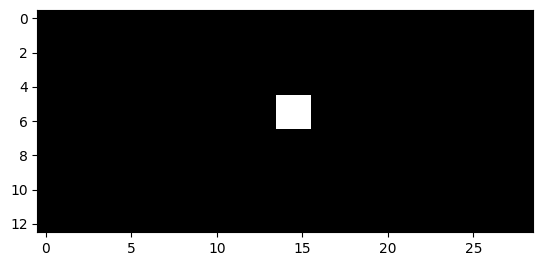

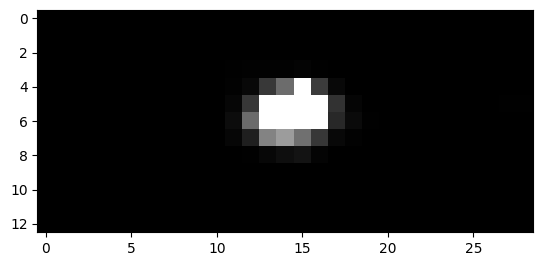

337


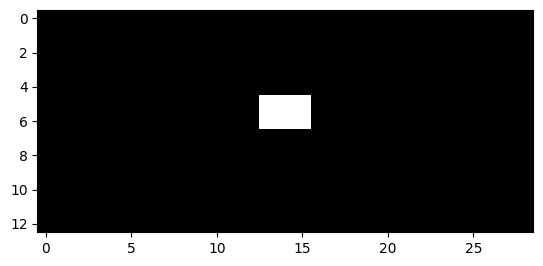

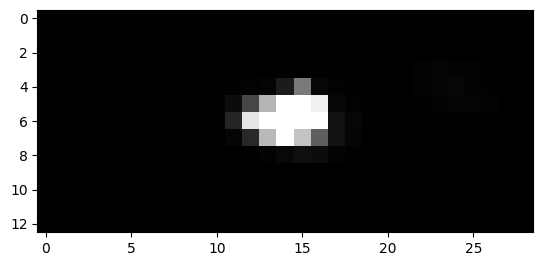

338


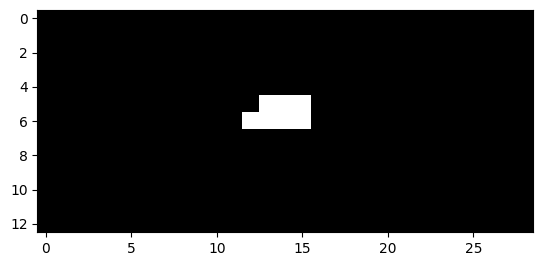

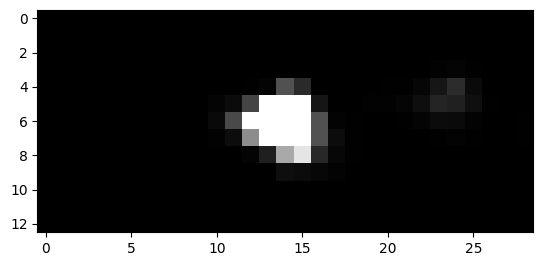

339


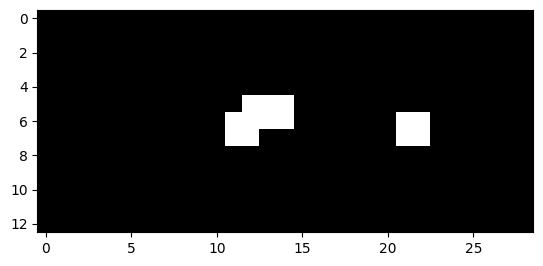

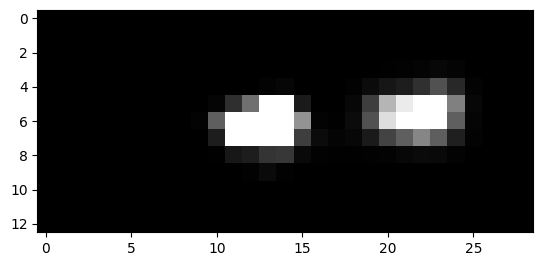

340


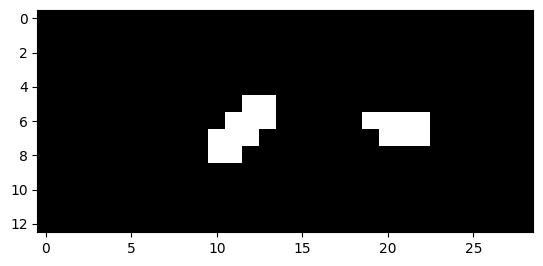

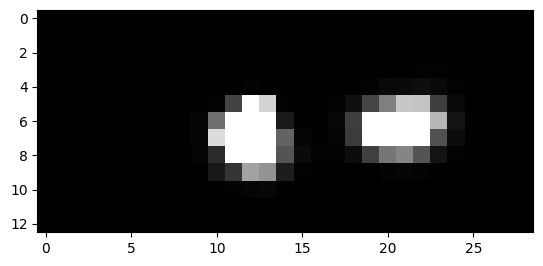

341


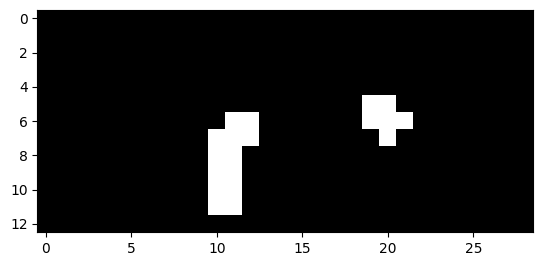

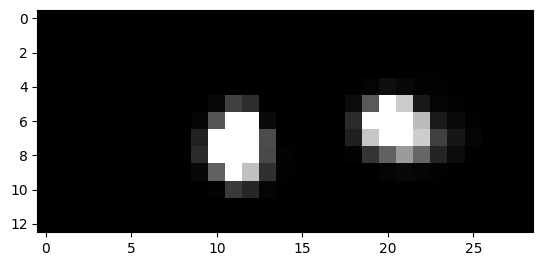

342


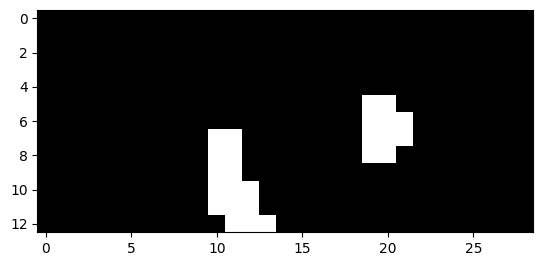

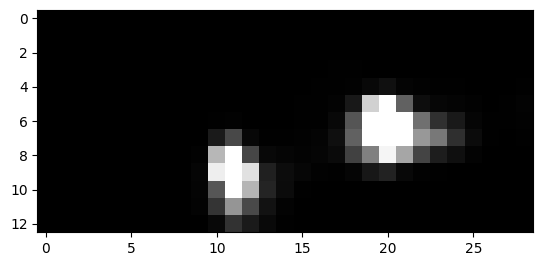

343


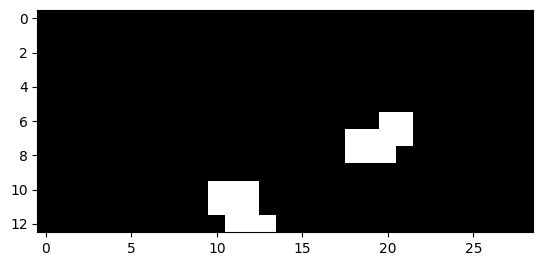

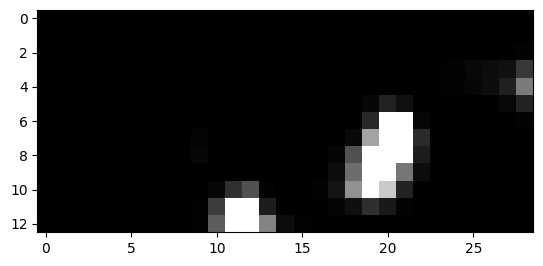

344


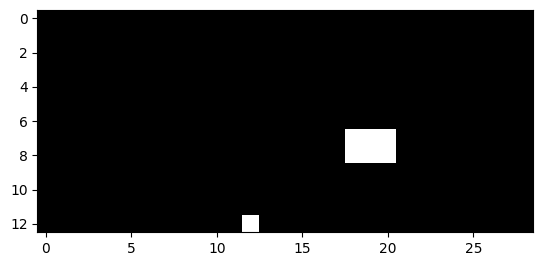

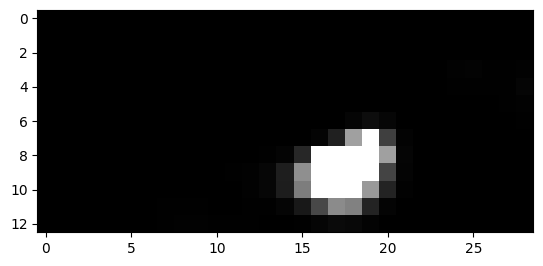

346


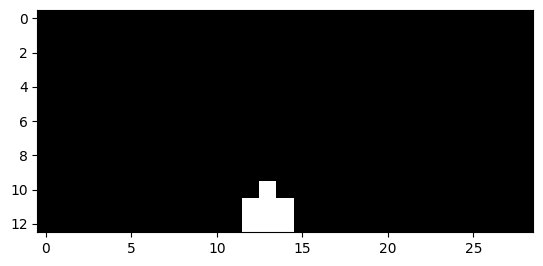

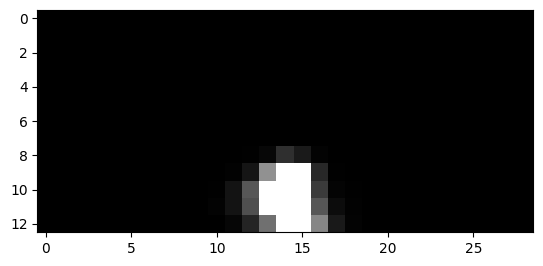

347


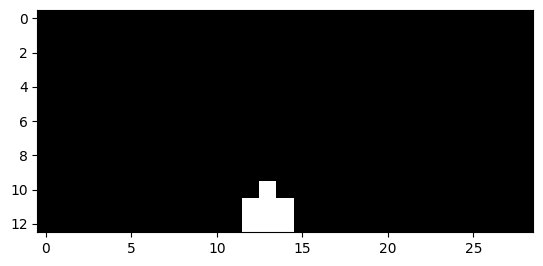

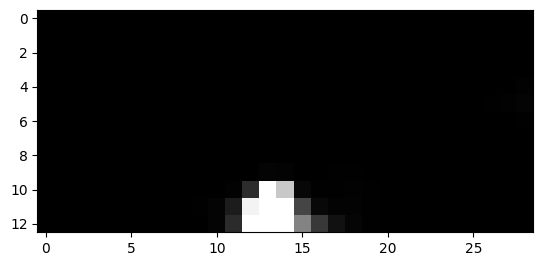

348


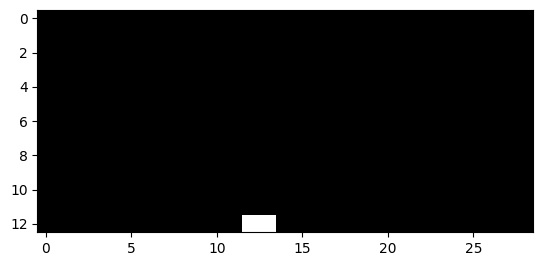

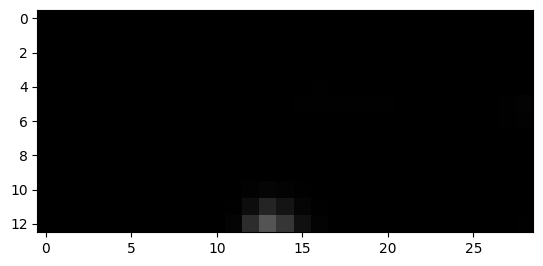

640


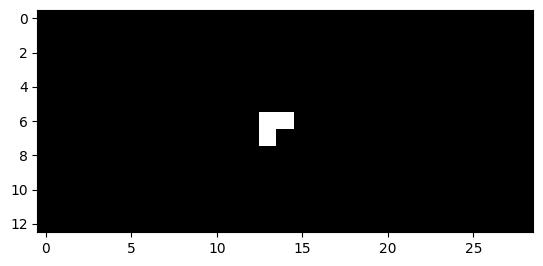

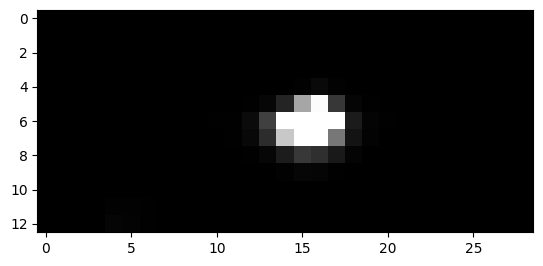

641


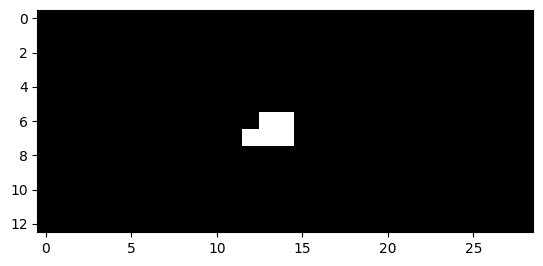

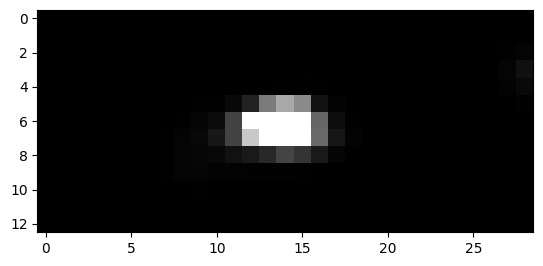

642


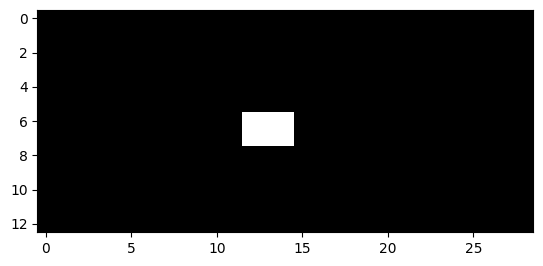

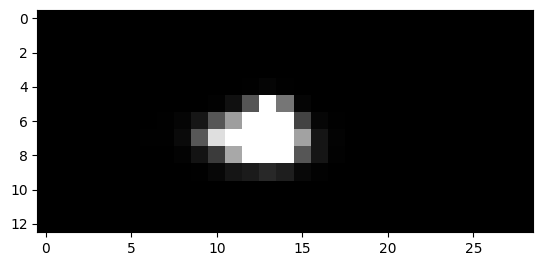

643


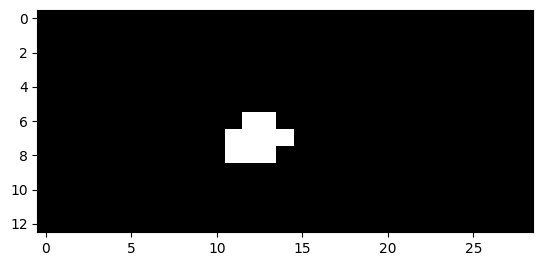

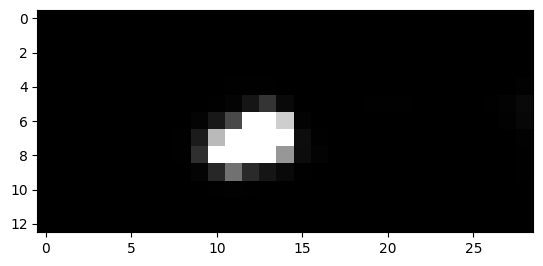

644


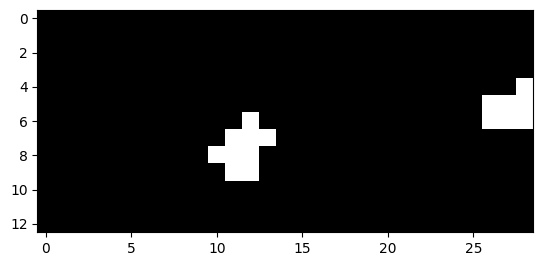

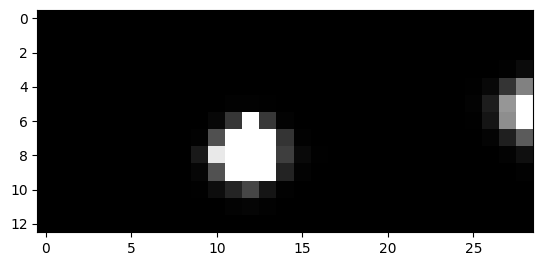

645


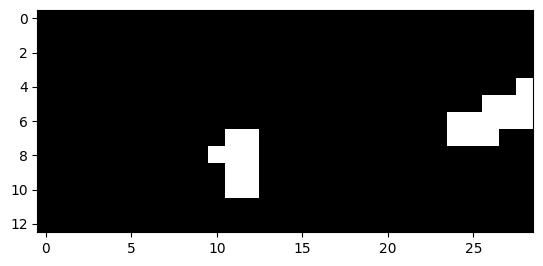

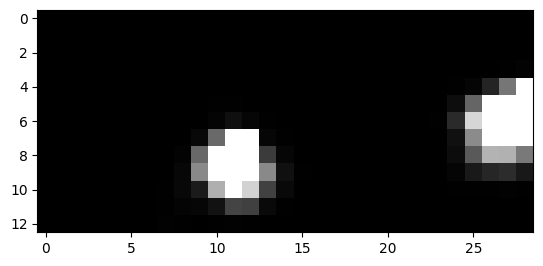

646


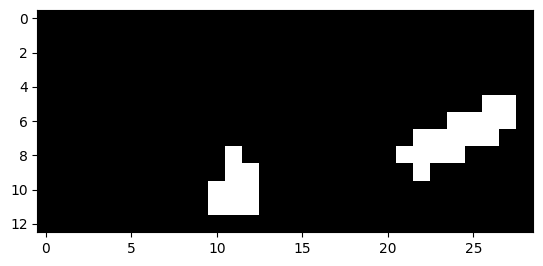

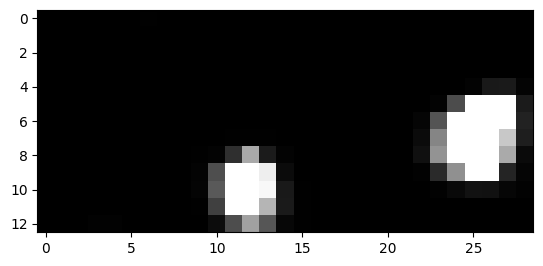

647


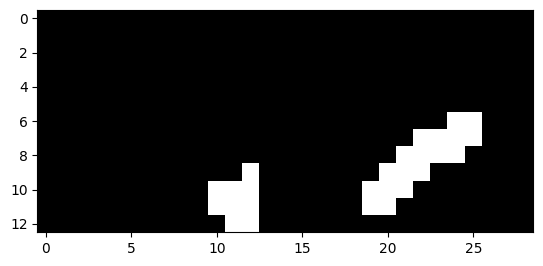

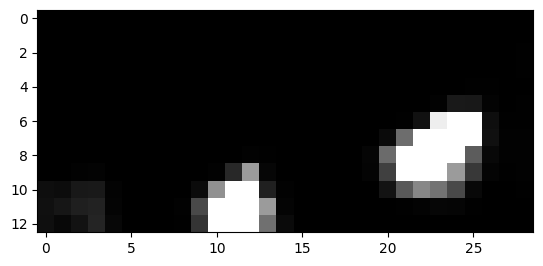

648


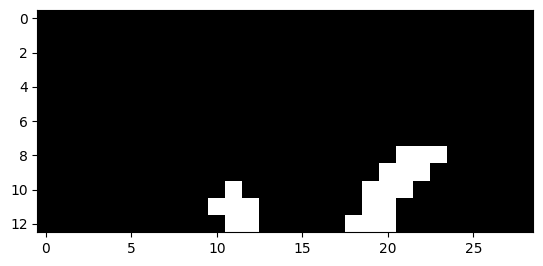

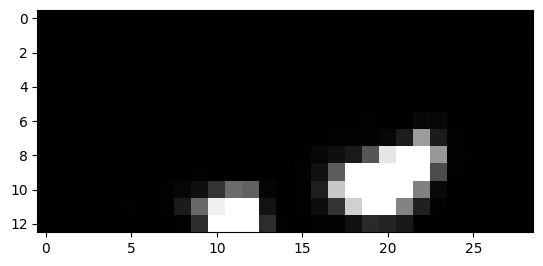

649


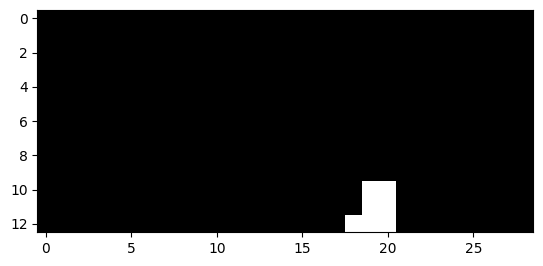

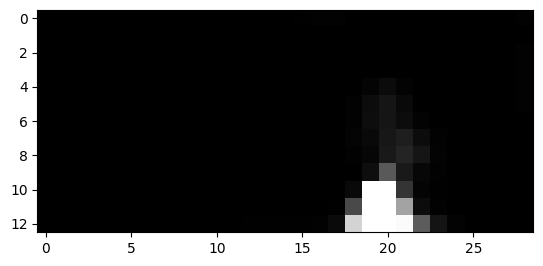

651


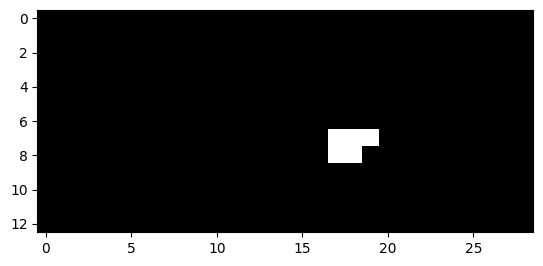

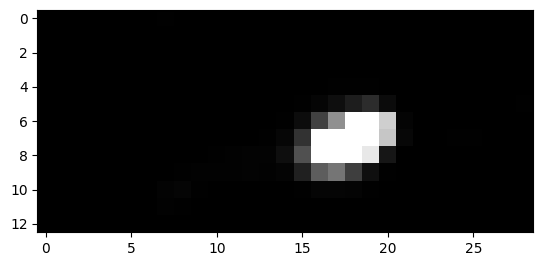

652


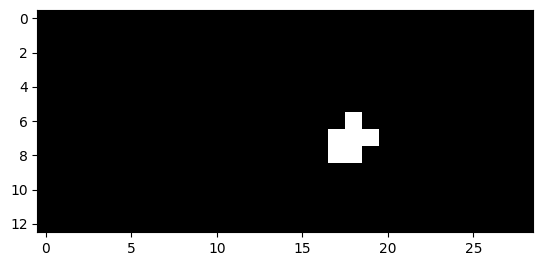

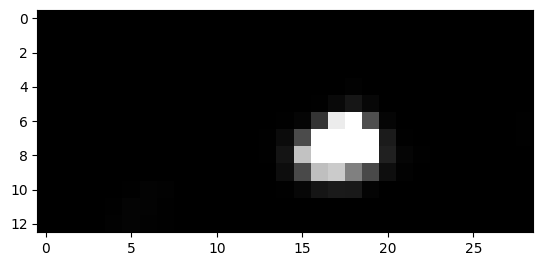

653


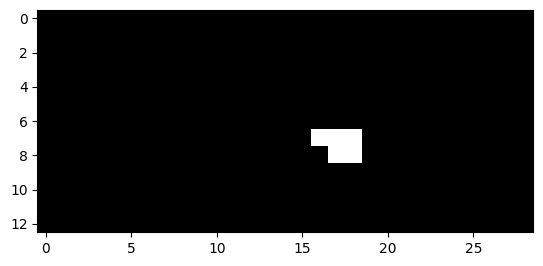

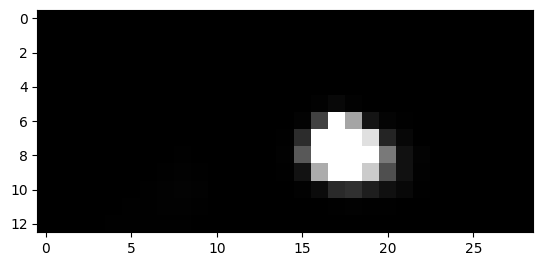

654


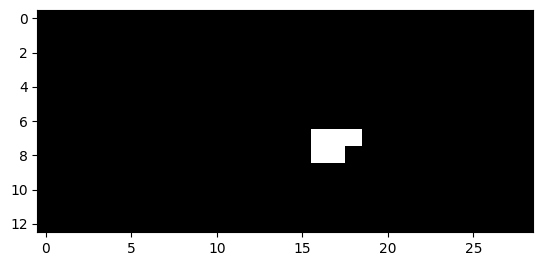

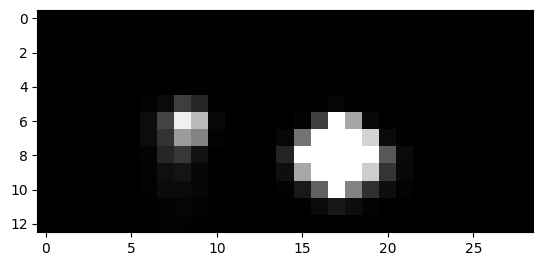

655


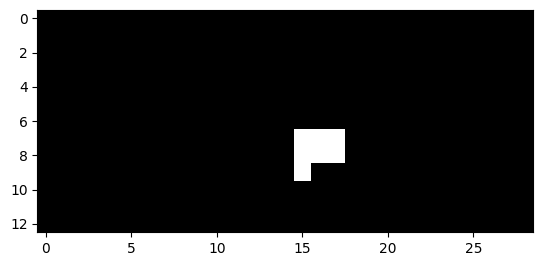

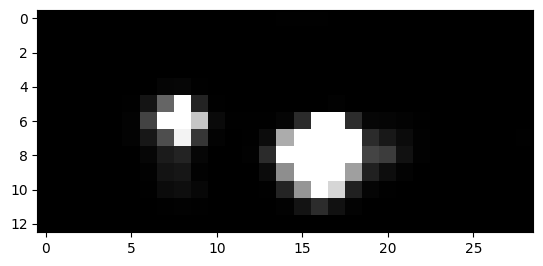

656


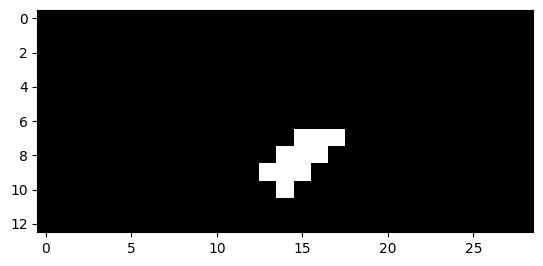

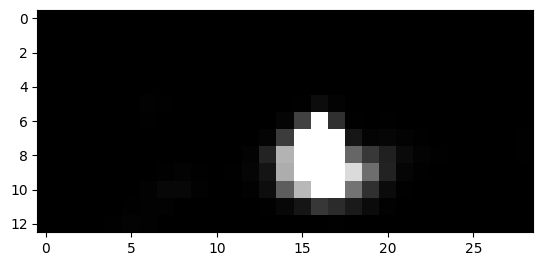

657


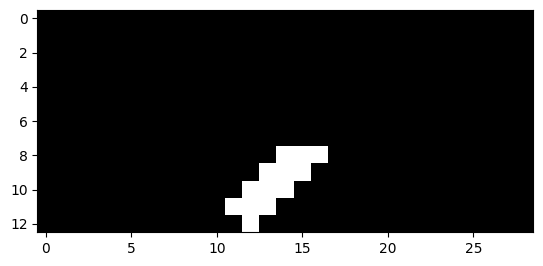

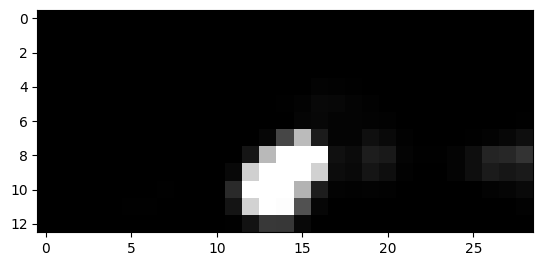

658


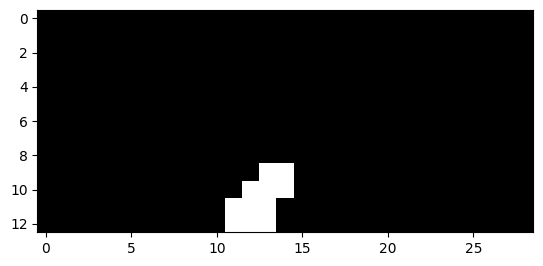

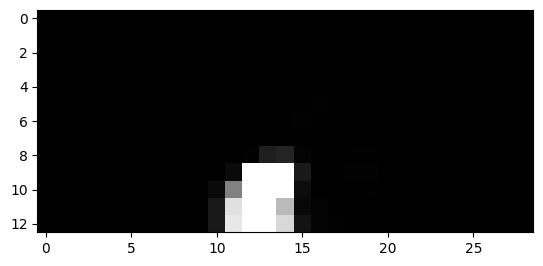

659


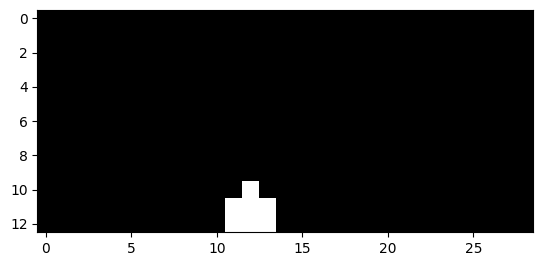

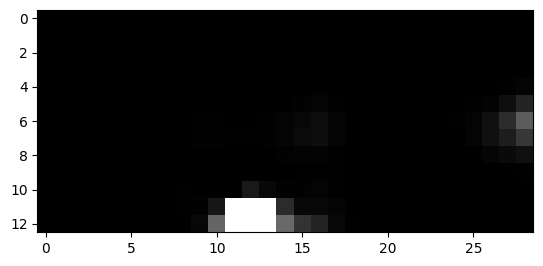

665


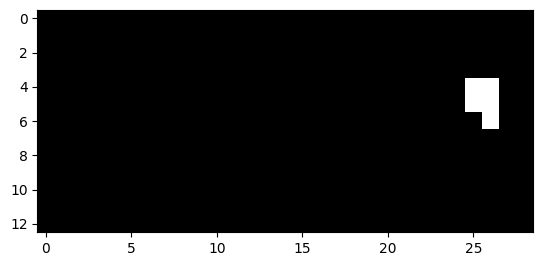

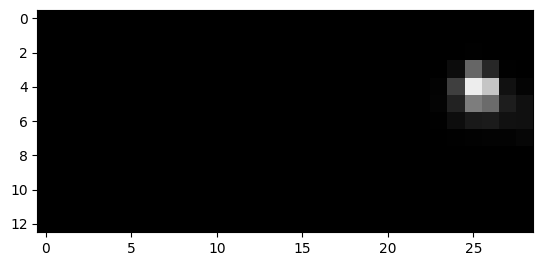

666


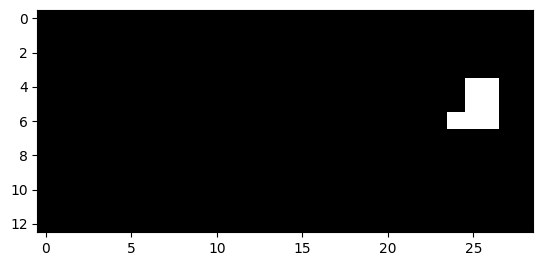

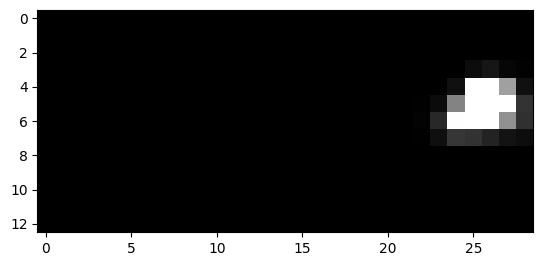

667


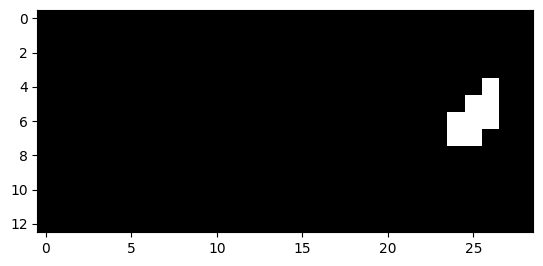

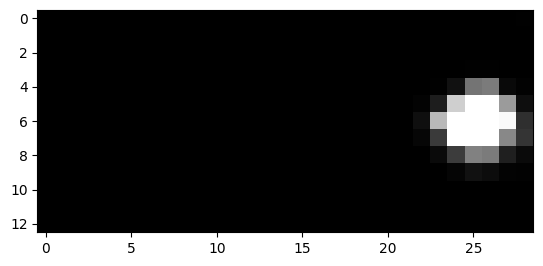

668


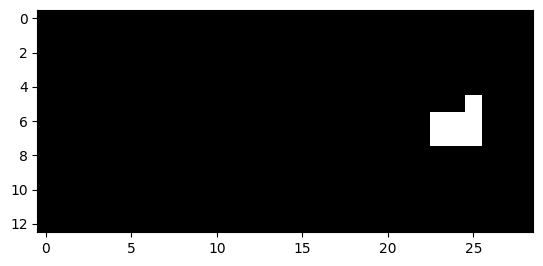

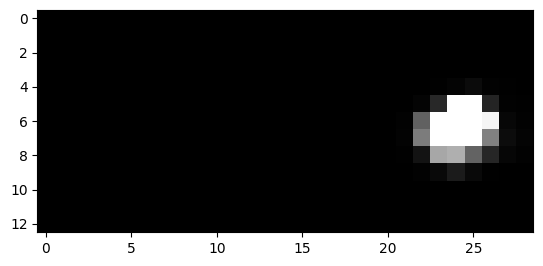

669


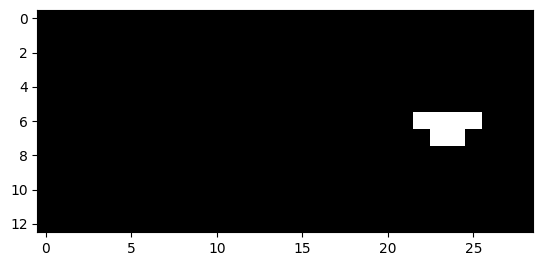

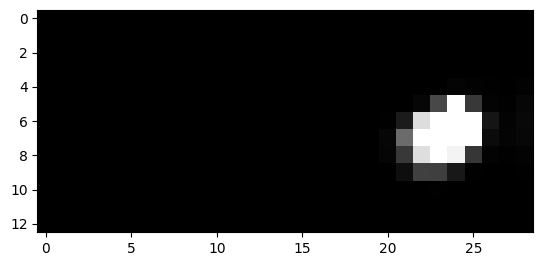

670


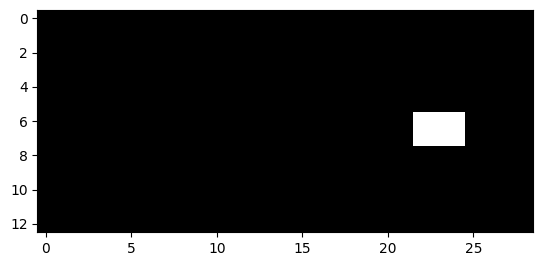

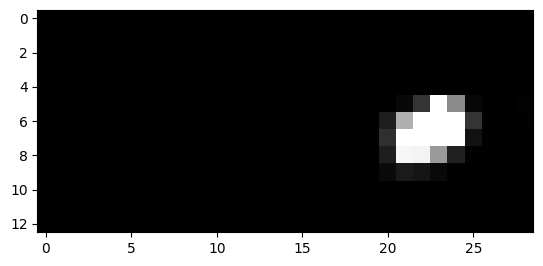

671


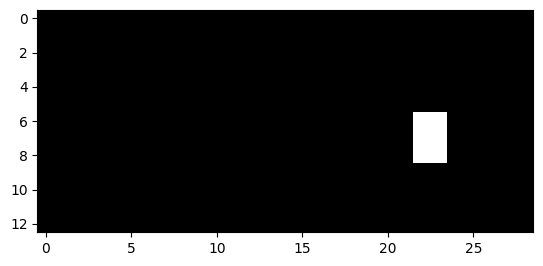

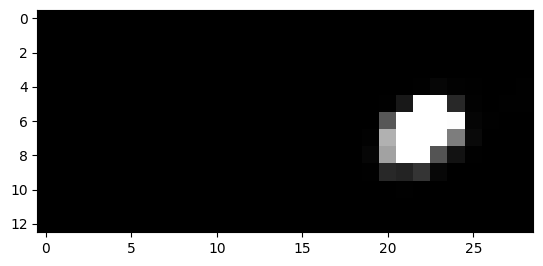

672


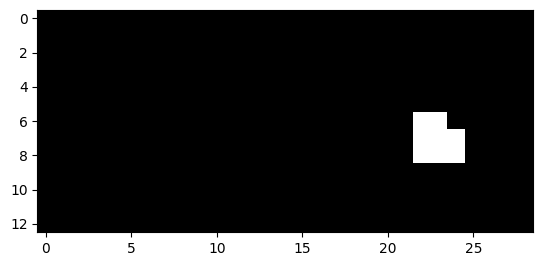

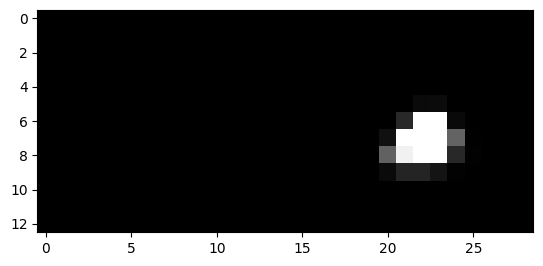

673


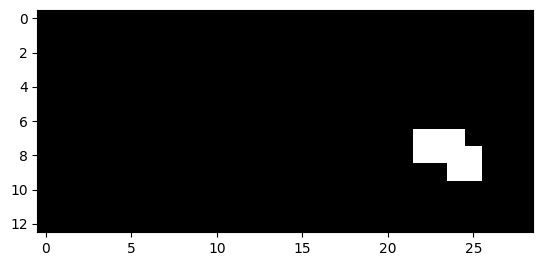

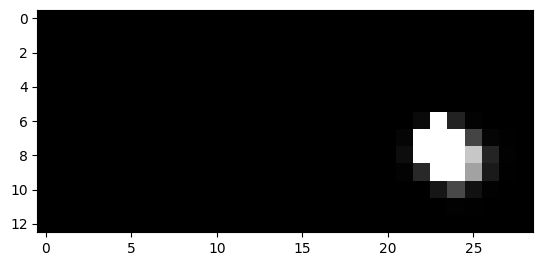

674


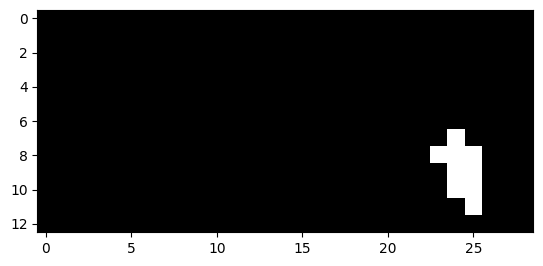

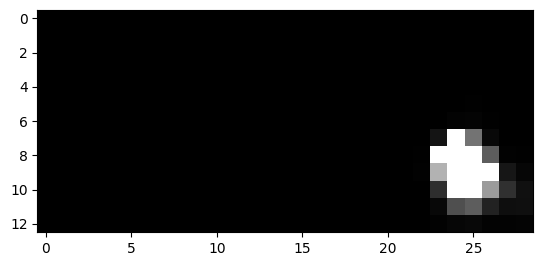

675


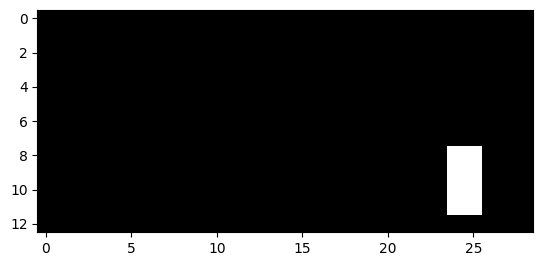

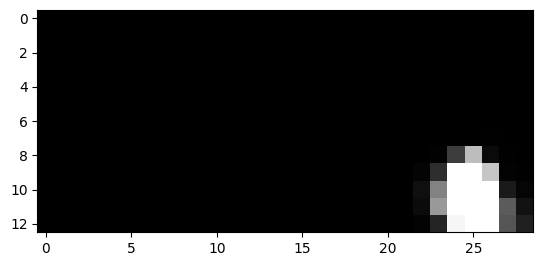

676


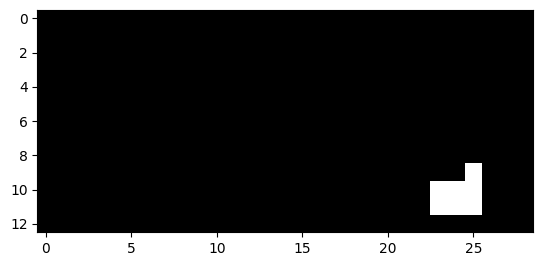

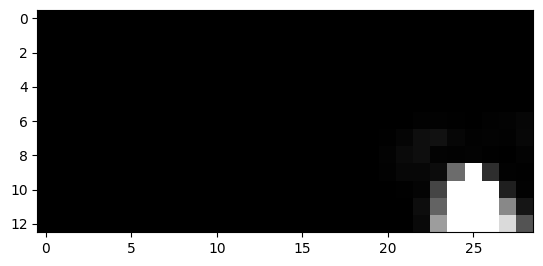

677


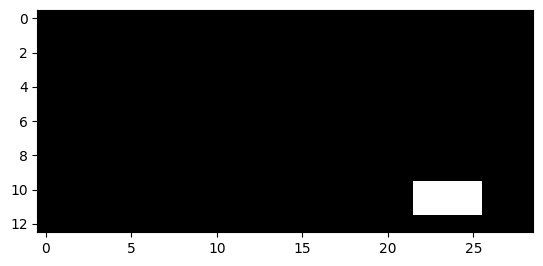

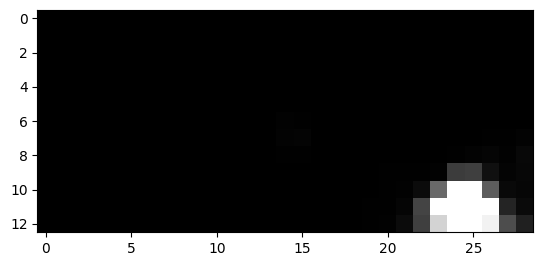

678


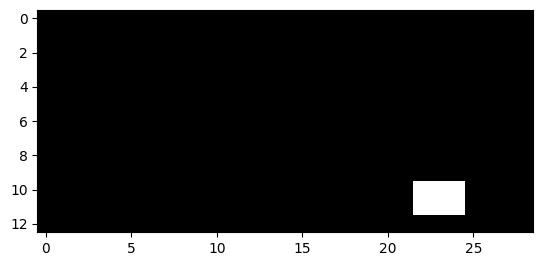

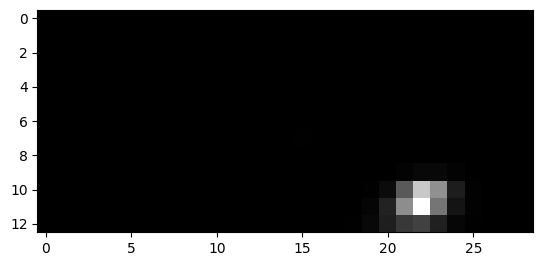

699


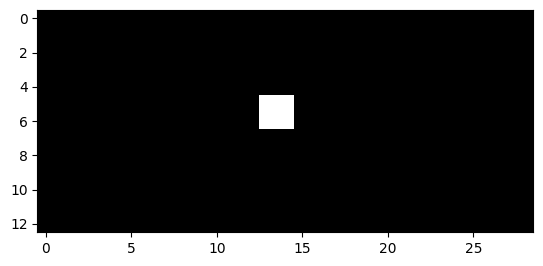

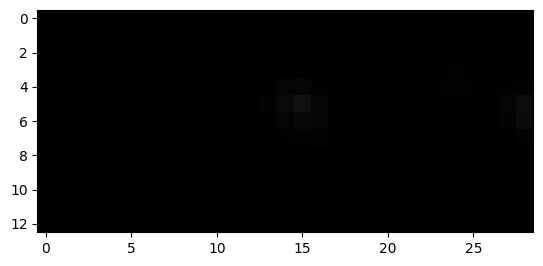

700


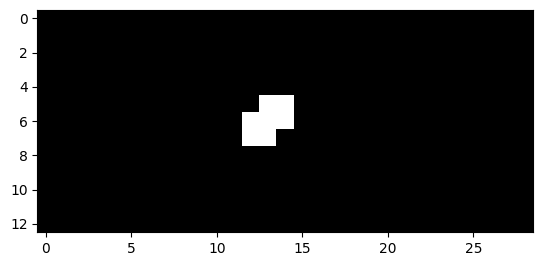

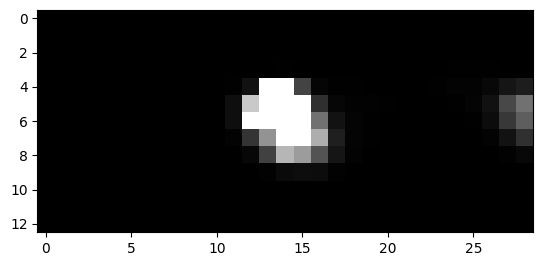

701


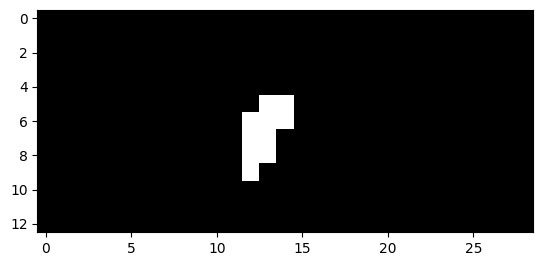

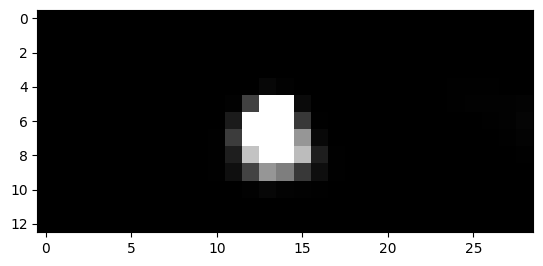

702


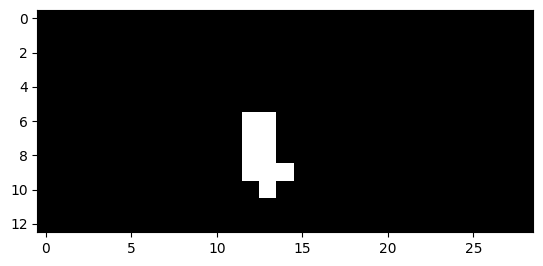

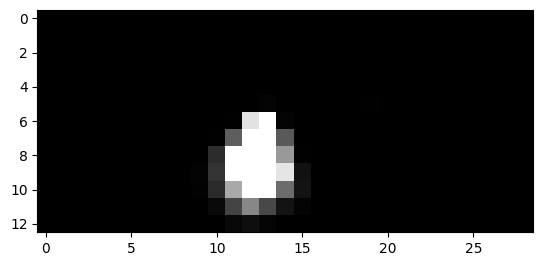

703


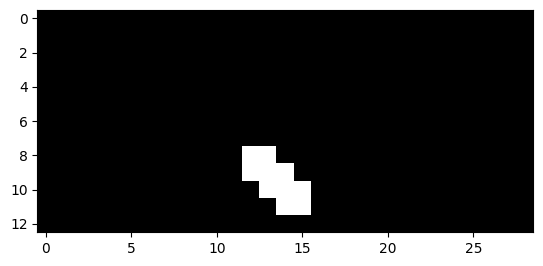

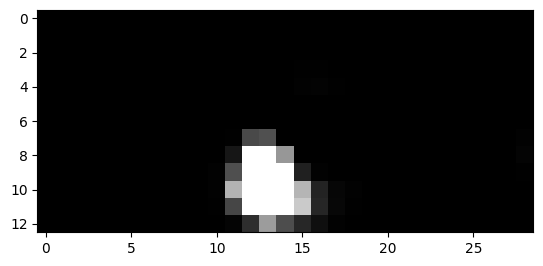

704


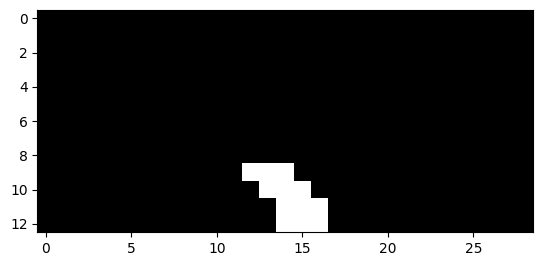

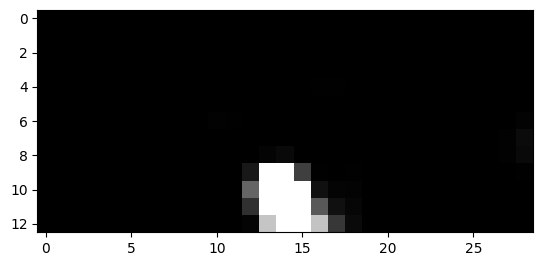

705


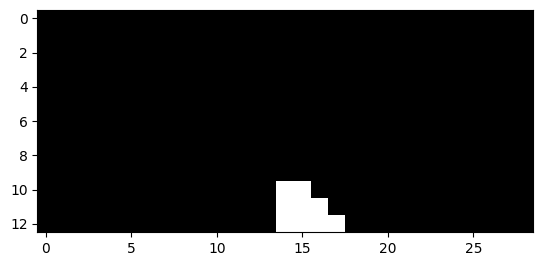

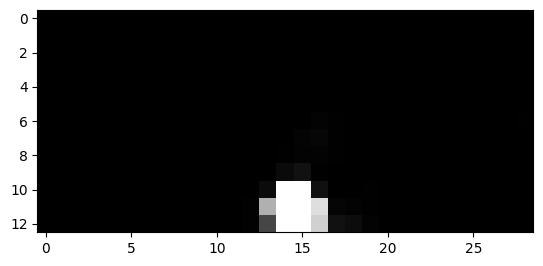

706


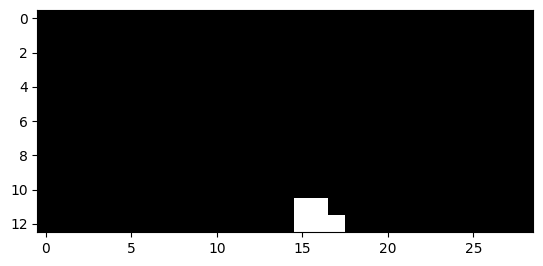

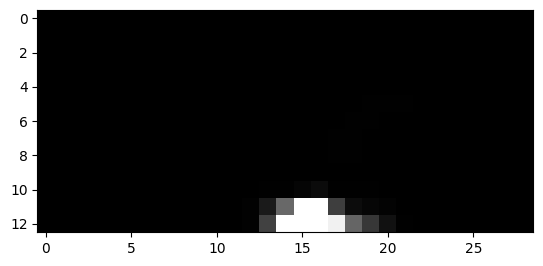

711


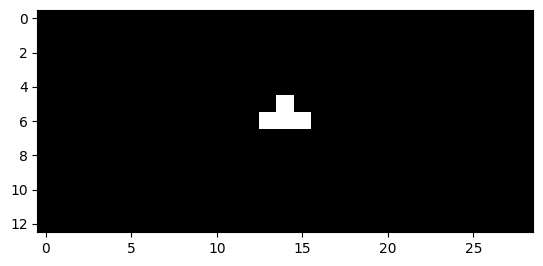

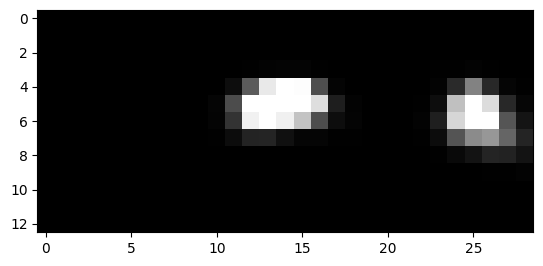

712


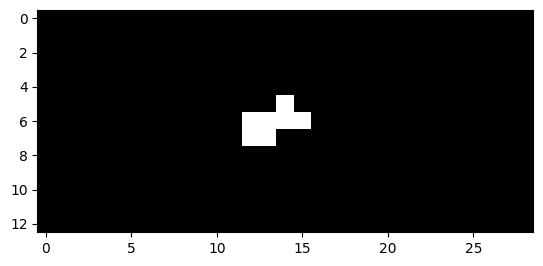

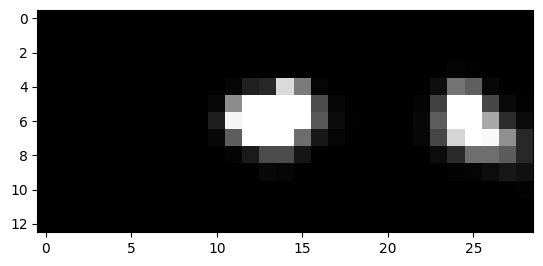

713


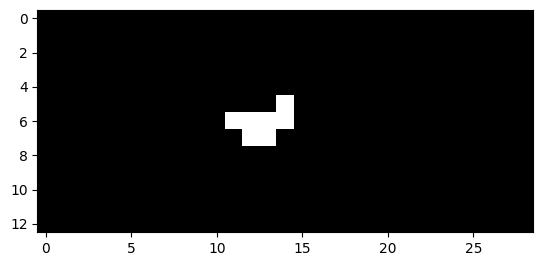

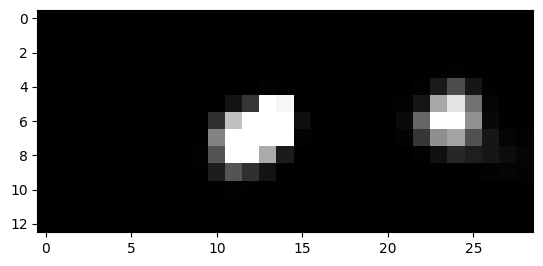

714


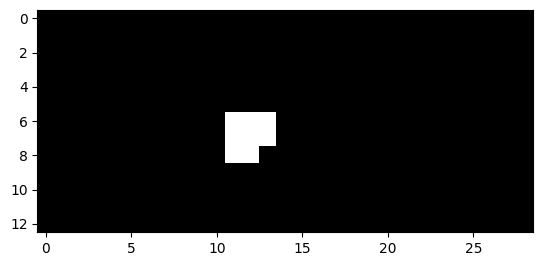

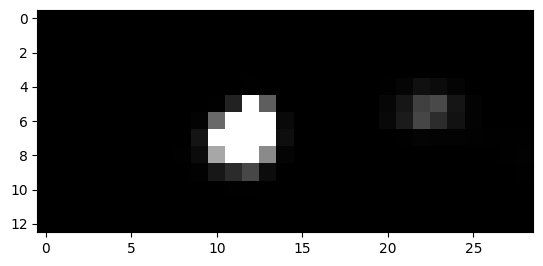

715


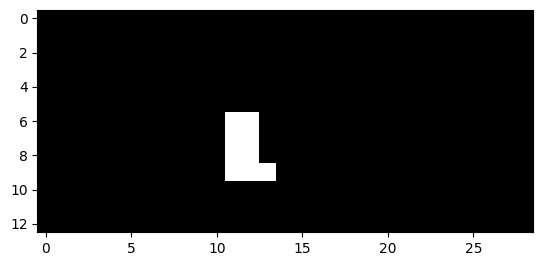

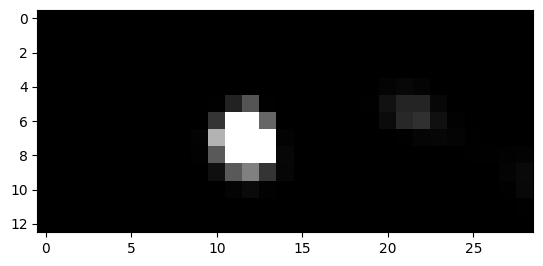

716


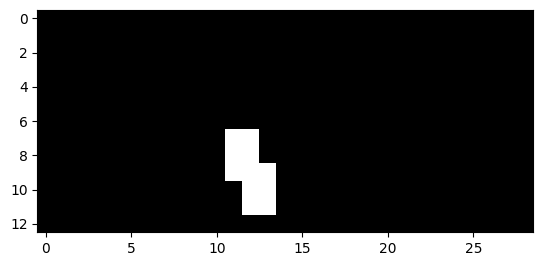

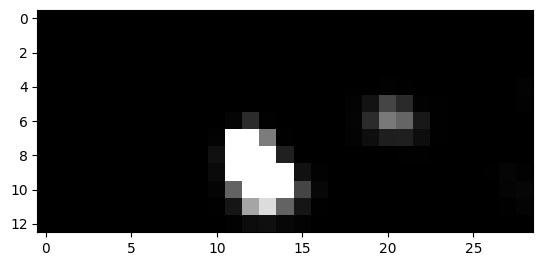

717


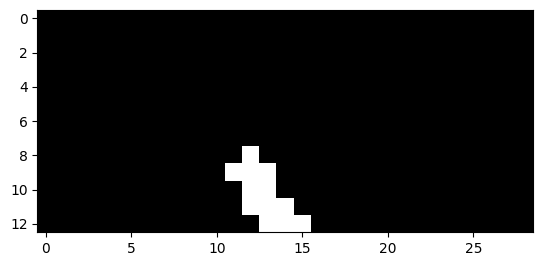

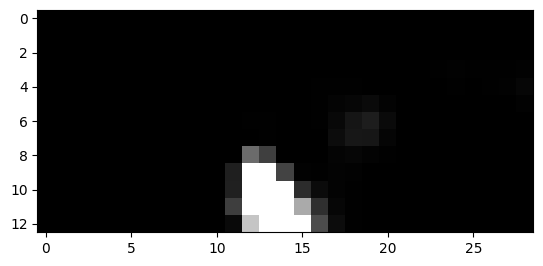

718


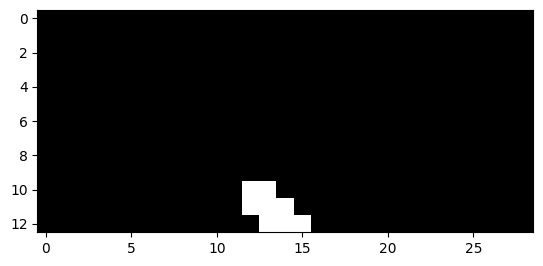

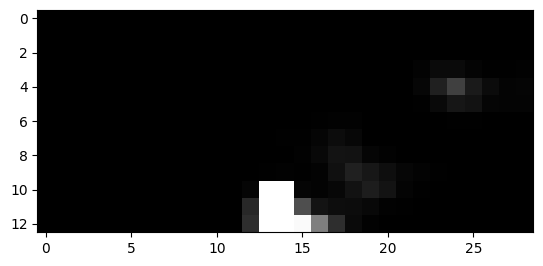

719


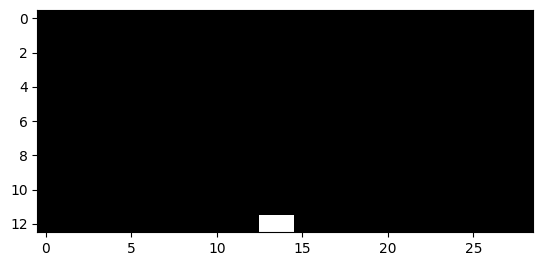

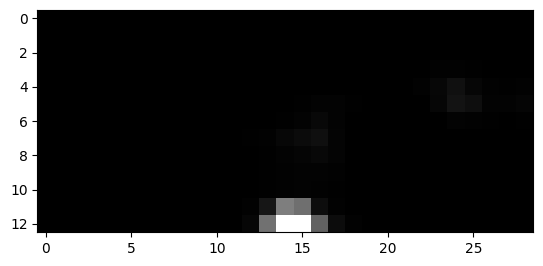

751


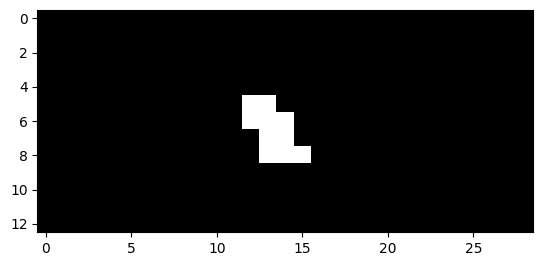

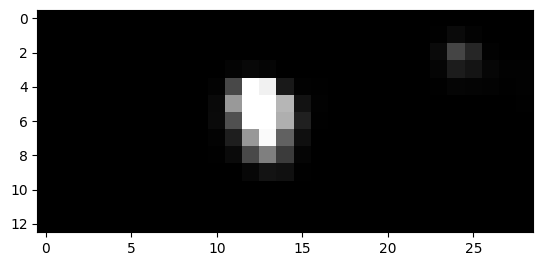

752


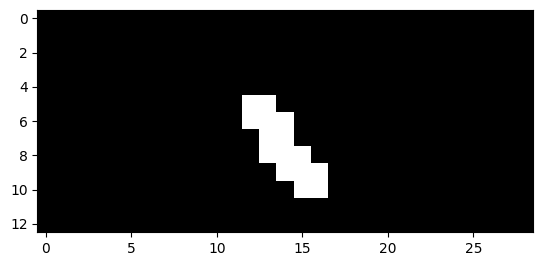

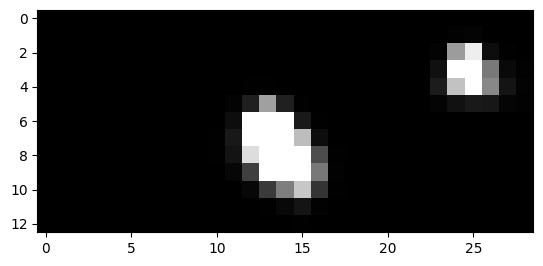

753


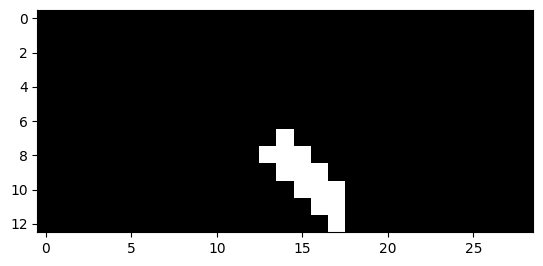

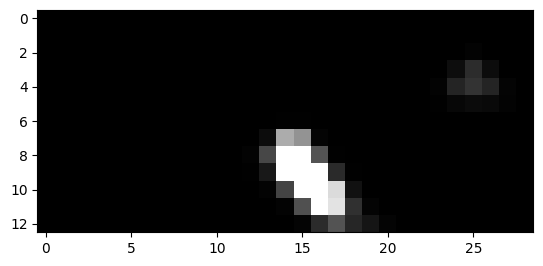

754


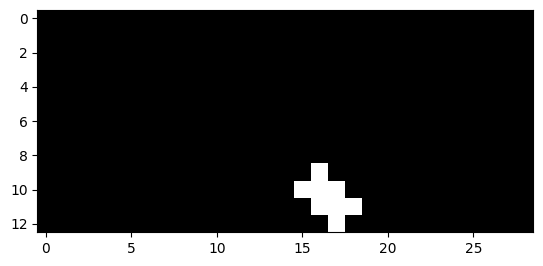

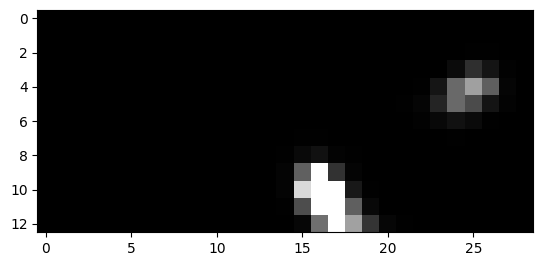

755


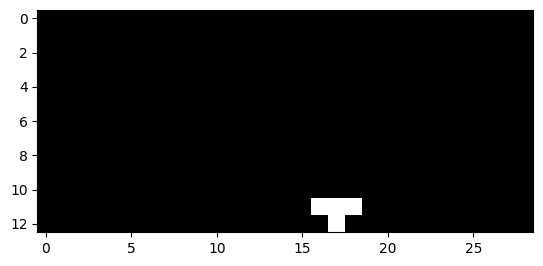

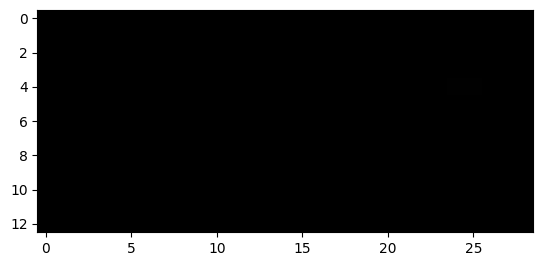

756


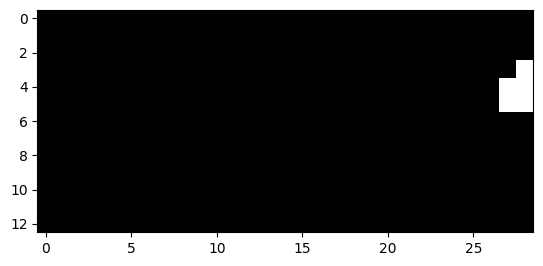

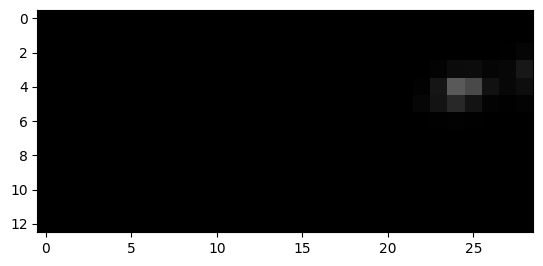

757


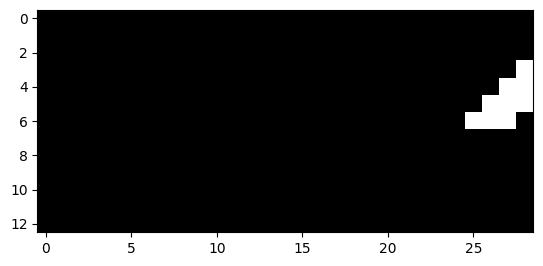

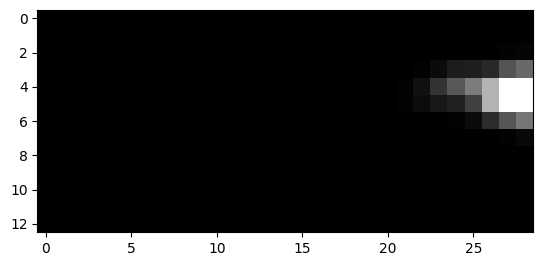

758


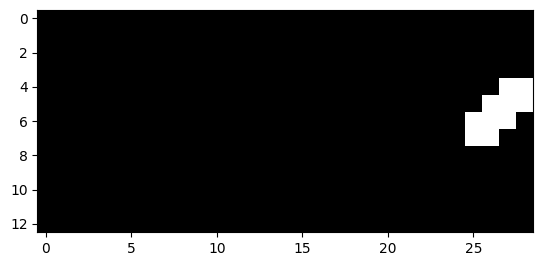

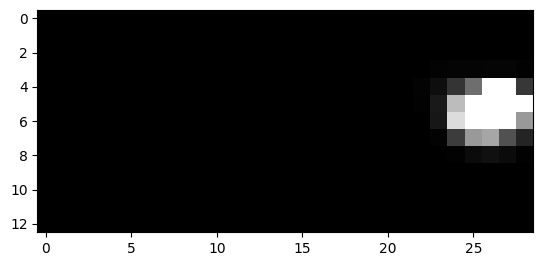

759


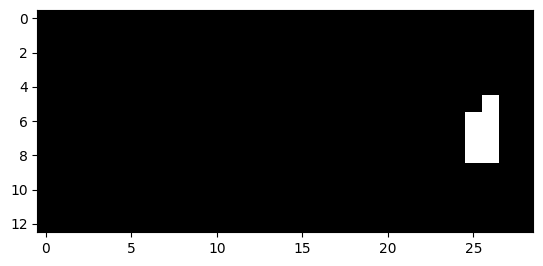

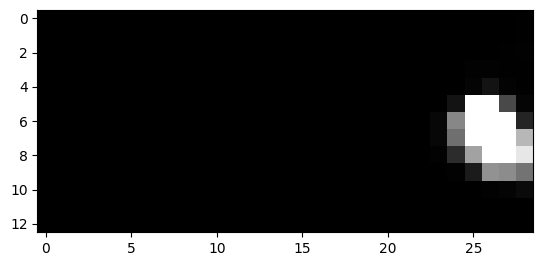

760


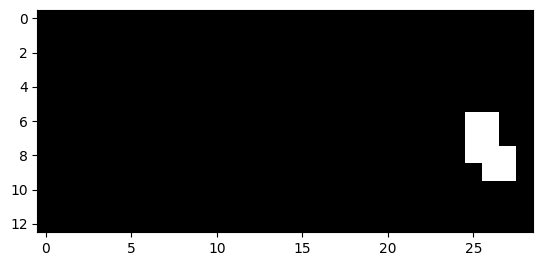

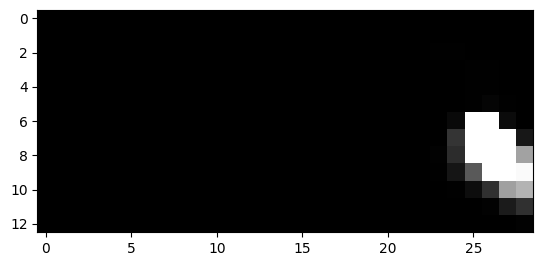

761


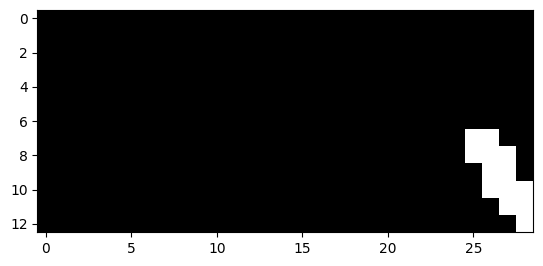

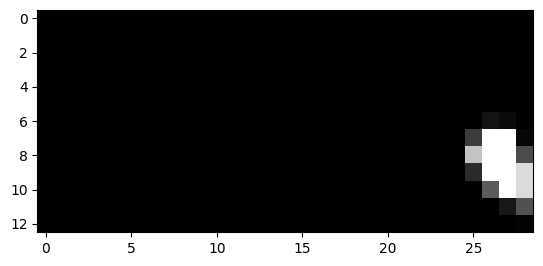

762


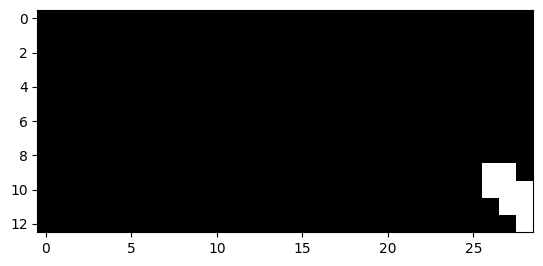

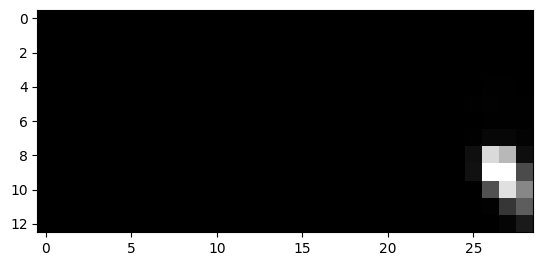

763


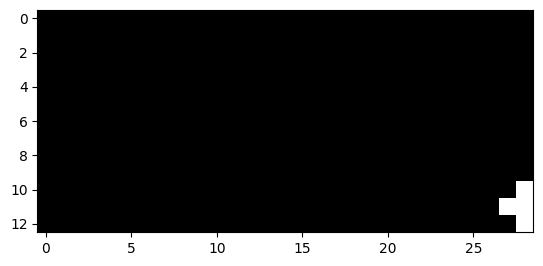

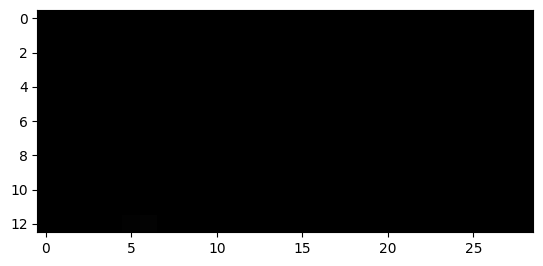

896


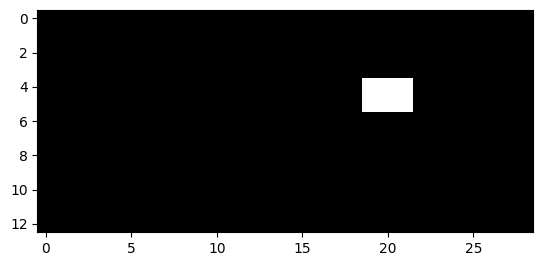

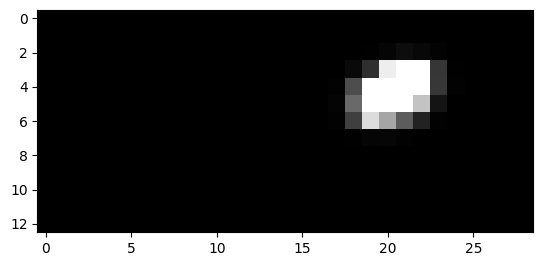

897


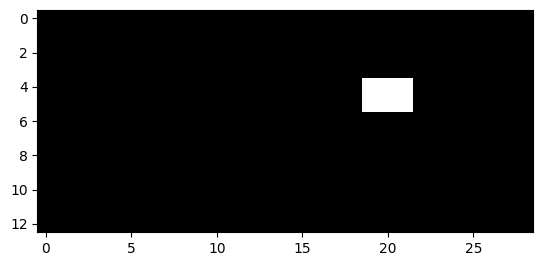

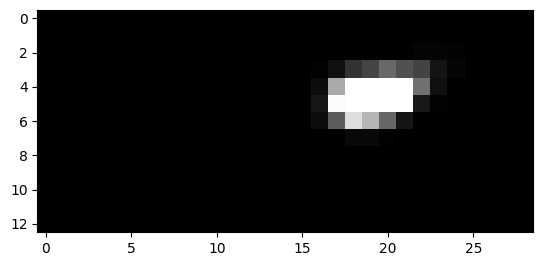

948


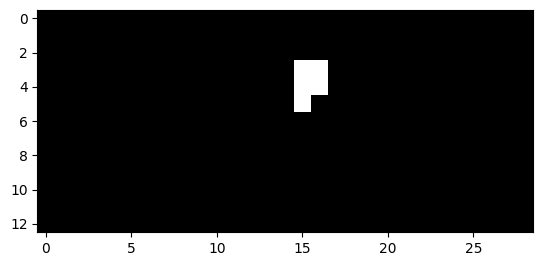

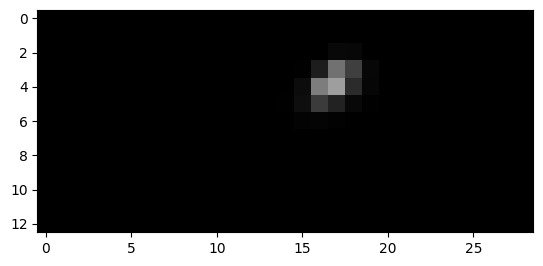

949


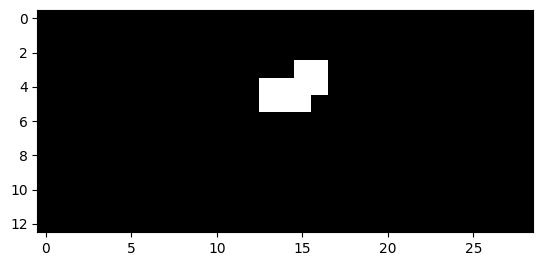

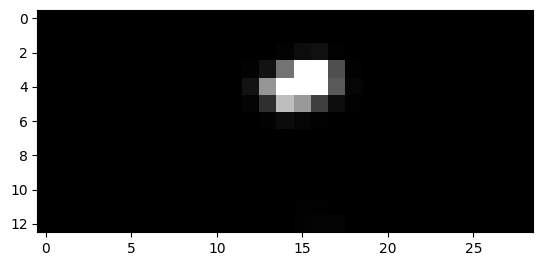

950


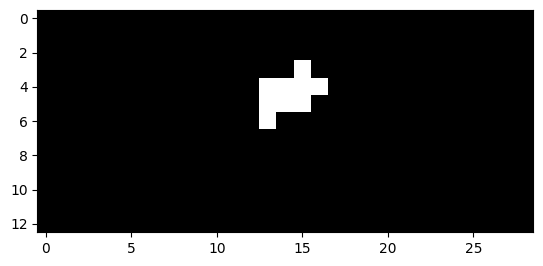

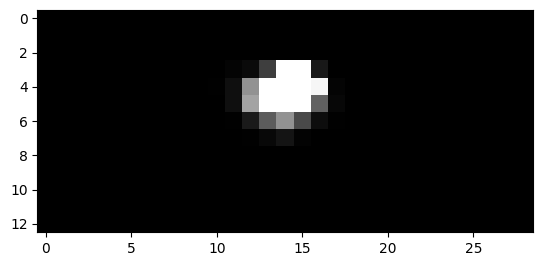

951


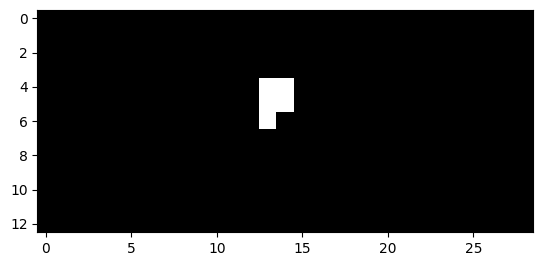

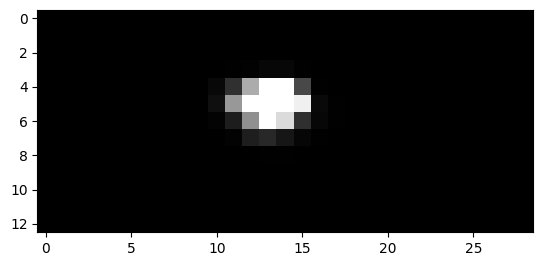

952


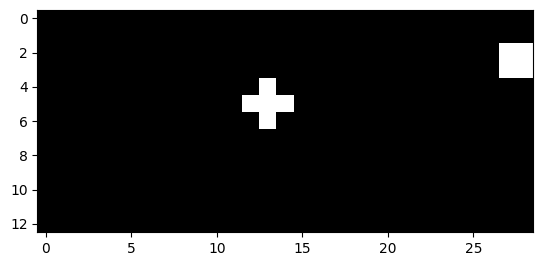

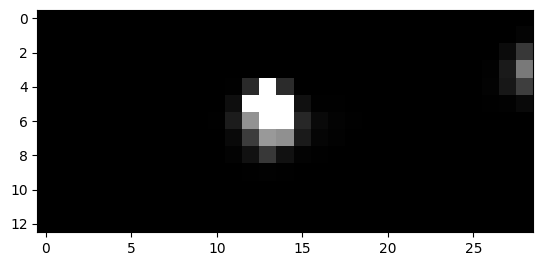

953


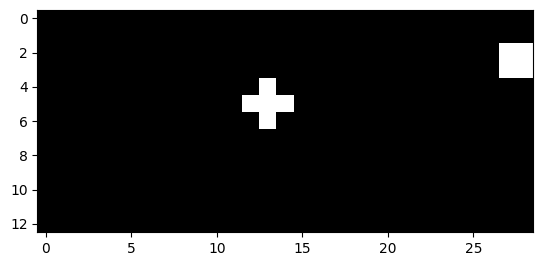

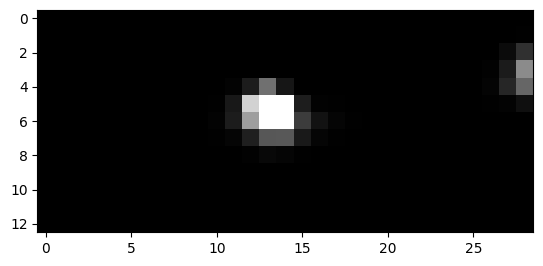

954


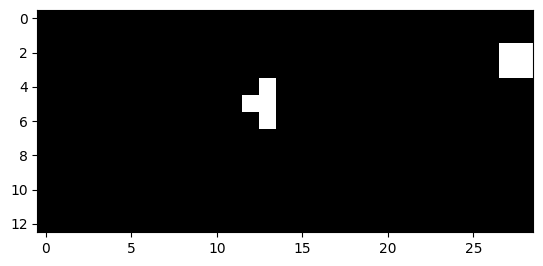

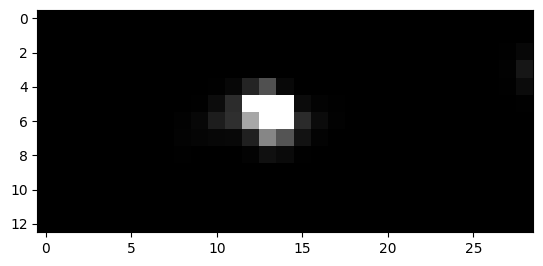

955


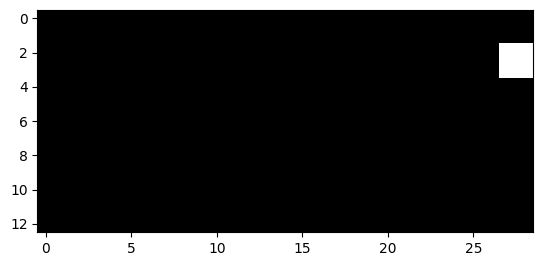

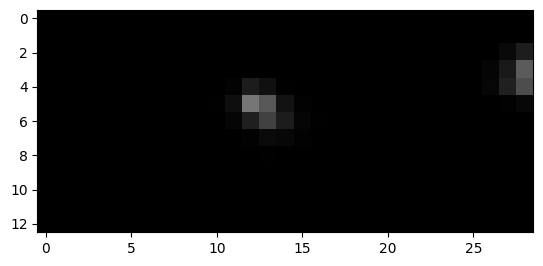

959


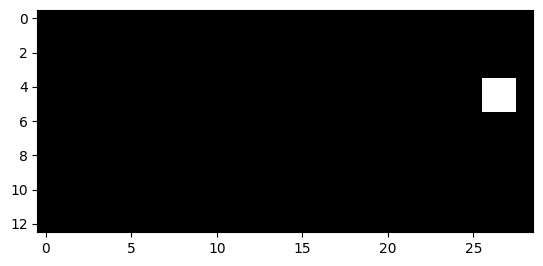

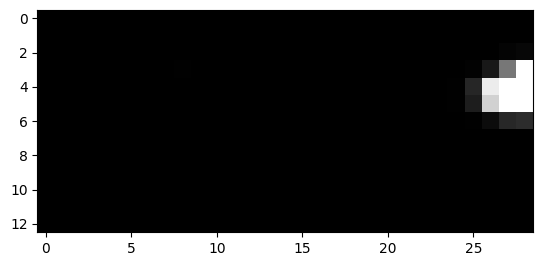

960


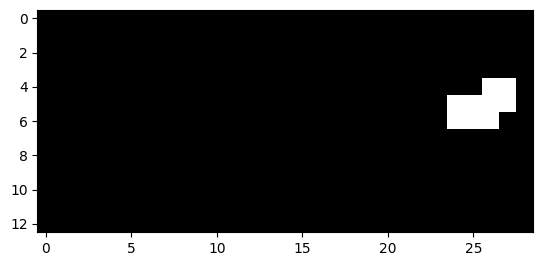

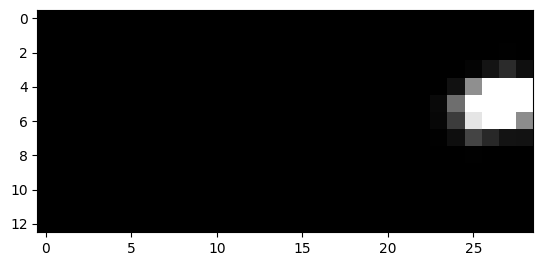

961


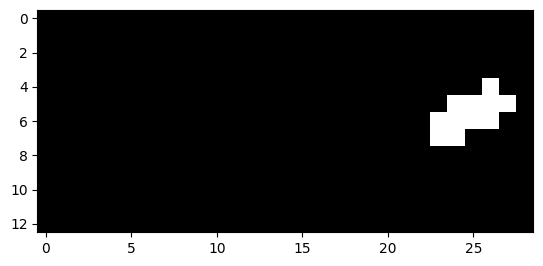

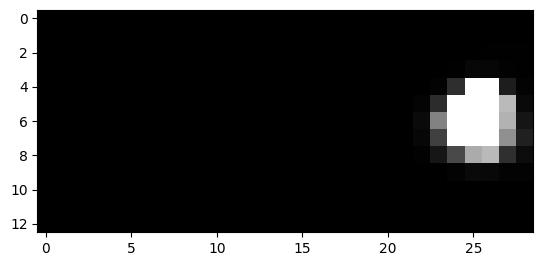

962


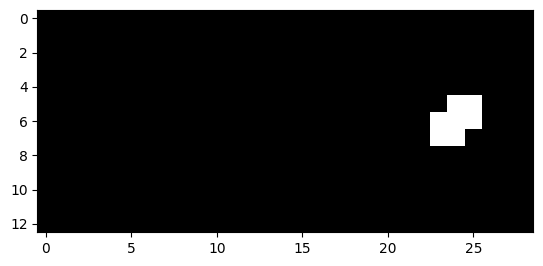

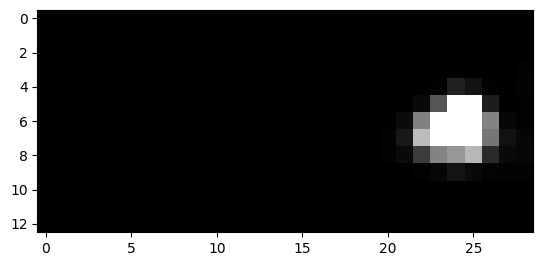

987


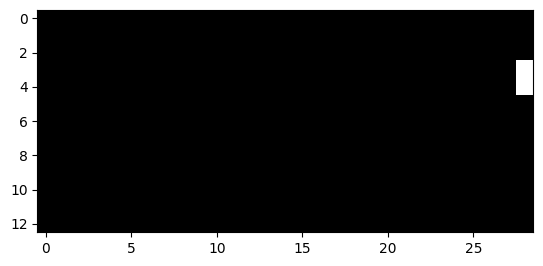

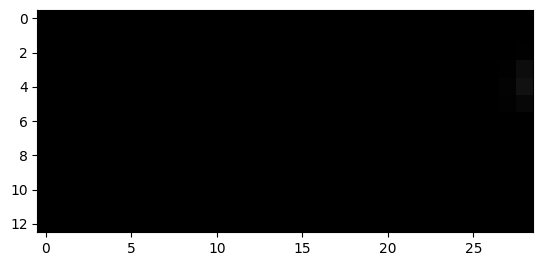

988


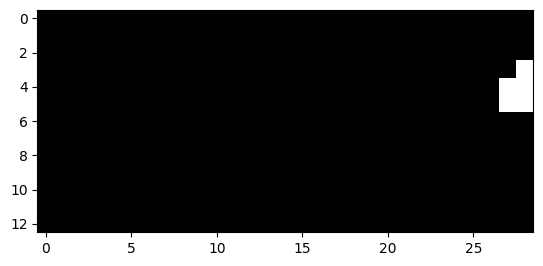

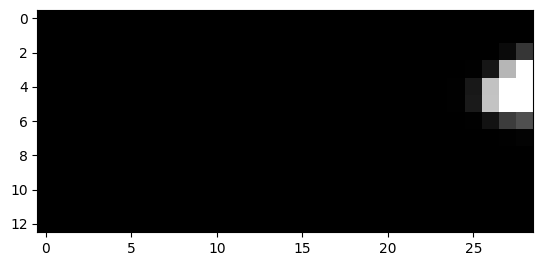

989


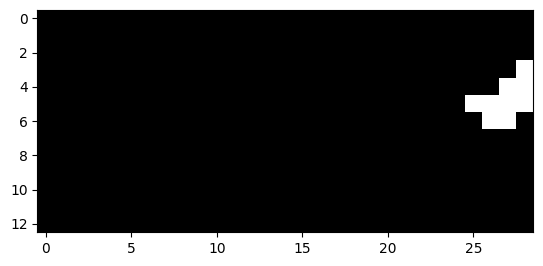

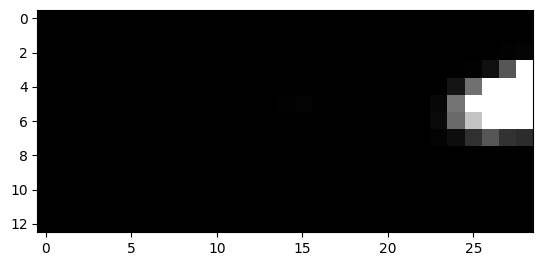

990


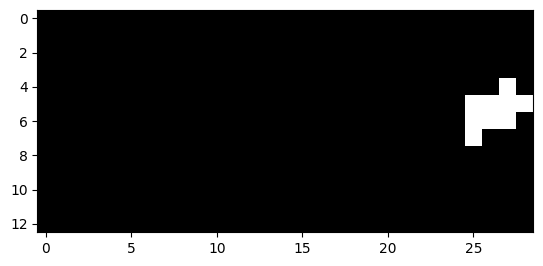

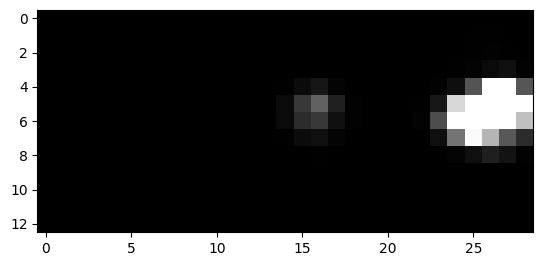

991


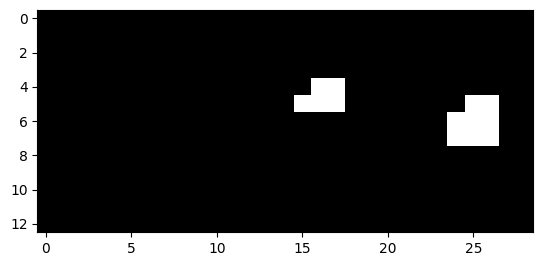

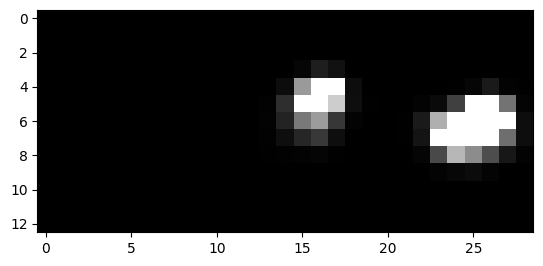

992


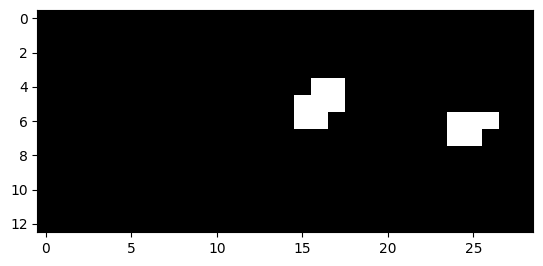

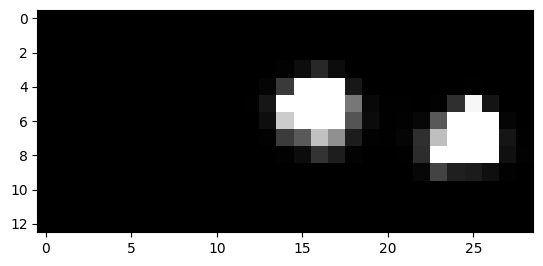

993


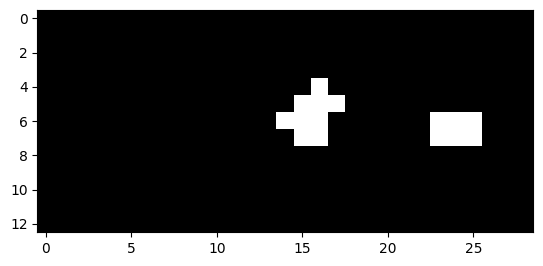

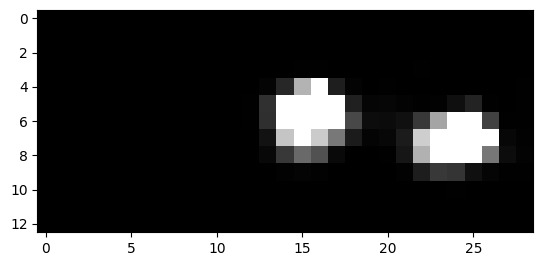

994


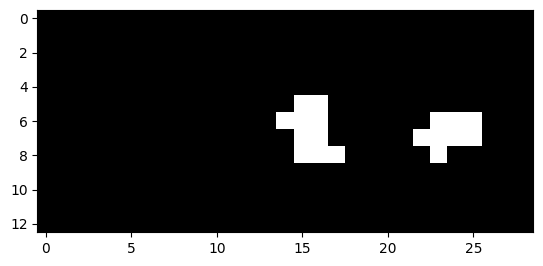

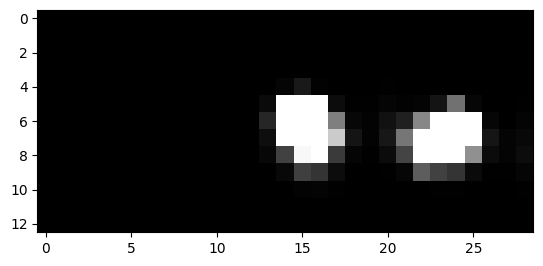

995


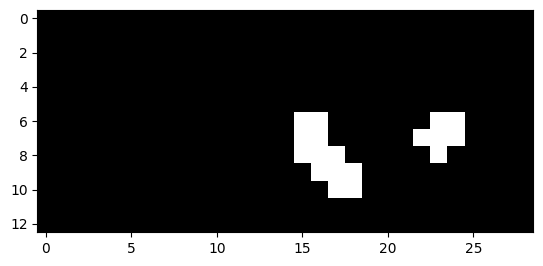

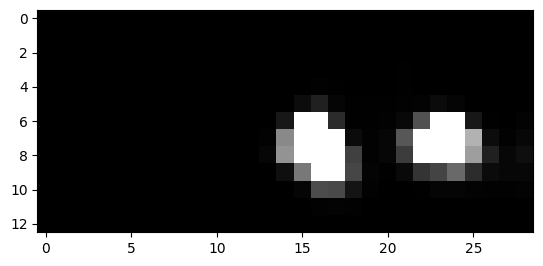

996


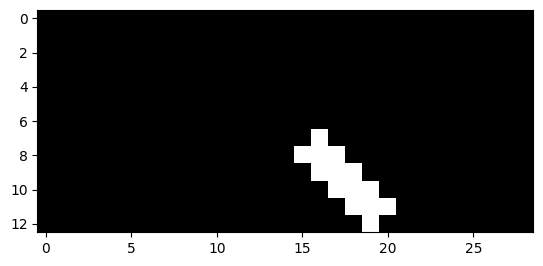

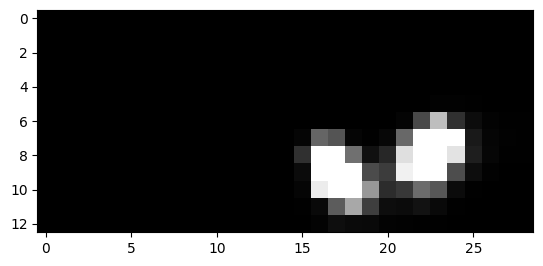

997


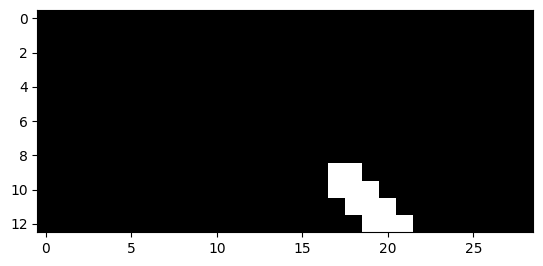

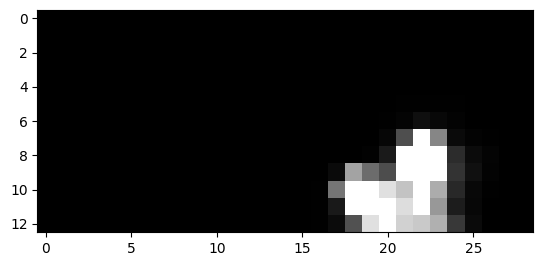

998


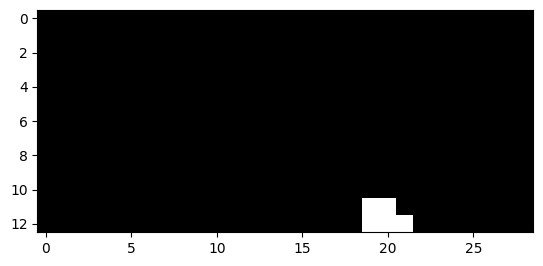

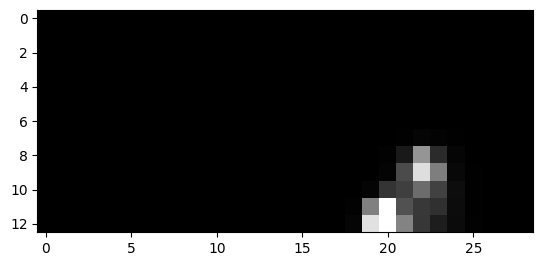

1023


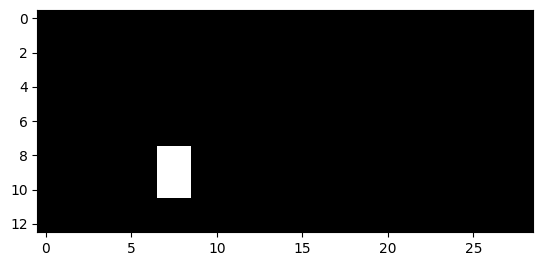

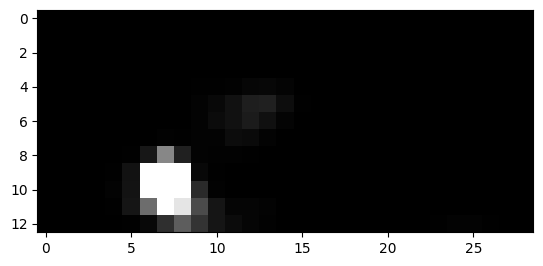

1024


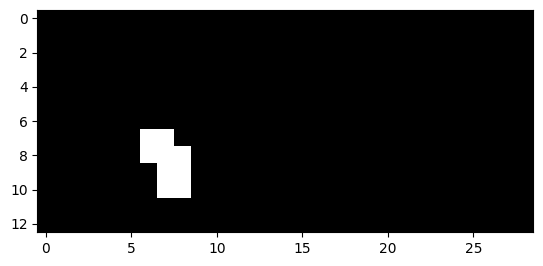

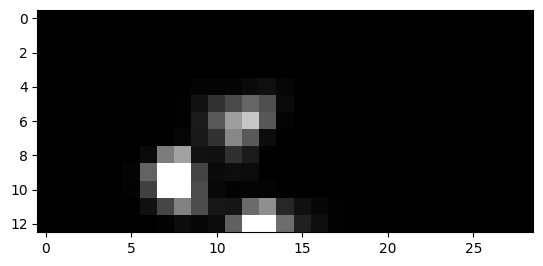

1025


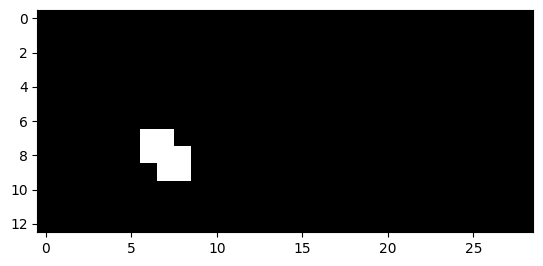

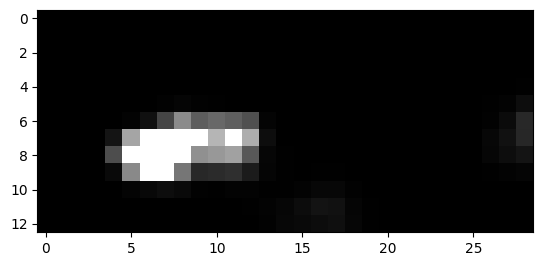

1027


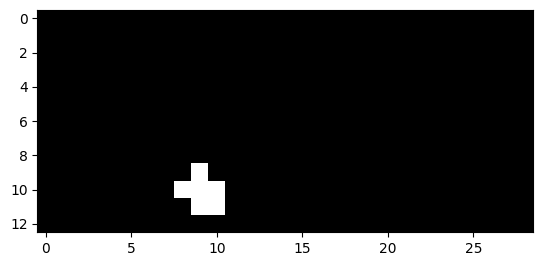

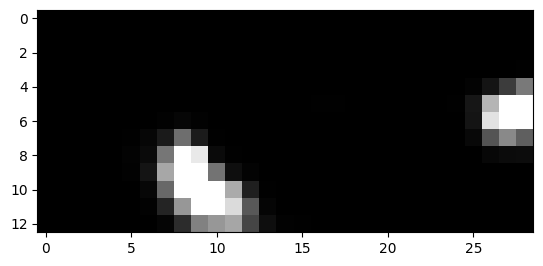

1028


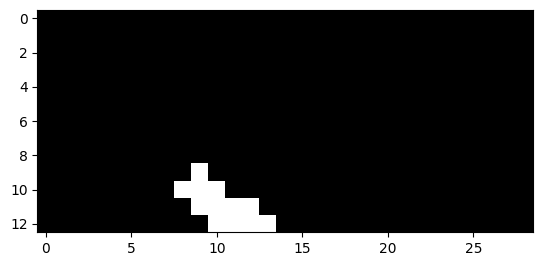

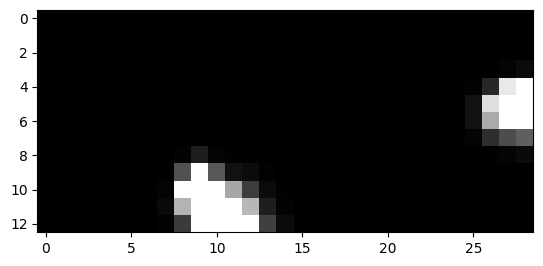

1029


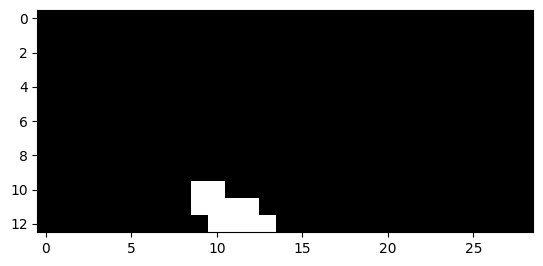

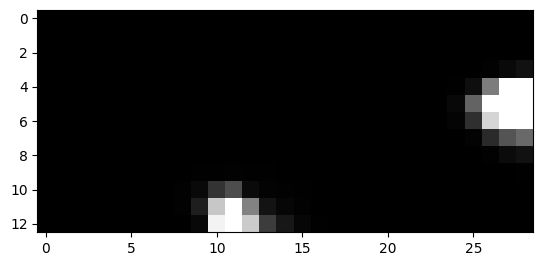

1039


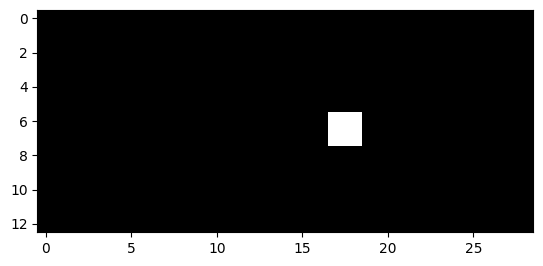

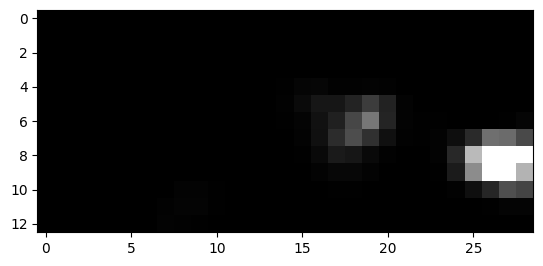

1040


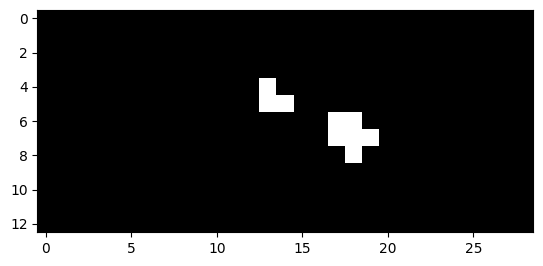

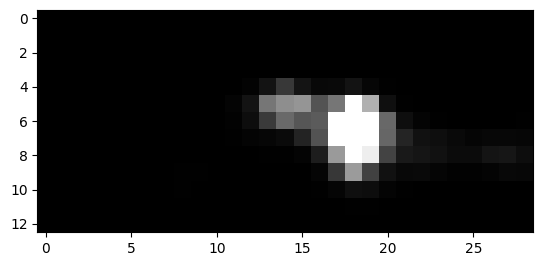

1041


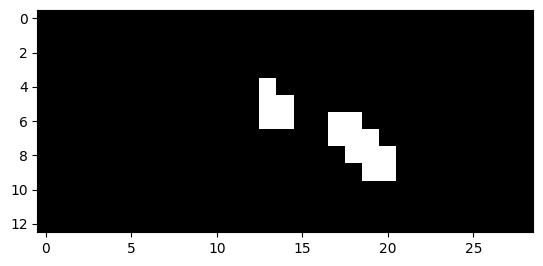

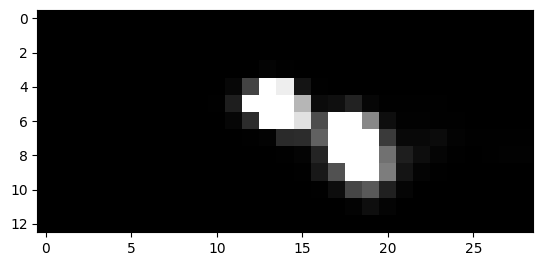

1042


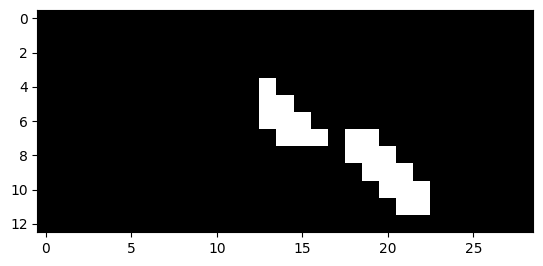

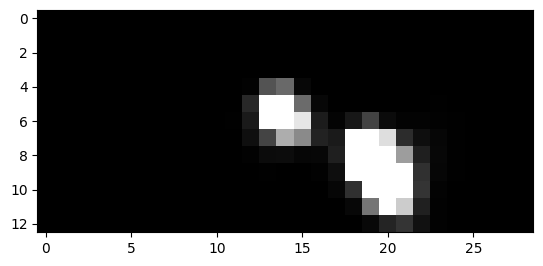

1043


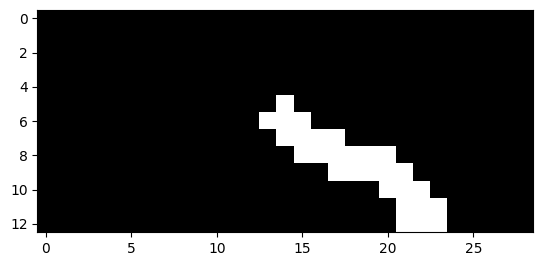

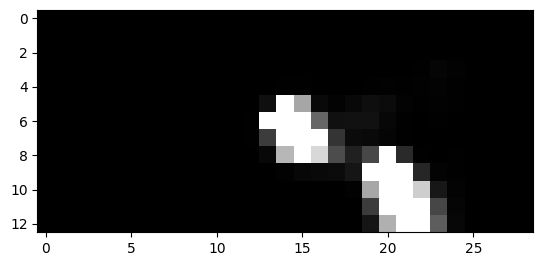

1044


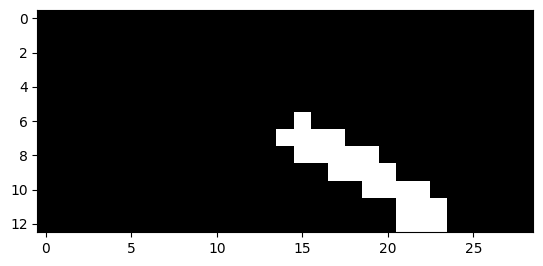

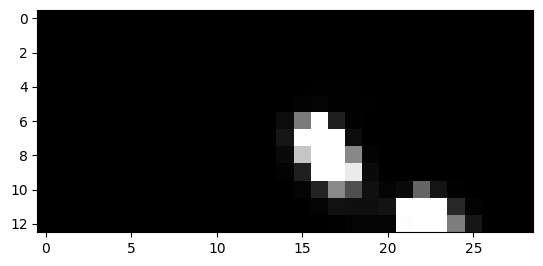

1045


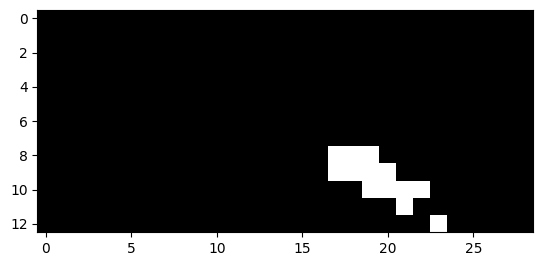

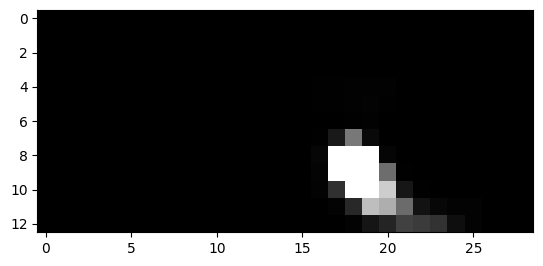

1046


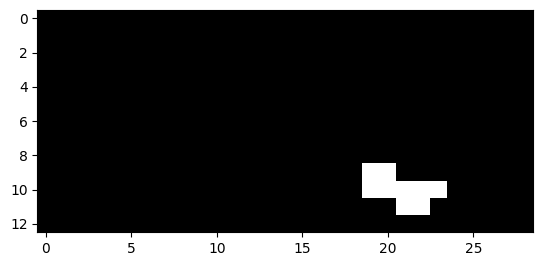

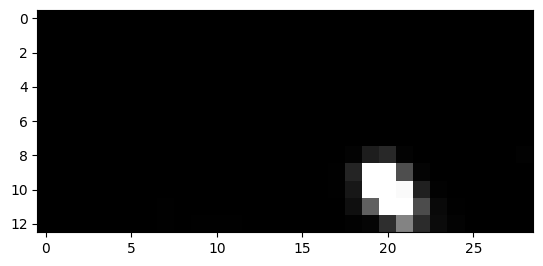

1047


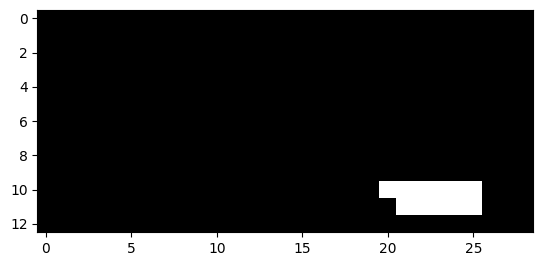

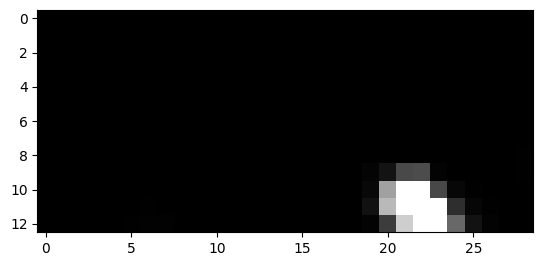

1048


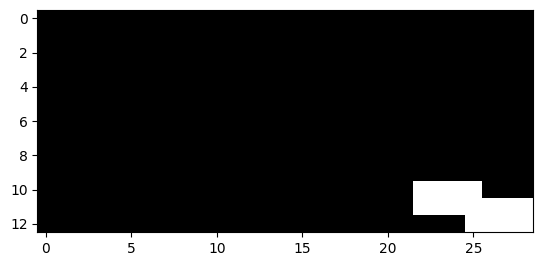

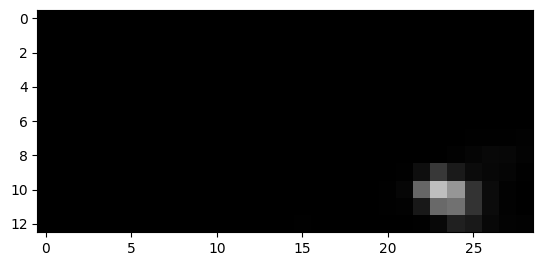

1049


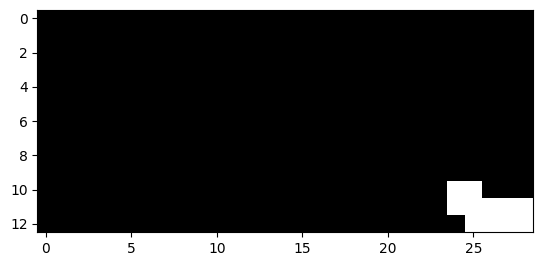

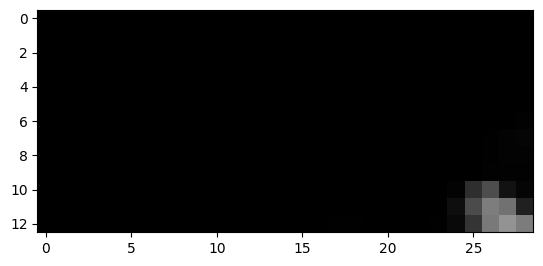

1050


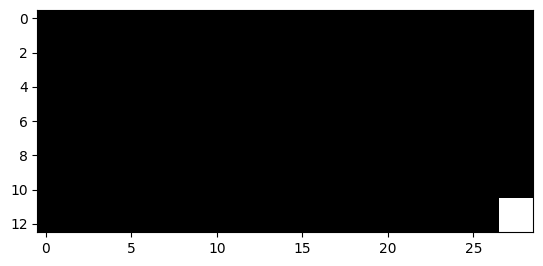

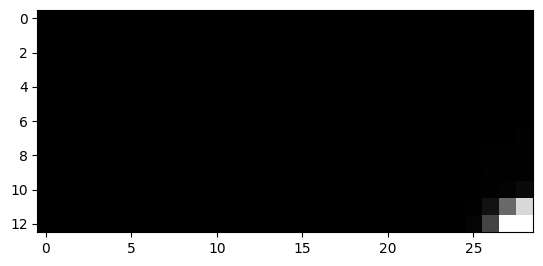

1064


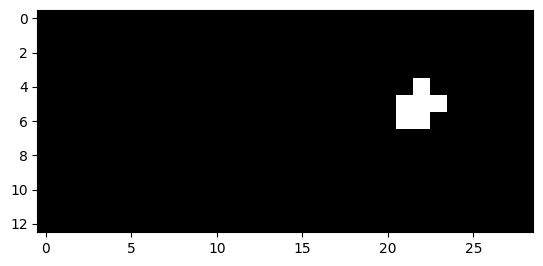

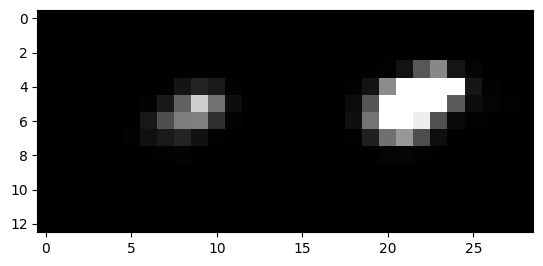

1065


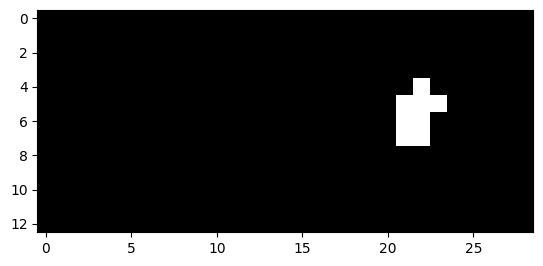

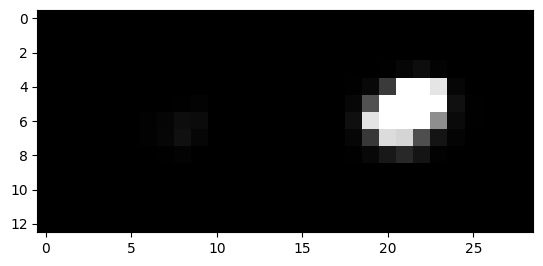

1066


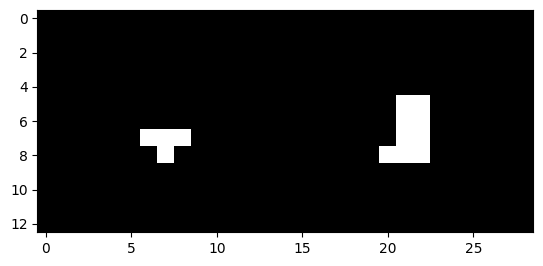

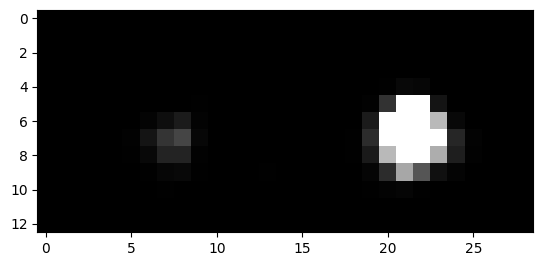

1067


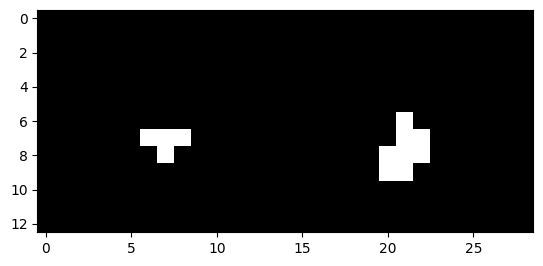

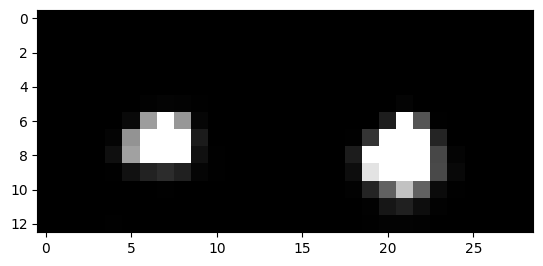

1068


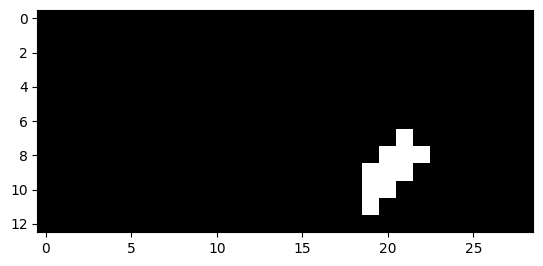

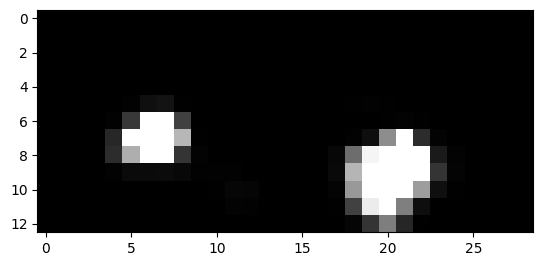

1069


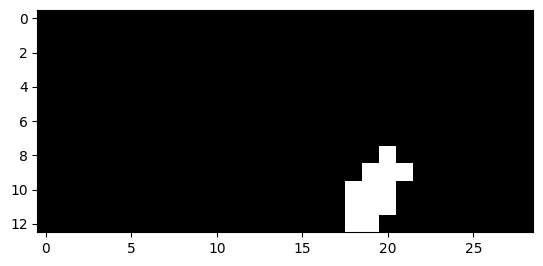

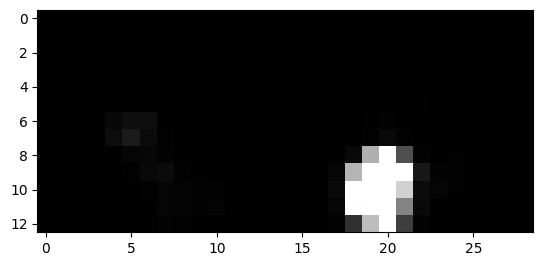

1070


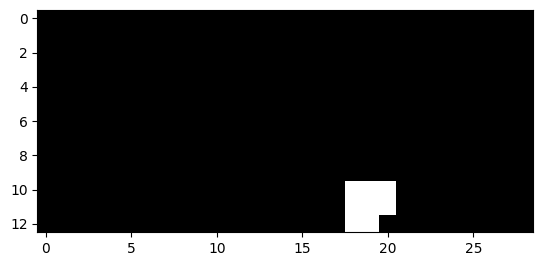

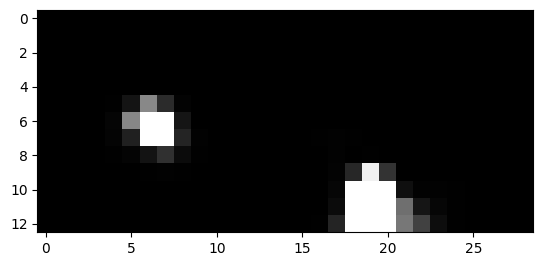

1071


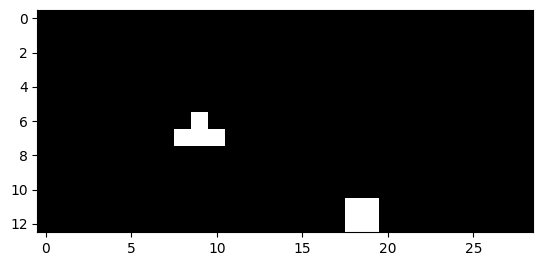

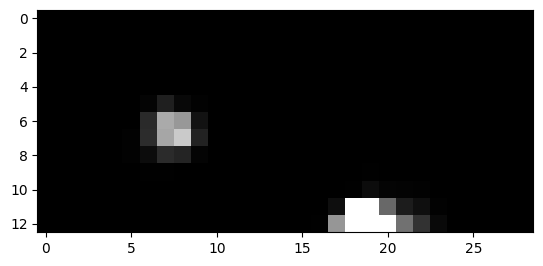

1072


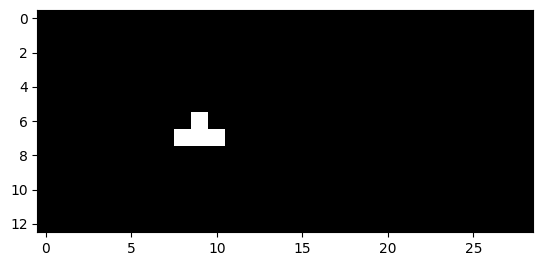

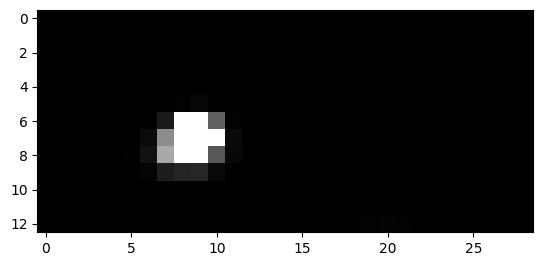

1073


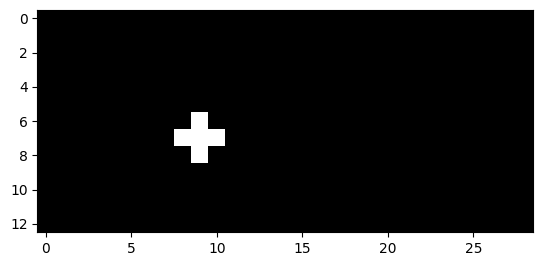

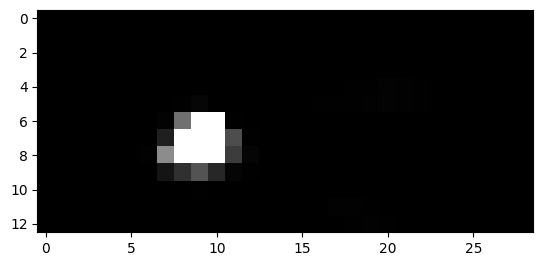

1074


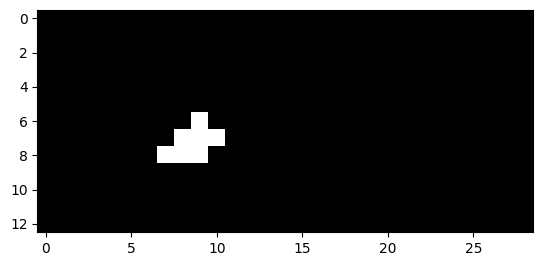

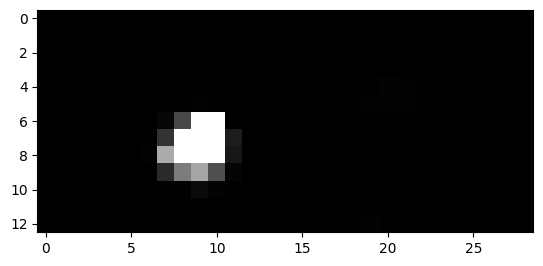

1075


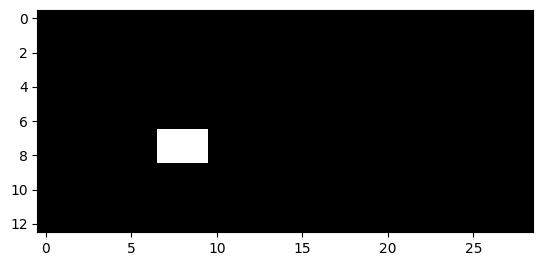

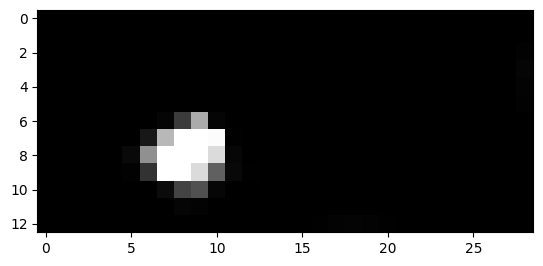

1076


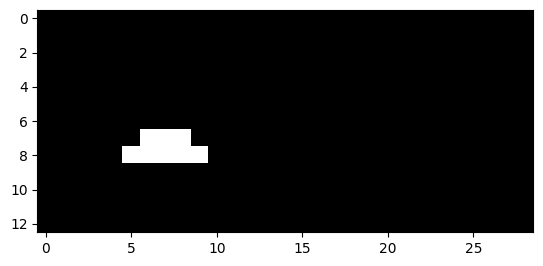

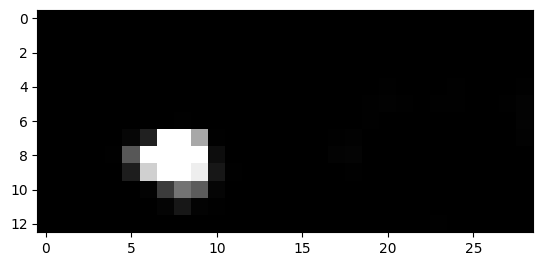

1077


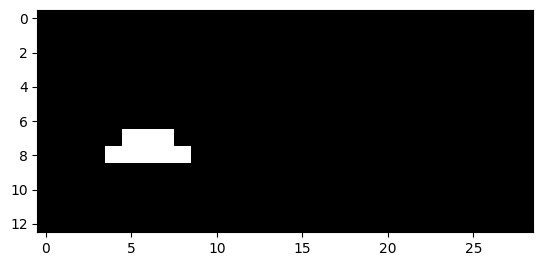

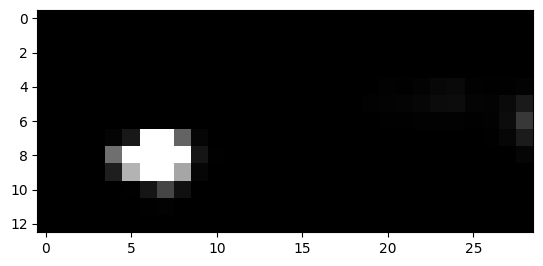

1078


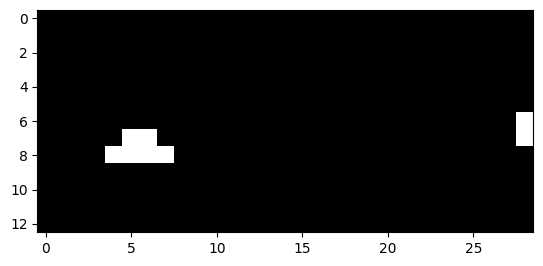

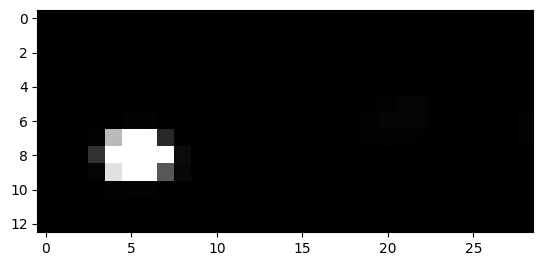

1079


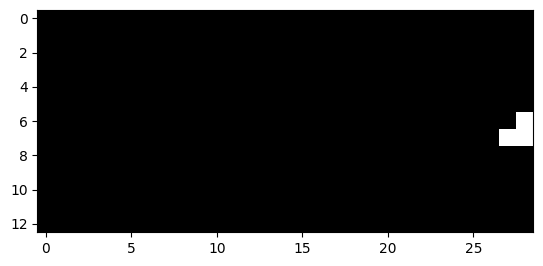

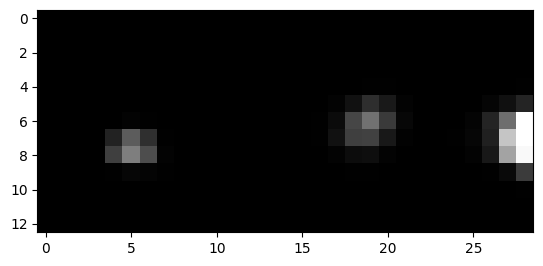

1080


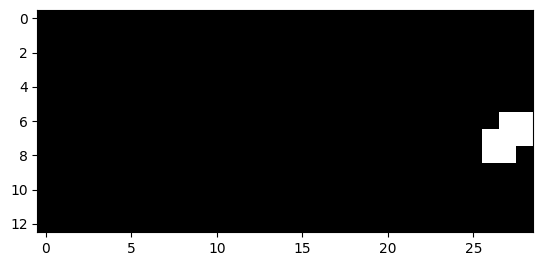

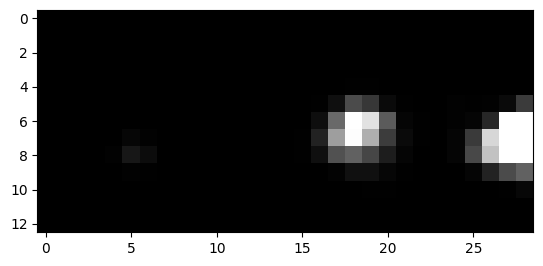

1081


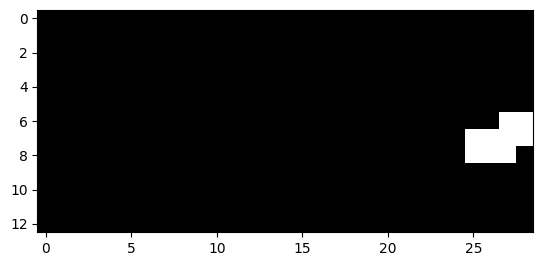

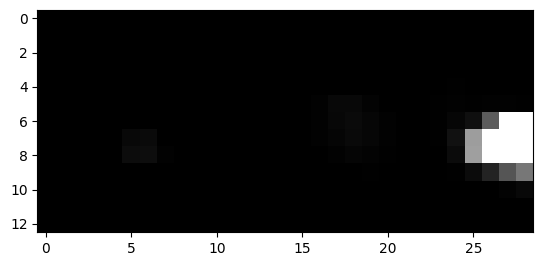

1082


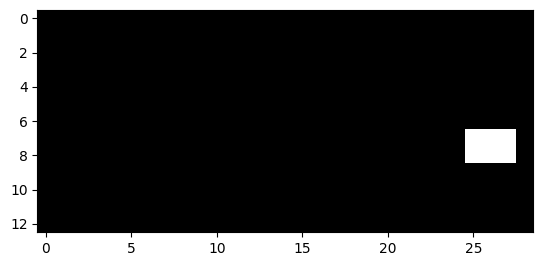

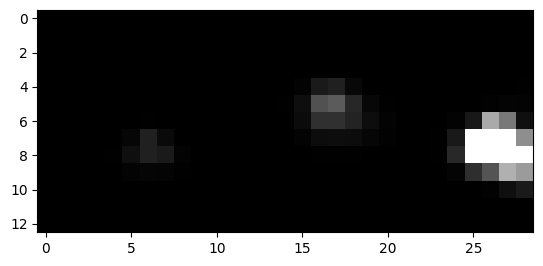

1083


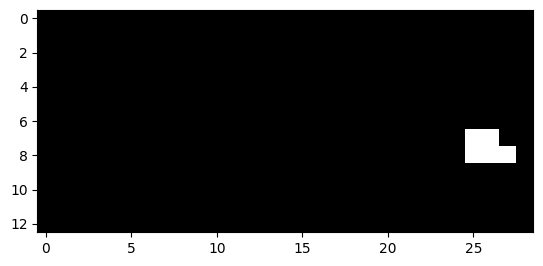

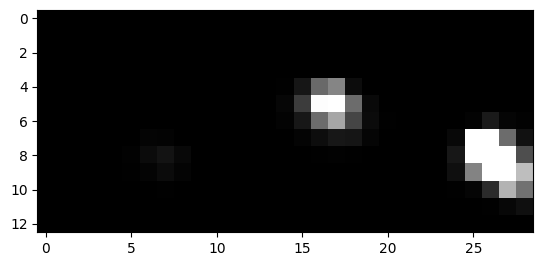

1084


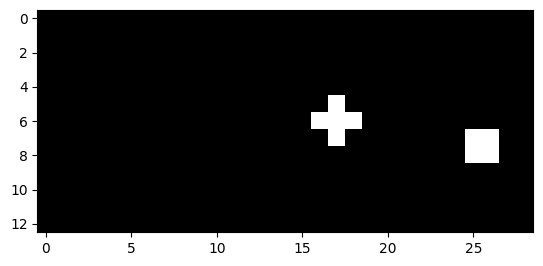

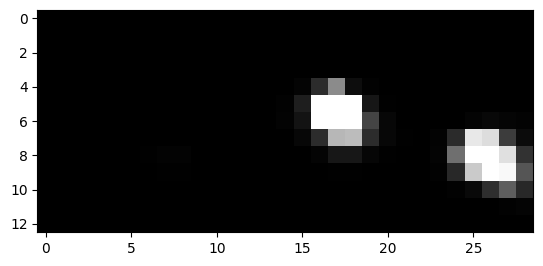

1085


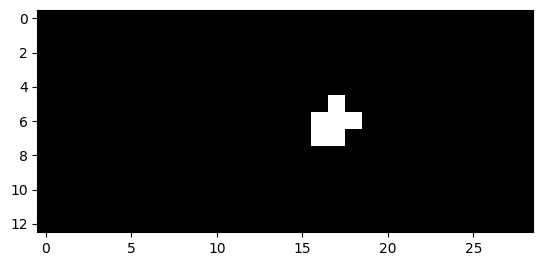

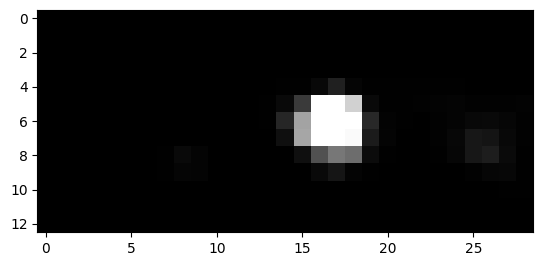

1086


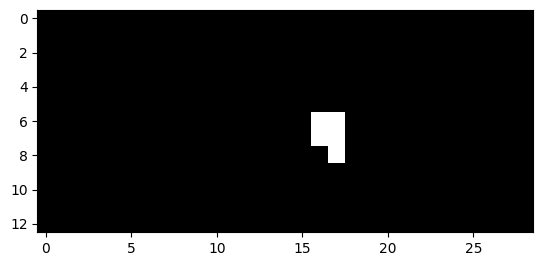

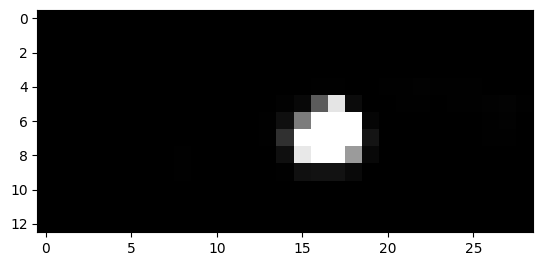

1087


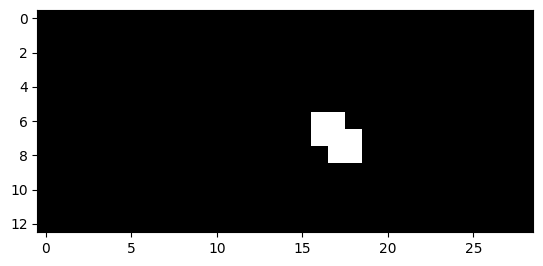

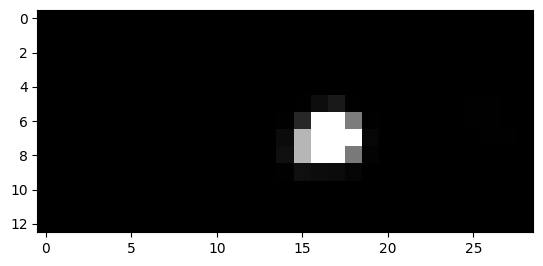

1088


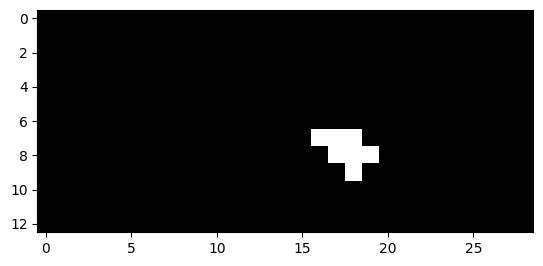

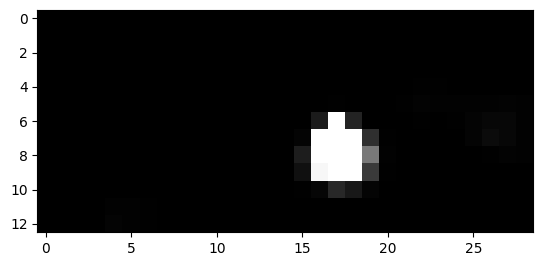

1089


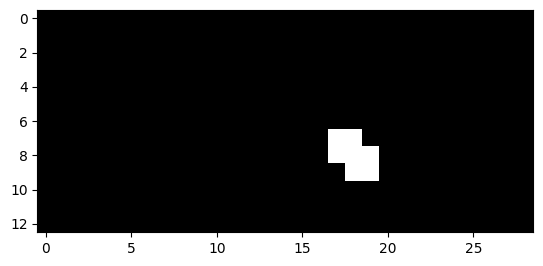

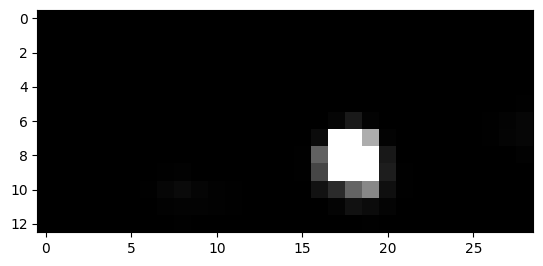

1090


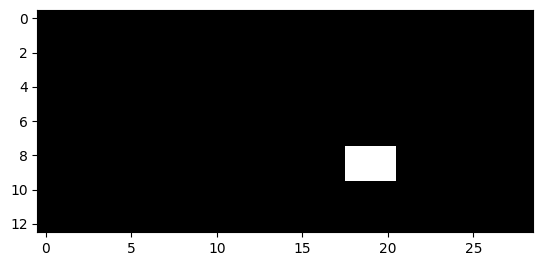

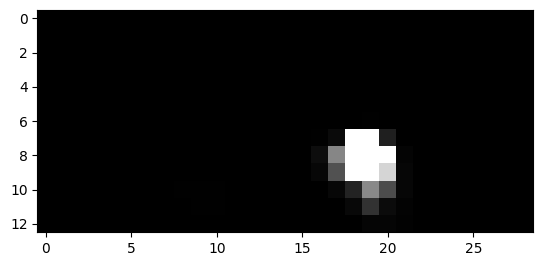

1091


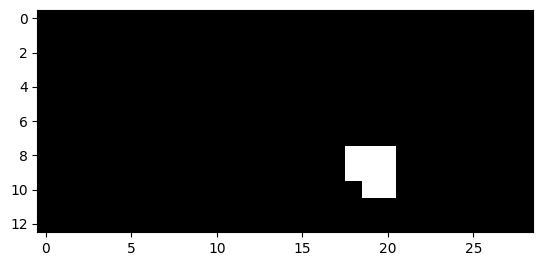

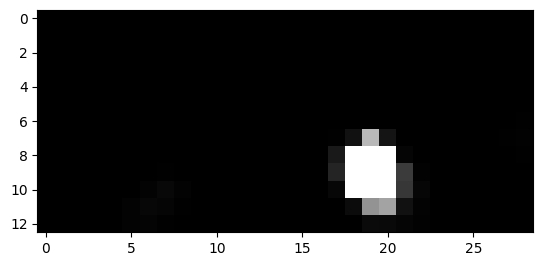

1092


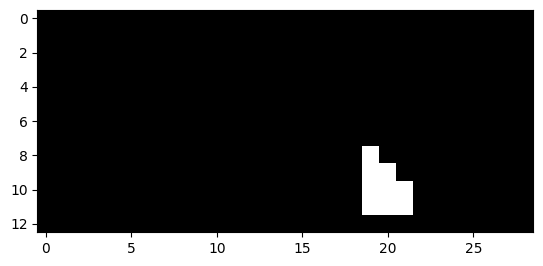

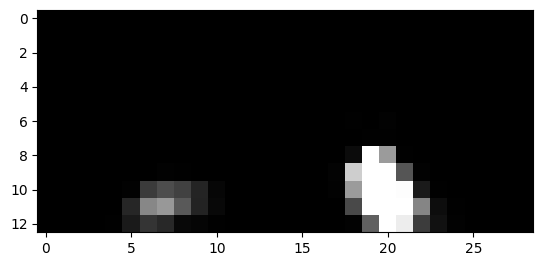

1093


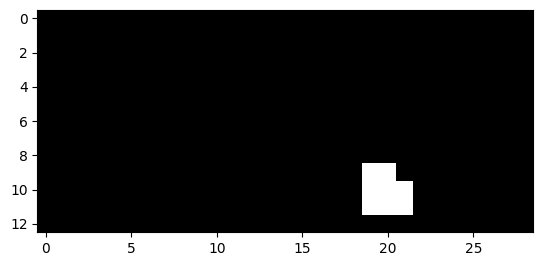

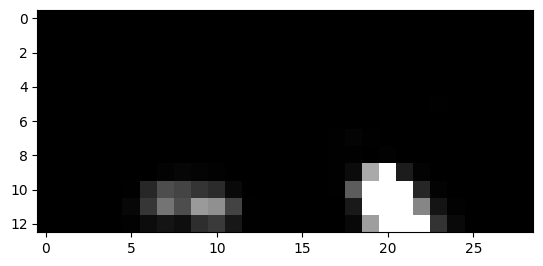

1094


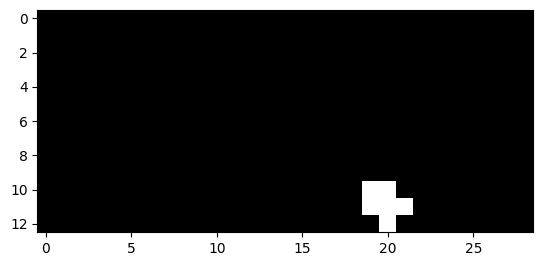

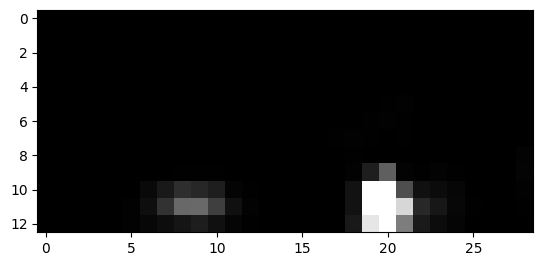

1095


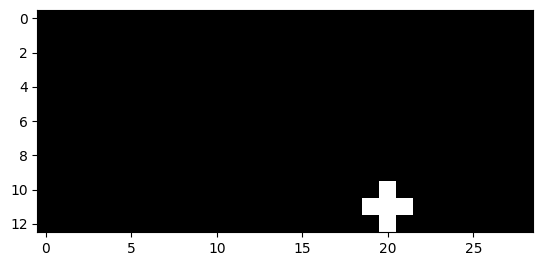

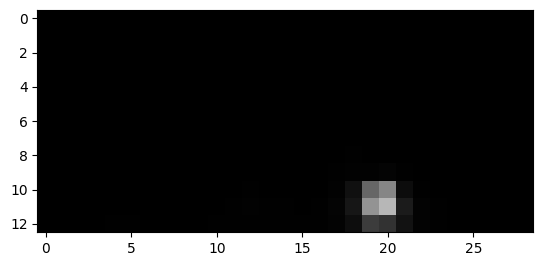

1116


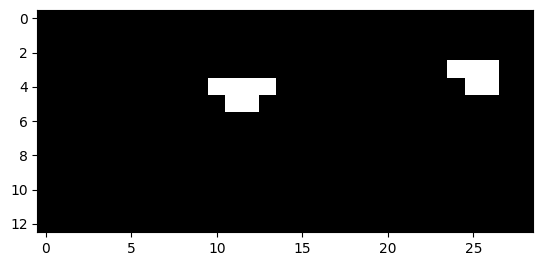

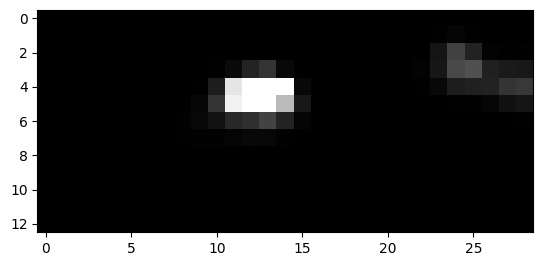

1117


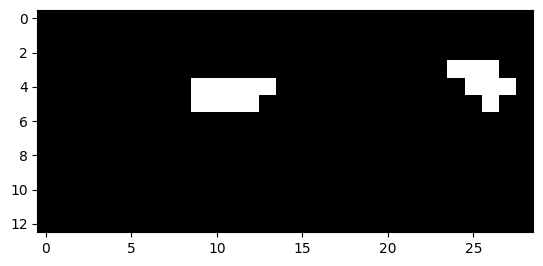

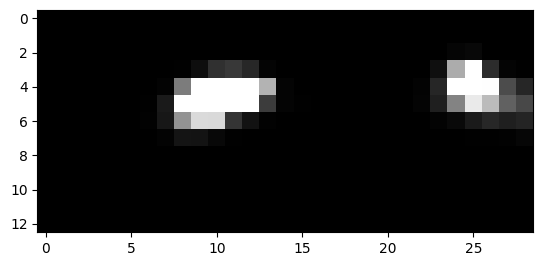

1118


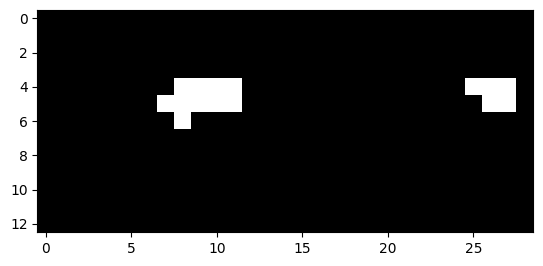

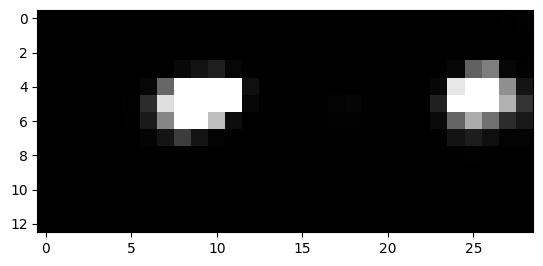

1119


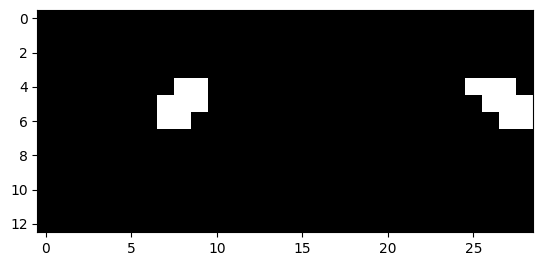

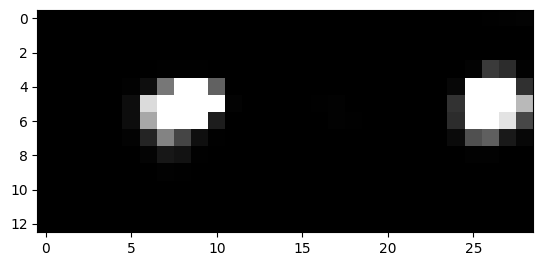

1120


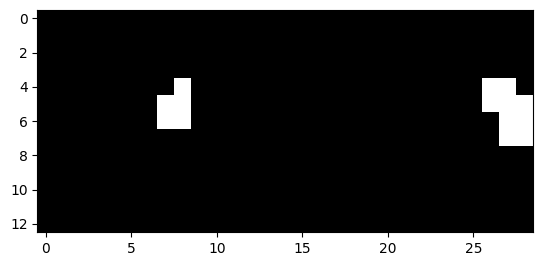

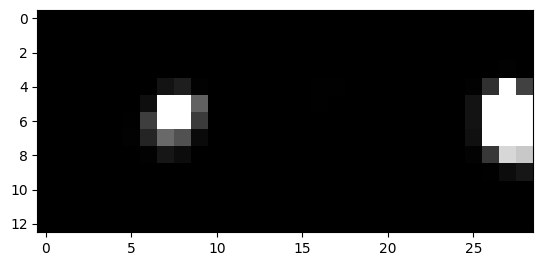

1121


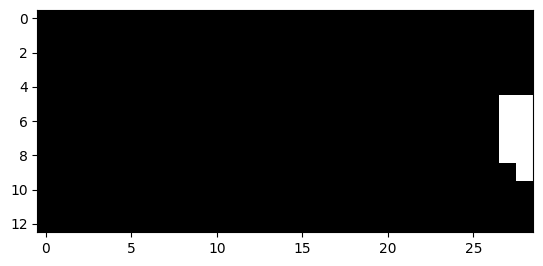

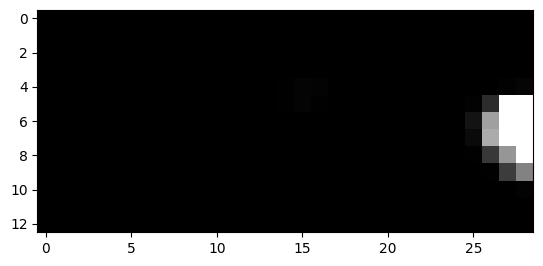

1122


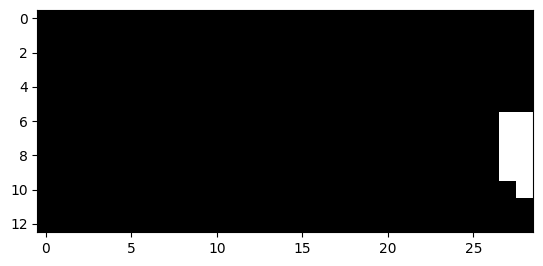

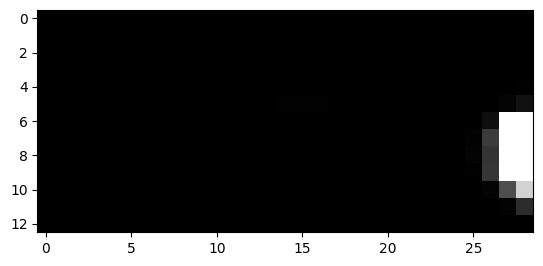

1123


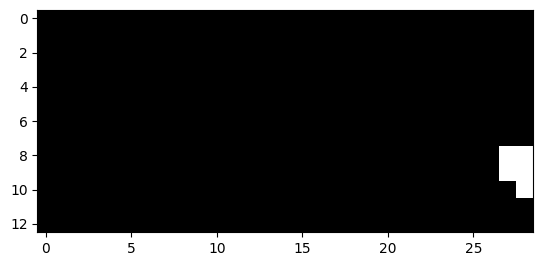

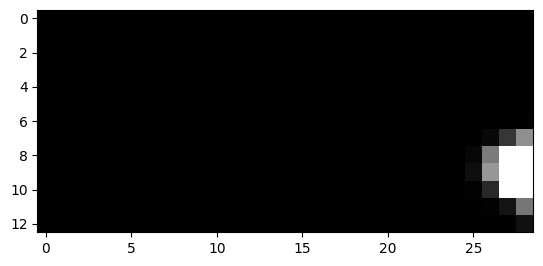

1341


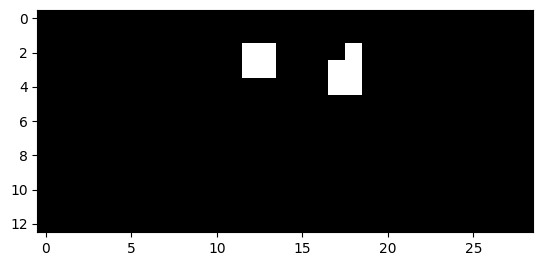

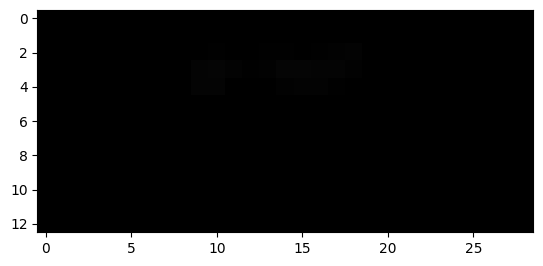

1342


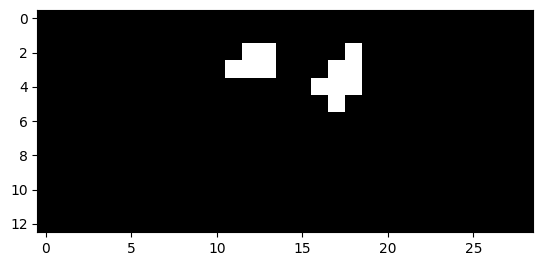

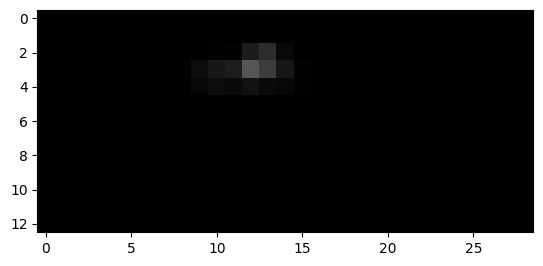

1343


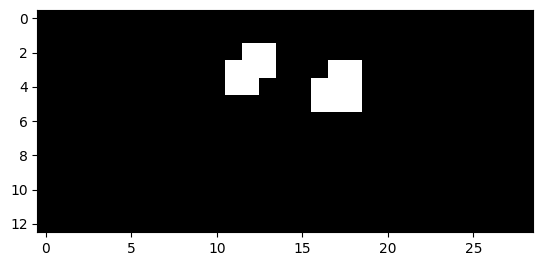

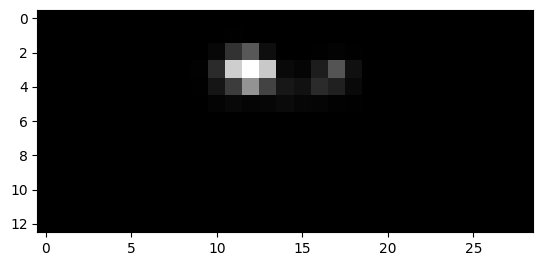

1344


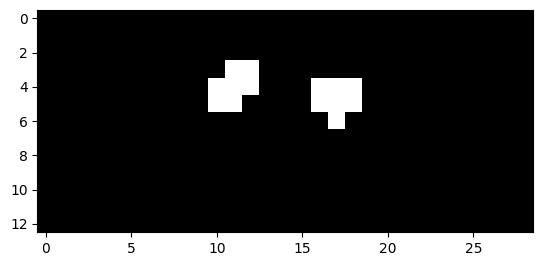

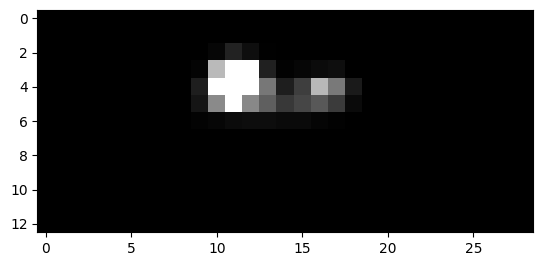

1345


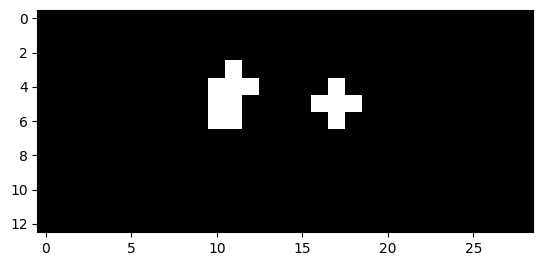

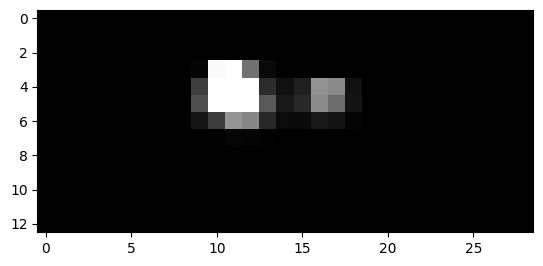

1346


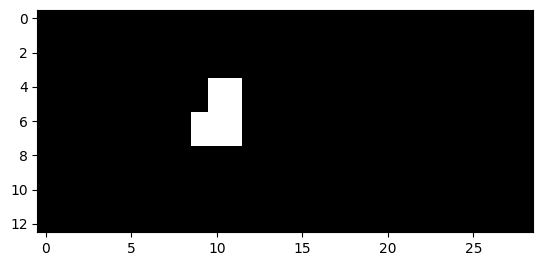

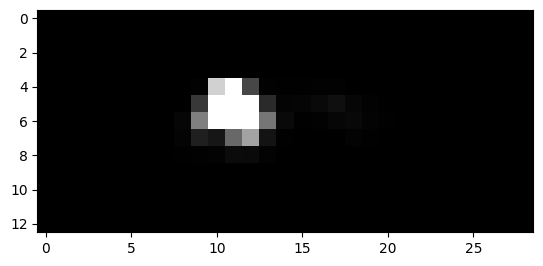

1347


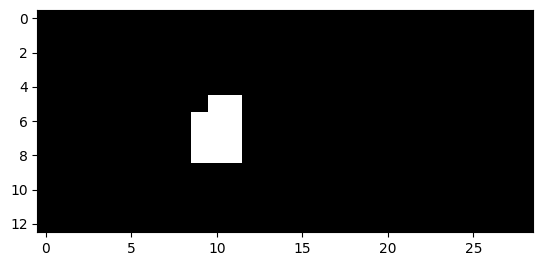

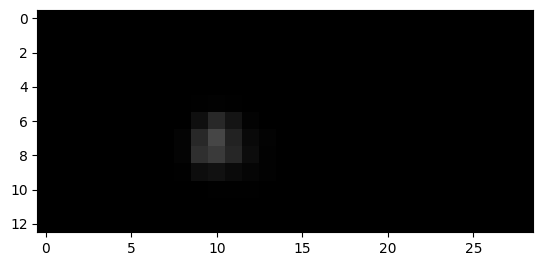

1348


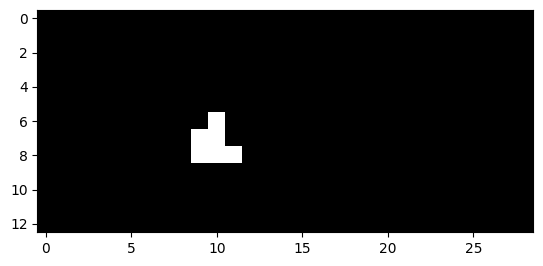

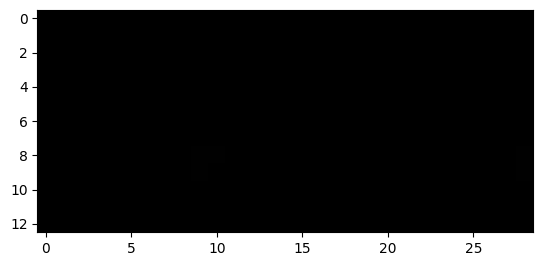

1366


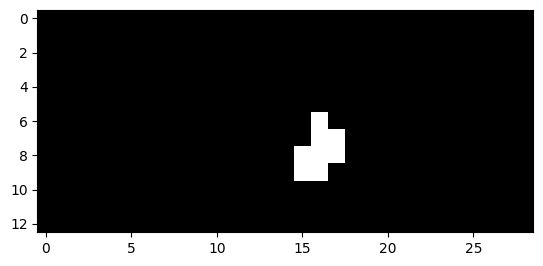

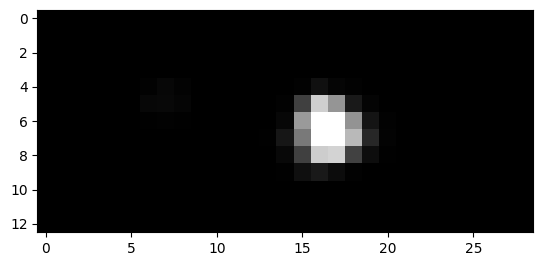

1367


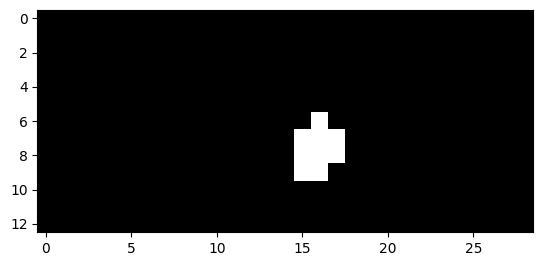

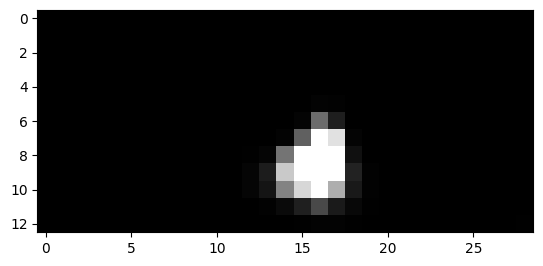

1368


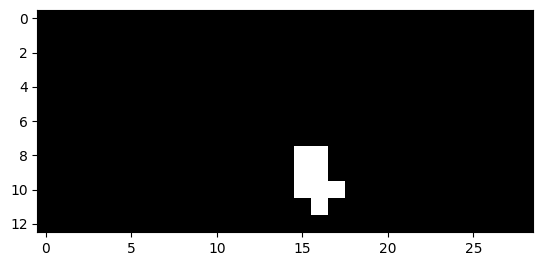

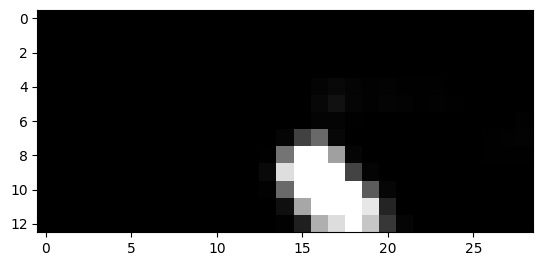

1369


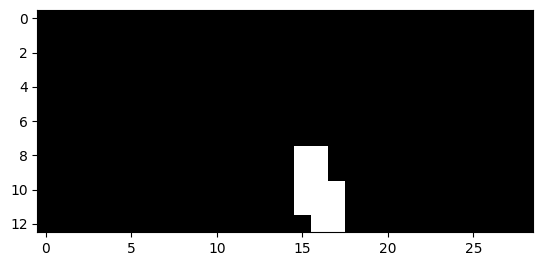

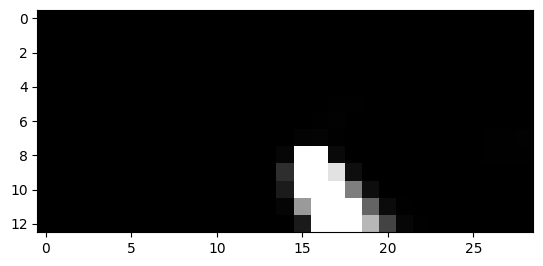

1370


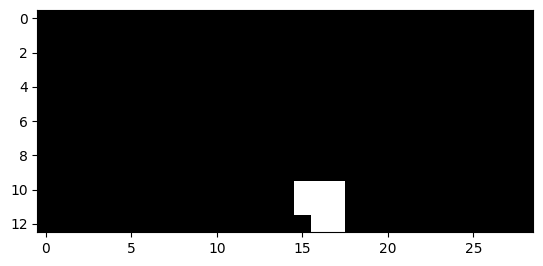

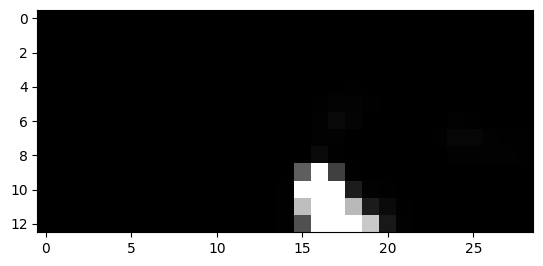

1371


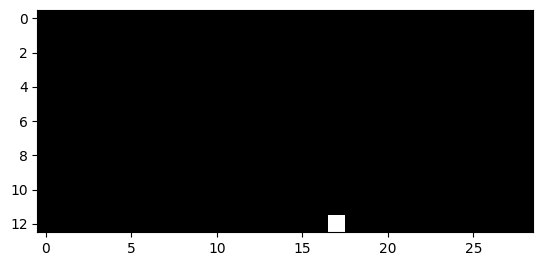

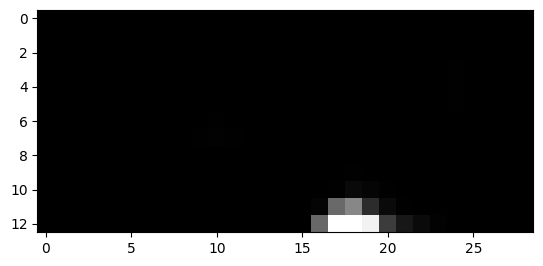

1389


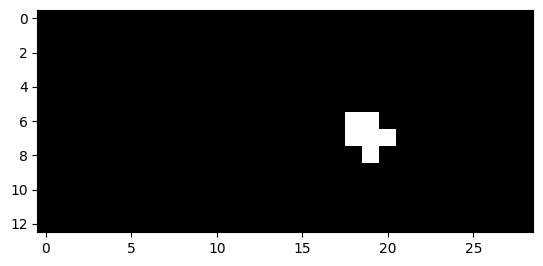

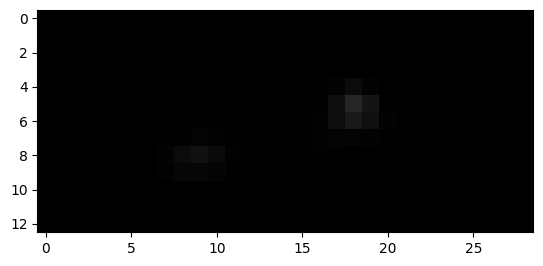

1390


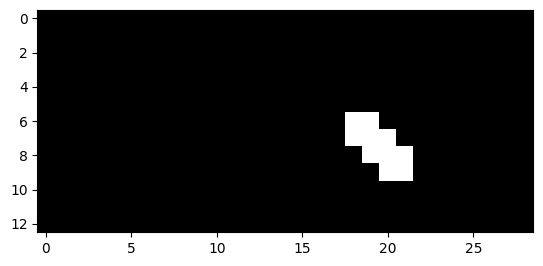

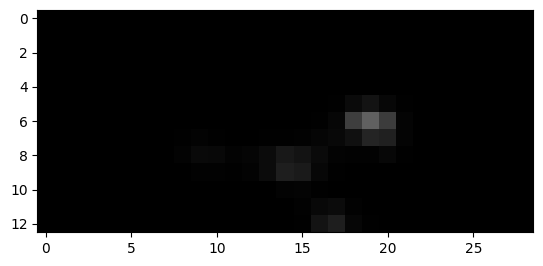

1391


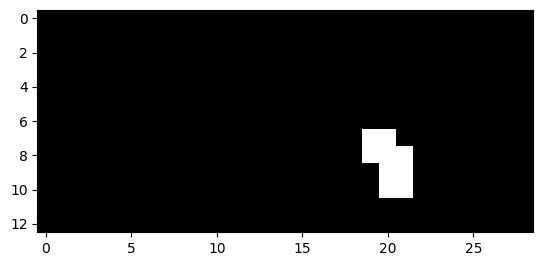

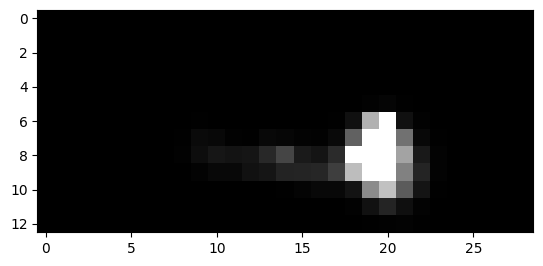

1392


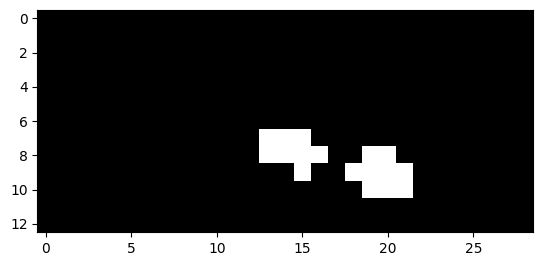

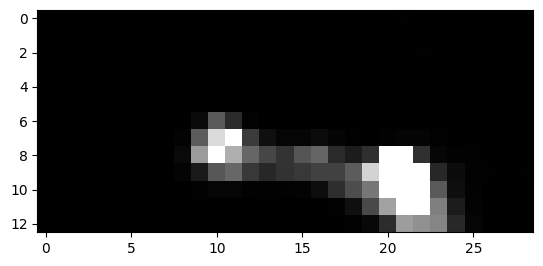

1393


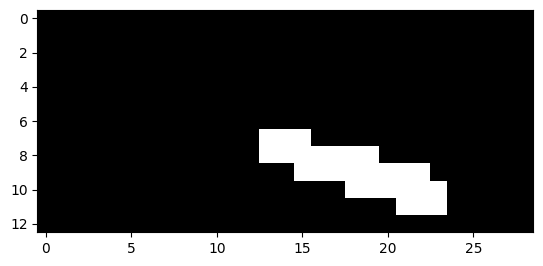

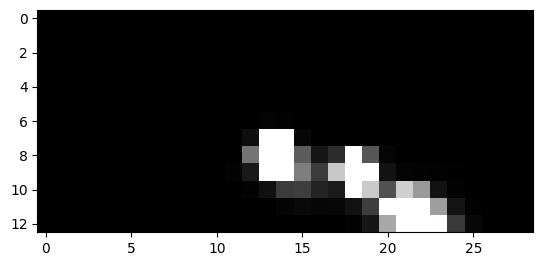

1394


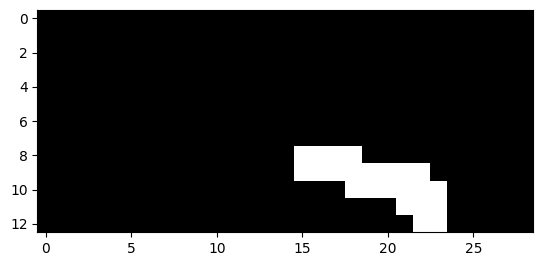

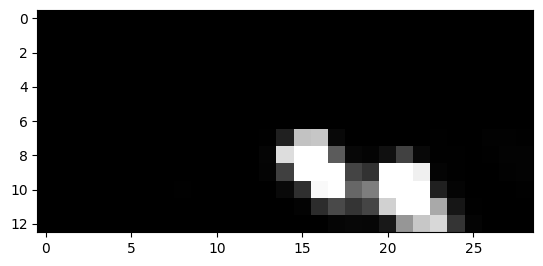

1395


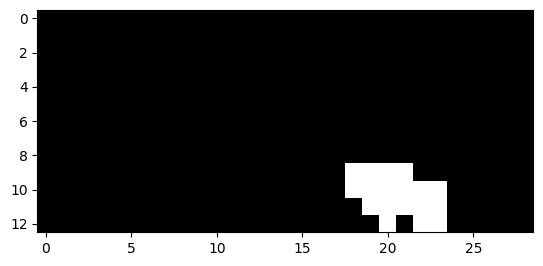

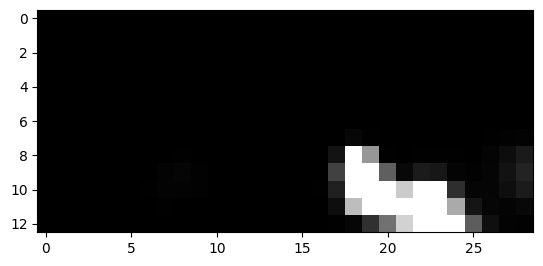

1396


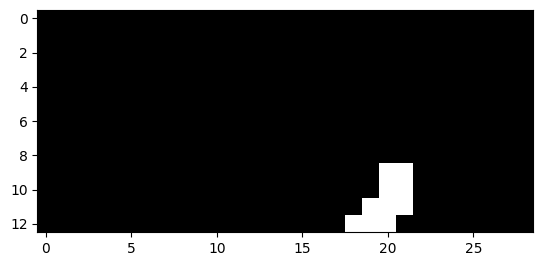

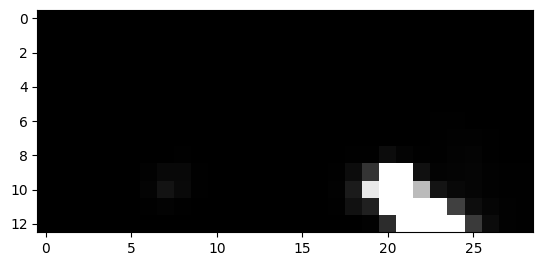

1397


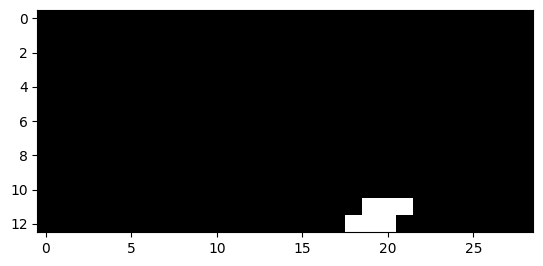

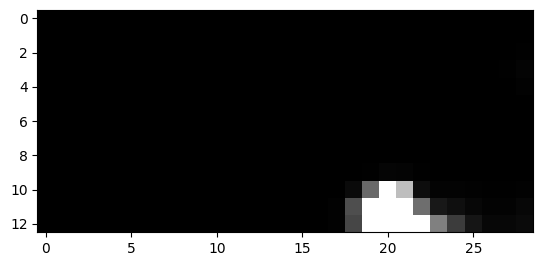

1398


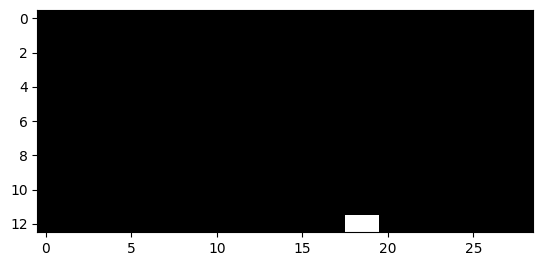

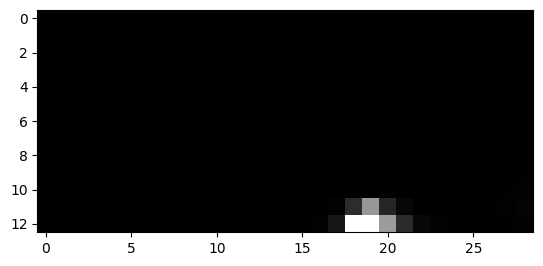

1403


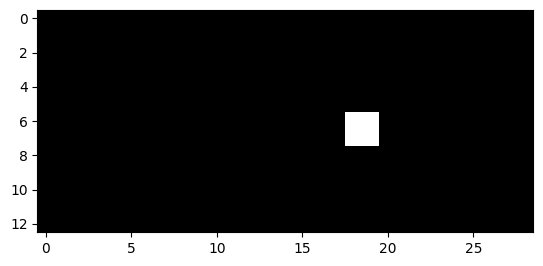

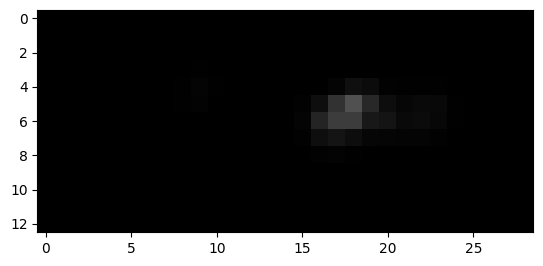

1404


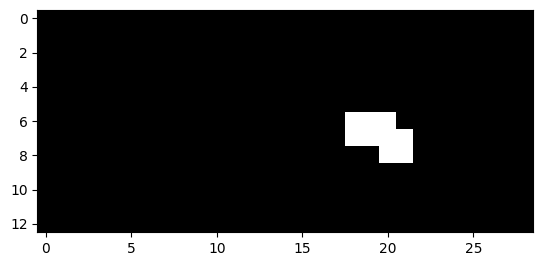

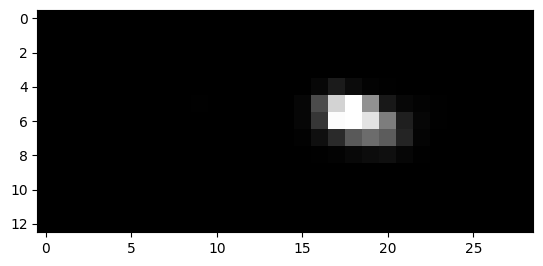

1405


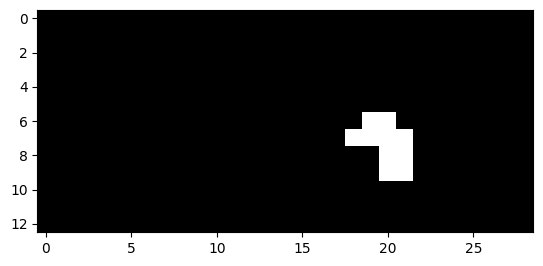

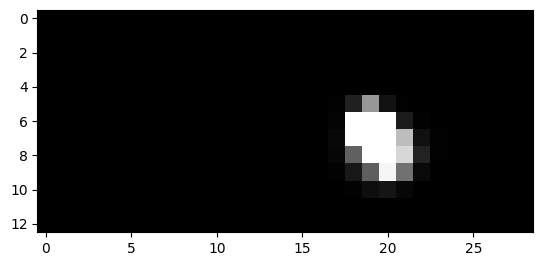

1406


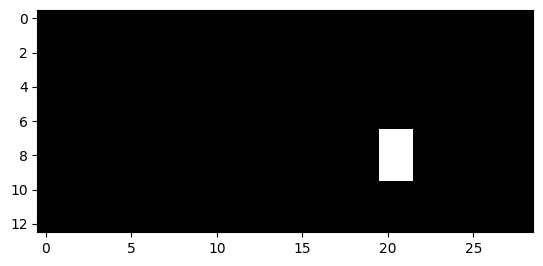

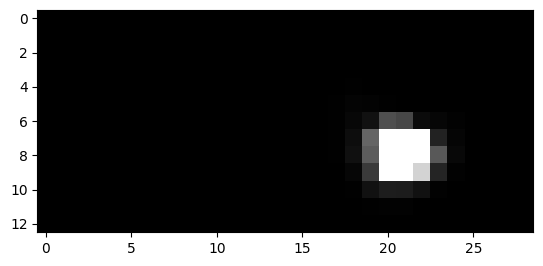

1407


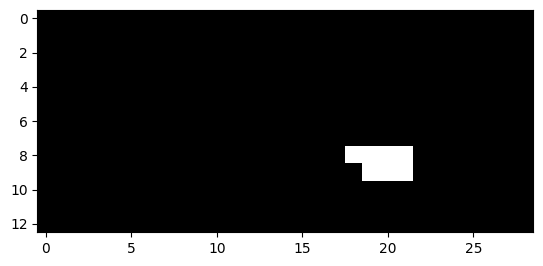

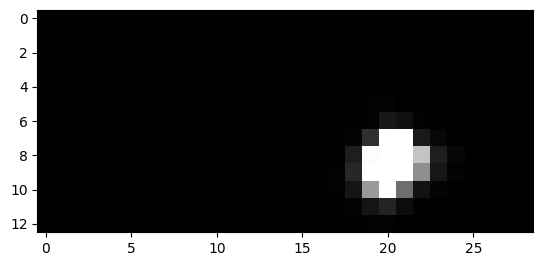

1408


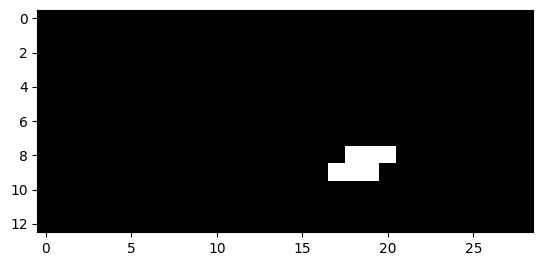

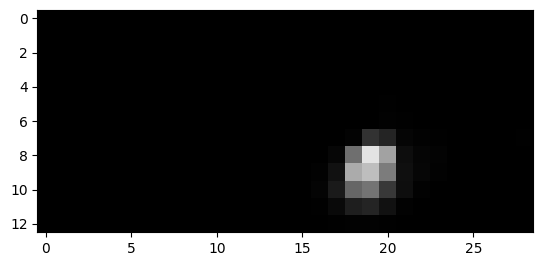

1409


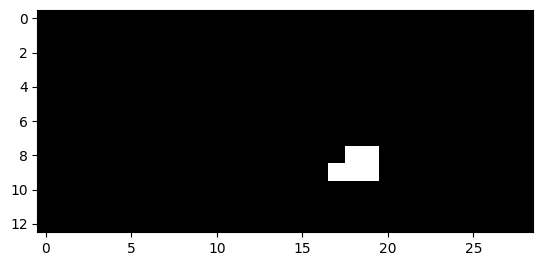

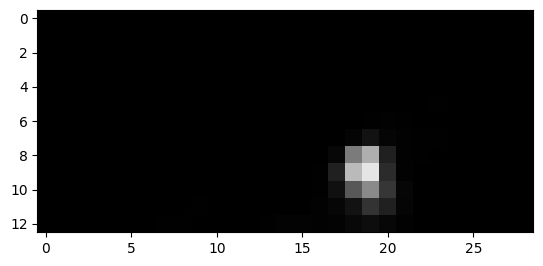

1412


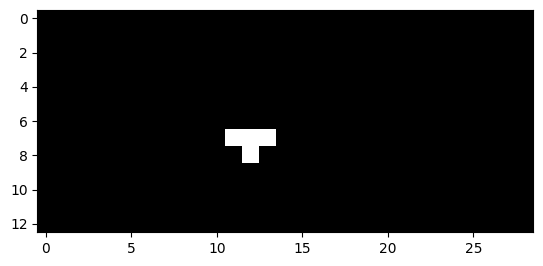

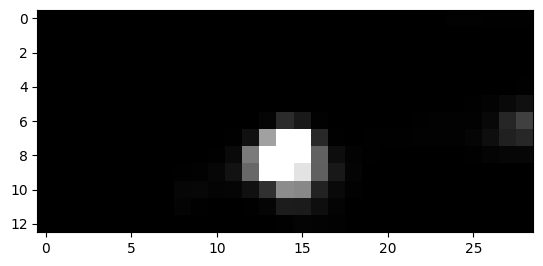

1413


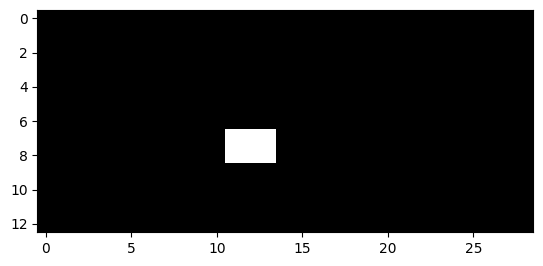

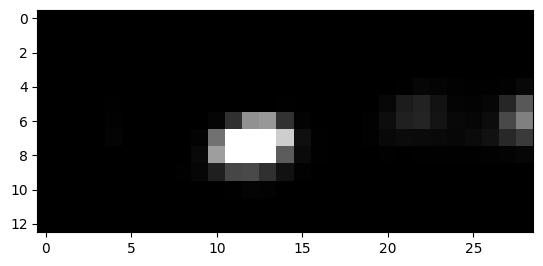

1414


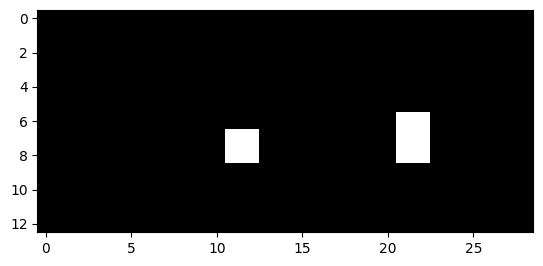

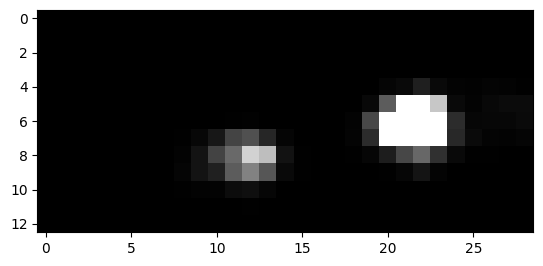

1415


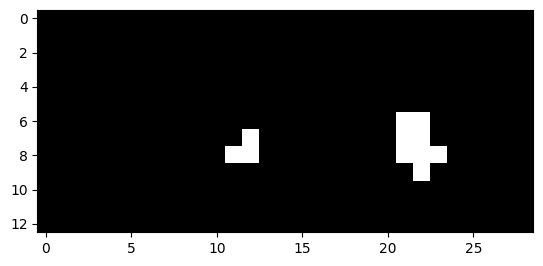

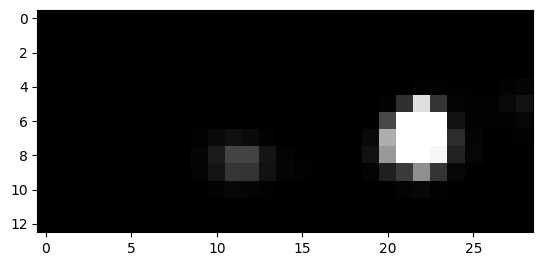

1416


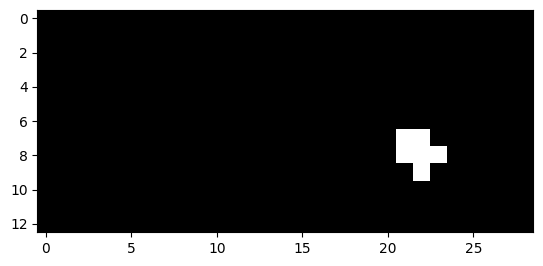

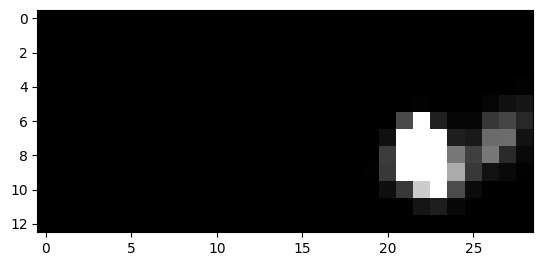

1417


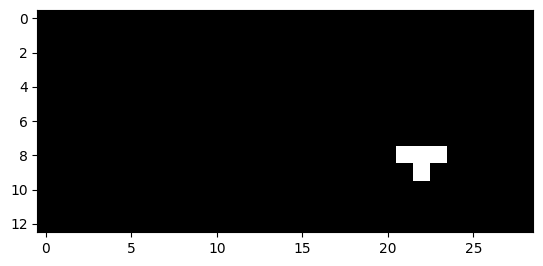

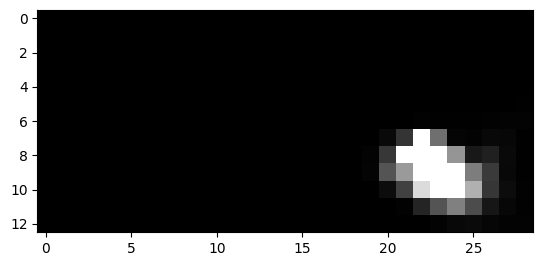

1419


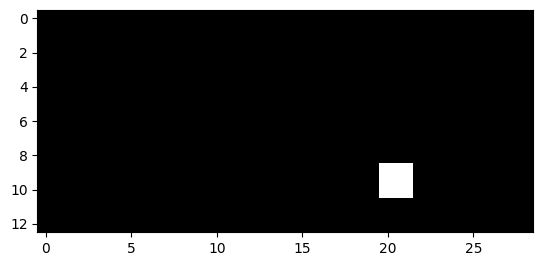

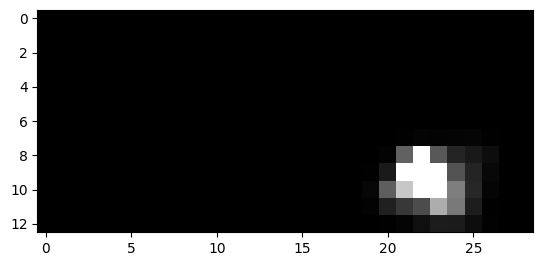

1420


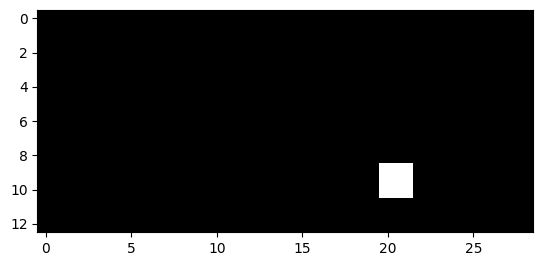

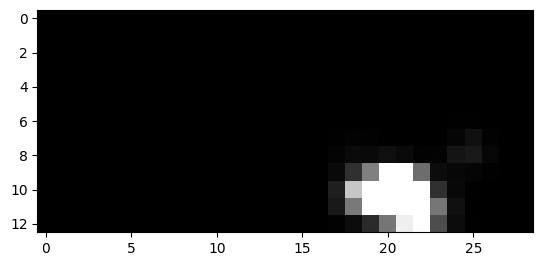

1441


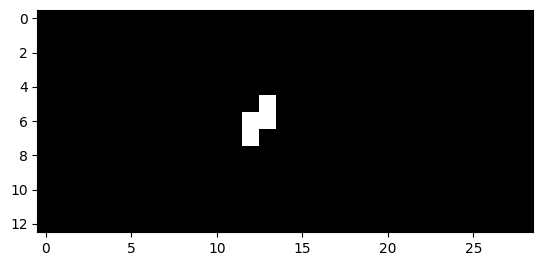

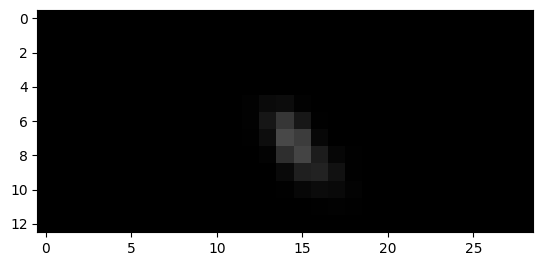

1442


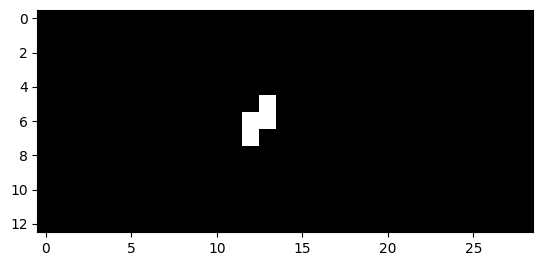

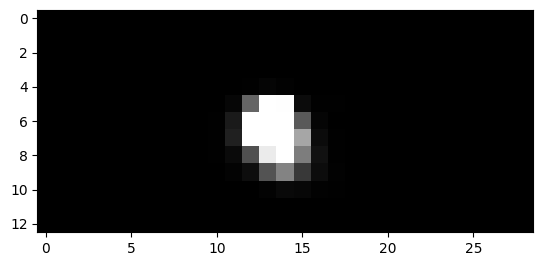

1443


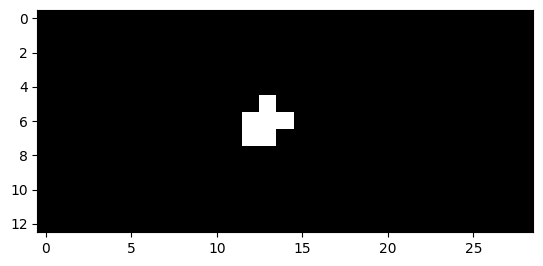

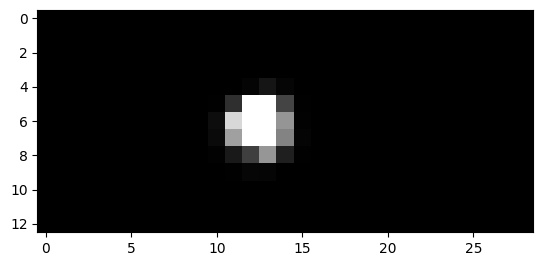

1444


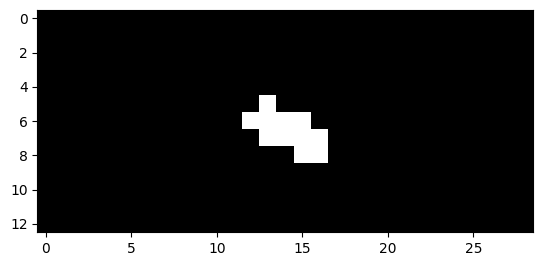

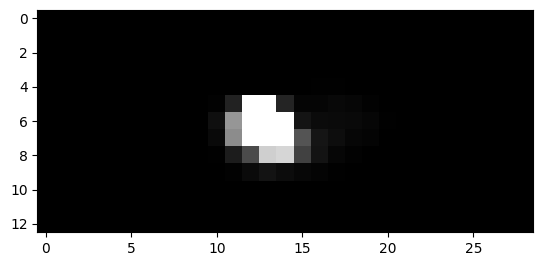

1445


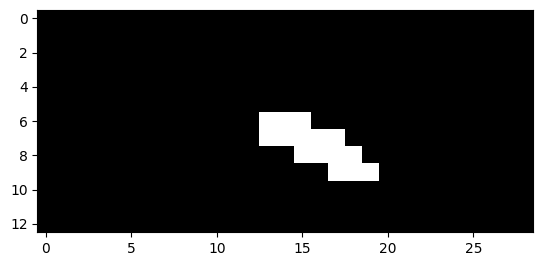

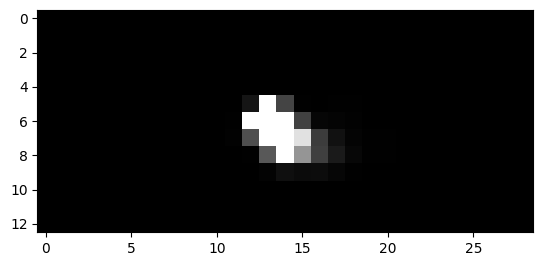

1446


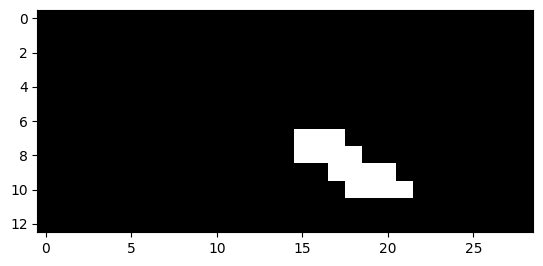

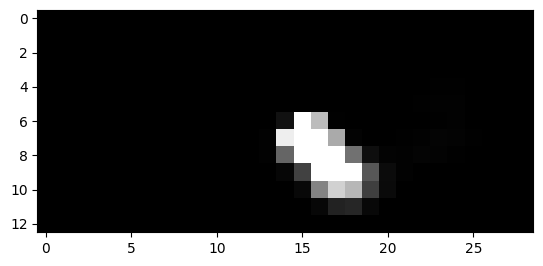

1447


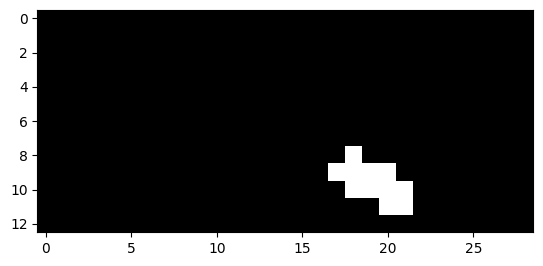

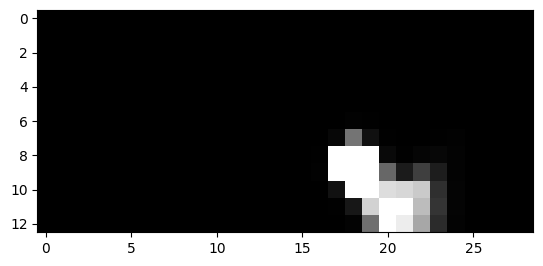

1448


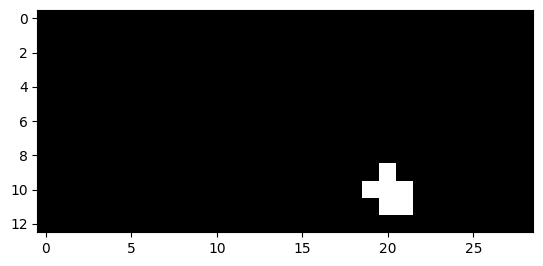

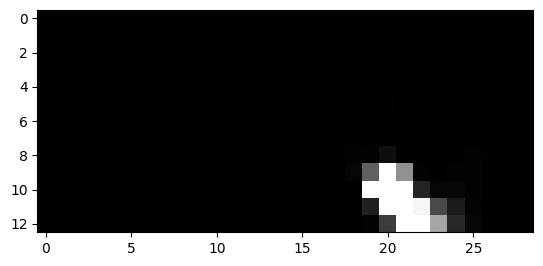

1460


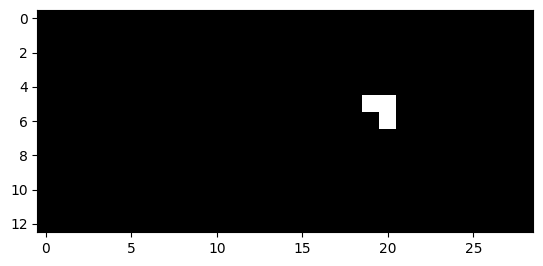

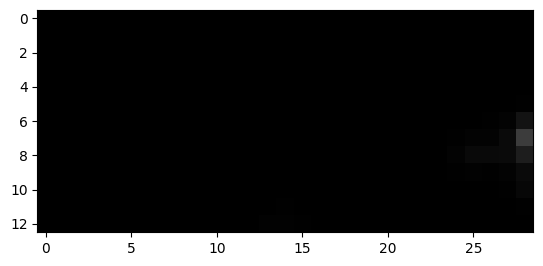

1461


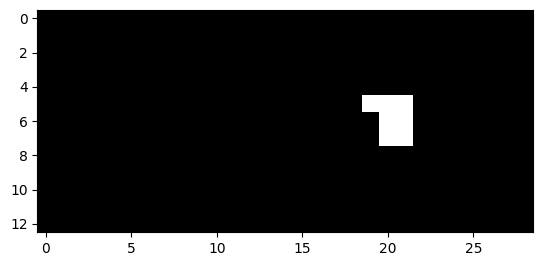

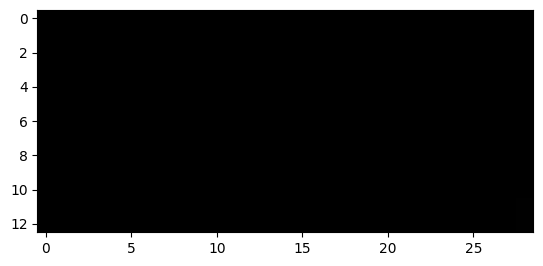

1462


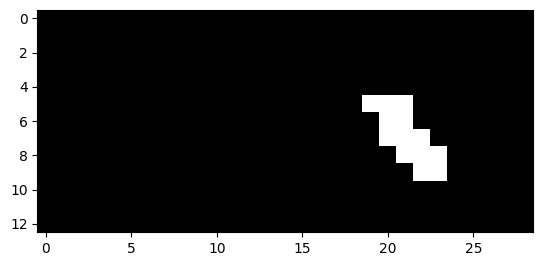

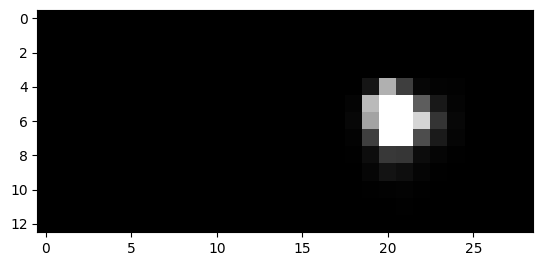

1463


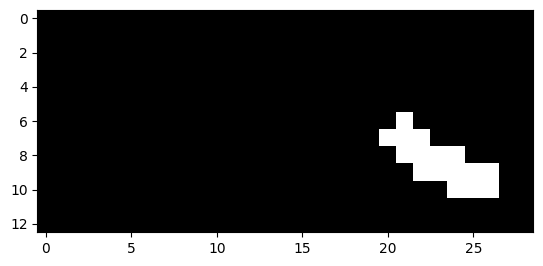

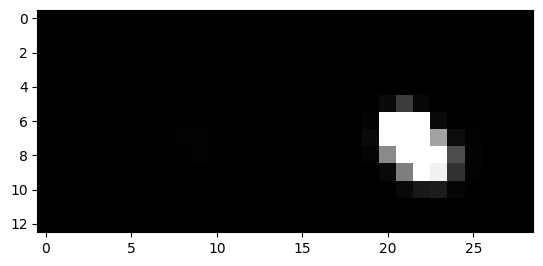

1464


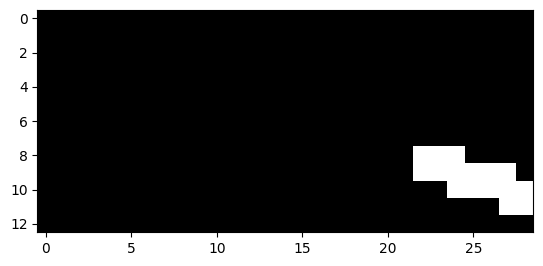

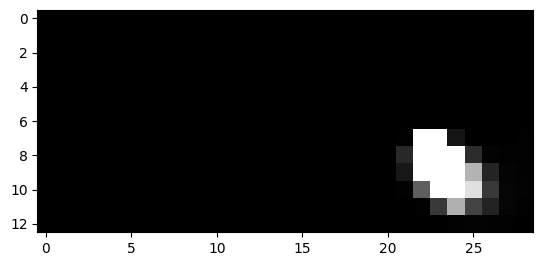

1465


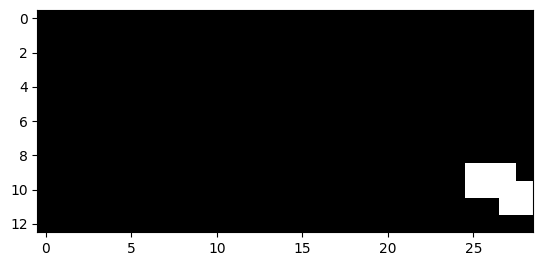

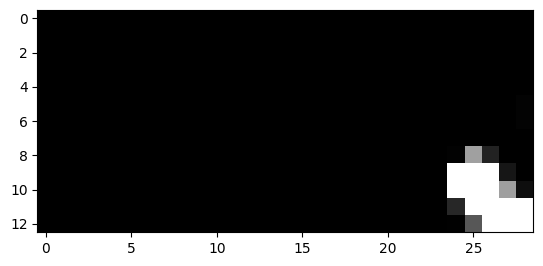

1466


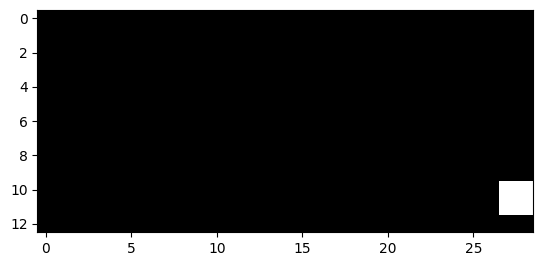

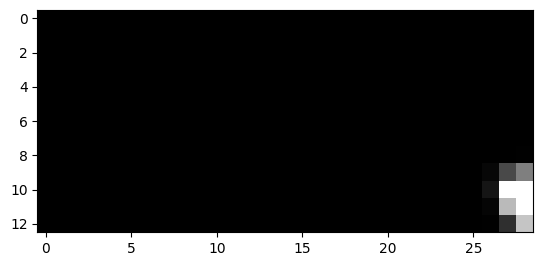

1473


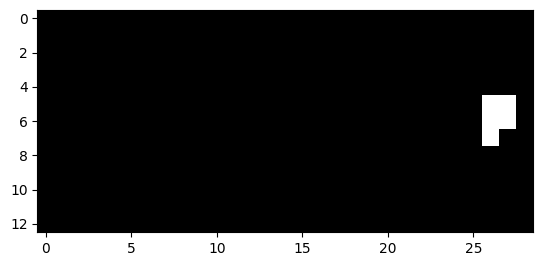

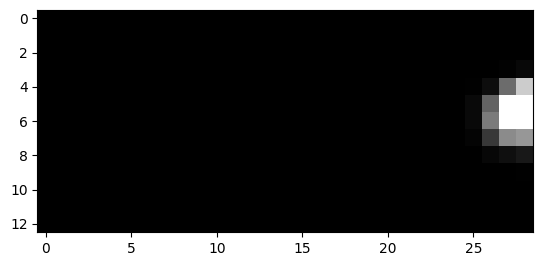

1474


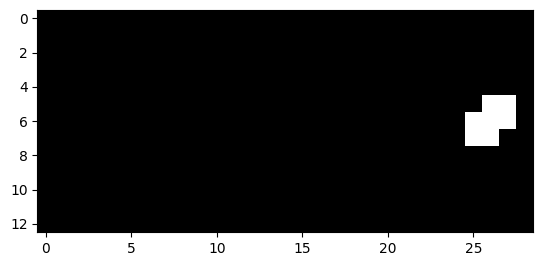

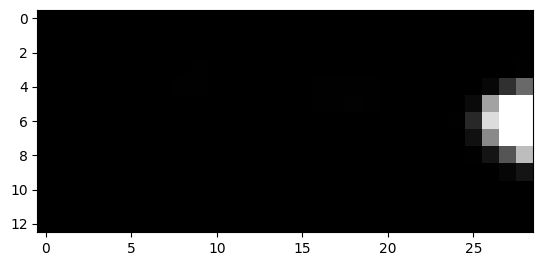

1475


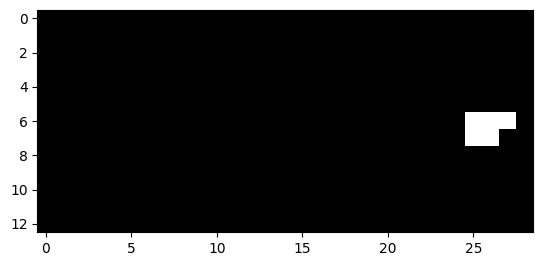

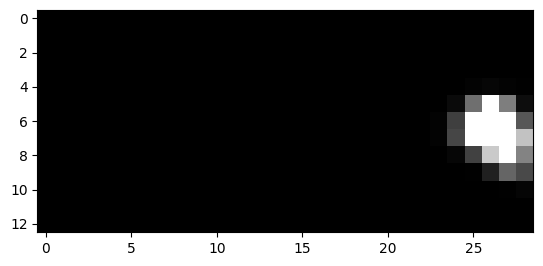

1509


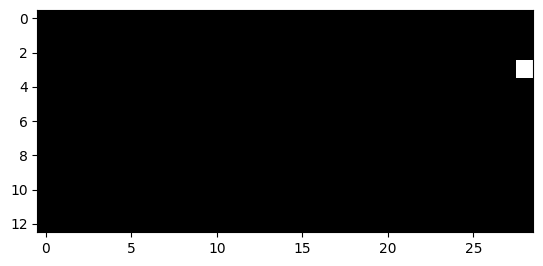

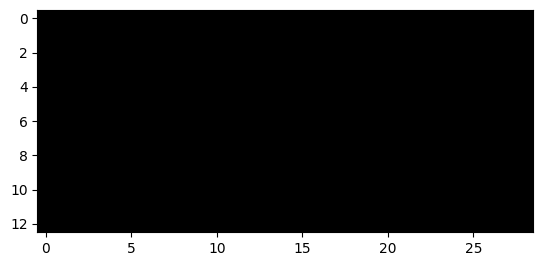

1510


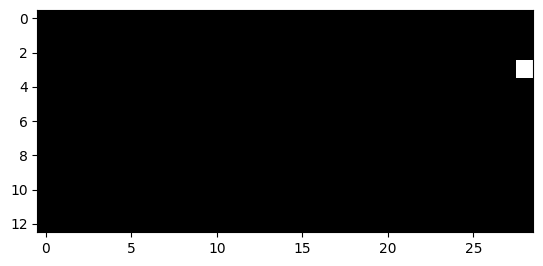

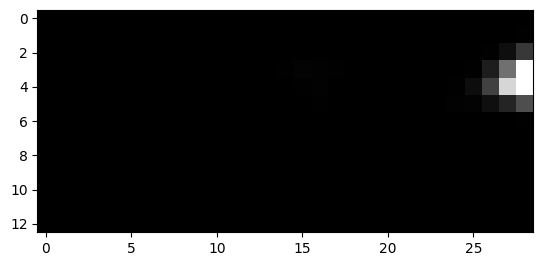

1511


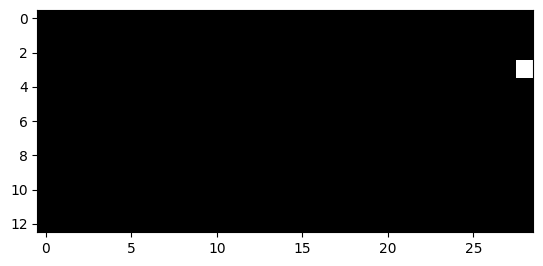

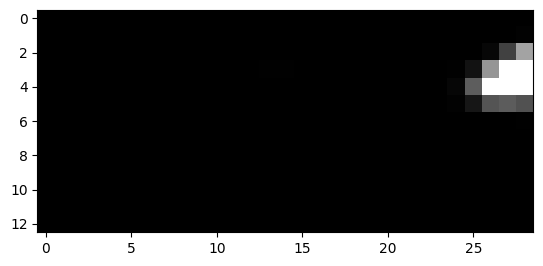

1687


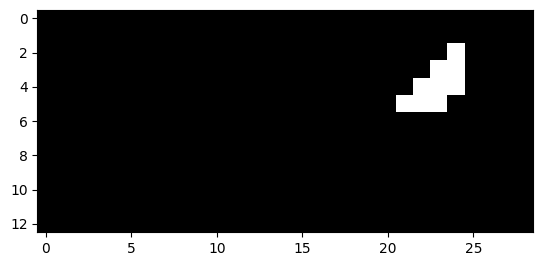

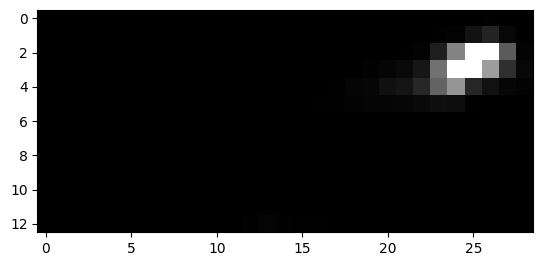

1688


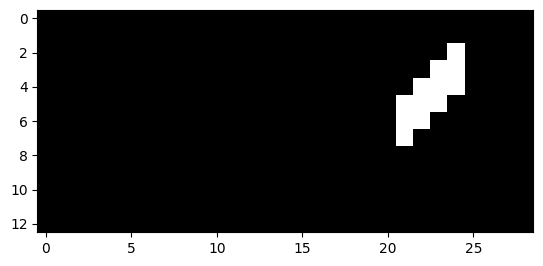

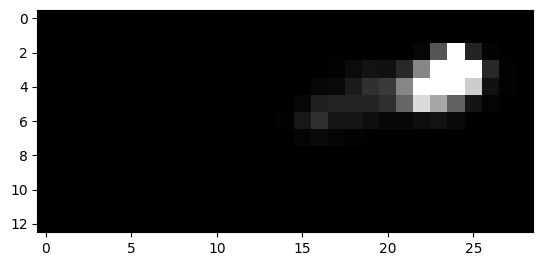

1689


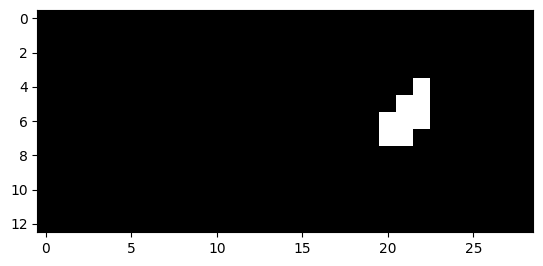

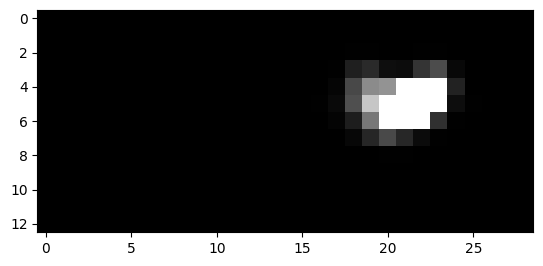

1690


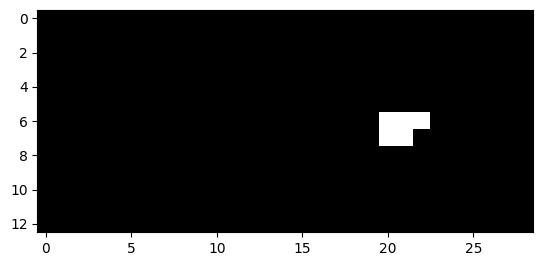

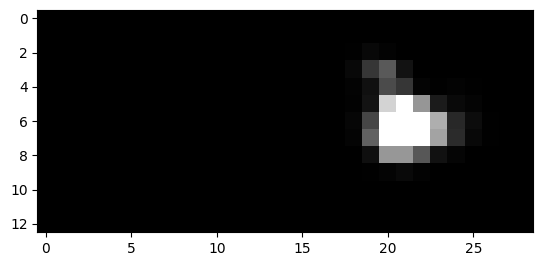

1691


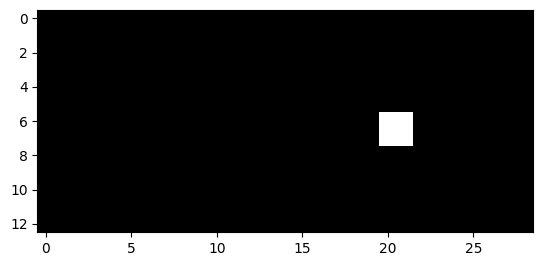

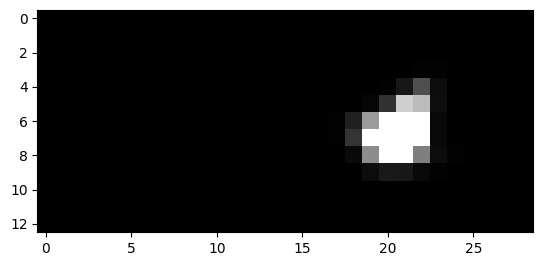

1710


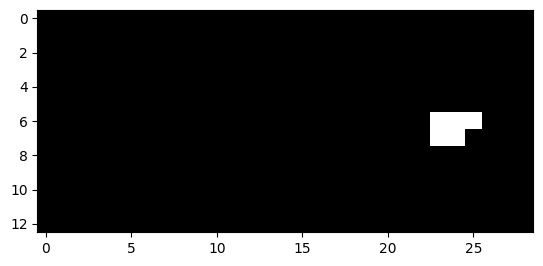

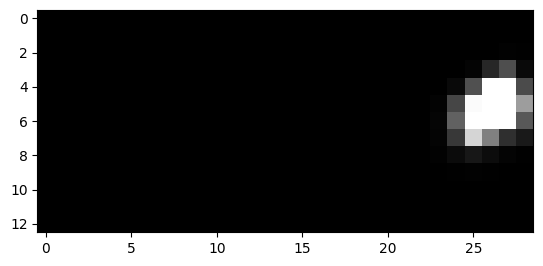

1711


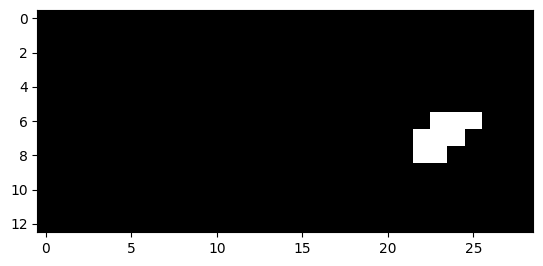

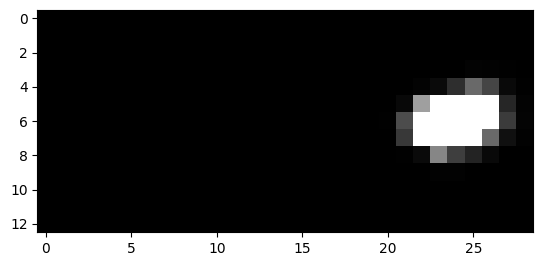

1712


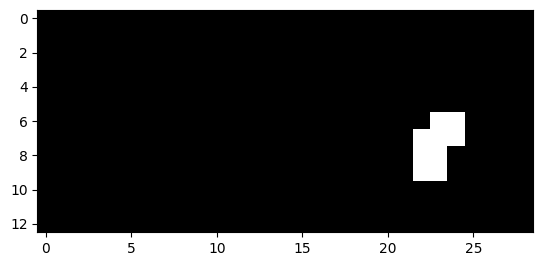

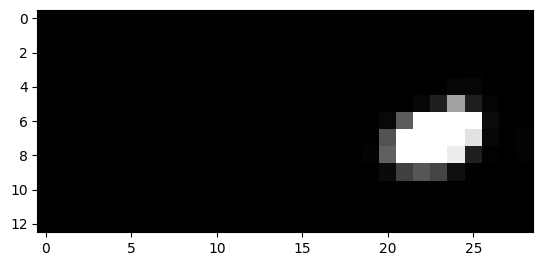

1713


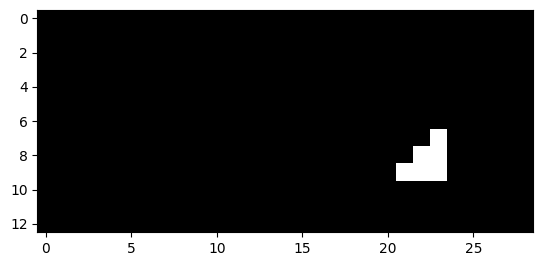

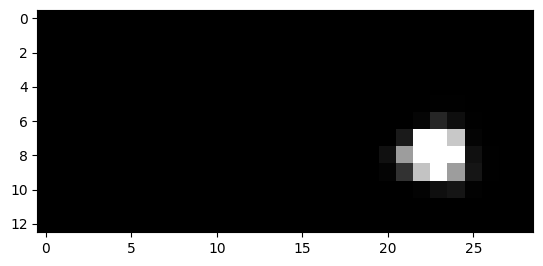

1714


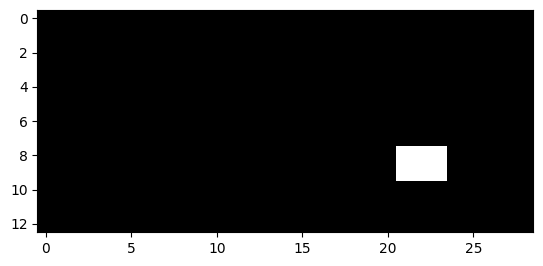

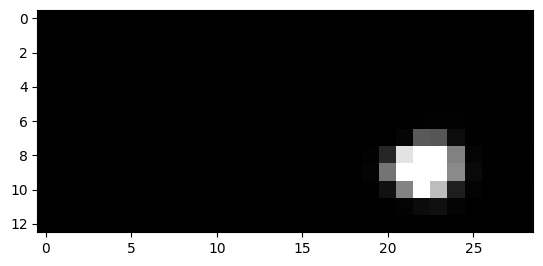

1715


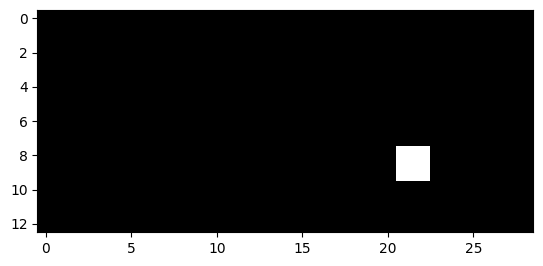

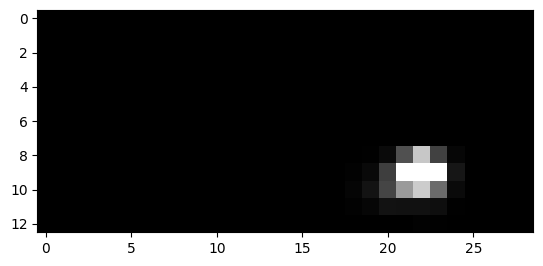

1728


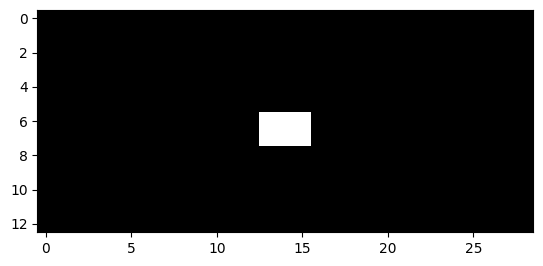

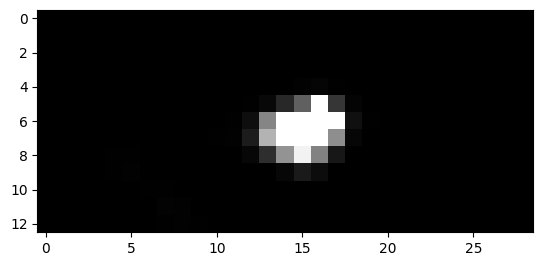

1729


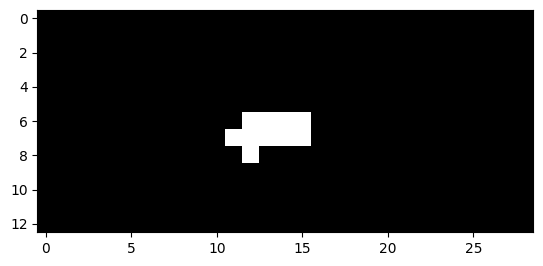

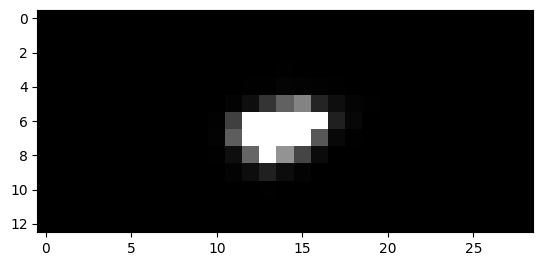

1730


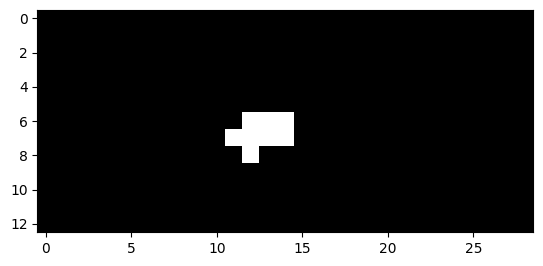

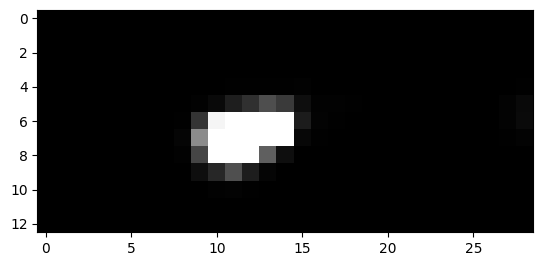

1731


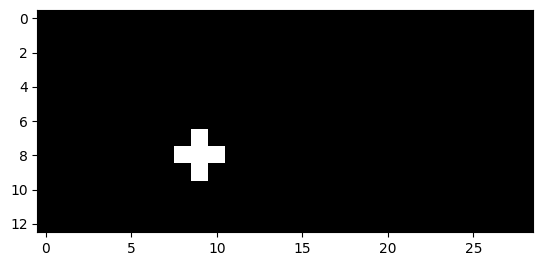

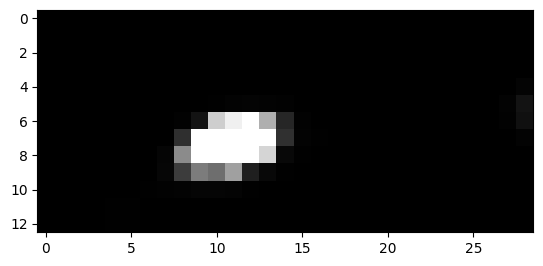

1732


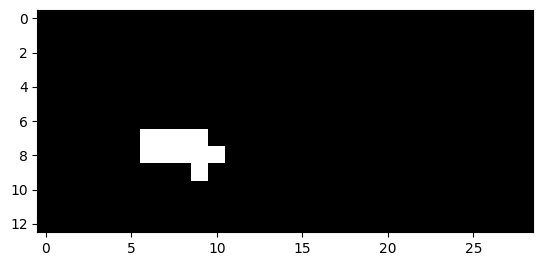

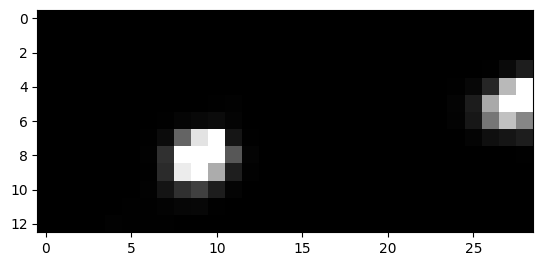

1733


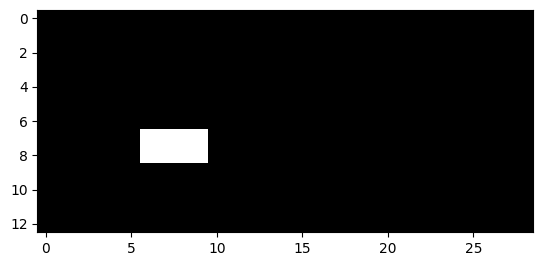

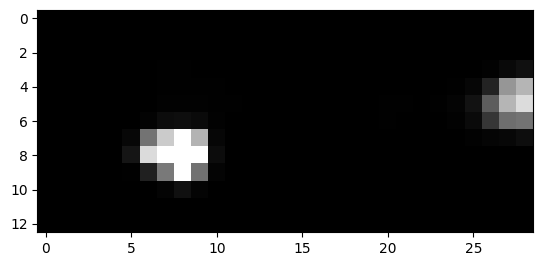

1735


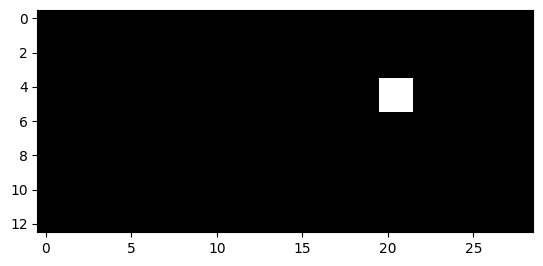

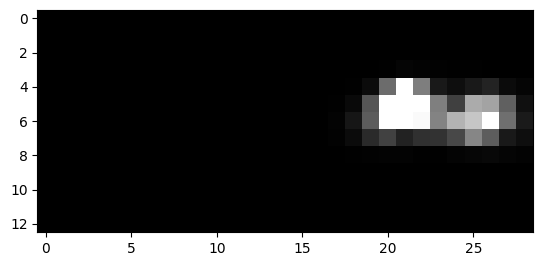

1736


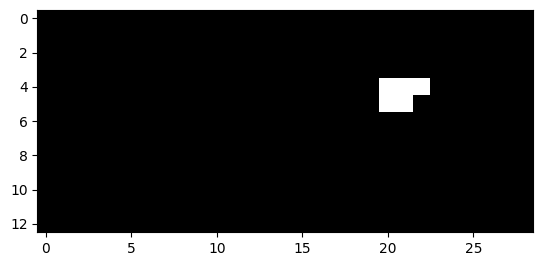

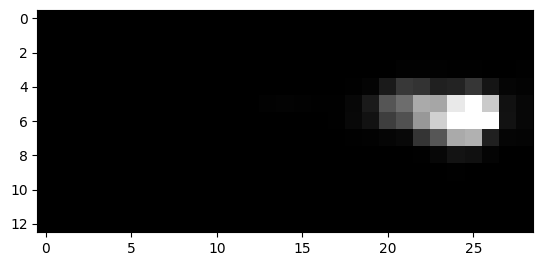

1737


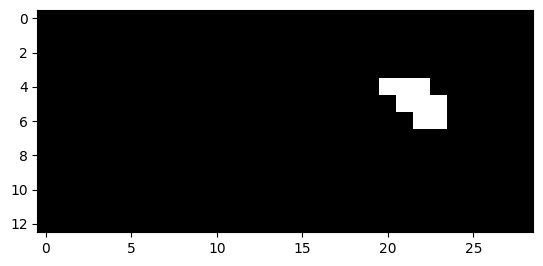

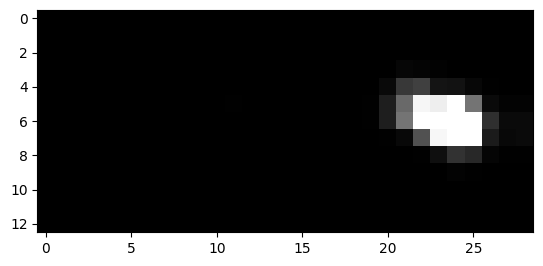

1738


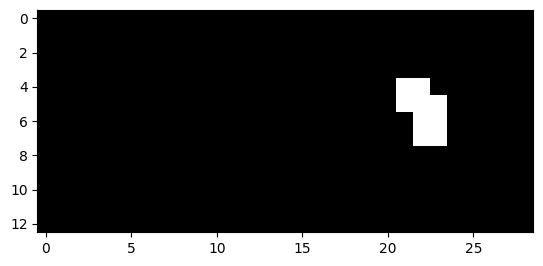

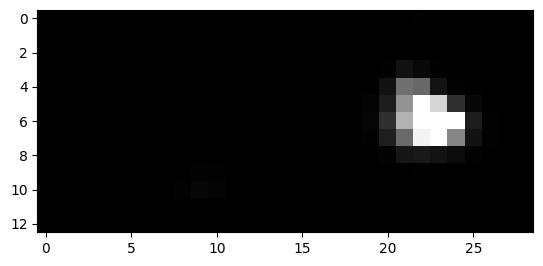

1739


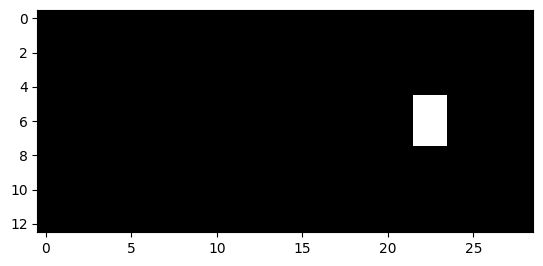

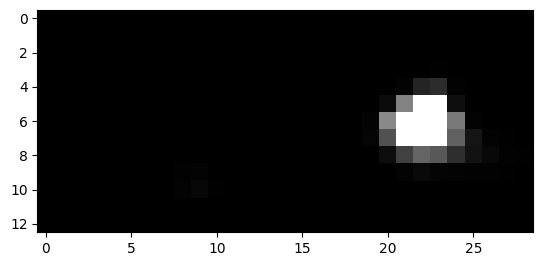

1740


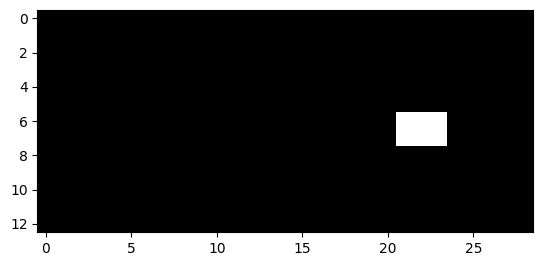

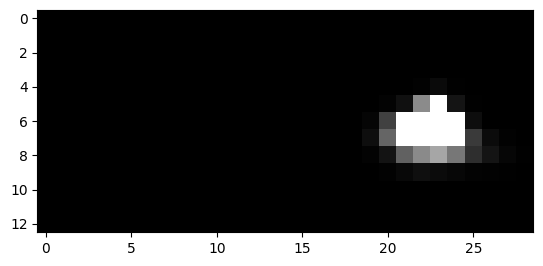

1741


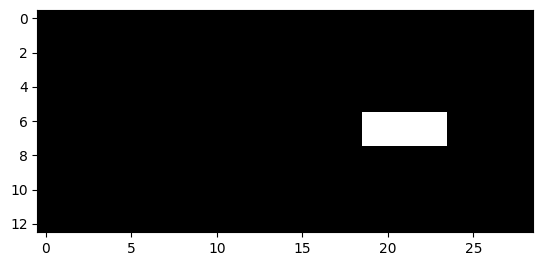

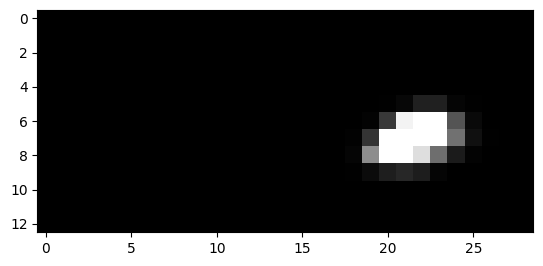

1742


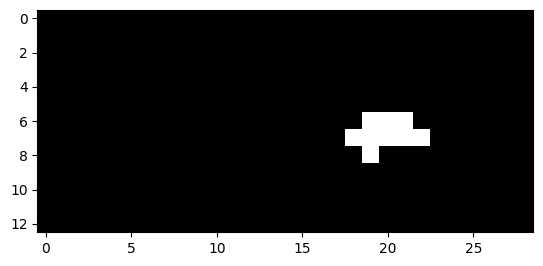

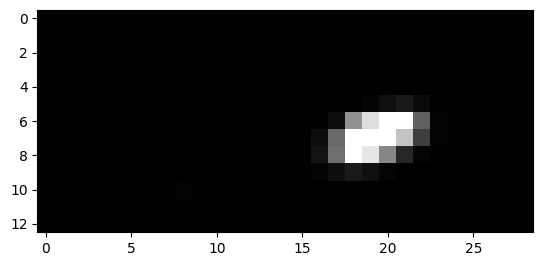

1743


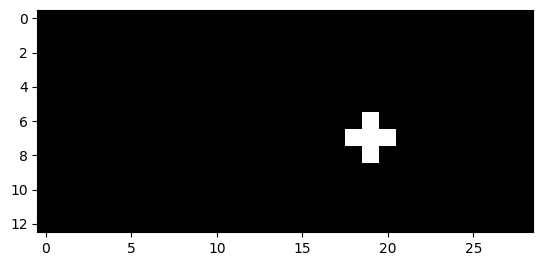

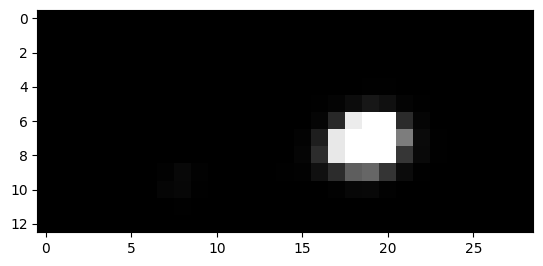

1750


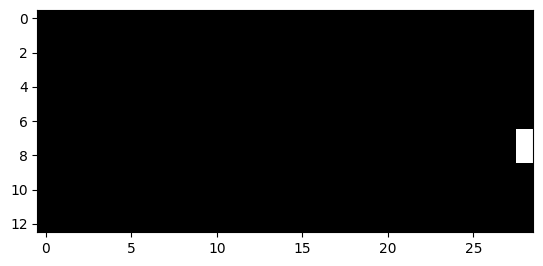

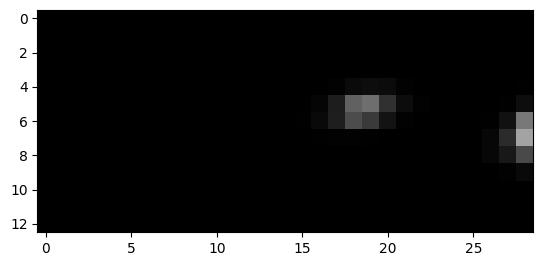

1751


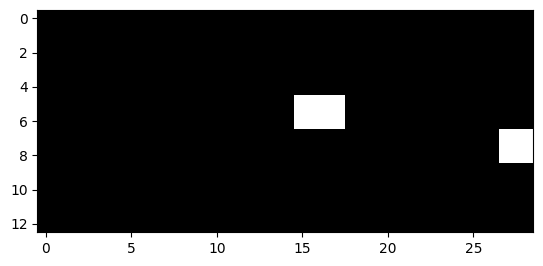

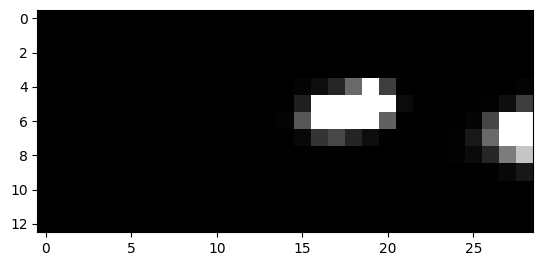

1752


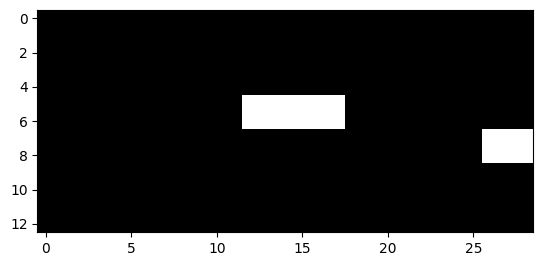

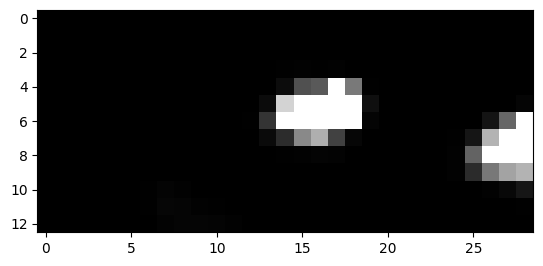

1753


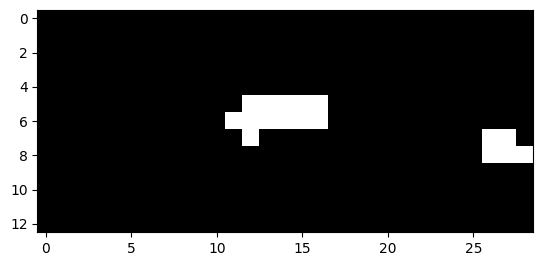

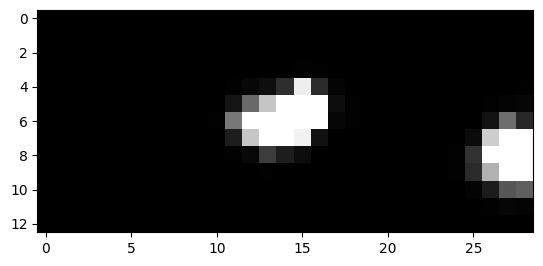

1754


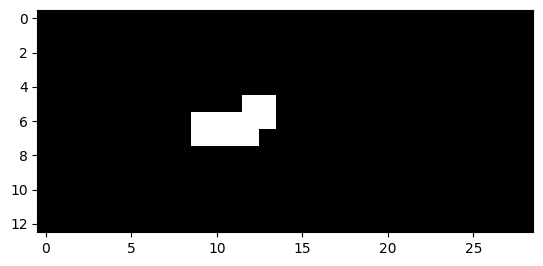

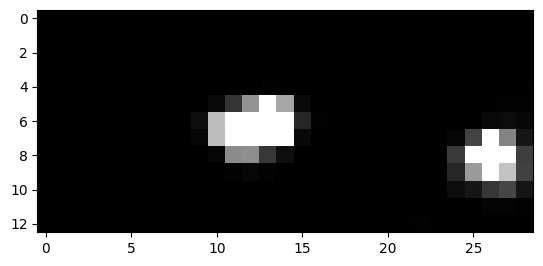

1755


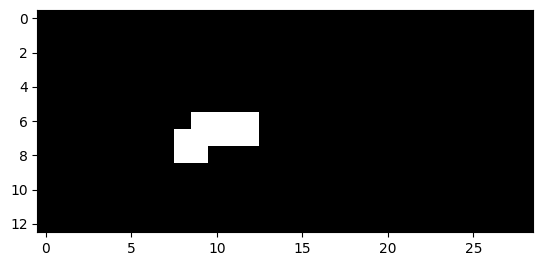

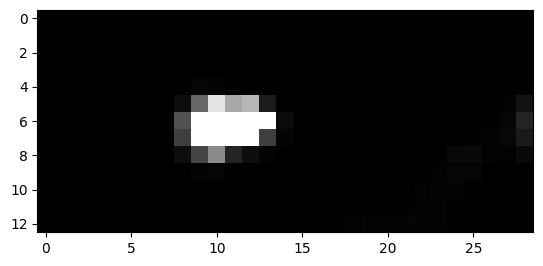

1756


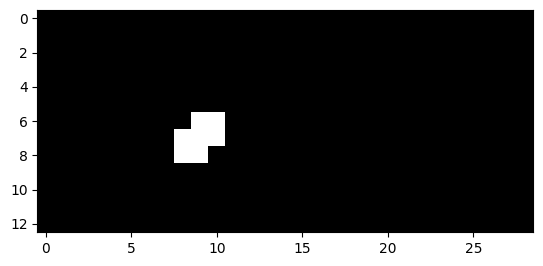

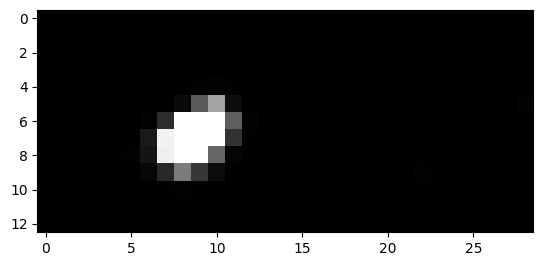

1760


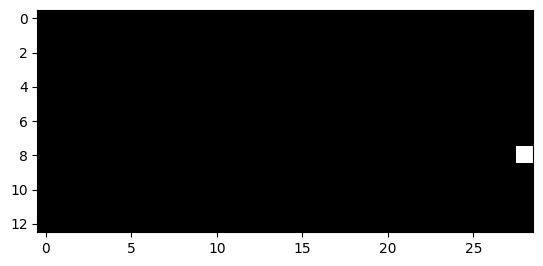

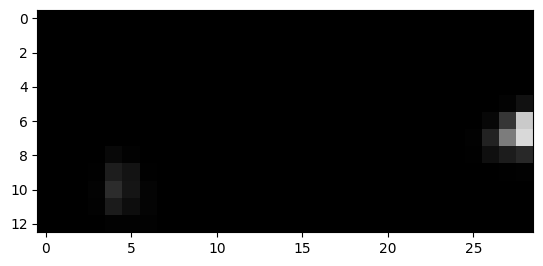

1761


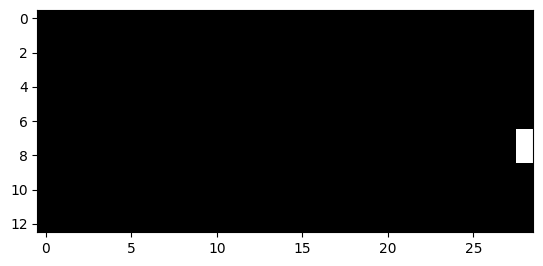

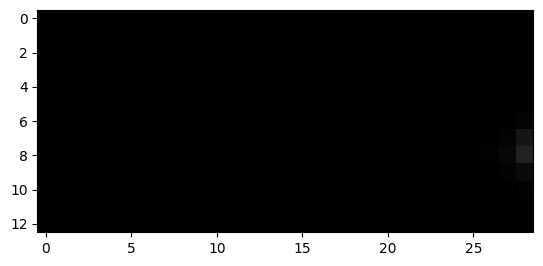

1762


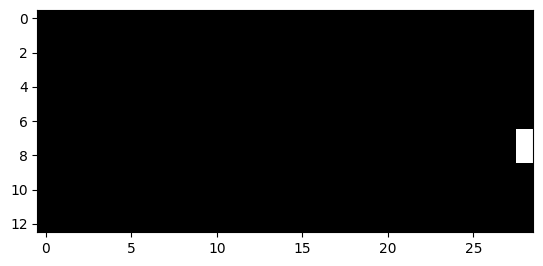

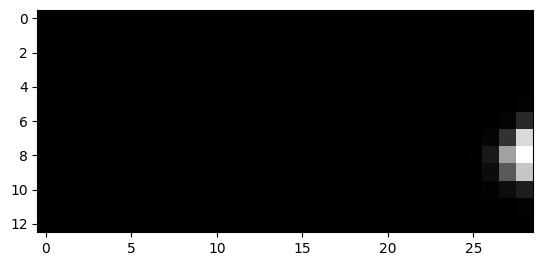

1770


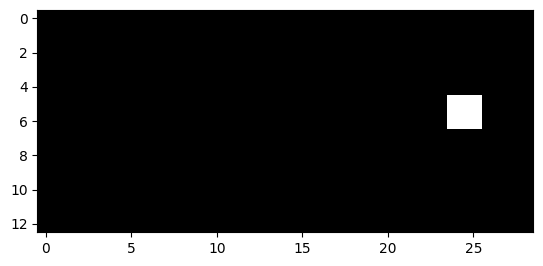

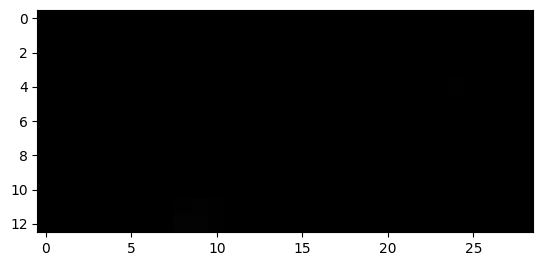

1771


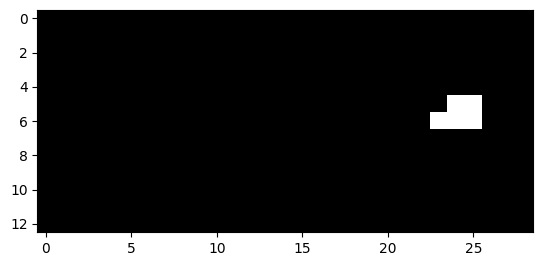

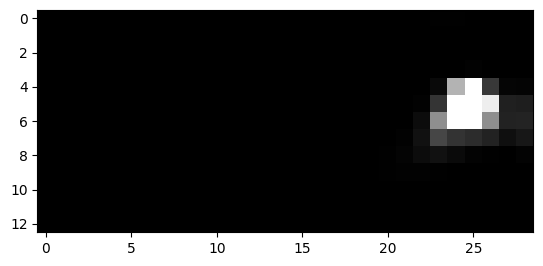

1772


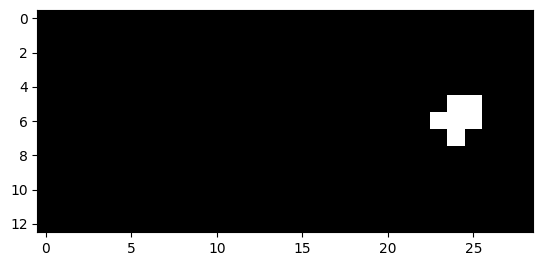

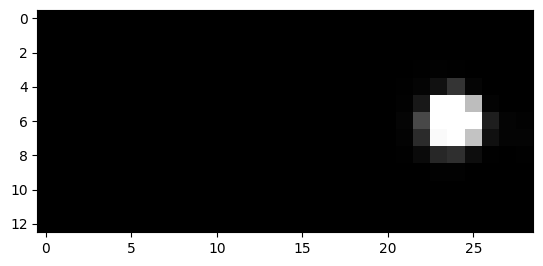

1773


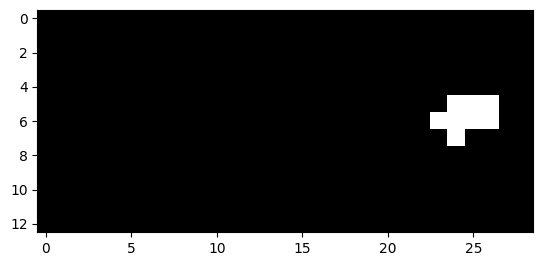

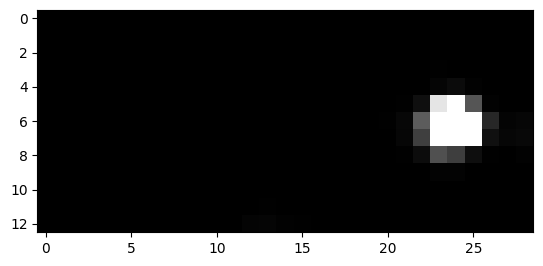

1774


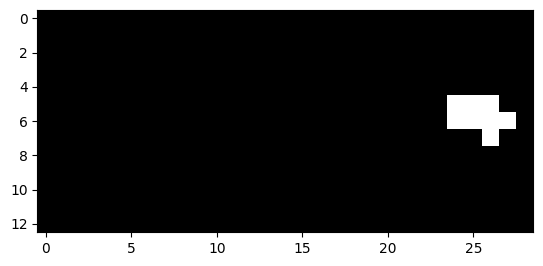

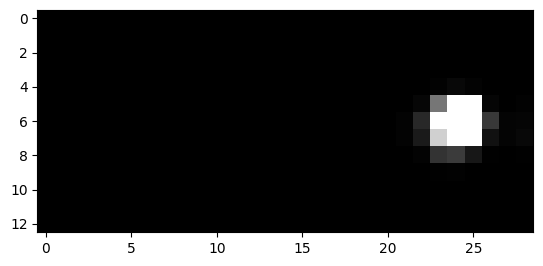

1775


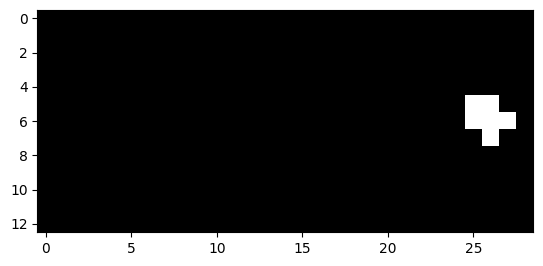

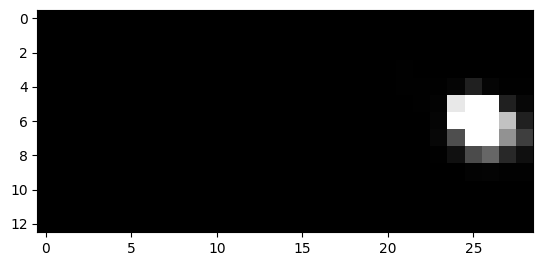

1776


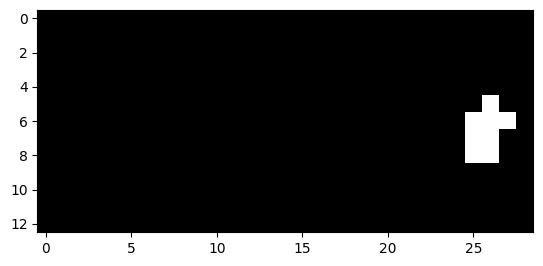

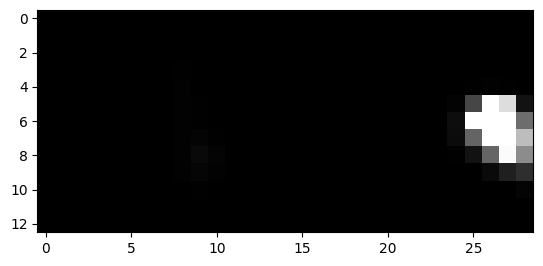

1777


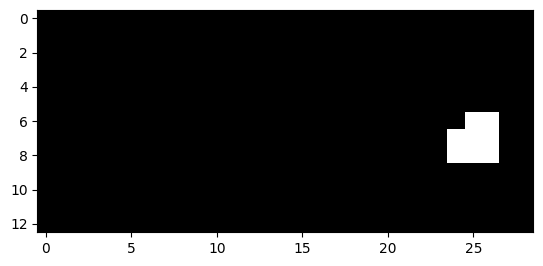

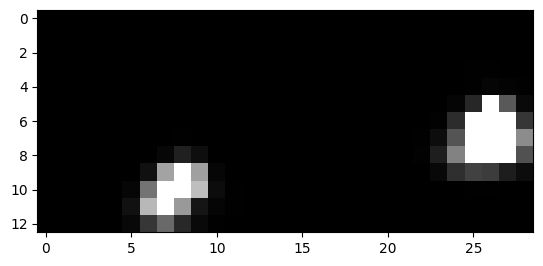

1778


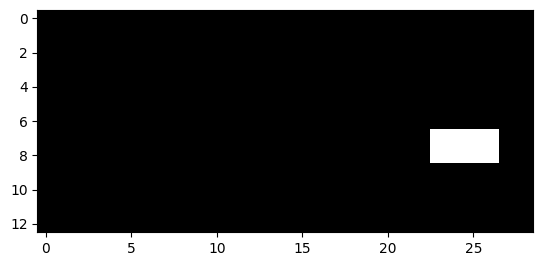

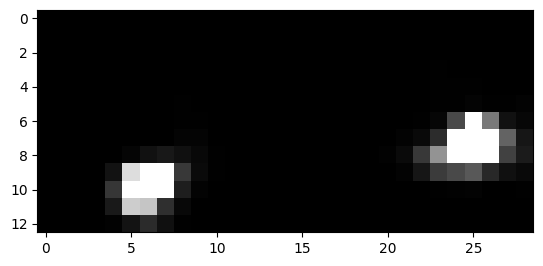

1779


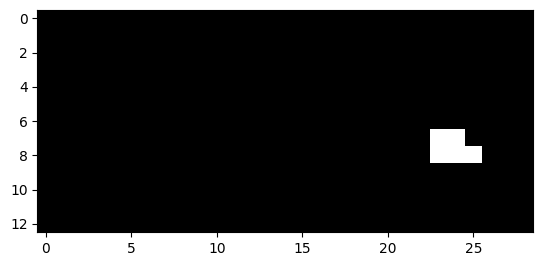

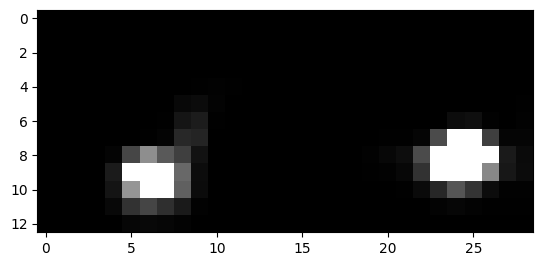

1786


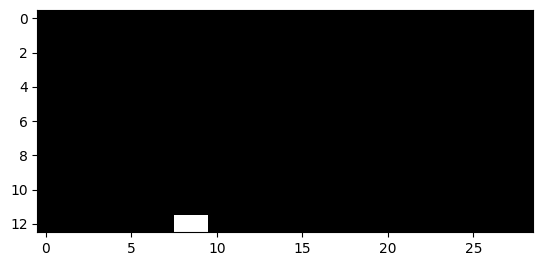

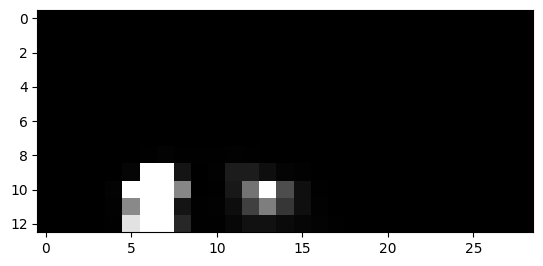

1787


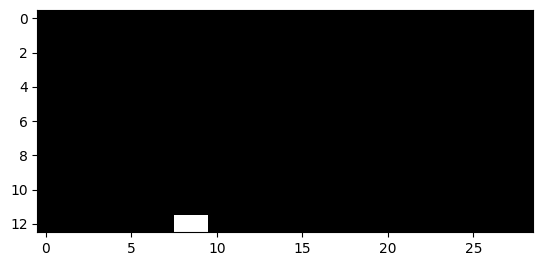

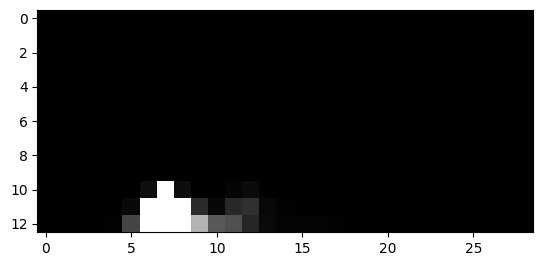

1792


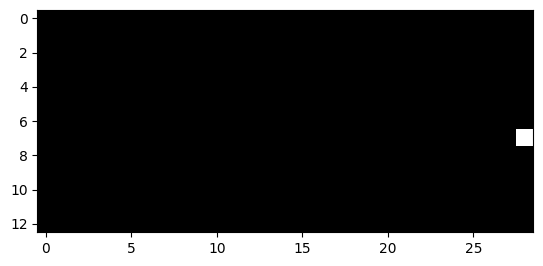

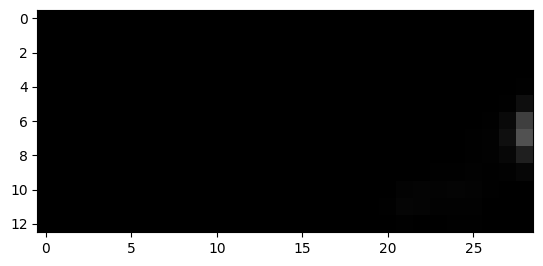

1793


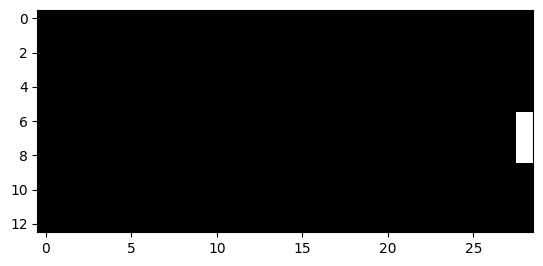

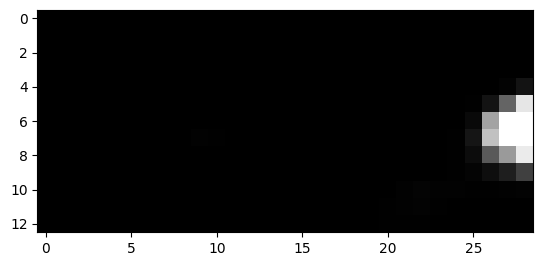

1794


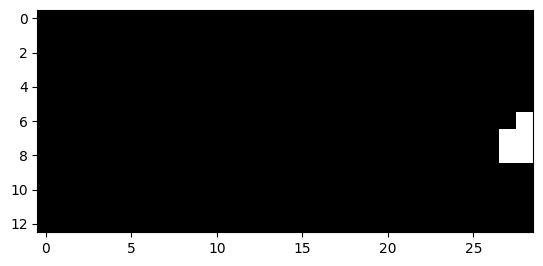

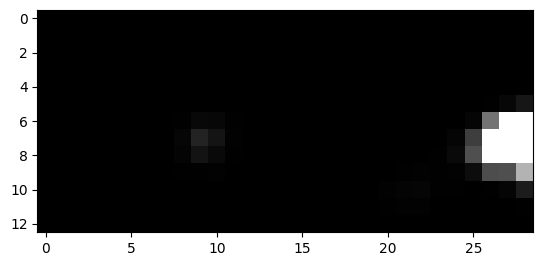

1795


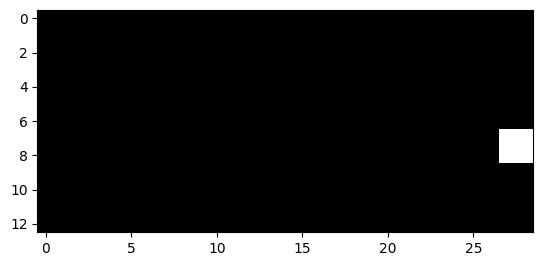

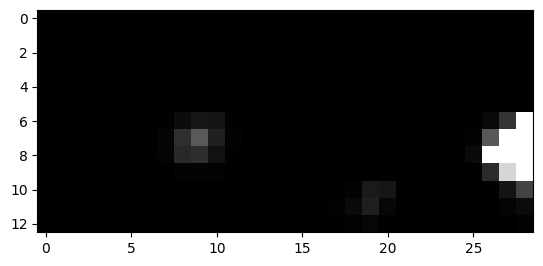

1796


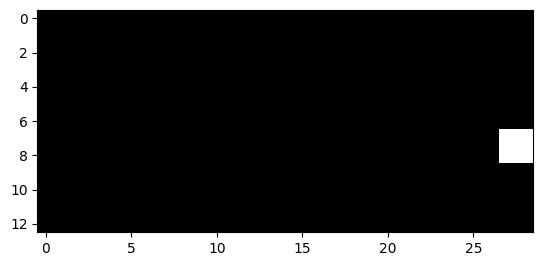

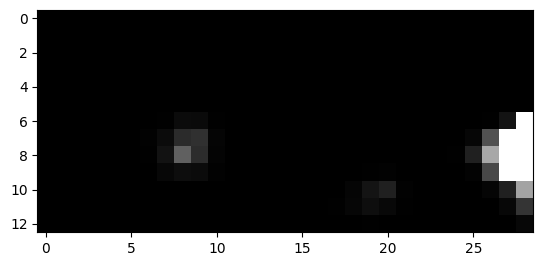

1797


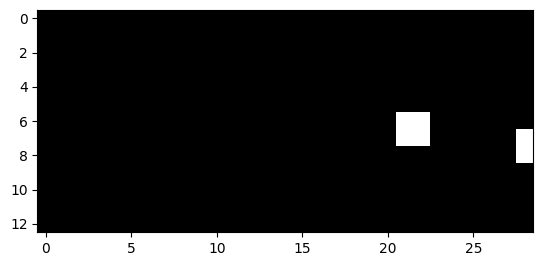

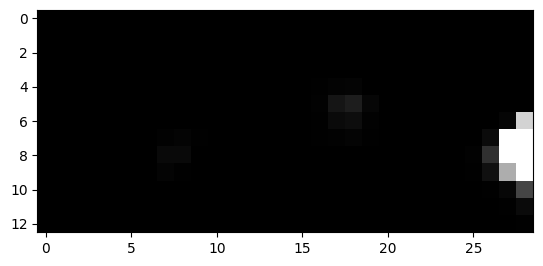

1798


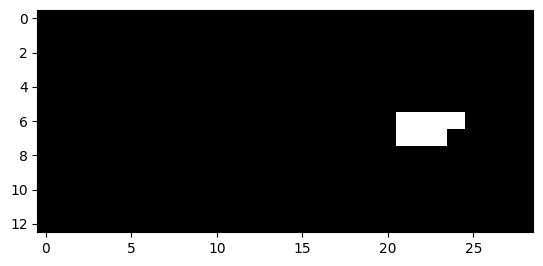

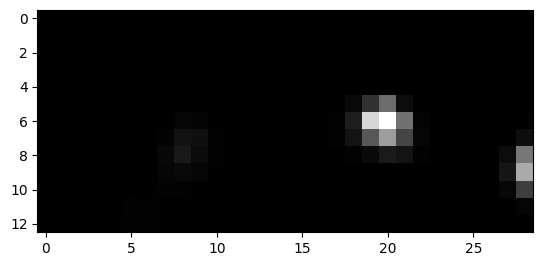

1799


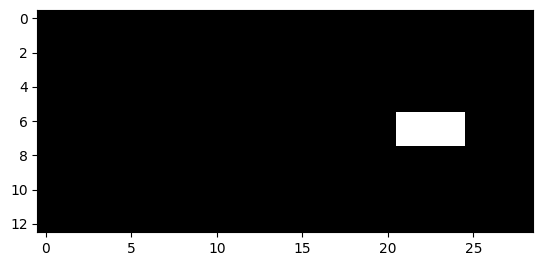

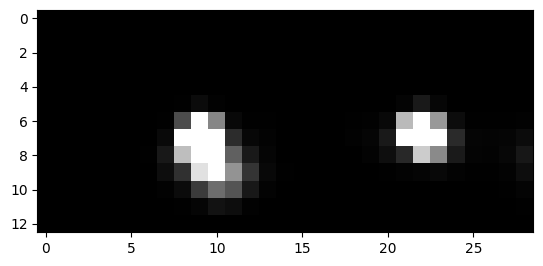

1800


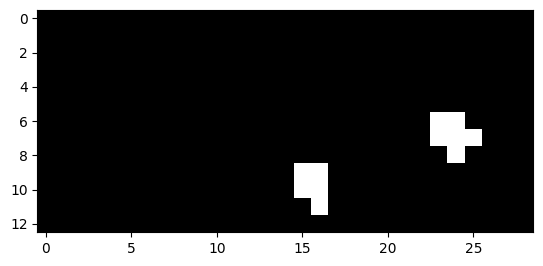

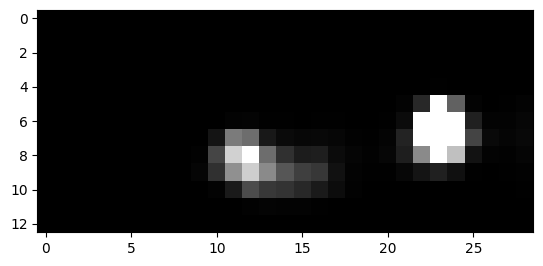

1801


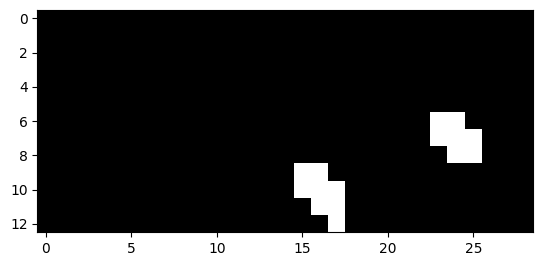

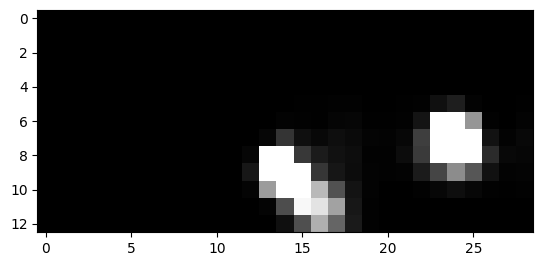

1802


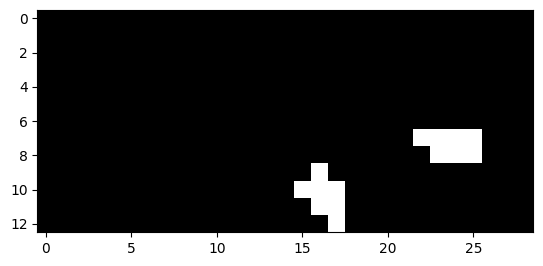

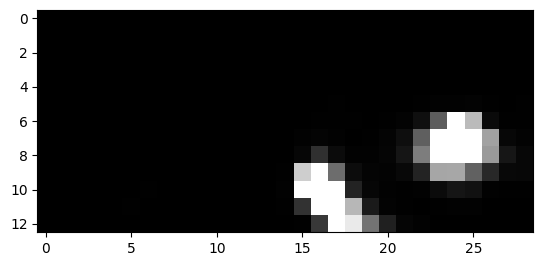

1803


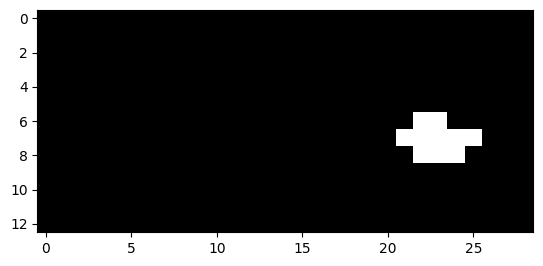

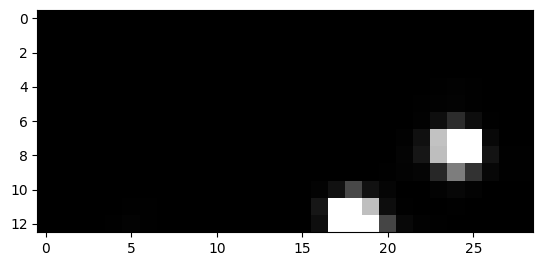

1804


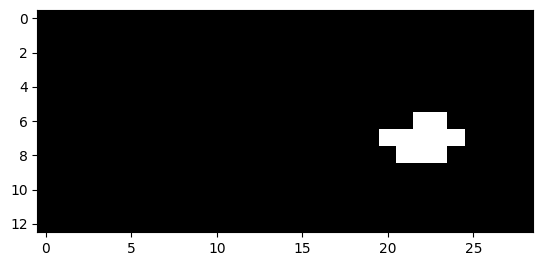

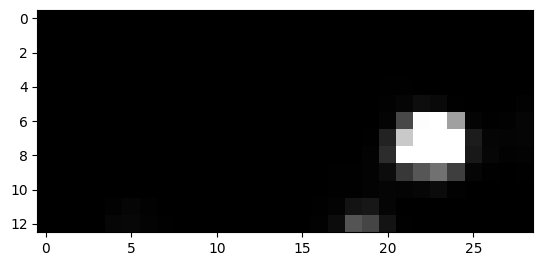

1805


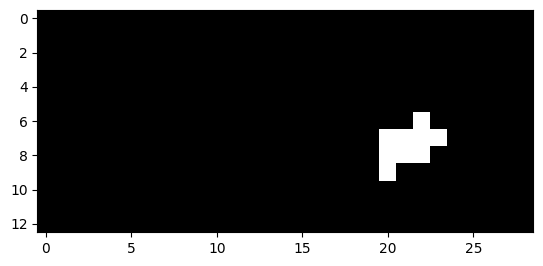

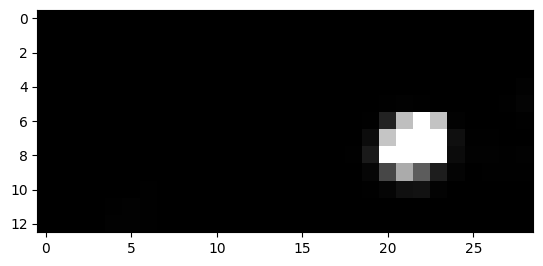

1806


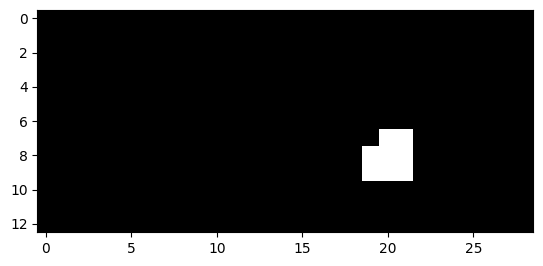

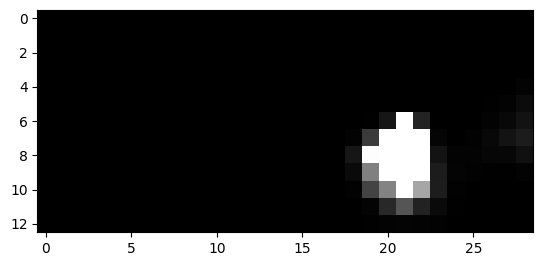

1807


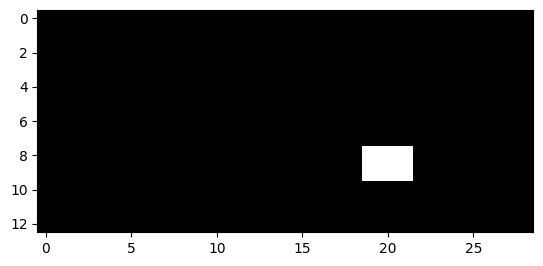

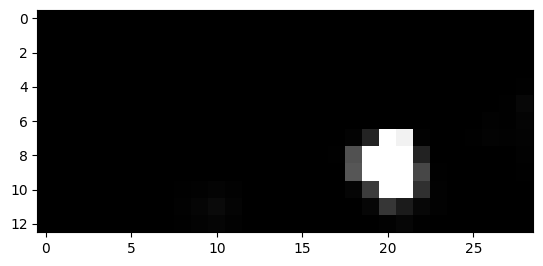

1808


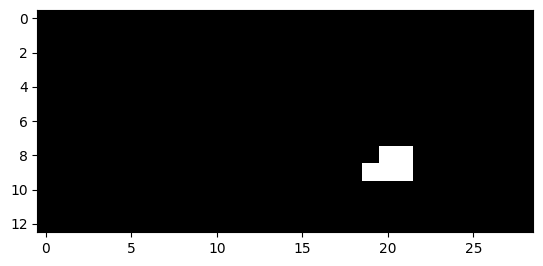

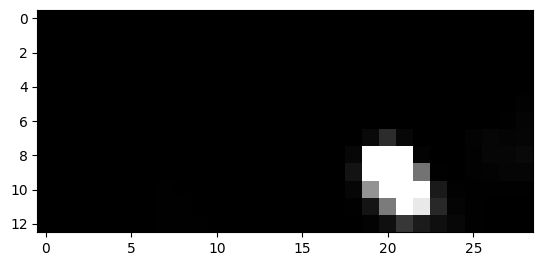

1809


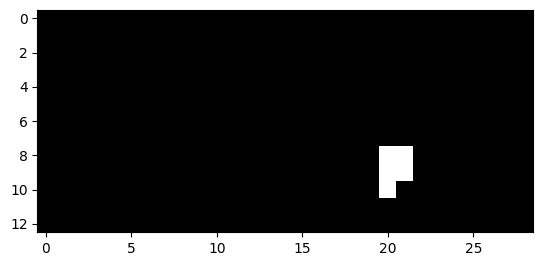

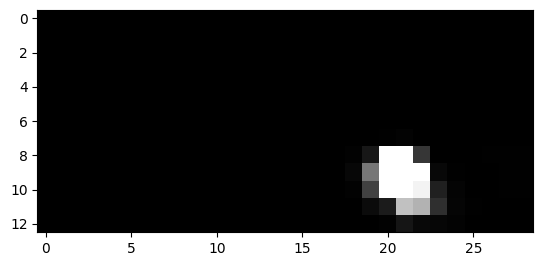

1810


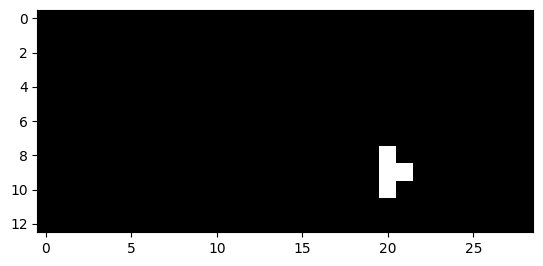

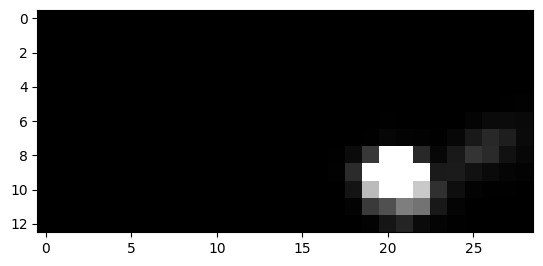

1845


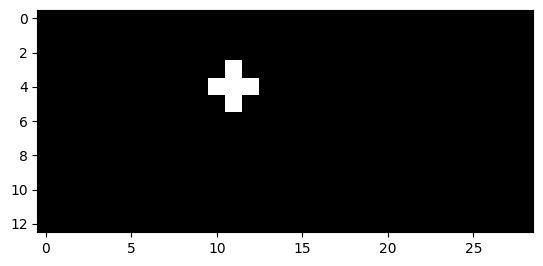

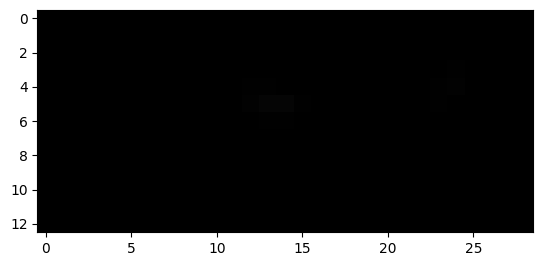

1846


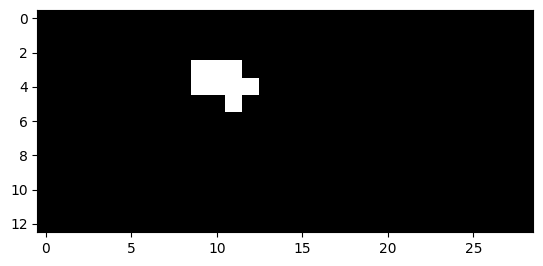

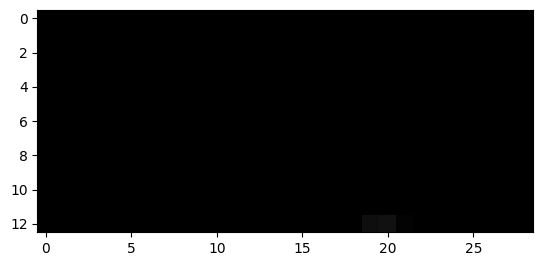

1847


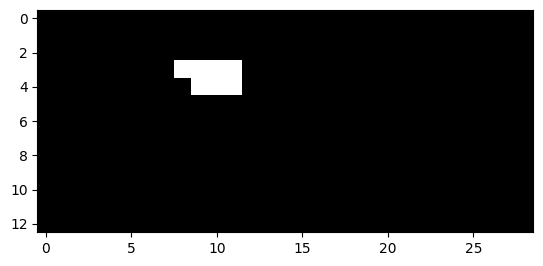

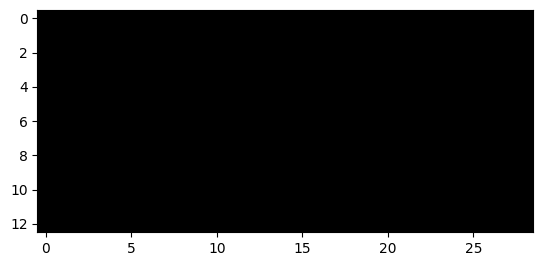

1848


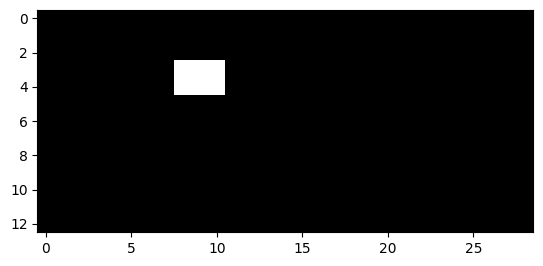

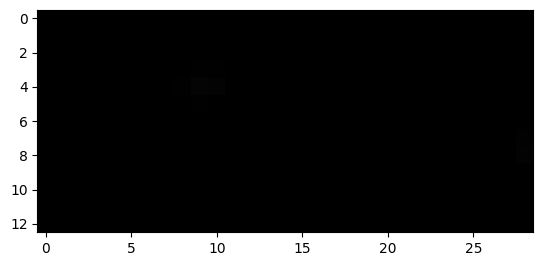

1849


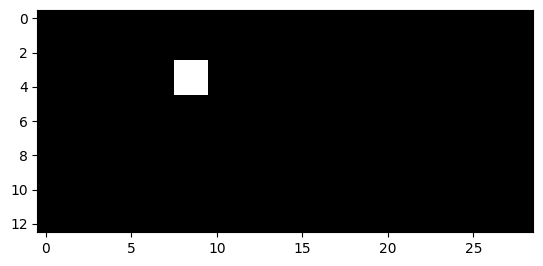

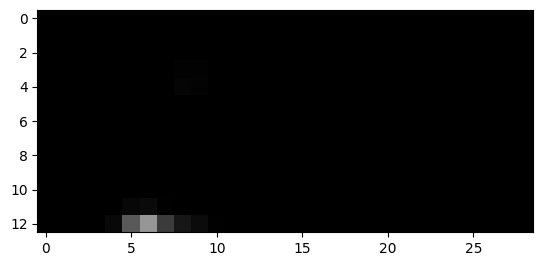

2122


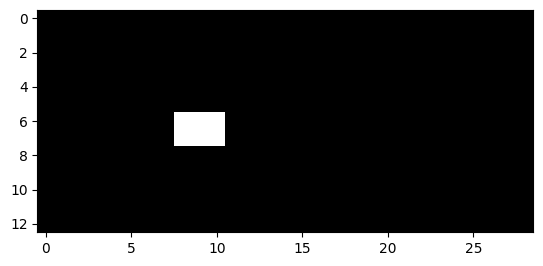

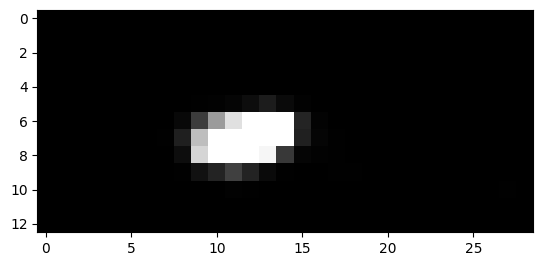

2123


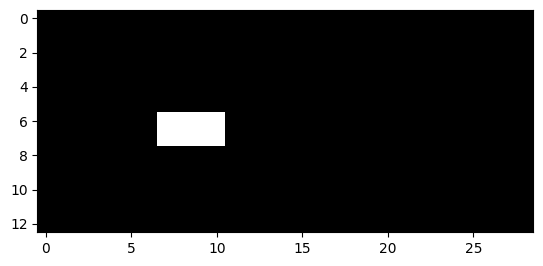

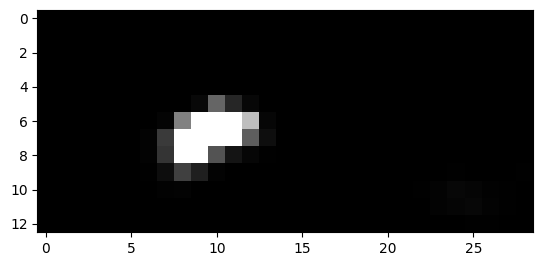

2124


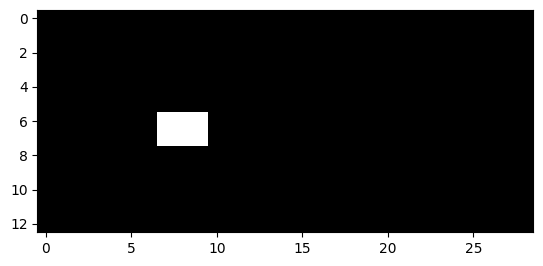

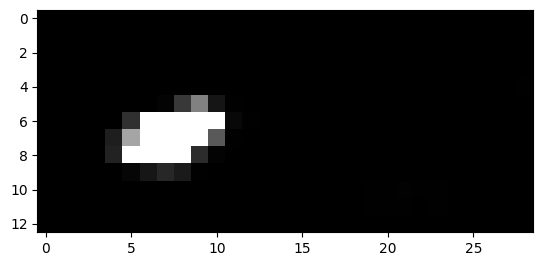

2126


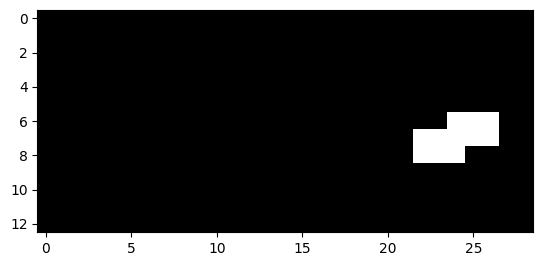

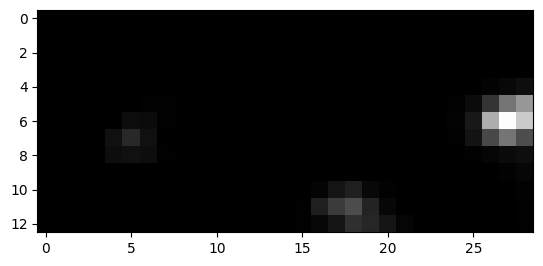

2127


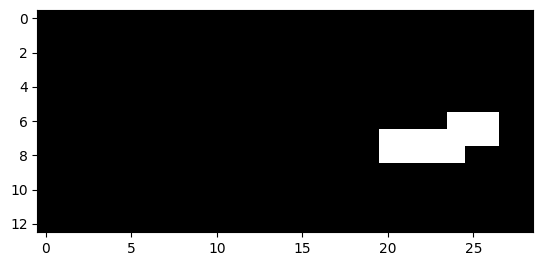

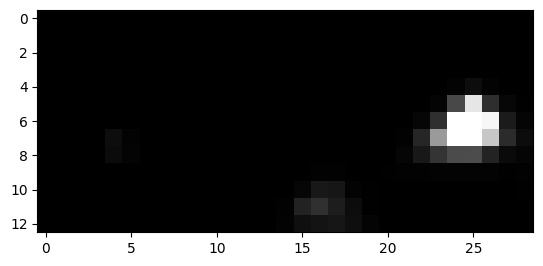

2128


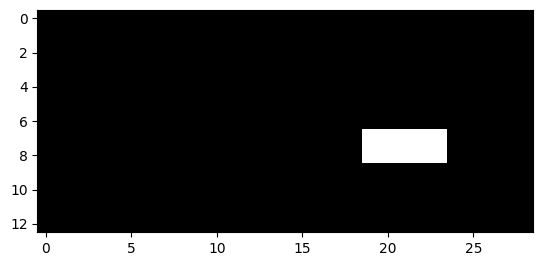

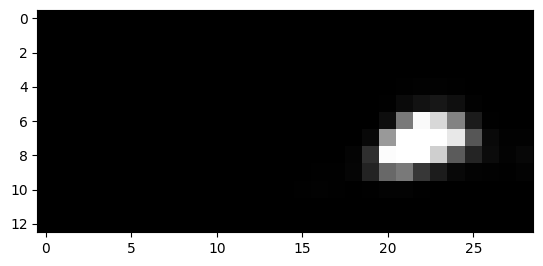

2129


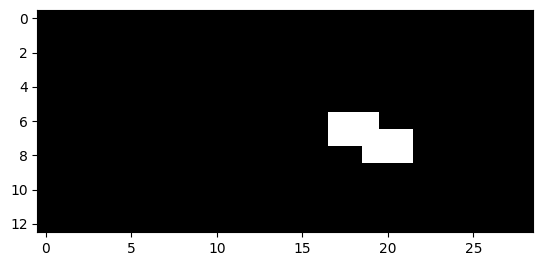

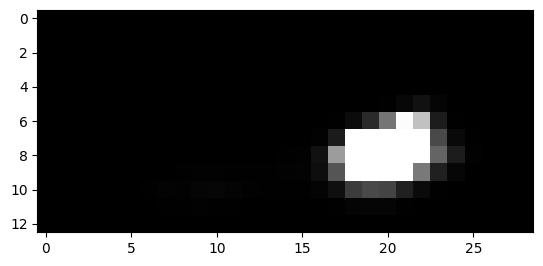

2130


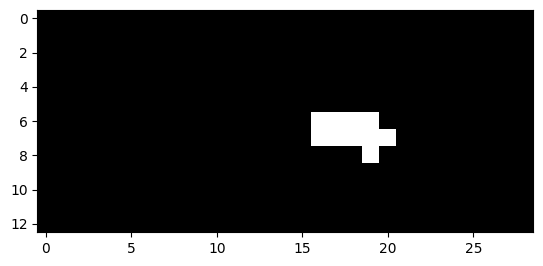

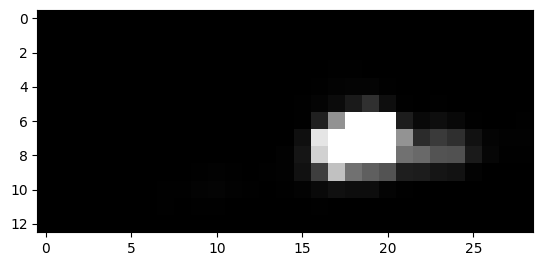

2131


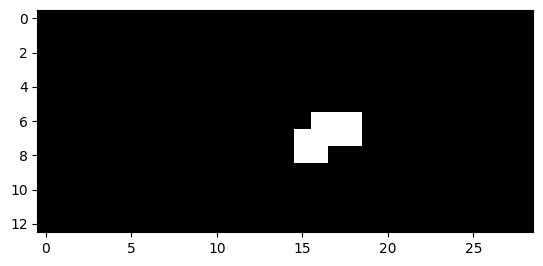

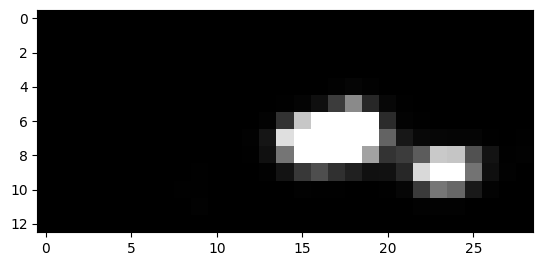

2132


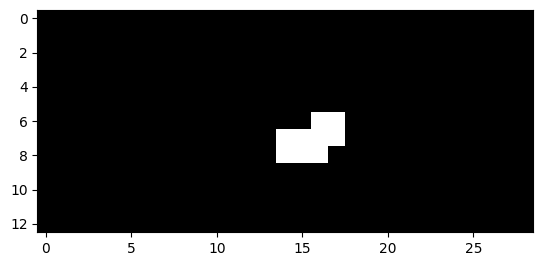

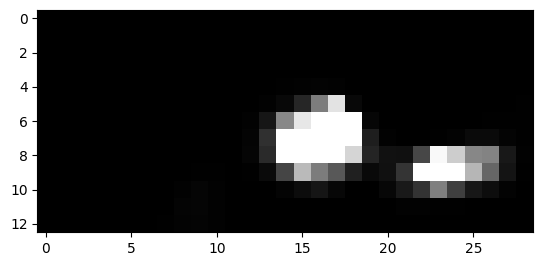

2133


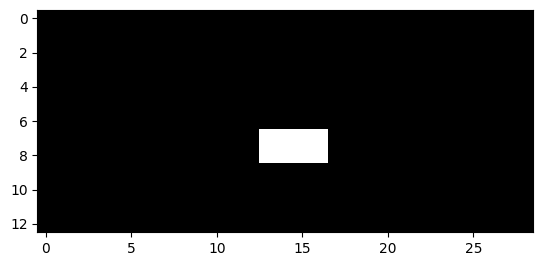

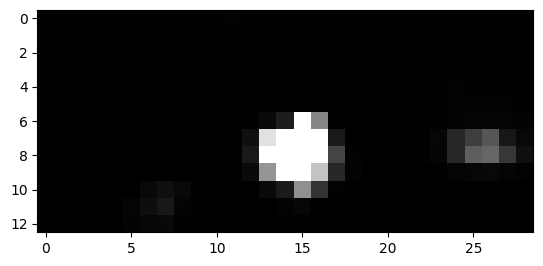

2134


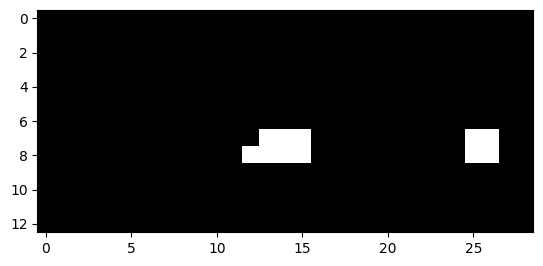

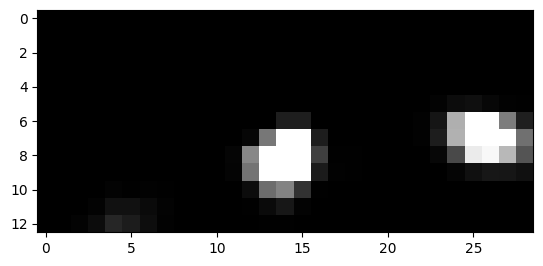

2135


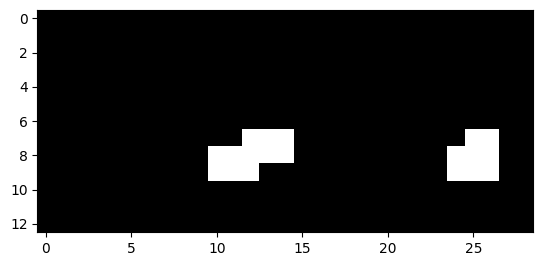

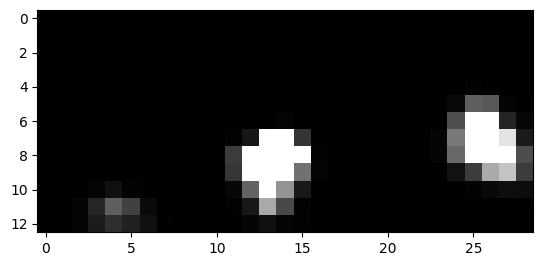

2136


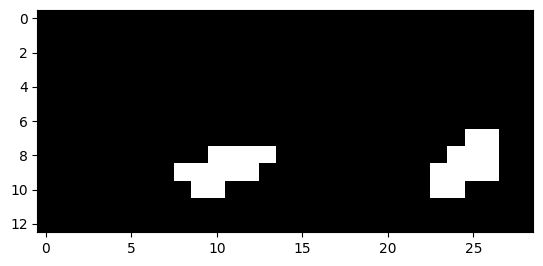

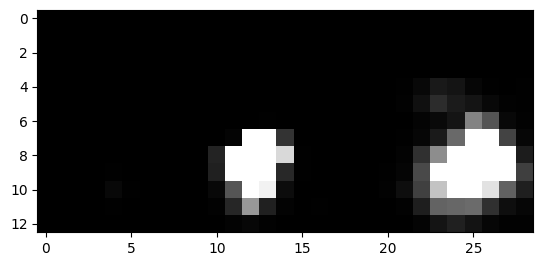

2137


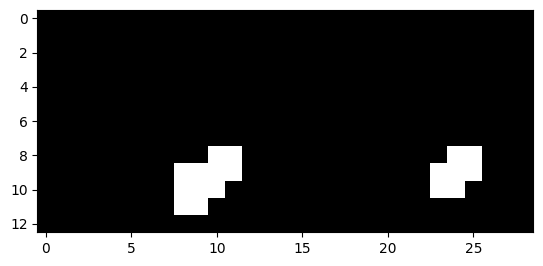

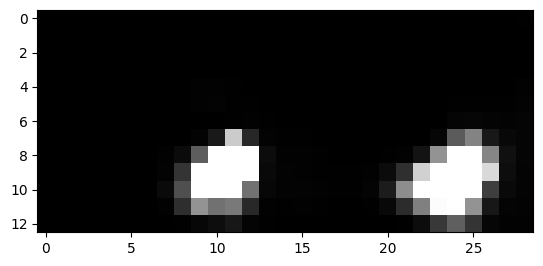

2138


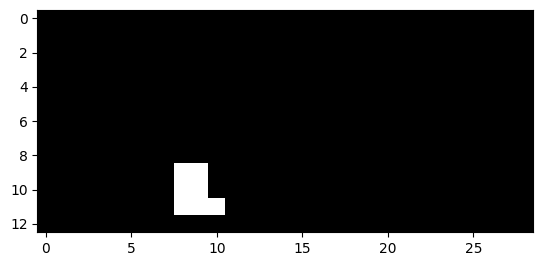

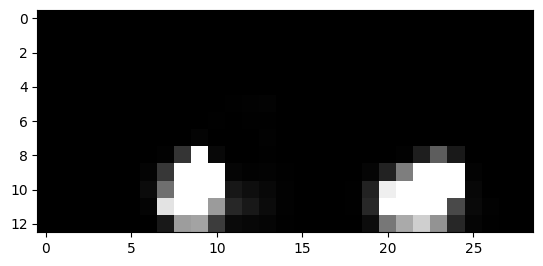

2139


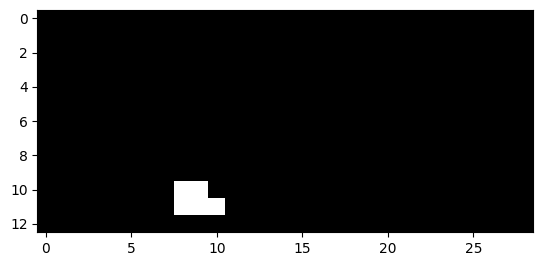

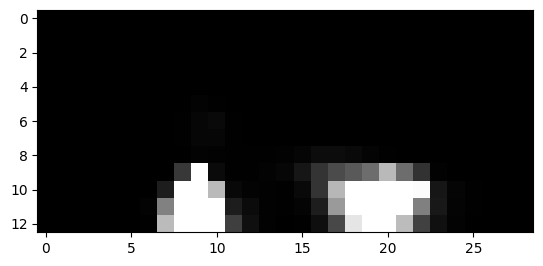

2143


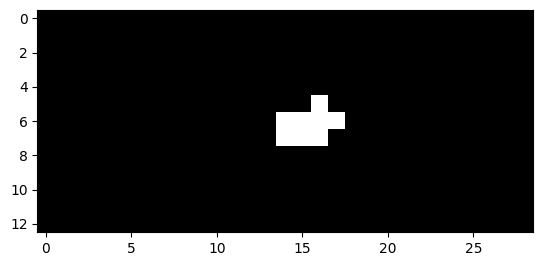

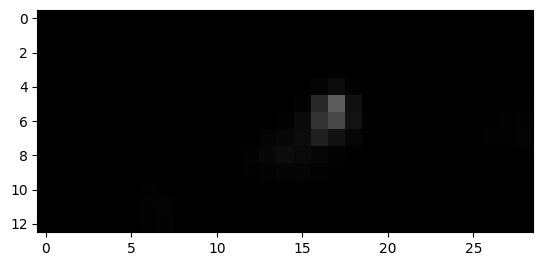

2144


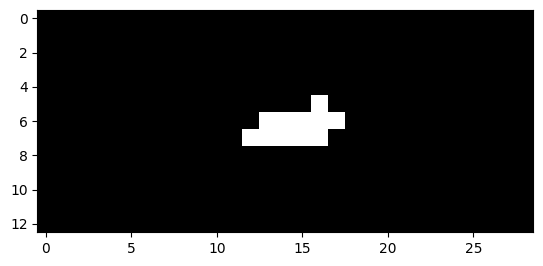

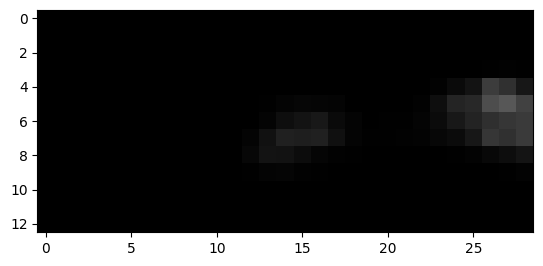

2145


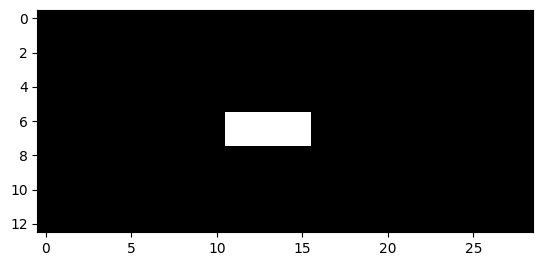

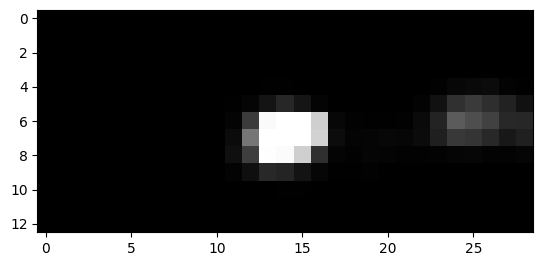

2146


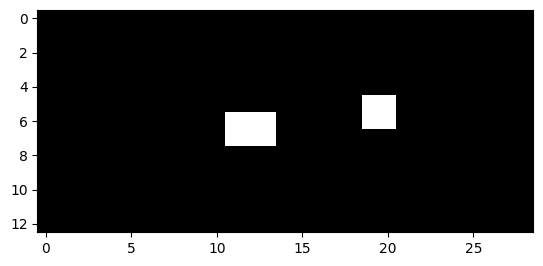

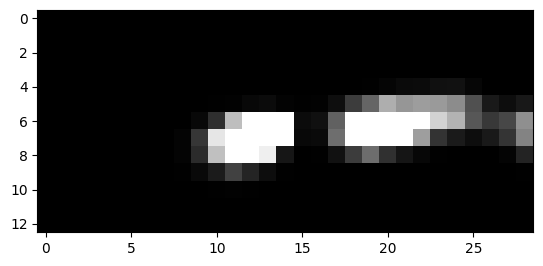

2147


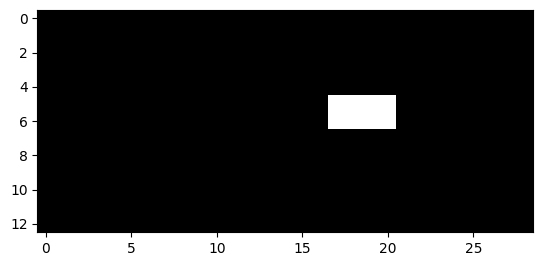

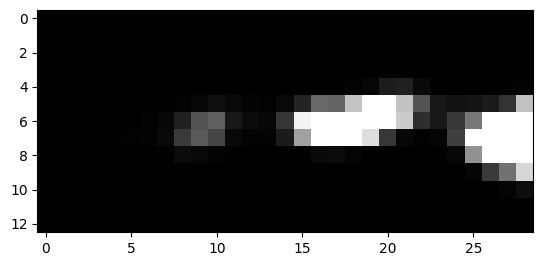

2148


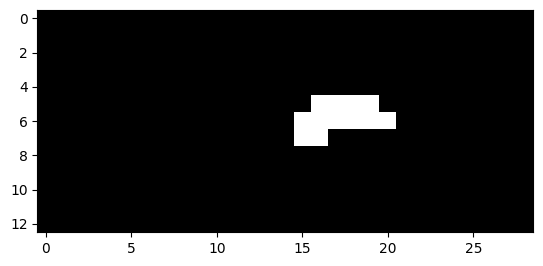

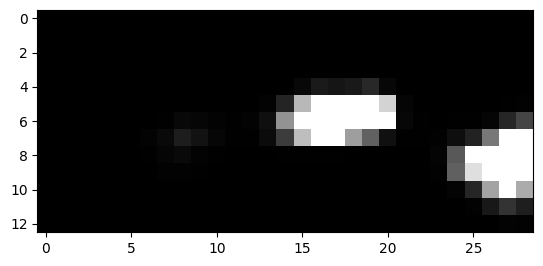

2149


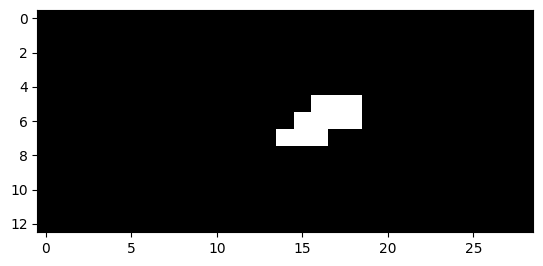

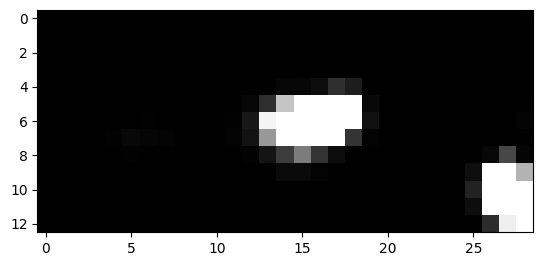

2150


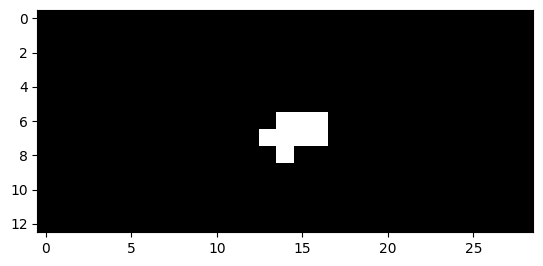

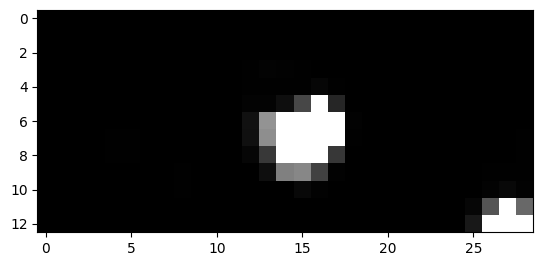

2151


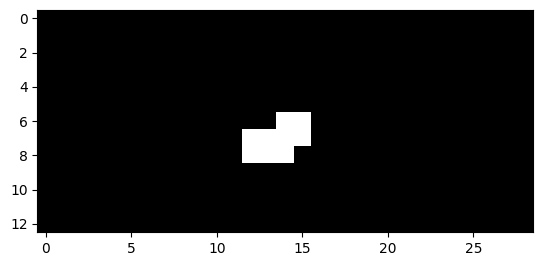

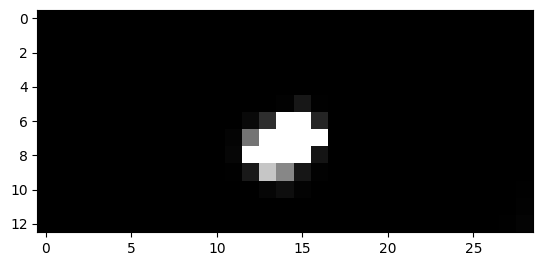

2152


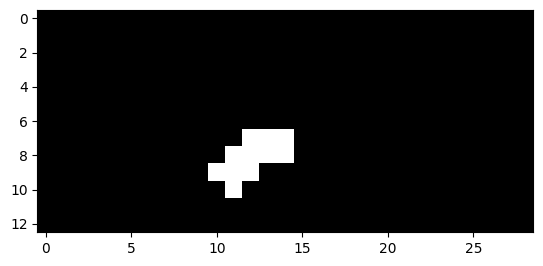

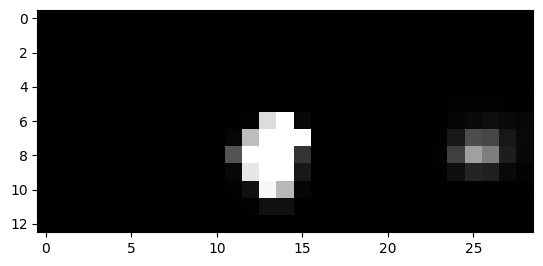

2153


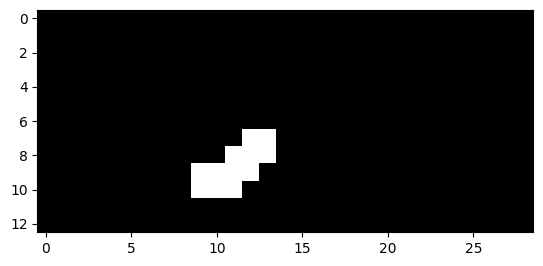

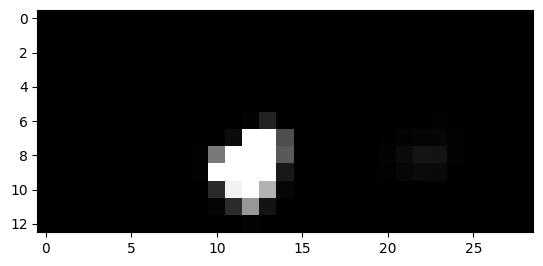

2154


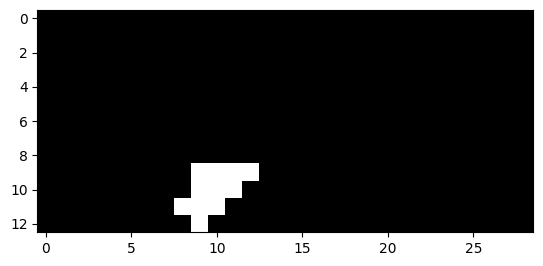

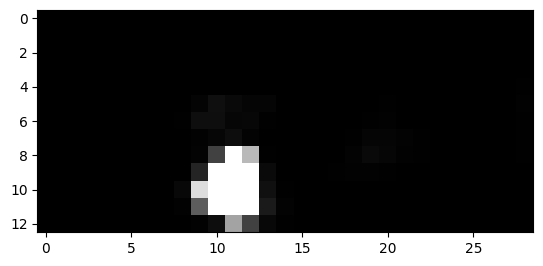

2155


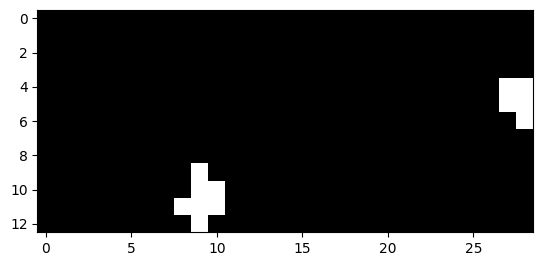

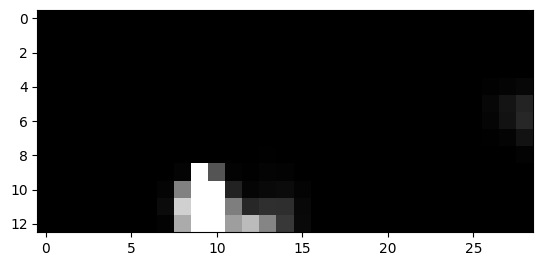

2156


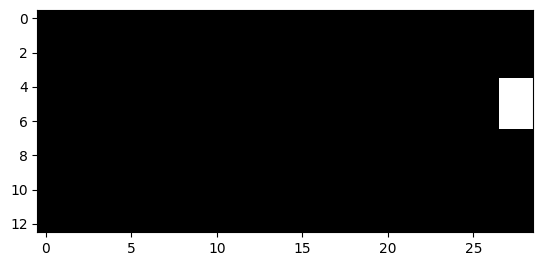

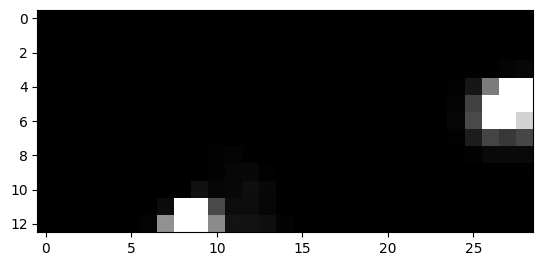

2157


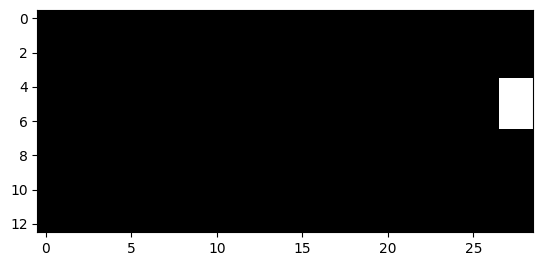

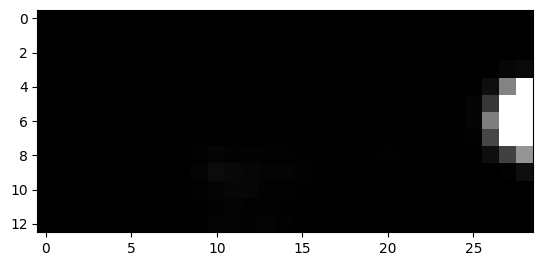

2166


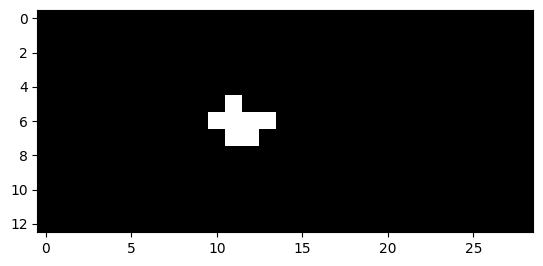

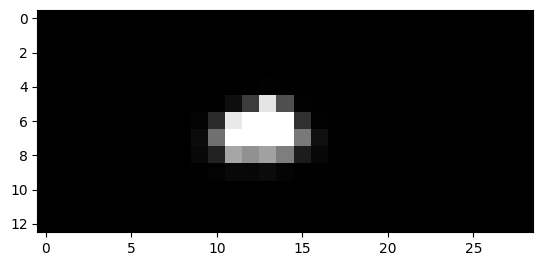

2167


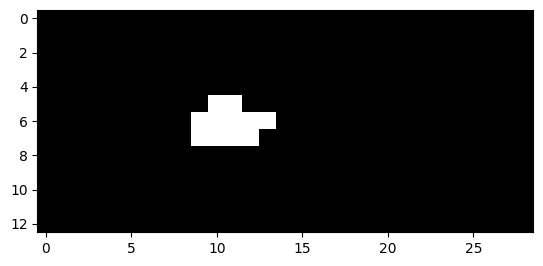

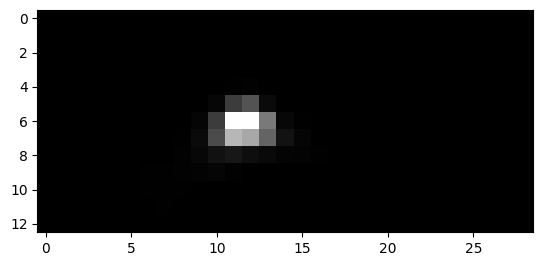

2168


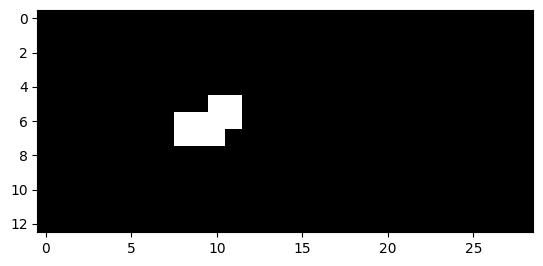

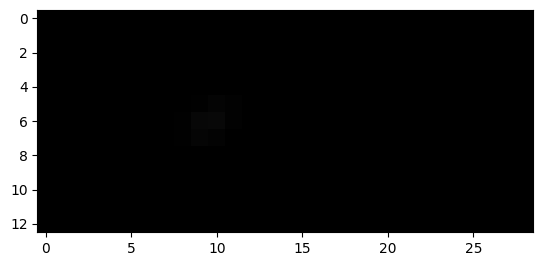

2169


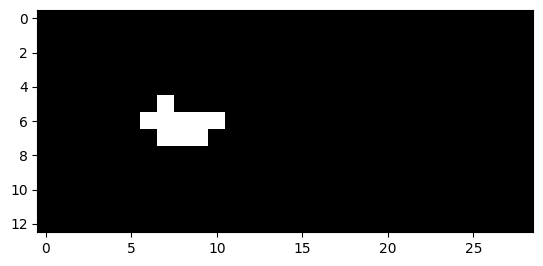

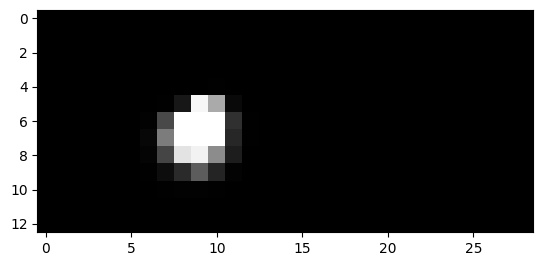

2170


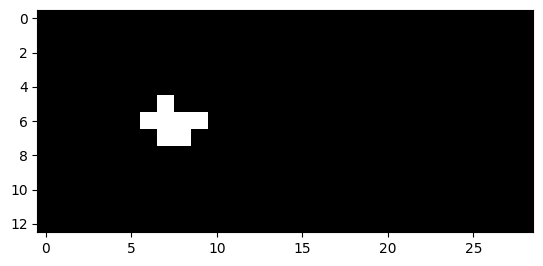

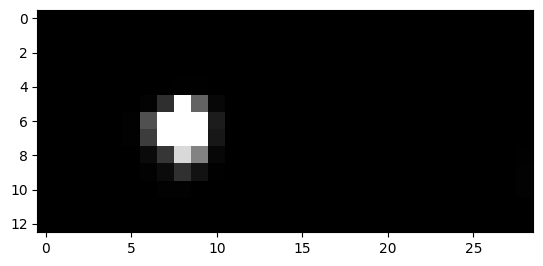

2171


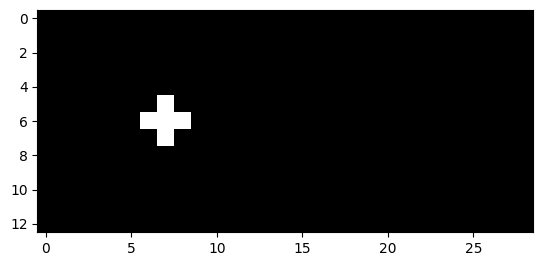

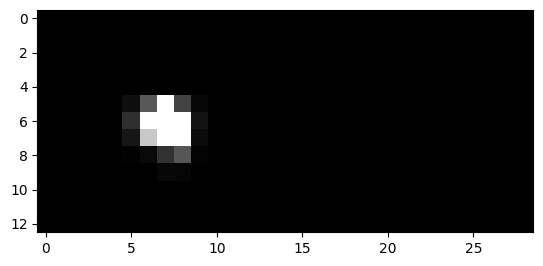

2174


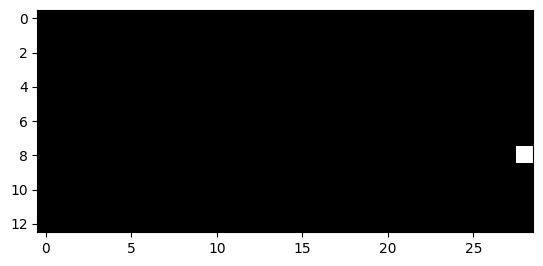

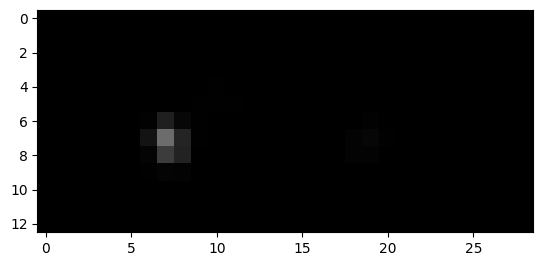

2175


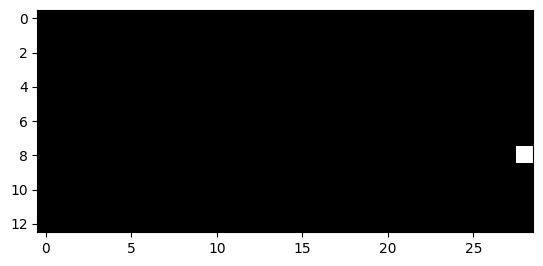

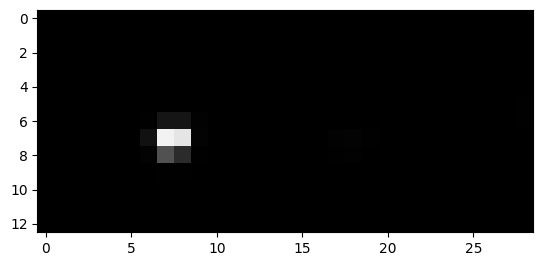

2181


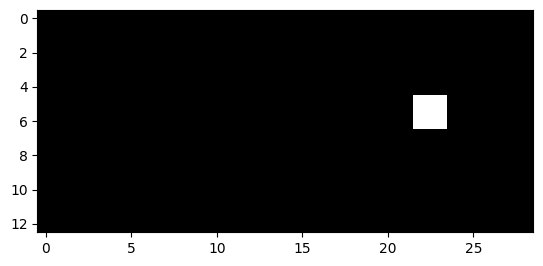

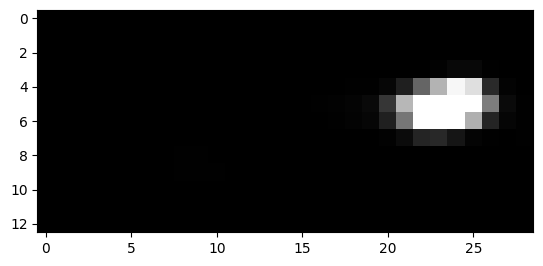

2182


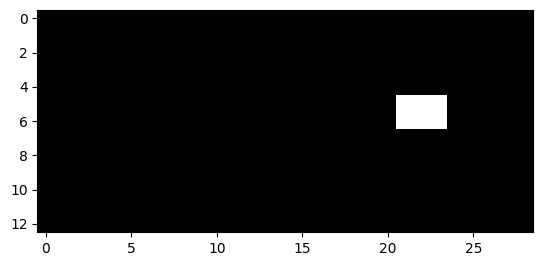

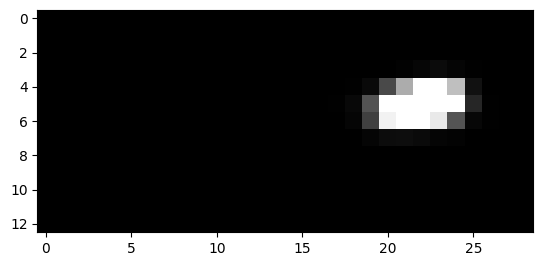

2183


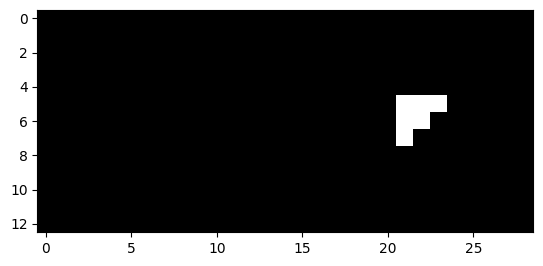

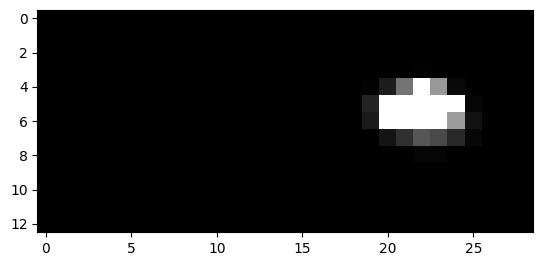

2184


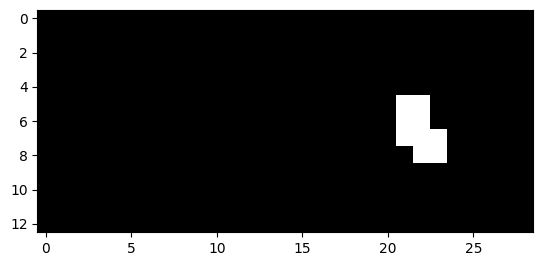

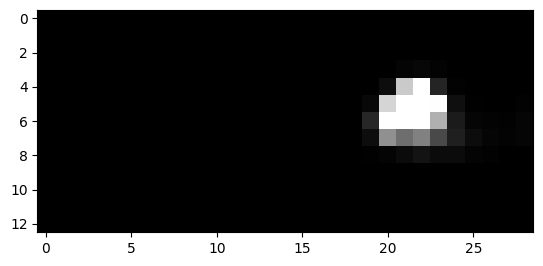

2185


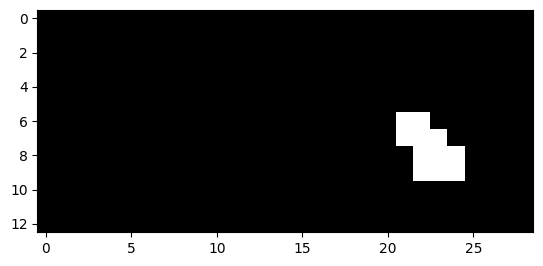

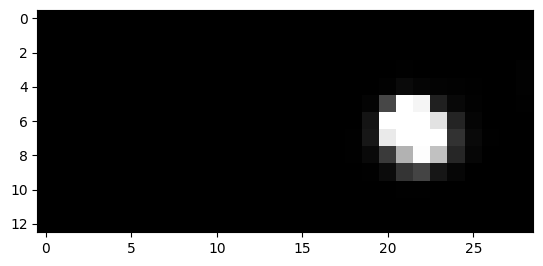

2186


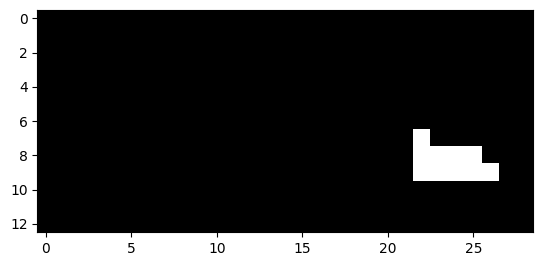

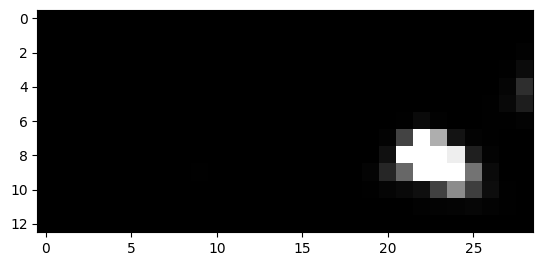

2187


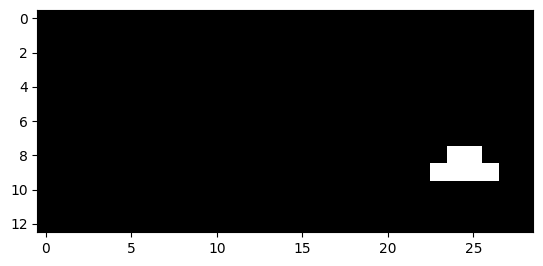

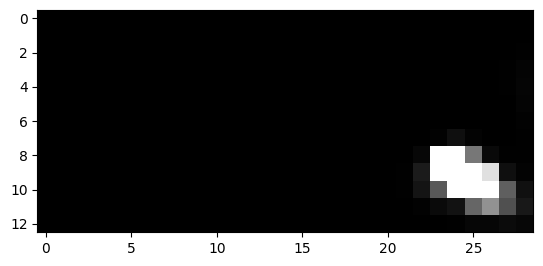

2188


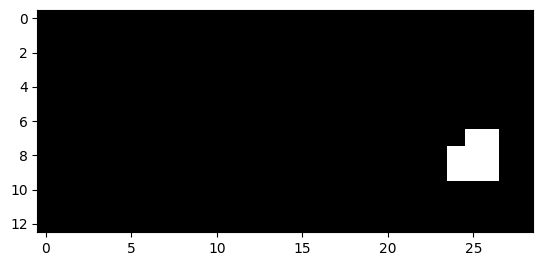

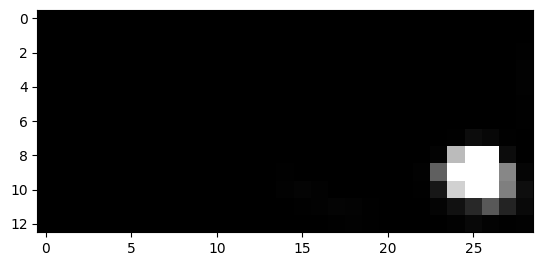

2189


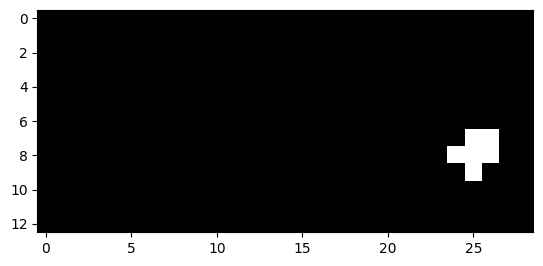

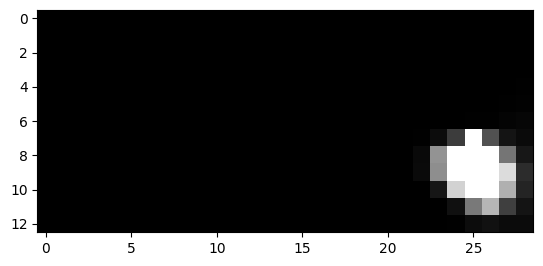

2190


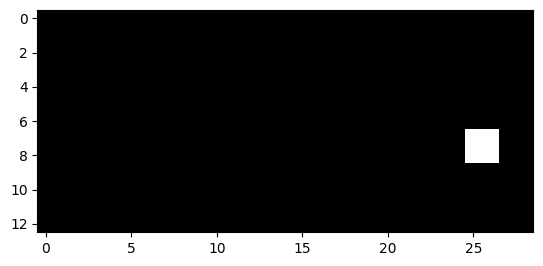

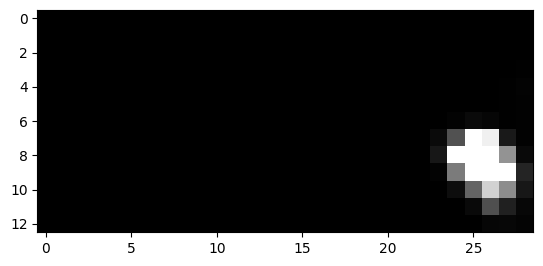

2191


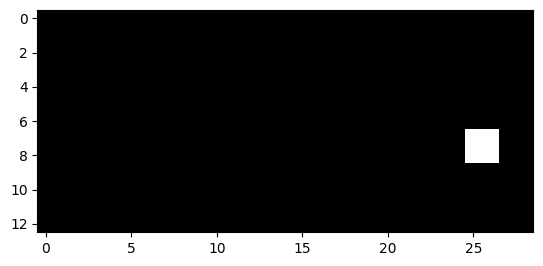

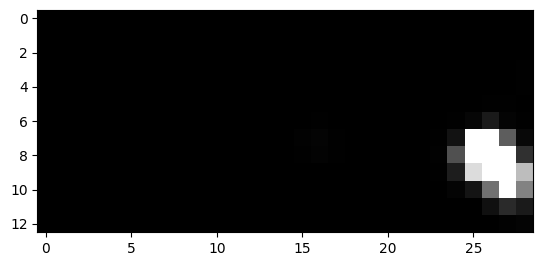

2214


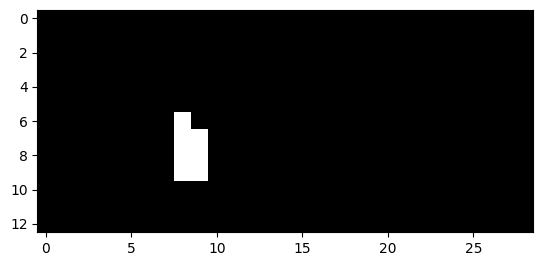

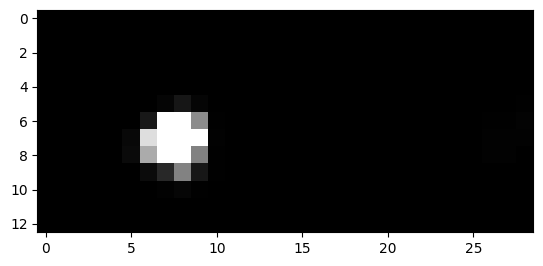

2215


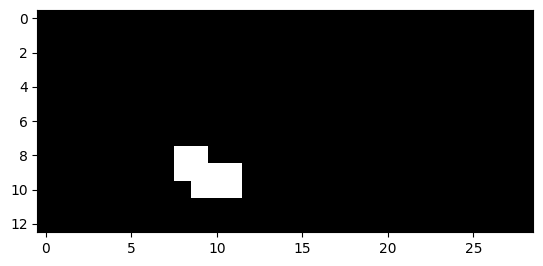

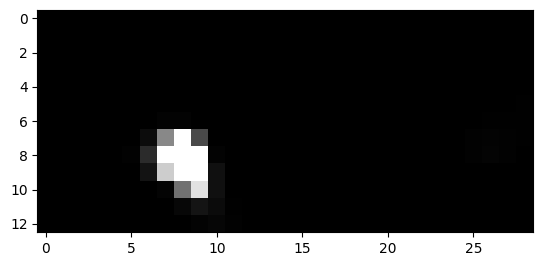

2216


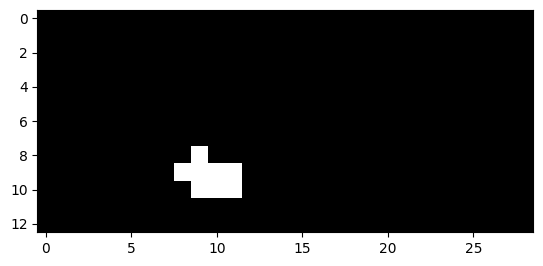

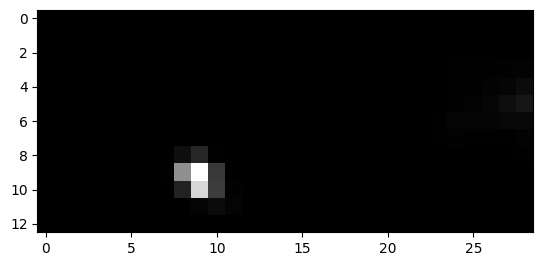

2226


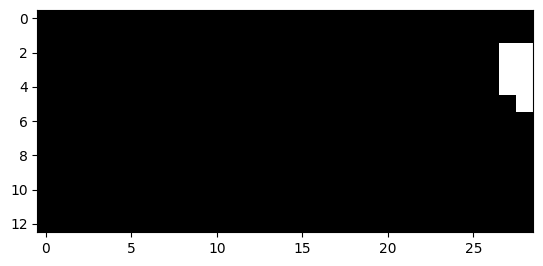

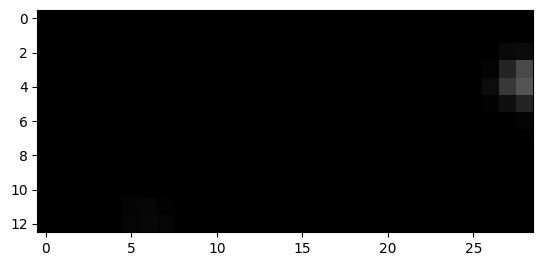

2227


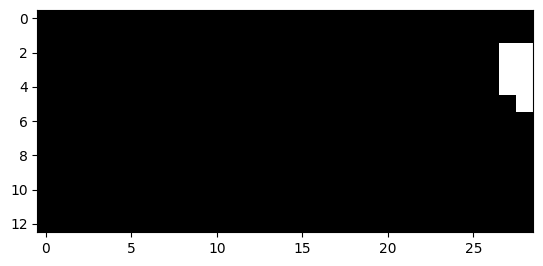

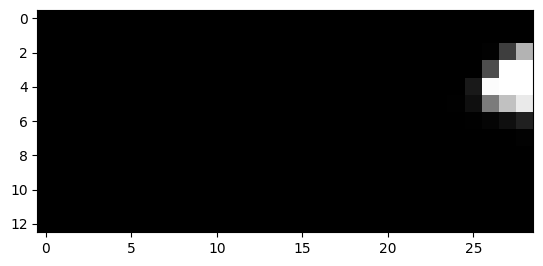

2228


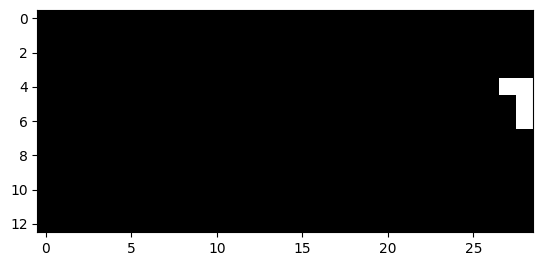

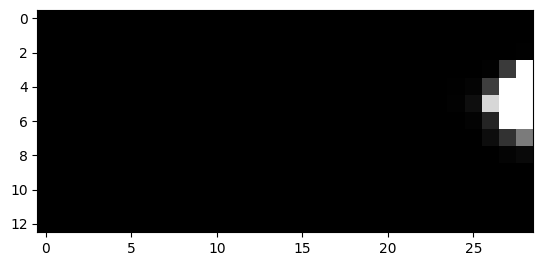

2229


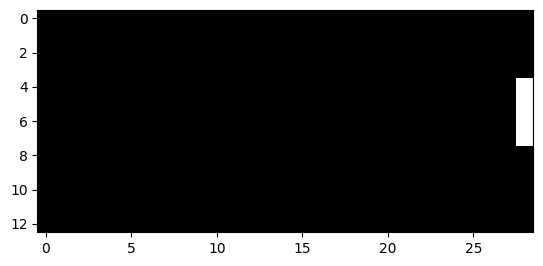

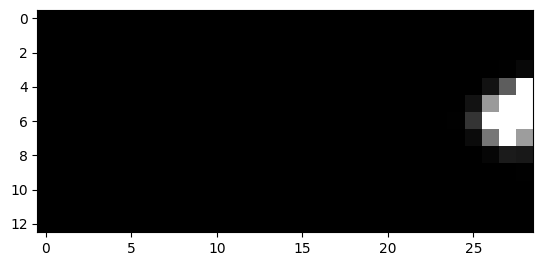

2230


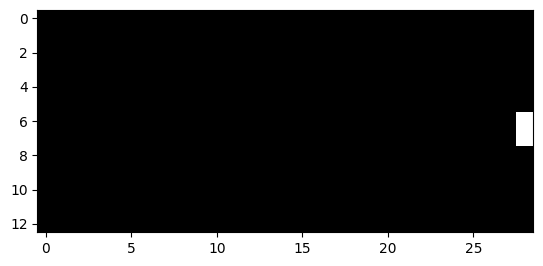

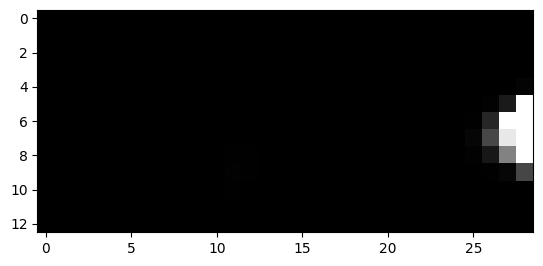

389


In [23]:
k=0
for i in range(len(y_test_img)): 
    if(np.max(y_test_img[i].reshape(-1))>0.1):
        print(i)
        plt.figure()
        plt.imshow(y_test_img[i], cmap = "gray", vmin=0, vmax=1)
        plt.show()
        plt.imshow(t[i], vmin=0, vmax=0.3, cmap = "gray")
        plt.show()
        k+=1
print(k)

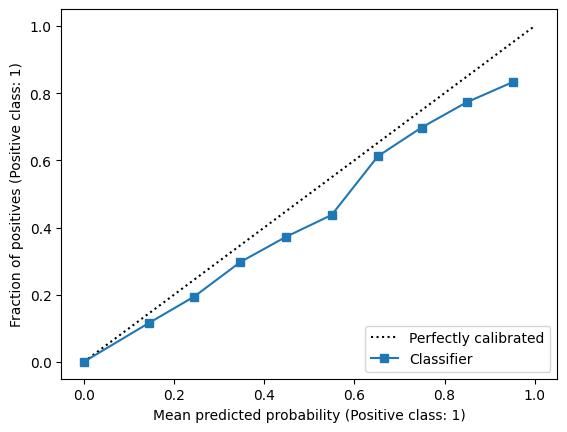

In [24]:
from sklearn.calibration import CalibrationDisplay

display = CalibrationDisplay.from_predictions(y_test_img.reshape(-1,1), t.reshape(-1,1), n_bins=10)


In [25]:
from sklearn.metrics import brier_score_loss
### brier score con probabilità predette

print(f'All zeros Brier score: {brier_score_loss(y_test_img.reshape(-1,1), np.zeros(len(y_test_img.reshape(-1,1))))}')
print(f'Model Brier score: {brier_score_loss(y_test_img.reshape(-1,1), t.reshape(-1,1))}')

All zeros Brier score: 0.0035259368257102965
Model Brier score: 0.0021060425192423898


In [26]:
test['predictions_lag0'] = t.reshape(-1,1)

In [27]:
test.to_csv("test_with_newTarget_predictions_unet.csv")

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_19 (Conv2D)             (None, 16, 32, 16)   1312        ['input_2[0][0]']                
                                                                                                  
 dropout_9 (Dropout)            (None, 16, 32, 16)   0           ['conv2d_19[0][0]']              
                                                                                                  
 conv2d_20 (Conv2D)             (None, 16, 32, 16)   2320        ['dropout_9[0][0]']              
                                                                                            

                                                                  'conv2d_20[0][0]']              
                                                                                                  
 conv2d_35 (Conv2D)             (None, 16, 32, 16)   4624        ['concatenate_7[0][0]']          
                                                                                                  
 dropout_17 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_35[0][0]']              
                                                                                                  
 conv2d_36 (Conv2D)             (None, 16, 32, 16)   2320        ['dropout_17[0][0]']             
                                                                                                  
 cropping2d_1 (Cropping2D)      (None, 13, 29, 16)   0           ['conv2d_36[0][0]']              
                                                                                                  
 conv2d_37

2023-05-30 09:29:36.508809: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0286

2023-05-30 09:29:44.815157: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 10s 25ms/step - loss: 0.0286 - val_loss: 0.0130
Epoch 2/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0134 - val_loss: 0.0114
Epoch 3/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0123 - val_loss: 0.0102
Epoch 4/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0117 - val_loss: 0.0099
Epoch 5/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0112 - val_loss: 0.0098
Epoch 6/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0110 - val_loss: 0.0098
Epoch 7/100
354/354 [==============================] - 7s 18ms/step - loss: 0.0106 - val_loss: 0.0097
Epoch 8/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0102 - val_loss: 0.0094
Epoch 9/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0100 - val_loss: 0.0093
Epoch 10/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0097 - val_los

2023-05-30 09:32:51.814587: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


78/78 [==============================] - 1s 7ms/step


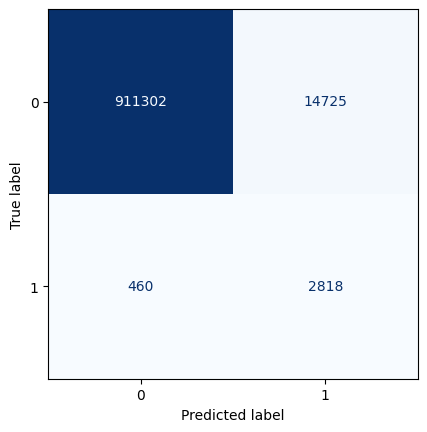

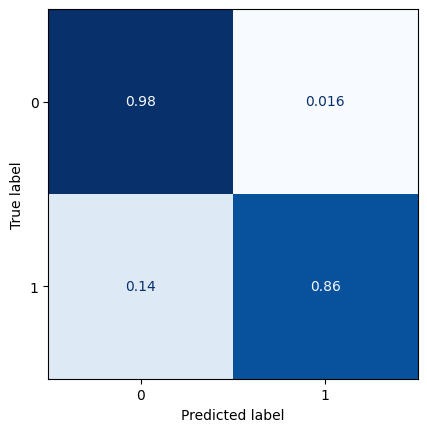

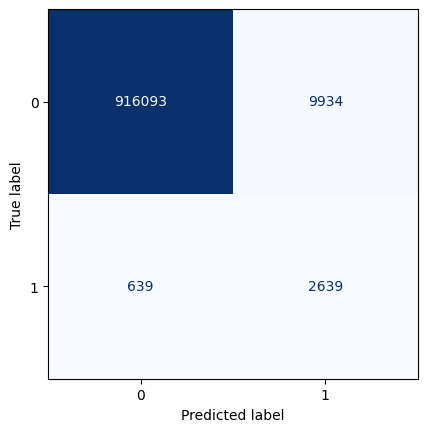

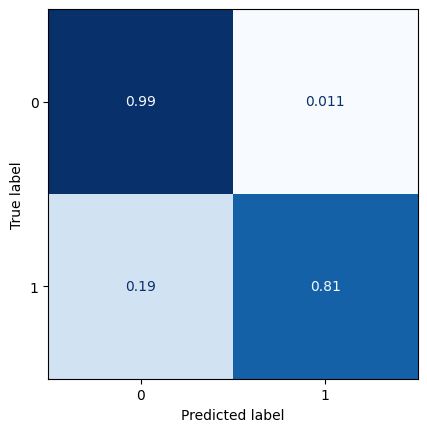

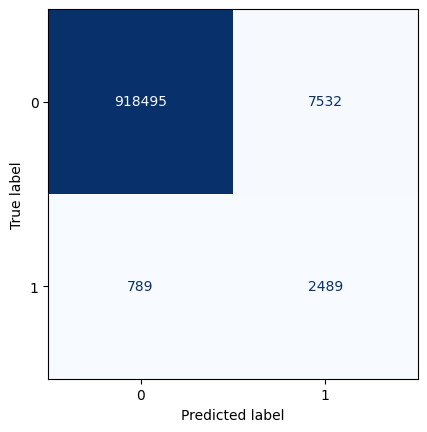

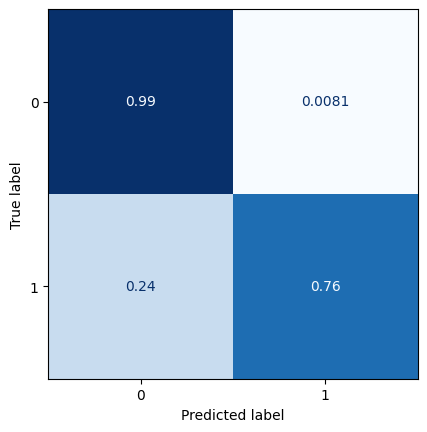

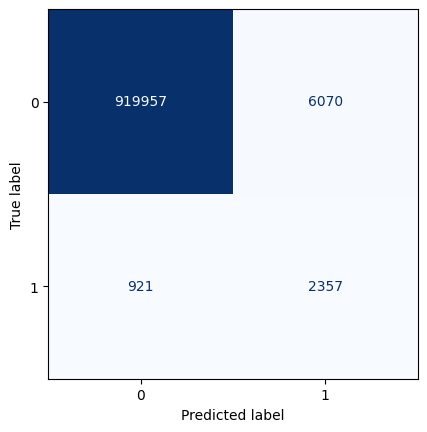

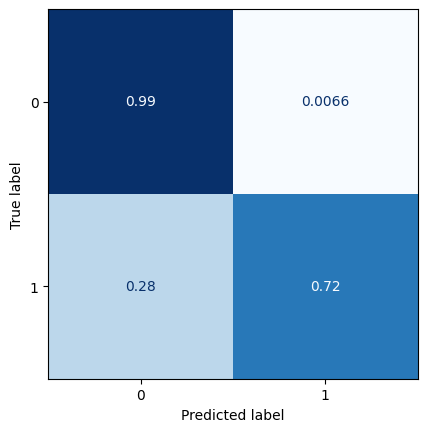

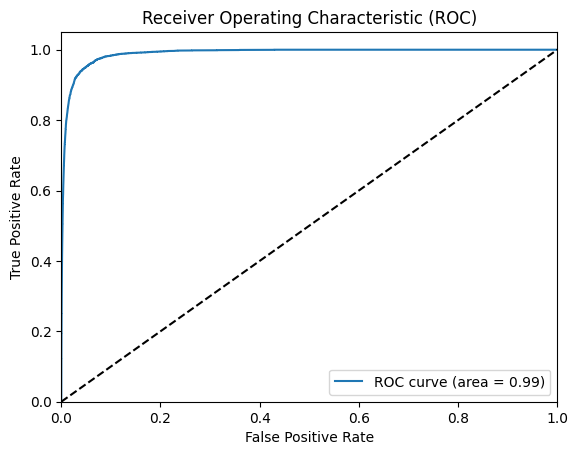

All zeros Brier score: 0.00352736722604527
Model Brier score: 0.0025753604532349635
Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_38 (Conv2D)             (None, 16, 32, 16)   1312        ['input_3[0][0]']                
                                                                                                  
 dropout_18 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_38[0][0]']              
                                                                                                  
 conv2d_39 (Conv2D)             (None, 16, 32, 16)   2320        ['dropout_18[0][0]']             
        

 nspose)                                                                                          
                                                                                                  
 concatenate_11 (Concatenate)   (None, 16, 32, 32)   0           ['conv2d_transpose_11[0][0]',    
                                                                  'conv2d_39[0][0]']              
                                                                                                  
 conv2d_54 (Conv2D)             (None, 16, 32, 16)   4624        ['concatenate_11[0][0]']         
                                                                                                  
 dropout_26 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_54[0][0]']              
                                                                                                  
 conv2d_55 (Conv2D)             (None, 16, 32, 16)   2320        ['dropout_26[0][0]']             
          

2023-05-30 09:33:09.925883: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0217

2023-05-30 09:33:17.892280: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 9s 22ms/step - loss: 0.0217 - val_loss: 0.0153
Epoch 2/100
354/354 [==============================] - 6s 18ms/step - loss: 0.0161 - val_loss: 0.0146
Epoch 3/100
354/354 [==============================] - 6s 18ms/step - loss: 0.0149 - val_loss: 0.0151
Epoch 4/100
354/354 [==============================] - 6s 18ms/step - loss: 0.0143 - val_loss: 0.0135
Epoch 5/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0138 - val_loss: 0.0135
Epoch 6/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0134 - val_loss: 0.0131
Epoch 7/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0130 - val_loss: 0.0132
Epoch 8/100
354/354 [==============================] - 7s 18ms/step - loss: 0.0127 - val_loss: 0.0124
Epoch 9/100
354/354 [==============================] - 6s 18ms/step - loss: 0.0124 - val_loss: 0.0128
Epoch 10/100
354/354 [==============================] - 6s 18ms/step - loss: 0.0121 - val_loss

2023-05-30 09:36:12.148956: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 5ms/step


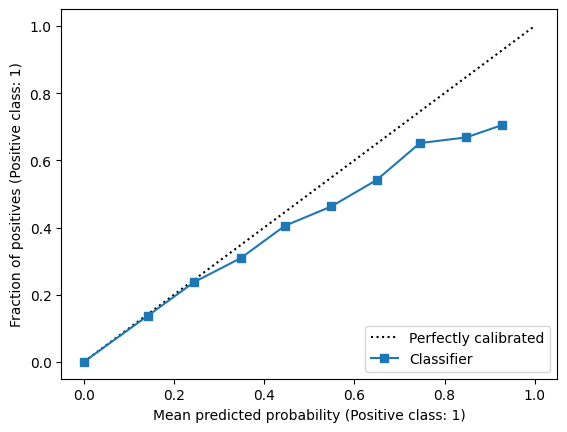

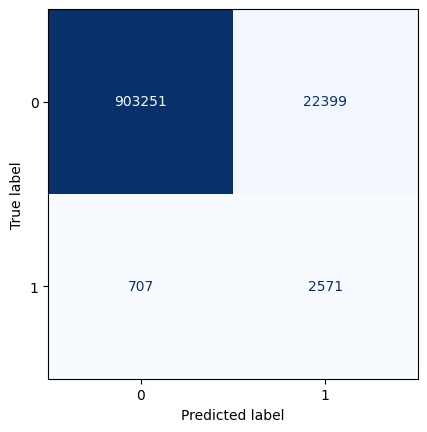

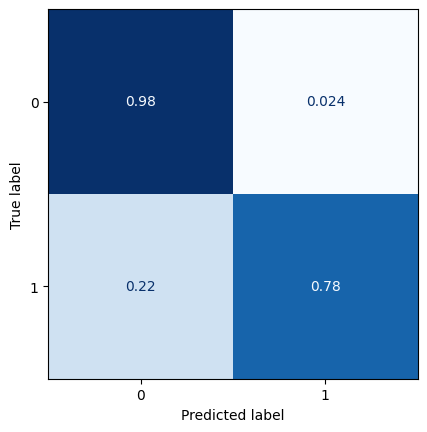

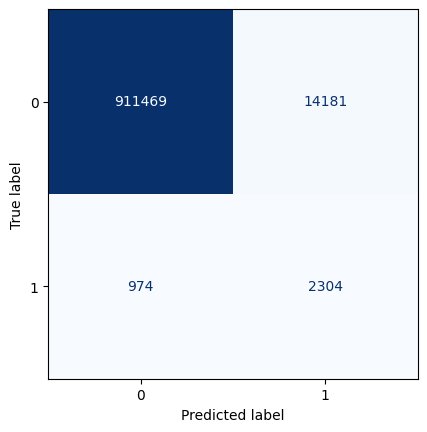

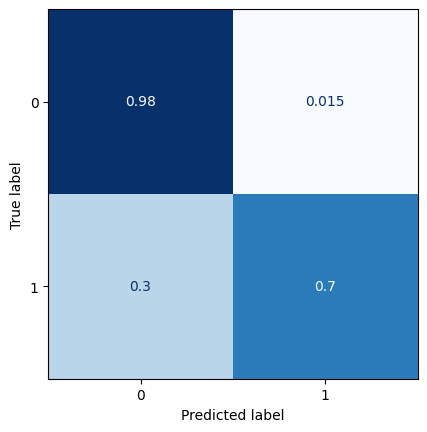

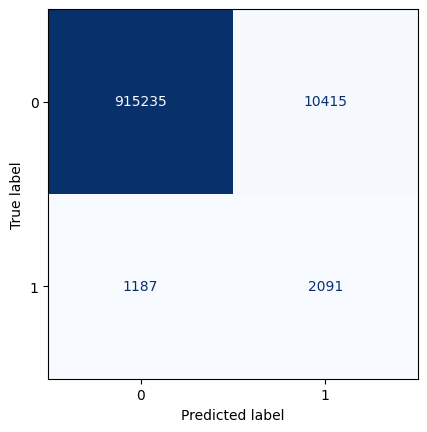

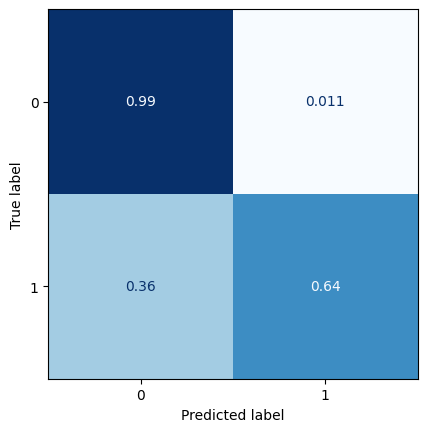

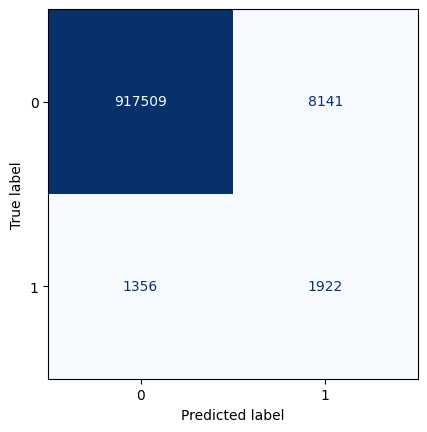

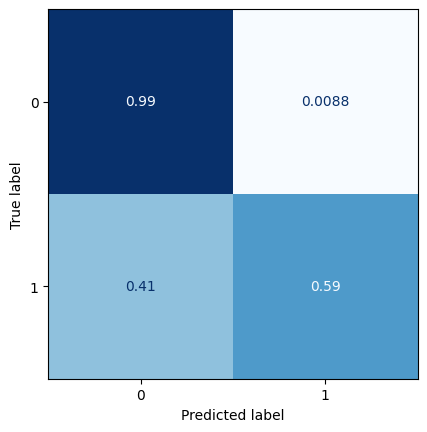

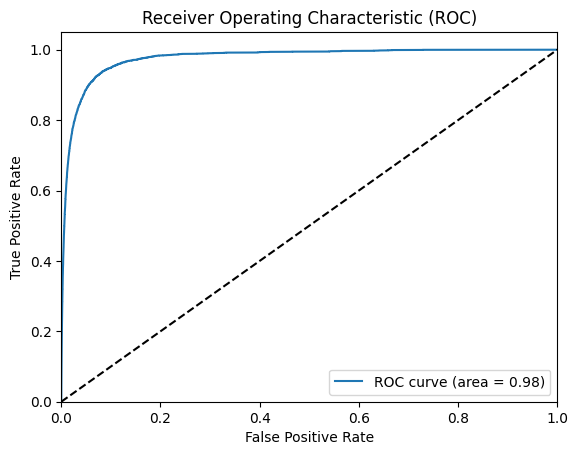

All zeros Brier score: 0.003528798787419477
Model Brier score: 0.0030379864311696693
Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_57 (Conv2D)             (None, 16, 32, 16)   1312        ['input_4[0][0]']                
                                                                                                  
 dropout_27 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_57[0][0]']              
                                                                                                  
 conv2d_58 (Conv2D)             (None, 16, 32, 16)   2320        ['dropout_27[0][0]']             
       

                                                                                                  
 conv2d_transpose_15 (Conv2DTra  (None, 16, 32, 16)  2064        ['conv2d_72[0][0]']              
 nspose)                                                                                          
                                                                                                  
 concatenate_15 (Concatenate)   (None, 16, 32, 32)   0           ['conv2d_transpose_15[0][0]',    
                                                                  'conv2d_58[0][0]']              
                                                                                                  
 conv2d_73 (Conv2D)             (None, 16, 32, 16)   4624        ['concatenate_15[0][0]']         
                                                                                                  
 dropout_35 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_73[0][0]']              
          

2023-05-30 09:36:32.581976: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0244

2023-05-30 09:36:41.747229: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 12s 25ms/step - loss: 0.0244 - val_loss: 0.0180
Epoch 2/100
354/354 [==============================] - 7s 21ms/step - loss: 0.0181 - val_loss: 0.0165
Epoch 3/100
354/354 [==============================] - 7s 21ms/step - loss: 0.0174 - val_loss: 0.0160
Epoch 4/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0166 - val_loss: 0.0166
Epoch 5/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0162 - val_loss: 0.0152
Epoch 6/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0157 - val_loss: 0.0152
Epoch 7/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0154 - val_loss: 0.0156
Epoch 8/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0149 - val_loss: 0.0156
Epoch 9/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0146 - val_loss: 0.0168
Epoch 10/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0142 - val_los

2023-05-30 09:40:03.605223: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 8ms/step


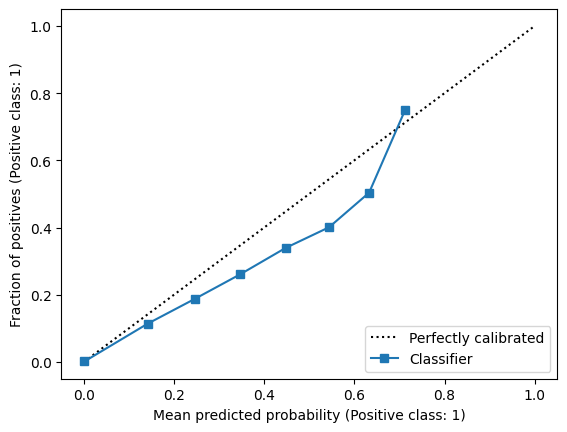

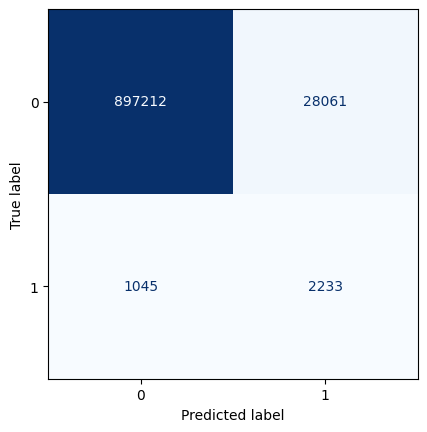

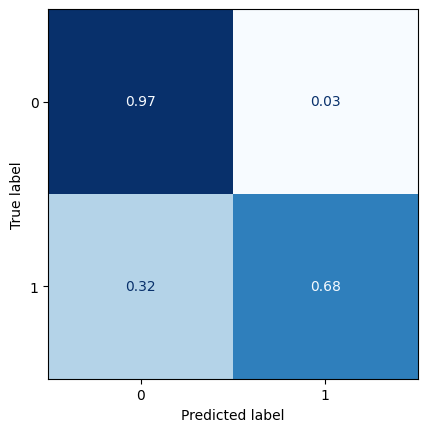

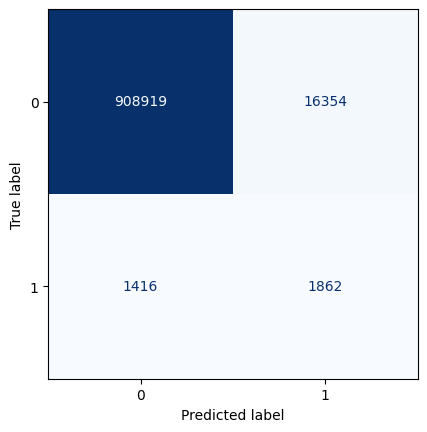

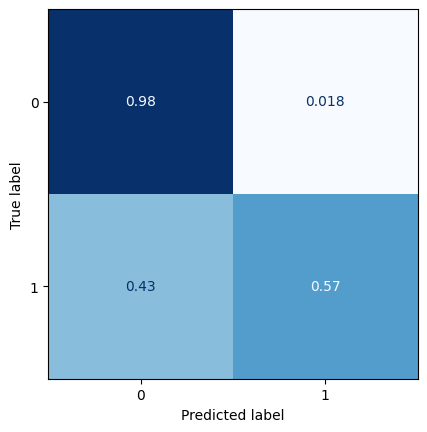

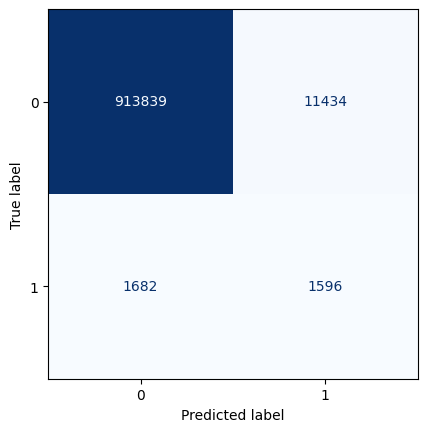

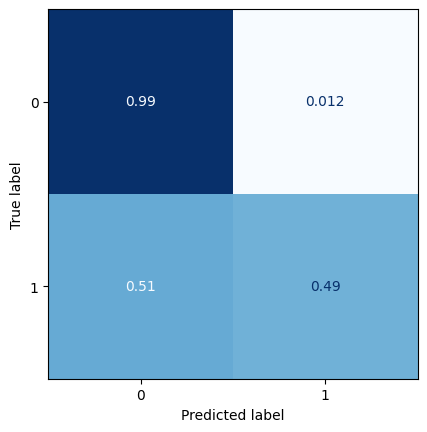

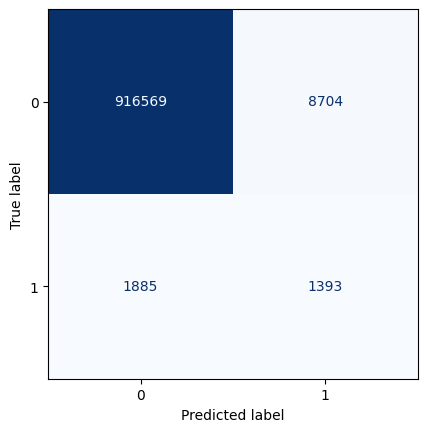

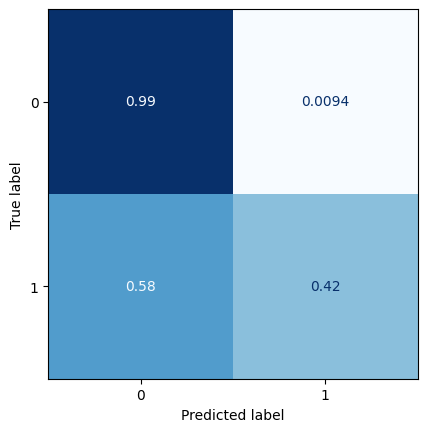

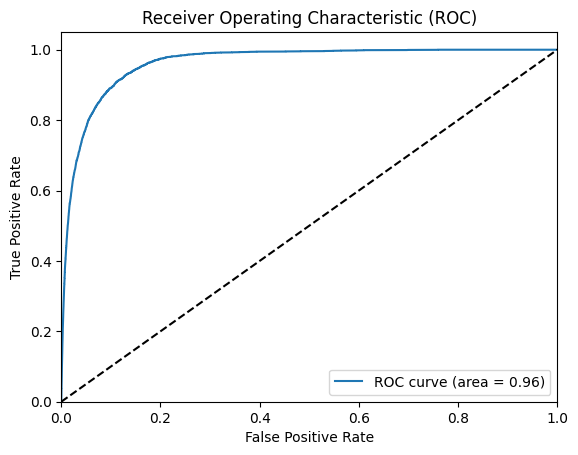

All zeros Brier score: 0.0035302315112470937
Model Brier score: 0.0033333093854101717
Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_76 (Conv2D)             (None, 16, 32, 16)   1312        ['input_5[0][0]']                
                                                                                                  
 dropout_36 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_76[0][0]']              
                                                                                                  
 conv2d_77 (Conv2D)             (None, 16, 32, 16)   2320        ['dropout_36[0][0]']             
      

                                                                                                  
 conv2d_transpose_19 (Conv2DTra  (None, 16, 32, 16)  2064        ['conv2d_91[0][0]']              
 nspose)                                                                                          
                                                                                                  
 concatenate_19 (Concatenate)   (None, 16, 32, 32)   0           ['conv2d_transpose_19[0][0]',    
                                                                  'conv2d_77[0][0]']              
                                                                                                  
 conv2d_92 (Conv2D)             (None, 16, 32, 16)   4624        ['concatenate_19[0][0]']         
                                                                                                  
 dropout_44 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_92[0][0]']              
          

2023-05-30 09:40:24.184074: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0407

2023-05-30 09:40:33.165571: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 10s 24ms/step - loss: 0.0407 - val_loss: 0.0238
Epoch 2/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0196 - val_loss: 0.0184
Epoch 3/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0186 - val_loss: 0.0176
Epoch 4/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0180 - val_loss: 0.0179
Epoch 5/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0175 - val_loss: 0.0169
Epoch 6/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0171 - val_loss: 0.0171
Epoch 7/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0165 - val_loss: 0.0167
Epoch 8/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0162 - val_loss: 0.0200
Epoch 9/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0159 - val_loss: 0.0180
Epoch 10/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0154 - val_los

2023-05-30 09:43:28.551075: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 7ms/step


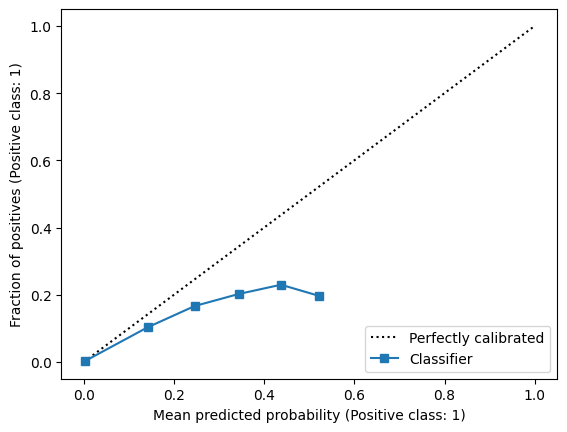

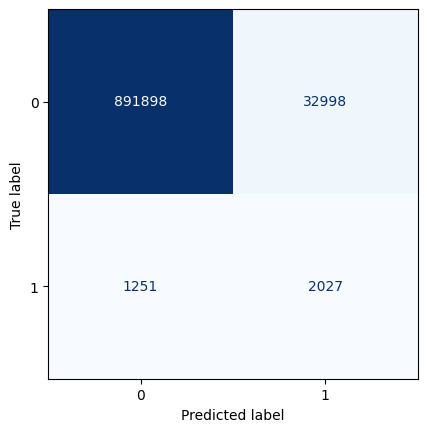

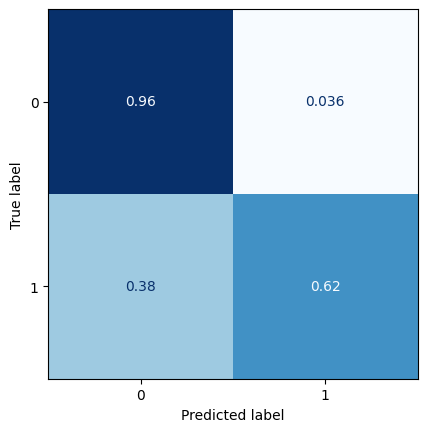

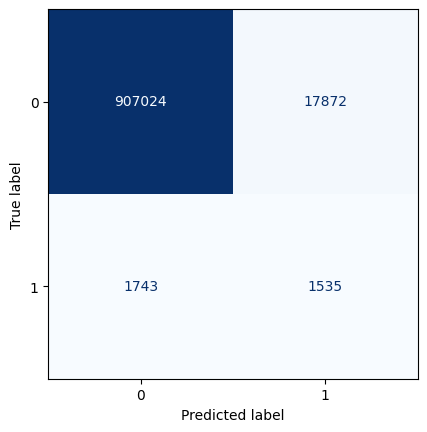

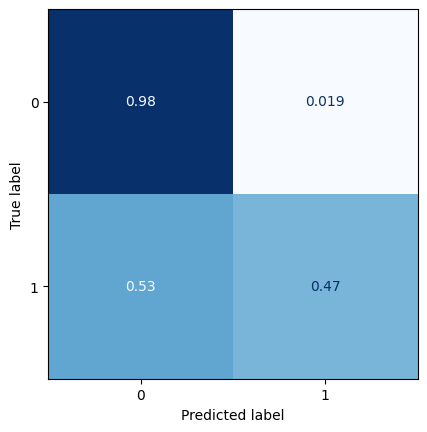

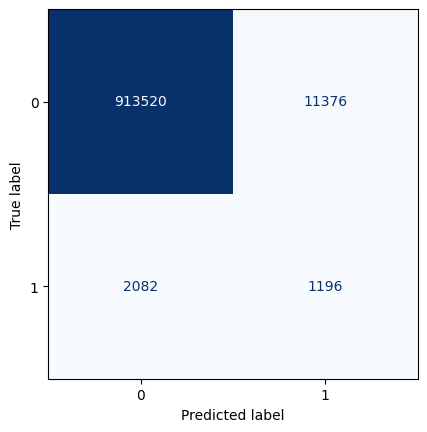

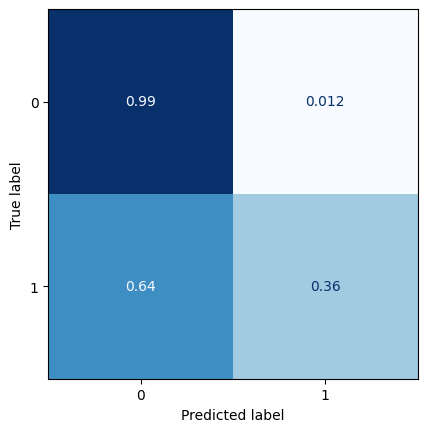

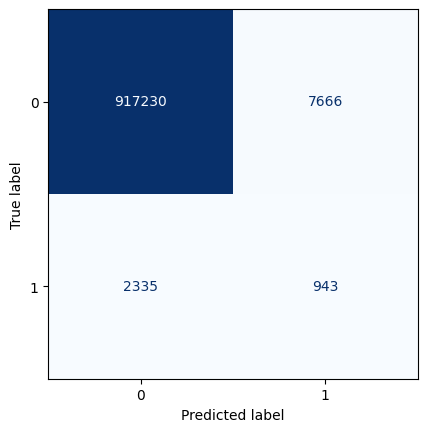

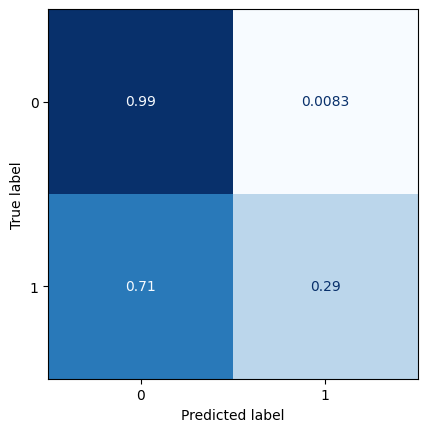

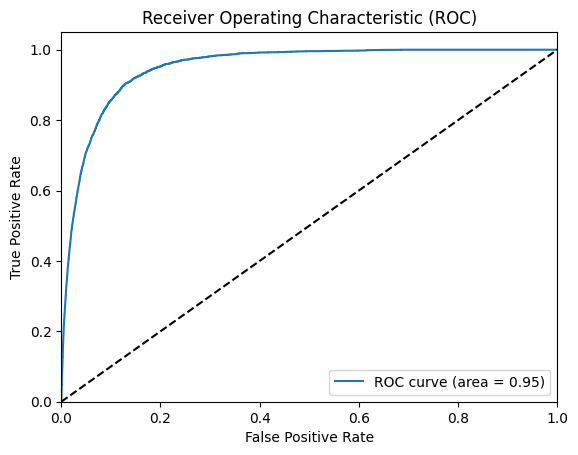

All zeros Brier score: 0.0035316653989445946
Model Brier score: 0.0033795343120433356
Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_95 (Conv2D)             (None, 16, 32, 16)   1312        ['input_6[0][0]']                
                                                                                                  
 dropout_45 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_95[0][0]']              
                                                                                                  
 conv2d_96 (Conv2D)             (None, 16, 32, 16)   2320        ['dropout_45[0][0]']             
      

                                                                                                  
 conv2d_transpose_23 (Conv2DTra  (None, 16, 32, 16)  2064        ['conv2d_110[0][0]']             
 nspose)                                                                                          
                                                                                                  
 concatenate_23 (Concatenate)   (None, 16, 32, 32)   0           ['conv2d_transpose_23[0][0]',    
                                                                  'conv2d_96[0][0]']              
                                                                                                  
 conv2d_111 (Conv2D)            (None, 16, 32, 16)   4624        ['concatenate_23[0][0]']         
                                                                                                  
 dropout_53 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_111[0][0]']             
          

2023-05-30 09:43:53.338551: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0300

2023-05-30 09:44:04.066645: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 15s 30ms/step - loss: 0.0300 - val_loss: 0.0199
Epoch 2/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0201 - val_loss: 0.0179
Epoch 3/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0193 - val_loss: 0.0186
Epoch 4/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0188 - val_loss: 0.0189
Epoch 5/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0183 - val_loss: 0.0187
Epoch 6/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0181 - val_loss: 0.0179
Epoch 7/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0175 - val_loss: 0.0187
Epoch 8/100
354/354 [==============================] - 8s 21ms/step - loss: 0.0171 - val_loss: 0.0190
Epoch 9/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0169 - val_loss: 0.0186
Epoch 10/100
354/354 [==============================] - 8s 21ms/step - loss: 0.0164 - val_los

2023-05-30 09:46:32.314412: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 7ms/step


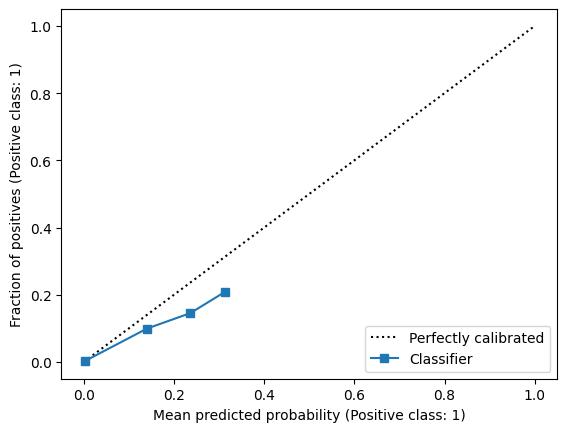

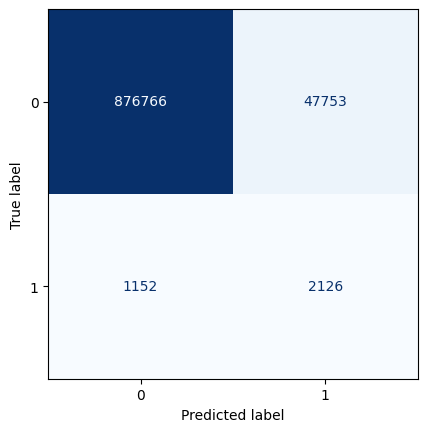

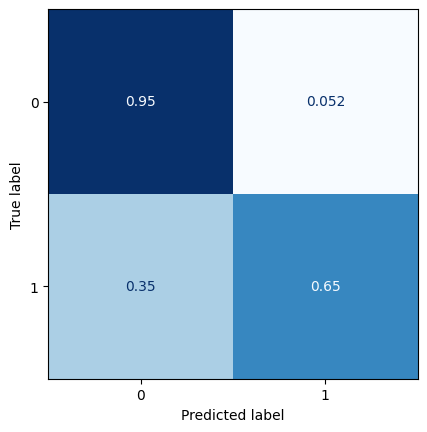

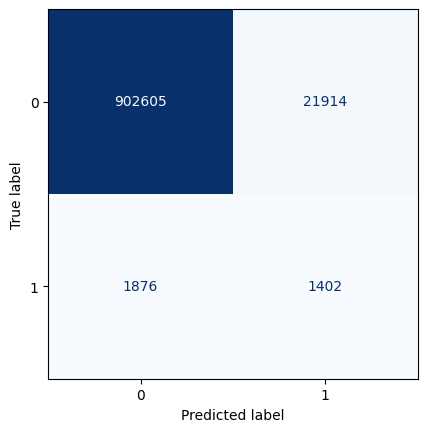

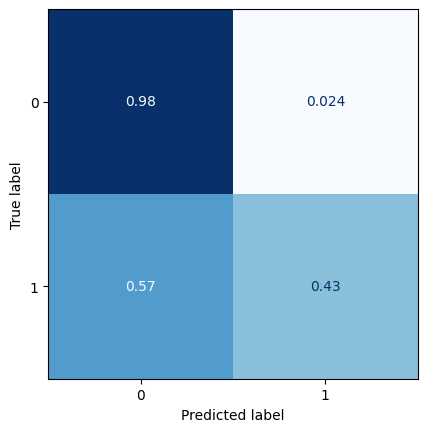

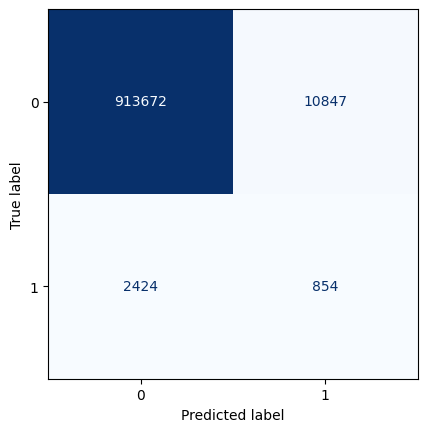

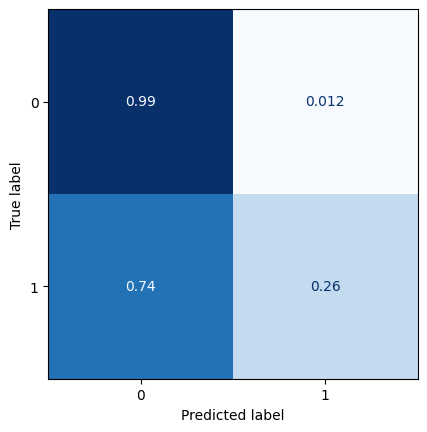

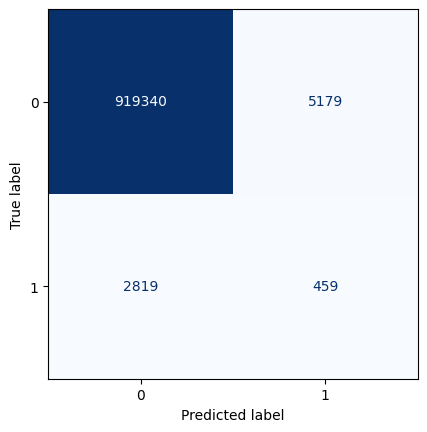

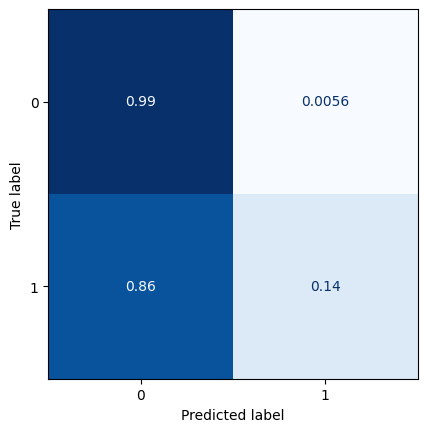

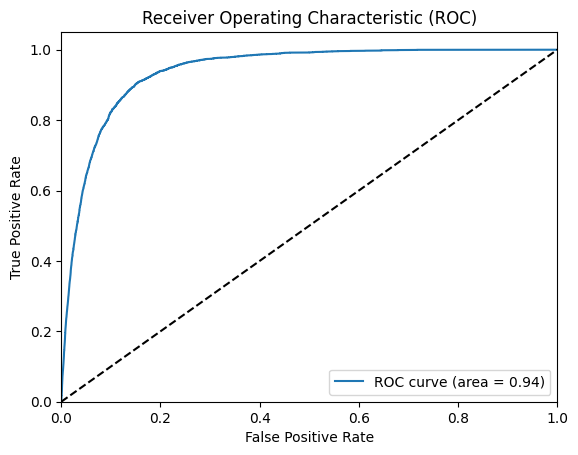

All zeros Brier score: 0.0035331004519307562
Model Brier score: 0.00342843274273829
Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_114 (Conv2D)            (None, 16, 32, 16)   1312        ['input_7[0][0]']                
                                                                                                  
 dropout_54 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_114[0][0]']             
                                                                                                  
 conv2d_115 (Conv2D)            (None, 16, 32, 16)   2320        ['dropout_54[0][0]']             
        

                                                                                                  
 conv2d_transpose_27 (Conv2DTra  (None, 16, 32, 16)  2064        ['conv2d_129[0][0]']             
 nspose)                                                                                          
                                                                                                  
 concatenate_27 (Concatenate)   (None, 16, 32, 32)   0           ['conv2d_transpose_27[0][0]',    
                                                                  'conv2d_115[0][0]']             
                                                                                                  
 conv2d_130 (Conv2D)            (None, 16, 32, 16)   4624        ['concatenate_27[0][0]']         
                                                                                                  
 dropout_62 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_130[0][0]']             
          

2023-05-30 09:46:56.039534: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0258

2023-05-30 09:47:05.044691: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 11s 26ms/step - loss: 0.0258 - val_loss: 0.0186
Epoch 2/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0207 - val_loss: 0.0195
Epoch 3/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0200 - val_loss: 0.0197
Epoch 4/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0194 - val_loss: 0.0188
Epoch 5/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0189 - val_loss: 0.0190
Epoch 6/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0187 - val_loss: 0.0199
Epoch 7/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0184 - val_loss: 0.0195
Epoch 8/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0181 - val_loss: 0.0194
Epoch 9/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0178 - val_loss: 0.0191
Epoch 10/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0173 - val_los

2023-05-30 09:49:22.763815: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 9ms/step


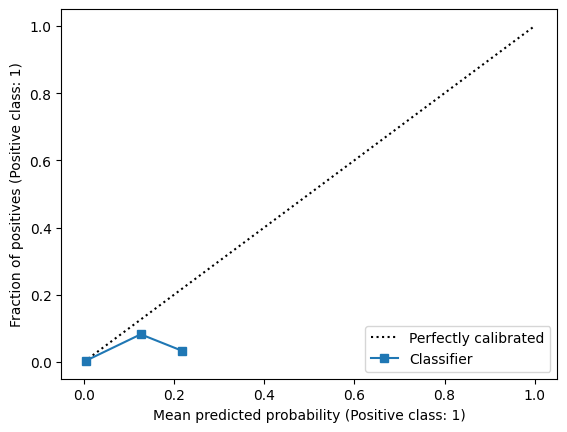

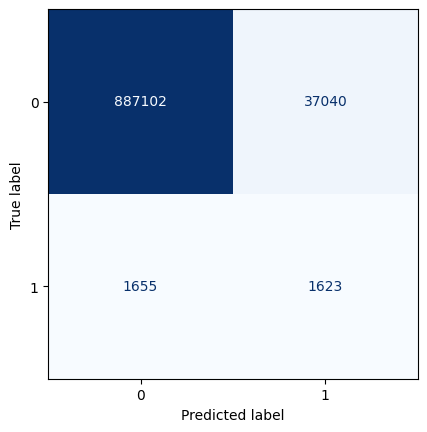

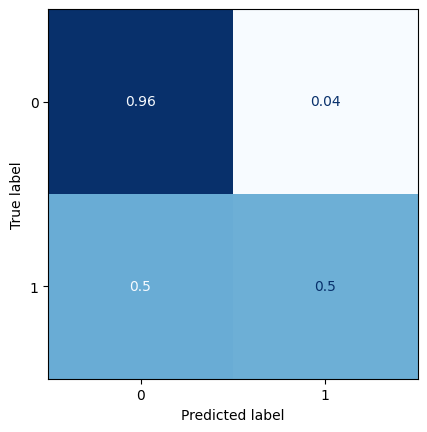

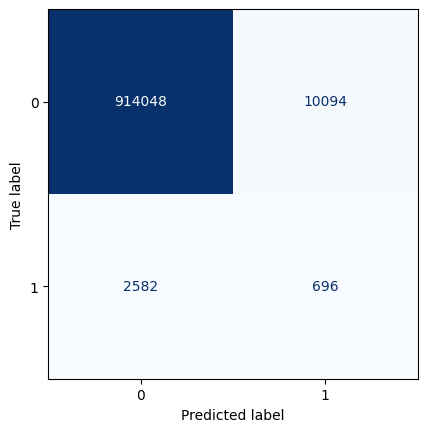

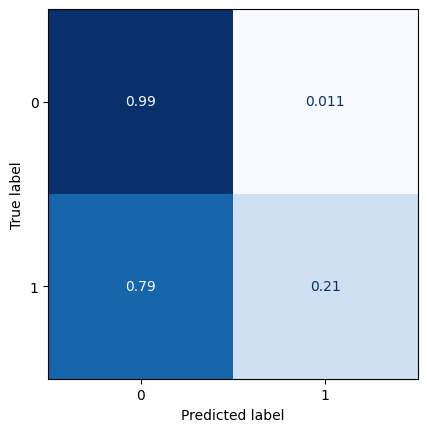

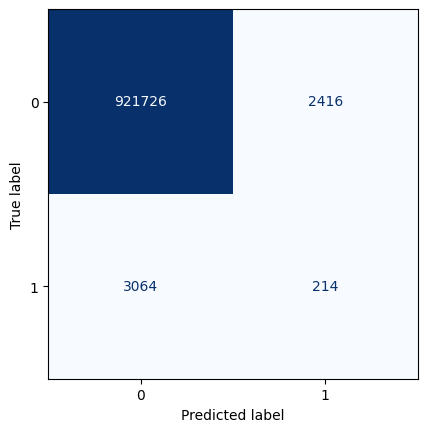

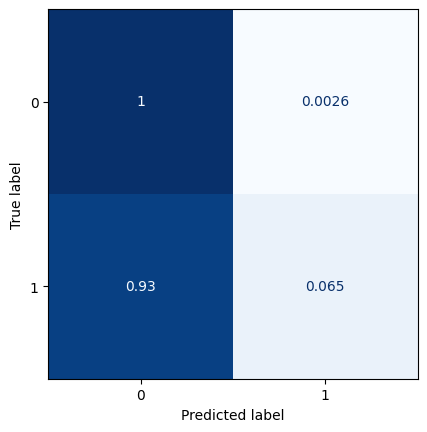

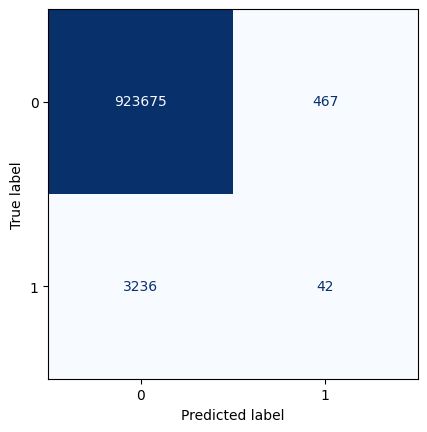

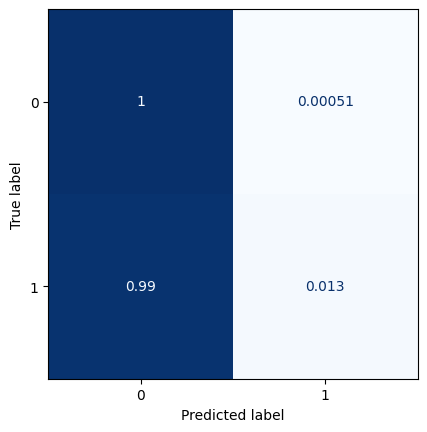

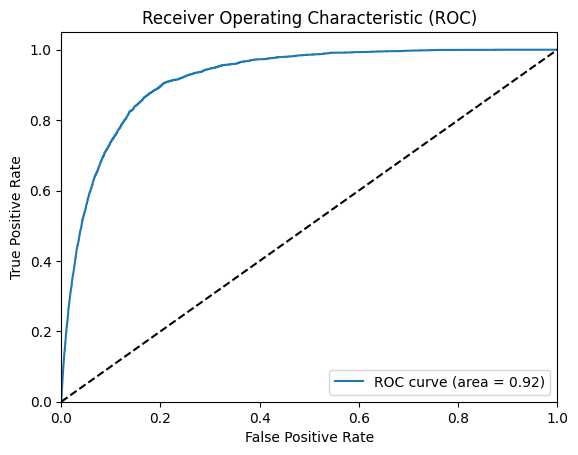

All zeros Brier score: 0.003534536671626663
Model Brier score: 0.0034338702211294094
Model: "model_7"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_8 (InputLayer)           [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_133 (Conv2D)            (None, 16, 32, 16)   1312        ['input_8[0][0]']                
                                                                                                  
 dropout_63 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_133[0][0]']             
                                                                                                  
 conv2d_134 (Conv2D)            (None, 16, 32, 16)   2320        ['dropout_63[0][0]']             
       

                                                                                                  
 conv2d_transpose_31 (Conv2DTra  (None, 16, 32, 16)  2064        ['conv2d_148[0][0]']             
 nspose)                                                                                          
                                                                                                  
 concatenate_31 (Concatenate)   (None, 16, 32, 32)   0           ['conv2d_transpose_31[0][0]',    
                                                                  'conv2d_134[0][0]']             
                                                                                                  
 conv2d_149 (Conv2D)            (None, 16, 32, 16)   4624        ['concatenate_31[0][0]']         
                                                                                                  
 dropout_71 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_149[0][0]']             
          

2023-05-30 09:49:49.983990: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0305

2023-05-30 09:50:01.815060: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 18s 31ms/step - loss: 0.0305 - val_loss: 0.0190
Epoch 2/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0210 - val_loss: 0.0182
Epoch 3/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0205 - val_loss: 0.0184
Epoch 4/100
354/354 [==============================] - 7s 21ms/step - loss: 0.0200 - val_loss: 0.0205
Epoch 5/100
354/354 [==============================] - 7s 21ms/step - loss: 0.0197 - val_loss: 0.0189
Epoch 6/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0193 - val_loss: 0.0200
Epoch 7/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0189 - val_loss: 0.0195
Epoch 8/100
354/354 [==============================] - 8s 21ms/step - loss: 0.0186 - val_loss: 0.0191
Epoch 9/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0183 - val_loss: 0.0199
Epoch 10/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0178 - val_los

2023-05-30 09:52:40.092539: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 11ms/step


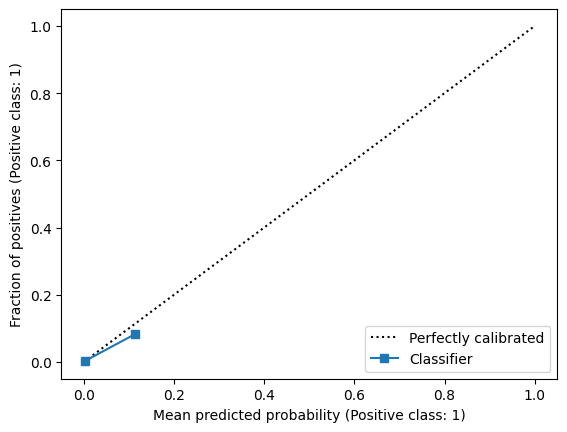

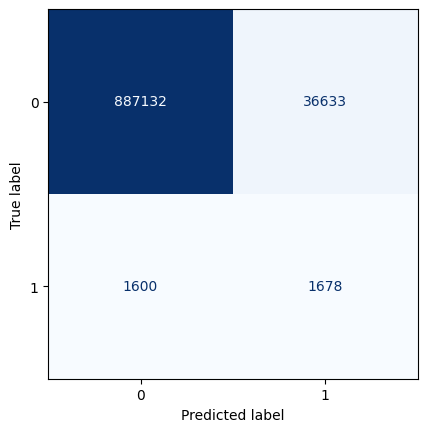

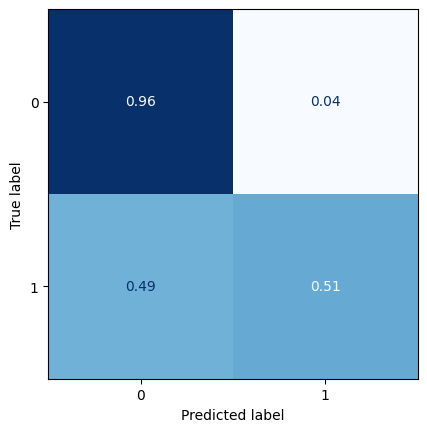

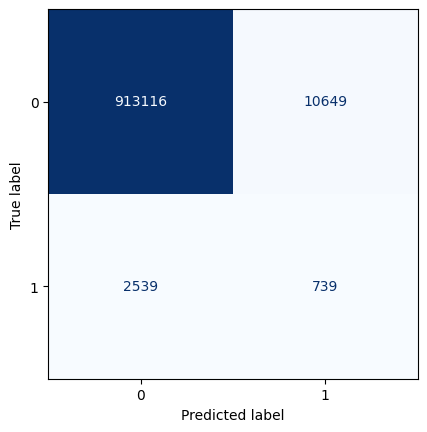

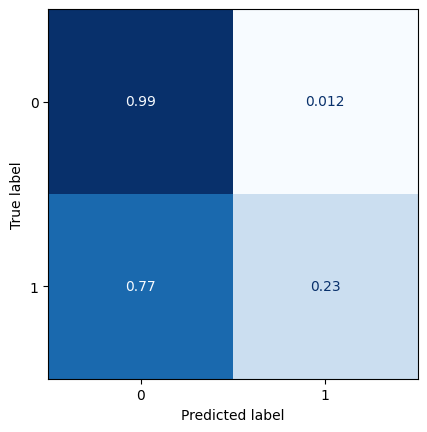

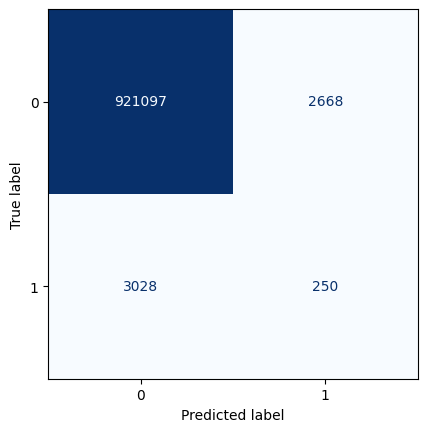

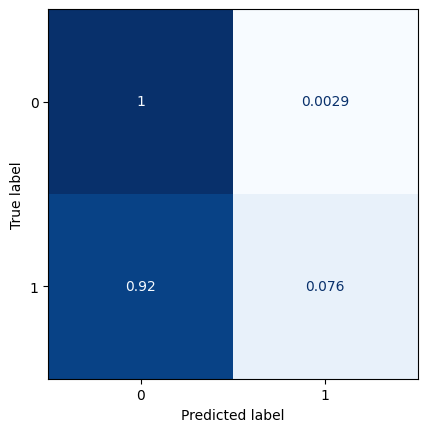

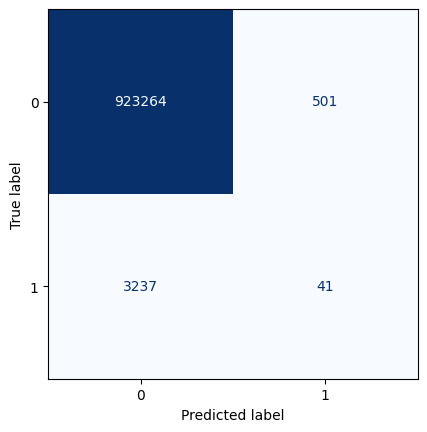

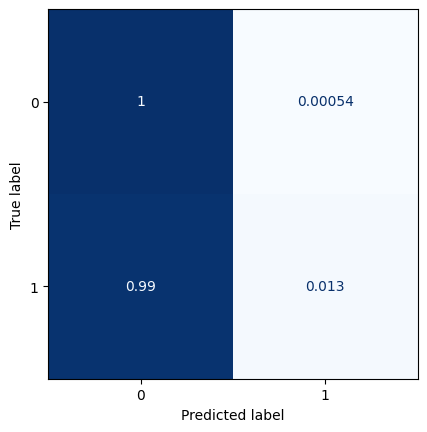

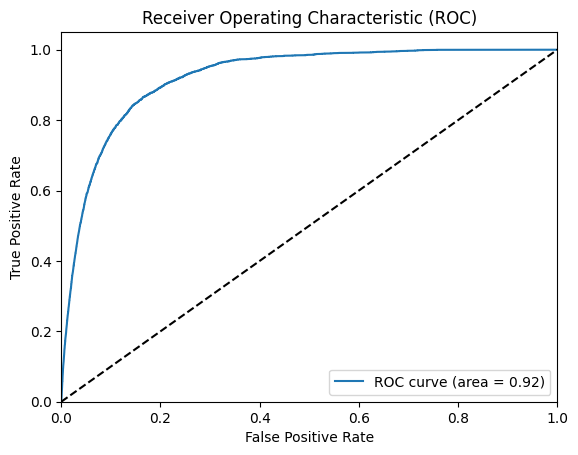

All zeros Brier score: 0.00353597405945571
Model Brier score: 0.0034289505551671306
Model: "model_8"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_9 (InputLayer)           [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_152 (Conv2D)            (None, 16, 32, 16)   1312        ['input_9[0][0]']                
                                                                                                  
 dropout_72 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_152[0][0]']             
                                                                                                  
 conv2d_153 (Conv2D)            (None, 16, 32, 16)   2320        ['dropout_72[0][0]']             
        

                                                                                                  
 conv2d_transpose_35 (Conv2DTra  (None, 16, 32, 16)  2064        ['conv2d_167[0][0]']             
 nspose)                                                                                          
                                                                                                  
 concatenate_35 (Concatenate)   (None, 16, 32, 32)   0           ['conv2d_transpose_35[0][0]',    
                                                                  'conv2d_153[0][0]']             
                                                                                                  
 conv2d_168 (Conv2D)            (None, 16, 32, 16)   4624        ['concatenate_35[0][0]']         
                                                                                                  
 dropout_80 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_168[0][0]']             
          

2023-05-30 09:53:07.175963: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0287

2023-05-30 09:53:18.286288: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 13s 28ms/step - loss: 0.0287 - val_loss: 0.0198
Epoch 2/100
354/354 [==============================] - 17s 47ms/step - loss: 0.0214 - val_loss: 0.0189
Epoch 3/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0207 - val_loss: 0.0206
Epoch 4/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0205 - val_loss: 0.0208
Epoch 5/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0201 - val_loss: 0.0204
Epoch 6/100
354/354 [==============================] - 8s 23ms/step - loss: 0.0198 - val_loss: 0.0192
Epoch 7/100
354/354 [==============================] - 7s 21ms/step - loss: 0.0195 - val_loss: 0.0194
Epoch 8/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0192 - val_loss: 0.0195
Epoch 9/100
354/354 [==============================] - 7s 21ms/step - loss: 0.0189 - val_loss: 0.0193
Epoch 10/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0187 - val_lo

2023-05-30 09:56:08.195563: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 3s 9ms/step


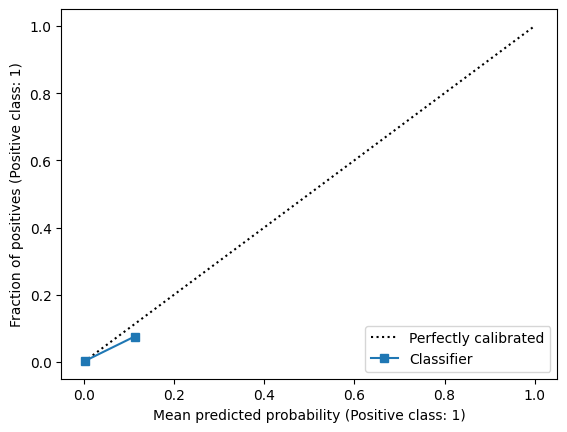

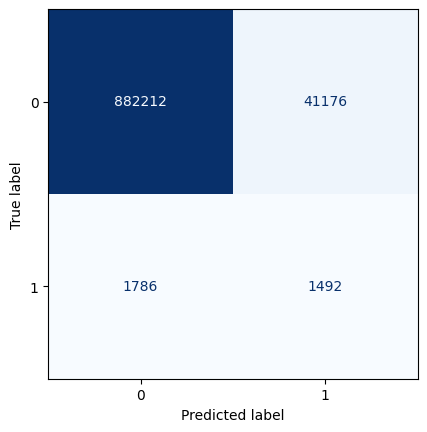

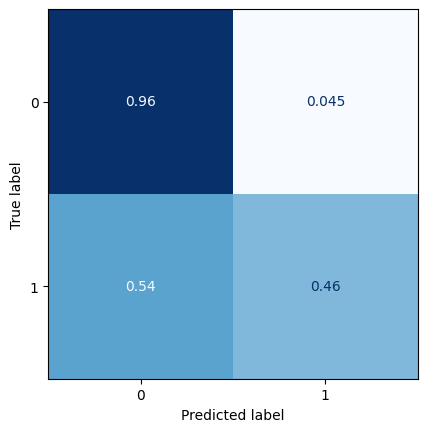

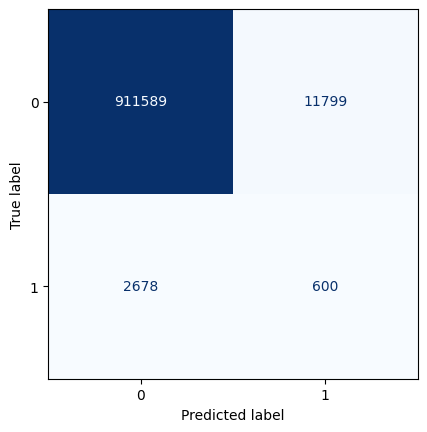

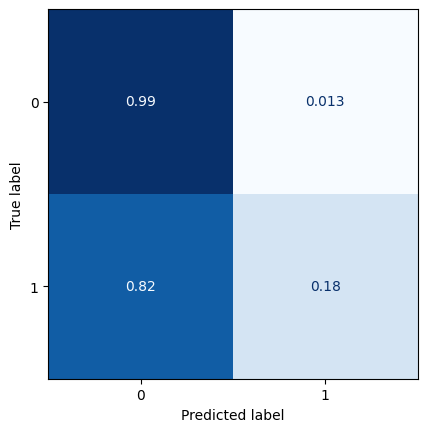

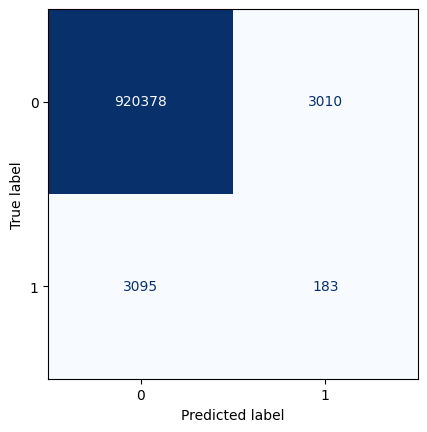

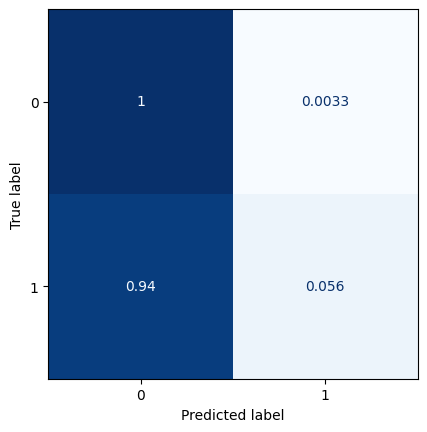

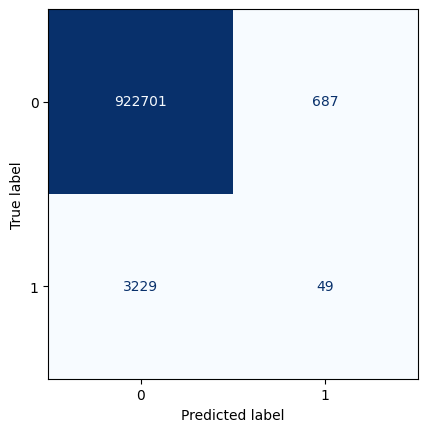

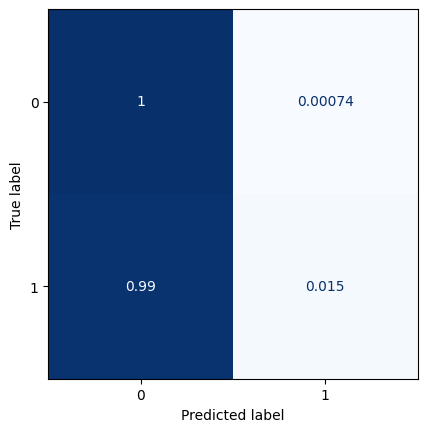

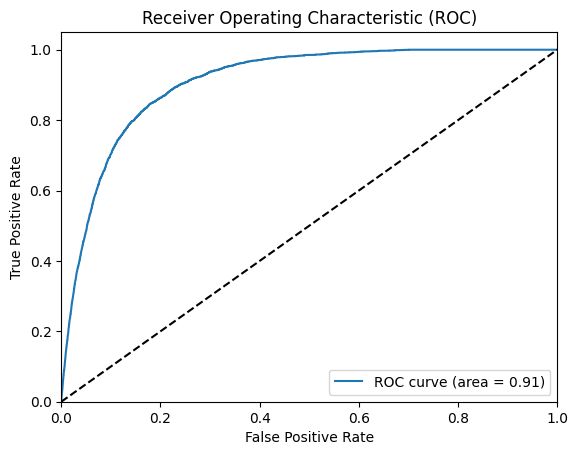

All zeros Brier score: 0.0035374126168436094
Model Brier score: 0.0034655436861521934
Model: "model_9"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_10 (InputLayer)          [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_171 (Conv2D)            (None, 16, 32, 16)   1312        ['input_10[0][0]']               
                                                                                                  
 dropout_81 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_171[0][0]']             
                                                                                                  
 conv2d_172 (Conv2D)            (None, 16, 32, 16)   2320        ['dropout_81[0][0]']             
      

                                                                                                  
 conv2d_transpose_39 (Conv2DTra  (None, 16, 32, 16)  2064        ['conv2d_186[0][0]']             
 nspose)                                                                                          
                                                                                                  
 concatenate_39 (Concatenate)   (None, 16, 32, 32)   0           ['conv2d_transpose_39[0][0]',    
                                                                  'conv2d_172[0][0]']             
                                                                                                  
 conv2d_187 (Conv2D)            (None, 16, 32, 16)   4624        ['concatenate_39[0][0]']         
                                                                                                  
 dropout_89 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_187[0][0]']             
          

2023-05-30 09:56:38.697485: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0410

2023-05-30 09:56:50.920950: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 18s 36ms/step - loss: 0.0410 - val_loss: 0.0209
Epoch 2/100
354/354 [==============================] - 8s 21ms/step - loss: 0.0216 - val_loss: 0.0214
Epoch 3/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0212 - val_loss: 0.0196
Epoch 4/100
354/354 [==============================] - 8s 23ms/step - loss: 0.0207 - val_loss: 0.0213
Epoch 5/100
354/354 [==============================] - 8s 21ms/step - loss: 0.0206 - val_loss: 0.0215
Epoch 6/100
354/354 [==============================] - 8s 23ms/step - loss: 0.0202 - val_loss: 0.0192
Epoch 7/100
354/354 [==============================] - 9s 24ms/step - loss: 0.0199 - val_loss: 0.0193
Epoch 8/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0197 - val_loss: 0.0218
Epoch 9/100
354/354 [==============================] - 9s 26ms/step - loss: 0.0194 - val_loss: 0.0199
Epoch 10/100
354/354 [==============================] - 9s 26ms/step - loss: 0.0190 - val_los

2023-05-30 09:59:59.421609: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 2s 11ms/step


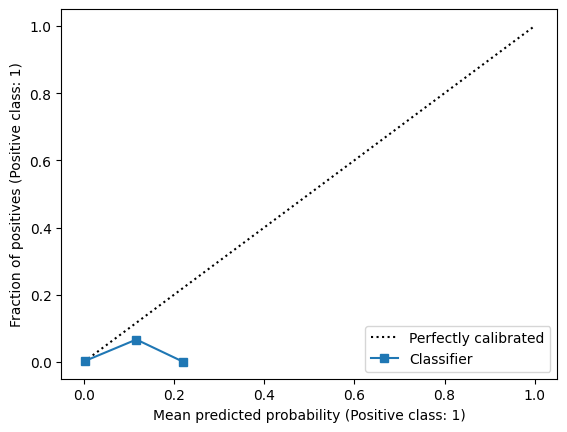

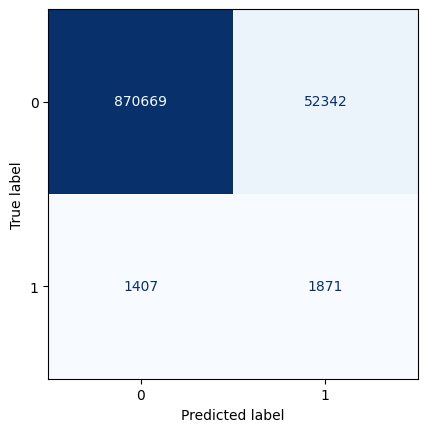

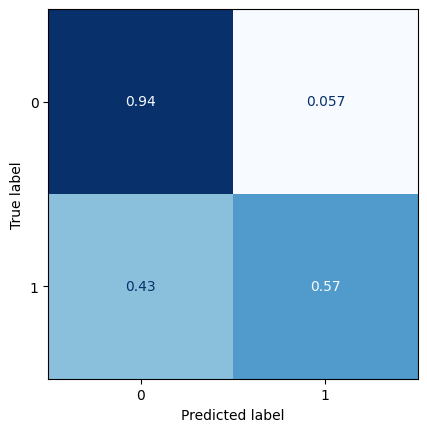

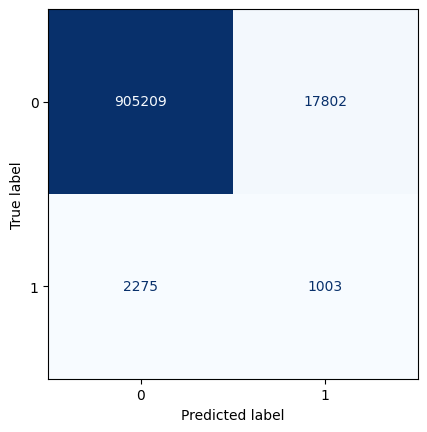

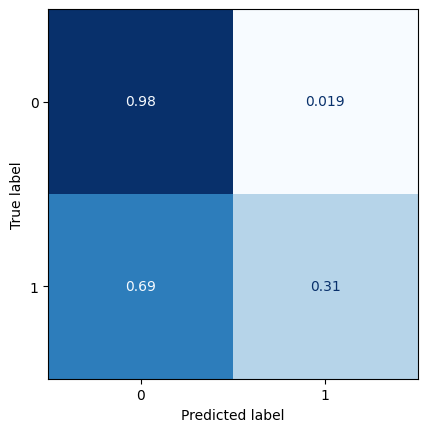

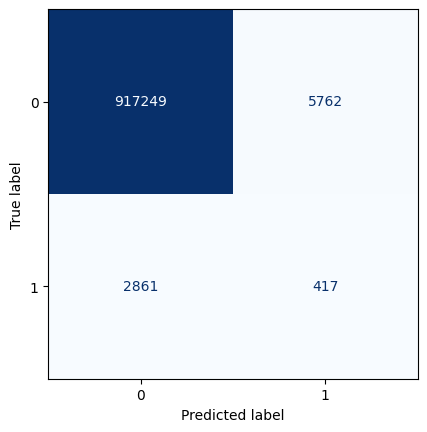

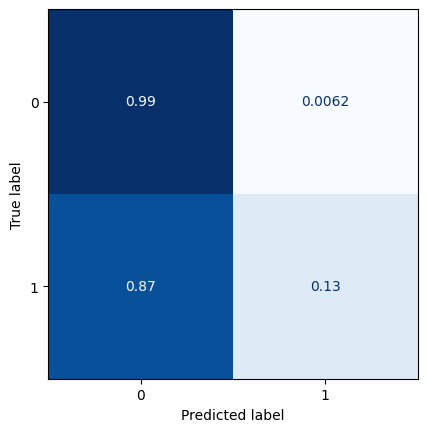

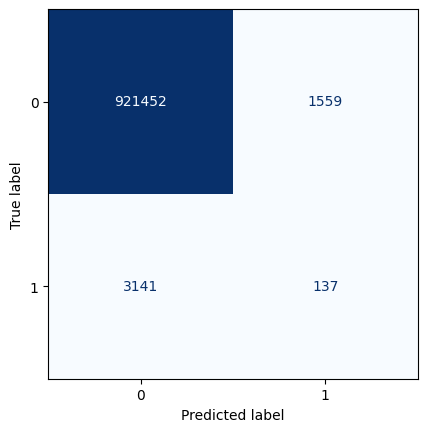

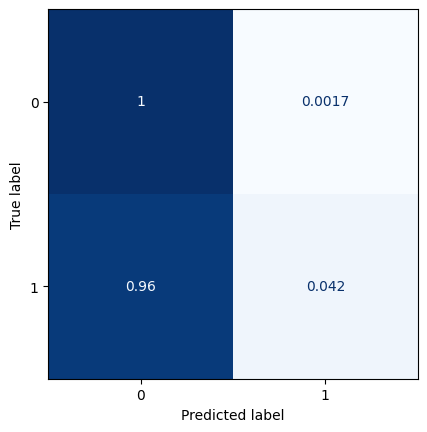

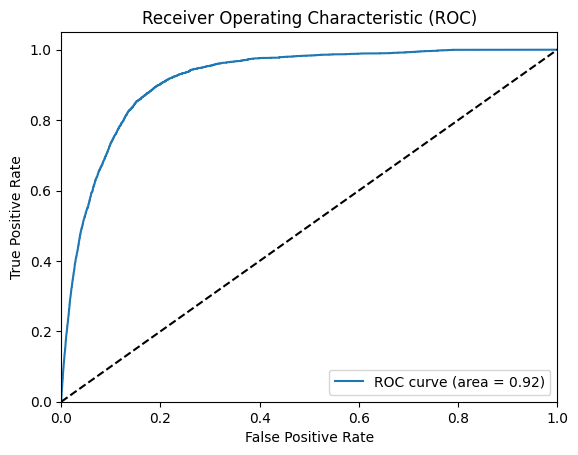

All zeros Brier score: 0.003538852345218393
Model Brier score: 0.0034535478580892467
Model: "model_10"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_11 (InputLayer)          [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_190 (Conv2D)            (None, 16, 32, 16)   1312        ['input_11[0][0]']               
                                                                                                  
 dropout_90 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_190[0][0]']             
                                                                                                  
 conv2d_191 (Conv2D)            (None, 16, 32, 16)   2320        ['dropout_90[0][0]']             
      

                                                                                                  
 conv2d_transpose_43 (Conv2DTra  (None, 16, 32, 16)  2064        ['conv2d_205[0][0]']             
 nspose)                                                                                          
                                                                                                  
 concatenate_43 (Concatenate)   (None, 16, 32, 32)   0           ['conv2d_transpose_43[0][0]',    
                                                                  'conv2d_191[0][0]']             
                                                                                                  
 conv2d_206 (Conv2D)            (None, 16, 32, 16)   4624        ['concatenate_43[0][0]']         
                                                                                                  
 dropout_98 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_206[0][0]']             
          

2023-05-30 10:00:26.057558: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0245

2023-05-30 10:00:35.882959: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 12s 26ms/step - loss: 0.0245 - val_loss: 0.0223
Epoch 2/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0216 - val_loss: 0.0208
Epoch 3/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0210 - val_loss: 0.0193
Epoch 4/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0206 - val_loss: 0.0195
Epoch 5/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0203 - val_loss: 0.0196
Epoch 6/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0200 - val_loss: 0.0195
Epoch 7/100
354/354 [==============================] - 6s 18ms/step - loss: 0.0198 - val_loss: 0.0192
Epoch 8/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0194 - val_loss: 0.0197
Epoch 9/100
354/354 [==============================] - 6s 18ms/step - loss: 0.0192 - val_loss: 0.0202
Epoch 10/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0188 - val_los

2023-05-30 10:03:41.834432: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 8ms/step


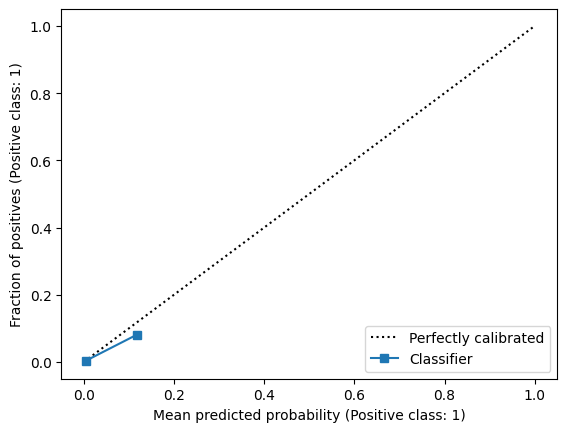

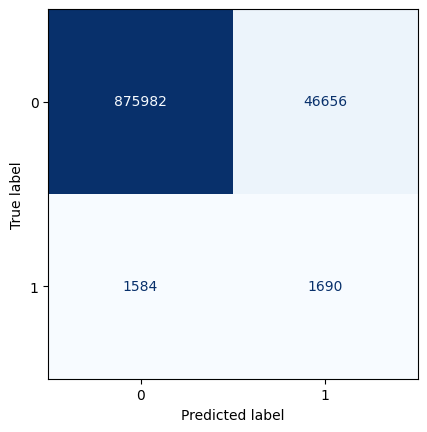

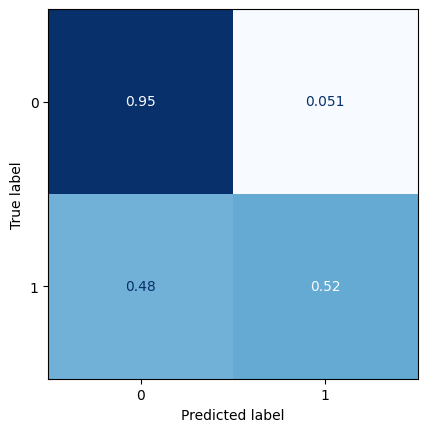

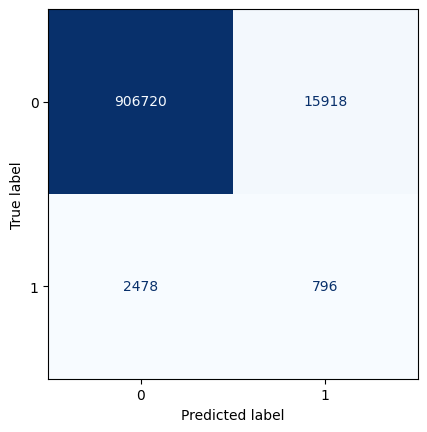

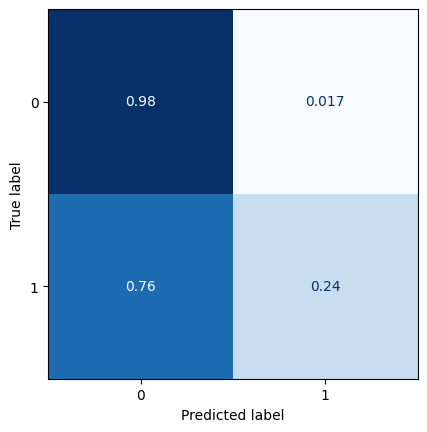

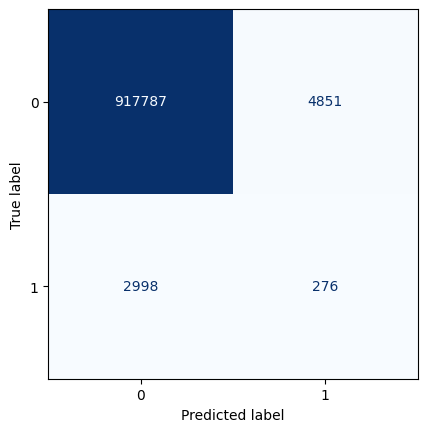

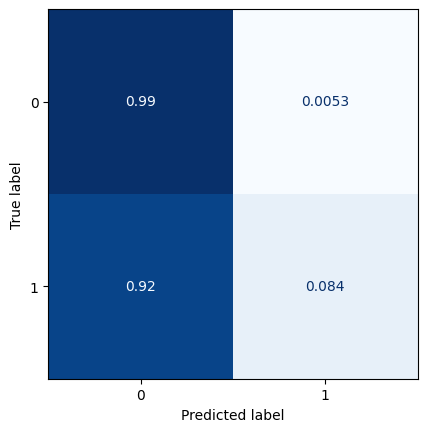

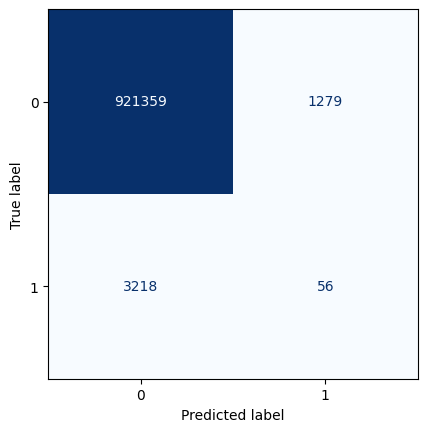

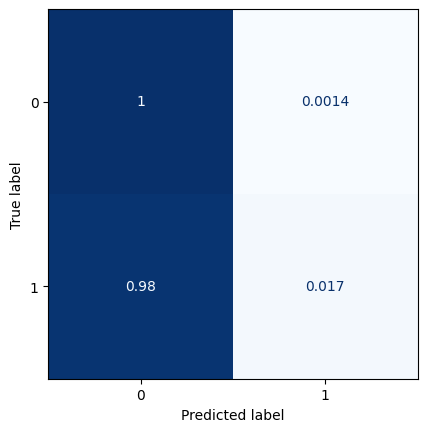

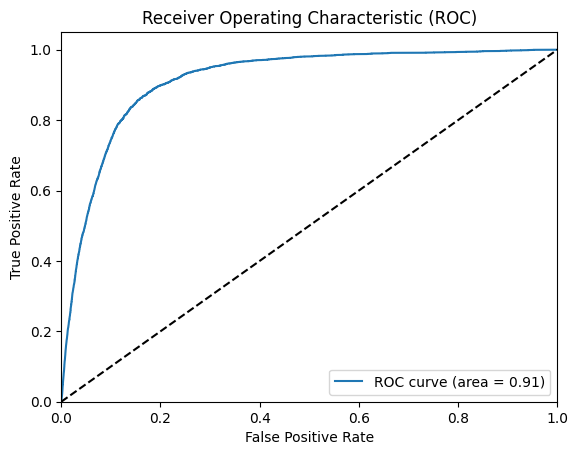

All zeros Brier score: 0.0035359731810366427
Model Brier score: 0.003463508515602628
Model: "model_11"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_12 (InputLayer)          [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_209 (Conv2D)            (None, 16, 32, 16)   1312        ['input_12[0][0]']               
                                                                                                  
 dropout_99 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_209[0][0]']             
                                                                                                  
 conv2d_210 (Conv2D)            (None, 16, 32, 16)   2320        ['dropout_99[0][0]']             
      

                                                                                                  
 conv2d_transpose_47 (Conv2DTra  (None, 16, 32, 16)  2064        ['conv2d_224[0][0]']             
 nspose)                                                                                          
                                                                                                  
 concatenate_47 (Concatenate)   (None, 16, 32, 32)   0           ['conv2d_transpose_47[0][0]',    
                                                                  'conv2d_210[0][0]']             
                                                                                                  
 conv2d_225 (Conv2D)            (None, 16, 32, 16)   4624        ['concatenate_47[0][0]']         
                                                                                                  
 dropout_107 (Dropout)          (None, 16, 32, 16)   0           ['conv2d_225[0][0]']             
          

2023-05-30 10:04:12.432661: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0276

2023-05-30 10:04:24.230368: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 17s 32ms/step - loss: 0.0276 - val_loss: 0.0202
Epoch 2/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0217 - val_loss: 0.0195
Epoch 3/100
354/354 [==============================] - 7s 21ms/step - loss: 0.0213 - val_loss: 0.0198
Epoch 4/100
354/354 [==============================] - 8s 22ms/step - loss: 0.0210 - val_loss: 0.0199
Epoch 5/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0208 - val_loss: 0.0194
Epoch 6/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0205 - val_loss: 0.0194
Epoch 7/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0204 - val_loss: 0.0202
Epoch 8/100
354/354 [==============================] - 7s 18ms/step - loss: 0.0202 - val_loss: 0.0206
Epoch 9/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0200 - val_loss: 0.0197
Epoch 10/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0197 - val_los

2023-05-30 10:07:42.593812: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 11ms/step


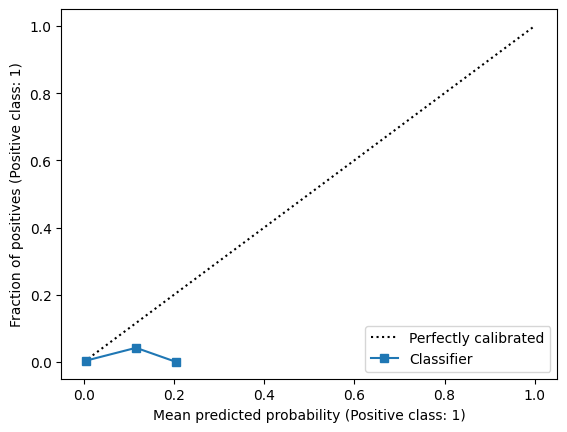

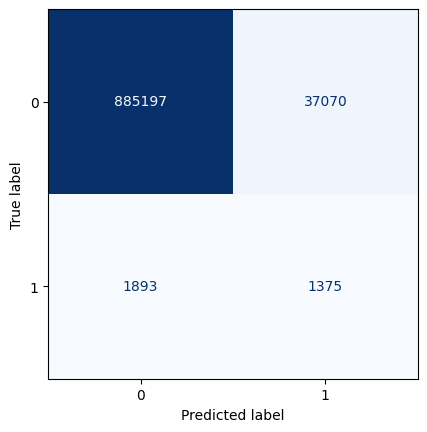

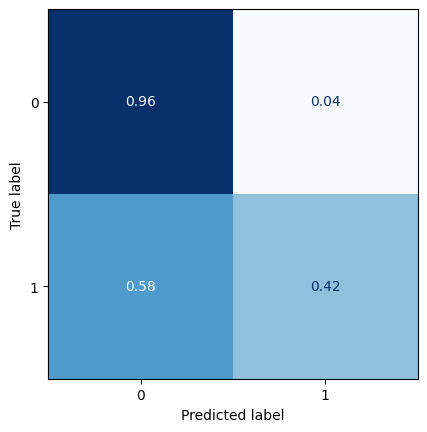

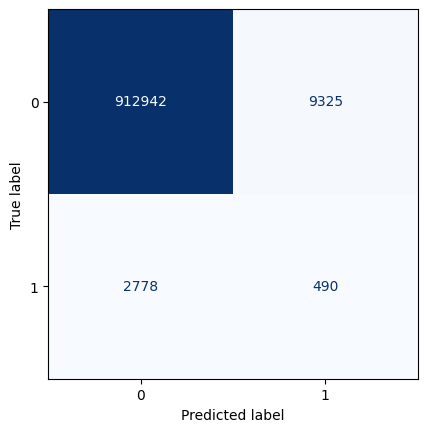

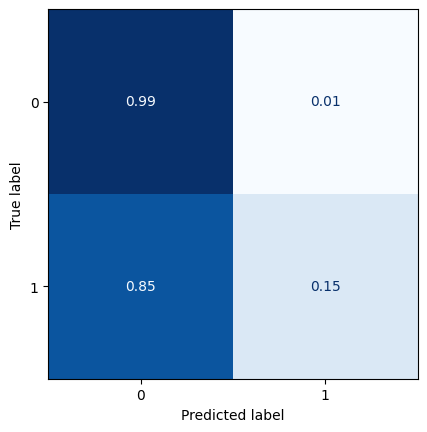

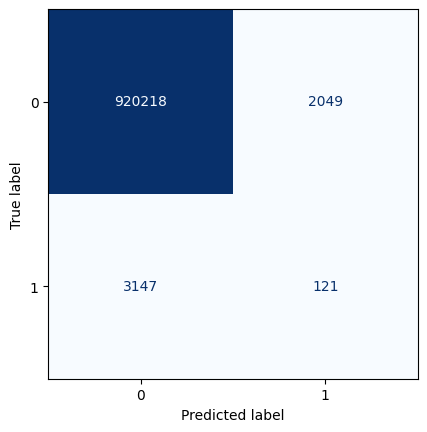

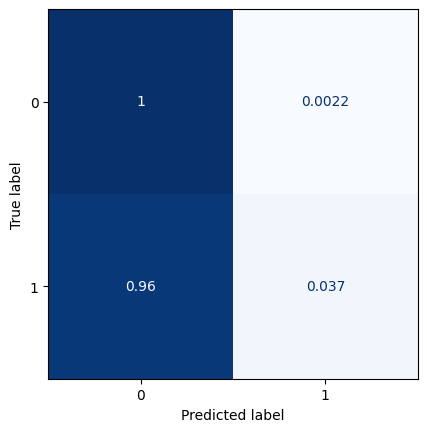

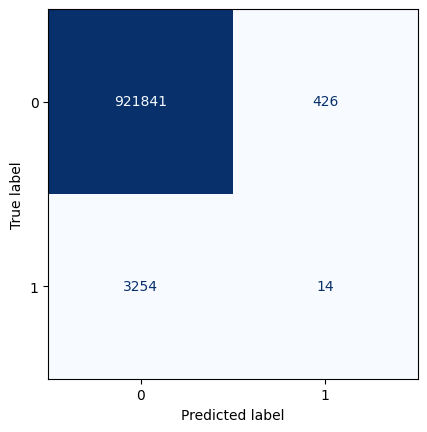

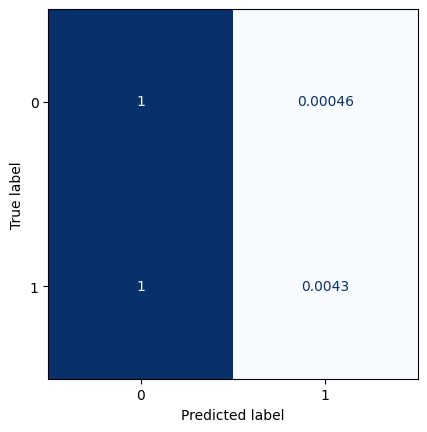

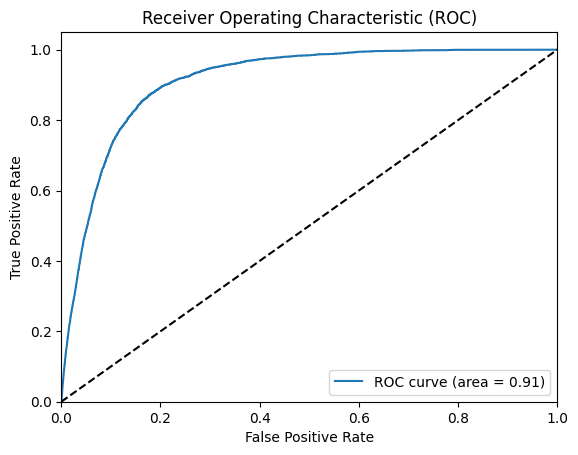

All zeros Brier score: 0.0035309307589664355
Model Brier score: 0.0034579553321856028
Model: "model_12"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_13 (InputLayer)          [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_228 (Conv2D)            (None, 16, 32, 16)   1312        ['input_13[0][0]']               
                                                                                                  
 dropout_108 (Dropout)          (None, 16, 32, 16)   0           ['conv2d_228[0][0]']             
                                                                                                  
 conv2d_229 (Conv2D)            (None, 16, 32, 16)   2320        ['dropout_108[0][0]']            
     

                                                                                                  
 conv2d_transpose_51 (Conv2DTra  (None, 16, 32, 16)  2064        ['conv2d_243[0][0]']             
 nspose)                                                                                          
                                                                                                  
 concatenate_51 (Concatenate)   (None, 16, 32, 32)   0           ['conv2d_transpose_51[0][0]',    
                                                                  'conv2d_229[0][0]']             
                                                                                                  
 conv2d_244 (Conv2D)            (None, 16, 32, 16)   4624        ['concatenate_51[0][0]']         
                                                                                                  
 dropout_116 (Dropout)          (None, 16, 32, 16)   0           ['conv2d_244[0][0]']             
          

2023-05-30 10:08:09.120248: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0408

2023-05-30 10:08:19.523468: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 12s 28ms/step - loss: 0.0408 - val_loss: 0.0219
Epoch 2/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0222 - val_loss: 0.0201
Epoch 3/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0216 - val_loss: 0.0208
Epoch 4/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0212 - val_loss: 0.0194
Epoch 5/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0209 - val_loss: 0.0200
Epoch 6/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0206 - val_loss: 0.0203
Epoch 7/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0204 - val_loss: 0.0202
Epoch 8/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0202 - val_loss: 0.0201
Epoch 9/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0199 - val_loss: 0.0212
Epoch 10/100
354/354 [==============================] - 7s 18ms/step - loss: 0.0196 - val_los

2023-05-30 10:10:53.607065: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 9ms/step


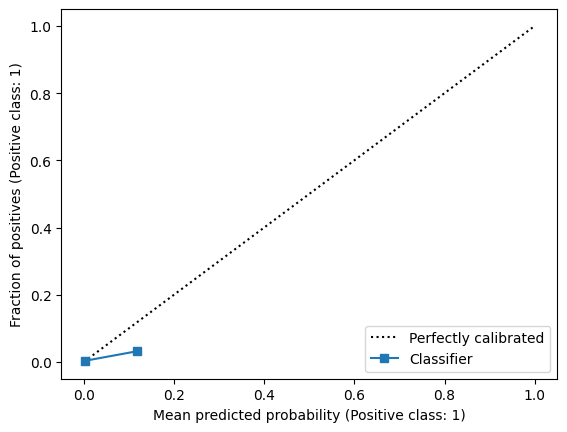

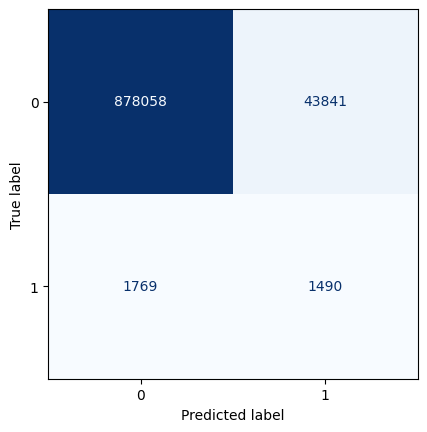

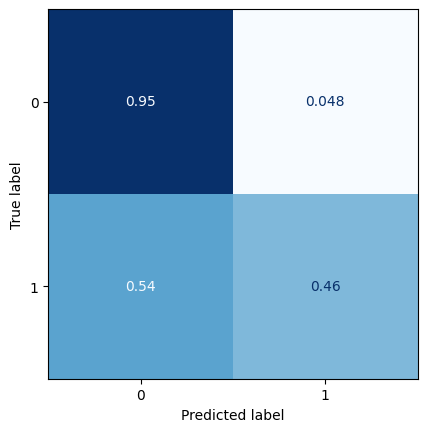

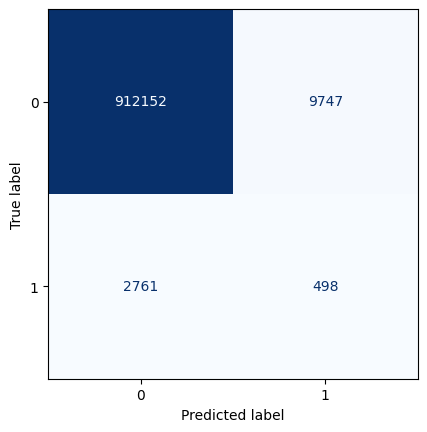

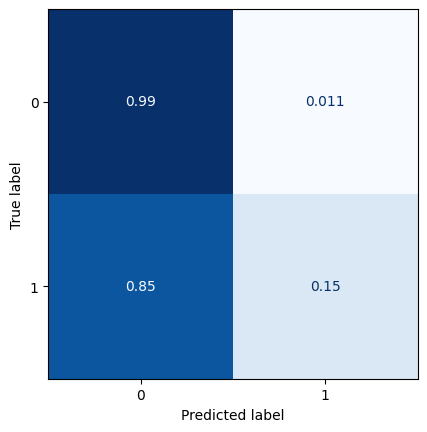

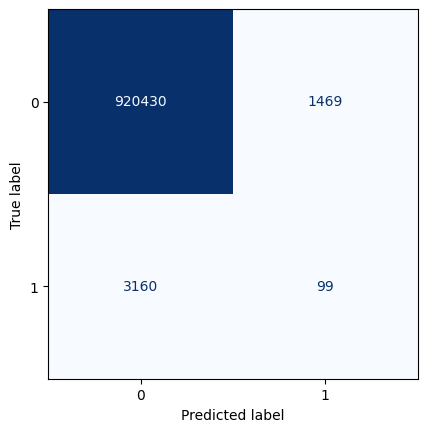

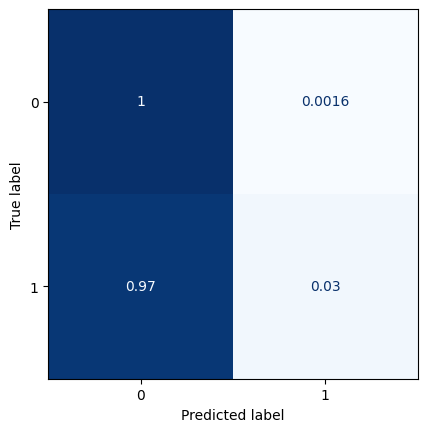

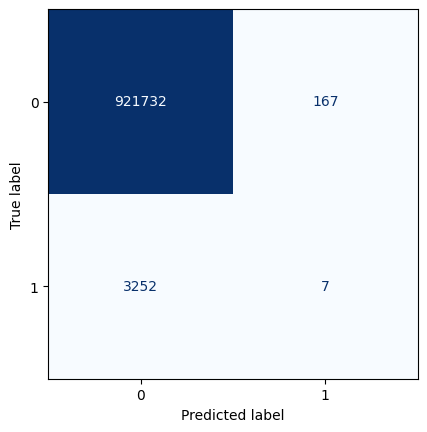

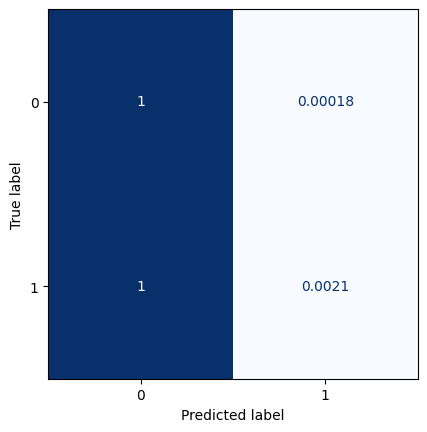

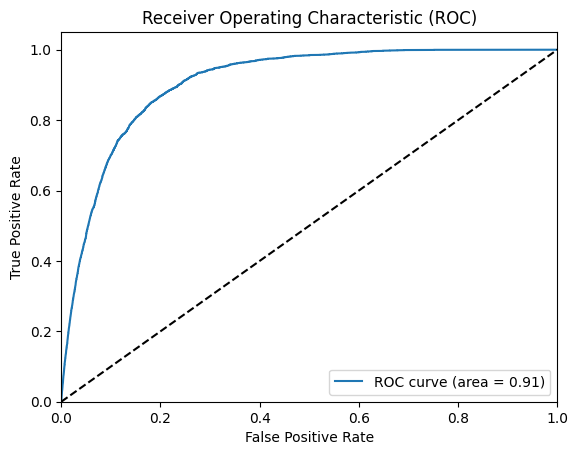

All zeros Brier score: 0.003522641537985944
Model Brier score: 0.0034498033448030333
Model: "model_13"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_14 (InputLayer)          [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_247 (Conv2D)            (None, 16, 32, 16)   1312        ['input_14[0][0]']               
                                                                                                  
 dropout_117 (Dropout)          (None, 16, 32, 16)   0           ['conv2d_247[0][0]']             
                                                                                                  
 conv2d_248 (Conv2D)            (None, 16, 32, 16)   2320        ['dropout_117[0][0]']            
      

                                                                                                  
 conv2d_transpose_55 (Conv2DTra  (None, 16, 32, 16)  2064        ['conv2d_262[0][0]']             
 nspose)                                                                                          
                                                                                                  
 concatenate_55 (Concatenate)   (None, 16, 32, 32)   0           ['conv2d_transpose_55[0][0]',    
                                                                  'conv2d_248[0][0]']             
                                                                                                  
 conv2d_263 (Conv2D)            (None, 16, 32, 16)   4624        ['concatenate_55[0][0]']         
                                                                                                  
 dropout_125 (Dropout)          (None, 16, 32, 16)   0           ['conv2d_263[0][0]']             
          

2023-05-30 10:11:22.195197: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0306

2023-05-30 10:11:41.382760: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 24s 50ms/step - loss: 0.0306 - val_loss: 0.0222
Epoch 2/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0218 - val_loss: 0.0202
Epoch 3/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0215 - val_loss: 0.0193
Epoch 4/100
354/354 [==============================] - 7s 21ms/step - loss: 0.0212 - val_loss: 0.0206
Epoch 5/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0210 - val_loss: 0.0196
Epoch 6/100
354/354 [==============================] - 8s 22ms/step - loss: 0.0208 - val_loss: 0.0197
Epoch 7/100
354/354 [==============================] - 7s 21ms/step - loss: 0.0206 - val_loss: 0.0204
Epoch 8/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0204 - val_loss: 0.0198
Epoch 9/100
354/354 [==============================] - 8s 22ms/step - loss: 0.0202 - val_loss: 0.0199
Epoch 10/100
354/354 [==============================] - 9s 24ms/step - loss: 0.0200 - val_los

2023-05-30 10:15:26.148811: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 2s 10ms/step


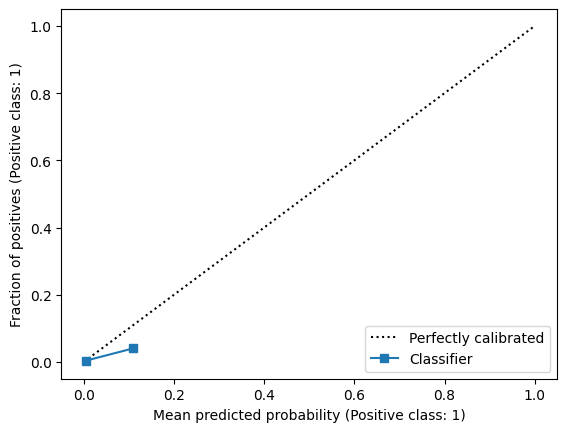

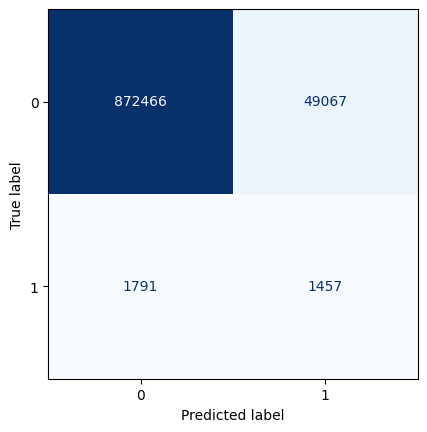

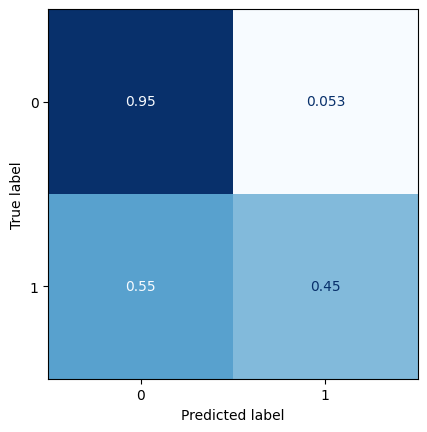

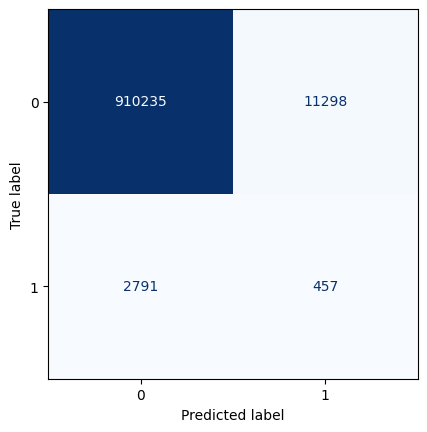

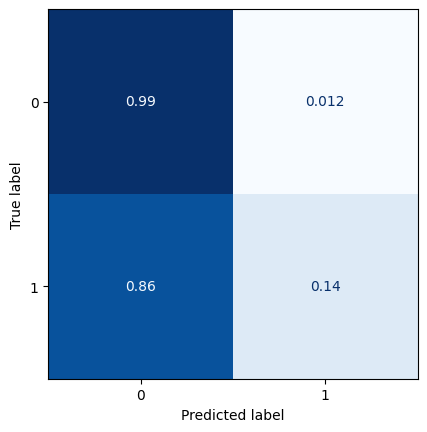

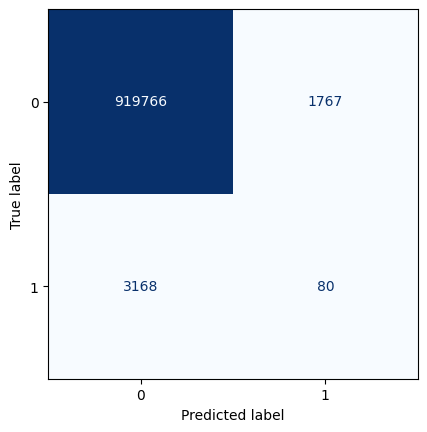

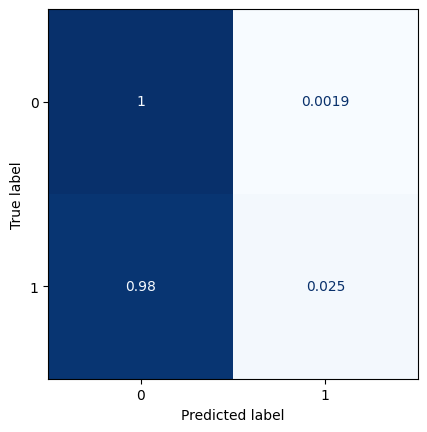

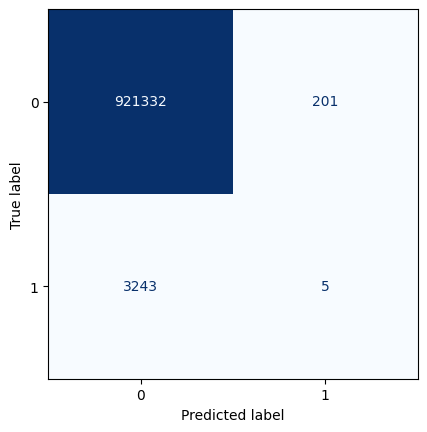

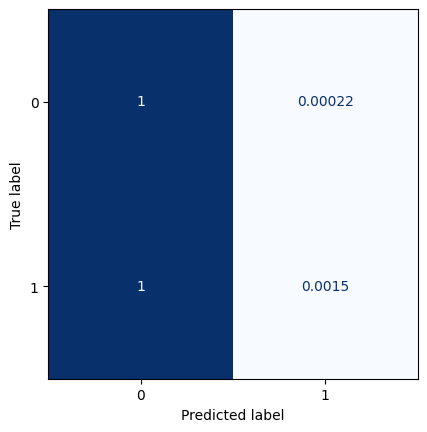

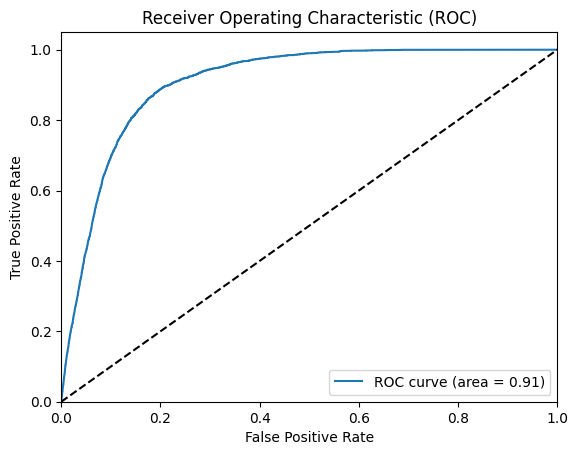

All zeros Brier score: 0.0035121828843801936
Model Brier score: 0.003456645813261825


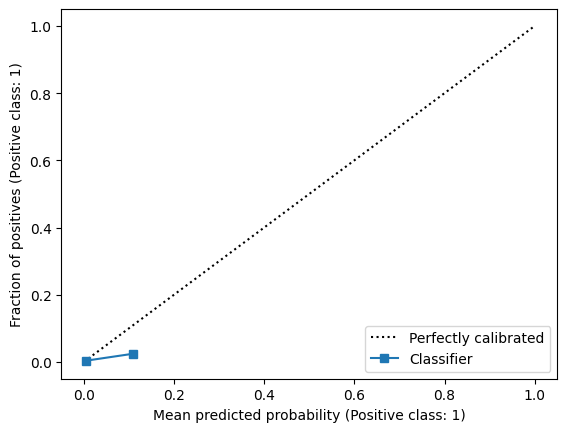

In [28]:
for lag in [1,2,3,4,5,6,7,8,9,10,11,12,13]:
    ### Model summary
    model = simple_unet_model(16,32,9)
    
    model.compile(loss='binary_crossentropy', optimizer='adam')
    
    monitor = EarlyStopping(monitor='val_loss', min_delta=1e-5, patience=20, 
            verbose=1, mode='auto', restore_best_weights=True)
    
    ### Model training
    model.fit(train_img_std_padded[:-lag], y_train_img[lag:], validation_data=(val_img_std_padded[:-lag],y_val_img[lag:]),
        callbacks=[monitor],epochs=100)
    
    ### Confusion matrices
    t = model.predict(test_img_std_padded[:-lag])

    ranges = [0.025,0.05,0.075,0.1]
    
    for j in ranges:
        classes = []
        for i in t.reshape(-1,1):
            if i<=j: classes.append(0)
            else: classes.append(1)
    
        ConfusionMatrixDisplay(confusion_matrix(y_test_img[lag:].reshape(-1,1), classes)).plot(colorbar=False,cmap=plt.cm.Blues, values_format='d')
        ConfusionMatrixDisplay(confusion_matrix(y_test_img[lag:].reshape(-1,1), classes, normalize='true')).plot(colorbar=False,cmap=plt.cm.Blues)
    
    ### ROC
    plot_roc(t.reshape(-1,1),y_test_img[lag:].reshape(-1,1))
    
    z = np.zeros((lag,13,29,1))
    tt = np.concatenate((t,z))
    test['predictions_lag'+str(lag)] = tt.reshape(-1,1)
    test.to_csv("test_with_newTarget_predictions.csv")
    
    ### calibration
    display = CalibrationDisplay.from_predictions(y_test_img[lag:].reshape(-1,1), t.reshape(-1,1), n_bins=10)
    print(f'All zeros Brier score: {brier_score_loss(y_test_img[lag:].reshape(-1,1), np.zeros(len(y_test_img[lag:].reshape(-1,1))))}')
    print(f'Model Brier score: {brier_score_loss(y_test_img[lag:].reshape(-1,1), t.reshape(-1,1))}')
    

In [36]:
test.to_csv('test_with_newTarget_predictions_unet.csv')

# Simpler U-Net

In [24]:
# u-net model 
from sklearn.calibration import CalibrationDisplay
from sklearn.metrics import brier_score_loss

from keras.models import Model
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate, Conv2DTranspose, BatchNormalization, Dropout, Lambda, Cropping2D

################################################################
def very_simple_unet_model(IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS):
#Build the model
    inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
    #s = Lambda(lambda x: x / 255)(inputs)   #No need for this if we normalize our inputs beforehand
    s = inputs

    #Contraction path
    c1 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(s)
    c1 = Dropout(0.1)(c1)
    c1 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c1)
    p1 = MaxPooling2D((2, 2))(c1)
    
    c2 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p1)
    c2 = Dropout(0.1)(c2)
    c2 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c2)
    p2 = MaxPooling2D((2, 2))(c2)
     
    c3 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p2)
    c3 = Dropout(0.2)(c3)
    c3 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c3)
 
    u8 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(c3)
    u8 = concatenate([u8, c2])
    c8 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u8)
    c8 = Dropout(0.1)(c8)
    c8 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c8)
     
    u9 = Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same')(c8)
    u9 = concatenate([u9, c1], axis=3)
    c9 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u9)
    c9 = Dropout(0.1)(c9)
    c9 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c9)
    
    c10 = Cropping2D(cropping=((1,2),(1,2)))(c9)
     
    outputs = Conv2D(1, (1, 1), activation='sigmoid')(c10)
     
    model = Model(inputs=[inputs], outputs=[outputs])
    
    #model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    model.summary()
    
    return model
 

In [20]:
model = very_simple_unet_model(16,32,9)

model.compile(loss='binary_crossentropy', optimizer='adam')

monitor = EarlyStopping(monitor='val_loss', min_delta=1e-5, patience=20, 
        verbose=1, mode='auto', restore_best_weights=True)

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_22 (Conv2D)             (None, 16, 32, 16)   1312        ['input_3[0][0]']                
                                                                                                  
 dropout_10 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_22[0][0]']              
                                                                                                  
 conv2d_23 (Conv2D)             (None, 16, 32, 16)   2320        ['dropout_10[0][0]']             
                                                                                            

In [21]:
pad_tns = tf.constant([ [0,0], [1,2], [1,2], [0,0] ])
train_img_std_padded = np.array(tf.pad(train_img_std,pad_tns,mode='CONSTANT',constant_values=0))
val_img_std_padded = np.array(tf.pad(val_img_std,pad_tns,mode='CONSTANT',constant_values=0))
test_img_std_padded = np.array(tf.pad(test_img_std,pad_tns,mode='CONSTANT',constant_values=0))

model.fit(train_img_std_padded, y_train_img, validation_data=(val_img_std_padded,y_val_img),
        callbacks=[monitor],epochs=100)

Epoch 1/100


2023-05-30 12:01:45.656931: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-05-30 12:01:46.113179: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0270

2023-05-30 12:01:51.672527: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 6s 15ms/step - loss: 0.0270 - val_loss: 0.0111
Epoch 2/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0114 - val_loss: 0.0110
Epoch 3/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0102 - val_loss: 0.0086
Epoch 4/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0096 - val_loss: 0.0079
Epoch 5/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0092 - val_loss: 0.0088
Epoch 6/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0089 - val_loss: 0.0077
Epoch 7/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0085 - val_loss: 0.0083
Epoch 8/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0083 - val_loss: 0.0077
Epoch 9/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0081 - val_loss: 0.0079
Epoch 10/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0078 - val_loss

13/78 [====>.........................] - ETA: 0s 

2023-05-30 12:04:07.670050: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


78/78 [==============================] - 1s 5ms/step


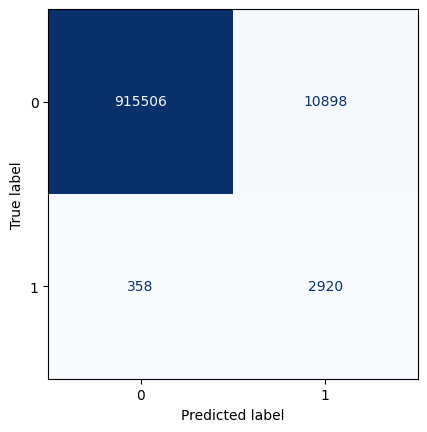

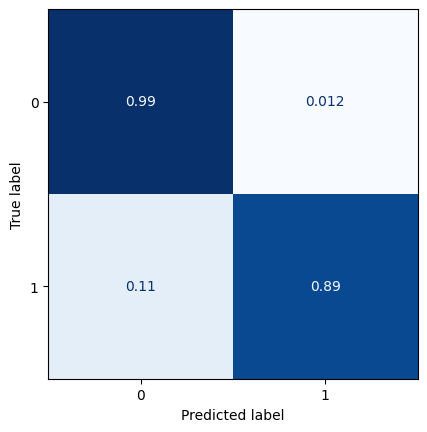

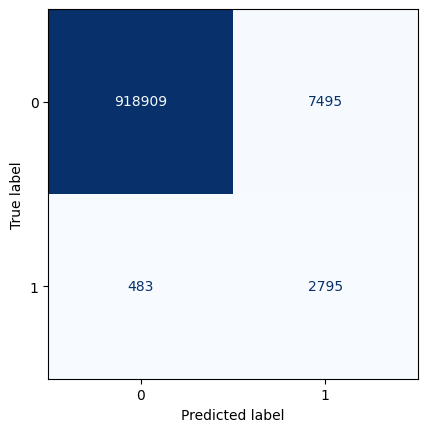

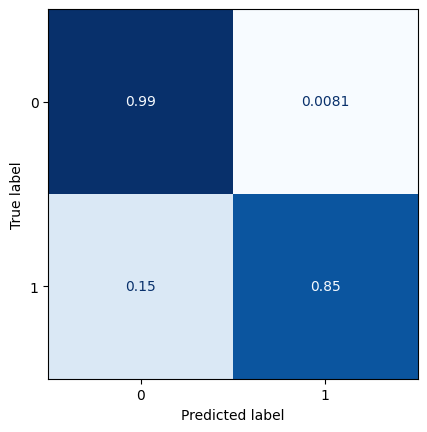

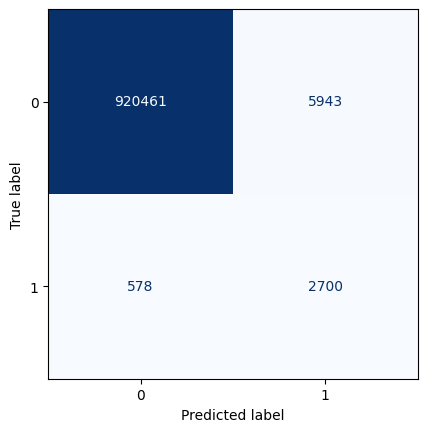

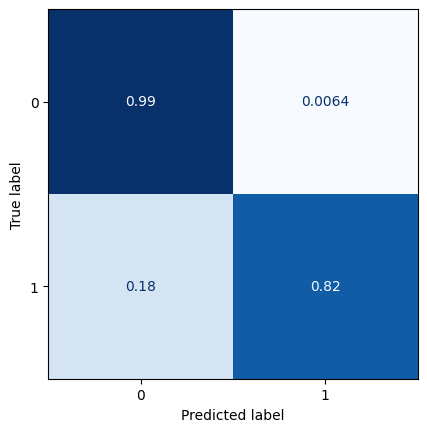

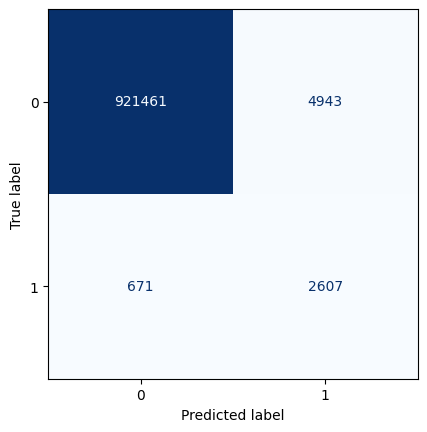

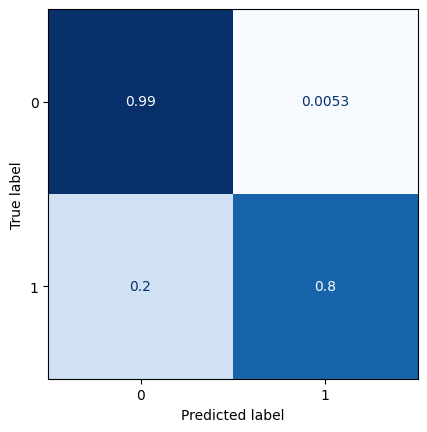

In [22]:
t = model.predict(test_img_std_padded)

ranges = [0.025,0.05,0.075,0.1]

for j in ranges:
    classes = []
    for i in t.reshape(-1,1):
        if i<=j: classes.append(0)
        else: classes.append(1)

# confusion matrix with threshold on 0.1, otherwise always 0 
    ConfusionMatrixDisplay(confusion_matrix(y_test_img.reshape(-1,1), classes)).plot(colorbar=False,cmap=plt.cm.Blues, values_format='d')
    ConfusionMatrixDisplay(confusion_matrix(y_test_img.reshape(-1,1), classes, normalize='true')).plot(colorbar=False,cmap=plt.cm.Blues)
    

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_44 (Conv2D)             (None, 16, 32, 16)   1312        ['input_5[0][0]']                
                                                                                                  
 dropout_20 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_44[0][0]']              
                                                                                                  
 conv2d_45 (Conv2D)             (None, 16, 32, 16)   2320        ['dropout_20[0][0]']             
                                                                                            

2023-05-30 12:38:28.406408: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0298

2023-05-30 12:38:33.926560: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 6s 16ms/step - loss: 0.0298 - val_loss: 0.0152
Epoch 2/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0137 - val_loss: 0.0112
Epoch 3/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0125 - val_loss: 0.0108
Epoch 4/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0118 - val_loss: 0.0115
Epoch 5/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0115 - val_loss: 0.0109
Epoch 6/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0110 - val_loss: 0.0098
Epoch 7/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0106 - val_loss: 0.0096
Epoch 8/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0103 - val_loss: 0.0093
Epoch 9/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0100 - val_loss: 0.0097
Epoch 10/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0097 - val_loss

2023-05-30 12:40:31.857298: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


78/78 [==============================] - 0s 4ms/step


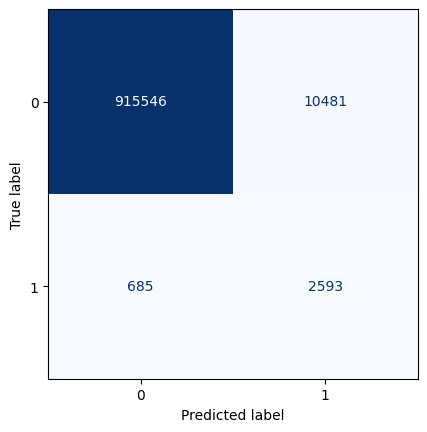

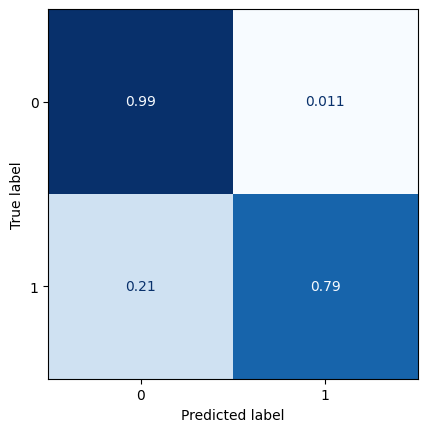

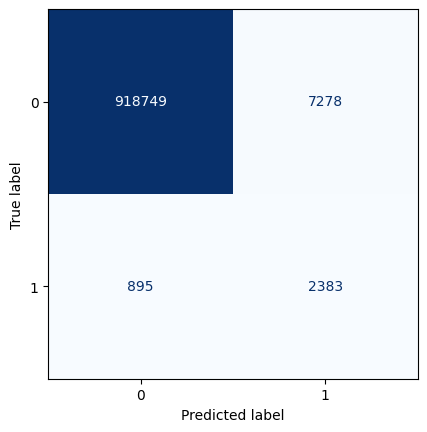

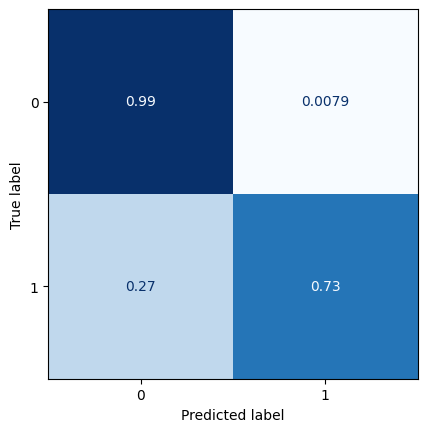

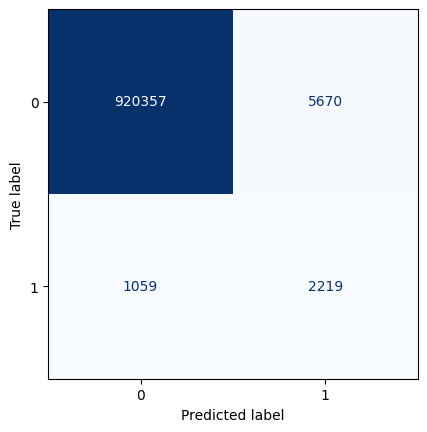

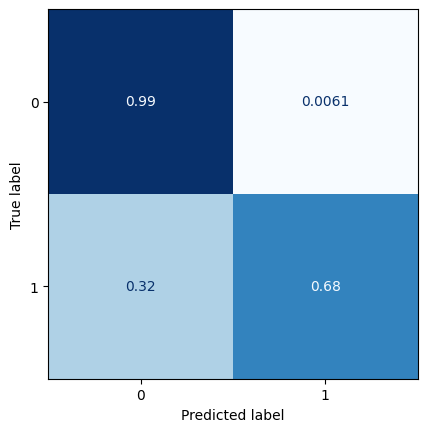

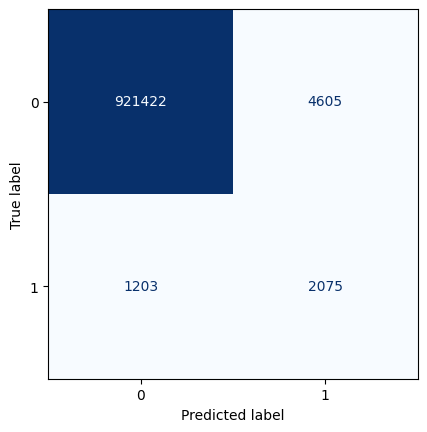

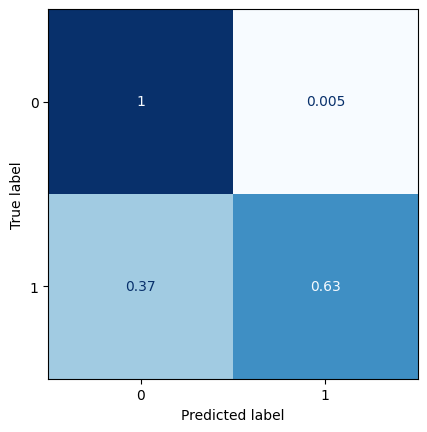

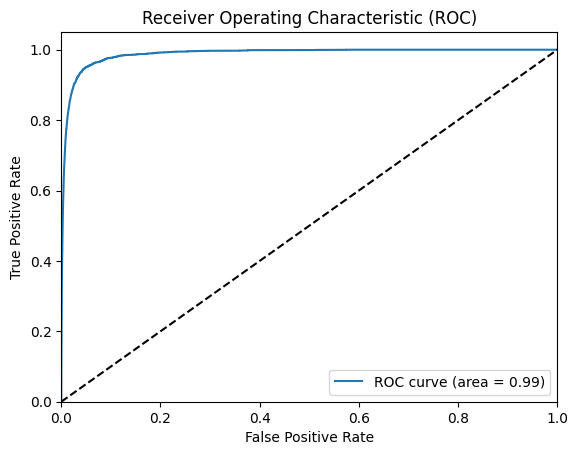

All zeros Brier score: 0.00352736722604527
Model Brier score: 0.0026370053659023084
Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_55 (Conv2D)             (None, 16, 32, 16)   1312        ['input_6[0][0]']                
                                                                                                  
 dropout_25 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_55[0][0]']              
                                                                                                  
 conv2d_56 (Conv2D)             (None, 16, 32, 16)   2320        ['dropout_25[0][0]']             
        

2023-05-30 12:40:48.794521: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0267

2023-05-30 12:40:54.214035: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 6s 15ms/step - loss: 0.0267 - val_loss: 0.0171
Epoch 2/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0171 - val_loss: 0.0145
Epoch 3/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0156 - val_loss: 0.0141
Epoch 4/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0147 - val_loss: 0.0134
Epoch 5/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0141 - val_loss: 0.0129
Epoch 6/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0136 - val_loss: 0.0131
Epoch 7/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0131 - val_loss: 0.0135
Epoch 8/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0128 - val_loss: 0.0132
Epoch 9/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0124 - val_loss: 0.0129
Epoch 10/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0121 - val_loss

2023-05-30 12:42:37.040561: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


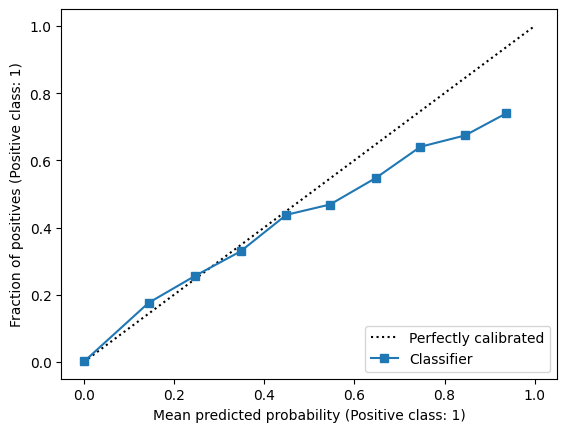

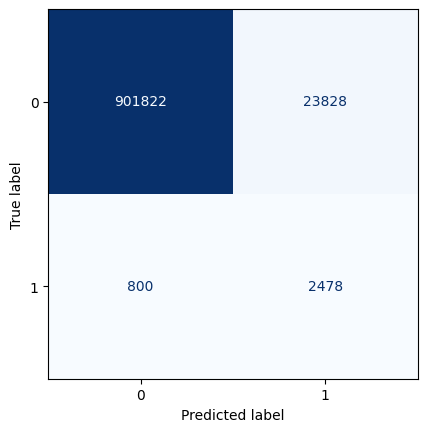

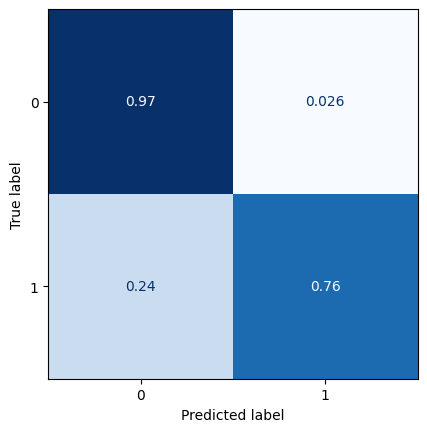

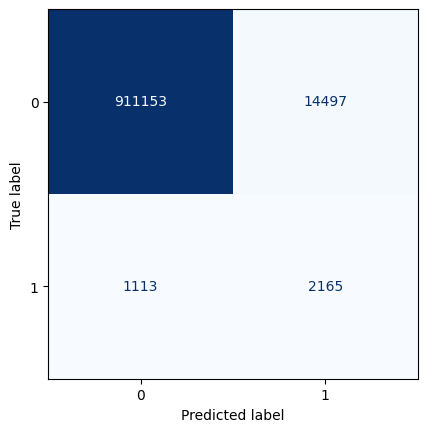

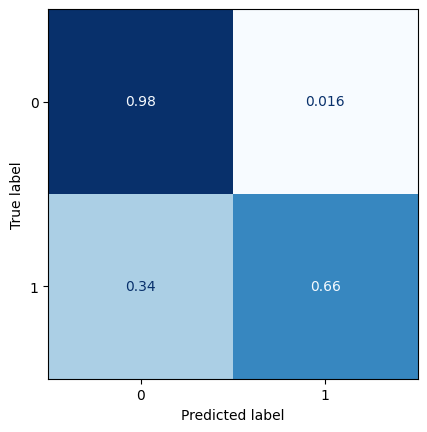

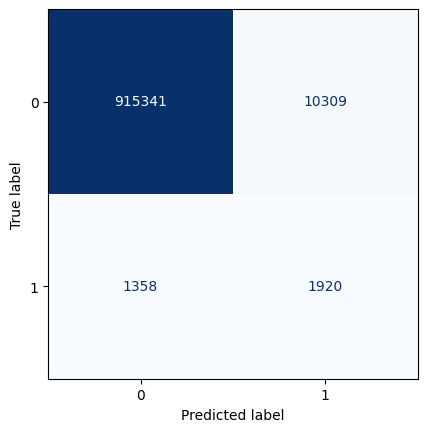

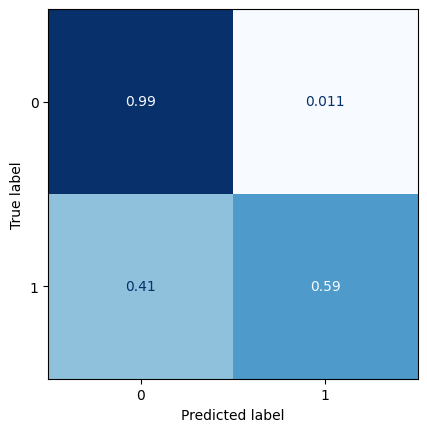

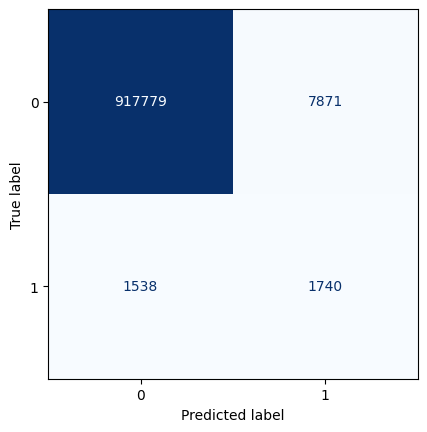

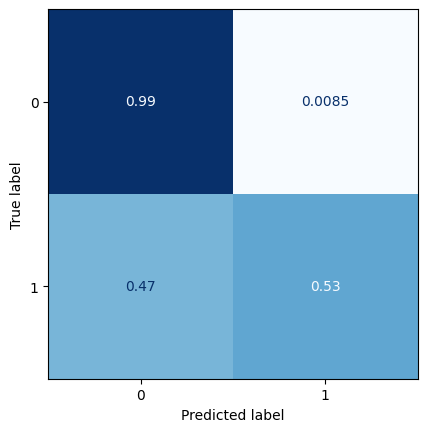

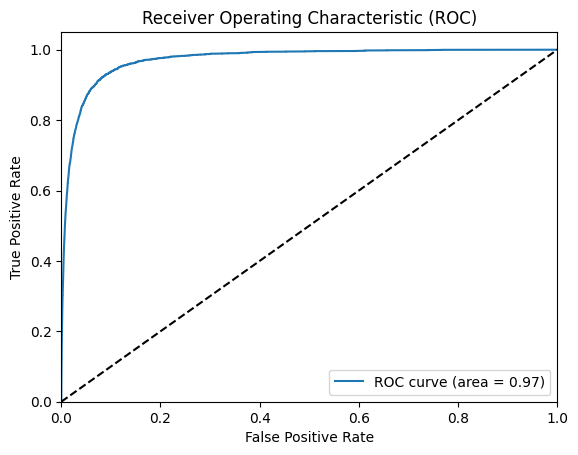

All zeros Brier score: 0.003528798787419477
Model Brier score: 0.0030749263574761138
Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_66 (Conv2D)             (None, 16, 32, 16)   1312        ['input_7[0][0]']                
                                                                                                  
 dropout_30 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_66[0][0]']              
                                                                                                  
 conv2d_67 (Conv2D)             (None, 16, 32, 16)   2320        ['dropout_30[0][0]']             
       

2023-05-30 12:42:56.181736: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0274

2023-05-30 12:43:01.348624: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 8s 15ms/step - loss: 0.0274 - val_loss: 0.0199
Epoch 2/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0185 - val_loss: 0.0167
Epoch 3/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0173 - val_loss: 0.0163
Epoch 4/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0165 - val_loss: 0.0149
Epoch 5/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0160 - val_loss: 0.0171
Epoch 6/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0156 - val_loss: 0.0147
Epoch 7/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0151 - val_loss: 0.0154
Epoch 8/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0148 - val_loss: 0.0154
Epoch 9/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0145 - val_loss: 0.0151
Epoch 10/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0141 - val_loss

2023-05-30 12:44:53.972809: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 5ms/step


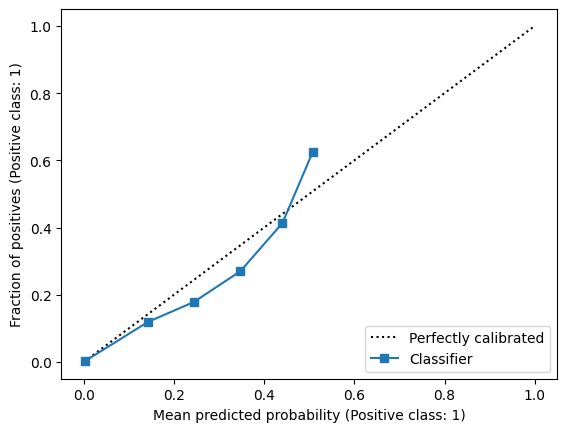

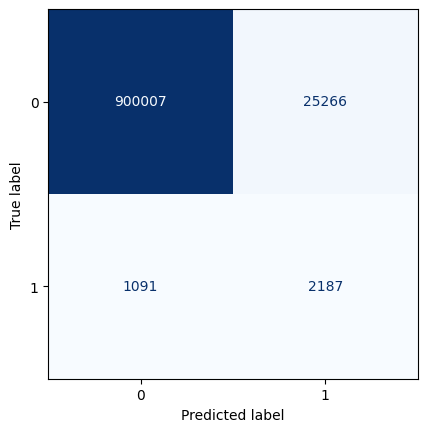

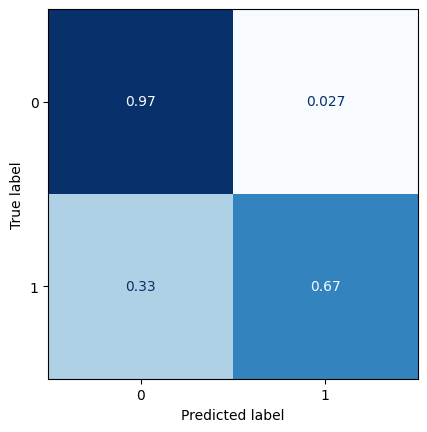

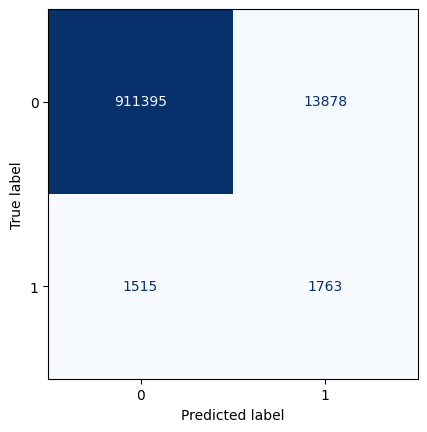

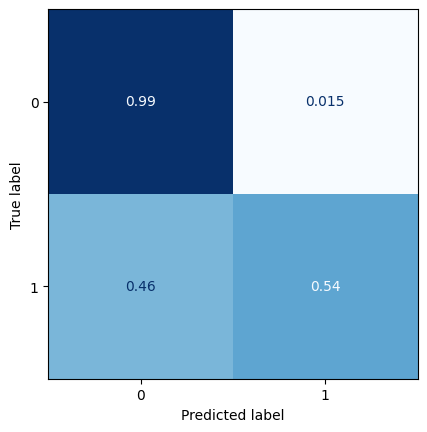

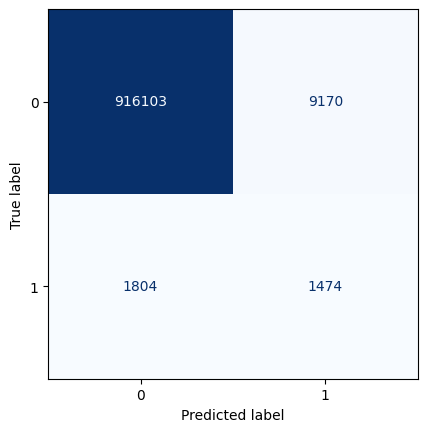

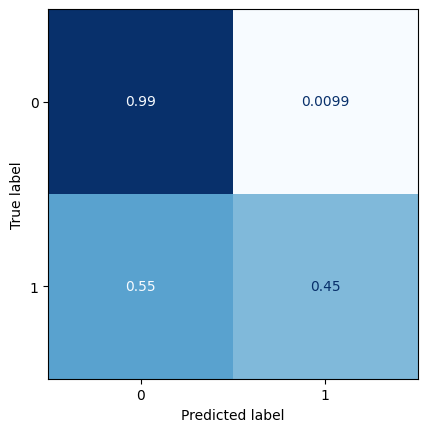

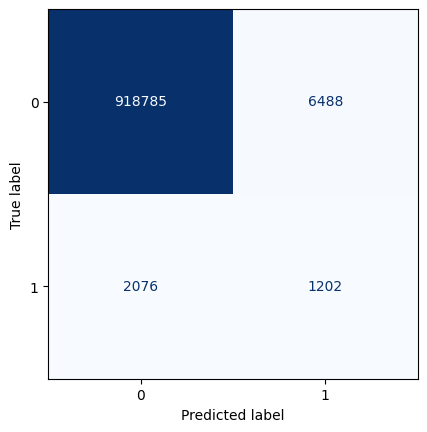

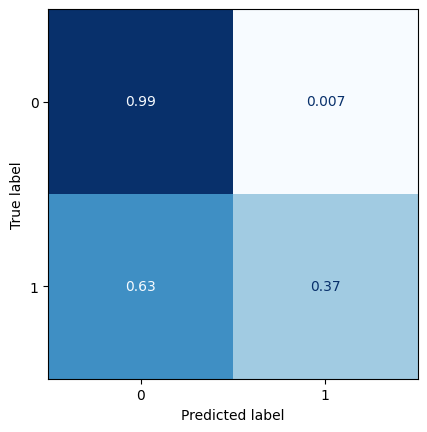

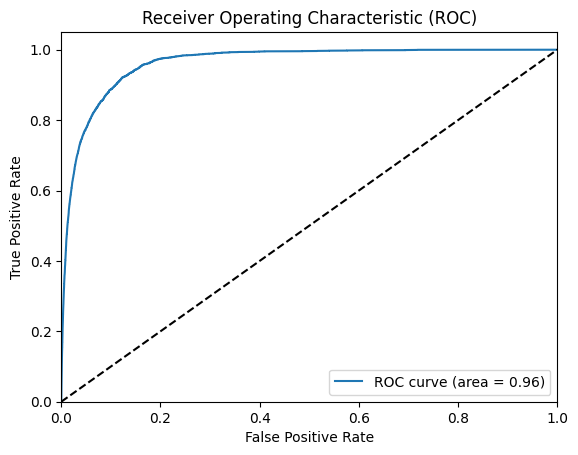

All zeros Brier score: 0.0035302315112470937
Model Brier score: 0.0032390738763948762
Model: "model_7"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_8 (InputLayer)           [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_77 (Conv2D)             (None, 16, 32, 16)   1312        ['input_8[0][0]']                
                                                                                                  
 dropout_35 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_77[0][0]']              
                                                                                                  
 conv2d_78 (Conv2D)             (None, 16, 32, 16)   2320        ['dropout_35[0][0]']             
      

2023-05-30 12:45:13.072315: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0411

2023-05-30 12:45:18.485371: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 6s 15ms/step - loss: 0.0411 - val_loss: 0.0197
Epoch 2/100
354/354 [==============================] - 5s 14ms/step - loss: 0.0200 - val_loss: 0.0227
Epoch 3/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0193 - val_loss: 0.0214
Epoch 4/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0185 - val_loss: 0.0176
Epoch 5/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0180 - val_loss: 0.0185
Epoch 6/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0177 - val_loss: 0.0169
Epoch 7/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0172 - val_loss: 0.0168
Epoch 8/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0169 - val_loss: 0.0169
Epoch 9/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0165 - val_loss: 0.0171
Epoch 10/100
354/354 [==============================] - 5s 14ms/step - loss: 0.0162 - val_loss

2023-05-30 12:47:16.151321: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 4ms/step


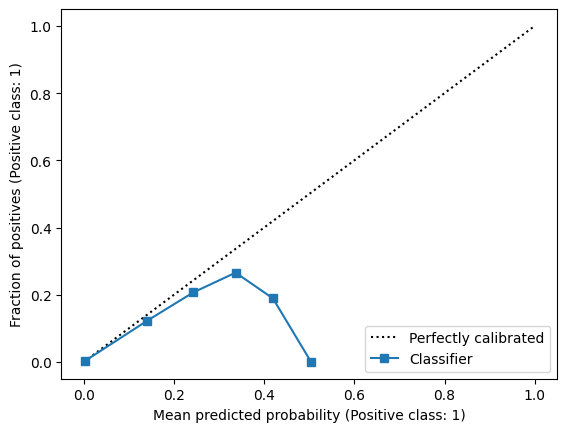

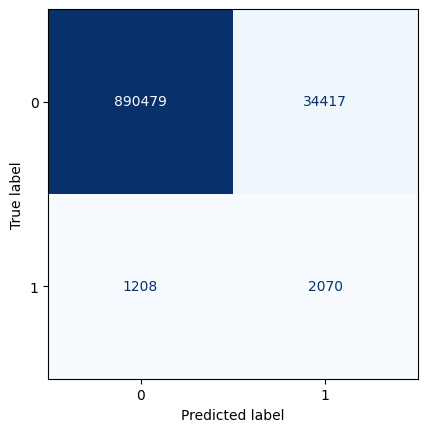

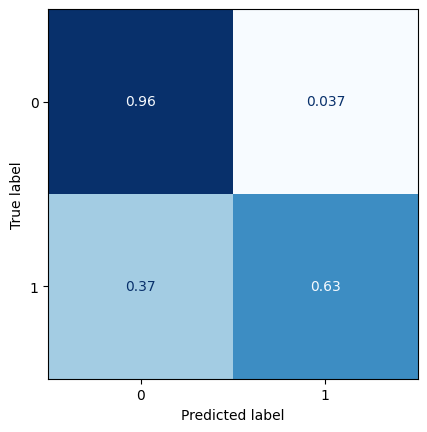

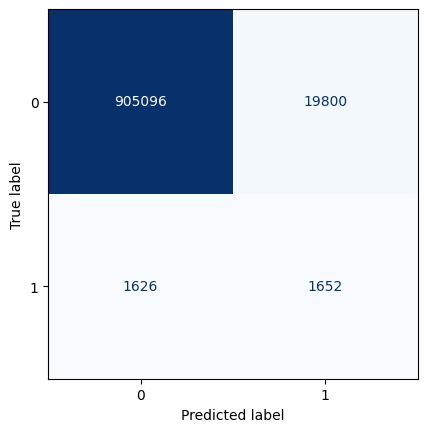

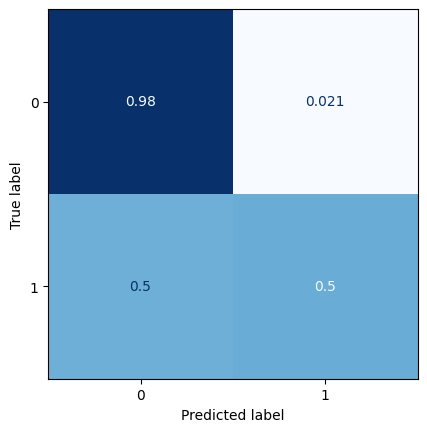

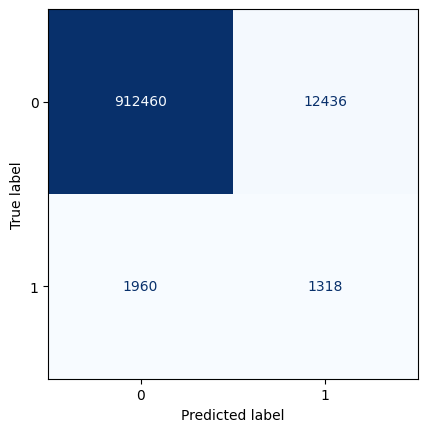

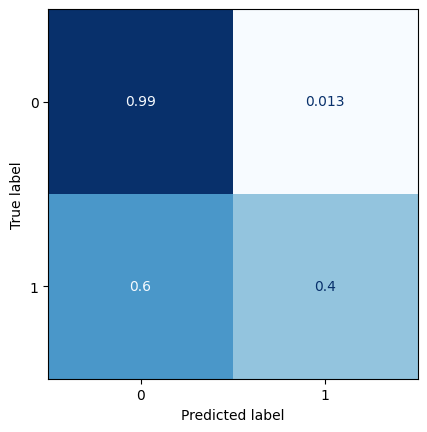

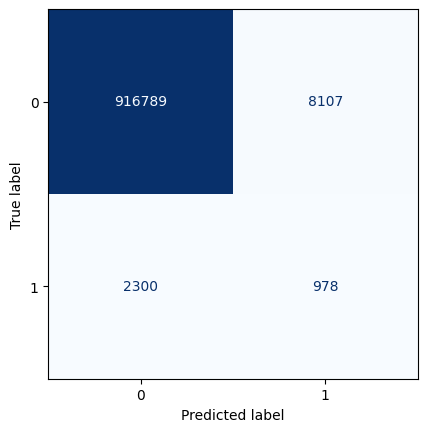

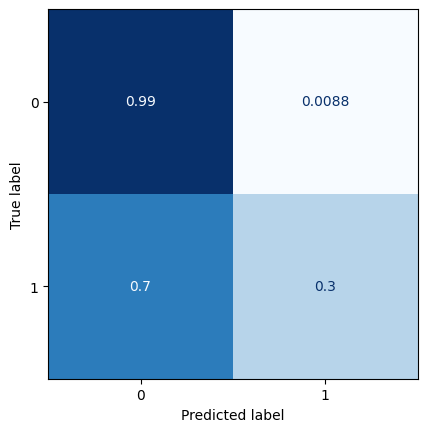

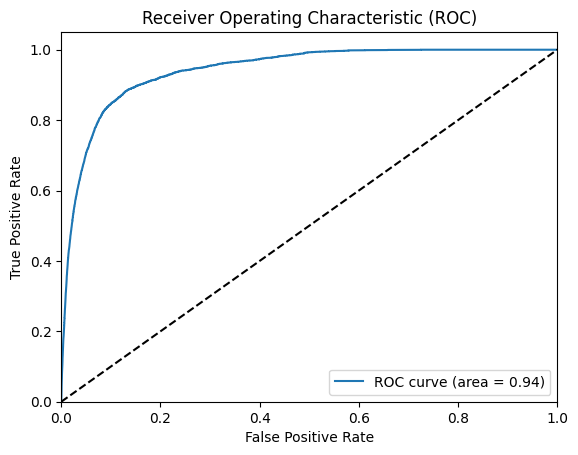

All zeros Brier score: 0.0035316653989445946
Model Brier score: 0.0033665337024669606
Model: "model_8"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_9 (InputLayer)           [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_88 (Conv2D)             (None, 16, 32, 16)   1312        ['input_9[0][0]']                
                                                                                                  
 dropout_40 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_88[0][0]']              
                                                                                                  
 conv2d_89 (Conv2D)             (None, 16, 32, 16)   2320        ['dropout_40[0][0]']             
      

2023-05-30 12:47:36.285524: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0254

2023-05-30 12:47:41.783402: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 6s 15ms/step - loss: 0.0254 - val_loss: 0.0188
Epoch 2/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0199 - val_loss: 0.0194
Epoch 3/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0191 - val_loss: 0.0185
Epoch 4/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0187 - val_loss: 0.0187
Epoch 5/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0182 - val_loss: 0.0181
Epoch 6/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0176 - val_loss: 0.0199
Epoch 7/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0173 - val_loss: 0.0189
Epoch 8/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0169 - val_loss: 0.0187
Epoch 9/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0164 - val_loss: 0.0197
Epoch 10/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0158 - val_loss

2023-05-30 12:49:29.895465: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 5ms/step


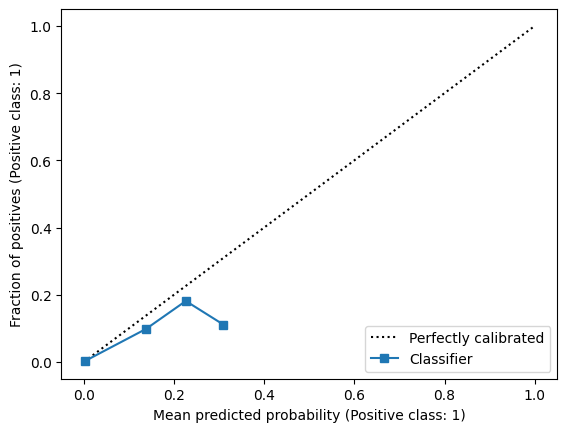

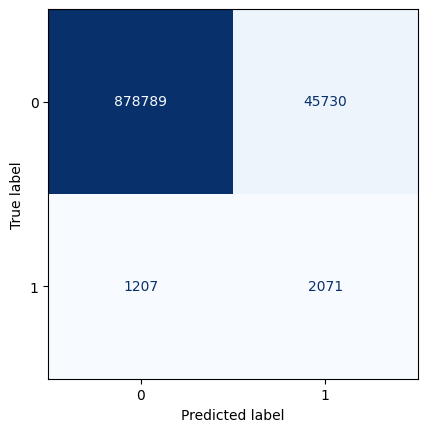

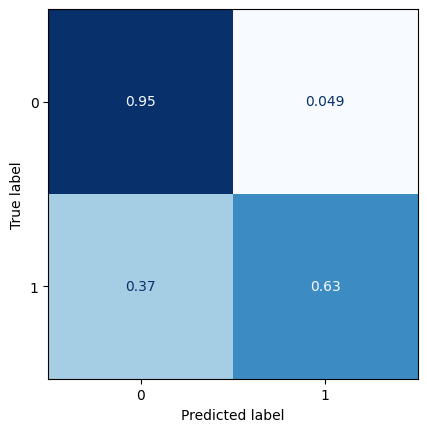

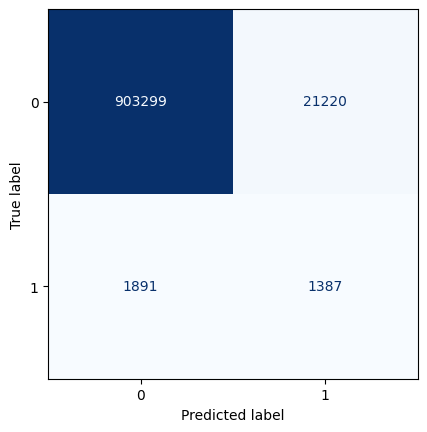

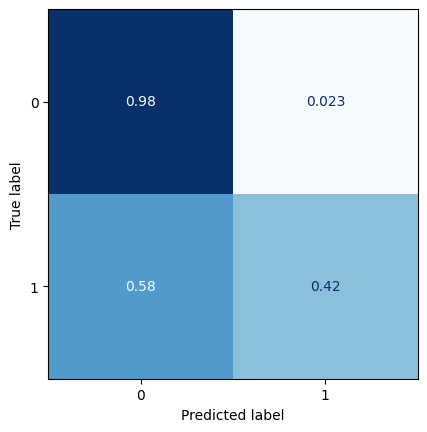

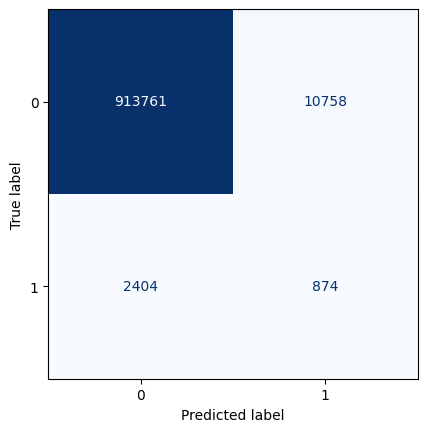

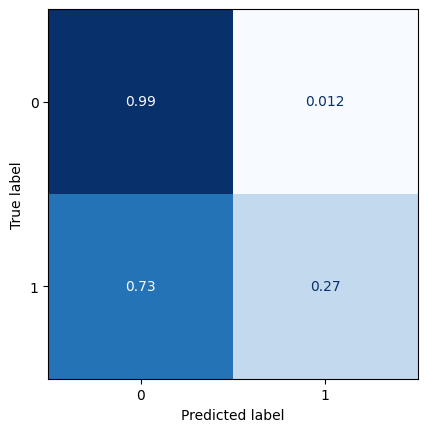

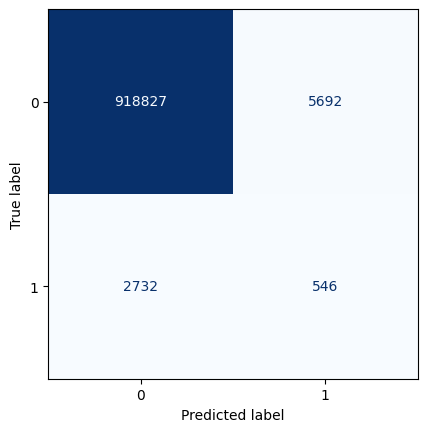

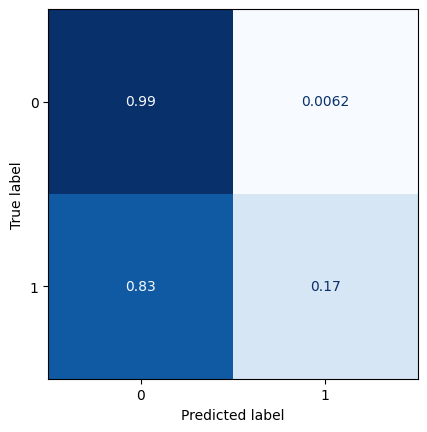

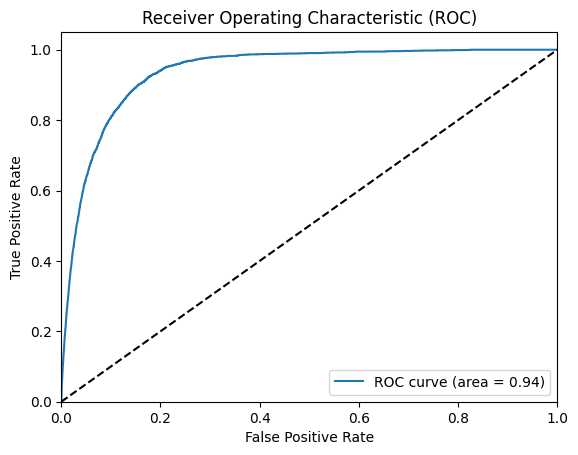

All zeros Brier score: 0.0035331004519307562
Model Brier score: 0.0034250183406348547
Model: "model_9"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_10 (InputLayer)          [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_99 (Conv2D)             (None, 16, 32, 16)   1312        ['input_10[0][0]']               
                                                                                                  
 dropout_45 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_99[0][0]']              
                                                                                                  
 conv2d_100 (Conv2D)            (None, 16, 32, 16)   2320        ['dropout_45[0][0]']             
      

2023-05-30 12:49:52.422071: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0308

2023-05-30 12:49:58.372156: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 7s 16ms/step - loss: 0.0308 - val_loss: 0.0185
Epoch 2/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0207 - val_loss: 0.0185
Epoch 3/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0200 - val_loss: 0.0197
Epoch 4/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0194 - val_loss: 0.0183
Epoch 5/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0190 - val_loss: 0.0205
Epoch 6/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0187 - val_loss: 0.0189
Epoch 7/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0182 - val_loss: 0.0196
Epoch 8/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0179 - val_loss: 0.0193
Epoch 9/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0174 - val_loss: 0.0197
Epoch 10/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0169 - val_loss

2023-05-30 12:51:41.878246: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 6ms/step


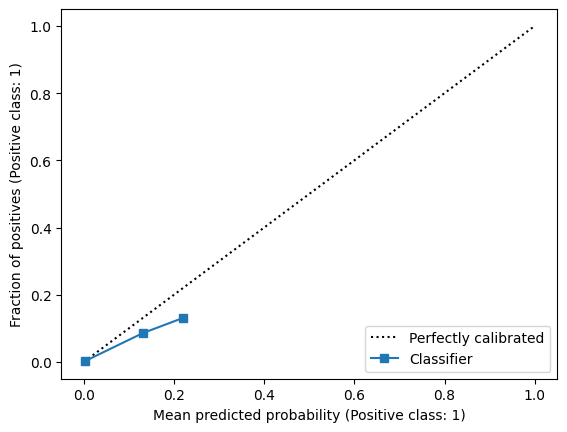

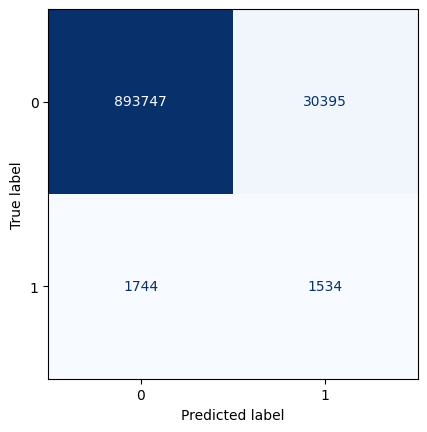

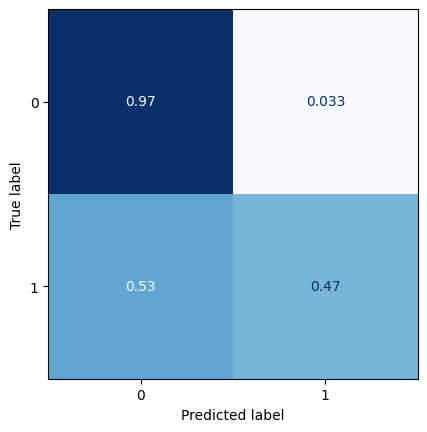

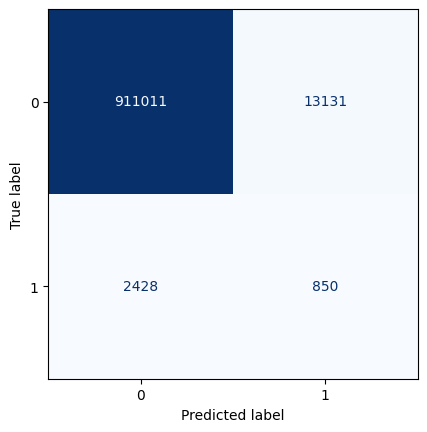

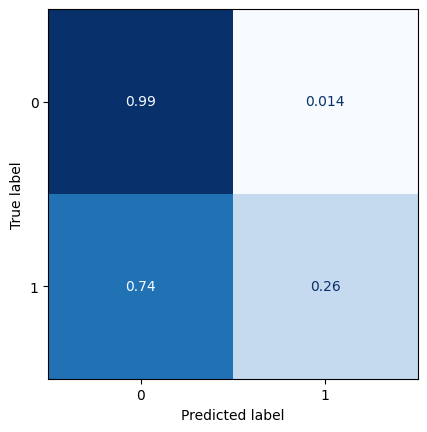

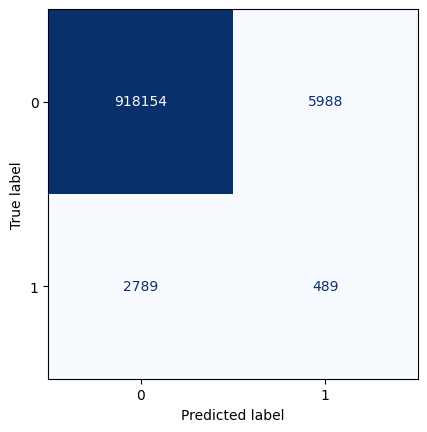

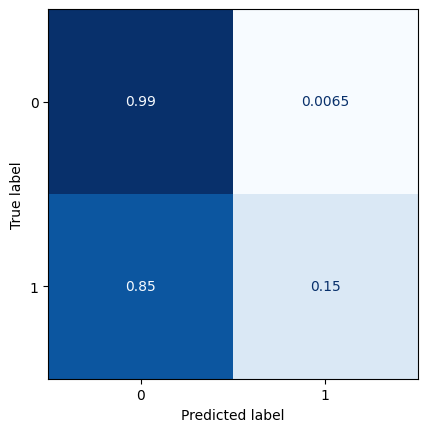

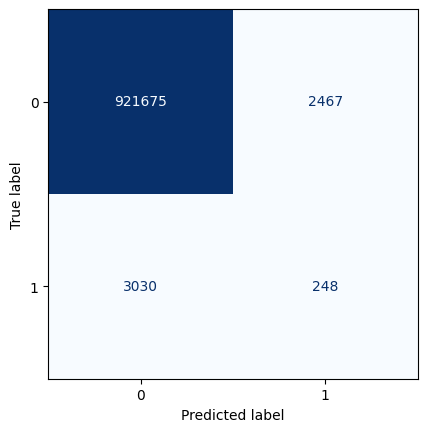

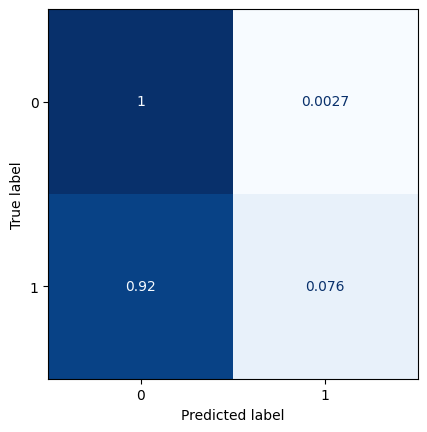

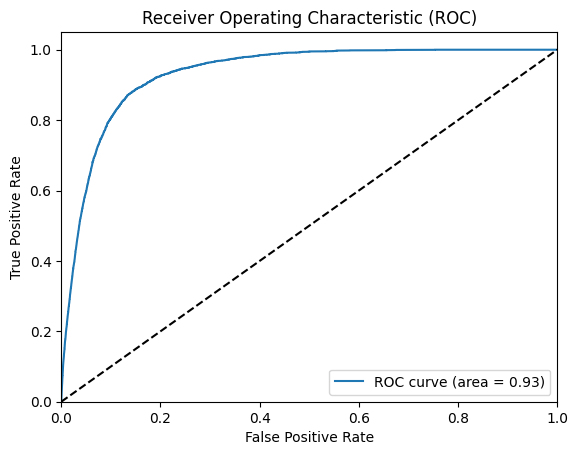

All zeros Brier score: 0.003534536671626663
Model Brier score: 0.003428494836971113
Model: "model_10"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_11 (InputLayer)          [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_110 (Conv2D)            (None, 16, 32, 16)   1312        ['input_11[0][0]']               
                                                                                                  
 dropout_50 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_110[0][0]']             
                                                                                                  
 conv2d_111 (Conv2D)            (None, 16, 32, 16)   2320        ['dropout_50[0][0]']             
       

2023-05-30 12:52:03.697950: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0256

2023-05-30 12:52:09.084924: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 6s 15ms/step - loss: 0.0256 - val_loss: 0.0216
Epoch 2/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0210 - val_loss: 0.0188
Epoch 3/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0202 - val_loss: 0.0184
Epoch 4/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0196 - val_loss: 0.0185
Epoch 5/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0193 - val_loss: 0.0192
Epoch 6/100
354/354 [==============================] - 7s 19ms/step - loss: 0.0189 - val_loss: 0.0207
Epoch 7/100
354/354 [==============================] - 7s 20ms/step - loss: 0.0187 - val_loss: 0.0193
Epoch 8/100
354/354 [==============================] - 8s 21ms/step - loss: 0.0181 - val_loss: 0.0204
Epoch 9/100
354/354 [==============================] - 6s 16ms/step - loss: 0.0177 - val_loss: 0.0210
Epoch 10/100
354/354 [==============================] - 5s 14ms/step - loss: 0.0173 - val_loss

2023-05-30 12:54:01.193744: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 5ms/step


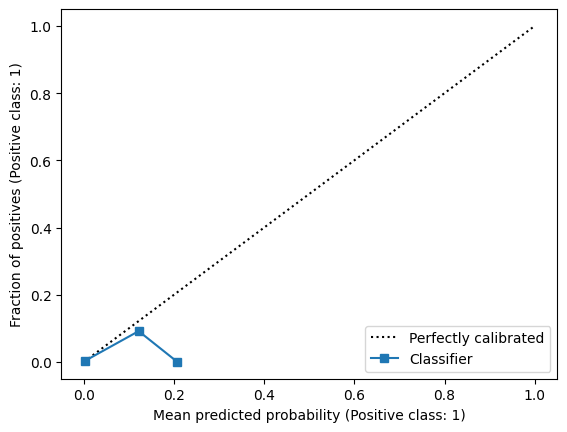

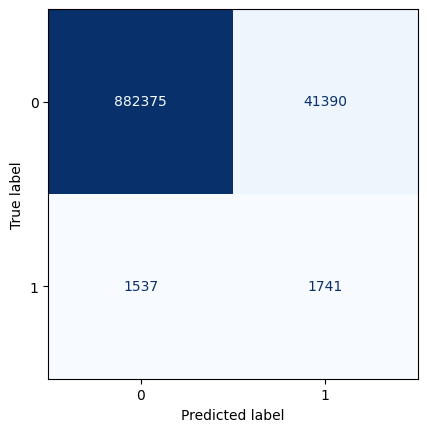

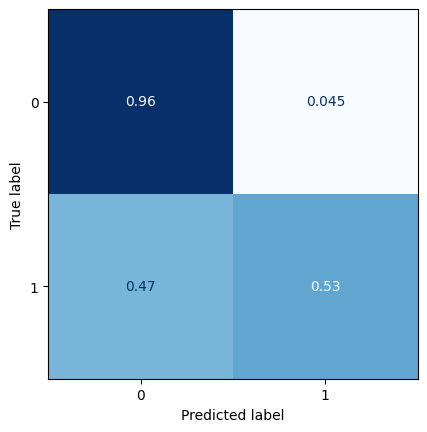

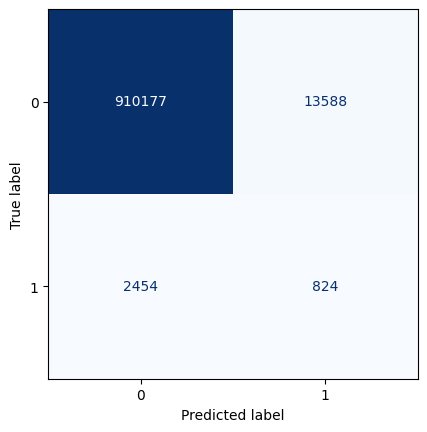

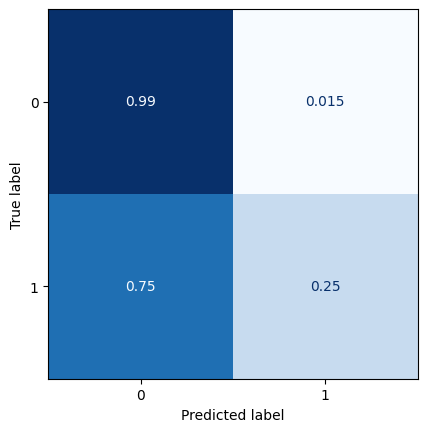

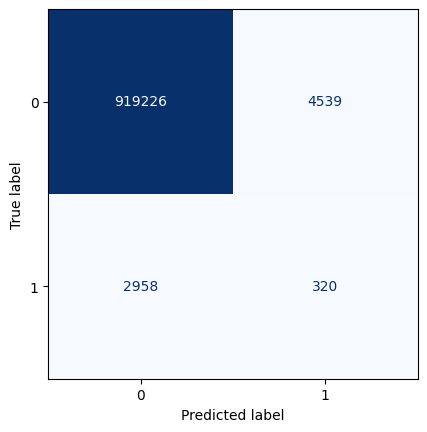

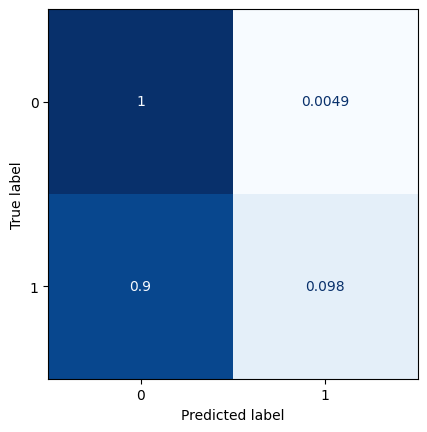

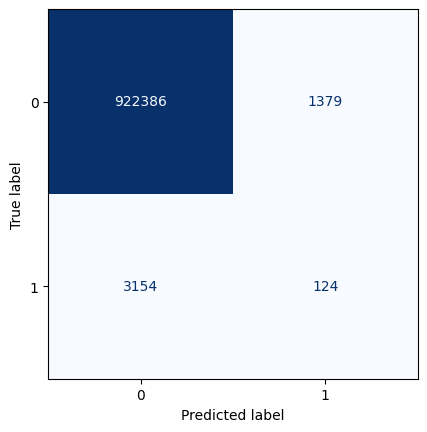

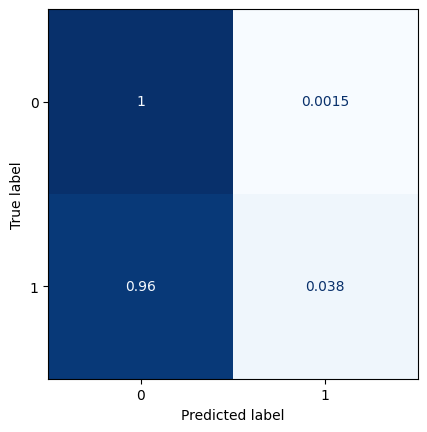

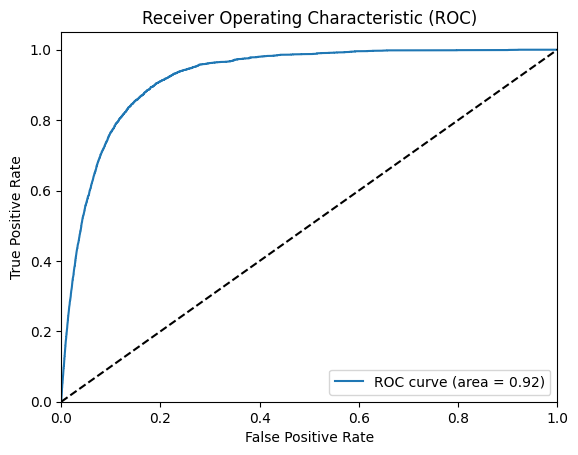

All zeros Brier score: 0.00353597405945571
Model Brier score: 0.0034419728659106927
Model: "model_11"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_12 (InputLayer)          [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_121 (Conv2D)            (None, 16, 32, 16)   1312        ['input_12[0][0]']               
                                                                                                  
 dropout_55 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_121[0][0]']             
                                                                                                  
 conv2d_122 (Conv2D)            (None, 16, 32, 16)   2320        ['dropout_55[0][0]']             
       

2023-05-30 12:54:25.453682: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0289

2023-05-30 12:54:36.867265: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 13s 30ms/step - loss: 0.0289 - val_loss: 0.0231
Epoch 2/100
354/354 [==============================] - 5s 15ms/step - loss: 0.0214 - val_loss: 0.0218
Epoch 3/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0207 - val_loss: 0.0194
Epoch 4/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0204 - val_loss: 0.0209
Epoch 5/100
354/354 [==============================] - 5s 14ms/step - loss: 0.0201 - val_loss: 0.0224
Epoch 6/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0198 - val_loss: 0.0203
Epoch 7/100
354/354 [==============================] - 5s 14ms/step - loss: 0.0194 - val_loss: 0.0202
Epoch 8/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0191 - val_loss: 0.0194
Epoch 9/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0189 - val_loss: 0.0201
Epoch 10/100
354/354 [==============================] - 5s 15ms/step - loss: 0.0184 - val_los

2023-05-30 12:56:43.961509: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 7ms/step


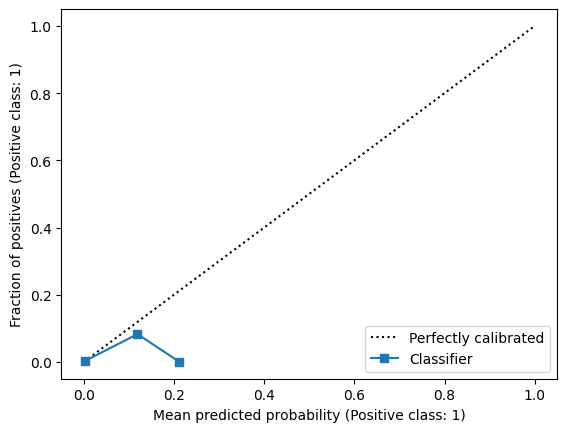

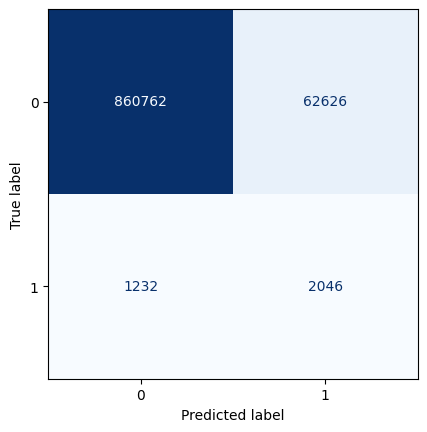

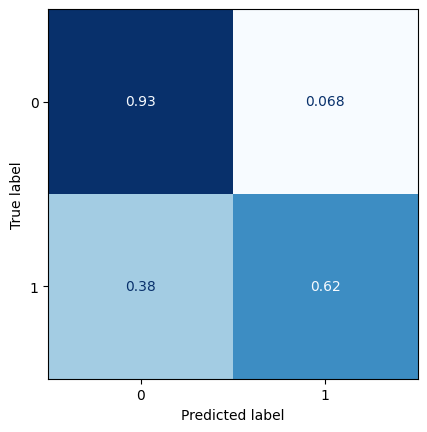

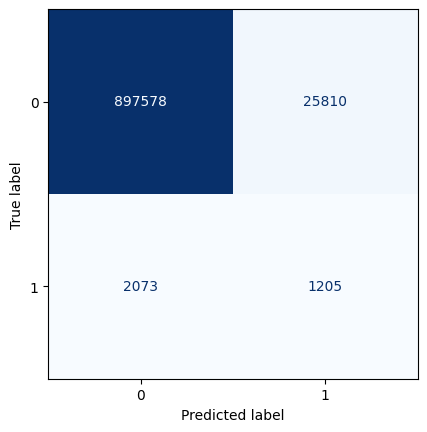

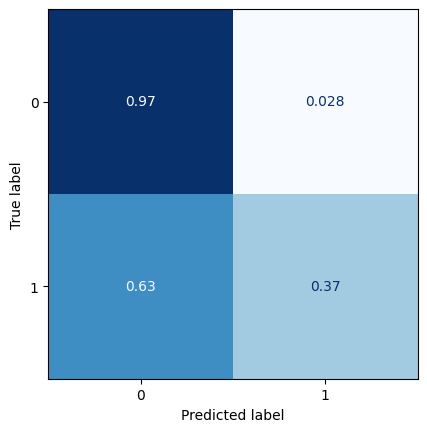

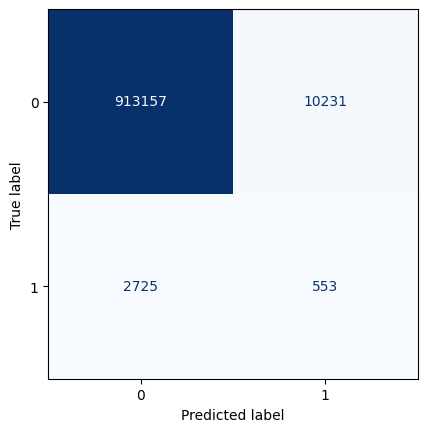

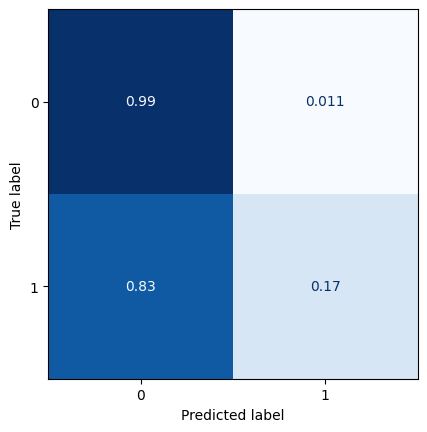

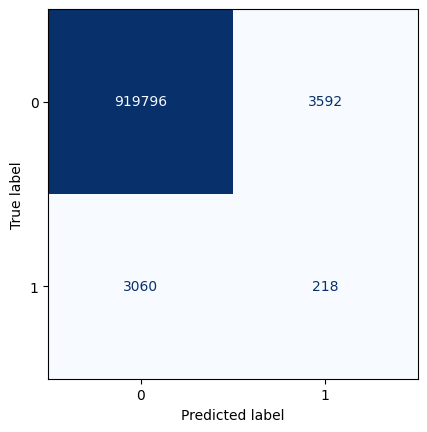

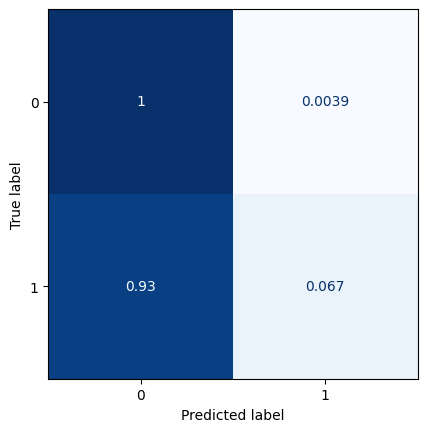

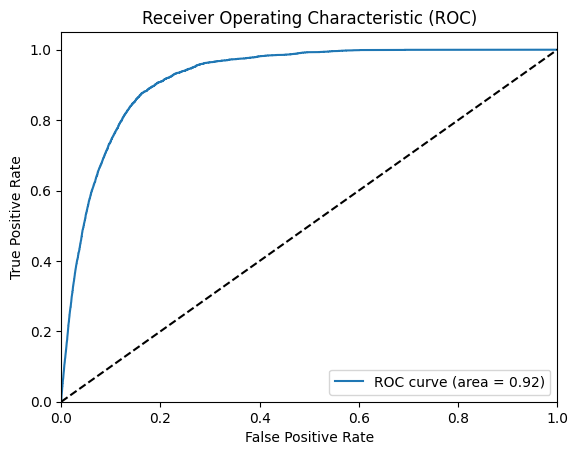

All zeros Brier score: 0.0035374126168436094
Model Brier score: 0.003489246471059426
Model: "model_12"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_13 (InputLayer)          [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_132 (Conv2D)            (None, 16, 32, 16)   1312        ['input_13[0][0]']               
                                                                                                  
 dropout_60 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_132[0][0]']             
                                                                                                  
 conv2d_133 (Conv2D)            (None, 16, 32, 16)   2320        ['dropout_60[0][0]']             
      

2023-05-30 12:57:10.777528: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0279

2023-05-30 12:57:18.624952: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 9s 20ms/step - loss: 0.0279 - val_loss: 0.0192
Epoch 2/100
354/354 [==============================] - 5s 15ms/step - loss: 0.0215 - val_loss: 0.0191
Epoch 3/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0209 - val_loss: 0.0200
Epoch 4/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0206 - val_loss: 0.0188
Epoch 5/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0203 - val_loss: 0.0195
Epoch 6/100
354/354 [==============================] - 5s 14ms/step - loss: 0.0199 - val_loss: 0.0197
Epoch 7/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0195 - val_loss: 0.0192
Epoch 8/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0193 - val_loss: 0.0196
Epoch 9/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0190 - val_loss: 0.0205
Epoch 10/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0186 - val_loss

2023-05-30 12:59:06.020485: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 6ms/step


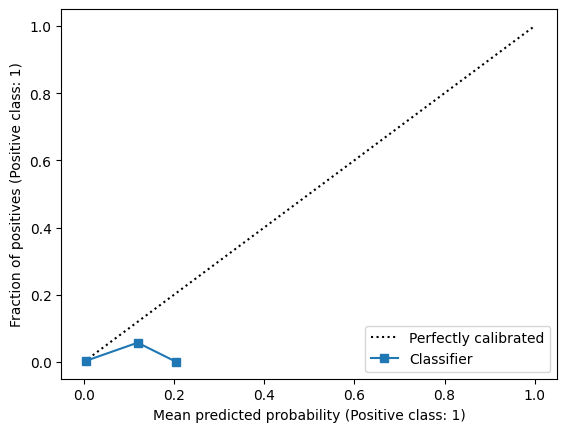

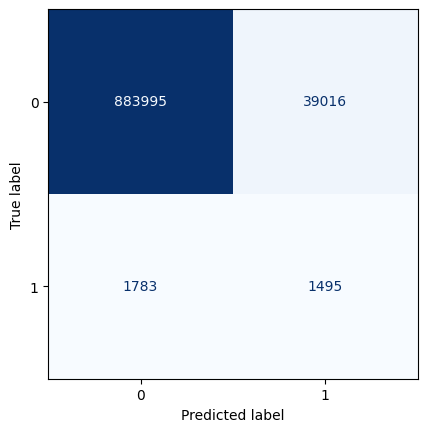

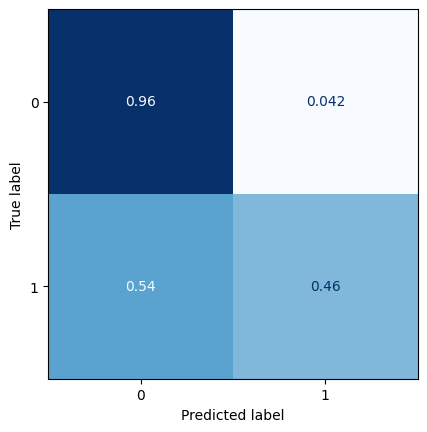

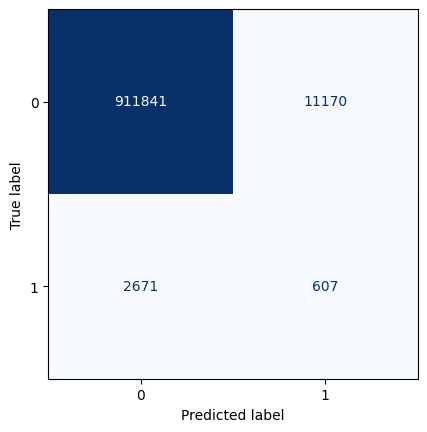

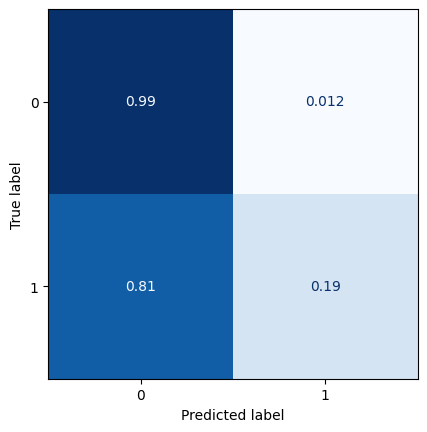

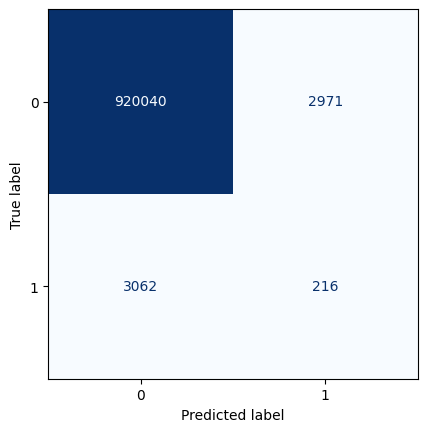

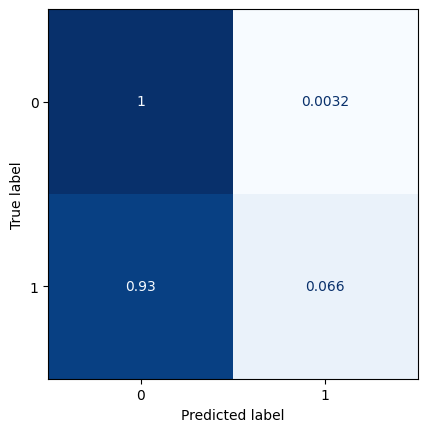

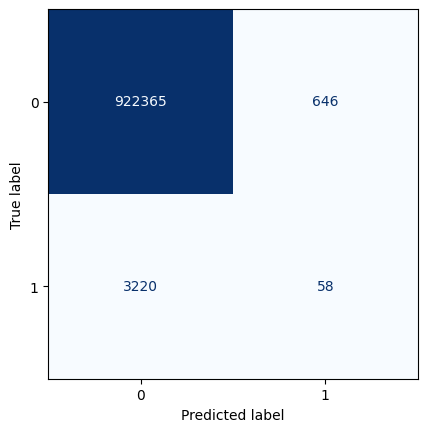

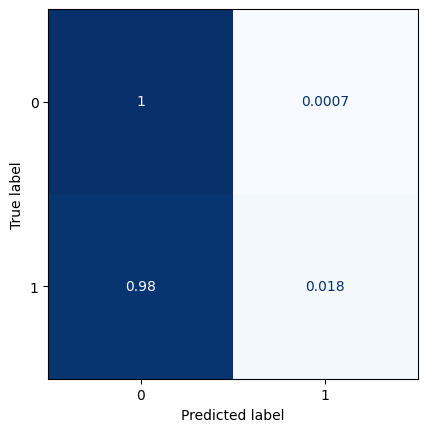

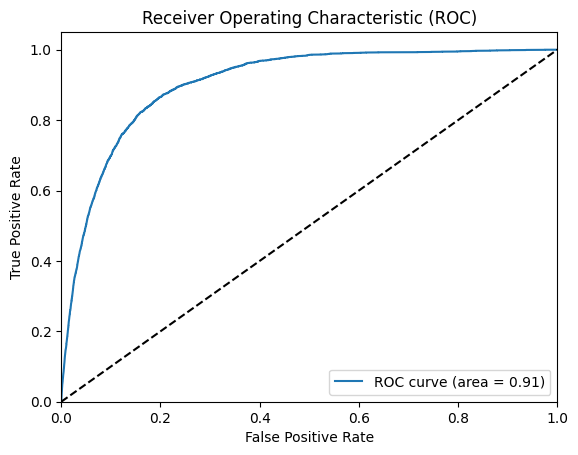

All zeros Brier score: 0.003538852345218393
Model Brier score: 0.0034585809836542164
Model: "model_13"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_14 (InputLayer)          [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_143 (Conv2D)            (None, 16, 32, 16)   1312        ['input_14[0][0]']               
                                                                                                  
 dropout_65 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_143[0][0]']             
                                                                                                  
 conv2d_144 (Conv2D)            (None, 16, 32, 16)   2320        ['dropout_65[0][0]']             
      

2023-05-30 12:59:31.309716: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0356

2023-05-30 12:59:37.678152: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 7s 17ms/step - loss: 0.0356 - val_loss: 0.0210
Epoch 2/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0215 - val_loss: 0.0209
Epoch 3/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0211 - val_loss: 0.0190
Epoch 4/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0208 - val_loss: 0.0203
Epoch 5/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0205 - val_loss: 0.0205
Epoch 6/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0202 - val_loss: 0.0199
Epoch 7/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0200 - val_loss: 0.0190
Epoch 8/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0196 - val_loss: 0.0211
Epoch 9/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0194 - val_loss: 0.0212
Epoch 10/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0190 - val_loss

2023-05-30 13:01:15.580674: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 6ms/step


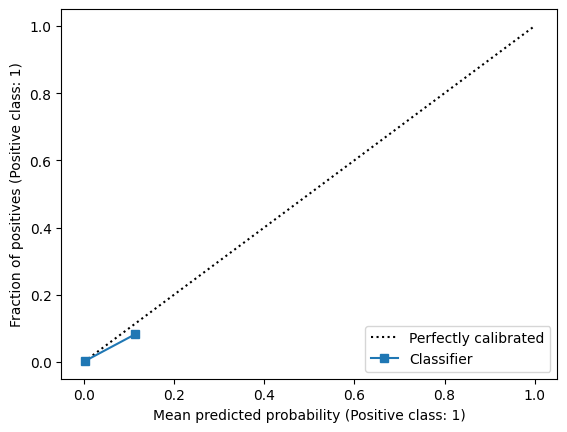

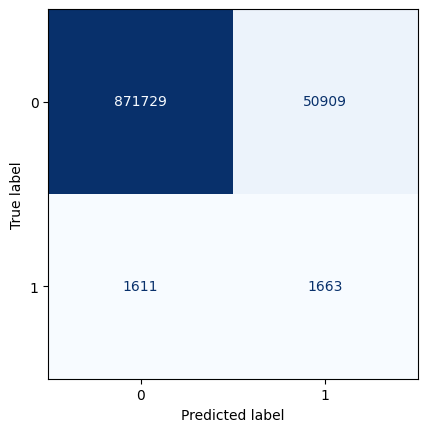

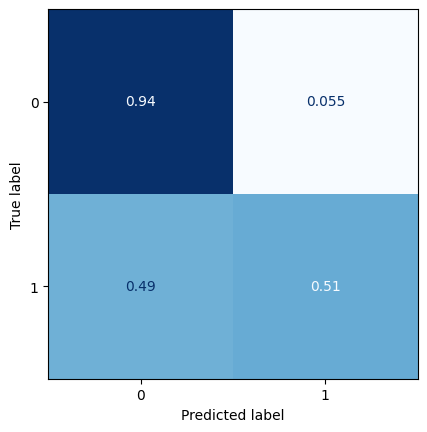

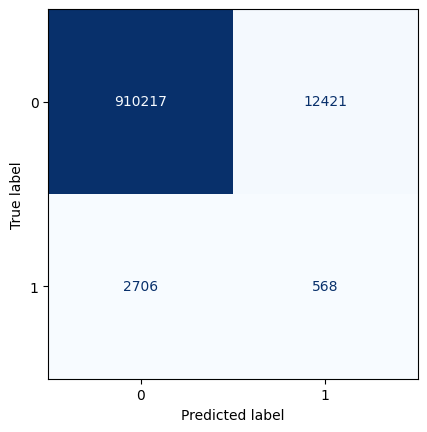

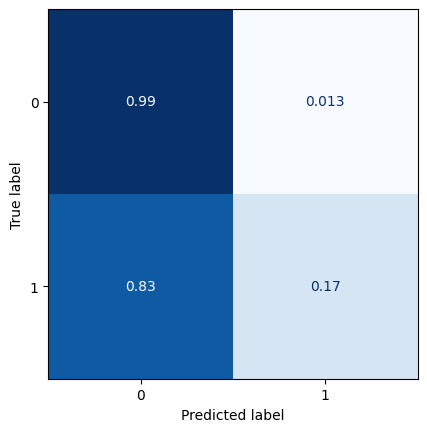

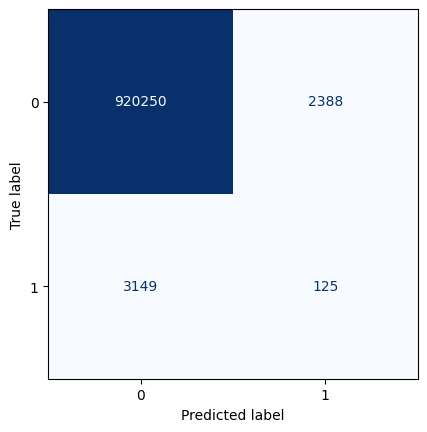

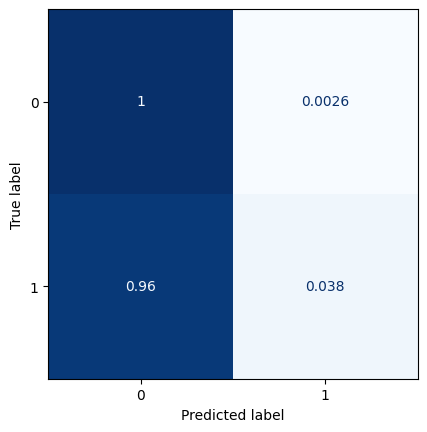

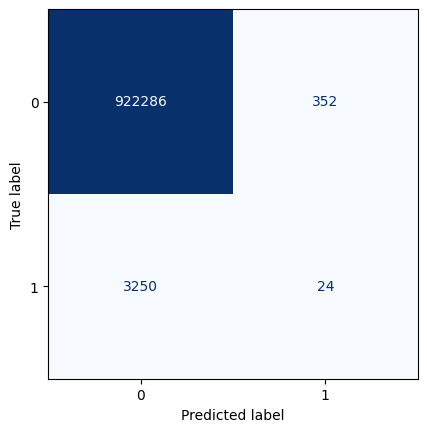

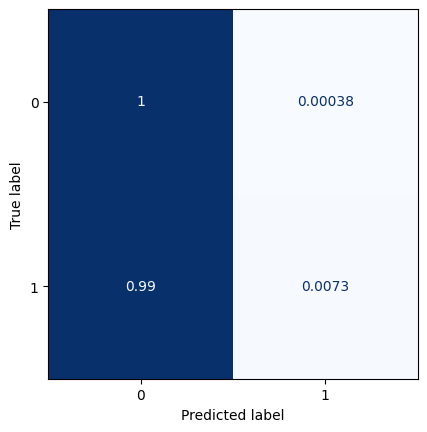

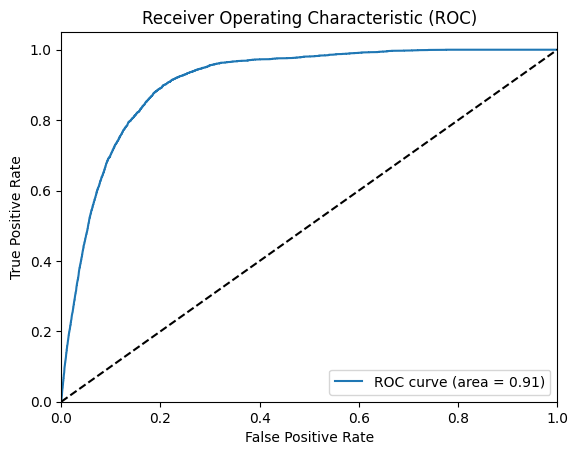

All zeros Brier score: 0.0035359731810366427
Model Brier score: 0.003471077165245826
Model: "model_14"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_15 (InputLayer)          [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_154 (Conv2D)            (None, 16, 32, 16)   1312        ['input_15[0][0]']               
                                                                                                  
 dropout_70 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_154[0][0]']             
                                                                                                  
 conv2d_155 (Conv2D)            (None, 16, 32, 16)   2320        ['dropout_70[0][0]']             
      

2023-05-30 13:01:44.990403: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0395

2023-05-30 13:01:51.465858: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 8s 18ms/step - loss: 0.0395 - val_loss: 0.0226
Epoch 2/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0216 - val_loss: 0.0201
Epoch 3/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0212 - val_loss: 0.0195
Epoch 4/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0209 - val_loss: 0.0225
Epoch 5/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0206 - val_loss: 0.0200
Epoch 6/100
354/354 [==============================] - 6s 18ms/step - loss: 0.0205 - val_loss: 0.0193
Epoch 7/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0202 - val_loss: 0.0194
Epoch 8/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0199 - val_loss: 0.0211
Epoch 9/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0197 - val_loss: 0.0219
Epoch 10/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0194 - val_loss

2023-05-30 13:03:46.855126: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 6ms/step


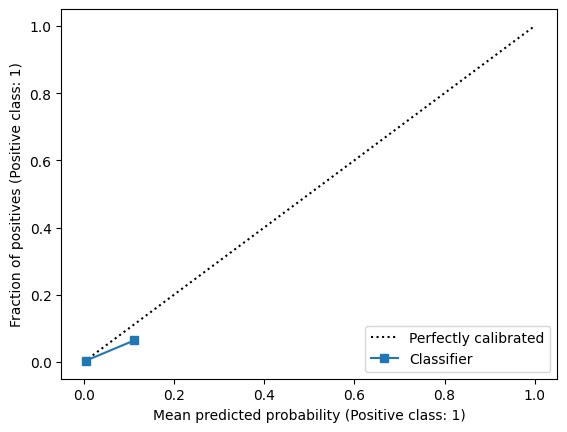

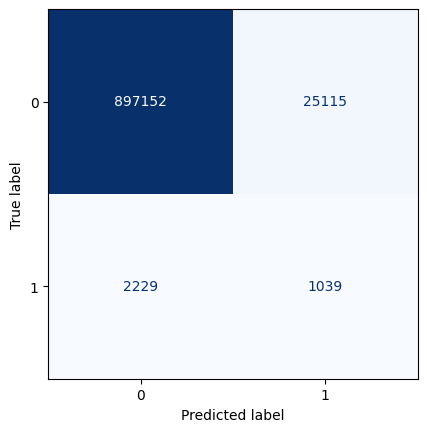

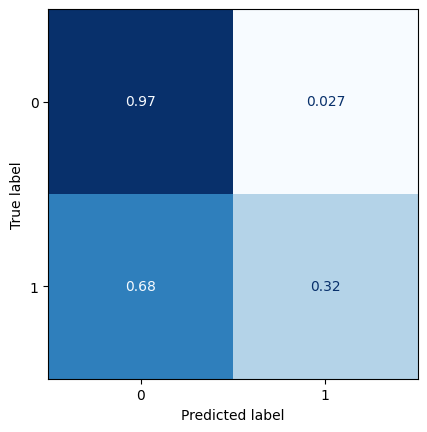

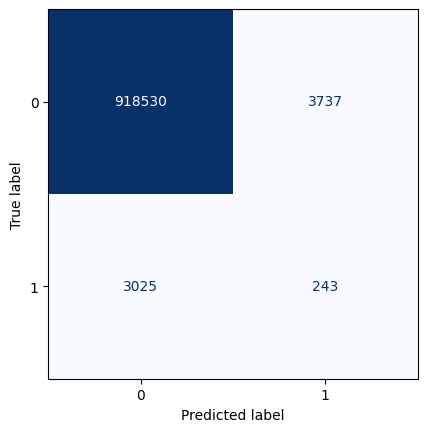

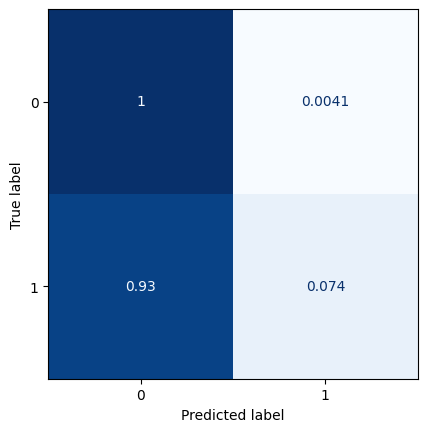

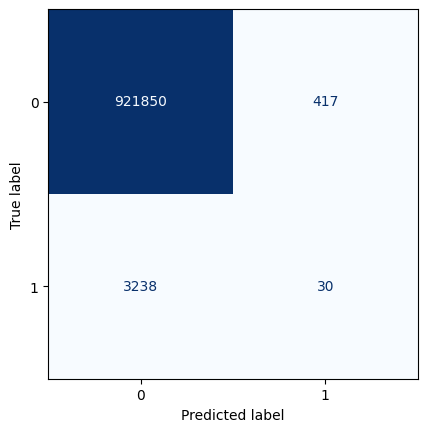

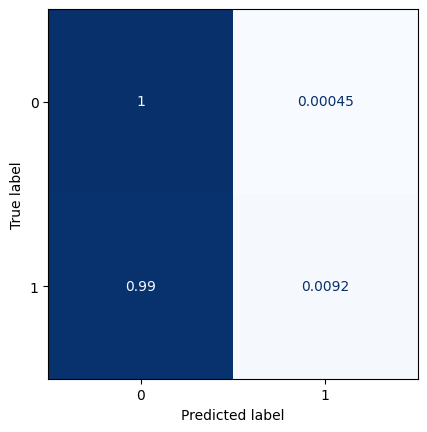

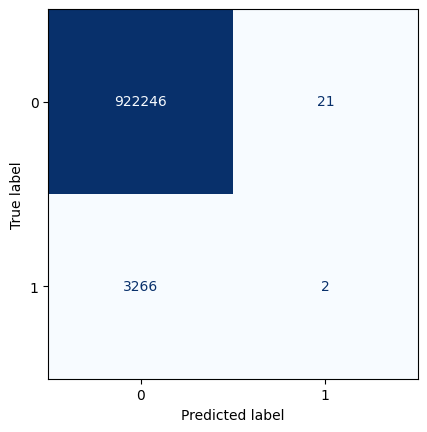

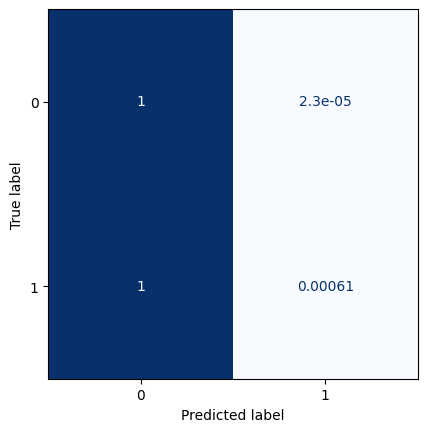

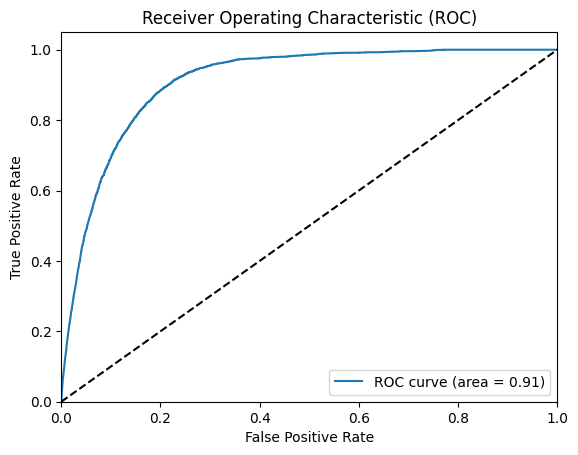

All zeros Brier score: 0.0035309307589664355
Model Brier score: 0.0034527371298340406
Model: "model_15"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_16 (InputLayer)          [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_165 (Conv2D)            (None, 16, 32, 16)   1312        ['input_16[0][0]']               
                                                                                                  
 dropout_75 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_165[0][0]']             
                                                                                                  
 conv2d_166 (Conv2D)            (None, 16, 32, 16)   2320        ['dropout_75[0][0]']             
     

2023-05-30 13:04:12.945602: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0281

2023-05-30 13:04:19.421316: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 8s 17ms/step - loss: 0.0281 - val_loss: 0.0236
Epoch 2/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0219 - val_loss: 0.0206
Epoch 3/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0213 - val_loss: 0.0207
Epoch 4/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0209 - val_loss: 0.0200
Epoch 5/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0207 - val_loss: 0.0201
Epoch 6/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0204 - val_loss: 0.0205
Epoch 7/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0200 - val_loss: 0.0201
Epoch 8/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0198 - val_loss: 0.0198
Epoch 9/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0194 - val_loss: 0.0201
Epoch 10/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0193 - val_loss

2023-05-30 13:06:19.216307: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 6ms/step


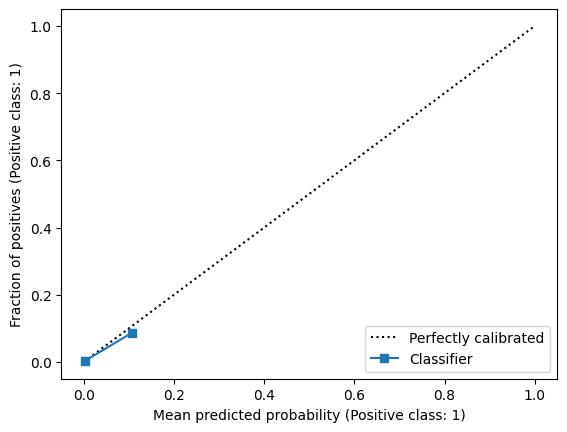

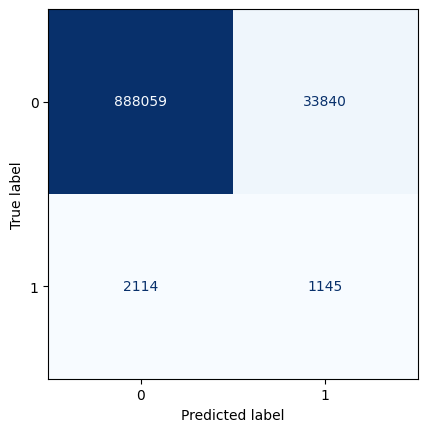

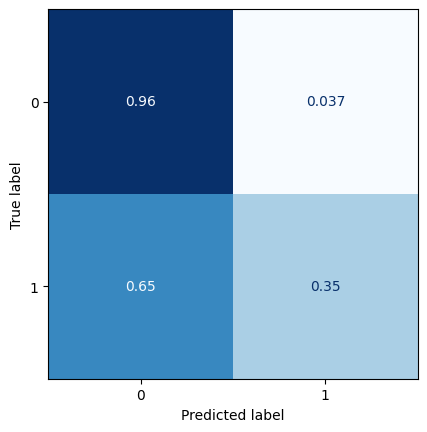

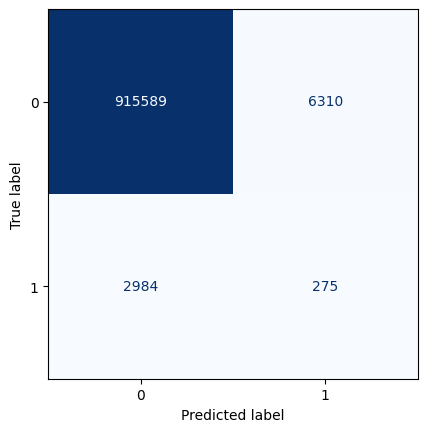

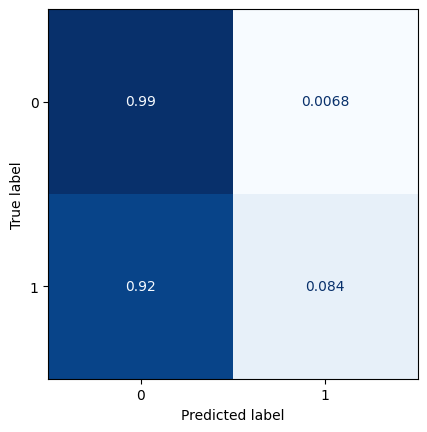

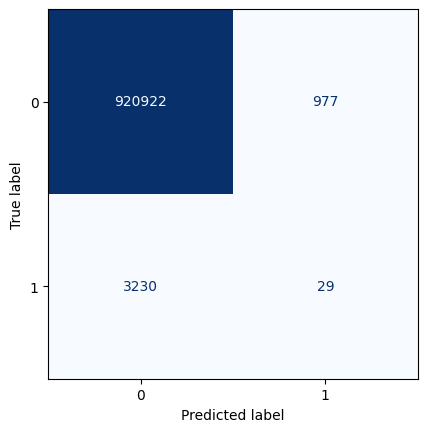

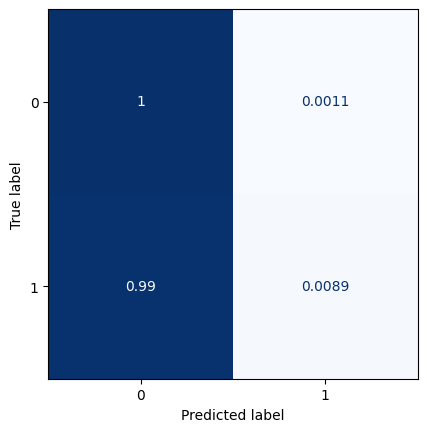

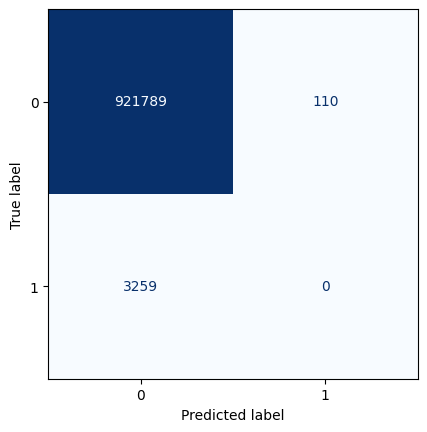

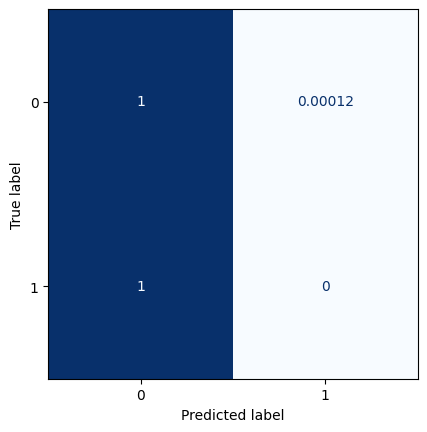

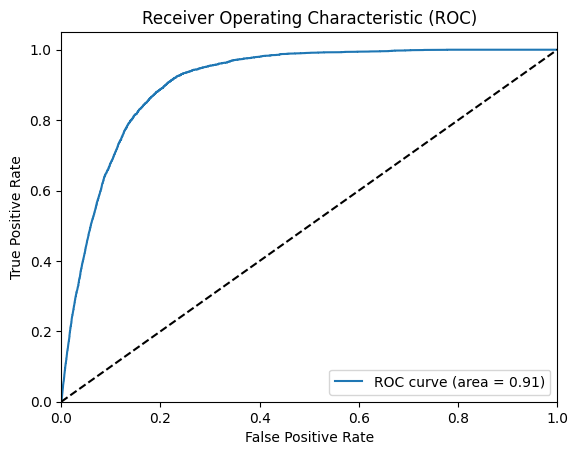

All zeros Brier score: 0.003522641537985944
Model Brier score: 0.003458859421220113
Model: "model_16"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_17 (InputLayer)          [(None, 16, 32, 9)]  0           []                               
                                                                                                  
 conv2d_176 (Conv2D)            (None, 16, 32, 16)   1312        ['input_17[0][0]']               
                                                                                                  
 dropout_80 (Dropout)           (None, 16, 32, 16)   0           ['conv2d_176[0][0]']             
                                                                                                  
 conv2d_177 (Conv2D)            (None, 16, 32, 16)   2320        ['dropout_80[0][0]']             
       

2023-05-30 13:06:44.349314: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0490

2023-05-30 13:06:50.554129: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 7s 17ms/step - loss: 0.0490 - val_loss: 0.0225
Epoch 2/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0221 - val_loss: 0.0211
Epoch 3/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0216 - val_loss: 0.0213
Epoch 4/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0213 - val_loss: 0.0209
Epoch 5/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0210 - val_loss: 0.0198
Epoch 6/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0208 - val_loss: 0.0201
Epoch 7/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0206 - val_loss: 0.0225
Epoch 8/100
354/354 [==============================] - 5s 13ms/step - loss: 0.0205 - val_loss: 0.0200
Epoch 9/100
354/354 [==============================] - 4s 12ms/step - loss: 0.0202 - val_loss: 0.0200
Epoch 10/100
354/354 [==============================] - 4s 13ms/step - loss: 0.0199 - val_loss

2023-05-30 13:08:37.832006: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 6ms/step


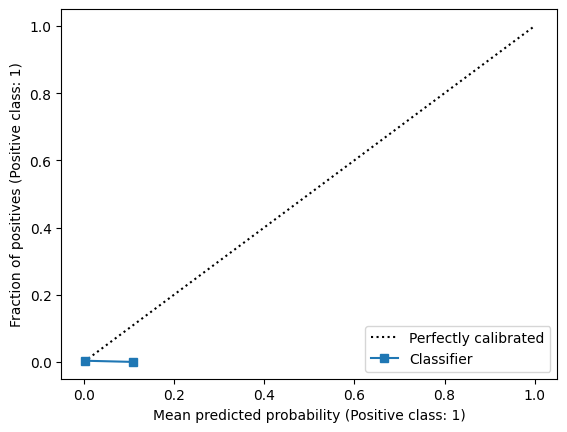

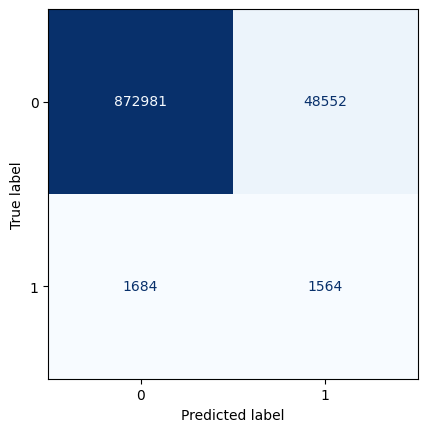

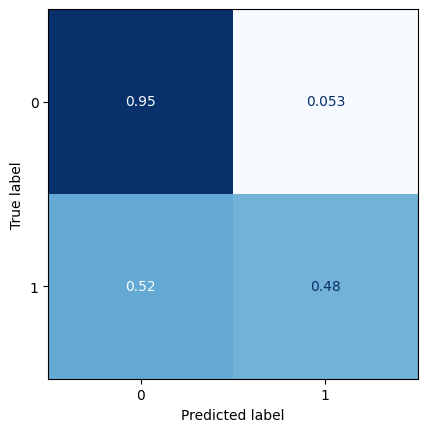

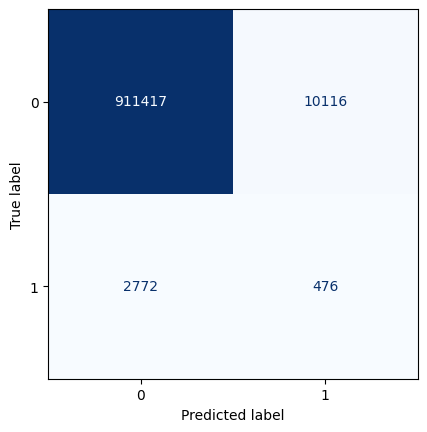

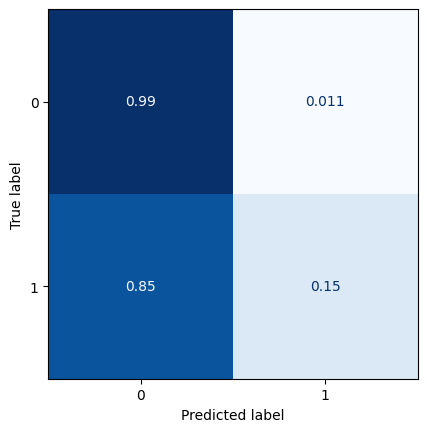

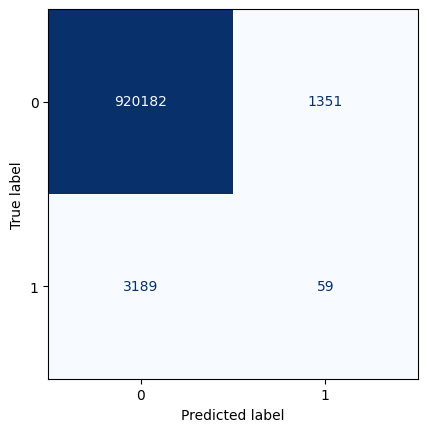

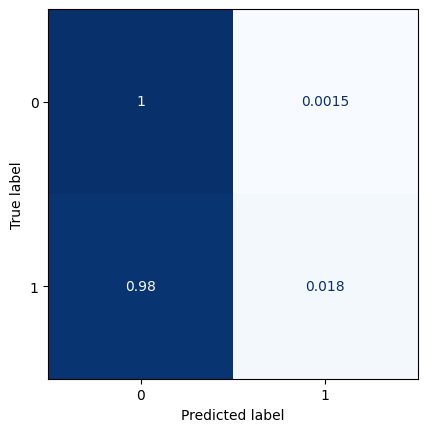

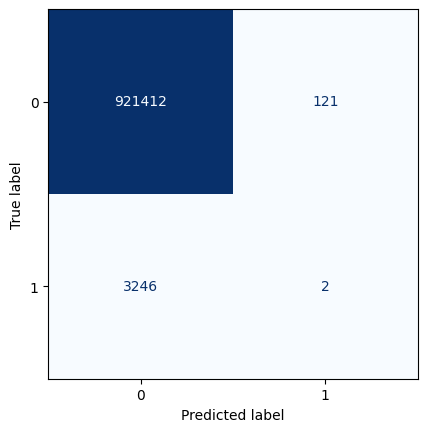

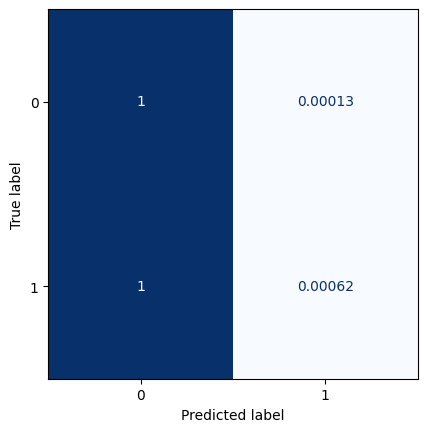

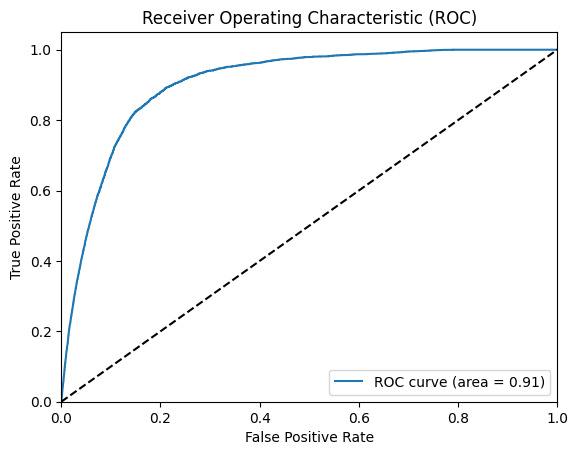

All zeros Brier score: 0.0035121828843801936
Model Brier score: 0.0034460730073235086


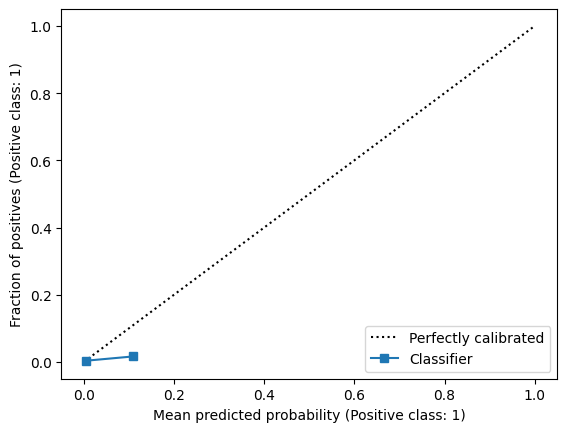

In [25]:
for lag in [1,2,3,4,5,6,7,8,9,10,11,12,13]:
    ### Model summary
    model = very_simple_unet_model(16,32,9)
    
    model.compile(loss='binary_crossentropy', optimizer='adam')
    
    monitor = EarlyStopping(monitor='val_loss', min_delta=1e-5, patience=20, 
            verbose=1, mode='auto', restore_best_weights=True)
    
    ### Model training
    model.fit(train_img_std_padded[:-lag], y_train_img[lag:], validation_data=(val_img_std_padded[:-lag],y_val_img[lag:]),
        callbacks=[monitor],epochs=100)
    
    ### Confusion matrices
    t = model.predict(test_img_std_padded[:-lag])

    ranges = [0.025,0.05,0.075,0.1]
    
    for j in ranges:
        classes = []
        for i in t.reshape(-1,1):
            if i<=j: classes.append(0)
            else: classes.append(1)
    
        ConfusionMatrixDisplay(confusion_matrix(y_test_img[lag:].reshape(-1,1), classes)).plot(colorbar=False,cmap=plt.cm.Blues, values_format='d')
        ConfusionMatrixDisplay(confusion_matrix(y_test_img[lag:].reshape(-1,1), classes, normalize='true')).plot(colorbar=False,cmap=plt.cm.Blues)
    
    ### ROC
    plot_roc(t.reshape(-1,1),y_test_img[lag:].reshape(-1,1))
    
    z = np.zeros((lag,13,29,1))
    tt = np.concatenate((t,z))
    test['predictions_lag'+str(lag)] = tt.reshape(-1,1)
    test.to_csv("test_with_newTarget_predictions.csv")
    
    ### calibration
    display = CalibrationDisplay.from_predictions(y_test_img[lag:].reshape(-1,1), t.reshape(-1,1), n_bins=10)
    print(f'All zeros Brier score: {brier_score_loss(y_test_img[lag:].reshape(-1,1), np.zeros(len(y_test_img[lag:].reshape(-1,1))))}')
    print(f'Model Brier score: {brier_score_loss(y_test_img[lag:].reshape(-1,1), t.reshape(-1,1))}')
    

# Save results and new metric

In [24]:
a1 = test.target.values.reshape(1,-1)
a1

array([[0, 0, 0, ..., 0, 0, 0]])

In [25]:
a2 = y_test_img.reshape(1,-1)
a2

array([[0., 0., 0., ..., 0., 0., 0.]])

In [26]:
a_diff = a1-a2

In [27]:
a_diff[a_diff>0]

array([], dtype=float64)

In [28]:
test['predictions'] = t.reshape(-1,1)
test['predictions_onlySea'] = t_onlySea.reshape(-1,1)

ValueError: Length of values (924781) does not match length of index (929682)

In [ ]:
test

In [ ]:
test.to_csv("test_with_newTarget_predictions.csv")

In [ ]:
import sys
sys.path.append("/Users/paolo/Documents/TC/Paolo/scripts/")

from aux import compute_cyclones

cyclones_real = compute_cyclones(test[test.target==1],2.5)

cyclones_predicted = compute_cyclones(test[test.predictions>=0.025],2.5)

TC_founds = 0 
    
for TC in cyclones_real:
    found = 0 
    for point in TC:
        reduced = test[(test.predictions>=0.025) & (test.time==point[2]) & (test.latitude==point[0]) & (test.longitude==point[1])]
        if reduced.shape[0]>=1:
            found = 1
    if found == 1: TC_founds+=1
        
print(f'Number of test TCs: {len(cyclones_real)}\n')
print(f'Number of test TCs correctly predicted: {TC_founds}\n')
print(f'Number of test TCs predicted, correctly or not: {len(cyclones_predicted)}\n')
print(f'Number of test TCs predicted but not happening: {len(cyclones_predicted)-TC_founds}\n')



In [ ]:
import sys
sys.path.append("/Users/paolo/Documents/TC/Paolo/scripts/")

from aux import compute_cyclones

cyclones_real = compute_cyclones(test[test.target==1],2.5)

cyclones_predicted = compute_cyclones(test[test.predictions>=0.05],2.5)

TC_founds = 0 
    
for TC in cyclones_real:
    found = 0 
    for point in TC:
        reduced = test[(test.predictions>=0.05) & (test.time==point[2]) & (test.latitude==point[0]) & (test.longitude==point[1])]
        if reduced.shape[0]>=1:
            found = 1
    if found == 1: TC_founds+=1
        
print(f'Number of test TCs: {len(cyclones_real)}\n')
print(f'Number of test TCs correctly predicted: {TC_founds}\n')
print(f'Number of test TCs predicted, correctly or not: {len(cyclones_predicted)}\n')
print(f'Number of test TCs predicted but not happening: {len(cyclones_predicted)-TC_founds}\n')



In [ ]:
import sys
sys.path.append("/Users/paolo/Documents/TC/Paolo/scripts/")

from aux import compute_cyclones

cyclones_real = compute_cyclones(test.loc[(test.target==1) & (test.time<='2019-12-01')],2.5)

cyclones_predicted = compute_cyclones(test.loc[(test.predictions>=0.1) & (test.time<='2019-12-01')],2.5)

TC_founds = 0 
    
for TC in cyclones_real:
    found = 0 
    for point in TC:
        reduced = test[(test.predictions>=0.05) & (test.time==point[2]) & (test.latitude==point[0]) & (test.longitude==point[1])]
        if reduced.shape[0]>=1:
            found = 1
    if found == 1: TC_founds+=1
        
print(f'Number of test TCs: {len(cyclones_real)}\n')
print(f'Number of test TCs correctly predicted: {TC_founds}\n')
print(f'Number of test TCs predicted, correctly or not: {len(cyclones_predicted)}\n')
print(f'Number of test TCs predicted but not happening: {len(cyclones_predicted)-TC_founds}\n')



In [ ]:
import sys
sys.path.append("/Users/paolo/Documents/TC/Paolo/scripts/")

from aux import compute_cyclones

cyclones_real = compute_cyclones(test[test.target_sea==1],2.5)

cyclones_predicted = compute_cyclones(test[test.predictions_onlySea>=0.025],2.5)

TC_founds = 0 
    
for TC in cyclones_real:
    found = 0 
    for point in TC:
        reduced = test[(test.predictions_onlySea>=0.025) & (test.time==point[2]) & (test.latitude==point[0]) & (test.longitude==point[1])]
        if reduced.shape[0]>=1:
            found = 1
    if found == 1: TC_founds+=1
        
print(f'Number of test TCs: {len(cyclones_real)}\n')
print(f'Number of test TCs correctly predicted: {TC_founds}\n')
print(f'Number of test TCs predicted, correctly or not: {len(cyclones_predicted)}\n')
print(f'Number of test TCs predicted but not happening: {len(cyclones_predicted)-TC_founds}\n')



In [ ]:
import sys
sys.path.append("/Users/paolo/Documents/TC/Paolo/scripts/")

from aux import compute_cyclones

cyclones_real = compute_cyclones(test[test.target_sea==1],2.5)

cyclones_predicted = compute_cyclones(test[test.predictions_onlySea>=0.05],2.5)

TC_founds = 0 
    
for TC in cyclones_real:
    found = 0 
    for point in TC:
        reduced = test[(test.predictions_onlySea>=0.05) & (test.time==point[2]) & (test.latitude==point[0]) & (test.longitude==point[1])]
        if reduced.shape[0]>=1:
            found = 1
    if found == 1: TC_founds+=1
        
print(f'Number of test TCs: {len(cyclones_real)}\n')
print(f'Number of test TCs correctly predicted: {TC_founds}\n')
print(f'Number of test TCs predicted, correctly or not: {len(cyclones_predicted)}\n')
print(f'Number of test TCs predicted but not happening: {len(cyclones_predicted)-TC_founds}\n')



In [ ]:
import sys
sys.path.append("/Users/paolo/Documents/TC/Paolo/scripts/")

from aux import compute_cyclones

cyclones_real = compute_cyclones(test.loc[(test.target_sea==1) & (test.time<='2019-12-01')],2.5)

cyclones_predicted = compute_cyclones(test.loc[(test.predictions_onlySea>=0.1) & (test.time<='2019-12-01')],2.5)

TC_founds = 0 
    
for TC in cyclones_real:
    found = 0 
    for point in TC:
        reduced = test[(test.predictions_onlySea>=0.1) & (test.time==point[2]) & (test.latitude==point[0]) & (test.longitude==point[1])]
        if reduced.shape[0]>=1:
            found = 1
    if found == 1: TC_founds+=1
        
print(f'Number of test TCs: {len(cyclones_real)}\n')
print(f'Number of test TCs correctly predicted: {TC_founds}\n')
print(f'Number of test TCs predicted, correctly or not: {len(cyclones_predicted)}\n')
print(f'Number of test TCs predicted but not happening: {len(cyclones_predicted)-TC_founds}\n')



# Higher threshold for class 1

In [ ]:
train['target'] = train.apply(lambda x: 1 if x.Real_tom_target>=70 else 0,axis=1)
test['target'] = test.apply(lambda x: 1 if x.Real_tom_target>=70 else 0,axis=1)
val['target'] = val.apply(lambda x: 1 if x.Real_tom_target>=70 else 0,axis=1)

y_train = train.loc[:,['target','latitude','longitude','time']]
y_val = val.loc[:,['target','latitude','longitude','time']]
y_test = test.loc[:,['target','latitude','longitude','time']]

In [ ]:
y_train_img = extract_images(y_train, variables, verbose=True)
y_val_img = extract_images(y_val, variables, verbose=True)
y_test_img = extract_images(y_test, variables, verbose=True)


In [ ]:
model = Sequential()
model.add(layers.Input(shape=(13, 29, 9)))

model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
model.add(layers.MaxPooling2D((2, 2), padding='same'))

#model.add(layers.Flatten())

#model.add(layers.Reshape((2,4,16)))

model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
model.add(layers.UpSampling2D((2,2)))

model.add(layers.Conv2D(1, (3, 3), activation='sigmoid', padding='same')) # sigmoidal activation to have probabilities

model.add(layers.Cropping2D(cropping=((0,1),(0,1))))

model.summary()


model.compile(loss='binary_crossentropy', optimizer='adam')

monitor = EarlyStopping(monitor='val_loss', min_delta=1e-5, patience=20, 
        verbose=1, mode='auto', restore_best_weights=True)


In [ ]:
model.fit(train_img_std, y_train_img, validation_data=(val_img_std,y_val_img),
        callbacks=[monitor],epochs=100)

In [ ]:
t = model.predict(test_img_std)

ranges = [0.025,0.05,0.075,0.1]

for j in ranges:
    classes = []
    for i in t.reshape(-1,1):
        if i<=j: classes.append(0)
        else: classes.append(1)

# confusion matrix with threshold on 0.1, otherwise always 0 
    ConfusionMatrixDisplay(confusion_matrix(y_test_img.reshape(-1,1), classes)).plot(colorbar=False,cmap=plt.cm.Blues, values_format='d')
    ConfusionMatrixDisplay(confusion_matrix(y_test_img.reshape(-1,1), classes, normalize='true')).plot(colorbar=False,cmap=plt.cm.Blues)
    

In [ ]:
plot_roc(t.reshape(-1,1),y_test_img.reshape(-1,1))

display = CalibrationDisplay.from_predictions(y_test_img.reshape(-1,1), t.reshape(-1,1), n_bins=10)

print(brier_score_loss(y_test_img.reshape(-1,1), t.reshape(-1,1)))
print(brier_score_loss(y_test_img.reshape(-1,1), np.zeros(len(y_test_img.reshape(-1,1)))))